In [1]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import softmax
from prepare_plasticc import config
from tokenizer import LCTokenizer

In [2]:
def metrics(y_true, y_pred):
    y_true_onehot = np.zeros_like(y_pred)
    y_true_onehot[y_true] = 1
    y_pred = softmax(y_pred)
    return -np.sum(y_true_onehot * np.log(y_pred), axis=-1), np.argmax(y_pred) == y_true

In [3]:
root = 'test4'

In [4]:
cm = np.load('%s/cm.npy' % root)

In [5]:
for i, row in enumerate(cm):
    print('actual', list(config['class_names'].values())[i], np.sum(row))

actual \mu 40
actual TDE 418
actual EBE 2633
actual SNII 29122
actual SNIax 1739
actual MIRA 43
actual SNIbc 4926
actual KN 2
actual M-dwarf 2665
actual SNIa-91bg 1175
actual AGN 2842
actual SNIa 47442
actual RR Lyrae 5515
actual SLSN-I 1060
actual 99a 18
actual 99b 46
actual 99c 289
actual 99d 25


In [6]:
for i in range(len(cm)):
    print('pred', list(config['class_names'].values())[i], np.sum(cm[:,i]))

pred \mu 16
pred TDE 145
pred EBE 2634
pred SNII 31895
pred SNIax 0
pred MIRA 21
pred SNIbc 3664
pred KN 0
pred M-dwarf 2709
pred SNIa-91bg 85
pred AGN 3716
pred SNIa 48422
pred RR Lyrae 5519
pred SLSN-I 1174
pred 99a 0
pred 99b 0
pred 99c 0
pred 99d 0


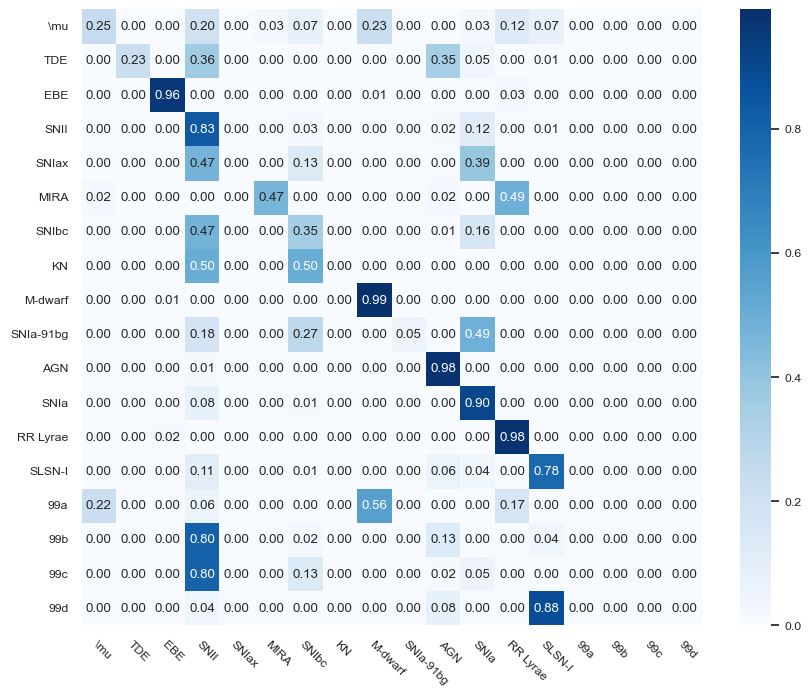

In [10]:
fig, axes = plt.subplots(figsize=(10,8))
sns.set(style="whitegrid", palette="muted", font_scale=0.8)
sns.heatmap(cm/np.sum(cm, axis=1, keepdims=1), annot=True, 
            fmt='.2f', cmap='Blues', cbar=True, ax=axes)
axes.set_xticklabels(list(config['class_names'].values()))
axes.set_yticklabels(list(config['class_names'].values()))
plt.setp(
        axes.xaxis.get_majorticklabels(), rotation=-45, ha="left", rotation_mode="anchor"
    )
plt.setp(
    axes.yaxis.get_majorticklabels(),
    rotation="horizontal",
    ha="right",
    rotation_mode="anchor",
)
plt.show()

In [8]:
tokenizer = LCTokenizer(config["min_flux"], config["max_flux"], config["num_bins"], config["max_delta_time"],
                            config["num_time_bins"], bands=config["bands"],
                            transform=np.arcsinh, inverse_transform=np.sinh,
                            min_sn=3)

In [9]:
linestyles = ['-', ':', '--']
colors = ['b', 'r', 'g', 'c', 'm', 'k']
markers = ['*', '*', '*']
bands = config['bands']

def plot_lc(dfs):
  if not isinstance(dfs, list):
    dfs = [dfs]
  fig, axes = plt.subplots(1,len(dfs), figsize=(5*len(dfs),4), sharex=True, sharey=True)
  for i, df in enumerate(dfs):
    min_time = np.min(df['mjd'])
    linestyle = linestyles[i]
    for j, band in enumerate(bands):
      df_band = df[df['passband'] == band]
      timestamp = df_band['mjd'] #- min_time
      flux = df_band['flux']
      flux_error = df_band['flux_err']
      if j >= 0:
        if len(dfs) == 1:
          axes.scatter(timestamp, flux, linestyle=linestyle, marker=markers[i], color=colors[j])
        else:
          axes[i].scatter(timestamp, flux, linestyle=linestyle, marker=markers[i], color=colors[j])
        if len(flux_error) > 0:
          if len(dfs) == 1:
            axes.errorbar(timestamp, flux, flux_error, ls='none', color=colors[j])
          else:
            axes[i].errorbar(timestamp, flux, flux_error, ls='none', color=colors[j])
    if len(dfs) == 1:
      axes.set_xlabel('Time (days)')
      axes.set_ylabel('Flux')
    else:
      axes[i].set_xlabel('Time (days)')
      axes[i].set_ylabel('Flux')
      axes[i].grid()
  plt.show()

In [10]:
data = np.load('%s/eval.npy' % root, allow_pickle=True)

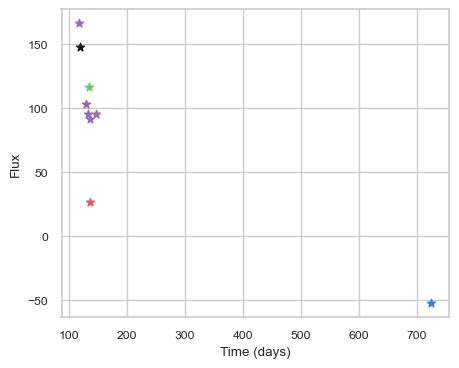

SNIax (3.8284643, False)
SNIax (4.3777328, False)
SNIax (5.3949633, False)
SNIax (5.064482, False)
SNIax (5.390609, False)
SNIax (5.163128, False)
SNIax (4.891183, False)
SNIax (5.0552216, False)
SNIax (4.4089966, False)
SNIax (5.3296213, False)
SNIax (4.901108, False)
SNIax (5.2502418, False)
SNIax (5.503636, False)
SNIax (5.7874784, False)
SNIax (5.393449, False)
SNIax (5.266122, False)
SNIax (6.039364, False)
SNIax (5.1395507, False)


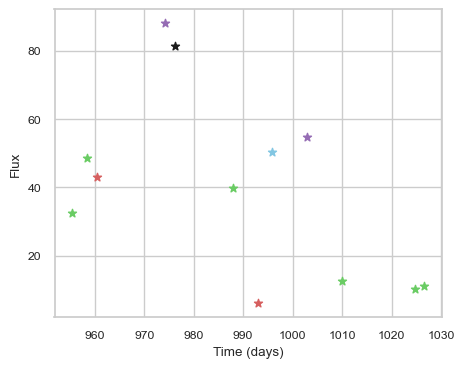

SNIax (3.8662987, False)
SNIax (3.4866297, False)
SNIax (3.1413732, False)
SNIax (3.4402611, False)
SNIax (3.7424288, False)
SNIax (3.4054797, False)
SNIax (3.3452394, False)
SNIax (3.4430134, False)
SNIax (3.8696895, False)
SNIax (3.5298243, False)
SNIax (3.813899, False)
SNIax (3.7703075, False)
SNIax (4.419563, False)
SNIax (3.3863683, False)
SNIax (4.410215, False)
SNIax (3.6594853, False)
SNIax (3.6055639, False)
SNIax (3.6991088, False)
SNIax (3.3644295, False)
SNIax (2.7819796, False)
SNIax (3.0610049, False)
SNIax (3.360589, False)
SNIax (3.3856843, False)
SNIax (3.3363416, False)


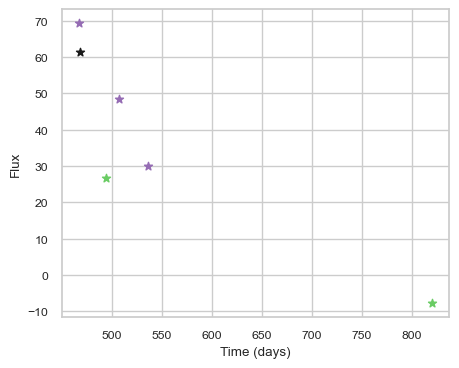

SNIax (3.8420465, False)
SNIax (3.7425382, False)
SNIax (3.694469, False)
SNIax (3.6457684, False)
SNIax (3.7330937, False)
SNIax (3.7773297, False)
SNIax (4.0426574, False)
SNIax (3.93395, False)
SNIax (4.526919, False)
SNIax (4.776655, False)
SNIax (4.217253, False)
SNIax (4.8124986, False)


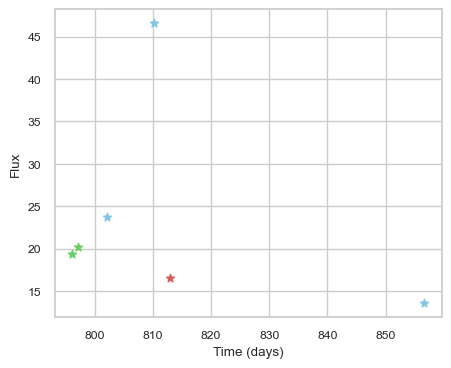

SNIax (3.9743214, False)
SNIax (3.3836026, False)
SNIax (3.1451623, False)
SNIax (3.146094, False)
SNIax (3.2259881, False)
SNIax (3.1174424, False)
SNIax (2.7492392, False)
SNIax (3.0648718, False)
SNIax (3.1740808, False)
SNIax (2.2676287, False)
SNIax (3.0693758, False)
SNIax (2.7284472, False)


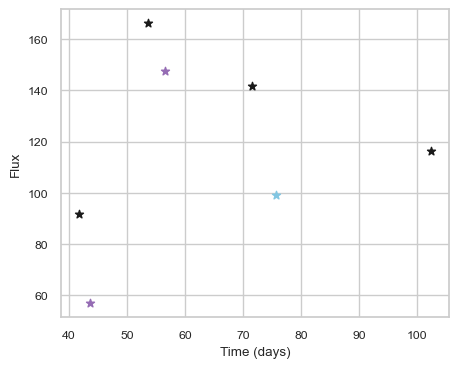

SNIax (3.8739722, False)
SNIax (3.2969236, False)
SNIax (4.0228357, False)
SNIax (3.8249085, False)
SNIax (3.8048158, False)
SNIax (3.5178618, False)
SNIax (3.807941, False)
SNIax (4.0493054, False)
SNIax (3.9004457, False)
SNIax (3.9894805, False)
SNIax (4.18806, False)
SNIax (4.266354, False)
SNIax (4.4876213, False)
SNIax (4.5022335, False)


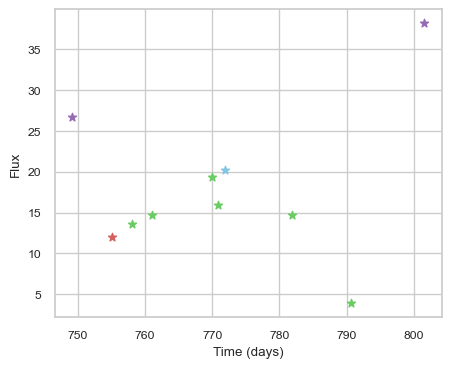

SNIax (4.3330746, False)
SNIax (3.5058317, False)
SNIax (3.2879558, False)
SNIax (3.366511, False)
SNIax (3.753549, False)
SNIax (3.1836991, False)
SNIax (3.7992795, False)
SNIax (3.393833, False)
SNIax (3.3637788, False)
SNIax (3.102526, False)
SNIax (3.157034, False)
SNIax (3.0449417, False)
SNIax (3.2592263, False)
SNIax (2.922056, False)
SNIax (3.2158785, False)
SNIax (3.4354453, False)
SNIax (3.9854183, False)
SNIax (3.801483, False)
SNIax (4.364918, False)
SNIax (3.3949058, False)


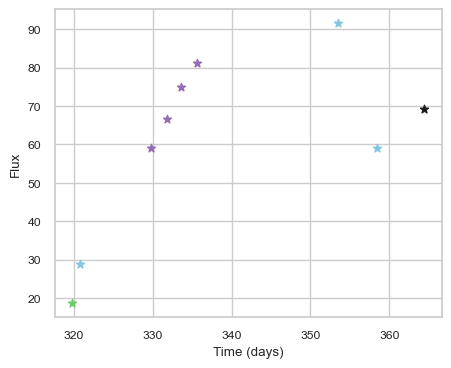

SNIax (3.8145523, False)
SNIax (4.015182, False)
SNIax (3.4773521, False)
SNIax (3.4357078, False)
SNIax (3.0326025, False)
SNIax (3.458641, False)
SNIax (3.887944, False)
SNIax (3.4847226, False)
SNIax (3.8739684, False)
SNIax (3.368335, False)
SNIax (4.099837, False)
SNIax (3.3398323, False)
SNIax (4.225027, False)
SNIax (4.4326725, False)
SNIax (5.4028807, False)
SNIax (5.4914303, False)
SNIax (5.1981206, False)
SNIax (5.3280463, False)


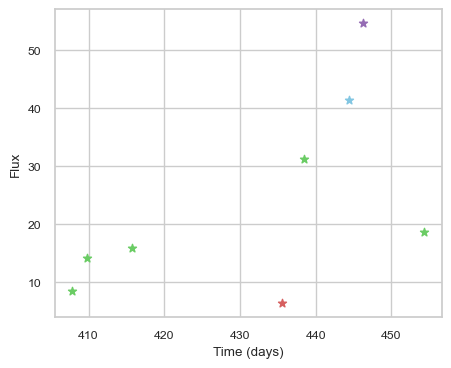

SNIax (4.117783, False)
SNIax (3.5958452, False)
SNIax (3.4529808, False)
SNIax (2.8698535, False)
SNIax (2.9810817, False)
SNIax (2.8323467, False)
SNIax (2.8362617, False)
SNIax (3.0495584, False)
SNIax (2.6486614, False)
SNIax (2.1613677, False)
SNIax (2.7744777, False)
SNIax (2.4860373, False)
SNIax (3.0014756, False)
SNIax (2.683104, False)
SNIax (3.0212348, False)
SNIax (2.920451, False)


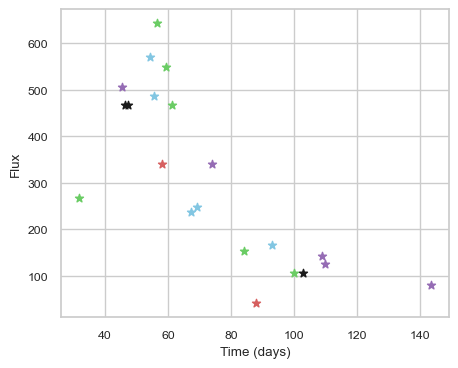

SNIax (3.6631856, False)
SNIax (3.2700799, False)
SNIax (3.238407, False)
SNIax (2.8096378, False)
SNIax (3.2882333, False)
SNIax (3.2328682, False)
SNIax (3.322999, False)
SNIax (3.574764, False)
SNIax (2.8944454, False)
SNIax (3.4442744, False)
SNIax (2.865607, False)
SNIax (3.299421, False)
SNIax (3.288705, False)
SNIax (3.2506294, False)
SNIax (3.5285122, False)
SNIax (4.298113, False)
SNIax (4.3262, False)
SNIax (4.185732, False)
SNIax (3.4816148, False)
SNIax (4.3274612, False)
SNIax (3.6820877, False)
SNIax (4.0251794, False)
SNIax (3.54906, False)
SNIax (4.3705173, False)
SNIax (3.8247275, False)
SNIax (3.945436, False)
SNIax (2.6159124, False)
SNIax (3.163487, False)
SNIax (3.2305489, False)
SNIax (3.0368052, False)
SNIax (3.3312833, False)
SNIax (3.5356662, False)
SNIax (3.6876028, False)
SNIax (3.5297456, False)
SNIax (3.2836816, False)
SNIax (4.1651316, False)
SNIax (3.4385495, False)
SNIax (3.5126636, False)
SNIax (3.7321632, False)
SNIax (3.474469, False)
SNIax (3.2301364

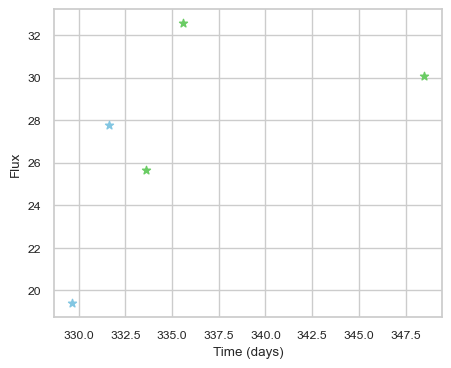

SNIax (4.1348915, False)
SNIax (3.7424204, False)
SNIax (3.2637727, False)
SNIax (3.4192975, False)
SNIax (3.0607975, False)
SNIax (2.915967, False)
SNIax (3.27948, False)
SNIax (2.5963109, False)
SNIax (2.690917, False)
SNIax (2.5152917, False)


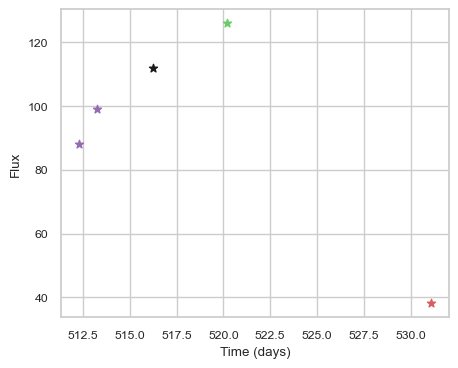

SNIax (3.8800986, False)
SNIax (4.37472, False)
SNIax (5.0260587, False)
SNIax (5.3629627, False)
SNIax (5.940496, False)
SNIax (5.6466336, False)
SNIax (5.3448153, False)
SNIax (5.071541, False)
SNIax (5.0246787, False)
SNIax (5.084892, False)


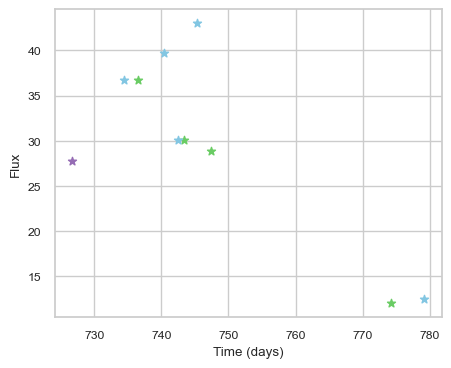

SNIax (4.00949, False)
SNIax (3.278636, False)
SNIax (3.159999, False)
SNIax (3.4795392, False)
SNIax (2.9202886, False)
SNIax (2.5985758, False)
SNIax (2.9118888, False)
SNIax (1.8003769, False)
SNIax (2.4548807, False)
SNIax (1.7324252, False)
SNIax (2.468054, False)
SNIax (2.2833953, False)
SNIax (3.1465971, False)
SNIax (1.9725573, False)
SNIax (2.62729, False)
SNIax (2.0998836, False)
SNIax (2.6516337, False)
SNIax (2.8539336, False)
SNIax (2.6618352, False)
SNIax (2.1928904, False)


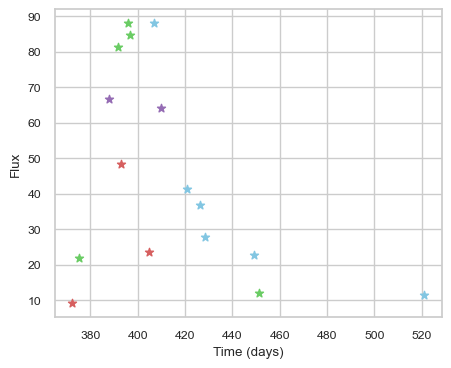

SNIax (3.9583025, False)
SNIax (4.0446324, False)
SNIax (3.5587778, False)
SNIax (2.7395487, False)
SNIax (3.500916, False)
SNIax (3.136076, False)
SNIax (3.8102367, False)
SNIax (3.556646, False)
SNIax (4.1779327, False)
SNIax (4.1481204, False)
SNIax (4.6765356, False)
SNIax (4.293295, False)
SNIax (4.5854464, False)
SNIax (4.5387497, False)
SNIax (4.844018, False)
SNIax (5.0462313, False)
SNIax (5.158951, False)
SNIax (5.1158338, False)
SNIax (5.260949, False)
SNIax (5.0368614, False)
SNIax (5.1994452, False)
SNIax (5.0005426, False)
SNIax (5.0884275, False)
SNIax (4.7085547, False)
SNIax (4.8194547, False)
SNIax (4.608721, False)
SNIax (4.54935, False)
SNIax (4.6732063, False)
SNIax (4.6667256, False)
SNIax (4.6115165, False)
SNIax (4.9217973, False)
SNIax (4.468424, False)


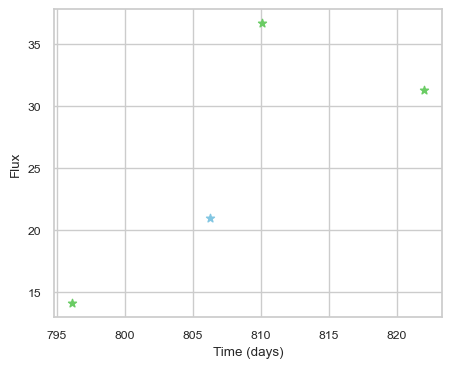

SNIax (3.9716234, False)
SNIax (3.4003055, False)
SNIax (3.318048, False)
SNIax (3.355876, False)
SNIax (3.763915, False)
SNIax (3.609145, False)
SNIax (2.975425, False)
SNIax (3.6952012, False)


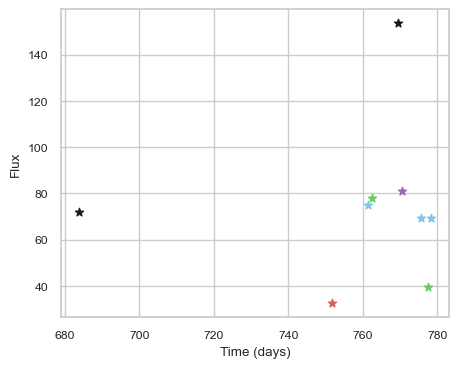

SNIax (3.9475617, False)
SNIax (3.9330077, False)
SNIax (4.07729, False)
SNIax (4.2538524, False)
SNIax (4.2695746, False)
SNIax (4.102316, False)
SNIax (5.514144, False)
SNIax (5.459867, False)
SNIax (6.2406, False)
SNIax (6.3481226, False)
SNIax (4.5857778, False)
SNIax (4.0701385, False)
SNIax (4.2889576, False)
SNIax (3.7538874, False)
SNIax (3.4069605, False)
SNIax (3.9017296, False)
SNIax (3.9730606, False)
SNIax (3.343174, False)


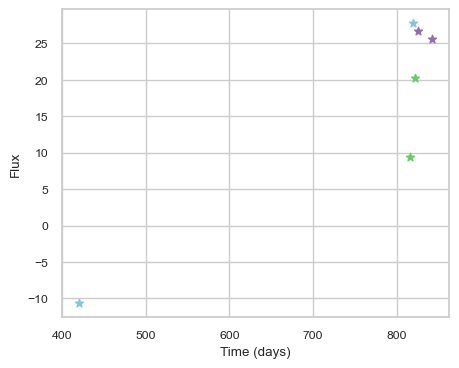

SNIax (4.3387027, False)
SNIax (4.2049174, False)
SNIax (4.087529, False)
SNIax (3.3631034, False)
SNIax (3.542838, False)
SNIax (3.2762156, False)
SNIax (3.215585, False)
SNIax (2.426805, False)
SNIax (2.860295, False)
SNIax (2.6204097, False)
SNIax (2.7581878, False)
SNIax (2.5596225, False)


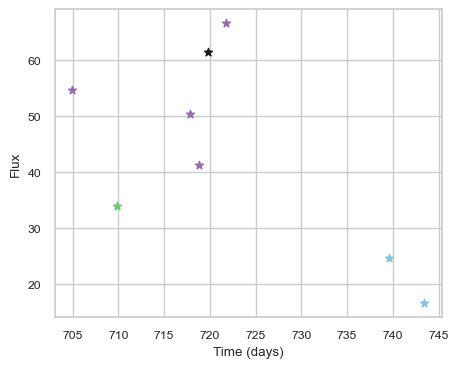

SNIax (3.9090285, False)
SNIax (3.5142033, False)
SNIax (4.114018, False)
SNIax (3.5737643, False)
SNIax (3.301576, False)
SNIax (3.016584, False)
SNIax (3.200509, False)
SNIax (2.6183386, False)
SNIax (3.747236, False)
SNIax (3.876263, False)
SNIax (3.6058195, False)
SNIax (3.119469, False)
SNIax (2.837907, False)
SNIax (2.4685235, False)
SNIax (3.3276498, False)
SNIax (2.559512, False)


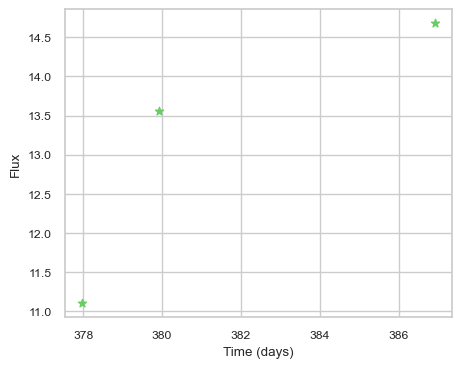

SNIax (3.7756433, False)
SNIax (3.4624994, False)
SNIax (3.456698, False)
SNIax (2.941419, False)
SNIax (2.9396586, False)
SNIax (2.9780662, False)


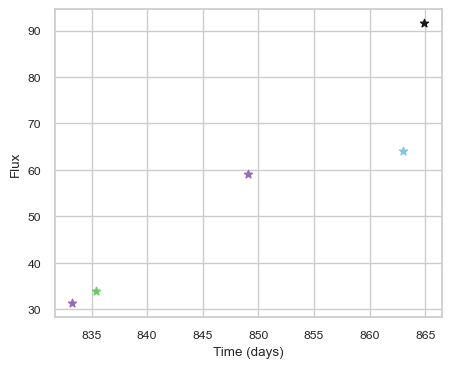

SNIax (4.0048003, False)
SNIax (3.484256, False)
SNIax (3.349772, False)
SNIax (3.1207986, False)
SNIax (3.8547482, False)
SNIax (4.400391, False)
SNIax (4.8649054, False)
SNIax (4.6916375, False)
SNIax (5.1503015, False)
SNIax (5.4217095, False)


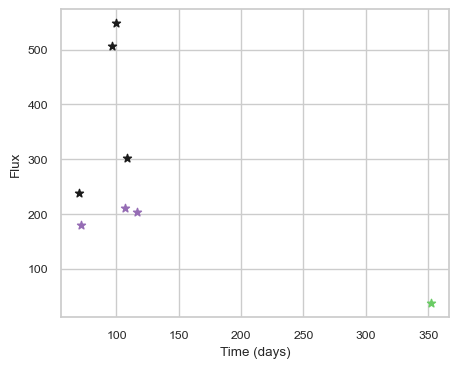

SNIax (3.9194086, False)
SNIax (3.6991477, False)
SNIax (3.9216502, False)
SNIax (4.5396543, False)
SNIax (3.6767051, False)
SNIax (3.519823, False)
SNIax (3.6327667, False)
SNIax (3.7157028, False)
SNIax (3.1153517, False)
SNIax (3.7642727, False)
SNIax (3.8830547, False)
SNIax (4.042137, False)
SNIax (4.121936, False)
SNIax (4.376879, False)
SNIax (3.2466478, False)
SNIax (4.445315, False)


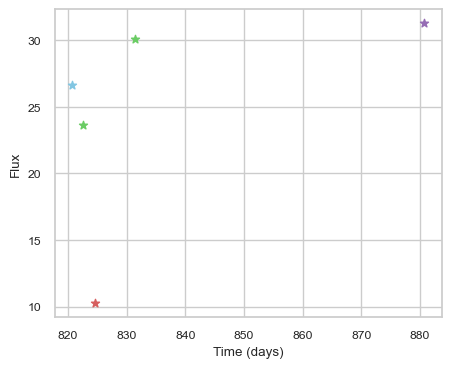

SNIax (4.099528, False)
SNIax (3.5734463, False)
SNIax (3.377126, False)
SNIax (3.1080968, False)
SNIax (3.2057123, False)
SNIax (3.002162, False)
SNIax (3.3333411, False)
SNIax (3.4291785, False)
SNIax (3.0230644, False)
SNIax (3.0423133, False)


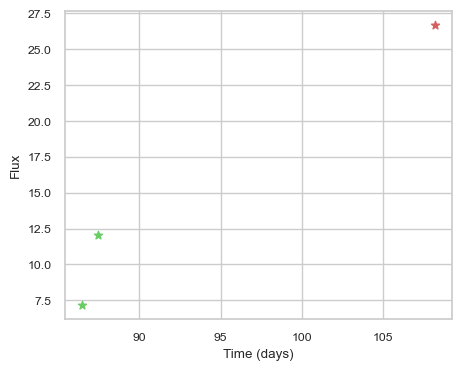

SNIax (4.2140102, False)
SNIax (3.7653594, False)
SNIax (3.4330797, False)
SNIax (3.130814, False)
SNIax (2.7924612, False)
SNIax (3.7510557, False)


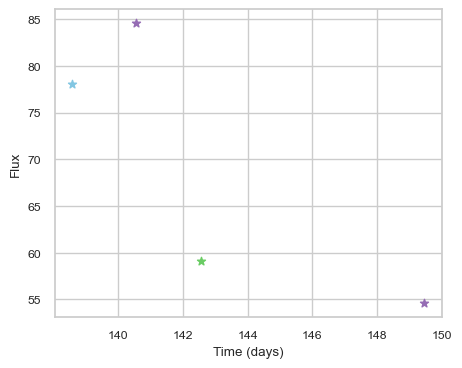

SNIax (4.020063, False)
SNIax (5.120181, False)
SNIax (5.088386, False)
SNIax (5.3520317, False)
SNIax (5.5647287, False)
SNIax (5.2739477, False)
SNIax (4.840701, False)
SNIax (4.516711, False)


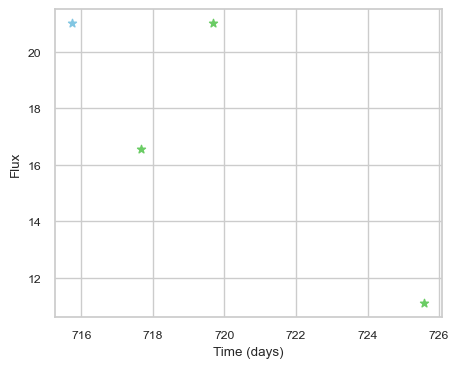

SNIax (4.025355, False)
SNIax (3.5680816, False)
SNIax (3.0766098, False)
SNIax (2.877685, False)
SNIax (3.1203053, False)
SNIax (2.4554293, False)
SNIax (2.5904646, False)
SNIax (2.693524, False)


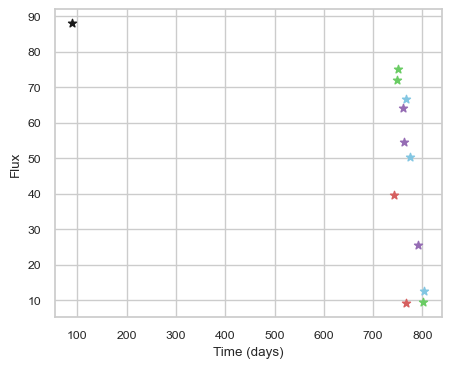

SNIax (3.8194036, False)
SNIax (4.046608, False)
SNIax (3.8626776, False)
SNIax (3.8554263, False)
SNIax (4.1785183, False)
SNIax (4.1038723, False)
SNIax (3.3203366, False)
SNIax (3.3038342, False)
SNIax (3.3643708, False)
SNIax (2.647309, False)
SNIax (3.5057228, False)
SNIax (2.7680683, False)
SNIax (3.419001, False)
SNIax (3.5790076, False)
SNIax (4.075102, False)
SNIax (3.657578, False)
SNIax (3.7920103, False)
SNIax (3.752424, False)
SNIax (3.9643974, False)
SNIax (3.4415727, False)
SNIax (3.0130272, False)
SNIax (3.4409664, False)
SNIax (2.9146078, False)
SNIax (3.235874, False)


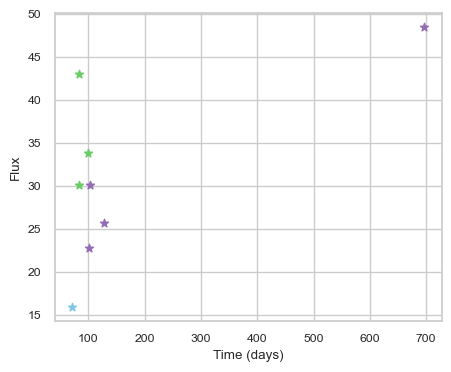

SNIax (4.2582707, False)
SNIax (3.6294558, False)
SNIax (3.1907184, False)
SNIax (3.0559921, False)
SNIax (3.1644192, False)
SNIax (3.3730133, False)
SNIax (3.5254083, False)
SNIax (2.878426, False)
SNIax (3.2104342, False)
SNIax (3.0182173, False)
SNIax (2.5318913, False)
SNIax (2.3626676, False)
SNIax (2.6488862, False)
SNIax (2.5739818, False)
SNIax (3.0673702, False)
SNIax (2.8326178, False)


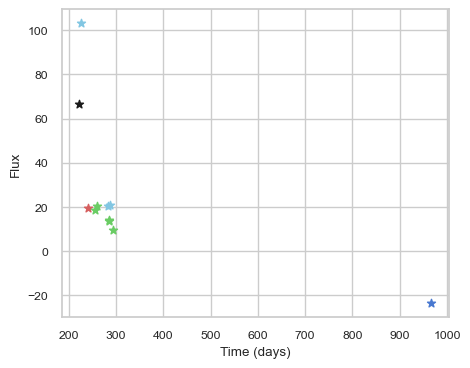

SNIax (3.798986, False)
SNIax (3.2470026, False)
SNIax (3.4162679, False)
SNIax (3.1679244, False)
SNIax (3.297045, False)
SNIax (2.978172, False)
SNIax (3.8477814, False)
SNIax (3.0033882, False)
SNIax (3.6071453, False)
SNIax (2.8969743, False)
SNIax (3.4406595, False)
SNIax (2.787451, False)
SNIax (2.5575943, False)
SNIax (2.986915, False)
SNIax (3.2125494, False)
SNIax (3.184019, False)
SNIax (3.399356, False)
SNIax (2.977903, False)
SNIax (3.1709032, False)
SNIax (3.1328492, False)
SNIax (3.541205, False)
SNIax (3.6551373, False)


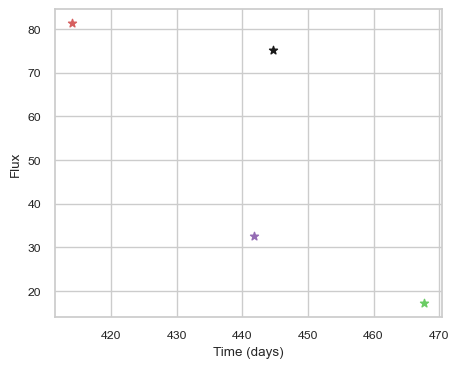

SNIax (3.820029, False)
SNIax (4.4726386, False)
SNIax (3.6251197, False)
SNIax (4.4512463, False)
SNIax (4.696998, False)
SNIax (4.5939198, False)
SNIax (5.7480035, False)
SNIax (4.957851, False)


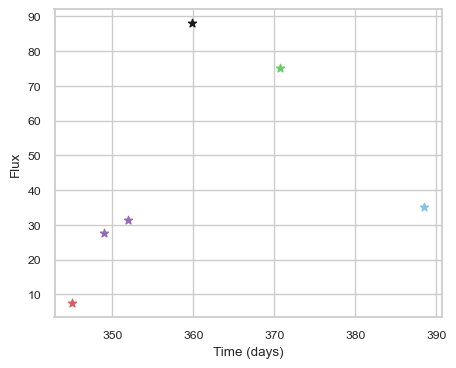

SNIax (3.9137866, False)
SNIax (3.7238686, False)
SNIax (3.581054, False)
SNIax (3.0173001, False)
SNIax (3.2332406, False)
SNIax (3.1784377, False)
SNIax (2.7286284, False)
SNIax (2.9069645, False)
SNIax (3.2761776, False)
SNIax (2.9162667, False)
SNIax (3.132382, False)
SNIax (2.231487, False)


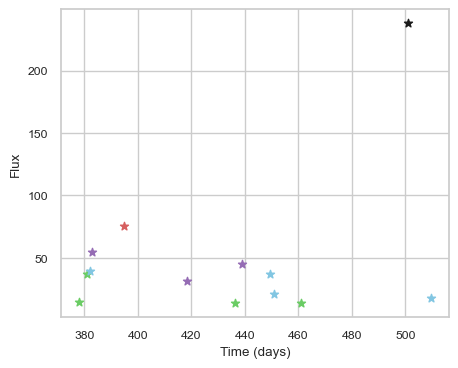

SNIax (4.0496254, False)
SNIax (3.3563356, False)
SNIax (3.5743473, False)
SNIax (3.073945, False)
SNIax (3.0239263, False)
SNIax (3.169235, False)
SNIax (3.5522876, False)
SNIax (3.4456093, False)
SNIax (4.41987, False)
SNIax (4.664534, False)
SNIax (5.433, False)
SNIax (3.7654436, False)
SNIax (4.245116, False)
SNIax (3.756066, False)
SNIax (4.050312, False)
SNIax (3.5525465, False)
SNIax (3.9707055, False)
SNIax (3.6366575, False)
SNIax (4.076895, False)
SNIax (3.1737056, False)
SNIax (3.4712546, False)
SNIax (3.688471, False)
SNIax (4.165938, False)
SNIax (4.174081, False)
SNIax (3.460609, False)
SNIax (3.6074207, False)


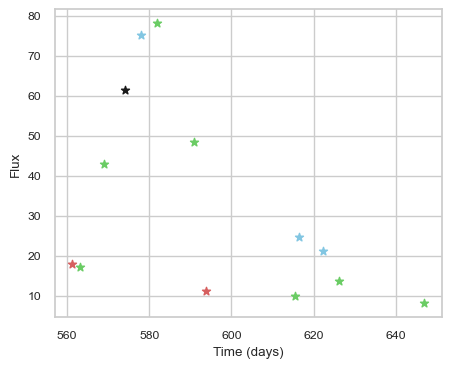

SNIax (3.5852714, False)
SNIax (3.5762784, False)
SNIax (3.4821548, False)
SNIax (4.2307653, False)
SNIax (4.894665, False)
SNIax (3.4091756, False)
SNIax (3.5027432, False)
SNIax (3.8767052, False)
SNIax (3.8963263, False)
SNIax (3.824981, False)
SNIax (4.5178704, False)
SNIax (3.670883, False)
SNIax (3.1591218, False)
SNIax (3.860166, False)
SNIax (4.158341, False)
SNIax (4.20017, False)
SNIax (2.6524317, False)
SNIax (3.2764664, False)
SNIax (2.9586844, False)
SNIax (3.051818, False)
SNIax (3.029882, False)
SNIax (3.0694504, False)
SNIax (2.9971092, False)
SNIax (3.0190217, False)
SNIax (2.8349192, False)
SNIax (2.8229246, False)


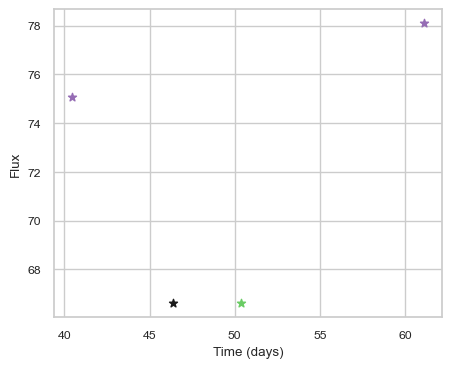

SNIax (4.597207, False)
SNIax (5.724744, False)
SNIax (5.910744, False)
SNIax (5.837558, False)
SNIax (6.079095, False)
SNIax (6.079806, False)
SNIax (5.997477, False)
SNIax (6.03118, False)


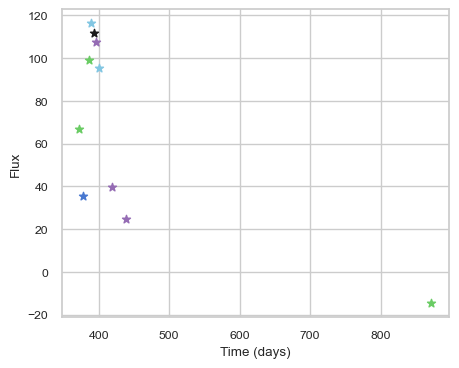

SNIax (3.8564608, False)
SNIax (3.4910722, False)
SNIax (4.0317864, False)
SNIax (3.5918326, False)
SNIax (3.3453119, False)
SNIax (3.232095, False)
SNIax (3.3316147, False)
SNIax (3.2051313, False)
SNIax (4.0929394, False)
SNIax (3.7850757, False)
SNIax (4.3435507, False)
SNIax (4.219397, False)
SNIax (4.2879534, False)
SNIax (3.9920895, False)
SNIax (4.300011, False)
SNIax (3.5395803, False)
SNIax (2.8746502, False)
SNIax (2.9874868, False)
SNIax (3.080694, False)
SNIax (2.5525384, False)


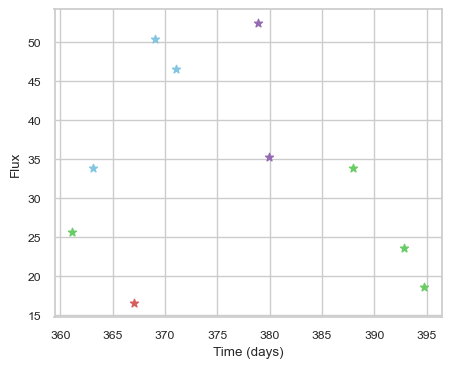

SNIax (4.004436, False)
SNIax (3.2738633, False)
SNIax (3.510414, False)
SNIax (2.847426, False)
SNIax (3.2407272, False)
SNIax (2.3159745, False)
SNIax (2.298555, False)
SNIax (3.0254304, False)
SNIax (3.9551816, False)
SNIax (3.3677847, False)
SNIax (3.7558386, False)
SNIax (3.6221664, False)
SNIax (4.0114727, False)
SNIax (3.1682212, False)
SNIax (2.9564028, False)
SNIax (3.2102664, False)
SNIax (3.348619, False)
SNIax (2.9886138, False)
SNIax (3.1463432, False)
SNIax (3.0523376, False)


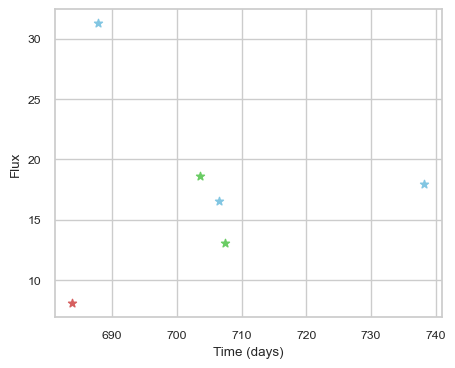

SNIax (3.7448783, False)
SNIax (4.627963, False)
SNIax (3.2674754, False)
SNIax (3.0413458, False)
SNIax (2.9400067, False)
SNIax (3.1324413, False)
SNIax (3.3645787, False)
SNIax (3.082851, False)
SNIax (3.1875367, False)
SNIax (3.347964, False)
SNIax (3.8870053, False)
SNIax (3.575609, False)


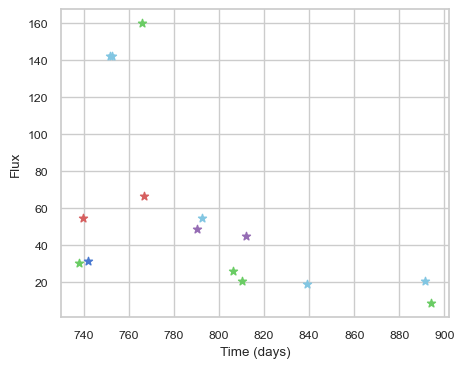

SNIax (3.8038647, False)
SNIax (3.1773047, False)
SNIax (3.1829839, False)
SNIax (3.8332324, False)
SNIax (3.7950127, False)
SNIax (4.9694138, False)
SNIax (4.1575313, False)
SNIax (2.5447953, False)
SNIax (3.1433995, False)
SNIax (2.8634815, False)
SNIax (2.7260087, False)
SNIax (2.296752, False)
SNIax (3.000585, False)
SNIax (2.8556056, False)
SNIax (4.34155, False)
SNIax (3.5209038, False)
SNIax (4.5440793, False)
SNIax (3.6943457, False)
SNIax (3.845013, False)
SNIax (3.4089324, False)
SNIax (3.657202, False)
SNIax (2.9598277, False)
SNIax (3.2626529, False)
SNIax (2.786769, False)
SNIax (3.4578667, False)
SNIax (3.1062179, False)
SNIax (3.197589, False)
SNIax (2.6497252, False)
SNIax (3.48326, False)
SNIax (2.693317, False)


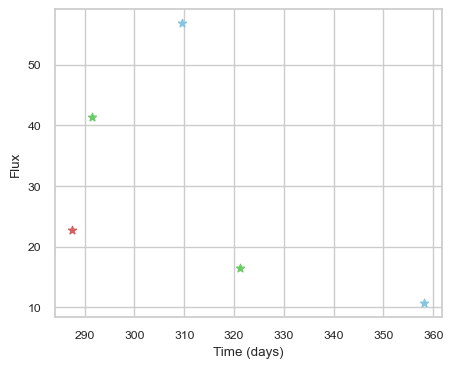

SNIax (4.0167437, False)
SNIax (4.8463635, False)
SNIax (4.4544005, False)
SNIax (3.4216948, False)
SNIax (2.9902732, False)
SNIax (3.4088173, False)
SNIax (3.630803, False)
SNIax (3.0295591, False)
SNIax (3.3314884, False)
SNIax (2.809562, False)


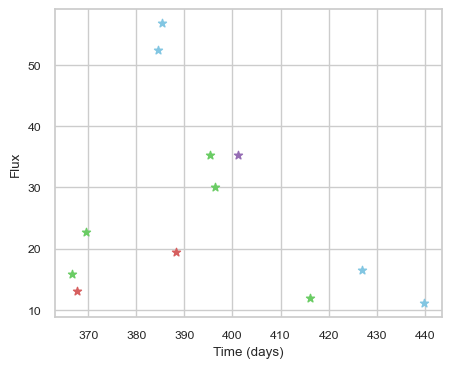

SNIax (4.0055695, False)
SNIax (3.327313, False)
SNIax (3.2205486, False)
SNIax (3.207989, False)
SNIax (3.0809562, False)
SNIax (2.4295092, False)
SNIax (2.8164966, False)
SNIax (3.141297, False)
SNIax (3.244123, False)
SNIax (2.9980867, False)
SNIax (3.4201138, False)
SNIax (2.6236877, False)
SNIax (3.0980906, False)
SNIax (2.8411705, False)
SNIax (3.4609885, False)
SNIax (3.1999428, False)
SNIax (3.6921597, False)
SNIax (3.1310344, False)
SNIax (2.7455528, False)
SNIax (2.9899523, False)
SNIax (3.0144377, False)
SNIax (2.6582928, False)
SNIax (2.4654212, False)
SNIax (2.6617262, False)


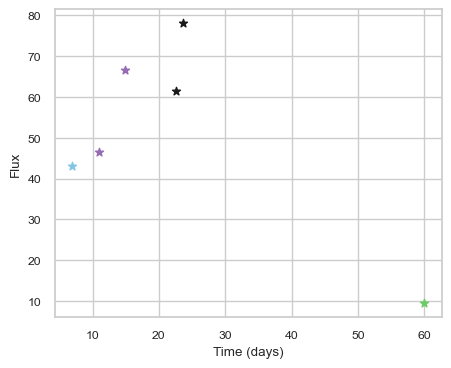

SNIax (3.8536215, False)
SNIax (4.084935, False)
SNIax (4.166064, False)
SNIax (4.6880503, False)
SNIax (4.188279, False)
SNIax (5.5576925, False)
SNIax (4.3832436, False)
SNIax (5.6404734, False)
SNIax (4.973983, False)
SNIax (6.1374683, False)
SNIax (5.6343, False)
SNIax (4.7346225, False)


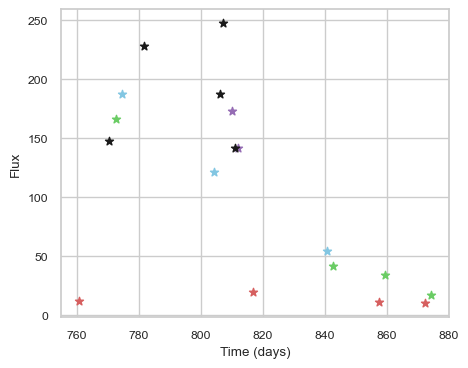

SNIax (3.7514045, False)
SNIax (3.955192, False)
SNIax (3.2746222, False)
SNIax (3.253517, False)
SNIax (3.604321, False)
SNIax (3.250839, False)
SNIax (2.9185514, False)
SNIax (3.1326613, False)
SNIax (3.4271064, False)
SNIax (3.009131, False)
SNIax (3.7627447, False)
SNIax (3.3067527, False)
SNIax (3.7115765, False)
SNIax (3.5900488, False)
SNIax (4.721381, False)
SNIax (3.5799124, False)
SNIax (5.048874, False)
SNIax (3.9360998, False)
SNIax (4.750624, False)
SNIax (3.3340793, False)
SNIax (4.621942, False)
SNIax (3.790291, False)
SNIax (4.0555506, False)
SNIax (4.097732, False)
SNIax (3.6885896, False)
SNIax (4.300297, False)
SNIax (3.7427776, False)
SNIax (3.9541237, False)
SNIax (3.831195, False)
SNIax (3.8005035, False)
SNIax (3.6869028, False)
SNIax (3.923116, False)
SNIax (3.6867163, False)
SNIax (3.8826225, False)
SNIax (3.8329988, False)
SNIax (4.338421, False)


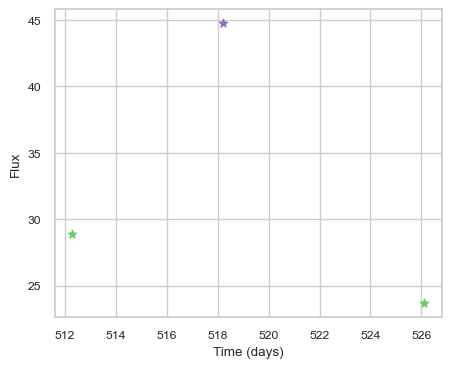

SNIax (4.4855375, False)
SNIax (4.030734, False)
SNIax (3.9200041, False)
SNIax (4.3343525, False)
SNIax (3.9294796, False)
SNIax (3.441593, False)


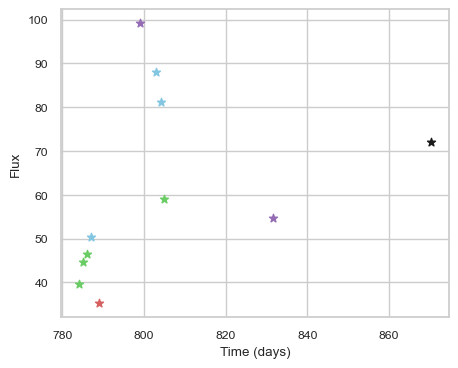

SNIax (3.947388, False)
SNIax (3.3497055, False)
SNIax (3.4366903, False)
SNIax (3.6356363, False)
SNIax (3.5543785, False)
SNIax (3.6475651, False)
SNIax (3.466858, False)
SNIax (3.7499762, False)
SNIax (4.1467366, False)
SNIax (4.102832, False)
SNIax (4.3182354, False)
SNIax (4.547475, False)
SNIax (4.3866696, False)
SNIax (4.526356, False)
SNIax (5.1925583, False)
SNIax (5.0226088, False)
SNIax (5.194853, False)
SNIax (5.1338897, False)
SNIax (5.1921167, False)
SNIax (5.087828, False)
SNIax (4.164439, False)
SNIax (4.9341636, False)


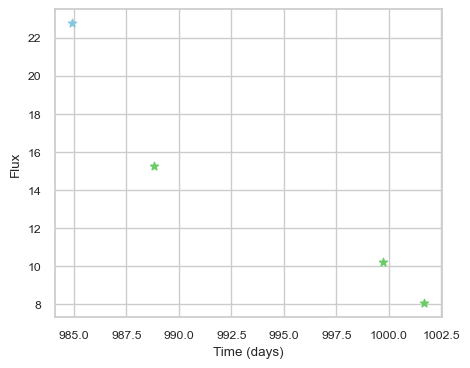

SNIax (4.5640826, False)
SNIax (4.476818, False)
SNIax (4.0643215, False)
SNIax (3.8988512, False)
SNIax (3.4959905, False)
SNIax (3.486677, False)
SNIax (3.2185516, False)
SNIax (3.1712809, False)


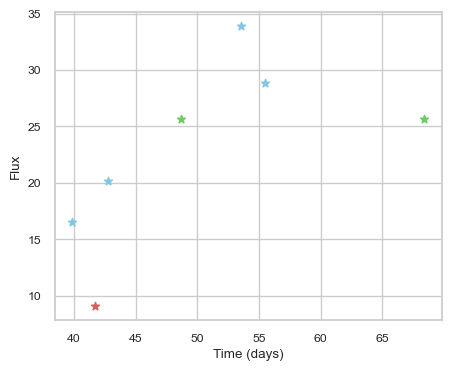

SNIax (4.8136425, False)
SNIax (3.682409, False)
SNIax (3.1385128, False)
SNIax (2.8822222, False)
SNIax (2.8635736, False)
SNIax (2.8441536, False)
SNIax (2.952703, False)
SNIax (2.53448, False)
SNIax (2.9300878, False)
SNIax (3.2493303, False)
SNIax (3.2696655, False)
SNIax (3.0128515, False)
SNIax (3.080394, False)
SNIax (3.361345, False)


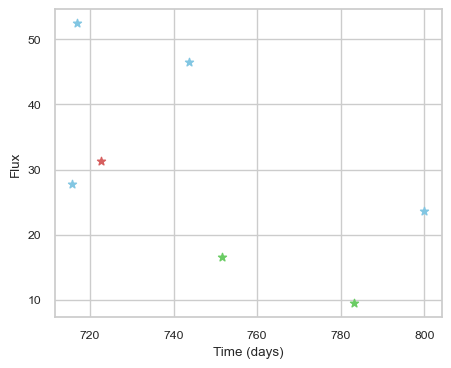

SNIax (3.8129919, False)
SNIax (3.8142147, False)
SNIax (3.150318, False)
SNIax (3.785323, False)
SNIax (3.6060743, False)
SNIax (3.757617, False)
SNIax (3.4626002, False)
SNIax (3.4900923, False)
SNIax (3.54026, False)
SNIax (3.6293106, False)
SNIax (3.4785545, False)
SNIax (3.512964, False)
SNIax (3.2815924, False)
SNIax (3.566823, False)


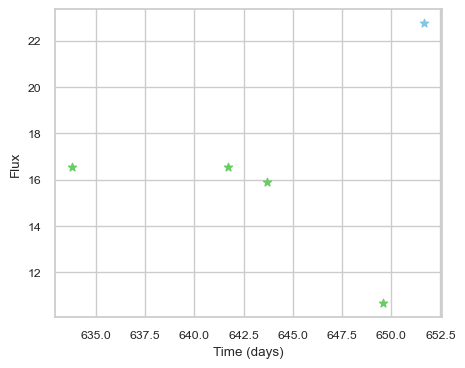

SNIax (4.56914, False)
SNIax (3.8886924, False)
SNIax (3.7155693, False)
SNIax (3.483103, False)
SNIax (3.7387588, False)
SNIax (3.275578, False)
SNIax (3.6415534, False)
SNIax (3.2175303, False)
SNIax (3.0311427, False)
SNIax (2.6014903, False)


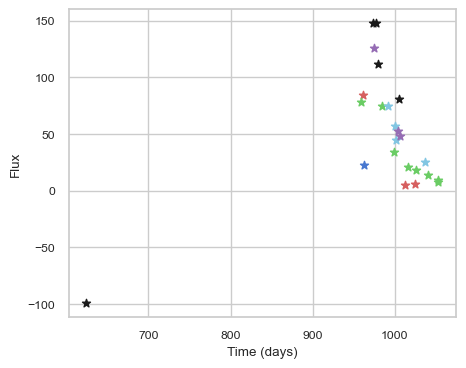

SNIax (3.8963466, False)
SNIax (3.846139, False)
SNIax (3.6830485, False)
SNIax (3.7791061, False)
SNIax (3.712174, False)
SNIax (3.3978481, False)
SNIax (3.591759, False)
SNIax (3.5814438, False)
SNIax (3.4870827, False)
SNIax (3.3932896, False)
SNIax (3.7802882, False)
SNIax (2.614771, False)
SNIax (3.661741, False)
SNIax (2.6245706, False)
SNIax (3.7434838, False)
SNIax (2.9818907, False)
SNIax (3.0615022, False)
SNIax (2.777896, False)
SNIax (3.3515837, False)
SNIax (3.2431285, False)
SNIax (3.3712256, False)
SNIax (2.8555238, False)
SNIax (3.7529242, False)
SNIax (3.0561938, False)
SNIax (4.3093953, False)
SNIax (3.1329865, False)
SNIax (3.5079145, False)
SNIax (3.6784084, False)
SNIax (3.9782484, False)
SNIax (3.720455, False)
SNIax (4.3244576, False)
SNIax (4.0596066, False)
SNIax (3.3650994, False)
SNIax (3.553046, False)
SNIax (3.7197964, False)
SNIax (3.1811132, False)
SNIax (3.131356, False)
SNIax (3.1677, False)
SNIax (3.311815, False)
SNIax (3.579812, False)
SNIax (2.80779

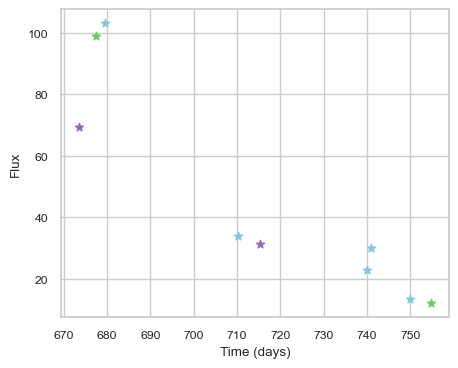

SNIax (3.8033302, False)
SNIax (3.722748, False)
SNIax (4.322799, False)
SNIax (4.783007, False)
SNIax (4.9500146, False)
SNIax (5.1172194, False)
SNIax (5.158281, False)
SNIax (4.905435, False)
SNIax (4.5344286, False)
SNIax (4.0491986, False)
SNIax (4.9526076, False)
SNIax (4.7103553, False)
SNIax (4.3964834, False)
SNIax (4.6711664, False)
SNIax (4.196711, False)
SNIax (4.507874, False)
SNIax (3.9253643, False)
SNIax (4.2202477, False)


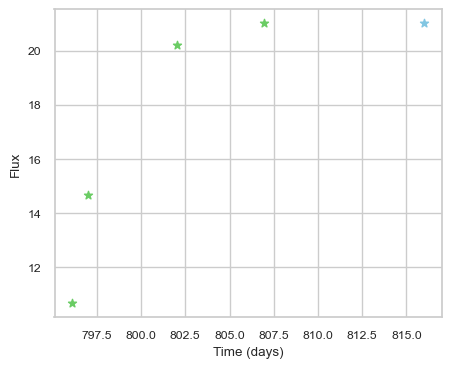

SNIax (4.145392, False)
SNIax (3.419131, False)
SNIax (3.2063227, False)
SNIax (2.9947517, False)
SNIax (3.11931, False)
SNIax (2.4387121, False)
SNIax (2.675111, False)
SNIax (2.3339803, False)
SNIax (2.0466163, False)
SNIax (2.252718, False)


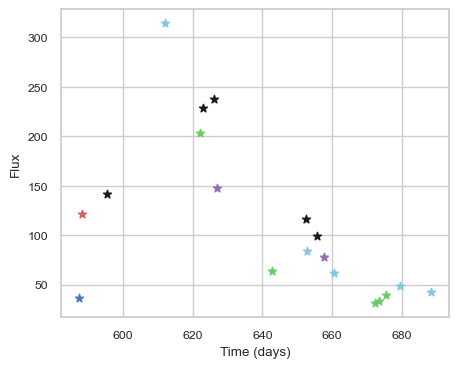

SNIax (3.654952, False)
SNIax (3.630884, False)
SNIax (4.393292, False)
SNIax (3.881841, False)
SNIax (3.800504, False)
SNIax (3.3006232, False)
SNIax (3.4550624, False)
SNIax (3.1532063, False)
SNIax (3.8583608, False)
SNIax (3.6140492, False)
SNIax (3.9717085, False)
SNIax (4.322295, False)
SNIax (3.9172184, False)
SNIax (2.6684468, False)
SNIax (3.727481, False)
SNIax (2.3434224, False)
SNIax (3.407921, False)
SNIax (2.551287, False)
SNIax (2.8415337, False)
SNIax (3.0658092, False)
SNIax (2.6399527, False)
SNIax (2.533183, False)
SNIax (3.167379, False)
SNIax (3.0238662, False)
SNIax (3.2714462, False)
SNIax (2.5899684, False)
SNIax (2.9067, False)
SNIax (2.4941897, False)
SNIax (2.7184412, False)
SNIax (2.6502805, False)
SNIax (2.791749, False)
SNIax (2.6801775, False)
SNIax (3.0459237, False)
SNIax (2.478817, False)
SNIax (3.0682743, False)
SNIax (2.3229635, False)
SNIax (2.39784, False)
SNIax (2.2169018, False)


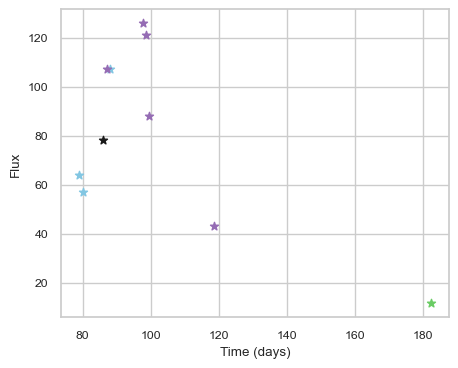

SNIax (3.8396468, False)
SNIax (4.3211293, False)
SNIax (4.0963235, False)
SNIax (3.678566, False)
SNIax (3.3999941, False)
SNIax (3.637199, False)
SNIax (3.4704275, False)
SNIax (4.0699687, False)
SNIax (4.169662, False)
SNIax (4.2857356, False)
SNIax (3.8230493, False)
SNIax (3.701551, False)
SNIax (4.0743847, False)
SNIax (3.8795283, False)
SNIax (4.342276, False)
SNIax (3.8937674, False)
SNIax (3.3854477, False)
SNIax (3.5477962, False)
SNIax (3.2810564, False)
SNIax (3.0846713, False)


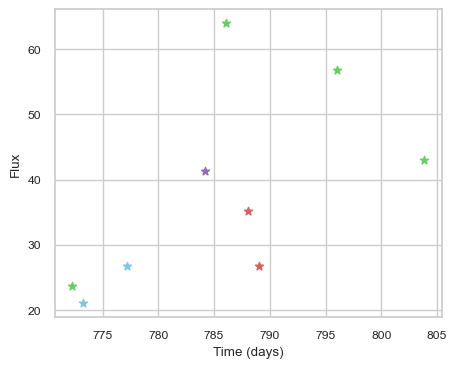

SNIax (3.8925612, False)
SNIax (3.3934836, False)
SNIax (3.2799718, False)
SNIax (3.7312596, False)
SNIax (3.9693987, False)
SNIax (3.8142457, False)
SNIax (3.9904404, False)
SNIax (3.8200703, False)
SNIax (3.7603621, False)
SNIax (3.11757, False)
SNIax (3.10441, False)
SNIax (2.523816, False)
SNIax (2.8919091, False)
SNIax (1.689166, False)
SNIax (2.6451488, False)
SNIax (1.494664, False)
SNIax (2.5168183, False)
SNIax (1.7071143, False)


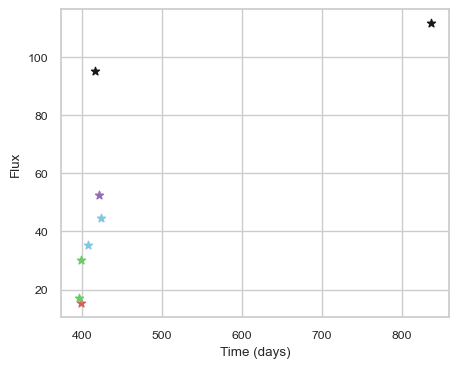

SNIax (3.9209042, False)
SNIax (3.6567845, False)
SNIax (3.3882277, False)
SNIax (3.4128666, False)
SNIax (4.079842, False)
SNIax (2.3354535, False)
SNIax (2.8227599, False)
SNIax (2.7820735, False)
SNIax (2.5400207, False)
SNIax (2.6987586, False)
SNIax (3.4857385, False)
SNIax (3.8389359, False)
SNIax (4.168236, False)
SNIax (4.1962466, False)
SNIax (3.581953, False)
SNIax (3.8044379, False)


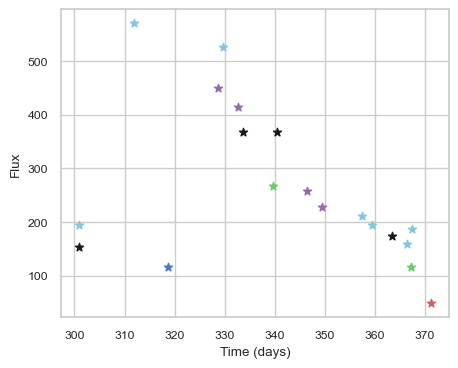

SNIax (5.4368687, False)
SNIax (4.2925043, False)
SNIax (4.0835056, False)
SNIax (4.2646184, False)
SNIax (3.147678, False)
SNIax (3.8424606, False)
SNIax (2.8274639, False)
SNIax (4.215249, False)
SNIax (2.994886, False)
SNIax (3.2857919, False)
SNIax (3.306734, False)
SNIax (3.5337434, False)
SNIax (3.0757031, False)
SNIax (2.7384398, False)
SNIax (3.0702097, False)
SNIax (2.9363432, False)
SNIax (3.0642774, False)
SNIax (2.7097545, False)
SNIax (2.7661583, False)
SNIax (2.6048622, False)
SNIax (3.158961, False)
SNIax (2.7046049, False)
SNIax (3.0355425, False)
SNIax (2.8439152, False)
SNIax (2.5929213, False)
SNIax (2.7264314, False)
SNIax (2.5011685, False)
SNIax (3.0836198, False)
SNIax (2.9124863, False)
SNIax (3.5065982, False)
SNIax (3.3207016, False)
SNIax (2.8494534, False)
SNIax (2.844131, False)
SNIax (2.9562068, False)
SNIax (3.1657586, False)
SNIax (2.9357452, False)
SNIax (2.8644292, False)
SNIax (3.0160248, False)


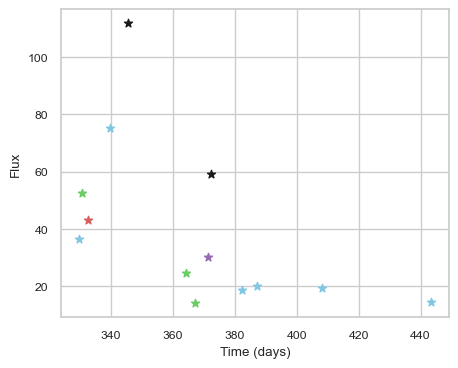

SNIax (4.1201644, False)
SNIax (4.2523403, False)
SNIax (3.4623075, False)
SNIax (4.1628838, False)
SNIax (4.6602945, False)
SNIax (4.533814, False)
SNIax (4.926303, False)
SNIax (4.1028204, False)
SNIax (4.7269487, False)
SNIax (4.9743886, False)
SNIax (3.9291348, False)
SNIax (3.2090888, False)
SNIax (3.5698972, False)
SNIax (2.9654996, False)
SNIax (3.305787, False)
SNIax (3.6787179, False)
SNIax (4.1894326, False)
SNIax (3.944712, False)
SNIax (3.1007533, False)
SNIax (3.0265193, False)
SNIax (2.727611, False)
SNIax (3.3047745, False)
SNIax (3.4660904, False)
SNIax (3.658802, False)
SNIax (4.014977, False)
SNIax (3.883848, False)


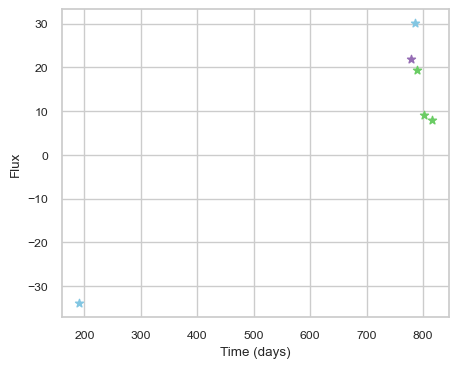

SNIax (5.9397926, False)
SNIax (4.4041786, False)
SNIax (4.8400865, False)
SNIax (4.9947343, False)
SNIax (4.8758283, False)
SNIax (5.3956423, False)
SNIax (5.2176313, False)
SNIax (5.4026155, False)
SNIax (5.1193576, False)
SNIax (5.0867205, False)
SNIax (4.4382105, False)
SNIax (4.806989, False)


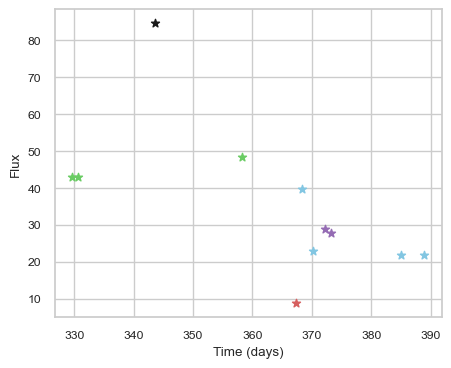

SNIax (4.101854, False)
SNIax (4.6307006, False)
SNIax (4.177513, False)
SNIax (4.381046, False)
SNIax (4.1715317, False)
SNIax (4.320226, False)
SNIax (4.9069023, False)
SNIax (4.44274, False)
SNIax (4.8977494, False)
SNIax (3.8002558, False)
SNIax (4.7138047, False)
SNIax (3.982264, False)
SNIax (3.8762429, False)
SNIax (3.1461558, False)
SNIax (3.3674772, False)
SNIax (3.653498, False)
SNIax (3.9676783, False)
SNIax (3.6348038, False)
SNIax (3.3997483, False)
SNIax (3.4060898, False)
SNIax (3.588828, False)
SNIax (3.4867356, False)


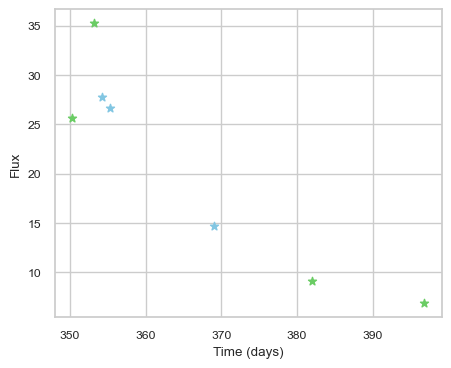

SNIax (3.8358157, False)
SNIax (3.8269196, False)
SNIax (3.5038993, False)
SNIax (3.1709933, False)
SNIax (3.0195208, False)
SNIax (2.636285, False)
SNIax (3.0633717, False)
SNIax (2.693876, False)
SNIax (2.9959567, False)
SNIax (3.6069825, False)
SNIax (3.7921891, False)
SNIax (4.0889444, False)
SNIax (3.6496718, False)
SNIax (3.927108, False)


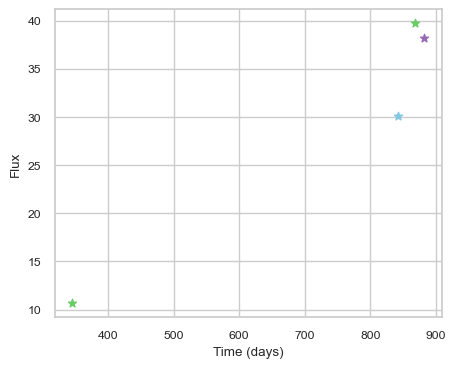

SNIax (4.015819, False)
SNIax (3.5386322, False)
SNIax (3.8584516, False)
SNIax (3.3935316, False)
SNIax (3.5804958, False)
SNIax (3.6001325, False)
SNIax (2.9340065, False)
SNIax (2.4684803, False)


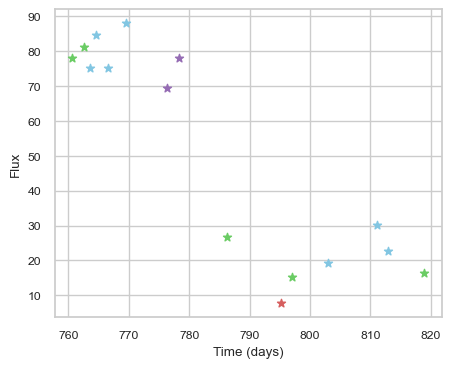

SNIax (3.7685885, False)
SNIax (3.084601, False)
SNIax (3.3395076, False)
SNIax (3.0847738, False)
SNIax (2.800906, False)
SNIax (3.0661705, False)
SNIax (3.180994, False)
SNIax (3.6446755, False)
SNIax (3.8681521, False)
SNIax (3.723368, False)
SNIax (3.5547807, False)
SNIax (3.7784553, False)
SNIax (4.54861, False)
SNIax (4.29199, False)
SNIax (4.0253654, False)
SNIax (4.7208395, False)
SNIax (4.26524, False)
SNIax (3.7648926, False)
SNIax (2.7853913, False)
SNIax (2.5241203, False)
SNIax (2.8372688, False)
SNIax (2.2831316, False)
SNIax (2.4745536, False)
SNIax (1.8699241, False)
SNIax (1.584903, False)
SNIax (1.6847206, False)
SNIax (2.1449265, False)
SNIax (1.7305926, False)
SNIax (1.5645665, False)
SNIax (1.7041667, False)


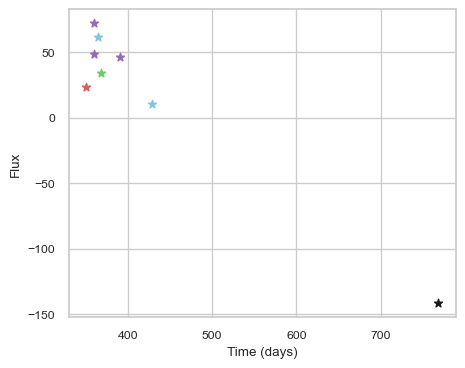

SNIax (4.1440625, False)
SNIax (3.8202724, False)
SNIax (4.084914, False)
SNIax (4.336122, False)
SNIax (5.54586, False)
SNIax (4.4010735, False)
SNIax (4.5706444, False)
SNIax (3.911013, False)
SNIax (4.870122, False)
SNIax (4.2733173, False)
SNIax (5.1629896, False)
SNIax (4.3649693, False)
SNIax (5.2129416, False)
SNIax (4.840631, False)
SNIax (4.96021, False)
SNIax (4.407084, False)


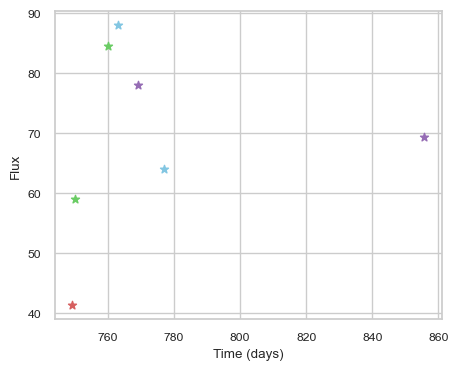

SNIax (3.7960744, False)
SNIax (4.4135375, False)
SNIax (5.6175003, False)
SNIax (3.3504045, False)
SNIax (3.1732948, False)
SNIax (2.7988222, False)
SNIax (3.293928, False)
SNIax (2.5554223, False)
SNIax (3.359009, False)
SNIax (2.3391128, False)
SNIax (3.0094147, False)
SNIax (2.4568787, False)
SNIax (4.2221417, False)
SNIax (4.776976, False)


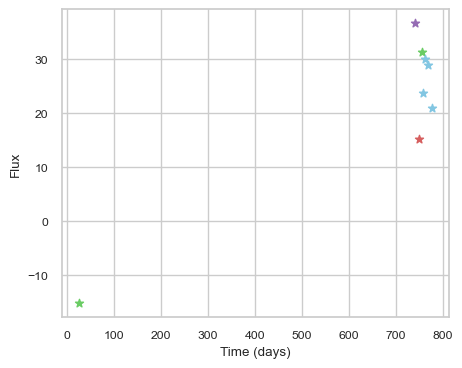

SNIax (4.538814, False)
SNIax (4.300207, False)
SNIax (4.1440477, False)
SNIax (3.1480439, False)
SNIax (3.0923762, False)
SNIax (2.560253, False)
SNIax (2.797755, False)
SNIax (2.248626, False)
SNIax (3.3079698, False)
SNIax (2.1922715, False)
SNIax (2.640725, False)
SNIax (2.5975816, False)
SNIax (2.4576612, False)
SNIax (2.9272976, False)
SNIax (2.9163826, False)
SNIax (3.3171577, False)


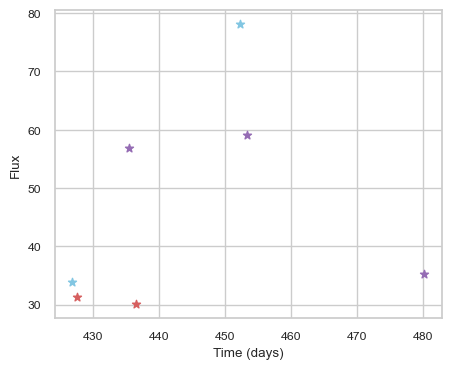

SNIax (3.987804, False)
SNIax (3.7756388, False)
SNIax (3.4734352, False)
SNIax (3.9488156, False)
SNIax (3.4306352, False)
SNIax (2.7051344, False)
SNIax (3.616887, False)
SNIax (3.0331967, False)
SNIax (3.1608145, False)
SNIax (2.9330697, False)
SNIax (3.97059, False)
SNIax (3.5208457, False)
SNIax (4.675708, False)
SNIax (3.5424275, False)


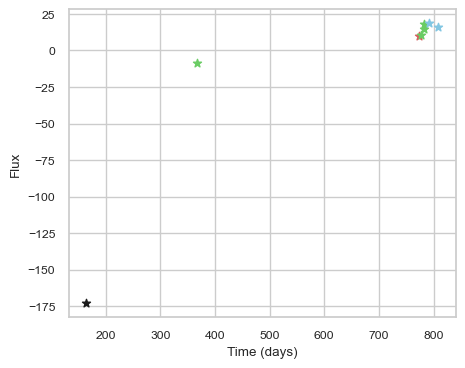

SNIax (3.85097, False)
SNIax (3.752604, False)
SNIax (3.858212, False)
SNIax (4.3909836, False)
SNIax (3.7485583, False)
SNIax (3.9851031, False)
SNIax (3.1475139, False)
SNIax (3.9005792, False)
SNIax (3.4961522, False)
SNIax (3.3802109, False)
SNIax (3.1981776, False)
SNIax (3.2223508, False)
SNIax (3.163371, False)
SNIax (3.0076737, False)
SNIax (2.8553545, False)
SNIax (2.9900463, False)


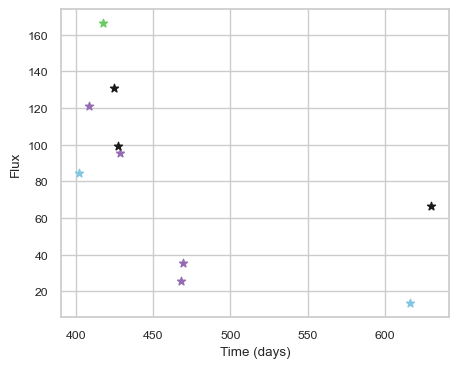

SNIax (3.7563486, False)
SNIax (3.5136986, False)
SNIax (3.5395696, False)
SNIax (3.1591039, False)
SNIax (3.558168, False)
SNIax (2.95945, False)
SNIax (3.2434287, False)
SNIax (3.3516574, False)
SNIax (3.2237978, False)
SNIax (3.621925, False)
SNIax (4.0203013, False)
SNIax (3.7844386, False)
SNIax (3.6102858, False)
SNIax (3.1469843, False)
SNIax (3.6880765, False)
SNIax (3.3031008, False)
SNIax (3.4945567, False)
SNIax (2.955193, False)
SNIax (3.0436203, False)
SNIax (3.4205737, False)


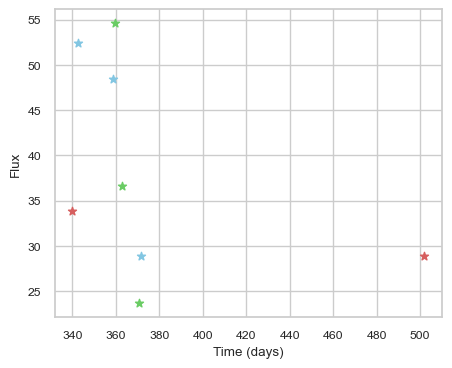

SNIax (3.8251002, False)
SNIax (4.7177596, False)
SNIax (4.3778777, False)
SNIax (3.7926831, False)
SNIax (4.4931064, False)
SNIax (4.573868, False)
SNIax (4.783813, False)
SNIax (4.9804287, False)
SNIax (5.730813, False)
SNIax (5.5500274, False)
SNIax (5.466776, False)
SNIax (5.7304864, False)
SNIax (4.0891967, False)
SNIax (4.41527, False)
SNIax (4.542929, False)
SNIax (4.8825707, False)


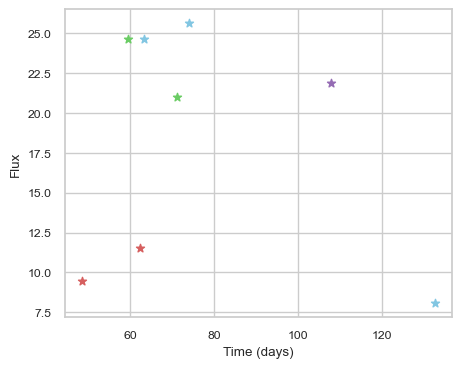

SNIax (4.0463853, False)
SNIax (3.7306652, False)
SNIax (3.0233524, False)
SNIax (3.105744, False)
SNIax (3.6352239, False)
SNIax (2.9968278, False)
SNIax (3.0129015, False)
SNIax (3.3866398, False)
SNIax (2.7274365, False)
SNIax (3.1919196, False)
SNIax (3.4909196, False)
SNIax (3.1599782, False)
SNIax (3.4978433, False)
SNIax (3.7616177, False)
SNIax (3.950946, False)
SNIax (3.744639, False)


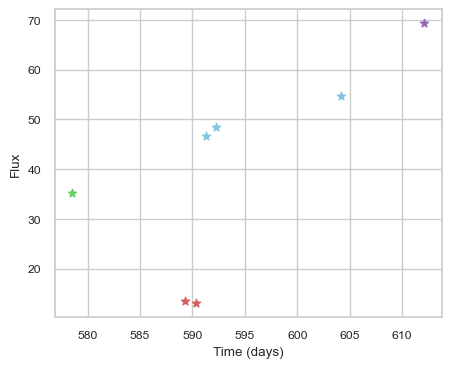

SNIax (4.579563, False)
SNIax (4.156337, False)
SNIax (5.0880504, False)
SNIax (4.62394, False)
SNIax (4.9620233, False)
SNIax (4.3308835, False)
SNIax (4.9753394, False)
SNIax (5.217416, False)
SNIax (5.7351203, False)
SNIax (6.030702, False)
SNIax (6.0002723, False)
SNIax (6.2512255, False)
SNIax (6.192575, False)
SNIax (6.0530834, False)


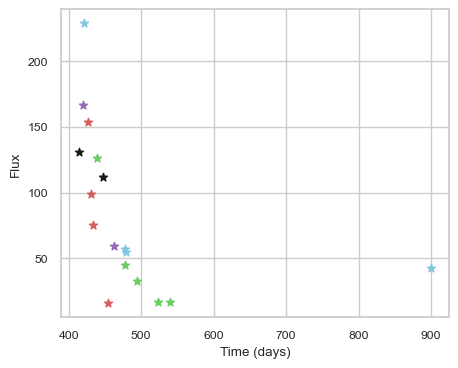

SNIax (3.744, False)
SNIax (3.693398, False)
SNIax (3.6110923, False)
SNIax (3.5909107, False)
SNIax (3.9028807, False)
SNIax (4.0257, False)
SNIax (4.031173, False)
SNIax (4.1787186, False)
SNIax (5.2906075, False)
SNIax (4.8171206, False)
SNIax (4.437079, False)
SNIax (4.886875, False)
SNIax (4.8052697, False)
SNIax (5.1187334, False)
SNIax (4.926984, False)
SNIax (5.7266994, False)
SNIax (5.339877, False)
SNIax (5.5501113, False)
SNIax (5.4202437, False)
SNIax (5.961835, False)
SNIax (6.3595366, False)
SNIax (5.5713696, False)
SNIax (5.4441957, False)
SNIax (5.6857896, False)
SNIax (5.1732183, False)
SNIax (5.6830235, False)
SNIax (5.955057, False)
SNIax (5.5984707, False)
SNIax (5.4996557, False)
SNIax (5.4903903, False)
SNIax (5.489922, False)
SNIax (5.3160076, False)
SNIax (5.9624205, False)
SNIax (5.1247153, False)


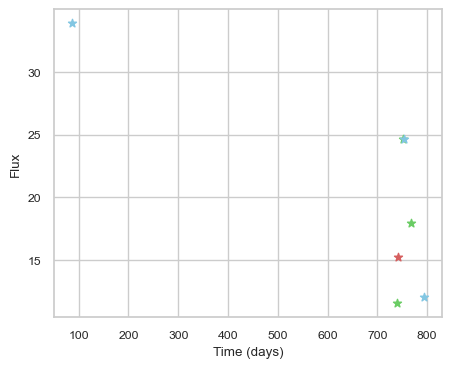

SNIax (4.1242056, False)
SNIax (4.0941043, False)
SNIax (3.8428707, False)
SNIax (2.9882922, False)
SNIax (3.1042933, False)
SNIax (2.8033626, False)
SNIax (3.4518273, False)
SNIax (2.5713403, False)
SNIax (3.706846, False)
SNIax (3.4886954, False)
SNIax (2.9765768, False)
SNIax (3.3525293, False)
SNIax (3.5893867, False)
SNIax (3.61066, False)


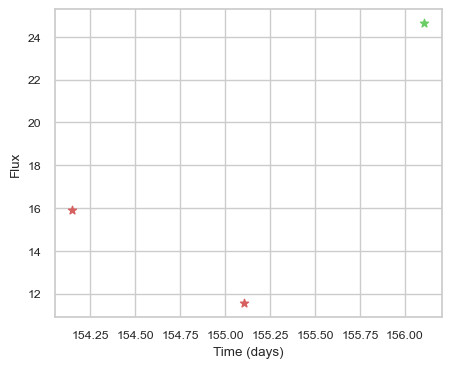

SNIax (3.9088671, False)
SNIax (4.1733932, False)
SNIax (4.0311284, False)
SNIax (3.861632, False)
SNIax (3.4253843, False)
SNIax (3.0184853, False)


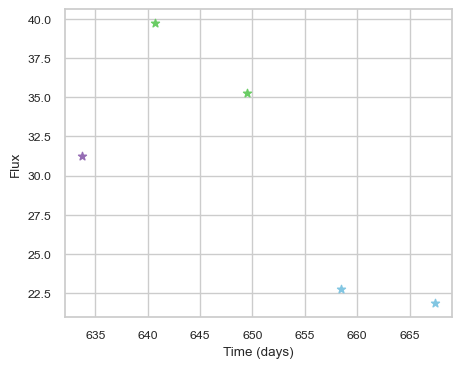

SNIax (3.8936405, False)
SNIax (3.711445, False)
SNIax (3.2967277, False)
SNIax (2.7904723, False)
SNIax (3.0188372, False)
SNIax (3.3188307, False)
SNIax (3.7352276, False)
SNIax (3.9260445, False)
SNIax (3.619007, False)
SNIax (3.8216398, False)


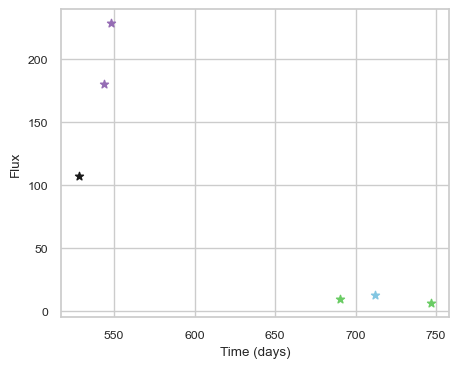

SNIax (3.788352, False)
SNIax (4.23186, False)
SNIax (3.690311, False)
SNIax (3.7442498, False)
SNIax (3.4627774, False)
SNIax (3.5084524, False)
SNIax (3.1913278, False)
SNIax (3.5999699, False)
SNIax (3.2656085, False)
SNIax (3.1800466, False)
SNIax (3.09244, False)
SNIax (3.1691046, False)


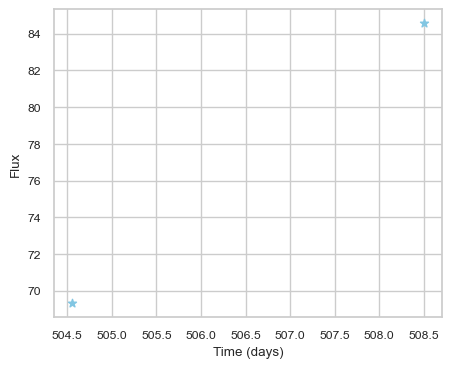

SNIax (3.856634, False)
SNIax (3.9684396, False)
SNIax (4.355669, False)
SNIax (4.122901, False)


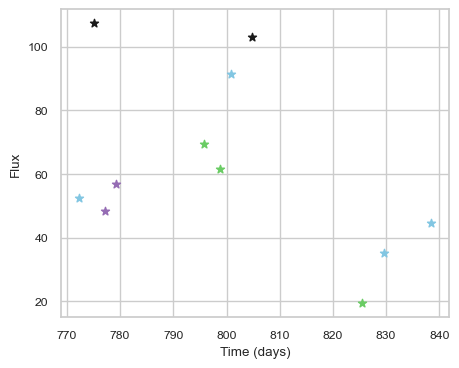

SNIax (3.895242, False)
SNIax (3.4313495, False)
SNIax (4.0465083, False)
SNIax (4.495821, False)
SNIax (4.417218, False)
SNIax (3.0594935, False)
SNIax (3.6327746, False)
SNIax (3.197052, False)
SNIax (3.0376573, False)
SNIax (3.3490198, False)
SNIax (3.512402, False)
SNIax (3.4806325, False)
SNIax (3.4104981, False)
SNIax (3.7806675, False)
SNIax (4.31566, False)
SNIax (3.7759583, False)
SNIax (3.6612275, False)
SNIax (3.9836495, False)
SNIax (3.592314, False)
SNIax (3.6266673, False)
SNIax (2.9240448, False)
SNIax (3.5967815, False)


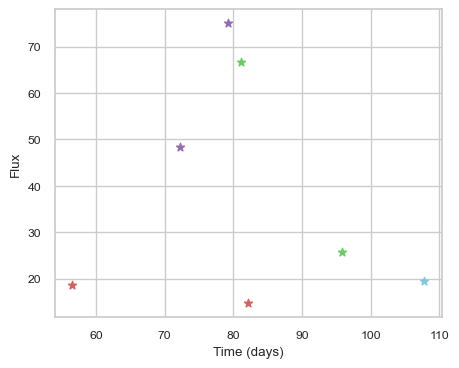

SNIax (3.8625362, False)
SNIax (4.049751, False)
SNIax (3.48167, False)
SNIax (3.624657, False)
SNIax (3.983536, False)
SNIax (3.6478052, False)
SNIax (4.349715, False)
SNIax (3.5422387, False)
SNIax (3.7200196, False)
SNIax (4.189317, False)
SNIax (2.9045246, False)
SNIax (3.1544592, False)
SNIax (2.836402, False)
SNIax (2.610059, False)


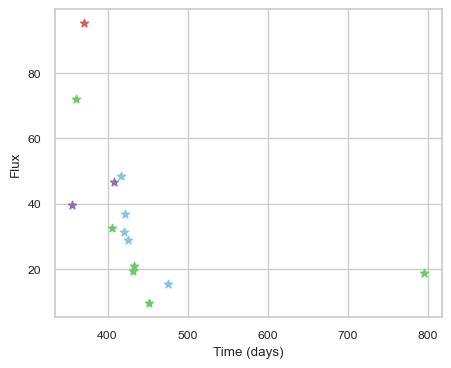

SNIax (3.7975552, False)
SNIax (3.3553514, False)
SNIax (3.3725643, False)
SNIax (3.4442856, False)
SNIax (3.3766448, False)
SNIax (3.4221158, False)
SNIax (4.273529, False)
SNIax (3.4545197, False)
SNIax (3.6239471, False)
SNIax (3.411275, False)
SNIax (3.289141, False)
SNIax (3.476358, False)
SNIax (4.0257506, False)
SNIax (3.4476848, False)
SNIax (3.244464, False)
SNIax (3.7105286, False)
SNIax (4.3162537, False)
SNIax (3.6047754, False)
SNIax (3.823239, False)
SNIax (4.004911, False)
SNIax (3.478488, False)
SNIax (3.855452, False)
SNIax (3.9447727, False)
SNIax (3.663939, False)
SNIax (4.1849666, False)
SNIax (3.7254863, False)
SNIax (4.4419975, False)
SNIax (3.9356985, False)


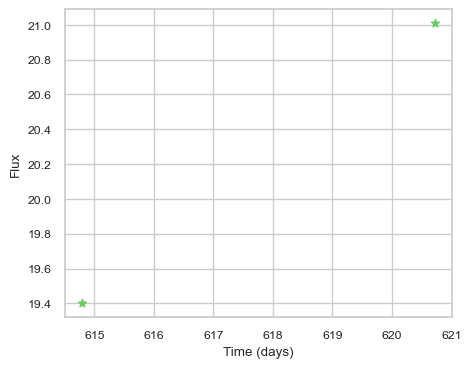

SNIax (4.128334, False)
SNIax (3.5979853, False)
SNIax (3.6427438, False)
SNIax (3.0221019, False)


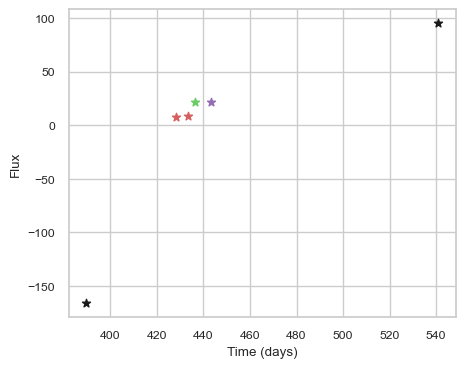

SNIax (3.9428356, False)
SNIax (3.7799718, False)
SNIax (3.998639, False)
SNIax (3.973018, False)
SNIax (3.629171, False)
SNIax (3.227274, False)
SNIax (2.6271033, False)
SNIax (2.6007538, False)
SNIax (2.8997695, False)
SNIax (2.732646, False)
SNIax (3.6914542, False)
SNIax (3.5781393, False)


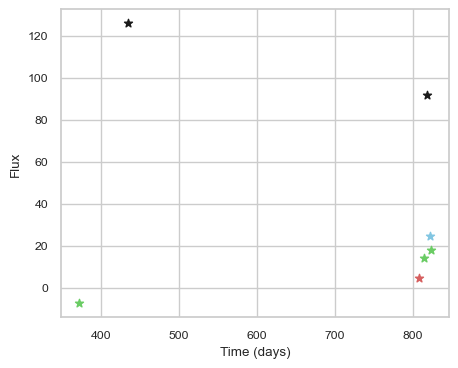

SNIax (4.311922, False)
SNIax (4.447784, False)
SNIax (4.1317973, False)
SNIax (4.343555, False)
SNIax (4.4576054, False)
SNIax (4.716914, False)
SNIax (4.1249533, False)
SNIax (3.6136408, False)
SNIax (3.403943, False)
SNIax (4.368525, False)
SNIax (3.7253253, False)
SNIax (3.4215486, False)
SNIax (2.9176283, False)
SNIax (2.9723651, False)


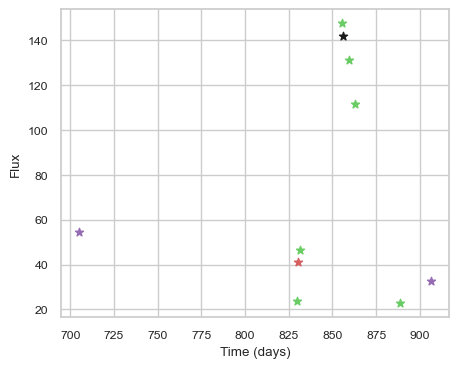

SNIax (3.7491384, False)
SNIax (3.470171, False)
SNIax (3.7057188, False)
SNIax (3.1172616, False)
SNIax (3.4342477, False)
SNIax (3.7168715, False)
SNIax (3.846807, False)
SNIax (3.1061976, False)
SNIax (2.9272304, False)
SNIax (2.7867453, False)
SNIax (2.9173436, False)
SNIax (3.2598336, False)
SNIax (3.475045, False)
SNIax (2.8757179, False)
SNIax (2.8839643, False)
SNIax (2.2833414, False)
SNIax (2.9999194, False)
SNIax (3.1211262, False)
SNIax (3.2923448, False)
SNIax (2.6722956, False)


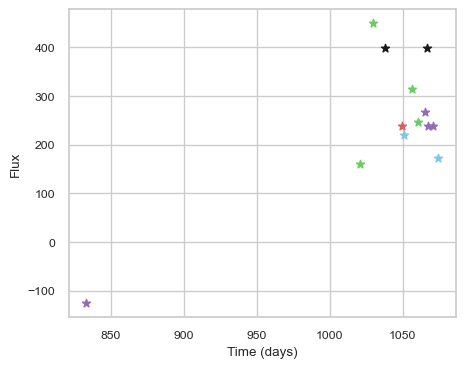

SNIax (3.6897688, False)
SNIax (3.4107282, False)
SNIax (3.6089306, False)
SNIax (3.7721508, False)
SNIax (3.1434362, False)
SNIax (3.3768256, False)
SNIax (4.4419365, False)
SNIax (5.400153, False)
SNIax (3.3444893, False)
SNIax (3.7503889, False)
SNIax (4.5767555, False)
SNIax (3.9337406, False)
SNIax (4.250156, False)
SNIax (4.4047666, False)
SNIax (3.93223, False)
SNIax (4.169832, False)
SNIax (3.9573746, False)
SNIax (3.8267567, False)
SNIax (3.4056478, False)
SNIax (3.5909555, False)
SNIax (3.2099051, False)
SNIax (2.6727035, False)
SNIax (3.3697755, False)
SNIax (2.3849921, False)
SNIax (3.328239, False)
SNIax (2.6823719, False)


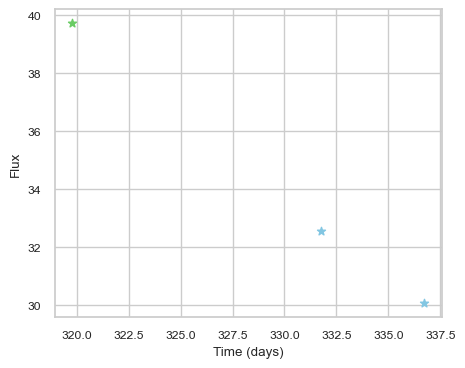

SNIax (3.8673291, False)
SNIax (4.2909603, False)
SNIax (3.8382661, False)
SNIax (3.9422688, False)
SNIax (4.880662, False)
SNIax (5.4886265, False)


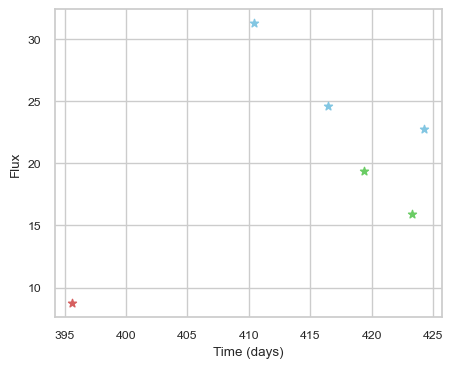

SNIax (4.0209265, False)
SNIax (3.9028056, False)
SNIax (3.4552546, False)
SNIax (3.1887748, False)
SNIax (3.57401, False)
SNIax (3.5400004, False)
SNIax (4.1035104, False)
SNIax (3.5167565, False)
SNIax (3.925035, False)
SNIax (3.3231614, False)
SNIax (3.1096606, False)
SNIax (3.2056208, False)


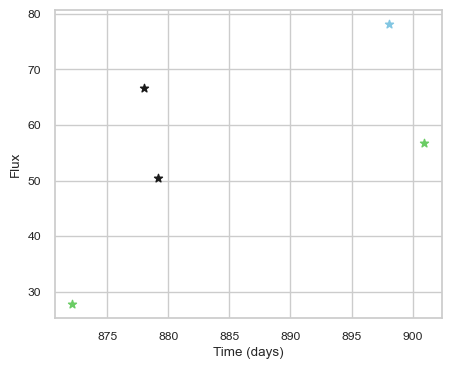

SNIax (3.6774967, False)
SNIax (3.698436, False)
SNIax (3.292351, False)
SNIax (4.128911, False)
SNIax (3.8098547, False)
SNIax (3.7111218, False)
SNIax (3.1773524, False)
SNIax (3.355746, False)
SNIax (3.6811726, False)
SNIax (3.8490138, False)


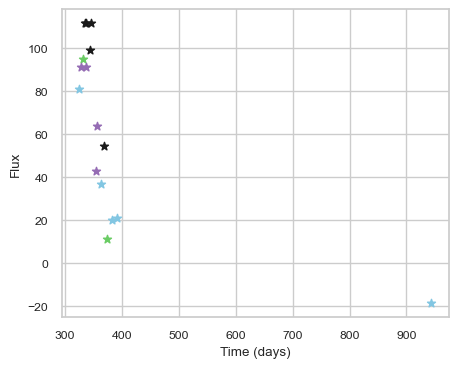

SNIax (3.868862, False)
SNIax (4.2999606, False)
SNIax (5.252594, False)
SNIax (4.5642123, False)
SNIax (5.0995193, False)
SNIax (4.9748616, False)
SNIax (4.6444964, False)
SNIax (4.1843657, False)
SNIax (4.007873, False)
SNIax (3.9108624, False)
SNIax (4.1072216, False)
SNIax (3.6078503, False)
SNIax (3.3511474, False)
SNIax (3.5240881, False)
SNIax (3.590498, False)
SNIax (3.1886384, False)
SNIax (3.4807162, False)
SNIax (3.0124178, False)
SNIax (3.4323013, False)
SNIax (2.7507012, False)
SNIax (2.7498586, False)
SNIax (2.6424217, False)
SNIax (3.0982943, False)
SNIax (2.983556, False)
SNIax (2.62796, False)
SNIax (3.0402815, False)
SNIax (2.8157954, False)
SNIax (2.5412517, False)
SNIax (2.4403396, False)
SNIax (2.6578755, False)
SNIax (3.0817177, False)
SNIax (2.917025, False)


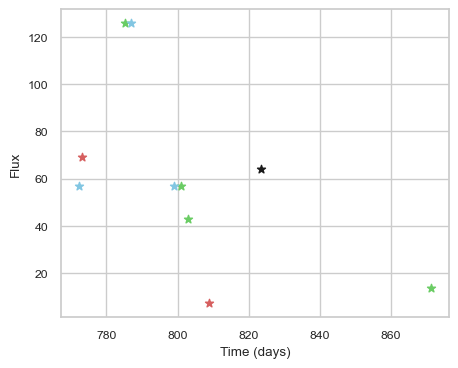

SNIax (3.813884, False)
SNIax (3.5033734, False)
SNIax (3.638862, False)
SNIax (3.8114126, False)
SNIax (3.3830516, False)
SNIax (3.2846844, False)
SNIax (2.9717355, False)
SNIax (2.9366708, False)
SNIax (3.4456868, False)
SNIax (2.7709408, False)
SNIax (2.6466374, False)
SNIax (2.4989758, False)
SNIax (2.7250924, False)
SNIax (3.0749562, False)
SNIax (3.0294466, False)
SNIax (3.1739001, False)
SNIax (3.1657248, False)
SNIax (2.9766111, False)
SNIax (2.9284565, False)
SNIax (2.2791984, False)


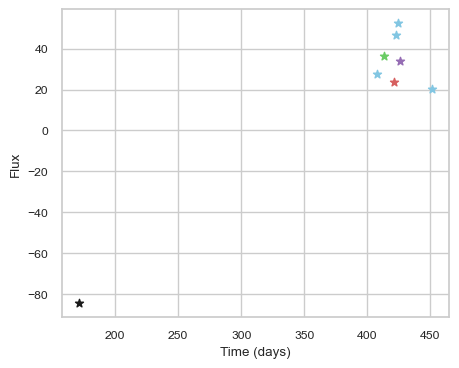

SNIax (4.0346546, False)
SNIax (3.8097484, False)
SNIax (4.0821643, False)
SNIax (3.5424879, False)
SNIax (3.4381518, False)
SNIax (3.0479863, False)
SNIax (3.1244414, False)
SNIax (3.4614303, False)
SNIax (3.242303, False)
SNIax (2.94029, False)
SNIax (3.5786822, False)
SNIax (4.0022593, False)
SNIax (4.3769836, False)
SNIax (3.6503298, False)
SNIax (3.599767, False)
SNIax (3.4852462, False)


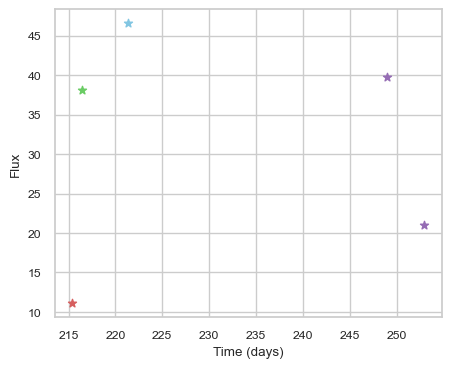

SNIax (4.146163, False)
SNIax (3.3377542, False)
SNIax (3.2044756, False)
SNIax (3.6390748, False)
SNIax (5.0637894, False)
SNIax (5.0407796, False)
SNIax (4.48486, False)
SNIax (4.447954, False)
SNIax (4.4312887, False)
SNIax (3.629124, False)


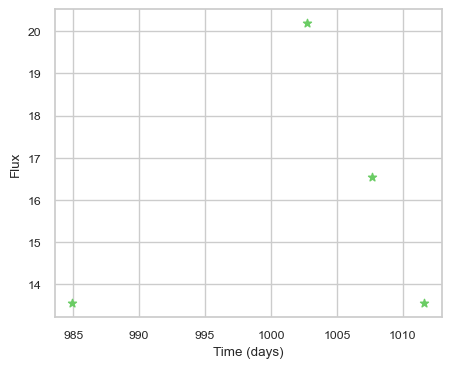

SNIax (4.0712996, False)
SNIax (3.8110352, False)
SNIax (3.3611546, False)
SNIax (3.3009868, False)
SNIax (3.520553, False)
SNIax (3.7507358, False)
SNIax (3.8111641, False)
SNIax (3.7841449, False)


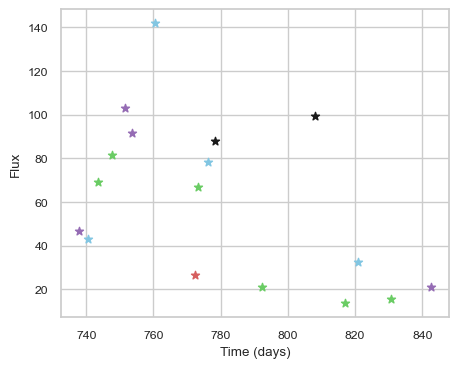

SNIax (3.805138, False)
SNIax (3.2497556, False)
SNIax (3.5047123, False)
SNIax (3.2580383, False)
SNIax (3.3642952, False)
SNIax (2.979817, False)
SNIax (3.4260547, False)
SNIax (3.0212617, False)
SNIax (3.042137, False)
SNIax (3.3551686, False)
SNIax (4.108725, False)
SNIax (3.3645964, False)
SNIax (3.401233, False)
SNIax (2.850399, False)
SNIax (3.447732, False)
SNIax (3.0045645, False)
SNIax (2.9171484, False)
SNIax (3.169903, False)
SNIax (3.1586125, False)
SNIax (3.1826062, False)
SNIax (3.0149422, False)
SNIax (3.4715514, False)
SNIax (2.4068012, False)
SNIax (2.7784407, False)
SNIax (2.8897011, False)
SNIax (3.2512054, False)
SNIax (3.092813, False)
SNIax (2.763153, False)
SNIax (2.7473638, False)
SNIax (2.4328856, False)
SNIax (2.285739, False)
SNIax (2.3025358, False)
SNIax (2.3886514, False)
SNIax (2.4476502, False)


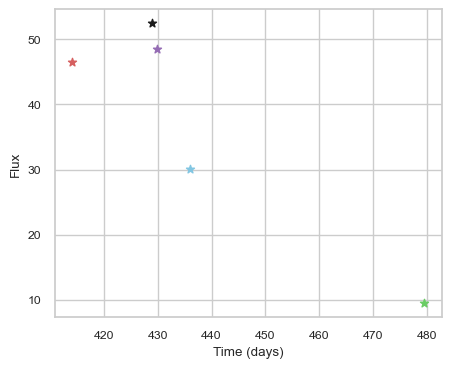

SNIax (3.9963384, False)
SNIax (4.618636, False)
SNIax (4.761353, False)
SNIax (4.4784346, False)
SNIax (4.8381395, False)
SNIax (5.055205, False)
SNIax (5.9183626, False)
SNIax (5.8155103, False)
SNIax (6.419211, False)
SNIax (6.210765, False)


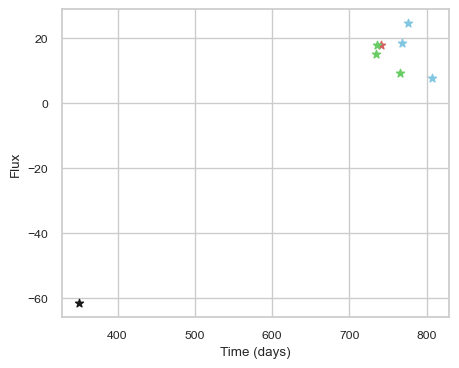

SNIax (4.010306, False)
SNIax (3.8218656, False)
SNIax (4.0676193, False)
SNIax (3.0912786, False)
SNIax (3.20193, False)
SNIax (2.2426584, False)
SNIax (2.8376982, False)
SNIax (2.729061, False)
SNIax (2.497699, False)
SNIax (3.0926702, False)
SNIax (3.3830698, False)
SNIax (2.9746127, False)
SNIax (2.929176, False)
SNIax (2.7173698, False)
SNIax (3.927537, False)
SNIax (3.7514226, False)


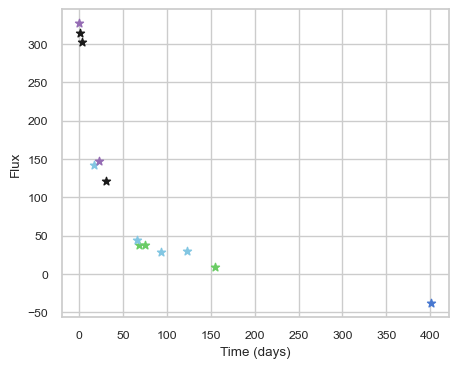

SNIax (3.992492, False)
SNIax (3.1832557, False)
SNIax (3.7000594, False)
SNIax (3.531555, False)
SNIax (3.6006687, False)
SNIax (4.445376, False)
SNIax (4.0719147, False)
SNIax (3.4142776, False)
SNIax (4.183591, False)
SNIax (3.5995927, False)
SNIax (4.0469913, False)
SNIax (3.3193672, False)
SNIax (3.4923425, False)
SNIax (3.4227839, False)
SNIax (3.709062, False)
SNIax (4.0776167, False)
SNIax (3.8717504, False)
SNIax (4.08217, False)
SNIax (3.8828096, False)
SNIax (3.7577102, False)
SNIax (3.9327893, False)
SNIax (4.11725, False)
SNIax (4.564661, False)
SNIax (3.5819175, False)
SNIax (4.7619123, False)


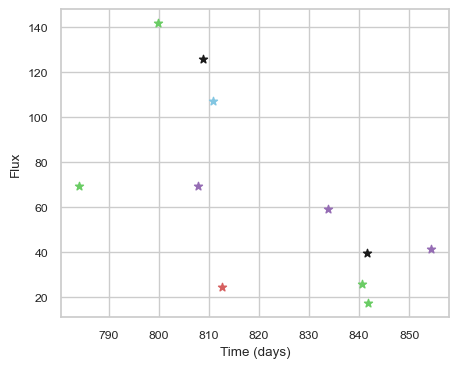

SNIax (3.9514432, False)
SNIax (3.7266805, False)
SNIax (4.5498557, False)
SNIax (5.143848, False)
SNIax (5.7720485, False)
SNIax (6.1234756, False)
SNIax (6.7663827, False)
SNIax (6.9816775, False)
SNIax (6.609417, False)
SNIax (6.2388616, False)
SNIax (5.3460755, False)
SNIax (6.326561, False)
SNIax (6.300359, False)
SNIax (6.174412, False)
SNIax (5.9406404, False)
SNIax (6.196503, False)
SNIax (6.596326, False)
SNIax (6.3579655, False)
SNIax (6.7830105, False)
SNIax (6.3481665, False)
SNIax (5.9053216, False)
SNIax (6.2235613, False)


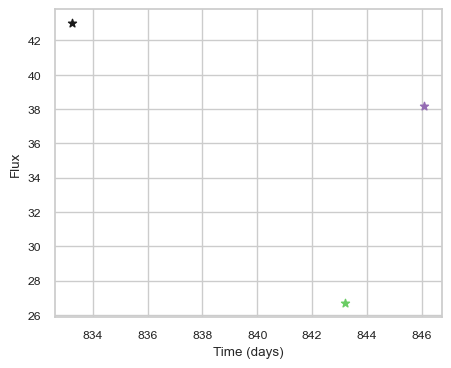

SNIax (4.2513256, False)
SNIax (4.1236362, False)
SNIax (4.2962666, False)
SNIax (3.6332781, False)
SNIax (3.8660133, False)
SNIax (3.8775578, False)


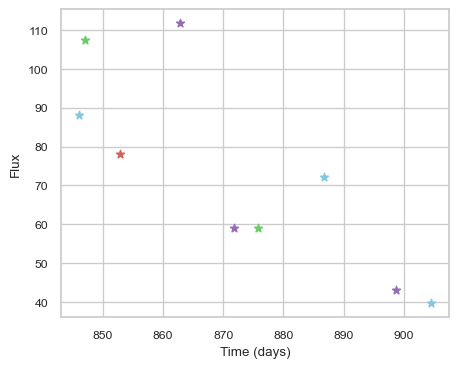

SNIax (3.7789063, False)
SNIax (3.5466778, False)
SNIax (4.343439, False)
SNIax (4.9473634, False)
SNIax (5.201037, False)
SNIax (5.8440194, False)
SNIax (6.1037126, False)
SNIax (5.898492, False)
SNIax (5.9555726, False)
SNIax (5.0454297, False)
SNIax (6.3724113, False)
SNIax (6.0030665, False)
SNIax (6.0506186, False)
SNIax (5.524657, False)
SNIax (5.4601746, False)
SNIax (4.984453, False)
SNIax (5.087051, False)
SNIax (4.816364, False)


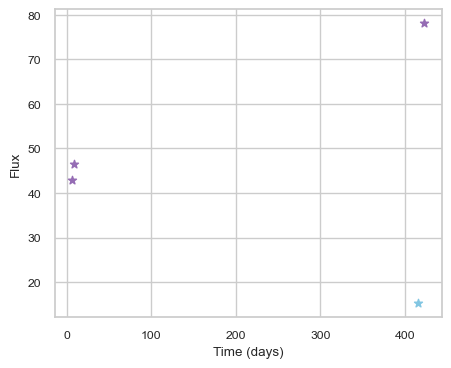

SNIax (4.0136256, False)
SNIax (4.1972823, False)
SNIax (4.03233, False)
SNIax (4.4133205, False)
SNIax (4.0843415, False)
SNIax (4.0430098, False)
SNIax (4.069728, False)
SNIax (3.3489108, False)


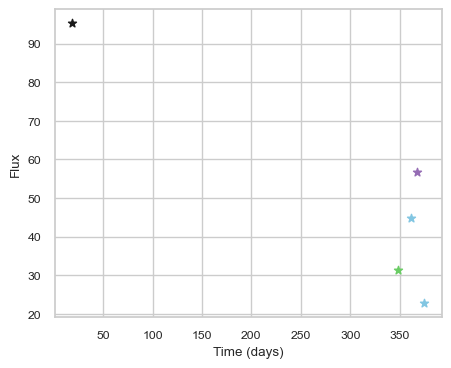

SNIax (4.5629034, False)
SNIax (3.7562485, False)
SNIax (4.1694217, False)
SNIax (3.226942, False)
SNIax (3.7314785, False)
SNIax (2.9302163, False)
SNIax (3.272965, False)
SNIax (3.2160344, False)
SNIax (3.3368635, False)
SNIax (3.095302, False)


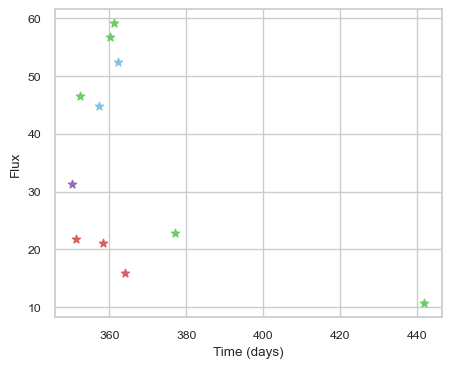

SNIax (3.9686189, False)
SNIax (3.4633296, False)
SNIax (3.510719, False)
SNIax (3.197841, False)
SNIax (4.0146265, False)
SNIax (3.2857642, False)
SNIax (4.2043605, False)
SNIax (2.9430716, False)
SNIax (2.8081465, False)
SNIax (2.8057282, False)
SNIax (2.9570904, False)
SNIax (2.4922495, False)
SNIax (3.1449308, False)
SNIax (3.0282998, False)
SNIax (3.2608886, False)
SNIax (2.8880463, False)
SNIax (2.7184436, False)
SNIax (3.283879, False)
SNIax (3.0382216, False)
SNIax (2.775192, False)
SNIax (3.3279755, False)
SNIax (3.0869944, False)


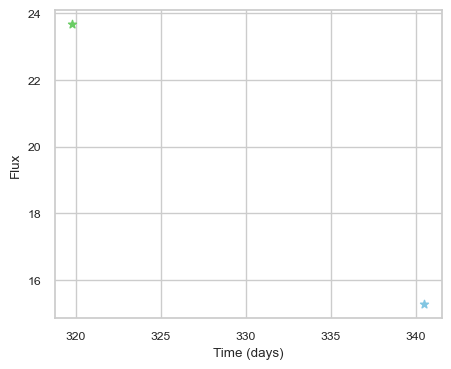

SNIax (3.9106495, False)
SNIax (4.0598993, False)
SNIax (3.5725951, False)
SNIax (3.8271668, False)


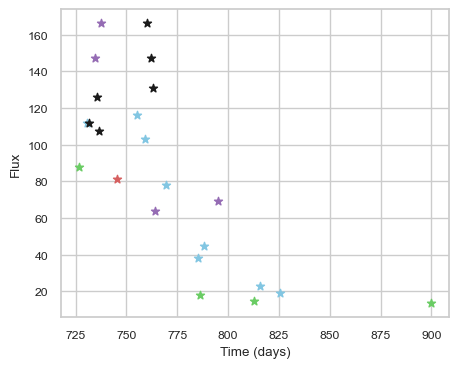

SNIax (3.8412955, False)
SNIax (3.5986292, False)
SNIax (4.6020684, False)
SNIax (5.02614, False)
SNIax (5.2707534, False)
SNIax (5.079894, False)
SNIax (5.907962, False)
SNIax (4.626094, False)
SNIax (5.425123, False)
SNIax (4.691079, False)
SNIax (5.392236, False)
SNIax (4.881183, False)
SNIax (5.4766874, False)
SNIax (3.4081082, False)
SNIax (4.8936663, False)
SNIax (4.1804023, False)
SNIax (4.9597783, False)
SNIax (4.7339125, False)
SNIax (4.86911, False)
SNIax (4.275705, False)
SNIax (5.162321, False)
SNIax (4.7243443, False)
SNIax (3.9414961, False)
SNIax (3.7124436, False)
SNIax (3.734442, False)
SNIax (3.4123867, False)
SNIax (3.621725, False)
SNIax (2.759071, False)
SNIax (4.313108, False)
SNIax (2.4822676, False)
SNIax (3.6360135, False)
SNIax (2.6886475, False)
SNIax (3.1967647, False)
SNIax (2.8722513, False)
SNIax (3.6338336, False)
SNIax (2.4207716, False)
SNIax (3.1675498, False)
SNIax (2.563434, False)
SNIax (4.0028806, False)
SNIax (3.6928887, False)
SNIax (2.9970288, 

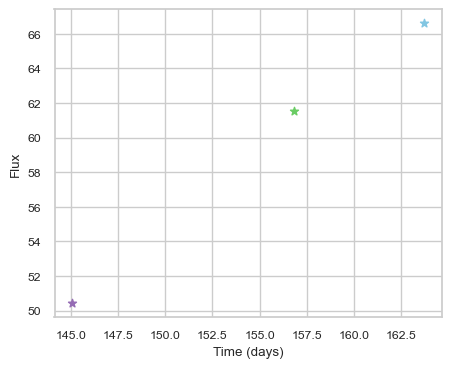

SNIax (3.866237, False)
SNIax (3.935729, False)
SNIax (4.0843115, False)
SNIax (3.6868067, False)
SNIax (3.7904367, False)
SNIax (3.7713506, False)


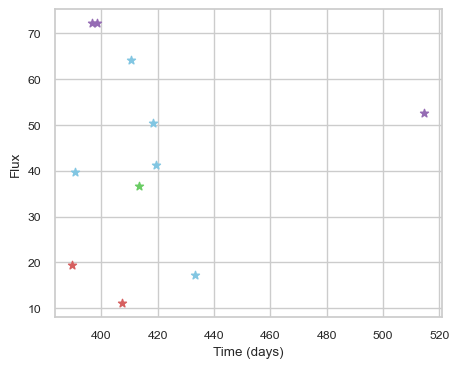

SNIax (4.0176525, False)
SNIax (4.7389655, False)
SNIax (4.158338, False)
SNIax (2.6910272, False)
SNIax (3.207447, False)
SNIax (3.574216, False)
SNIax (4.334382, False)
SNIax (3.811229, False)
SNIax (3.9426267, False)
SNIax (3.5939538, False)
SNIax (4.2791276, False)
SNIax (3.6016927, False)
SNIax (4.624162, False)
SNIax (4.0008435, False)
SNIax (4.6800156, False)
SNIax (3.7764392, False)
SNIax (4.2866945, False)
SNIax (3.931619, False)
SNIax (3.8102083, False)
SNIax (3.6449206, False)
SNIax (4.2070866, False)
SNIax (3.3157275, False)


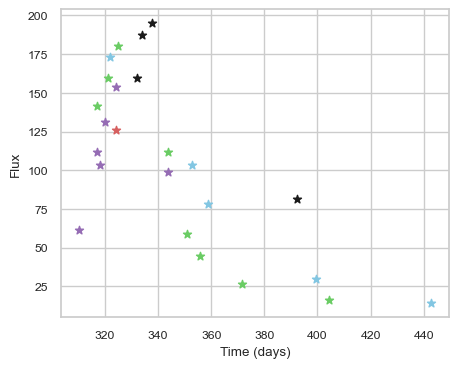

SNIax (3.7849987, False)
SNIax (4.353735, False)
SNIax (3.7589035, False)
SNIax (5.1295066, False)
SNIax (6.4598393, False)
SNIax (5.7934093, False)
SNIax (6.8077917, False)
SNIax (6.1524544, False)
SNIax (6.09787, False)
SNIax (6.603023, False)
SNIax (6.588267, False)
SNIax (5.9373584, False)
SNIax (6.200761, False)
SNIax (6.6941895, False)
SNIax (6.038344, False)
SNIax (6.179738, False)
SNIax (6.548296, False)
SNIax (6.4571786, False)
SNIax (6.6406856, False)
SNIax (5.9491534, False)
SNIax (5.916939, False)
SNIax (6.0570974, False)
SNIax (5.765173, False)
SNIax (5.2226458, False)
SNIax (4.0334854, False)
SNIax (3.882122, False)
SNIax (3.5121217, False)
SNIax (3.6394217, False)
SNIax (3.41172, False)
SNIax (3.1048377, False)
SNIax (3.219538, False)
SNIax (3.5687249, False)
SNIax (2.9201431, False)
SNIax (3.2698317, False)
SNIax (3.1552973, False)
SNIax (3.0859363, False)
SNIax (3.1526368, False)
SNIax (3.1265087, False)
SNIax (3.0807817, False)
SNIax (2.6580265, False)
SNIax (4.042419

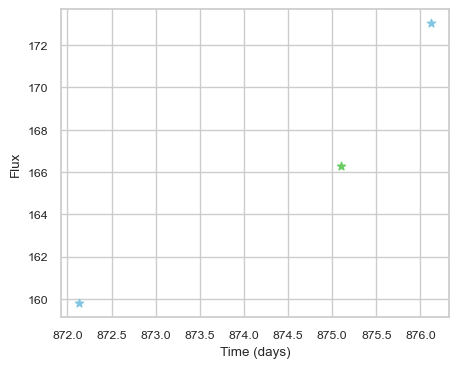

SNIax (3.6641414, False)
SNIax (3.8166823, False)
SNIax (4.742036, False)
SNIax (5.2665315, False)
SNIax (4.8371096, False)
SNIax (4.1483045, False)


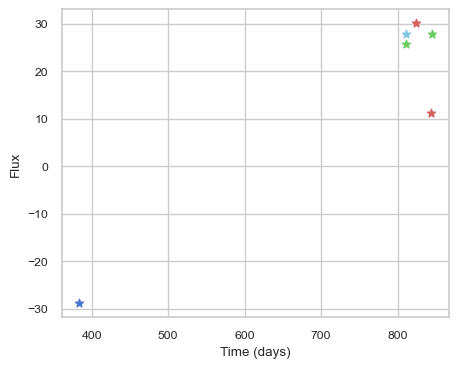

SNIax (3.9965203, False)
SNIax (4.79825, False)
SNIax (4.043544, False)
SNIax (3.486887, False)
SNIax (3.3485034, False)
SNIax (2.864923, False)
SNIax (3.038661, False)
SNIax (3.2542074, False)
SNIax (3.0713778, False)
SNIax (3.121133, False)
SNIax (3.2823792, False)
SNIax (2.637901, False)


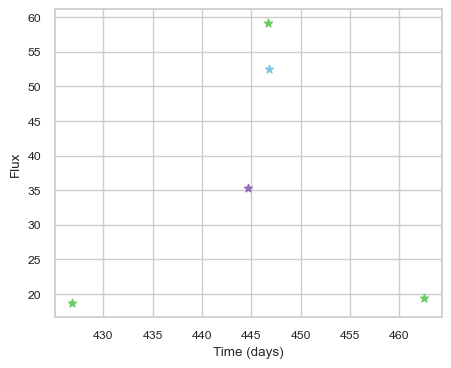

SNIax (4.166249, False)
SNIax (3.6771865, False)
SNIax (3.3904307, False)
SNIax (3.2708778, False)
SNIax (3.2202246, False)
SNIax (3.561963, False)
SNIax (3.5037997, False)
SNIax (3.0100765, False)
SNIax (3.6567037, False)
SNIax (2.78033, False)


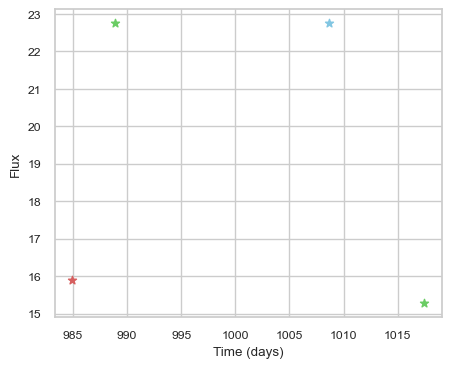

SNIax (3.8350954, False)
SNIax (4.541183, False)
SNIax (3.595659, False)
SNIax (3.4516861, False)
SNIax (4.4970927, False)
SNIax (4.360115, False)
SNIax (4.567316, False)
SNIax (4.743072, False)


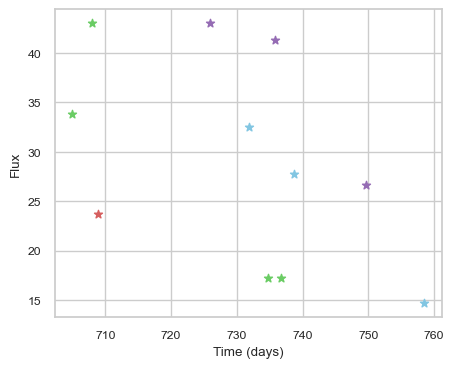

SNIax (3.8755658, False)
SNIax (3.2711728, False)
SNIax (2.9437263, False)
SNIax (3.467916, False)
SNIax (3.1283586, False)
SNIax (2.9527879, False)
SNIax (2.987214, False)
SNIax (1.8975039, False)
SNIax (2.715288, False)
SNIax (2.7009172, False)
SNIax (3.6502104, False)
SNIax (3.5680225, False)
SNIax (3.3684366, False)
SNIax (3.9434173, False)
SNIax (4.370131, False)
SNIax (3.8367894, False)
SNIax (3.7154453, False)
SNIax (3.8355224, False)
SNIax (4.140379, False)
SNIax (3.842106, False)
SNIax (4.850217, False)
SNIax (4.3397384, False)


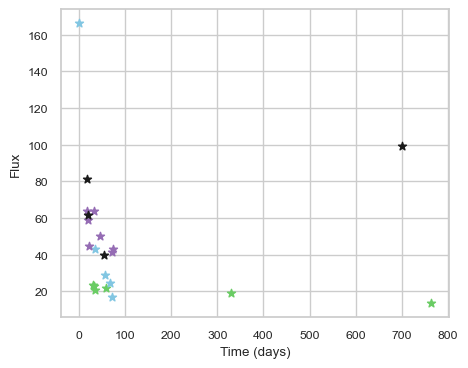

SNIax (4.2685456, False)
SNIax (5.1550946, False)
SNIax (4.3871546, False)
SNIax (6.7962046, False)
SNIax (5.919423, False)
SNIax (7.3344483, False)
SNIax (6.454451, False)
SNIax (6.9169407, False)
SNIax (6.849972, False)
SNIax (7.171651, False)
SNIax (6.705421, False)
SNIax (6.274398, False)
SNIax (6.509828, False)
SNIax (6.323915, False)
SNIax (6.481632, False)
SNIax (6.7492595, False)
SNIax (6.4385123, False)
SNIax (6.8446903, False)
SNIax (6.6679635, False)
SNIax (6.3901978, False)
SNIax (6.2771106, False)
SNIax (6.273187, False)
SNIax (6.2605333, False)
SNIax (6.30001, False)
SNIax (6.744897, False)
SNIax (6.3276477, False)
SNIax (6.1784887, False)
SNIax (5.9497147, False)
SNIax (6.057712, False)
SNIax (6.1736026, False)
SNIax (6.055744, False)
SNIax (6.073384, False)
SNIax (6.1547275, False)
SNIax (5.845819, False)
SNIax (6.306107, False)
SNIax (6.2021832, False)
SNIax (6.2320037, False)
SNIax (6.8364882, False)
SNIax (6.418249, False)
SNIax (6.8786964, False)
SNIax (6.490318, Fa

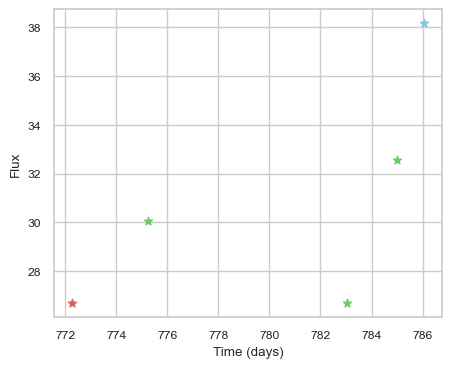

SNIax (3.8981388, False)
SNIax (4.468622, False)
SNIax (4.3339386, False)
SNIax (4.515697, False)
SNIax (5.6732078, False)
SNIax (5.6423216, False)
SNIax (5.7320366, False)
SNIax (5.5591497, False)
SNIax (5.706062, False)
SNIax (5.616774, False)


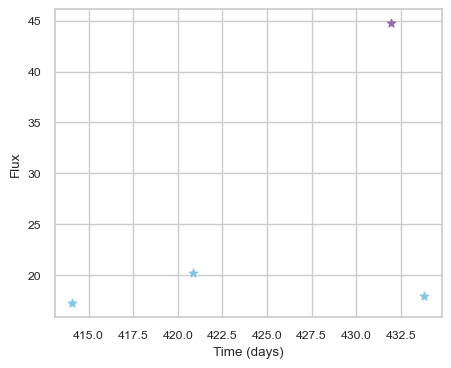

SNIax (4.184626, False)
SNIax (3.658298, False)
SNIax (3.3287961, False)
SNIax (3.3319473, False)
SNIax (2.8030581, False)
SNIax (2.7717264, False)
SNIax (3.1402547, False)
SNIax (2.9936593, False)


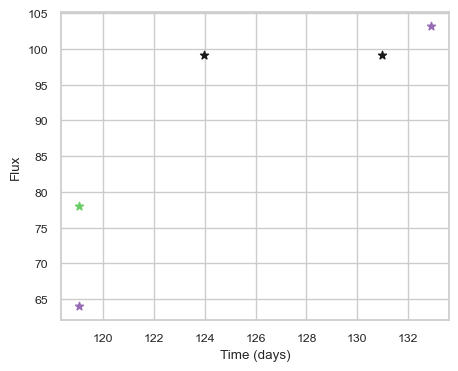

SNIax (3.7761102, False)
SNIax (4.111698, False)
SNIax (3.7293437, False)
SNIax (4.3835063, False)
SNIax (4.191279, False)
SNIax (3.9696293, False)
SNIax (3.5923347, False)
SNIax (3.6386995, False)
SNIax (3.965756, False)
SNIax (3.588694, False)


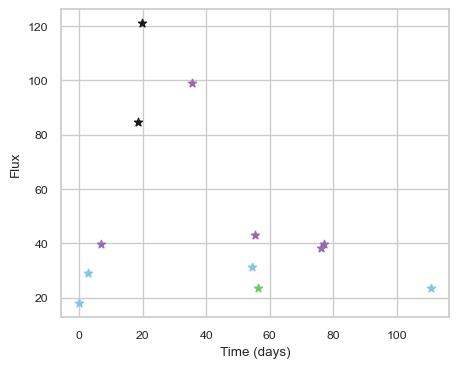

SNIax (4.199164, False)
SNIax (3.2071738, False)
SNIax (4.4586253, False)
SNIax (3.8114405, False)
SNIax (4.0491285, False)
SNIax (4.075917, False)
SNIax (4.598311, False)
SNIax (4.559116, False)
SNIax (4.7183785, False)
SNIax (4.812932, False)
SNIax (4.926756, False)
SNIax (5.053575, False)
SNIax (4.386733, False)
SNIax (3.8165717, False)
SNIax (4.9888387, False)
SNIax (4.3000746, False)
SNIax (4.6283426, False)
SNIax (4.344408, False)
SNIax (4.6189156, False)
SNIax (4.540615, False)
SNIax (4.6325865, False)
SNIax (4.16904, False)
SNIax (4.2441354, False)


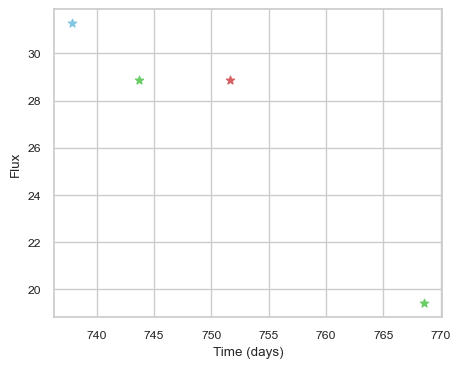

SNIax (3.7603283, False)
SNIax (3.4445283, False)
SNIax (3.2698734, False)
SNIax (3.1226933, False)
SNIax (3.513016, False)
SNIax (3.3638551, False)
SNIax (4.4811683, False)
SNIax (4.889745, False)


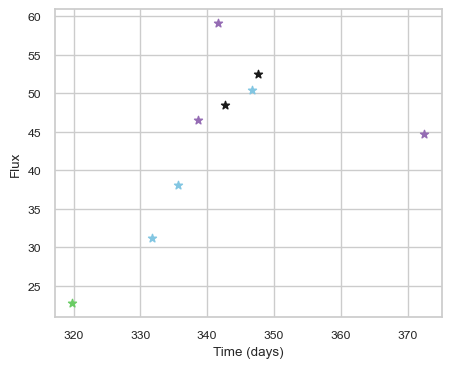

SNIax (4.208357, False)
SNIax (4.3379745, False)
SNIax (4.017357, False)
SNIax (3.4665265, False)
SNIax (4.0438957, False)
SNIax (3.8271523, False)
SNIax (3.5447342, False)
SNIax (3.2924795, False)
SNIax (3.4353504, False)
SNIax (2.966325, False)
SNIax (3.410491, False)
SNIax (3.431618, False)
SNIax (3.0734675, False)
SNIax (2.9438984, False)
SNIax (3.0351686, False)
SNIax (3.193557, False)
SNIax (3.2405102, False)
SNIax (2.881546, False)


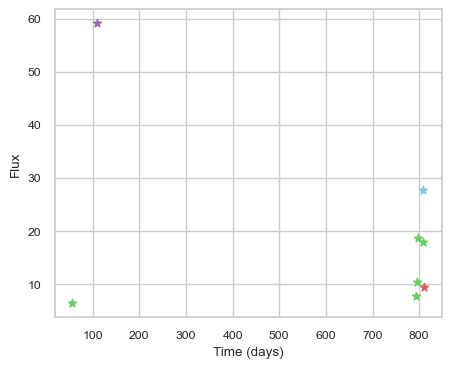

SNIax (4.1503153, False)
SNIax (3.6434166, False)
SNIax (3.694832, False)
SNIax (3.3384948, False)
SNIax (3.6324809, False)
SNIax (3.1478512, False)
SNIax (2.946997, False)
SNIax (3.026435, False)
SNIax (3.1897428, False)
SNIax (2.817388, False)
SNIax (2.5485063, False)
SNIax (2.943312, False)
SNIax (2.5328903, False)
SNIax (2.701231, False)
SNIax (2.8413057, False)
SNIax (2.5249796, False)


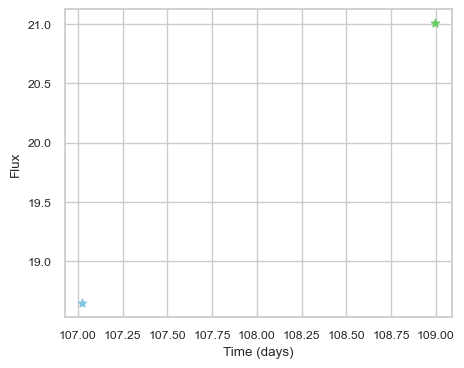

SNIax (5.403277, False)
SNIax (4.598664, False)
SNIax (3.7972932, False)
SNIax (4.2755604, False)


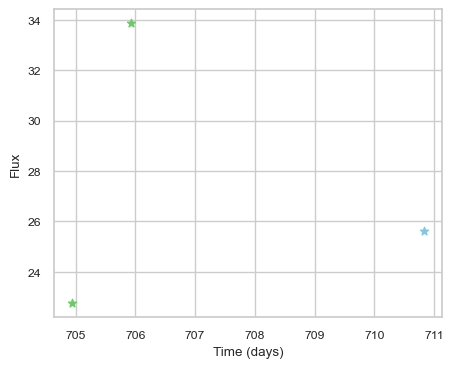

SNIax (3.7338593, False)
SNIax (3.500909, False)
SNIax (3.0976193, False)
SNIax (2.9789639, False)
SNIax (3.2748501, False)
SNIax (2.556472, False)


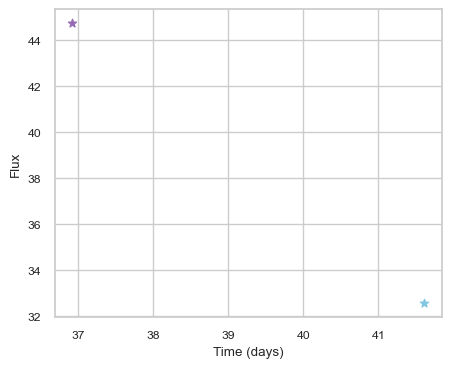

SNIax (4.8632016, False)
SNIax (4.487071, False)
SNIax (5.1799283, False)
SNIax (3.9985383, False)


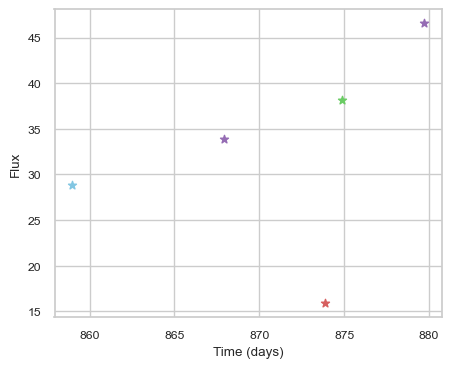

SNIax (4.0497885, False)
SNIax (3.80593, False)
SNIax (3.7091937, False)
SNIax (3.860537, False)
SNIax (2.8675723, False)
SNIax (3.3990128, False)
SNIax (2.891465, False)
SNIax (2.7635467, False)
SNIax (3.3559275, False)
SNIax (3.0076008, False)


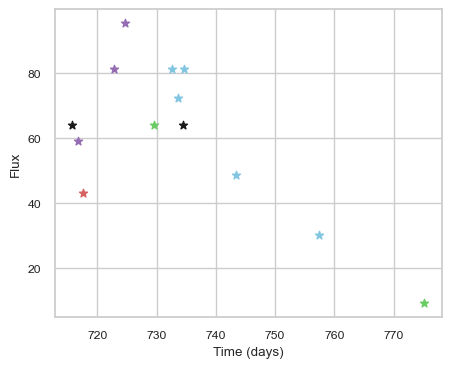

SNIax (4.0040627, False)
SNIax (3.7154148, False)
SNIax (4.0791435, False)
SNIax (3.6012757, False)
SNIax (4.5298457, False)
SNIax (5.197034, False)
SNIax (5.204043, False)
SNIax (4.1918097, False)
SNIax (4.9113994, False)
SNIax (4.6691, False)
SNIax (4.812765, False)
SNIax (3.726811, False)
SNIax (3.3049634, False)
SNIax (3.1383193, False)
SNIax (3.6802385, False)
SNIax (3.2933173, False)
SNIax (3.7126844, False)
SNIax (3.406359, False)
SNIax (3.2718441, False)
SNIax (2.9813132, False)
SNIax (3.3566926, False)
SNIax (2.8949177, False)
SNIax (3.1233563, False)
SNIax (2.7439091, False)
SNIax (2.8379977, False)
SNIax (3.1653297, False)


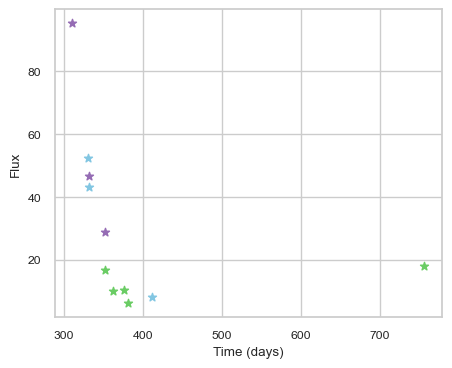

SNIax (3.8066502, False)
SNIax (4.467766, False)
SNIax (4.418738, False)
SNIax (4.434649, False)
SNIax (4.4020214, False)
SNIax (4.364898, False)
SNIax (4.390384, False)
SNIax (3.7620006, False)
SNIax (3.8633323, False)
SNIax (3.763418, False)
SNIax (4.2547245, False)
SNIax (3.8204143, False)
SNIax (4.1043, False)
SNIax (4.0402217, False)
SNIax (3.804626, False)
SNIax (3.9557693, False)
SNIax (4.052227, False)
SNIax (3.9780278, False)
SNIax (4.514307, False)
SNIax (4.7064652, False)
SNIax (4.661395, False)
SNIax (4.152502, False)


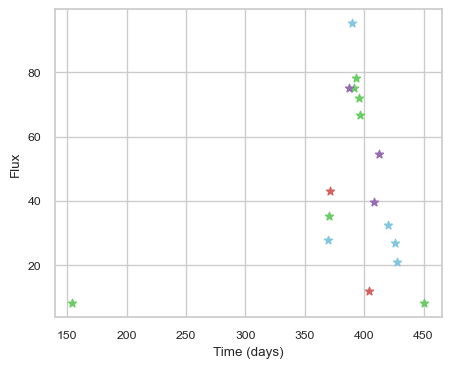

SNIax (3.7516403, False)
SNIax (3.7170515, False)
SNIax (3.430804, False)
SNIax (3.6113856, False)
SNIax (3.1911821, False)
SNIax (3.3312504, False)
SNIax (3.4377859, False)
SNIax (3.2010176, False)
SNIax (3.7075412, False)
SNIax (2.9997501, False)
SNIax (3.8104303, False)
SNIax (2.8697476, False)
SNIax (3.178253, False)
SNIax (2.6530206, False)
SNIax (2.844227, False)
SNIax (2.5423713, False)
SNIax (2.9261181, False)
SNIax (2.4099882, False)
SNIax (2.5246842, False)
SNIax (2.5904624, False)
SNIax (2.969071, False)
SNIax (3.0929081, False)
SNIax (3.0495353, False)
SNIax (2.5900156, False)
SNIax (2.5820389, False)
SNIax (2.314677, False)
SNIax (2.006596, False)
SNIax (2.1098478, False)
SNIax (2.0542908, False)
SNIax (2.0089521, False)
SNIax (2.1962001, False)
SNIax (2.1615548, False)
SNIax (2.1281195, False)
SNIax (2.0499635, False)


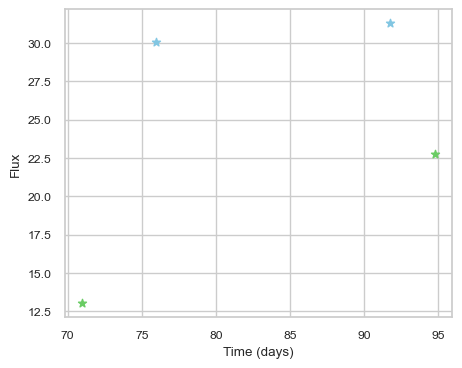

SNIax (5.091814, False)
SNIax (4.0245013, False)
SNIax (3.794368, False)
SNIax (4.029471, False)
SNIax (3.9983037, False)
SNIax (4.274233, False)
SNIax (3.6939805, False)
SNIax (3.5808868, False)


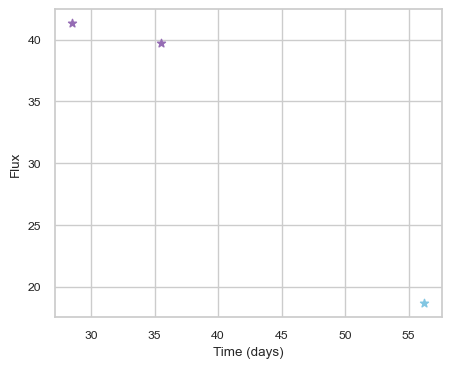

SNIax (4.524252, False)
SNIax (4.4157243, False)
SNIax (4.9559674, False)
SNIax (4.5982623, False)
SNIax (4.0553107, False)
SNIax (3.6285577, False)


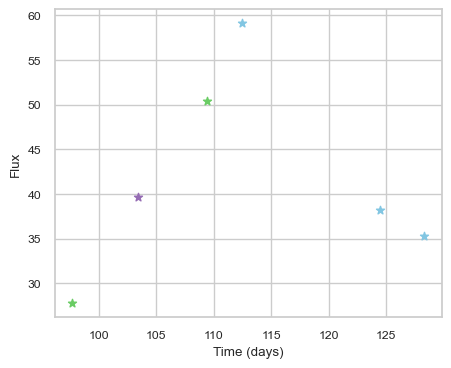

SNIax (4.1523175, False)
SNIax (3.8713024, False)
SNIax (3.528694, False)
SNIax (3.530449, False)
SNIax (3.1790676, False)
SNIax (3.0473378, False)
SNIax (3.029067, False)
SNIax (2.903877, False)
SNIax (3.311259, False)
SNIax (2.8047311, False)
SNIax (2.6993043, False)
SNIax (2.4407263, False)


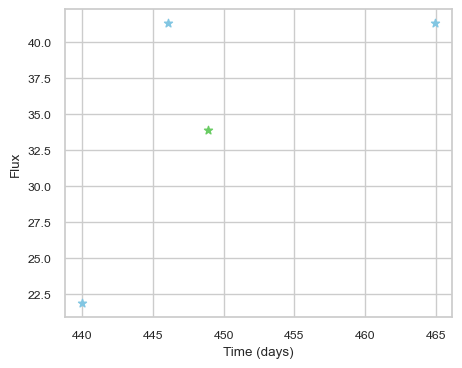

SNIax (3.6904728, False)
SNIax (3.9041145, False)
SNIax (3.3553264, False)
SNIax (3.9561675, False)
SNIax (3.4579263, False)
SNIax (3.7641265, False)
SNIax (3.6158893, False)
SNIax (3.5319374, False)


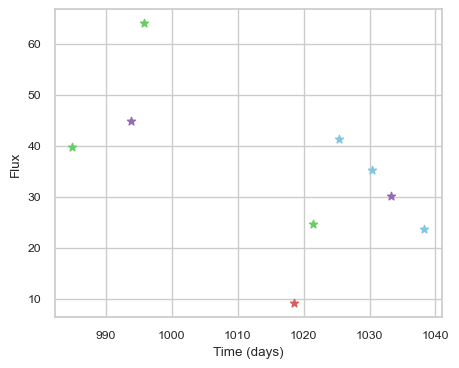

SNIax (3.9835002, False)
SNIax (3.9077196, False)
SNIax (3.7469096, False)
SNIax (3.3358736, False)
SNIax (3.6839604, False)
SNIax (3.4459825, False)
SNIax (4.646585, False)
SNIax (3.697267, False)
SNIax (4.9440875, False)
SNIax (3.5831435, False)
SNIax (4.2608333, False)
SNIax (3.2869952, False)
SNIax (4.1663613, False)
SNIax (3.327272, False)
SNIax (3.758742, False)
SNIax (3.5236917, False)
SNIax (3.5899315, False)
SNIax (3.3592343, False)


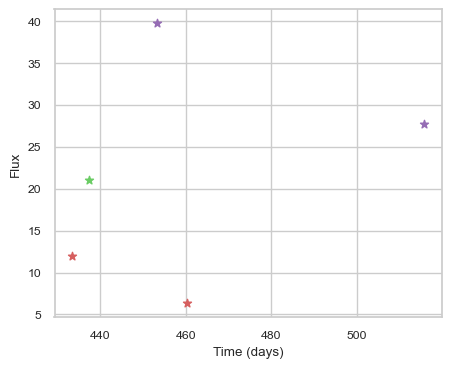

SNIax (4.0201397, False)
SNIax (4.421976, False)
SNIax (3.7350323, False)
SNIax (3.466163, False)
SNIax (3.7970736, False)
SNIax (3.5500767, False)
SNIax (3.3498955, False)
SNIax (3.6645858, False)
SNIax (4.192769, False)
SNIax (4.377979, False)


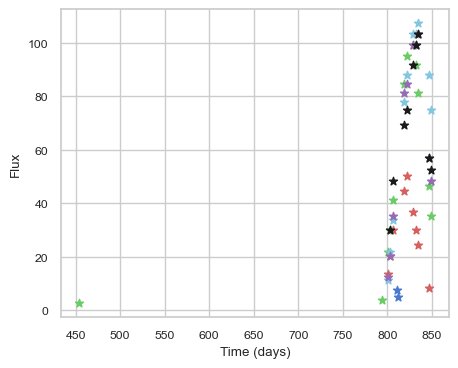

SNIax (4.147239, False)
SNIax (4.17259, False)
SNIax (3.554135, False)
SNIax (3.6695337, False)
SNIax (3.3783689, False)
SNIax (2.7370749, False)
SNIax (3.2105985, False)
SNIax (3.8697643, False)
SNIax (3.3420477, False)
SNIax (4.432843, False)
SNIax (2.5709662, False)
SNIax (3.200443, False)
SNIax (3.323304, False)
SNIax (3.9677765, False)
SNIax (4.0064464, False)
SNIax (3.42711, False)
SNIax (2.2918227, False)
SNIax (2.6564946, False)
SNIax (2.2858458, False)
SNIax (2.3811433, False)
SNIax (2.755391, False)
SNIax (1.8654616, False)
SNIax (3.0897577, False)
SNIax (2.6610475, False)
SNIax (3.0882456, False)
SNIax (2.720796, False)
SNIax (2.046557, False)
SNIax (2.0446024, False)
SNIax (3.0685184, False)
SNIax (3.0525887, False)
SNIax (2.410752, False)
SNIax (3.0521207, False)
SNIax (2.3717213, False)
SNIax (2.565446, False)
SNIax (3.0553317, False)
SNIax (3.279025, False)
SNIax (2.9823706, False)
SNIax (3.453191, False)
SNIax (3.0639305, False)
SNIax (3.403553, False)
SNIax (3.679741, 

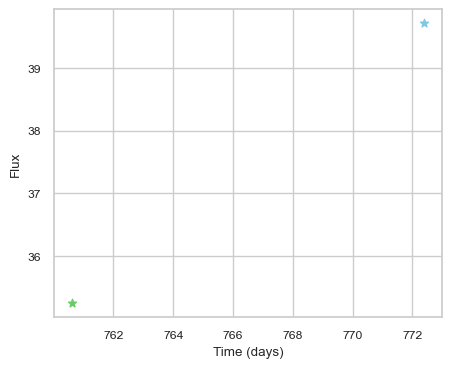

SNIax (4.2489185, False)
SNIax (3.651927, False)
SNIax (4.269975, False)
SNIax (3.9724984, False)


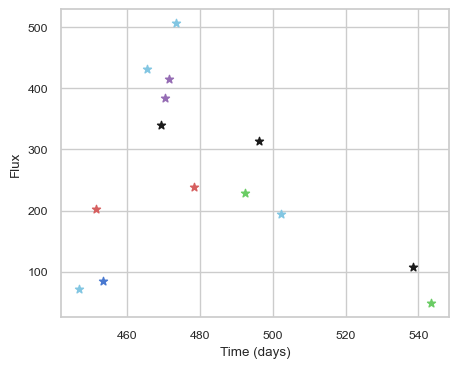

SNIax (3.8250115, False)
SNIax (3.966458, False)
SNIax (3.6001685, False)
SNIax (3.93735, False)
SNIax (3.3913994, False)
SNIax (3.4551983, False)
SNIax (3.965636, False)
SNIax (3.3476636, False)
SNIax (3.2869499, False)
SNIax (3.2733748, False)
SNIax (3.5802436, False)
SNIax (2.7757733, False)
SNIax (3.1283786, False)
SNIax (2.7034059, False)
SNIax (2.9540436, False)
SNIax (2.9335759, False)
SNIax (2.4401412, False)
SNIax (2.7982543, False)
SNIax (2.155438, False)
SNIax (2.372535, False)
SNIax (2.5320842, False)
SNIax (3.1283891, False)
SNIax (2.606808, False)
SNIax (3.0273633, False)
SNIax (3.3938253, False)
SNIax (3.7408984, False)
SNIax (3.3294728, False)
SNIax (3.2475734, False)


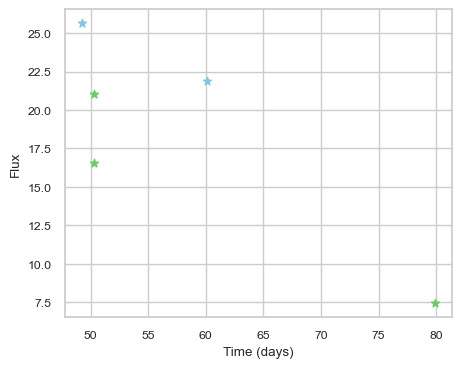

SNIax (4.5138335, False)
SNIax (3.8776643, False)
SNIax (3.1902988, False)
SNIax (2.6401486, False)
SNIax (3.1067498, False)
SNIax (2.394753, False)
SNIax (2.688176, False)
SNIax (2.4229221, False)
SNIax (3.0056987, False)
SNIax (3.0534797, False)


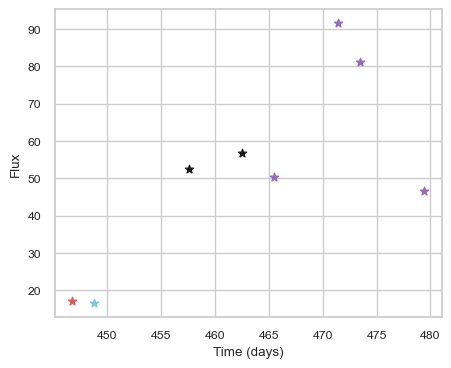

SNIax (3.8943715, False)
SNIax (4.412283, False)
SNIax (3.8586347, False)
SNIax (5.0329123, False)
SNIax (5.4001846, False)
SNIax (4.672938, False)
SNIax (3.6556363, False)
SNIax (4.4544296, False)
SNIax (3.7487998, False)
SNIax (3.7690465, False)
SNIax (3.9250455, False)
SNIax (3.448931, False)
SNIax (3.6594224, False)
SNIax (3.4623387, False)
SNIax (3.4411612, False)
SNIax (3.3505235, False)


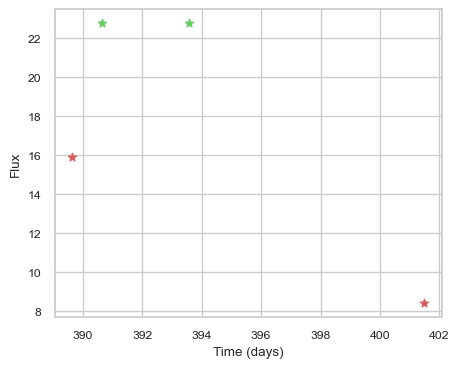

SNIax (3.8479202, False)
SNIax (4.473165, False)
SNIax (3.7979064, False)
SNIax (3.414916, False)
SNIax (4.0372458, False)
SNIax (3.1670756, False)
SNIax (3.650182, False)
SNIax (3.488723, False)


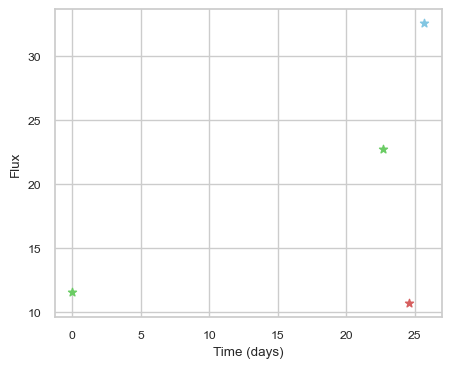

SNIax (4.0718803, False)
SNIax (3.9357414, False)
SNIax (3.2105353, False)
SNIax (3.7848003, False)
SNIax (3.7023504, False)
SNIax (3.3592284, False)
SNIax (3.5728612, False)


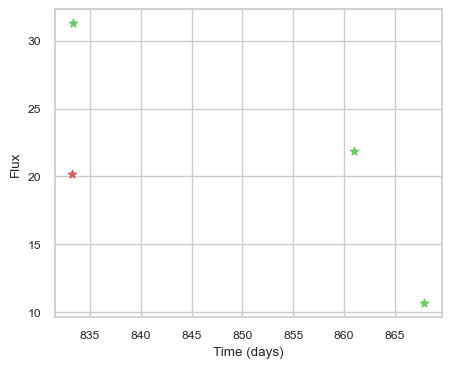

SNIax (3.9272046, False)
SNIax (4.434852, False)
SNIax (4.2239294, False)
SNIax (3.0505555, False)
SNIax (3.0966105, False)
SNIax (3.1777735, False)
SNIax (3.4169855, False)
SNIax (3.8332884, False)


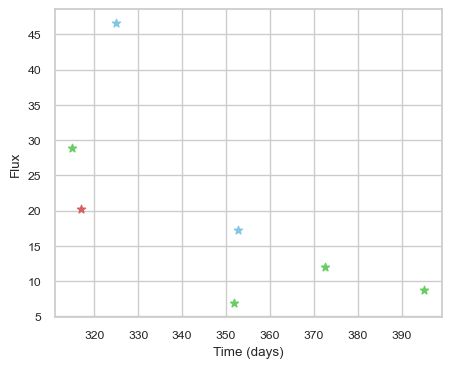

SNIax (3.9173086, False)
SNIax (4.182683, False)
SNIax (3.5928633, False)
SNIax (3.9538536, False)
SNIax (3.2843766, False)
SNIax (2.606118, False)
SNIax (3.6710503, False)
SNIax (3.5503228, False)
SNIax (3.259452, False)
SNIax (2.959999, False)
SNIax (3.197984, False)
SNIax (3.4039493, False)
SNIax (3.52101, False)
SNIax (3.4608517, False)


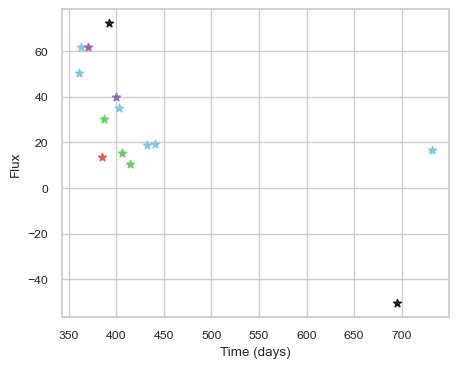

SNIax (3.8640492, False)
SNIax (3.6293383, False)
SNIax (3.4670446, False)
SNIax (3.6649792, False)
SNIax (3.548205, False)
SNIax (2.3924148, False)
SNIax (3.6396384, False)
SNIax (3.5109992, False)
SNIax (3.5490801, False)
SNIax (2.9958787, False)
SNIax (4.3777623, False)
SNIax (3.8468251, False)
SNIax (3.7950127, False)
SNIax (4.215413, False)
SNIax (4.257134, False)
SNIax (3.3052833, False)
SNIax (4.0800433, False)
SNIax (3.779643, False)
SNIax (3.2034788, False)
SNIax (3.3766012, False)
SNIax (2.4933677, False)
SNIax (2.6543646, False)
SNIax (2.8443613, False)
SNIax (2.6261613, False)
SNIax (3.512708, False)
SNIax (4.4083934, False)
SNIax (4.625668, False)
SNIax (3.8046227, False)


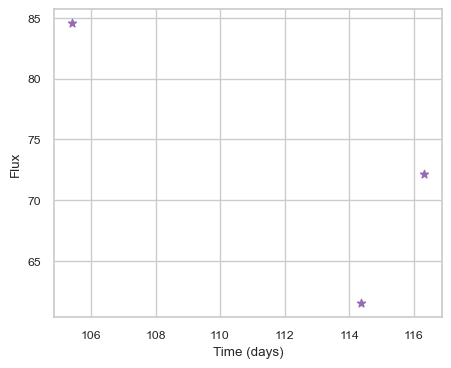

SNIax (4.5984697, False)
SNIax (4.9740615, False)
SNIax (5.5885835, False)
SNIax (5.5847845, False)
SNIax (5.596978, False)
SNIax (6.1549478, False)


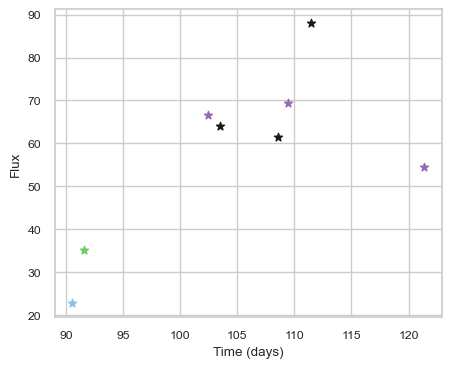

SNIax (4.023819, False)
SNIax (3.8153677, False)
SNIax (3.2955668, False)
SNIax (3.2979946, False)
SNIax (3.5340364, False)
SNIax (3.4984128, False)
SNIax (3.9330091, False)
SNIax (3.3098912, False)
SNIax (3.429221, False)
SNIax (2.87844, False)
SNIax (3.620787, False)
SNIax (2.9160652, False)
SNIax (3.7055259, False)
SNIax (3.2279744, False)
SNIax (3.5439482, False)
SNIax (2.934377, False)


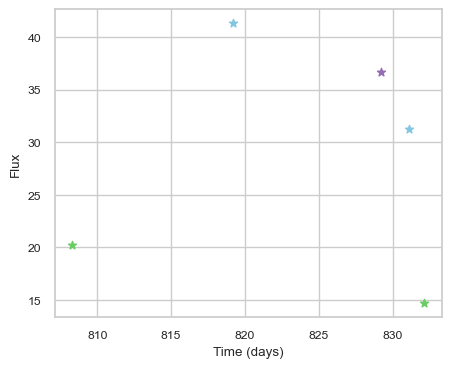

SNIax (4.04407, False)
SNIax (3.4359627, False)
SNIax (3.246281, False)
SNIax (3.3129704, False)
SNIax (2.5294414, False)
SNIax (2.63639, False)
SNIax (2.804601, False)
SNIax (2.7592168, False)
SNIax (3.1483746, False)
SNIax (3.1131597, False)


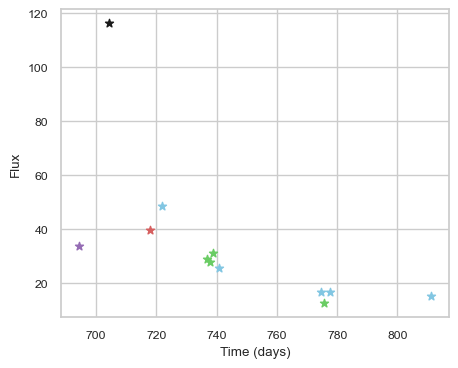

SNIax (3.6943452, False)
SNIax (3.6341963, False)
SNIax (3.510712, False)
SNIax (4.3429523, False)
SNIax (4.0569673, False)
SNIax (4.023452, False)
SNIax (3.6277084, False)
SNIax (3.3176844, False)
SNIax (4.8386765, False)
SNIax (5.0457644, False)
SNIax (4.9690175, False)
SNIax (4.9726896, False)
SNIax (4.8904, False)
SNIax (5.0184045, False)
SNIax (5.0859714, False)
SNIax (4.730691, False)
SNIax (5.551861, False)
SNIax (5.0315924, False)
SNIax (3.5897899, False)
SNIax (4.2836714, False)
SNIax (3.7082336, False)
SNIax (3.933649, False)
SNIax (4.329575, False)
SNIax (4.0949926, False)


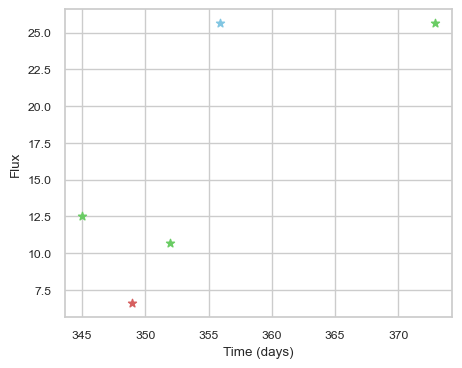

SNIax (4.118693, False)
SNIax (3.5797467, False)
SNIax (3.6162305, False)
SNIax (3.3409877, False)
SNIax (2.675811, False)
SNIax (2.903982, False)
SNIax (3.398277, False)
SNIax (2.539307, False)
SNIax (2.5849812, False)
SNIax (2.741424, False)


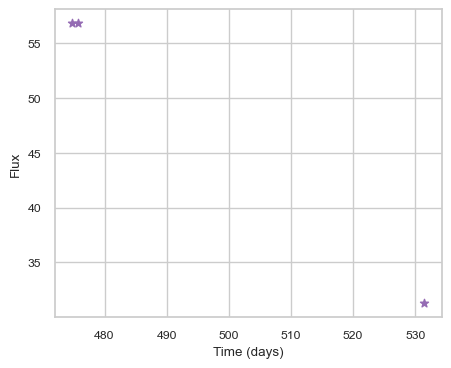

SNIax (4.022952, False)
SNIax (4.149921, False)
SNIax (4.2564754, False)
SNIax (4.2974534, False)
SNIax (3.691186, False)
SNIax (3.8516476, False)


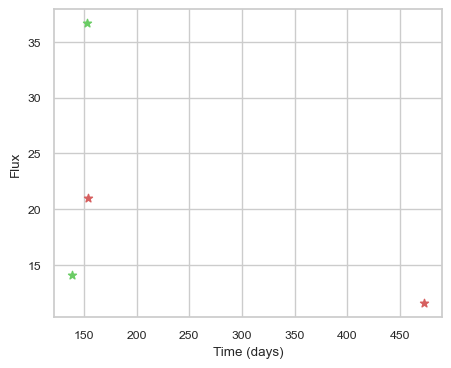

SNIax (3.9710732, False)
SNIax (3.676308, False)
SNIax (3.2949076, False)
SNIax (3.2972538, False)
SNIax (3.2945418, False)
SNIax (3.3260474, False)
SNIax (4.1415067, False)
SNIax (4.876909, False)


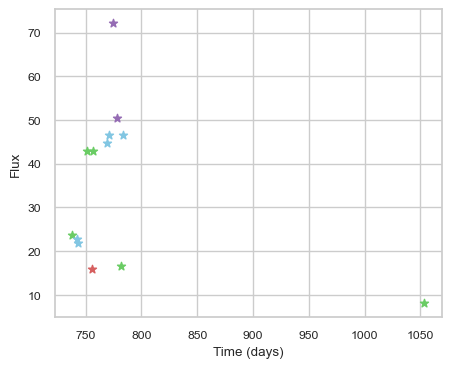

SNIax (4.3867126, False)
SNIax (3.2236915, False)
SNIax (3.4551115, False)
SNIax (2.8624182, False)
SNIax (2.968617, False)
SNIax (2.7728887, False)
SNIax (2.8037572, False)
SNIax (2.7104912, False)
SNIax (3.1252437, False)
SNIax (3.0272076, False)
SNIax (3.069005, False)
SNIax (2.971257, False)
SNIax (3.9020762, False)
SNIax (3.344627, False)
SNIax (4.27806, False)
SNIax (3.8226604, False)
SNIax (4.4365826, False)
SNIax (3.8928554, False)
SNIax (4.2519507, False)
SNIax (3.524714, False)
SNIax (3.8626642, False)
SNIax (3.4584155, False)
SNIax (3.4190454, False)
SNIax (3.2996132, False)
SNIax (3.9700456, False)
SNIax (3.590824, False)


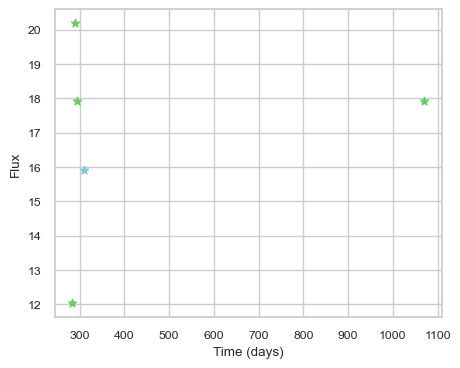

SNIax (4.2408023, False)
SNIax (3.762555, False)
SNIax (3.701315, False)
SNIax (3.3163395, False)
SNIax (3.418692, False)
SNIax (3.138062, False)
SNIax (3.3121336, False)
SNIax (3.4614978, False)
SNIax (3.8585865, False)
SNIax (3.2905407, False)


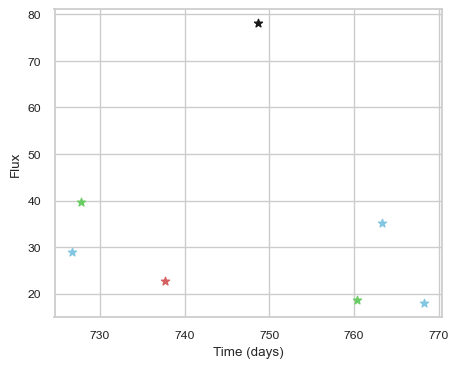

SNIax (3.9704623, False)
SNIax (3.6005118, False)
SNIax (3.015674, False)
SNIax (3.0548525, False)
SNIax (3.5322957, False)
SNIax (3.1027663, False)
SNIax (2.86702, False)
SNIax (2.5317311, False)
SNIax (4.001358, False)
SNIax (3.5914133, False)
SNIax (3.3350837, False)
SNIax (2.792163, False)
SNIax (3.269567, False)
SNIax (2.5569987, False)


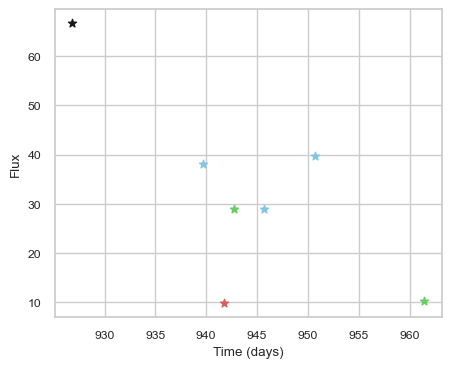

SNIax (4.0072803, False)
SNIax (3.7672925, False)
SNIax (4.317553, False)
SNIax (4.021907, False)
SNIax (3.3101966, False)
SNIax (3.2249312, False)
SNIax (3.1563547, False)
SNIax (2.9456093, False)
SNIax (3.6922631, False)
SNIax (2.8880723, False)
SNIax (2.9825609, False)
SNIax (3.0248826, False)
SNIax (3.6416702, False)
SNIax (3.1971862, False)


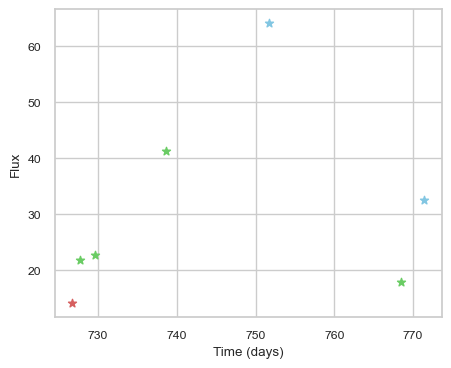

SNIax (3.8978946, False)
SNIax (3.879506, False)
SNIax (3.4404585, False)
SNIax (2.7907512, False)
SNIax (3.4564788, False)
SNIax (2.5922384, False)
SNIax (2.8960338, False)
SNIax (2.87145, False)
SNIax (2.9594064, False)
SNIax (3.560324, False)
SNIax (3.7016428, False)
SNIax (3.7181013, False)
SNIax (3.6622856, False)
SNIax (3.3151064, False)


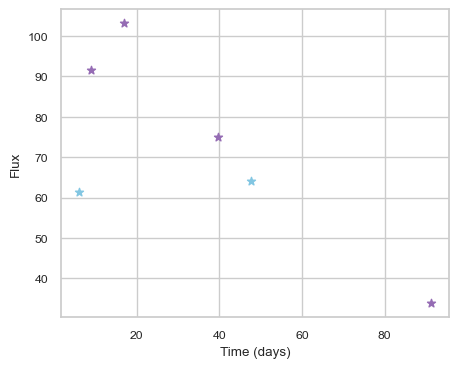

SNIax (4.3926, False)
SNIax (4.693934, False)
SNIax (4.819736, False)
SNIax (4.9843216, False)
SNIax (4.620068, False)
SNIax (4.7280917, False)
SNIax (5.138104, False)
SNIax (4.366181, False)
SNIax (4.5962796, False)
SNIax (4.34105, False)
SNIax (4.603054, False)
SNIax (4.156092, False)


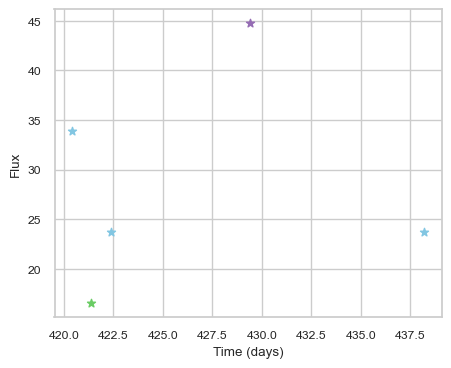

SNIax (5.0034165, False)
SNIax (4.659027, False)
SNIax (5.052698, False)
SNIax (5.0260973, False)
SNIax (4.918189, False)
SNIax (5.208698, False)
SNIax (4.7659974, False)
SNIax (5.3339696, False)
SNIax (5.456795, False)
SNIax (5.216964, False)


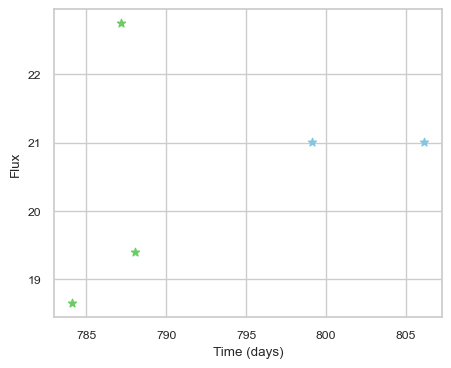

SNIax (3.9838884, False)
SNIax (3.432828, False)
SNIax (3.4516082, False)
SNIax (2.8507493, False)
SNIax (3.291358, False)
SNIax (3.273882, False)
SNIax (3.1639035, False)
SNIax (3.5453882, False)
SNIax (3.7768593, False)
SNIax (3.4649723, False)


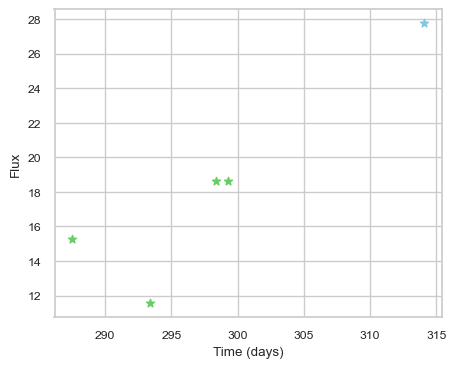

SNIax (4.9583664, False)
SNIax (4.3379335, False)
SNIax (4.321226, False)
SNIax (4.2408075, False)
SNIax (4.134797, False)
SNIax (3.733926, False)
SNIax (3.4180868, False)
SNIax (3.4645975, False)
SNIax (3.3364384, False)
SNIax (3.2627912, False)


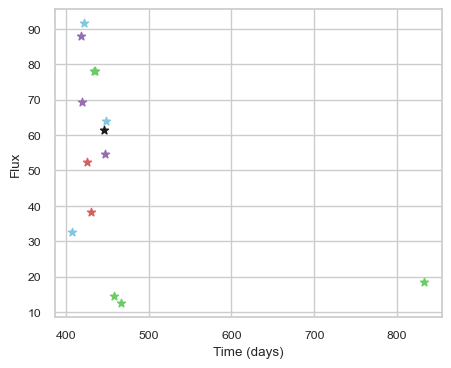

SNIax (3.9259572, False)
SNIax (3.5110116, False)
SNIax (3.515651, False)
SNIax (4.3211966, False)
SNIax (5.206076, False)
SNIax (4.43164, False)
SNIax (4.3687286, False)
SNIax (4.741013, False)
SNIax (4.7918787, False)
SNIax (5.089903, False)
SNIax (5.2442346, False)
SNIax (5.514752, False)
SNIax (4.9974017, False)
SNIax (5.172943, False)
SNIax (4.6025233, False)
SNIax (5.385019, False)
SNIax (5.273762, False)
SNIax (5.2974367, False)
SNIax (5.8123565, False)
SNIax (5.03037, False)
SNIax (5.765087, False)
SNIax (5.0889482, False)
SNIax (5.1683383, False)
SNIax (4.9403977, False)
SNIax (5.2278566, False)
SNIax (5.146516, False)
SNIax (5.3741245, False)
SNIax (5.0744576, False)


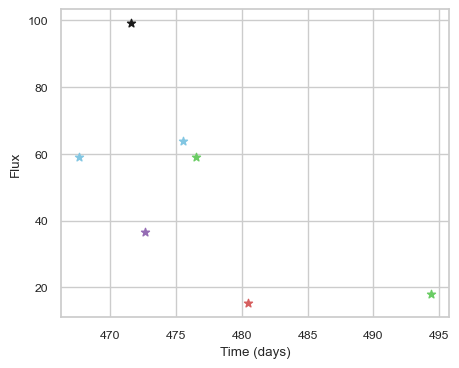

SNIax (3.8630962, False)
SNIax (4.0788045, False)
SNIax (3.9616554, False)
SNIax (4.091096, False)
SNIax (3.9602194, False)
SNIax (4.381084, False)
SNIax (4.191749, False)
SNIax (4.5997777, False)
SNIax (4.7056394, False)
SNIax (4.703882, False)
SNIax (4.912648, False)
SNIax (4.2174177, False)
SNIax (3.2837152, False)
SNIax (3.2270637, False)


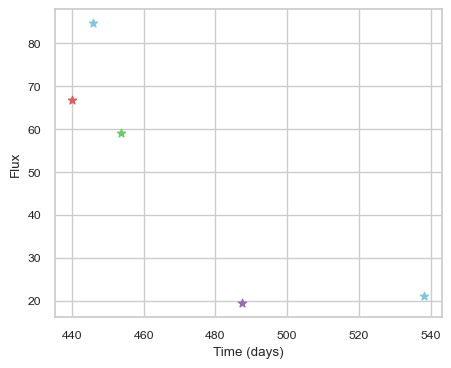

SNIax (4.5278153, False)
SNIax (5.4336367, False)
SNIax (4.434965, False)
SNIax (4.188555, False)
SNIax (3.5487201, False)
SNIax (4.5930967, False)
SNIax (4.786038, False)
SNIax (4.016335, False)
SNIax (3.4588335, False)
SNIax (3.8814685, False)


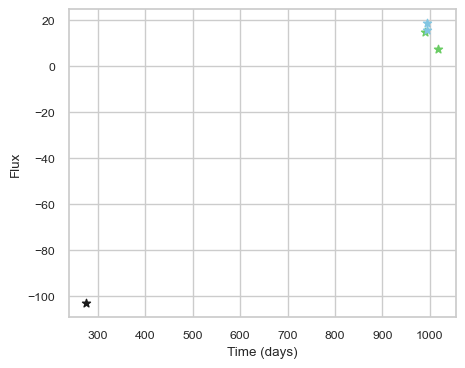

SNIax (3.9922223, False)
SNIax (4.1599298, False)
SNIax (4.0939, False)
SNIax (3.7602336, False)
SNIax (3.3856866, False)
SNIax (3.4738705, False)
SNIax (3.2538047, False)
SNIax (3.5608077, False)
SNIax (3.4528997, False)
SNIax (4.0868063, False)


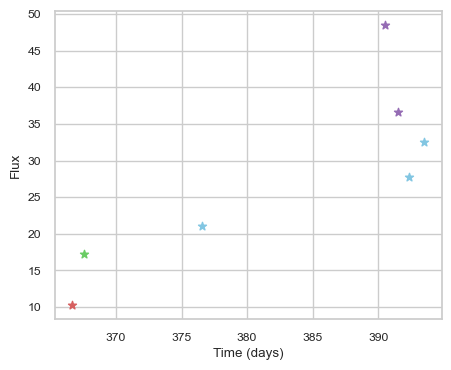

SNIax (4.0121217, False)
SNIax (3.5241134, False)
SNIax (3.5347638, False)
SNIax (3.2450173, False)
SNIax (3.343394, False)
SNIax (3.2586298, False)
SNIax (3.2915802, False)
SNIax (2.9814947, False)
SNIax (3.5333688, False)
SNIax (3.2270522, False)
SNIax (3.5460222, False)
SNIax (3.2626967, False)
SNIax (3.5055861, False)
SNIax (3.3147855, False)


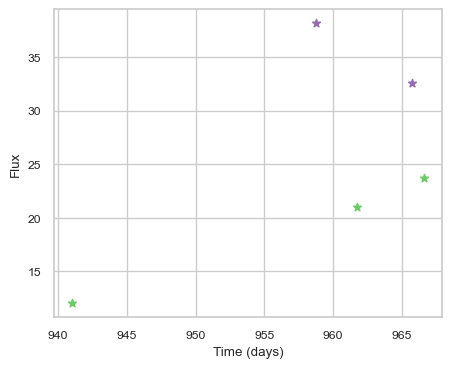

SNIax (4.124947, False)
SNIax (3.7184033, False)
SNIax (3.3528383, False)
SNIax (3.179101, False)
SNIax (2.6427686, False)
SNIax (2.4823759, False)
SNIax (2.7395186, False)
SNIax (2.7313144, False)
SNIax (2.6999154, False)
SNIax (2.9859488, False)


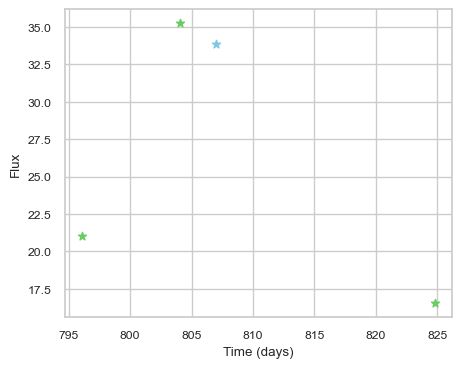

SNIax (3.8974984, False)
SNIax (3.4428294, False)
SNIax (3.2811909, False)
SNIax (2.7931457, False)
SNIax (3.3962739, False)
SNIax (3.5893157, False)
SNIax (3.533297, False)
SNIax (4.236363, False)


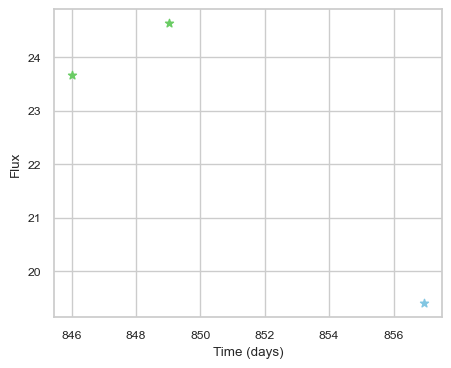

SNIax (4.385735, False)
SNIax (3.76143, False)
SNIax (3.3197641, False)
SNIax (3.4011214, False)
SNIax (3.3376184, False)
SNIax (3.270462, False)


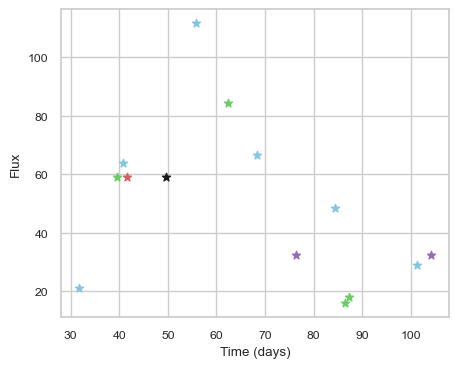

SNIax (3.8993566, False)
SNIax (3.6909928, False)
SNIax (3.1765368, False)
SNIax (3.0694265, False)
SNIax (3.1509786, False)
SNIax (3.1208644, False)
SNIax (3.8929036, False)
SNIax (3.7107239, False)
SNIax (3.243896, False)
SNIax (2.694601, False)
SNIax (2.8290563, False)
SNIax (2.8361795, False)
SNIax (3.5912118, False)
SNIax (2.445482, False)
SNIax (2.806629, False)
SNIax (2.0190613, False)
SNIax (3.0280142, False)
SNIax (1.8817751, False)
SNIax (2.1419873, False)
SNIax (1.8453599, False)
SNIax (2.5322564, False)
SNIax (1.9522774, False)
SNIax (2.4180984, False)
SNIax (2.3486588, False)
SNIax (2.4541428, False)
SNIax (2.1137385, False)
SNIax (2.36341, False)
SNIax (2.072604, False)


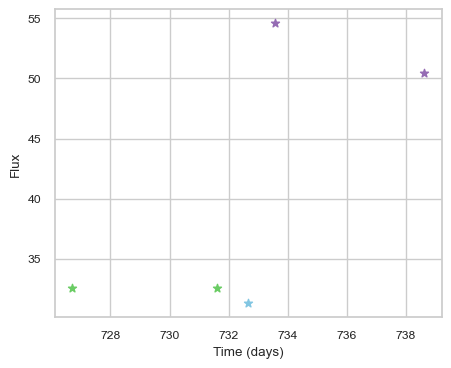

SNIax (3.9510741, False)
SNIax (3.1868486, False)
SNIax (3.261068, False)
SNIax (2.5344045, False)
SNIax (3.388351, False)
SNIax (3.2630816, False)
SNIax (3.7997675, False)
SNIax (3.4681528, False)
SNIax (3.7674332, False)
SNIax (3.6091802, False)


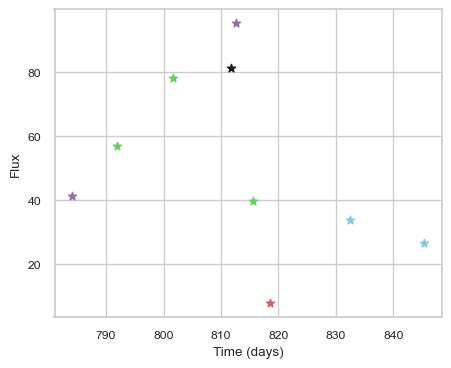

SNIax (3.8538797, False)
SNIax (3.167649, False)
SNIax (3.003563, False)
SNIax (3.173576, False)
SNIax (3.0415933, False)
SNIax (3.3816037, False)
SNIax (4.1781507, False)
SNIax (4.0333147, False)
SNIax (5.0734553, False)
SNIax (4.051442, False)
SNIax (3.673685, False)
SNIax (3.8226757, False)
SNIax (3.9662738, False)
SNIax (3.8954885, False)
SNIax (4.380098, False)
SNIax (3.4270396, False)
SNIax (3.5509086, False)
SNIax (3.1701891, False)


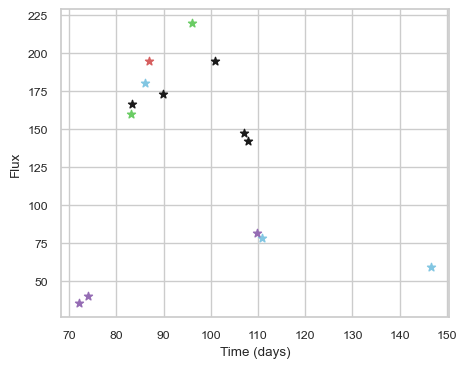

SNIax (3.8346457, False)
SNIax (3.9246967, False)
SNIax (3.3455284, False)
SNIax (4.009342, False)
SNIax (3.0370436, False)
SNIax (3.9626052, False)
SNIax (4.8247933, False)
SNIax (3.9397454, False)
SNIax (3.665595, False)
SNIax (2.679474, False)
SNIax (3.4102564, False)
SNIax (3.2086086, False)
SNIax (3.9338017, False)
SNIax (4.551031, False)
SNIax (3.348655, False)
SNIax (3.4779575, False)
SNIax (3.5756776, False)
SNIax (3.8222222, False)
SNIax (3.3132317, False)
SNIax (2.6250849, False)
SNIax (3.2647052, False)
SNIax (2.6922987, False)
SNIax (3.2673144, False)
SNIax (2.7704666, False)
SNIax (2.737708, False)
SNIax (2.8647745, False)
SNIax (3.0049658, False)
SNIax (2.4343882, False)


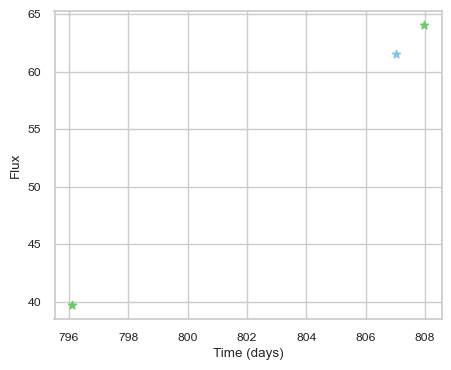

SNIax (3.868647, False)
SNIax (3.3901117, False)
SNIax (3.422217, False)
SNIax (3.517147, False)
SNIax (3.8045592, False)
SNIax (3.6816287, False)


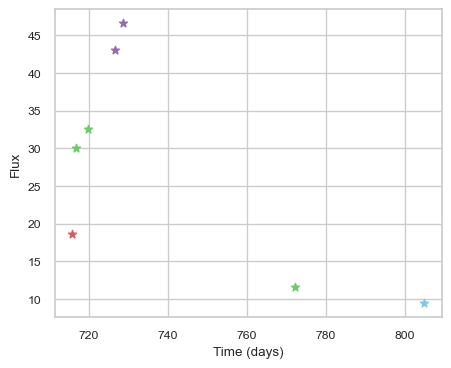

SNIax (3.9352784, False)
SNIax (4.227356, False)
SNIax (3.9755924, False)
SNIax (2.4935498, False)
SNIax (3.7834458, False)
SNIax (3.3124807, False)
SNIax (3.315369, False)
SNIax (3.2295535, False)
SNIax (4.0303125, False)
SNIax (3.3350084, False)
SNIax (4.283214, False)
SNIax (4.2470613, False)
SNIax (4.2065907, False)
SNIax (3.7788143, False)


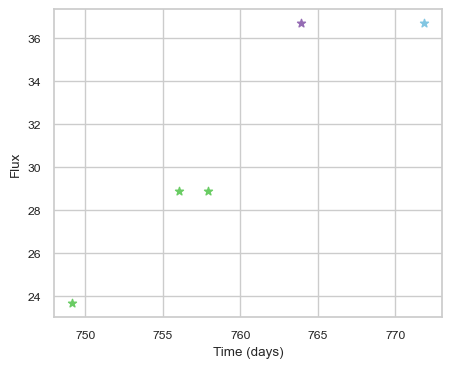

SNIax (4.0218277, False)
SNIax (3.2059498, False)
SNIax (3.1155422, False)
SNIax (2.7867372, False)
SNIax (3.5731983, False)
SNIax (2.931511, False)
SNIax (3.2158093, False)
SNIax (2.4820218, False)
SNIax (2.5696676, False)
SNIax (2.596209, False)


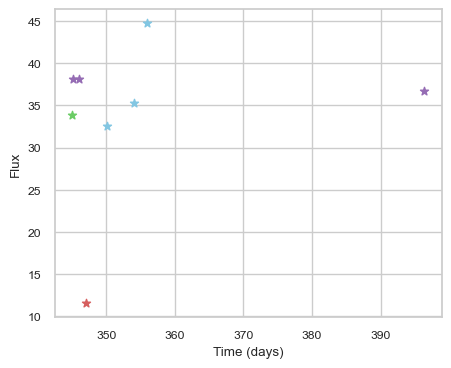

SNIax (4.1204395, False)
SNIax (4.0007443, False)
SNIax (3.9965045, False)
SNIax (3.3428345, False)
SNIax (4.1059813, False)
SNIax (3.486028, False)
SNIax (4.169915, False)
SNIax (3.708166, False)
SNIax (3.8427656, False)
SNIax (3.258899, False)
SNIax (2.894166, False)
SNIax (2.5262349, False)
SNIax (2.7049036, False)
SNIax (2.4964762, False)
SNIax (3.2399442, False)
SNIax (2.6699088, False)


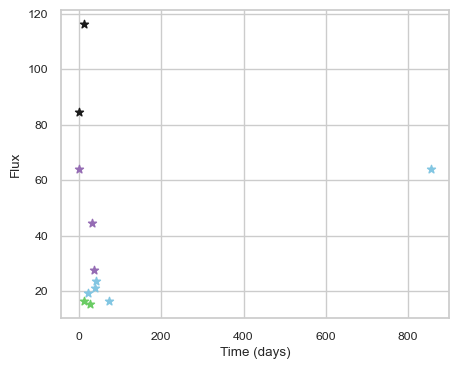

SNIax (4.2123365, False)
SNIax (4.892921, False)
SNIax (4.378758, False)
SNIax (4.4997697, False)
SNIax (4.288221, False)
SNIax (4.9232073, False)
SNIax (4.5339613, False)
SNIax (4.081575, False)
SNIax (3.6116512, False)
SNIax (3.8587945, False)
SNIax (3.3387141, False)
SNIax (4.166902, False)
SNIax (3.882523, False)
SNIax (4.149766, False)
SNIax (3.9433346, False)
SNIax (3.8145256, False)
SNIax (3.6042037, False)
SNIax (3.755606, False)
SNIax (3.7385383, False)
SNIax (4.294904, False)
SNIax (3.9133103, False)
SNIax (4.111858, False)
SNIax (3.5114663, False)


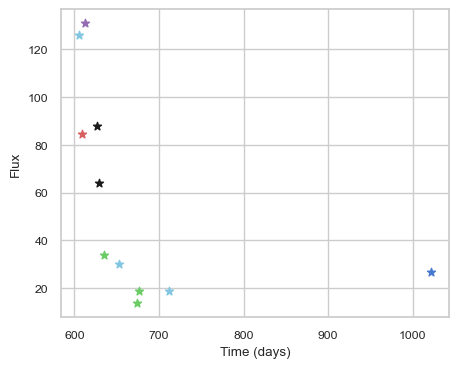

SNIax (3.6997156, False)
SNIax (4.340221, False)
SNIax (4.9696164, False)
SNIax (3.7412405, False)
SNIax (3.9752262, False)
SNIax (3.7481234, False)
SNIax (4.959872, False)
SNIax (4.1589375, False)
SNIax (5.685369, False)
SNIax (4.3717666, False)
SNIax (5.2188015, False)
SNIax (5.074344, False)
SNIax (4.8423104, False)
SNIax (4.799782, False)
SNIax (4.3070025, False)
SNIax (4.060685, False)
SNIax (4.410531, False)
SNIax (4.3426356, False)
SNIax (4.7522073, False)
SNIax (4.193239, False)
SNIax (4.715152, False)
SNIax (4.9605613, False)


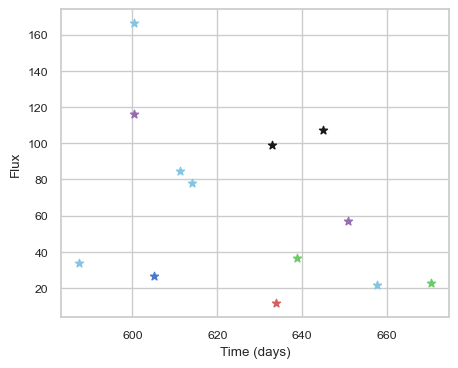

SNIax (3.5382462, False)
SNIax (3.4909368, False)
SNIax (3.1255977, False)
SNIax (3.6066484, False)
SNIax (4.2882175, False)
SNIax (3.8052726, False)
SNIax (4.3264008, False)
SNIax (4.0235176, False)
SNIax (3.6237135, False)
SNIax (3.7475536, False)
SNIax (4.2209086, False)
SNIax (3.75996, False)
SNIax (4.3332376, False)
SNIax (3.7843685, False)
SNIax (4.091295, False)
SNIax (3.795961, False)
SNIax (4.583104, False)
SNIax (4.235519, False)
SNIax (4.0103436, False)
SNIax (4.4915814, False)
SNIax (3.9497485, False)
SNIax (4.208889, False)
SNIax (4.1504273, False)
SNIax (4.132763, False)
SNIax (3.977135, False)
SNIax (4.2715936, False)


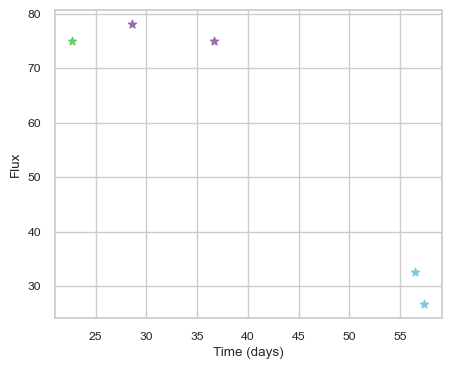

SNIax (3.951396, False)
SNIax (4.8552246, False)
SNIax (5.3344655, False)
SNIax (4.073501, False)
SNIax (3.492385, False)
SNIax (3.2163339, False)
SNIax (3.7210715, False)
SNIax (3.2368388, False)
SNIax (3.653989, False)
SNIax (3.5644712, False)


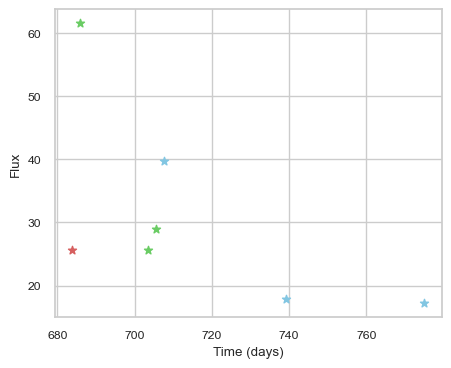

SNIax (3.9000905, False)
SNIax (4.5088873, False)
SNIax (3.894637, False)
SNIax (4.707181, False)
SNIax (4.2025905, False)
SNIax (3.4118965, False)
SNIax (3.6380882, False)
SNIax (3.2937477, False)
SNIax (3.8361914, False)
SNIax (3.395417, False)
SNIax (3.7551188, False)
SNIax (2.8860319, False)
SNIax (3.2387297, False)
SNIax (3.0634327, False)


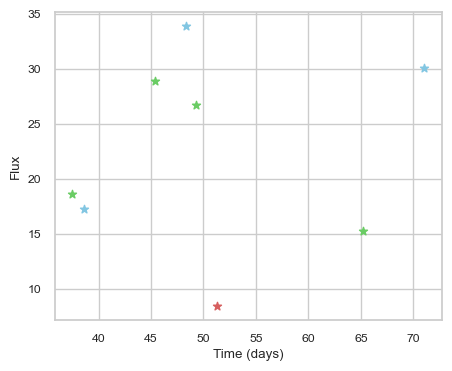

SNIax (4.2511787, False)
SNIax (3.413852, False)
SNIax (3.3324962, False)
SNIax (4.6147366, False)
SNIax (3.8331816, False)
SNIax (2.991335, False)
SNIax (3.5013723, False)
SNIax (2.5335834, False)
SNIax (2.7904053, False)
SNIax (2.4005244, False)
SNIax (2.9592195, False)
SNIax (2.3734658, False)
SNIax (2.1273544, False)
SNIax (2.14428, False)
SNIax (2.865499, False)
SNIax (2.4098794, False)


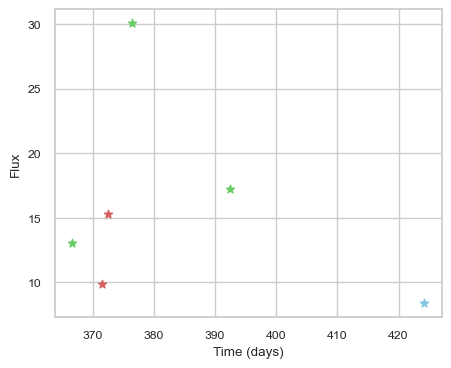

SNIax (3.9533312, False)
SNIax (3.3576927, False)
SNIax (3.3984938, False)
SNIax (3.3486102, False)
SNIax (3.0286403, False)
SNIax (2.791304, False)
SNIax (2.7808464, False)
SNIax (1.920926, False)
SNIax (2.659074, False)
SNIax (2.3881636, False)
SNIax (2.5366657, False)
SNIax (2.9250088, False)


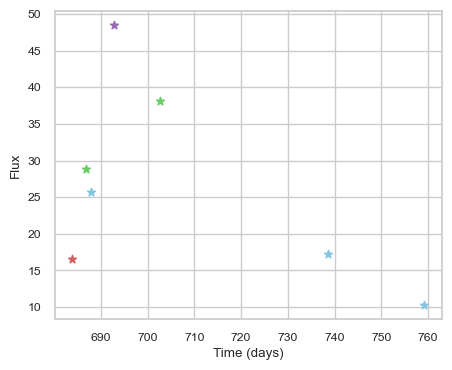

SNIax (3.9540598, False)
SNIax (4.525351, False)
SNIax (3.3036895, False)
SNIax (2.9546537, False)
SNIax (3.11114, False)
SNIax (2.8074791, False)
SNIax (3.2031183, False)
SNIax (2.8873148, False)
SNIax (2.795723, False)
SNIax (3.1749613, False)
SNIax (4.1361732, False)
SNIax (3.9795167, False)
SNIax (3.374518, False)
SNIax (3.6802375, False)


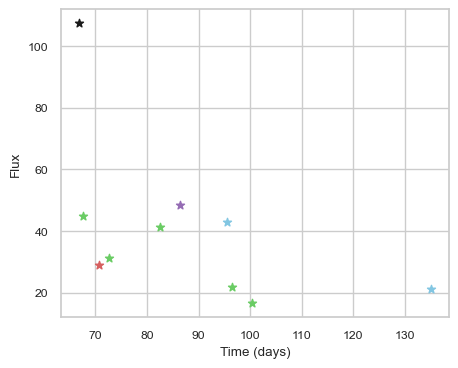

SNIax (3.9202297, False)
SNIax (3.5525267, False)
SNIax (4.734471, False)
SNIax (4.2015805, False)
SNIax (3.7545607, False)
SNIax (3.3271148, False)
SNIax (3.7260783, False)
SNIax (3.1189506, False)
SNIax (3.7644937, False)
SNIax (3.6945493, False)
SNIax (4.2892356, False)
SNIax (3.4389453, False)
SNIax (3.2212622, False)
SNIax (3.2571626, False)
SNIax (3.720228, False)
SNIax (3.2795777, False)
SNIax (3.707916, False)
SNIax (3.2580547, False)
SNIax (3.1909688, False)
SNIax (2.8781369, False)


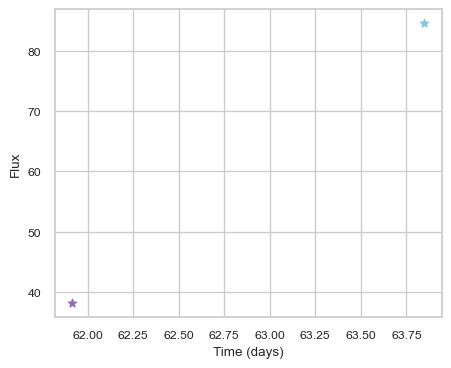

SNIax (3.687662, False)
SNIax (3.899351, False)
SNIax (3.368105, False)
SNIax (3.875513, False)


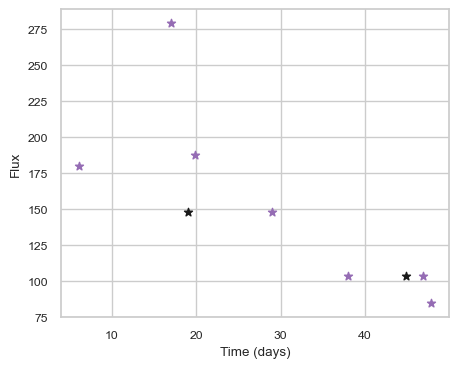

SNIax (3.9807193, False)
SNIax (4.575747, False)
SNIax (3.3968484, False)
SNIax (3.3536253, False)
SNIax (3.5752409, False)
SNIax (3.3027897, False)
SNIax (4.1305847, False)
SNIax (3.9171329, False)
SNIax (3.0880485, False)
SNIax (3.5485942, False)
SNIax (3.0856335, False)
SNIax (3.3373797, False)
SNIax (3.2963889, False)
SNIax (3.781048, False)
SNIax (3.9085765, False)
SNIax (3.475037, False)
SNIax (4.0020695, False)
SNIax (3.6223016, False)


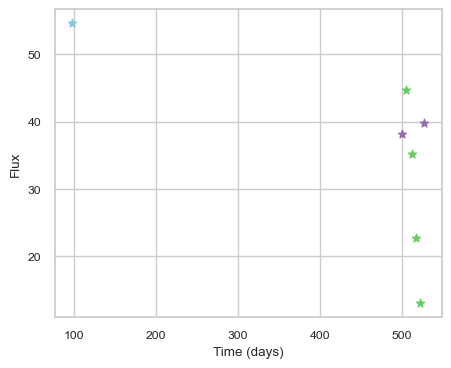

SNIax (4.0965877, False)
SNIax (4.3281827, False)
SNIax (4.1232157, False)
SNIax (3.5324395, False)
SNIax (3.341942, False)
SNIax (3.1476731, False)
SNIax (3.0464585, False)
SNIax (2.6222603, False)
SNIax (3.1362753, False)
SNIax (2.9202168, False)
SNIax (2.7406325, False)
SNIax (2.947066, False)
SNIax (2.1134799, False)
SNIax (2.7417407, False)


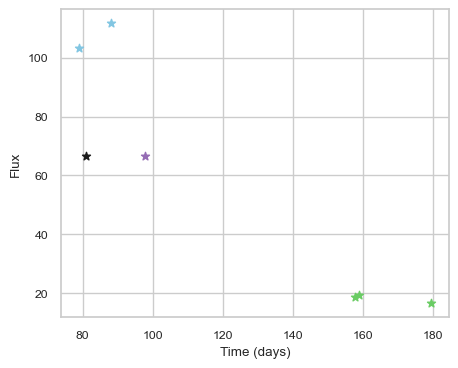

SNIax (3.6556628, False)
SNIax (3.8137863, False)
SNIax (3.6028996, False)
SNIax (3.8211555, False)
SNIax (3.1999881, False)
SNIax (3.865025, False)
SNIax (4.1010275, False)
SNIax (4.1142793, False)
SNIax (3.63754, False)
SNIax (3.361675, False)
SNIax (3.1879408, False)
SNIax (3.5528345, False)
SNIax (2.6272314, False)
SNIax (3.3259847, False)


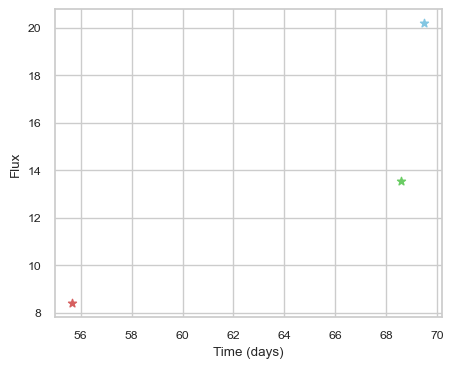

SNIax (4.046457, False)
SNIax (3.5464559, False)
SNIax (3.301338, False)
SNIax (3.6454115, False)
SNIax (3.6327853, False)
SNIax (3.6657495, False)


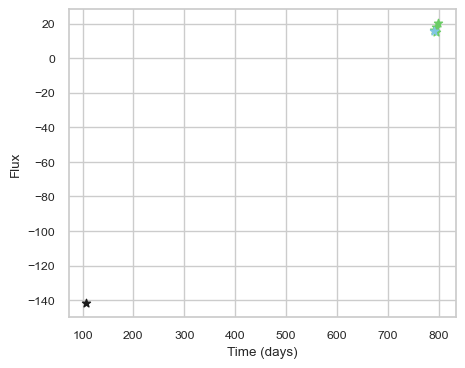

SNIax (4.6050534, False)
SNIax (4.330049, False)
SNIax (4.4369674, False)
SNIax (3.675181, False)
SNIax (3.3733556, False)
SNIax (3.5580504, False)
SNIax (3.3953207, False)
SNIax (3.1764064, False)
SNIax (3.3634217, False)
SNIax (2.771163, False)
SNIax (3.060713, False)
SNIax (2.441463, False)


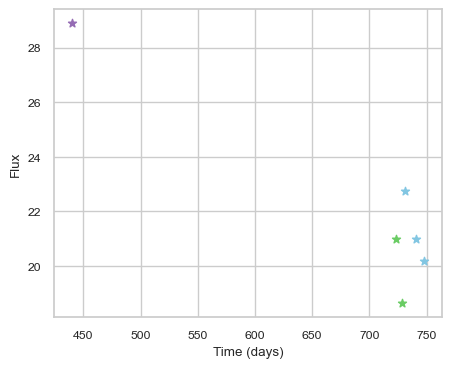

SNIax (4.8539658, False)
SNIax (4.6913247, False)
SNIax (4.7948356, False)
SNIax (4.284319, False)
SNIax (4.311799, False)
SNIax (3.7711453, False)
SNIax (3.4792979, False)
SNIax (3.7612019, False)
SNIax (2.8094754, False)
SNIax (3.2315352, False)
SNIax (3.0255647, False)
SNIax (3.3057082, False)


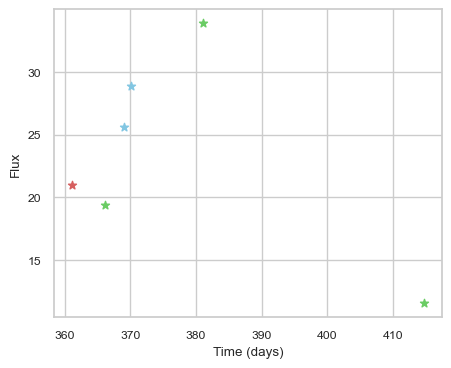

SNIax (3.7209077, False)
SNIax (4.163288, False)
SNIax (3.9911954, False)
SNIax (4.848178, False)
SNIax (5.076018, False)
SNIax (4.592125, False)
SNIax (4.482667, False)
SNIax (4.412614, False)
SNIax (5.0425415, False)
SNIax (5.0537214, False)
SNIax (6.885636, False)
SNIax (6.3186736, False)


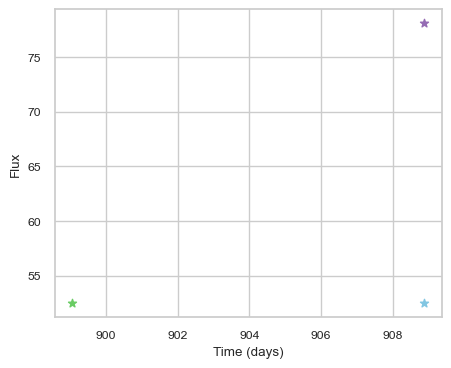

SNIax (4.2943997, False)
SNIax (4.3603554, False)
SNIax (4.6552906, False)
SNIax (5.135871, False)
SNIax (5.152959, False)
SNIax (4.8768997, False)


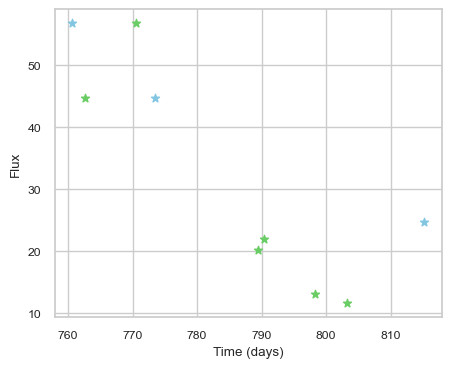

SNIax (3.7277365, False)
SNIax (3.3763418, False)
SNIax (3.30668, False)
SNIax (3.1336277, False)
SNIax (3.502963, False)
SNIax (3.6034863, False)
SNIax (3.6345985, False)
SNIax (2.6736925, False)
SNIax (2.243123, False)
SNIax (2.7005084, False)
SNIax (2.6883557, False)
SNIax (2.1532578, False)
SNIax (2.1861317, False)
SNIax (2.2890587, False)
SNIax (2.0666296, False)
SNIax (2.0785694, False)
SNIax (2.017081, False)
SNIax (1.8048192, False)


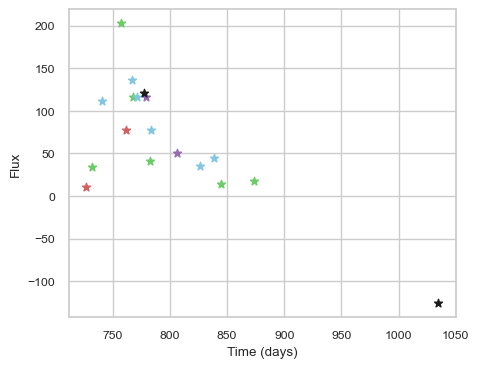

SNIax (4.063274, False)
SNIax (3.961966, False)
SNIax (4.0569124, False)
SNIax (3.2384884, False)
SNIax (3.6377614, False)
SNIax (4.3748827, False)
SNIax (3.5789378, False)
SNIax (4.2184057, False)
SNIax (3.634142, False)
SNIax (3.345172, False)
SNIax (2.7723022, False)
SNIax (2.985611, False)
SNIax (3.1432548, False)
SNIax (4.1074047, False)
SNIax (3.276135, False)
SNIax (3.5914104, False)
SNIax (3.739876, False)
SNIax (4.507702, False)
SNIax (3.9979167, False)
SNIax (3.8181643, False)
SNIax (3.7167706, False)
SNIax (4.1351433, False)
SNIax (3.539412, False)
SNIax (3.7604496, False)
SNIax (4.1823735, False)
SNIax (3.9565372, False)
SNIax (3.5638888, False)
SNIax (3.429775, False)
SNIax (3.6051955, False)
SNIax (3.5157895, False)
SNIax (3.629316, False)
SNIax (3.7520852, False)
SNIax (3.2667742, False)
SNIax (4.268634, False)
SNIax (3.5559127, False)
SNIax (5.0063243, False)


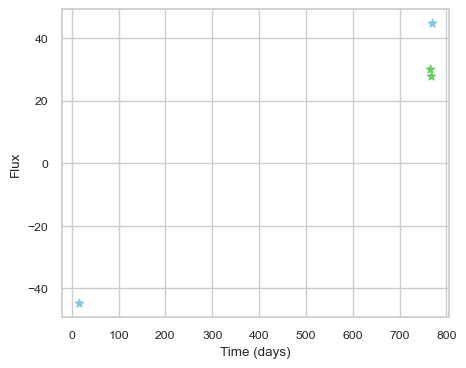

SNIax (4.699839, False)
SNIax (4.322229, False)
SNIax (4.1580634, False)
SNIax (3.5976574, False)
SNIax (3.3275633, False)
SNIax (3.1126692, False)
SNIax (3.263912, False)
SNIax (3.6702306, False)


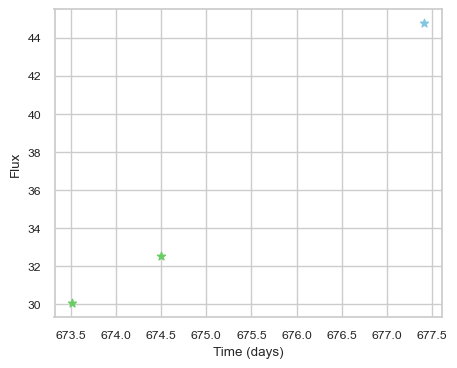

SNIax (3.8558435, False)
SNIax (3.88028, False)
SNIax (3.352469, False)
SNIax (3.4595582, False)
SNIax (3.7540329, False)
SNIax (3.4120011, False)


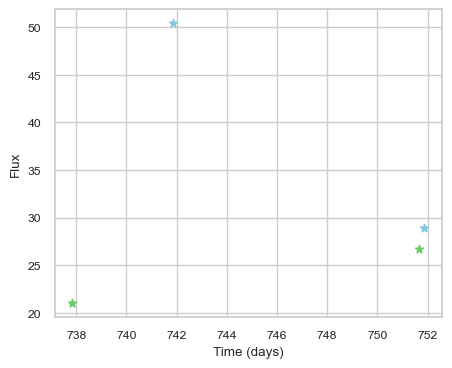

SNIax (4.1088133, False)
SNIax (3.014007, False)
SNIax (3.3566318, False)
SNIax (3.8164682, False)
SNIax (4.182321, False)
SNIax (3.380753, False)
SNIax (3.1181388, False)
SNIax (2.7540877, False)


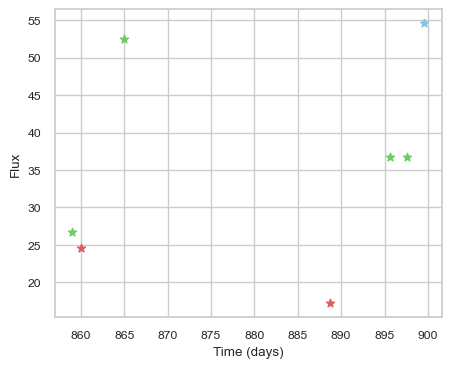

SNIax (3.7522664, False)
SNIax (3.6154382, False)
SNIax (3.1565173, False)
SNIax (4.017804, False)
SNIax (4.44054, False)
SNIax (3.3204205, False)
SNIax (3.3552587, False)
SNIax (2.8805475, False)
SNIax (3.6264307, False)
SNIax (2.8353503, False)
SNIax (3.4432094, False)
SNIax (2.4182289, False)
SNIax (3.6099908, False)
SNIax (2.6184285, False)


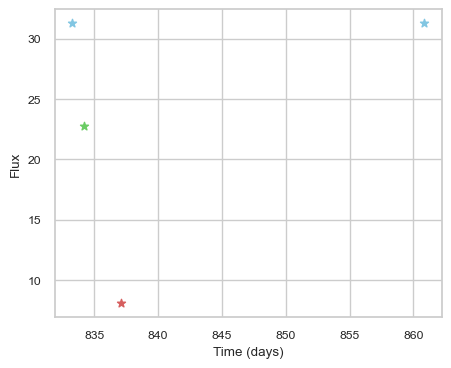

SNIax (3.9675937, False)
SNIax (3.3195796, False)
SNIax (3.3227236, False)
SNIax (2.9987478, False)
SNIax (3.3177664, False)
SNIax (2.179407, False)
SNIax (2.8469727, False)
SNIax (2.7970443, False)


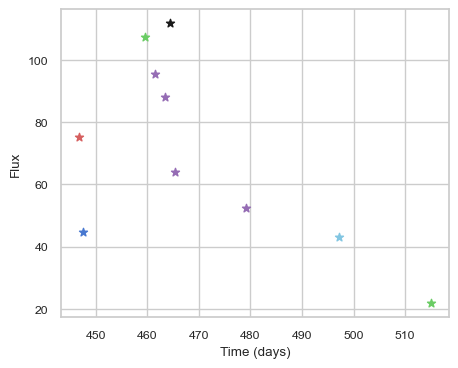

SNIax (3.8393002, False)
SNIax (4.5332084, False)
SNIax (4.274101, False)
SNIax (4.903069, False)
SNIax (4.958406, False)
SNIax (4.4904323, False)
SNIax (4.193933, False)
SNIax (4.9548273, False)
SNIax (5.093906, False)
SNIax (5.1476927, False)
SNIax (5.0241537, False)
SNIax (4.819221, False)
SNIax (4.884661, False)
SNIax (4.762357, False)
SNIax (3.3476334, False)
SNIax (3.4383311, False)
SNIax (3.1089857, False)
SNIax (2.5831685, False)
SNIax (3.1351163, False)
SNIax (2.6148748, False)


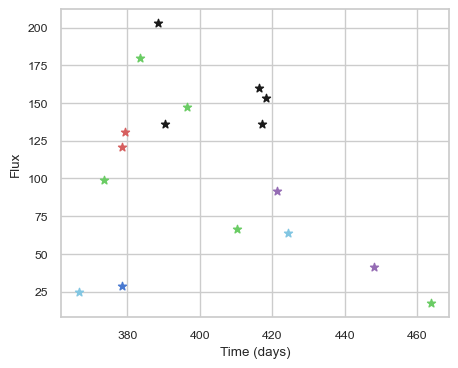

SNIax (3.828905, False)
SNIax (3.4882395, False)
SNIax (3.9452934, False)
SNIax (4.0606475, False)
SNIax (4.3001842, False)
SNIax (3.5453818, False)
SNIax (4.6603875, False)
SNIax (4.5405045, False)
SNIax (5.584605, False)
SNIax (3.8344007, False)
SNIax (5.1381445, False)
SNIax (4.4355197, False)
SNIax (4.96961, False)
SNIax (4.2739725, False)
SNIax (4.4837527, False)
SNIax (3.1649032, False)
SNIax (2.9151247, False)
SNIax (3.1921854, False)
SNIax (3.305592, False)
SNIax (4.086386, False)
SNIax (3.7073092, False)
SNIax (3.6544917, False)
SNIax (3.739396, False)
SNIax (3.6807191, False)
SNIax (3.9627798, False)
SNIax (3.8215084, False)
SNIax (3.685542, False)
SNIax (2.6969435, False)
SNIax (2.7693853, False)
SNIax (2.6155822, False)
SNIax (3.3938322, False)
SNIax (2.971372, False)
SNIax (3.097524, False)
SNIax (2.4826927, False)


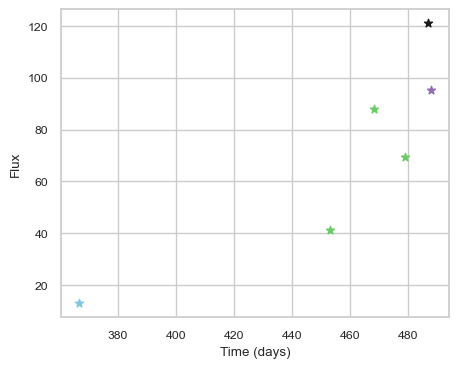

SNIax (3.9008558, False)
SNIax (3.5056467, False)
SNIax (3.616131, False)
SNIax (3.3754838, False)
SNIax (3.1854212, False)
SNIax (4.551496, False)
SNIax (5.09229, False)
SNIax (5.2151494, False)
SNIax (5.2285647, False)
SNIax (5.1381726, False)
SNIax (4.2284374, False)
SNIax (4.001393, False)


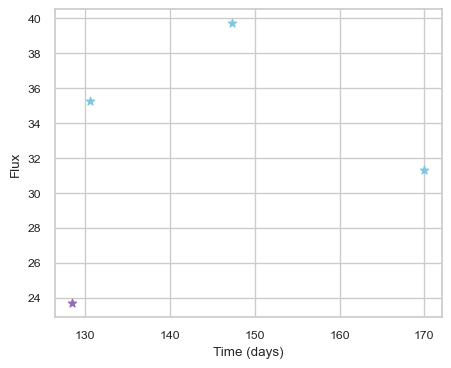

SNIax (5.0386343, False)
SNIax (4.790315, False)
SNIax (4.8906054, False)
SNIax (5.4928627, False)
SNIax (5.8872185, False)
SNIax (6.058599, False)
SNIax (6.125191, False)
SNIax (6.101213, False)


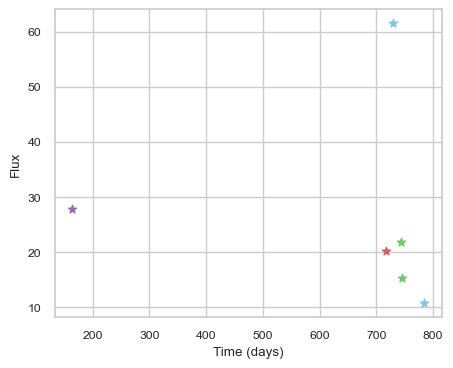

SNIax (4.355108, False)
SNIax (4.054918, False)
SNIax (4.229973, False)
SNIax (3.9965458, False)
SNIax (3.9217746, False)
SNIax (3.7058413, False)
SNIax (4.0716686, False)
SNIax (3.538242, False)
SNIax (4.000386, False)
SNIax (3.3021653, False)
SNIax (3.7009413, False)
SNIax (3.2497401, False)


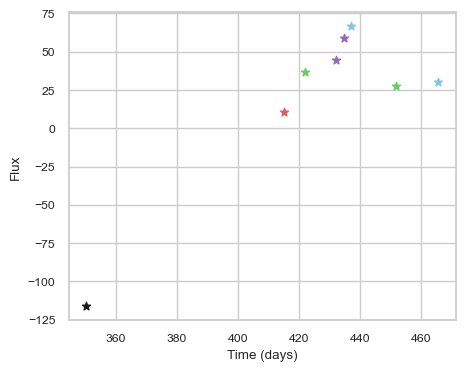

SNIax (3.9100404, False)
SNIax (3.8624477, False)
SNIax (4.23453, False)
SNIax (3.8599634, False)
SNIax (3.5766733, False)
SNIax (2.6322958, False)
SNIax (2.6827781, False)
SNIax (2.280257, False)
SNIax (2.8601453, False)
SNIax (2.4397697, False)
SNIax (3.3237367, False)
SNIax (2.581691, False)
SNIax (2.776101, False)
SNIax (2.2766433, False)
SNIax (2.4841182, False)
SNIax (2.017887, False)


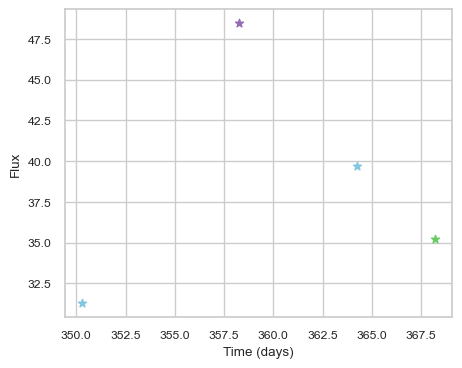

SNIax (4.020507, False)
SNIax (3.8396885, False)
SNIax (3.5422294, False)
SNIax (3.098296, False)
SNIax (2.919717, False)
SNIax (2.3438165, False)
SNIax (3.2025445, False)
SNIax (3.152235, False)


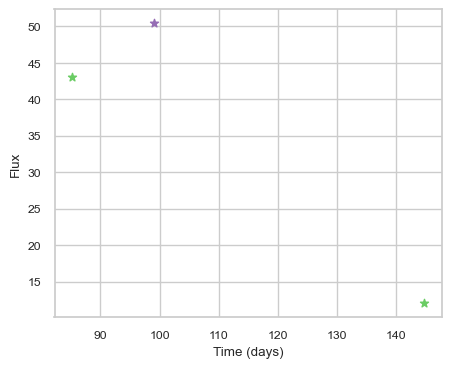

SNIax (3.9784148, False)
SNIax (3.8621829, False)
SNIax (3.6199453, False)
SNIax (4.458761, False)
SNIax (5.8400416, False)
SNIax (5.60636, False)


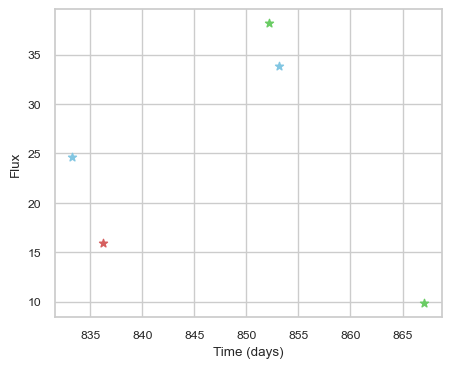

SNIax (3.843123, False)
SNIax (3.2163386, False)
SNIax (3.3619854, False)
SNIax (2.8490832, False)
SNIax (3.0581279, False)
SNIax (2.8350883, False)
SNIax (3.418752, False)
SNIax (3.2308612, False)
SNIax (3.3895957, False)
SNIax (3.4404154, False)


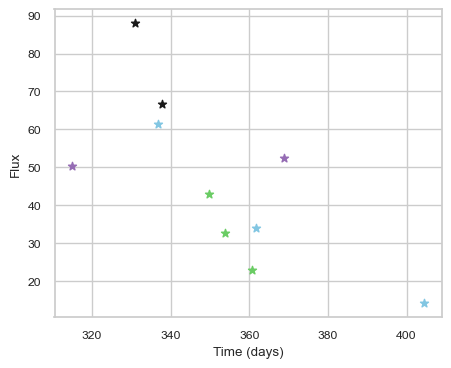

SNIax (4.1650467, False)
SNIax (4.108457, False)
SNIax (4.9683123, False)
SNIax (5.028043, False)
SNIax (5.34501, False)
SNIax (5.063185, False)
SNIax (4.98727, False)
SNIax (5.1890883, False)
SNIax (5.2679825, False)
SNIax (5.4873667, False)
SNIax (5.461607, False)
SNIax (5.2579875, False)
SNIax (5.2743955, False)
SNIax (5.355903, False)
SNIax (4.938008, False)
SNIax (5.2156787, False)
SNIax (5.024473, False)
SNIax (4.8397503, False)
SNIax (5.096376, False)
SNIax (4.99957, False)


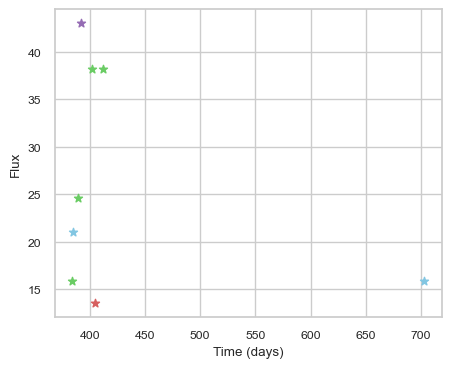

SNIax (3.9662433, False)
SNIax (3.326735, False)
SNIax (3.2698488, False)
SNIax (2.7768762, False)
SNIax (2.9245386, False)
SNIax (2.2660336, False)
SNIax (3.0119655, False)
SNIax (2.6644373, False)
SNIax (2.8470302, False)
SNIax (2.44736, False)
SNIax (2.9642446, False)
SNIax (2.0616522, False)
SNIax (2.7050915, False)
SNIax (2.5120893, False)
SNIax (3.028353, False)
SNIax (2.5201733, False)


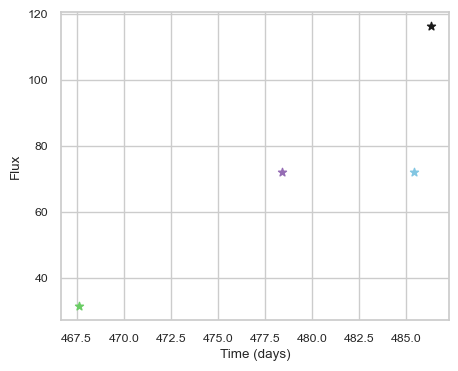

SNIax (4.0964565, False)
SNIax (3.6709337, False)
SNIax (3.7274637, False)
SNIax (4.4026003, False)
SNIax (4.2241654, False)
SNIax (4.3360133, False)
SNIax (4.680687, False)
SNIax (4.888852, False)


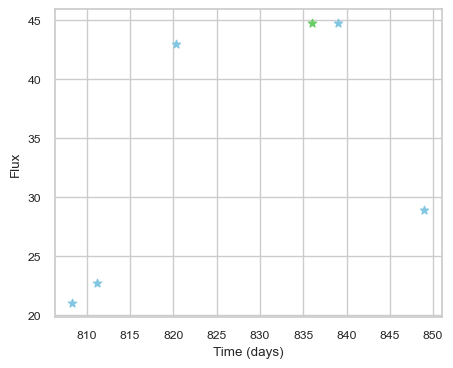

SNIax (3.9821804, False)
SNIax (3.395959, False)
SNIax (3.2423444, False)
SNIax (3.543378, False)
SNIax (2.9991024, False)
SNIax (3.2709324, False)
SNIax (3.0305424, False)
SNIax (3.262323, False)
SNIax (3.4131398, False)
SNIax (3.043993, False)
SNIax (2.8893054, False)
SNIax (2.785751, False)


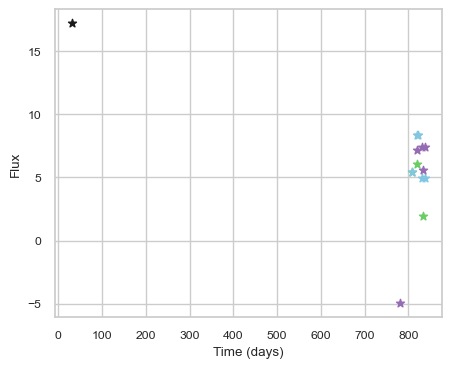

SNIax (4.4129915, False)
SNIax (4.8542933, False)
SNIax (4.046743, False)
SNIax (4.5611534, False)
SNIax (3.9930773, False)
SNIax (4.1306977, False)
SNIax (4.0950804, False)
SNIax (3.6416428, False)
SNIax (3.4241912, False)
SNIax (3.587011, False)
SNIax (3.3882651, False)
SNIax (3.3863275, False)
SNIax (3.743257, False)
SNIax (3.6286378, False)
SNIax (2.9045439, False)
SNIax (3.6861744, False)
SNIax (3.4838374, False)
SNIax (3.224178, False)
SNIax (3.2531614, False)
SNIax (3.005975, False)
SNIax (3.5292912, False)
SNIax (3.1664474, False)
SNIax (3.502097, False)
SNIax (2.9861226, False)
SNIax (3.4840333, False)


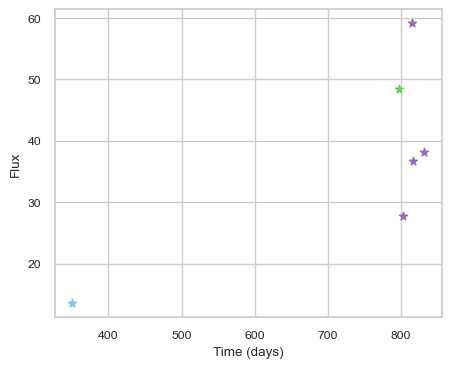

SNIax (3.792835, False)
SNIax (3.4915323, False)
SNIax (3.6925042, False)
SNIax (3.1891243, False)
SNIax (3.5749078, False)
SNIax (2.6935294, False)
SNIax (3.2694352, False)
SNIax (3.3683403, False)
SNIax (3.9956217, False)
SNIax (4.111581, False)
SNIax (4.7884326, False)
SNIax (5.0629244, False)


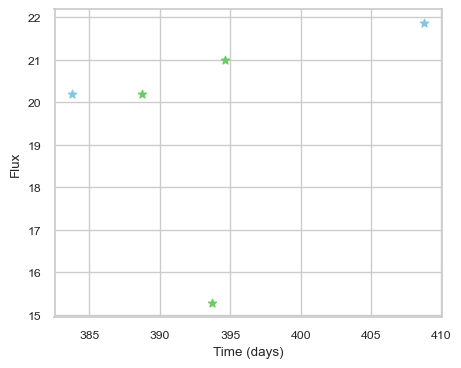

SNIax (4.2449512, False)
SNIax (3.6195154, False)
SNIax (3.3911629, False)
SNIax (2.7531283, False)
SNIax (2.8839576, False)
SNIax (2.5667229, False)
SNIax (2.8885539, False)
SNIax (2.5956862, False)
SNIax (2.5050845, False)
SNIax (2.6010816, False)


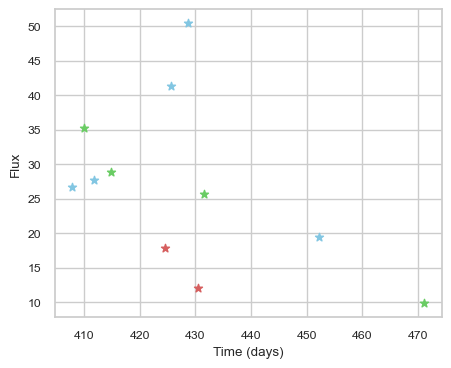

SNIax (3.9156573, False)
SNIax (3.5319064, False)
SNIax (3.5034807, False)
SNIax (3.0410914, False)
SNIax (3.4079773, False)
SNIax (4.110191, False)
SNIax (4.199597, False)
SNIax (4.399139, False)
SNIax (4.1874657, False)
SNIax (4.445737, False)
SNIax (4.4170465, False)
SNIax (3.8724215, False)
SNIax (4.285232, False)
SNIax (3.840382, False)
SNIax (4.349206, False)
SNIax (3.2640755, False)
SNIax (3.1966712, False)
SNIax (3.2132063, False)
SNIax (3.4130025, False)
SNIax (2.808342, False)
SNIax (3.2305837, False)
SNIax (2.9310722, False)


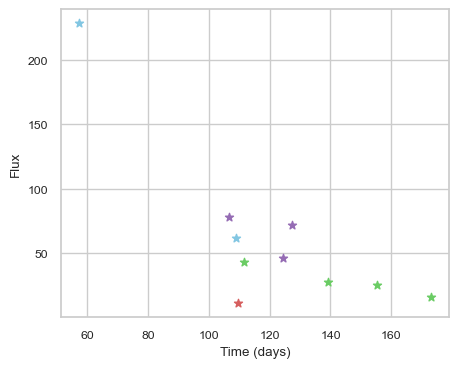

SNIax (3.938624, False)
SNIax (3.7766018, False)
SNIax (3.7329, False)
SNIax (3.720977, False)
SNIax (4.4832716, False)
SNIax (3.3199353, False)
SNIax (3.8591027, False)
SNIax (3.761142, False)
SNIax (3.76677, False)
SNIax (3.5132997, False)
SNIax (3.5440695, False)
SNIax (3.548498, False)
SNIax (3.8813875, False)
SNIax (3.522446, False)
SNIax (3.5678127, False)
SNIax (3.6242814, False)
SNIax (3.9973478, False)
SNIax (3.8499749, False)
SNIax (4.134786, False)
SNIax (4.0418386, False)


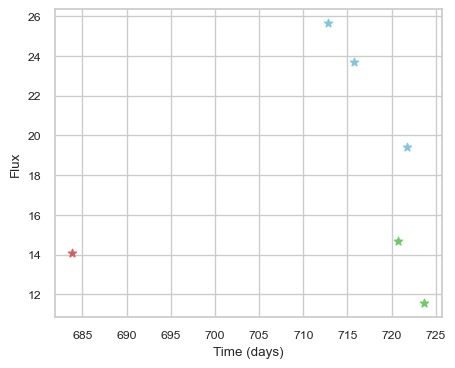

SNIax (3.8571668, False)
SNIax (4.4997506, False)
SNIax (3.9707382, False)
SNIax (3.631712, False)
SNIax (4.607787, False)
SNIax (4.384683, False)
SNIax (3.808009, False)
SNIax (4.15259, False)
SNIax (3.6619709, False)
SNIax (4.0316777, False)
SNIax (4.0051003, False)
SNIax (4.0095224, False)


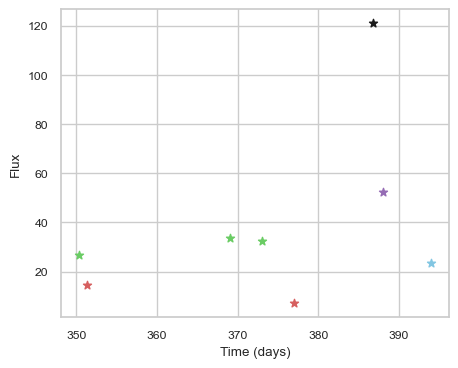

SNIax (4.1694026, False)
SNIax (3.4389153, False)
SNIax (3.3357434, False)
SNIax (3.2440865, False)
SNIax (2.818921, False)
SNIax (2.7159247, False)
SNIax (3.1588616, False)
SNIax (2.257027, False)
SNIax (2.9899018, False)
SNIax (2.4312186, False)
SNIax (2.7544248, False)
SNIax (2.628249, False)
SNIax (3.5888994, False)
SNIax (3.1981626, False)
SNIax (3.3271682, False)
SNIax (3.0277703, False)


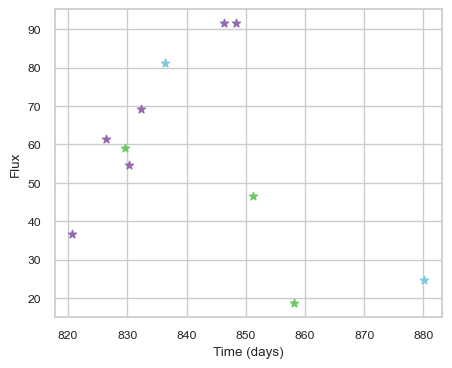

SNIax (3.833191, False)
SNIax (3.3727672, False)
SNIax (3.2287061, False)
SNIax (3.6560707, False)
SNIax (3.6147976, False)
SNIax (3.5332983, False)
SNIax (3.2889943, False)
SNIax (2.850803, False)
SNIax (3.466674, False)
SNIax (3.0594943, False)
SNIax (3.3991635, False)
SNIax (3.1821487, False)
SNIax (3.4317307, False)
SNIax (2.900032, False)
SNIax (3.679109, False)
SNIax (2.9679897, False)
SNIax (3.5579827, False)
SNIax (3.2643044, False)
SNIax (3.3911731, False)
SNIax (3.314035, False)
SNIax (2.9666295, False)
SNIax (3.2357333, False)


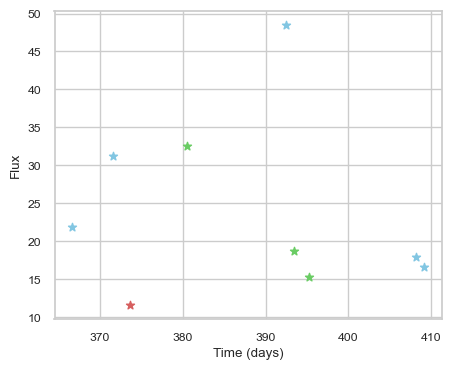

SNIax (4.405546, False)
SNIax (3.944911, False)
SNIax (3.6206892, False)
SNIax (3.7674806, False)
SNIax (3.1451201, False)
SNIax (3.411556, False)
SNIax (3.9241974, False)
SNIax (4.313071, False)
SNIax (3.7550926, False)
SNIax (4.099254, False)
SNIax (4.378048, False)
SNIax (3.83439, False)
SNIax (4.0640306, False)
SNIax (3.7447455, False)
SNIax (3.8408744, False)
SNIax (3.530573, False)
SNIax (3.5386198, False)
SNIax (3.4200747, False)


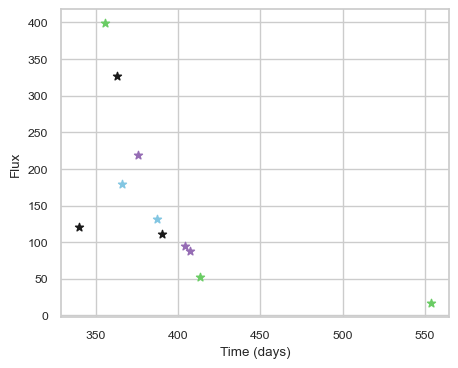

SNIax (3.7249541, False)
SNIax (3.6872811, False)
SNIax (3.6100807, False)
SNIax (3.2552779, False)
SNIax (3.7633789, False)
SNIax (4.039115, False)
SNIax (3.369292, False)
SNIax (3.8350534, False)
SNIax (3.6088092, False)
SNIax (3.3745406, False)
SNIax (3.720997, False)
SNIax (3.3934925, False)
SNIax (3.6009848, False)
SNIax (3.8648546, False)
SNIax (3.527587, False)
SNIax (3.4511259, False)
SNIax (4.0493755, False)
SNIax (3.3063157, False)
SNIax (3.223292, False)
SNIax (3.1137064, False)
SNIax (3.3381355, False)
SNIax (3.262114, False)


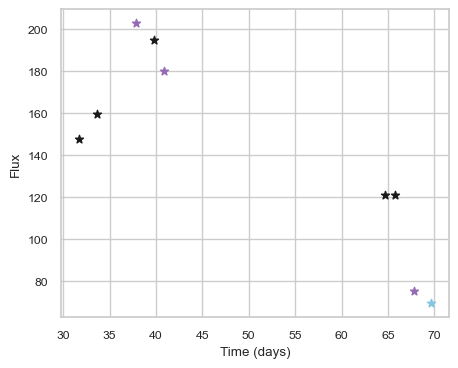

SNIax (3.86512, False)
SNIax (3.2877917, False)
SNIax (4.4338455, False)
SNIax (3.89413, False)
SNIax (4.3859806, False)
SNIax (3.4878554, False)
SNIax (5.2022133, False)
SNIax (4.6157303, False)
SNIax (4.40251, False)
SNIax (3.7983887, False)
SNIax (3.5716462, False)
SNIax (3.525984, False)
SNIax (3.9779751, False)
SNIax (3.5300357, False)
SNIax (3.8300626, False)
SNIax (3.4006302, False)
SNIax (3.96952, False)
SNIax (3.4620583, False)


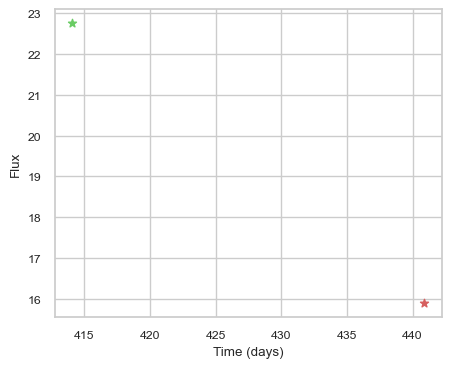

SNIax (3.9846203, False)
SNIax (3.5161722, False)
SNIax (3.2569892, False)
SNIax (3.6012645, False)


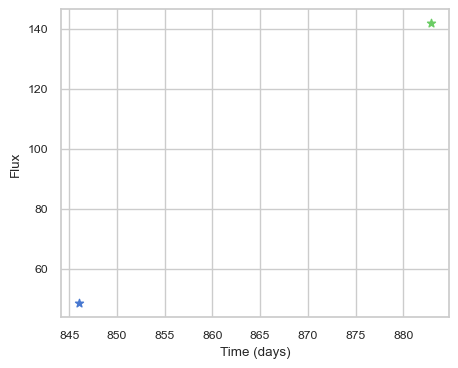

SNIax (3.7761075, False)
SNIax (4.9284797, False)
SNIax (4.5334473, False)
SNIax (3.7186148, False)


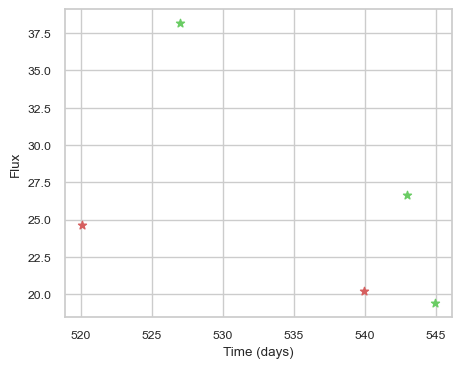

SNIax (3.8448684, False)
SNIax (4.3040905, False)
SNIax (3.9268749, False)
SNIax (2.900313, False)
SNIax (4.092275, False)
SNIax (4.0878057, False)
SNIax (4.366292, False)
SNIax (4.747548, False)
SNIax (4.8886657, False)
SNIax (4.8813157, False)


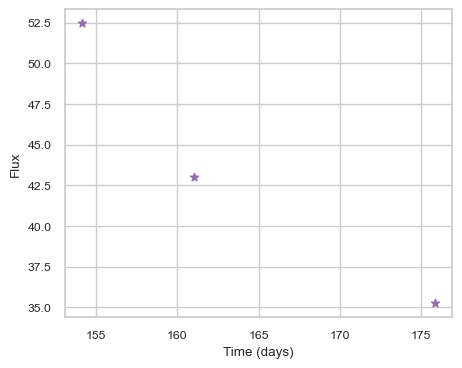

SNIax (3.8995113, False)
SNIax (4.1180406, False)
SNIax (4.128114, False)
SNIax (3.7969315, False)
SNIax (3.6076071, False)
SNIax (3.829221, False)


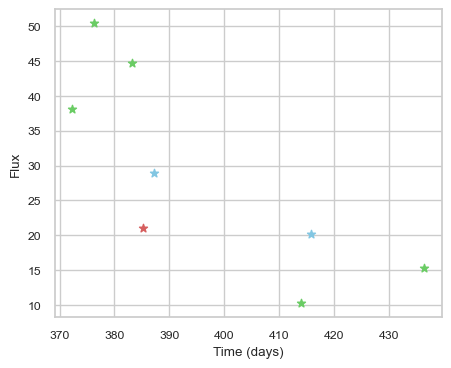

SNIax (3.610848, False)
SNIax (3.4524746, False)
SNIax (3.6240535, False)
SNIax (3.651901, False)
SNIax (3.6683607, False)
SNIax (4.4030323, False)
SNIax (4.1283436, False)
SNIax (3.8946407, False)
SNIax (3.7887838, False)
SNIax (2.9324653, False)
SNIax (3.5361018, False)
SNIax (4.260717, False)
SNIax (2.902499, False)
SNIax (3.0448427, False)
SNIax (2.679814, False)
SNIax (3.1555386, False)


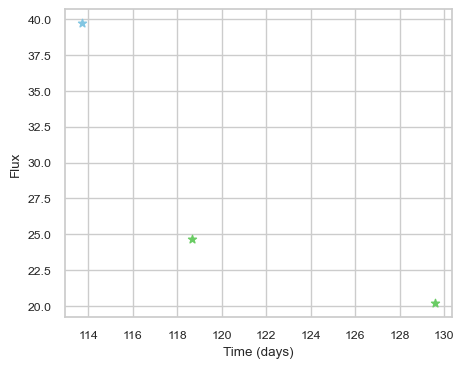

SNIax (4.8313155, False)
SNIax (5.867412, False)
SNIax (5.5193167, False)
SNIax (6.194673, False)
SNIax (5.240108, False)
SNIax (5.459765, False)


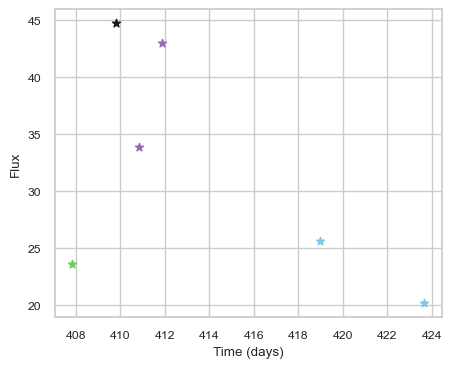

SNIax (4.069727, False)
SNIax (3.457032, False)
SNIax (3.774989, False)
SNIax (3.0457625, False)
SNIax (3.5117338, False)
SNIax (2.8059275, False)
SNIax (3.1394117, False)
SNIax (2.8569748, False)
SNIax (3.1761959, False)
SNIax (2.3457935, False)
SNIax (2.703184, False)
SNIax (2.47718, False)


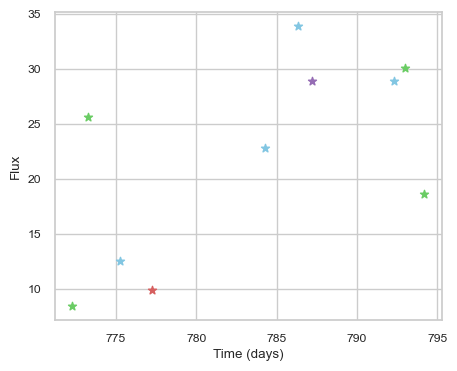

SNIax (4.085408, False)
SNIax (3.3780797, False)
SNIax (3.2599843, False)
SNIax (2.762752, False)
SNIax (3.2840729, False)
SNIax (3.0696194, False)
SNIax (3.3168097, False)
SNIax (3.4616249, False)
SNIax (2.7314634, False)
SNIax (2.4410267, False)
SNIax (2.7181249, False)
SNIax (2.806769, False)
SNIax (2.9819982, False)
SNIax (2.958051, False)
SNIax (2.4829593, False)
SNIax (3.0000787, False)
SNIax (2.5855284, False)
SNIax (2.5474405, False)
SNIax (3.1984577, False)
SNIax (2.7590508, False)


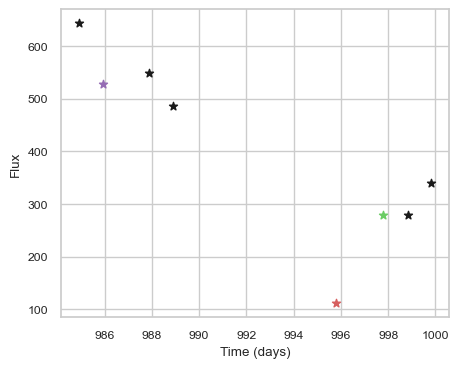

SNIax (3.6300962, False)
SNIax (3.8425174, False)
SNIax (2.972141, False)
SNIax (2.937672, False)
SNIax (3.0813, False)
SNIax (3.248292, False)
SNIax (3.5173256, False)
SNIax (3.1040618, False)
SNIax (3.3018494, False)
SNIax (3.6859238, False)
SNIax (3.2034166, False)
SNIax (2.9891613, False)
SNIax (2.8147001, False)
SNIax (2.8458812, False)
SNIax (3.16453, False)
SNIax (3.140977, False)


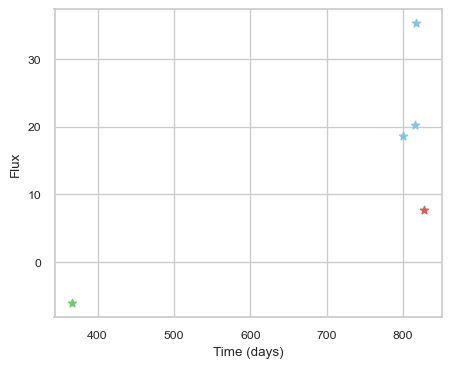

SNIax (4.838599, False)
SNIax (4.689294, False)
SNIax (4.713578, False)
SNIax (4.348925, False)
SNIax (4.77609, False)
SNIax (4.609223, False)
SNIax (4.0103636, False)
SNIax (4.857528, False)
SNIax (4.977093, False)
SNIax (4.854292, False)


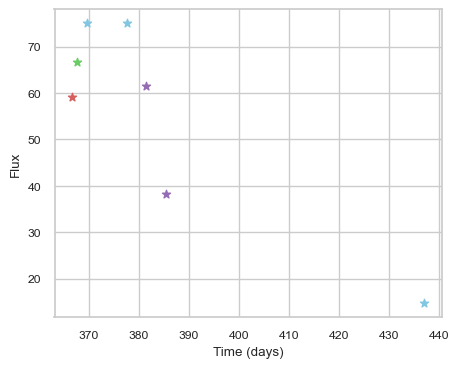

SNIax (3.7673397, False)
SNIax (4.522437, False)
SNIax (4.4920855, False)
SNIax (3.5974565, False)
SNIax (3.7779434, False)
SNIax (3.561312, False)
SNIax (3.983127, False)
SNIax (4.555688, False)
SNIax (5.3661404, False)
SNIax (5.150222, False)
SNIax (5.2873497, False)
SNIax (5.0532002, False)
SNIax (4.7200236, False)
SNIax (3.6730604, False)


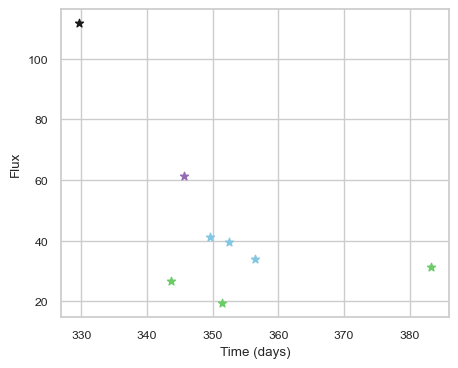

SNIax (3.8216712, False)
SNIax (3.857554, False)
SNIax (4.603085, False)
SNIax (3.7580965, False)
SNIax (3.7923894, False)
SNIax (3.6574442, False)
SNIax (4.3310432, False)
SNIax (3.9606564, False)
SNIax (4.004755, False)
SNIax (3.884956, False)
SNIax (3.9644196, False)
SNIax (4.110224, False)
SNIax (4.462091, False)
SNIax (3.77337, False)
SNIax (4.2015324, False)
SNIax (4.5601573, False)


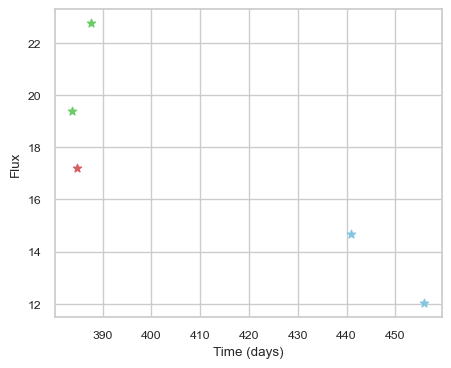

SNIax (3.8034494, False)
SNIax (3.497165, False)
SNIax (3.3696508, False)
SNIax (3.5608306, False)
SNIax (3.5402675, False)
SNIax (3.164055, False)
SNIax (3.8837771, False)
SNIax (4.093264, False)
SNIax (4.5305686, False)
SNIax (3.9227798, False)


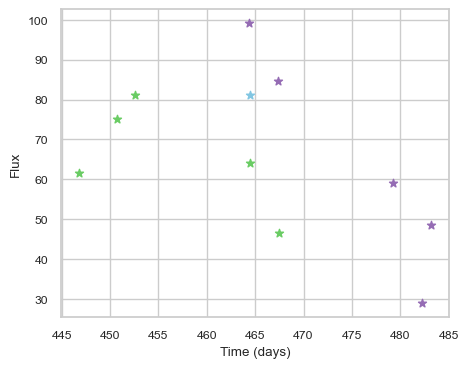

SNIax (3.7944815, False)
SNIax (4.1513877, False)
SNIax (4.001261, False)
SNIax (4.0019436, False)
SNIax (3.5177639, False)
SNIax (3.7452548, False)
SNIax (3.018856, False)
SNIax (2.862229, False)
SNIax (3.169679, False)
SNIax (2.9085371, False)
SNIax (3.2406619, False)
SNIax (2.727584, False)
SNIax (3.2533562, False)
SNIax (2.6375089, False)
SNIax (2.6917636, False)
SNIax (2.4158204, False)
SNIax (3.1716597, False)
SNIax (2.8386161, False)
SNIax (2.8547416, False)
SNIax (2.6171572, False)
SNIax (2.778278, False)
SNIax (2.5592897, False)


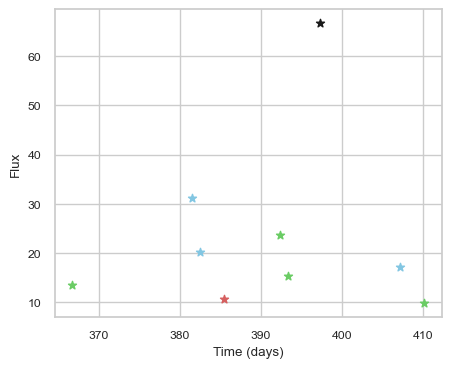

SNIax (4.167982, False)
SNIax (3.3469596, False)
SNIax (3.1911385, False)
SNIax (2.8668823, False)
SNIax (2.7679892, False)
SNIax (2.5957234, False)
SNIax (2.8792632, False)
SNIax (2.3047547, False)
SNIax (2.5926225, False)
SNIax (2.3432188, False)
SNIax (2.6168222, False)
SNIax (2.4596722, False)
SNIax (3.1018214, False)
SNIax (3.0659006, False)
SNIax (2.987485, False)
SNIax (3.2122185, False)
SNIax (2.7879555, False)
SNIax (3.208362, False)


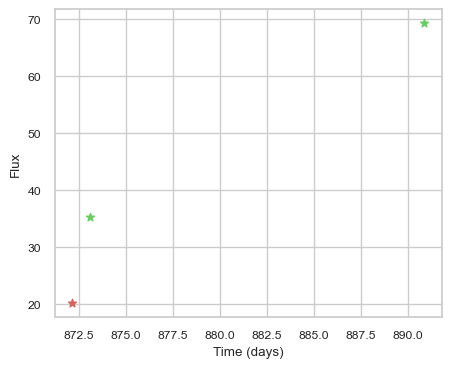

SNIax (3.756561, False)
SNIax (4.1104646, False)
SNIax (3.84354, False)
SNIax (3.0149083, False)
SNIax (3.3462179, False)
SNIax (3.4573278, False)


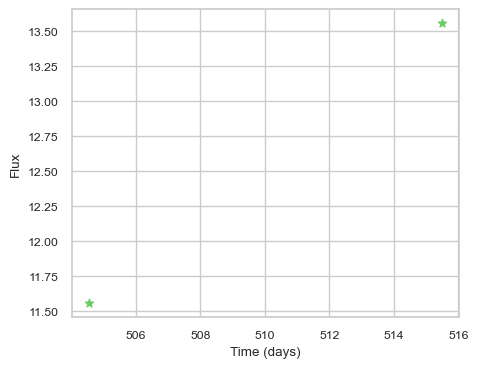

SNIax (4.246804, False)
SNIax (3.5610182, False)
SNIax (3.4906416, False)
SNIax (3.377572, False)


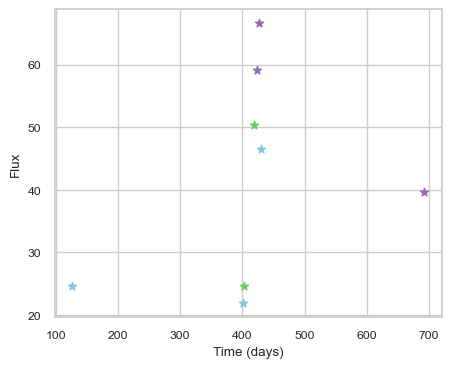

SNIax (3.9936228, False)
SNIax (3.8409946, False)
SNIax (3.7866645, False)
SNIax (3.559524, False)
SNIax (3.1775765, False)
SNIax (2.7935736, False)
SNIax (3.0383813, False)
SNIax (3.4712775, False)
SNIax (3.2676353, False)
SNIax (2.3774164, False)
SNIax (3.2552984, False)
SNIax (2.6671185, False)
SNIax (3.8448548, False)
SNIax (2.9555423, False)
SNIax (3.553106, False)
SNIax (3.7932577, False)


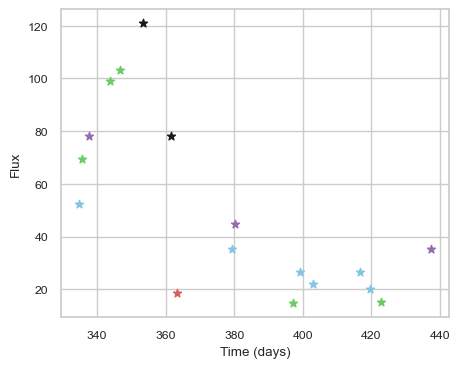

SNIax (4.0911045, False)
SNIax (4.3854446, False)
SNIax (4.3940926, False)
SNIax (5.1957684, False)
SNIax (5.2948256, False)
SNIax (5.2254763, False)
SNIax (5.5489855, False)
SNIax (5.5237393, False)
SNIax (5.404227, False)
SNIax (5.77657, False)
SNIax (5.6758575, False)
SNIax (5.938839, False)
SNIax (5.058606, False)
SNIax (5.343672, False)
SNIax (5.2713337, False)
SNIax (5.6983213, False)
SNIax (6.112793, False)
SNIax (5.6626062, False)
SNIax (5.1087418, False)
SNIax (5.584815, False)
SNIax (5.539624, False)
SNIax (5.575068, False)
SNIax (4.8514514, False)
SNIax (5.496062, False)
SNIax (5.1589103, False)
SNIax (5.1430984, False)
SNIax (4.8258786, False)
SNIax (5.27799, False)
SNIax (5.326877, False)
SNIax (4.93775, False)
SNIax (4.7829413, False)
SNIax (4.8991766, False)
SNIax (4.3701425, False)
SNIax (4.918496, False)


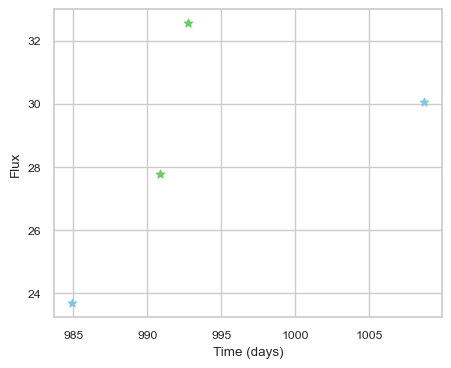

SNIax (4.0958023, False)
SNIax (3.836924, False)
SNIax (3.4303222, False)
SNIax (3.2130845, False)
SNIax (3.2340593, False)
SNIax (2.753529, False)
SNIax (3.0343008, False)
SNIax (2.2317502, False)


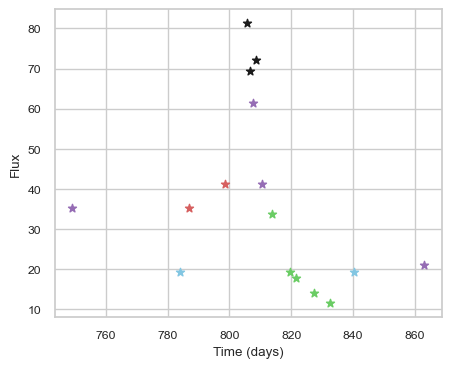

SNIax (3.8256278, False)
SNIax (3.3164048, False)
SNIax (3.623959, False)
SNIax (3.6616168, False)
SNIax (3.317362, False)
SNIax (3.9200587, False)
SNIax (3.5041926, False)
SNIax (3.5118315, False)
SNIax (3.9237263, False)
SNIax (4.1697364, False)
SNIax (4.174212, False)
SNIax (3.795245, False)
SNIax (4.1288466, False)
SNIax (3.2538636, False)
SNIax (4.2681866, False)
SNIax (3.7320566, False)
SNIax (4.151922, False)
SNIax (4.1094174, False)
SNIax (3.711947, False)
SNIax (3.9153697, False)
SNIax (4.7584305, False)
SNIax (4.428346, False)
SNIax (3.4357657, False)
SNIax (3.8932815, False)
SNIax (3.6997495, False)
SNIax (3.659716, False)
SNIax (3.2822664, False)
SNIax (3.1266823, False)
SNIax (3.2720506, False)
SNIax (2.9213607, False)
SNIax (3.526898, False)
SNIax (3.8792593, False)


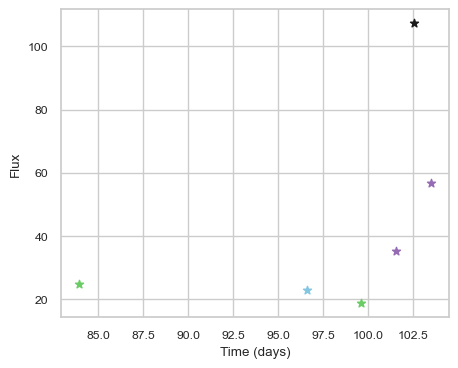

SNIax (3.9451485, False)
SNIax (3.5061853, False)
SNIax (3.3520672, False)
SNIax (4.114693, False)
SNIax (4.2553306, False)
SNIax (5.0875416, False)
SNIax (4.6120977, False)
SNIax (5.0134907, False)
SNIax (4.9742737, False)
SNIax (4.591055, False)
SNIax (5.2449856, False)
SNIax (5.1011515, False)


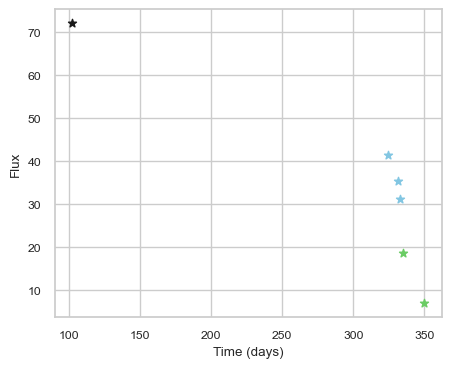

SNIax (4.229719, False)
SNIax (4.366845, False)
SNIax (4.2901635, False)
SNIax (4.220808, False)
SNIax (4.0171328, False)
SNIax (3.0241938, False)
SNIax (3.135395, False)
SNIax (2.840031, False)
SNIax (3.296455, False)
SNIax (3.552822, False)
SNIax (3.2770693, False)
SNIax (3.32509, False)


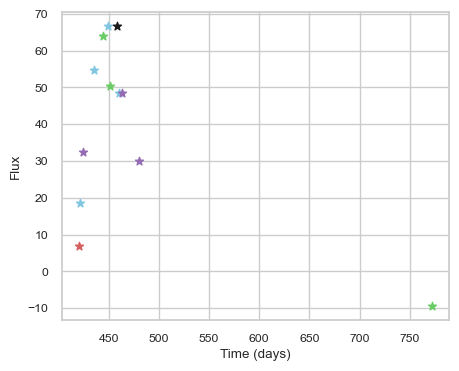

SNIax (4.22956, False)
SNIax (4.076246, False)
SNIax (3.570713, False)
SNIax (3.0899394, False)
SNIax (3.2869592, False)
SNIax (2.882429, False)
SNIax (3.1442304, False)
SNIax (3.84364, False)
SNIax (4.2388105, False)
SNIax (4.3342996, False)
SNIax (5.0274205, False)
SNIax (4.351422, False)
SNIax (5.076616, False)
SNIax (4.5178714, False)
SNIax (4.9395976, False)
SNIax (4.736178, False)
SNIax (5.4516344, False)
SNIax (4.88088, False)
SNIax (4.7509227, False)
SNIax (4.4518414, False)
SNIax (4.5947247, False)
SNIax (4.605663, False)
SNIax (4.658832, False)
SNIax (4.151209, False)


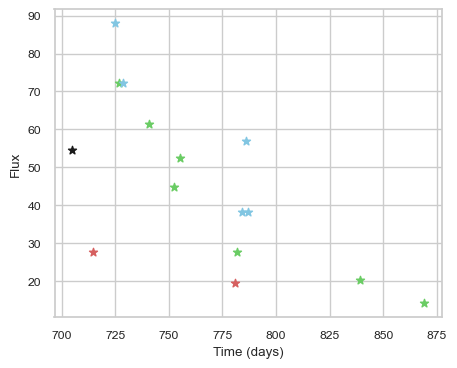

SNIax (4.1143074, False)
SNIax (3.9903321, False)
SNIax (3.293278, False)
SNIax (3.9233851, False)
SNIax (3.6134424, False)
SNIax (3.3972602, False)
SNIax (4.412407, False)
SNIax (4.4434156, False)
SNIax (3.9160113, False)
SNIax (3.7492983, False)
SNIax (2.8427753, False)
SNIax (3.6412613, False)
SNIax (3.497475, False)
SNIax (3.7706707, False)
SNIax (3.9110029, False)
SNIax (3.9230034, False)
SNIax (3.8584986, False)
SNIax (4.02361, False)
SNIax (4.0058017, False)
SNIax (3.8085601, False)
SNIax (3.7651582, False)
SNIax (3.4211915, False)
SNIax (3.380146, False)
SNIax (3.5936842, False)
SNIax (4.28078, False)
SNIax (4.2131124, False)
SNIax (4.685638, False)
SNIax (4.4684362, False)
SNIax (4.2343144, False)
SNIax (4.3595505, False)


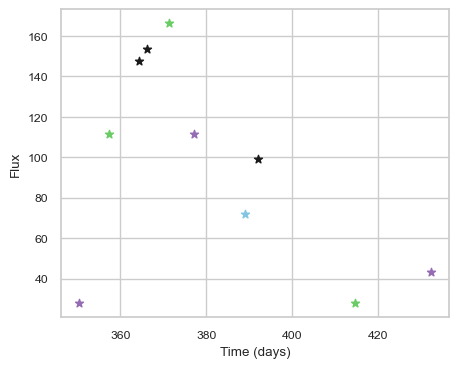

SNIax (3.6848748, False)
SNIax (3.6238575, False)
SNIax (3.129084, False)
SNIax (3.0920625, False)
SNIax (3.628616, False)
SNIax (3.324469, False)
SNIax (3.5224226, False)
SNIax (3.4439106, False)
SNIax (3.1252983, False)
SNIax (2.6744149, False)
SNIax (2.8589346, False)
SNIax (2.7122173, False)
SNIax (2.4614134, False)
SNIax (2.1650887, False)
SNIax (2.7867148, False)
SNIax (2.320225, False)
SNIax (2.4457605, False)
SNIax (2.286273, False)
SNIax (2.4937437, False)
SNIax (2.162785, False)


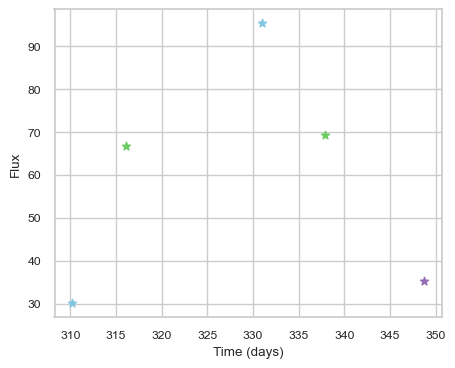

SNIax (3.7730677, False)
SNIax (4.1046333, False)
SNIax (3.6164963, False)
SNIax (3.4956, False)
SNIax (3.2880783, False)
SNIax (3.6173356, False)
SNIax (3.7041469, False)
SNIax (3.944127, False)
SNIax (4.069059, False)
SNIax (4.0289574, False)


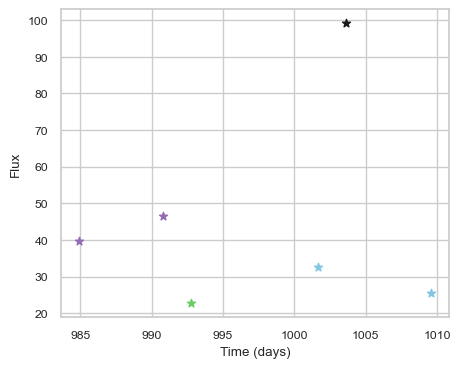

SNIax (4.2873235, False)
SNIax (3.9420784, False)
SNIax (4.1752925, False)
SNIax (4.1689706, False)
SNIax (4.6664133, False)
SNIax (4.5999727, False)
SNIax (4.0538487, False)
SNIax (4.4334564, False)
SNIax (3.5448499, False)
SNIax (4.1833763, False)
SNIax (3.4602213, False)
SNIax (3.539457, False)


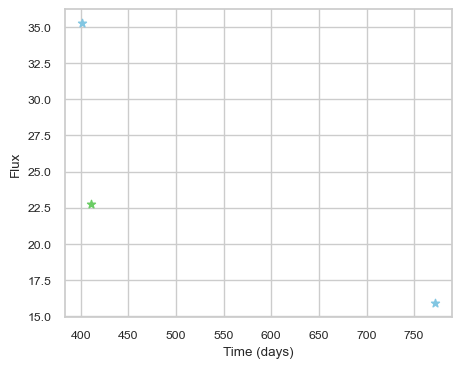

SNIax (4.3797026, False)
SNIax (3.8679032, False)
SNIax (4.355422, False)
SNIax (3.465178, False)
SNIax (4.2692037, False)
SNIax (3.4646478, False)


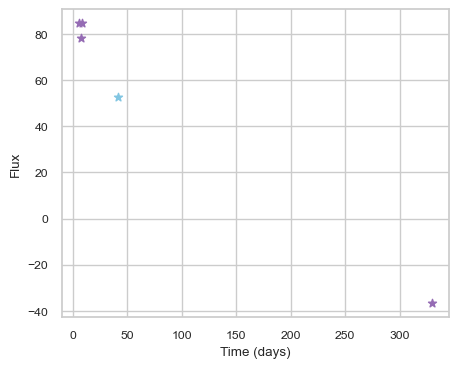

SNIax (4.200732, False)
SNIax (4.88304, False)
SNIax (4.843575, False)
SNIax (5.200888, False)
SNIax (4.786324, False)
SNIax (4.750507, False)
SNIax (4.5368524, False)
SNIax (4.447153, False)
SNIax (4.4732995, False)
SNIax (5.1194096, False)


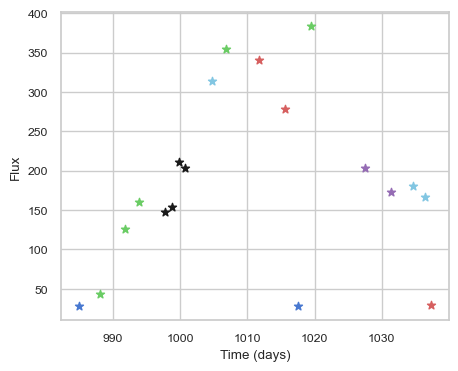

SNIax (3.7748795, False)
SNIax (4.889743, False)
SNIax (4.0360436, False)
SNIax (3.918364, False)
SNIax (4.321352, False)
SNIax (3.9556036, False)
SNIax (3.768674, False)
SNIax (3.3670099, False)
SNIax (3.518481, False)
SNIax (3.331489, False)
SNIax (3.593864, False)
SNIax (3.1853924, False)
SNIax (3.785685, False)
SNIax (3.1241336, False)
SNIax (4.0612583, False)
SNIax (3.0760279, False)
SNIax (3.829299, False)
SNIax (2.6184971, False)
SNIax (2.6421719, False)
SNIax (2.6223872, False)
SNIax (2.692848, False)
SNIax (2.1023543, False)
SNIax (2.7944734, False)
SNIax (2.7310615, False)
SNIax (2.6425574, False)
SNIax (3.047505, False)
SNIax (3.002352, False)
SNIax (2.0945225, False)
SNIax (2.785076, False)
SNIax (2.6878672, False)
SNIax (2.8690658, False)
SNIax (2.2949324, False)
SNIax (2.8819513, False)
SNIax (2.1982052, False)
SNIax (2.1288495, False)
SNIax (2.0092638, False)
SNIax (2.3025699, False)
SNIax (2.233771, False)


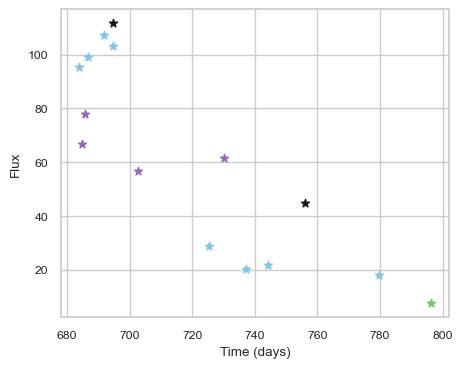

SNIax (4.436894, False)
SNIax (5.067526, False)
SNIax (5.3268933, False)
SNIax (5.737425, False)
SNIax (5.5100856, False)
SNIax (5.676248, False)
SNIax (5.452946, False)
SNIax (5.7230725, False)
SNIax (5.4004025, False)
SNIax (5.5399685, False)
SNIax (5.3607264, False)
SNIax (5.341497, False)
SNIax (5.0906234, False)
SNIax (5.8223886, False)
SNIax (4.793646, False)
SNIax (4.9610295, False)
SNIax (4.5667, False)
SNIax (4.8819213, False)
SNIax (4.1946716, False)
SNIax (4.7181706, False)
SNIax (4.1305475, False)
SNIax (4.7672644, False)
SNIax (3.983377, False)
SNIax (4.944106, False)
SNIax (4.204932, False)
SNIax (5.269082, False)
SNIax (4.7588863, False)
SNIax (5.1756635, False)
SNIax (4.479333, False)
SNIax (4.897263, False)


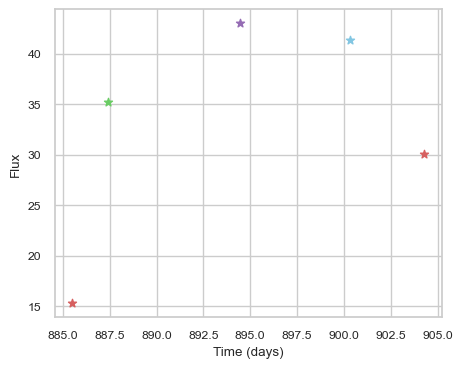

SNIax (3.5322611, False)
SNIax (4.010707, False)
SNIax (3.1961806, False)
SNIax (3.6840653, False)
SNIax (3.2217746, False)
SNIax (3.069815, False)
SNIax (2.5758655, False)
SNIax (2.785822, False)
SNIax (3.0925906, False)
SNIax (3.2128294, False)


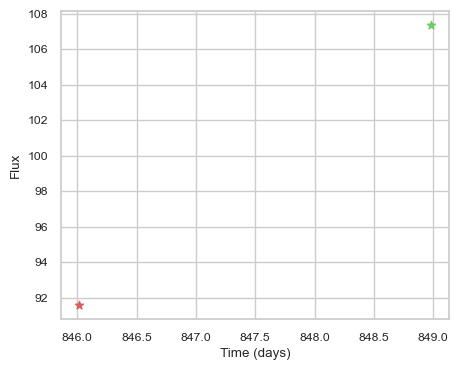

SNIax (3.6988914, False)
SNIax (4.4378705, False)
SNIax (3.6419132, False)
SNIax (3.8878546, False)


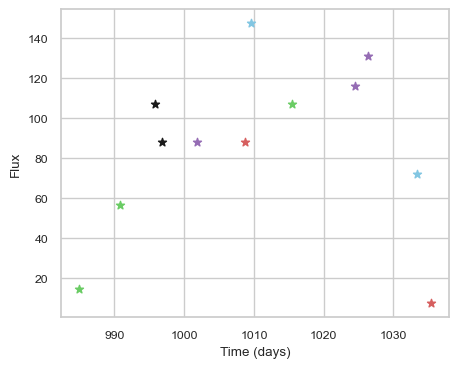

SNIax (3.731781, False)
SNIax (3.839259, False)
SNIax (3.232034, False)
SNIax (3.5826283, False)
SNIax (4.390266, False)
SNIax (4.3200455, False)
SNIax (4.620743, False)
SNIax (3.8559024, False)
SNIax (3.8046806, False)
SNIax (2.4451978, False)
SNIax (2.9064162, False)
SNIax (2.9052052, False)
SNIax (3.559349, False)
SNIax (3.0049887, False)
SNIax (3.905567, False)
SNIax (3.7159026, False)
SNIax (3.5920482, False)
SNIax (3.4258945, False)
SNIax (4.7603855, False)
SNIax (3.9610944, False)
SNIax (3.1694183, False)
SNIax (3.384237, False)
SNIax (3.4234593, False)
SNIax (3.8870044, False)


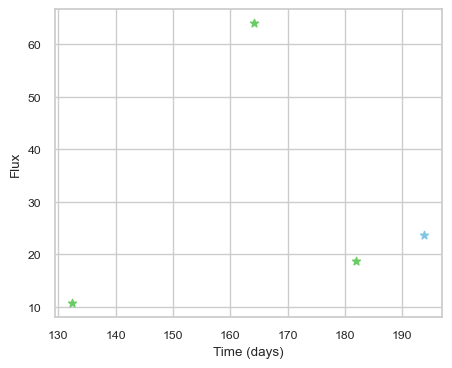

SNIax (3.8711593, False)
SNIax (3.7625222, False)
SNIax (3.29914, False)
SNIax (3.8952265, False)
SNIax (3.7223604, False)
SNIax (3.0170987, False)
SNIax (3.1243112, False)
SNIax (2.6943705, False)


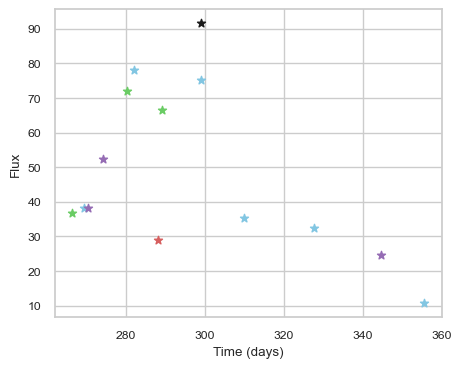

SNIax (3.653729, False)
SNIax (3.914887, False)
SNIax (3.5631082, False)
SNIax (3.749469, False)
SNIax (3.815688, False)
SNIax (4.900702, False)
SNIax (4.4804773, False)
SNIax (4.446, False)
SNIax (3.390089, False)
SNIax (2.5194633, False)
SNIax (2.979343, False)
SNIax (3.299136, False)
SNIax (4.23958, False)
SNIax (2.9883533, False)
SNIax (3.8689573, False)
SNIax (2.9416916, False)
SNIax (3.6439958, False)
SNIax (3.0255399, False)
SNIax (3.885865, False)
SNIax (3.3956575, False)
SNIax (3.9114268, False)
SNIax (3.5938609, False)
SNIax (3.827931, False)
SNIax (3.5245576, False)
SNIax (3.8297498, False)
SNIax (3.792511, False)
SNIax (3.992961, False)
SNIax (3.7194204, False)


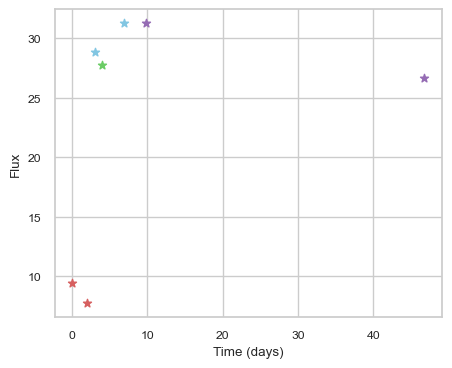

SNIax (4.353461, False)
SNIax (3.6406708, False)
SNIax (4.5493093, False)
SNIax (4.249669, False)
SNIax (4.121638, False)
SNIax (3.8246012, False)
SNIax (4.096752, False)
SNIax (4.878696, False)
SNIax (3.766971, False)
SNIax (3.7646208, False)
SNIax (3.6289065, False)
SNIax (3.9654903, False)
SNIax (3.5336351, False)


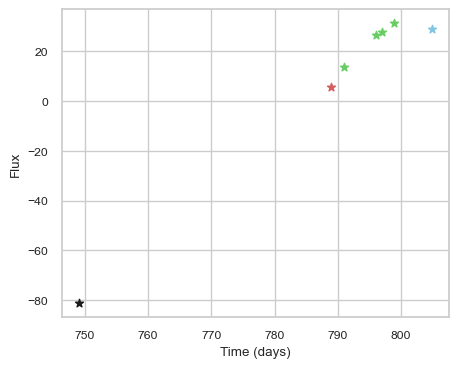

SNIax (3.8141506, False)
SNIax (3.7409856, False)
SNIax (3.8191042, False)
SNIax (3.7247424, False)
SNIax (2.9275417, False)
SNIax (3.0709474, False)
SNIax (3.0562012, False)
SNIax (2.8284388, False)
SNIax (2.9069865, False)
SNIax (2.8350856, False)
SNIax (3.0951293, False)
SNIax (2.6461227, False)
SNIax (2.8931782, False)
SNIax (2.530006, False)


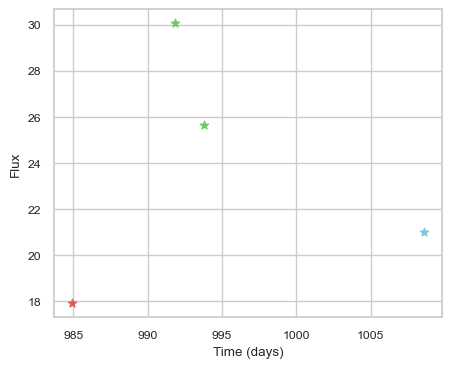

SNIax (3.9021811, False)
SNIax (4.629199, False)
SNIax (3.8914046, False)
SNIax (3.0969932, False)
SNIax (4.582992, False)
SNIax (4.444499, False)
SNIax (4.216367, False)
SNIax (4.7112155, False)


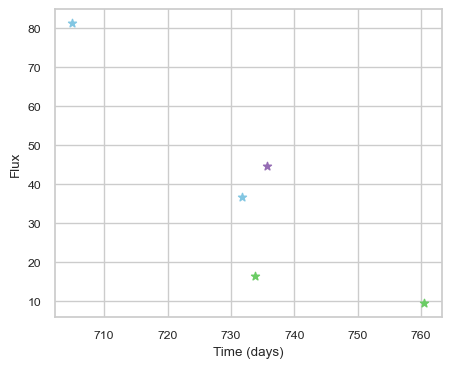

SNIax (3.858209, False)
SNIax (4.5683494, False)
SNIax (4.787571, False)
SNIax (4.078823, False)
SNIax (3.6127956, False)
SNIax (3.4401228, False)
SNIax (4.2378974, False)
SNIax (3.5539353, False)
SNIax (4.0149674, False)
SNIax (3.278832, False)


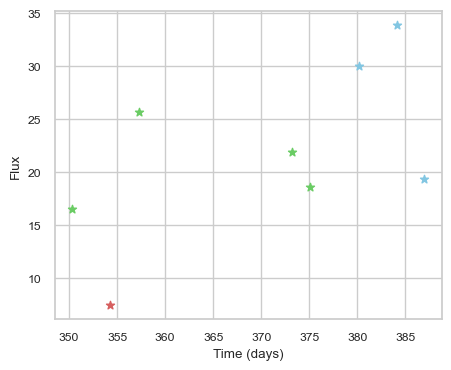

SNIax (4.2558303, False)
SNIax (3.50098, False)
SNIax (3.54358, False)
SNIax (3.1793728, False)
SNIax (2.8985152, False)
SNIax (2.6642244, False)
SNIax (3.446817, False)
SNIax (2.6155665, False)
SNIax (3.1114016, False)
SNIax (2.5249732, False)
SNIax (2.7095604, False)
SNIax (1.9981672, False)
SNIax (2.4047637, False)
SNIax (2.2633803, False)
SNIax (2.754647, False)
SNIax (2.2018058, False)


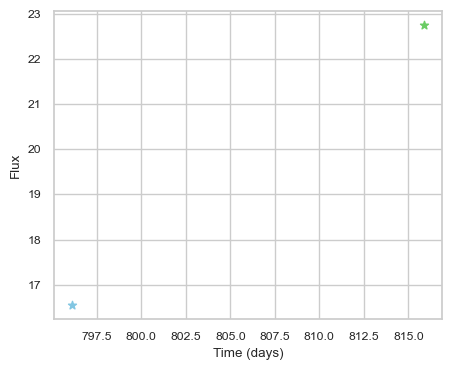

SNIax (4.003536, False)
SNIax (3.4760437, False)
SNIax (3.209374, False)
SNIax (3.1891818, False)


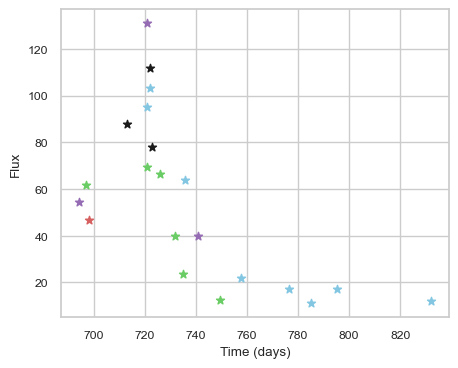

SNIax (3.8448079, False)
SNIax (3.575702, False)
SNIax (3.768491, False)
SNIax (4.6011424, False)
SNIax (4.4653296, False)
SNIax (5.0916643, False)
SNIax (4.4333158, False)
SNIax (4.1496058, False)
SNIax (4.231161, False)
SNIax (4.514259, False)
SNIax (5.4538875, False)
SNIax (5.330189, False)
SNIax (5.465739, False)
SNIax (4.7273283, False)
SNIax (3.9934256, False)
SNIax (4.116705, False)
SNIax (4.1511364, False)
SNIax (4.423685, False)
SNIax (3.7781503, False)
SNIax (4.1155467, False)
SNIax (3.654009, False)
SNIax (3.919727, False)
SNIax (3.3918438, False)
SNIax (3.656497, False)
SNIax (3.9041326, False)
SNIax (3.5106366, False)
SNIax (3.680196, False)
SNIax (3.7095978, False)
SNIax (4.013088, False)
SNIax (3.4142852, False)
SNIax (3.5300353, False)
SNIax (3.1795285, False)
SNIax (3.1088095, False)
SNIax (3.2365766, False)
SNIax (3.5446212, False)
SNIax (3.0585668, False)
SNIax (3.2508047, False)
SNIax (2.9538844, False)
SNIax (3.15502, False)
SNIax (3.130826, False)
SNIax (3.2745485

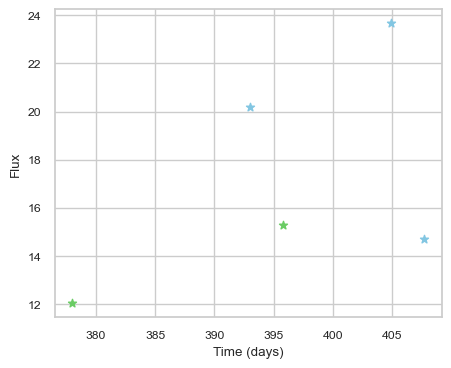

SNIax (4.6102366, False)
SNIax (3.5304232, False)
SNIax (3.579147, False)
SNIax (3.1693234, False)
SNIax (3.40354, False)
SNIax (3.0089607, False)
SNIax (2.9160724, False)
SNIax (2.9203947, False)
SNIax (3.050461, False)
SNIax (3.2584753, False)


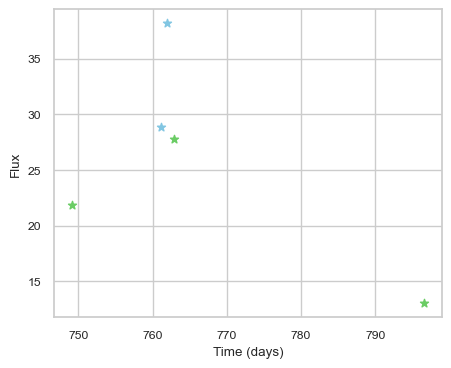

SNIax (3.864942, False)
SNIax (3.3059983, False)
SNIax (3.233599, False)
SNIax (3.446446, False)
SNIax (3.7188587, False)
SNIax (4.1983304, False)
SNIax (3.8850884, False)
SNIax (3.8558903, False)
SNIax (4.492755, False)
SNIax (4.7053905, False)


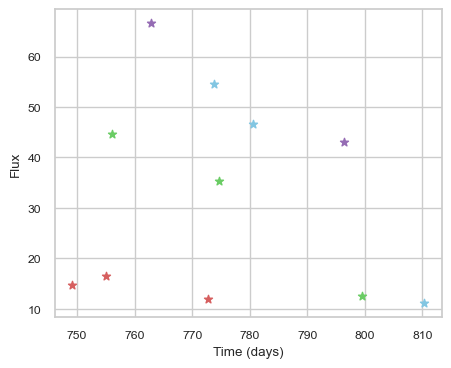

SNIax (4.016859, False)
SNIax (4.2310743, False)
SNIax (3.8609674, False)
SNIax (3.786047, False)
SNIax (3.6653488, False)
SNIax (2.8917248, False)
SNIax (4.1654773, False)
SNIax (4.080161, False)
SNIax (4.8506794, False)
SNIax (4.839113, False)
SNIax (5.2128596, False)
SNIax (4.6717825, False)
SNIax (4.8383427, False)
SNIax (4.7309184, False)
SNIax (5.051088, False)
SNIax (4.5252934, False)
SNIax (4.5206184, False)
SNIax (4.355074, False)
SNIax (4.75104, False)
SNIax (4.134488, False)
SNIax (3.975028, False)
SNIax (3.941781, False)


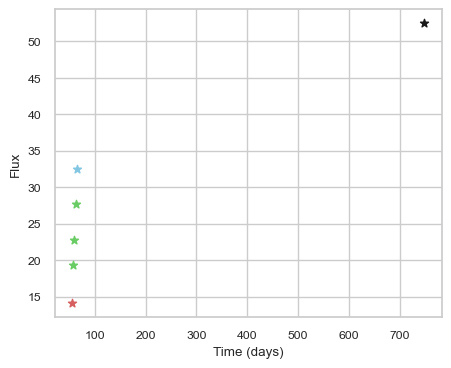

SNIax (3.9298105, False)
SNIax (3.718805, False)
SNIax (3.4111743, False)
SNIax (4.1760807, False)
SNIax (3.5358071, False)
SNIax (3.3422418, False)
SNIax (3.5789256, False)
SNIax (3.2223625, False)
SNIax (3.594127, False)
SNIax (4.0777035, False)
SNIax (3.3968048, False)
SNIax (4.3262596, False)


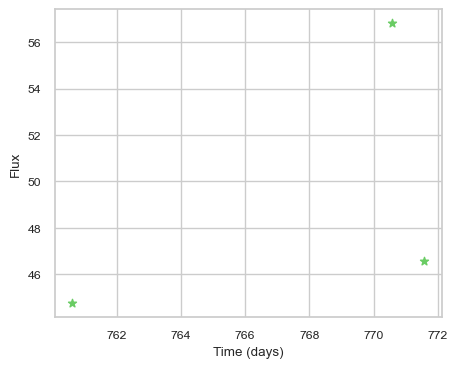

SNIax (3.864066, False)
SNIax (2.9762874, False)
SNIax (3.0211442, False)
SNIax (2.7026212, False)
SNIax (2.630697, False)
SNIax (3.046761, False)


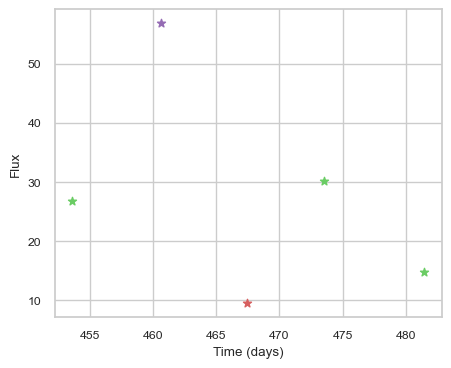

SNIax (4.419586, False)
SNIax (3.609674, False)
SNIax (3.8447936, False)
SNIax (4.151536, False)
SNIax (4.4120817, False)
SNIax (4.040491, False)
SNIax (3.8142898, False)
SNIax (3.8466327, False)
SNIax (3.7551806, False)
SNIax (3.3906975, False)


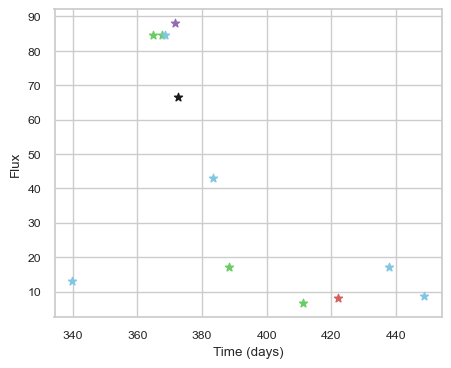

SNIax (4.242415, False)
SNIax (3.766391, False)
SNIax (3.1655486, False)
SNIax (4.6787753, False)
SNIax (5.5157957, False)
SNIax (5.6276255, False)
SNIax (5.573655, False)
SNIax (5.733301, False)
SNIax (5.9478755, False)
SNIax (5.820989, False)
SNIax (6.085625, False)
SNIax (5.823453, False)
SNIax (4.9297595, False)
SNIax (4.9588704, False)
SNIax (4.602044, False)
SNIax (4.675566, False)
SNIax (5.451634, False)
SNIax (4.970574, False)
SNIax (5.155947, False)
SNIax (5.2497063, False)
SNIax (5.6950555, False)
SNIax (4.855146, False)
SNIax (5.1287856, False)
SNIax (5.1329207, False)


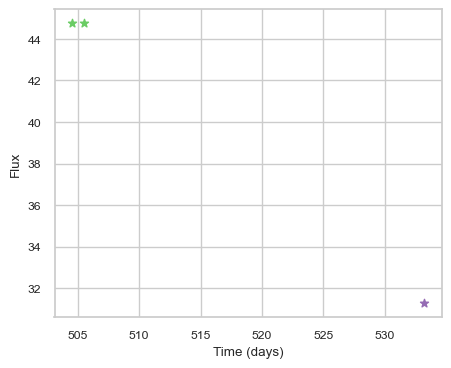

SNIax (4.154417, False)
SNIax (4.4758606, False)
SNIax (3.9979112, False)
SNIax (4.301297, False)
SNIax (4.6898866, False)
SNIax (4.9236255, False)


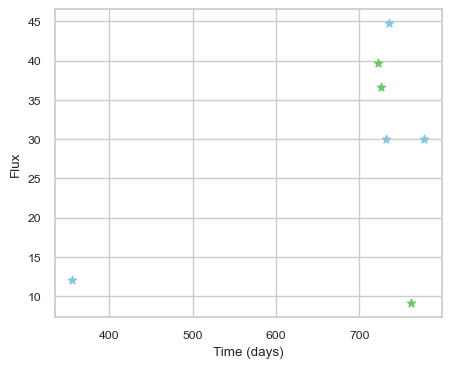

SNIax (3.8451838, False)
SNIax (3.5239072, False)
SNIax (3.7358735, False)
SNIax (2.9069562, False)
SNIax (2.9838316, False)
SNIax (2.2764592, False)
SNIax (3.3633273, False)
SNIax (2.9434857, False)
SNIax (4.0209255, False)
SNIax (3.7520313, False)
SNIax (5.9232583, False)
SNIax (5.2829285, False)
SNIax (4.50603, False)
SNIax (4.6721945, False)


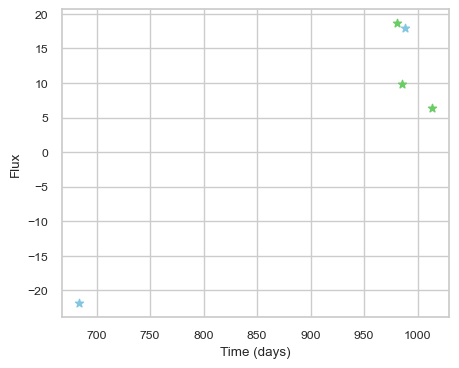

SNIax (3.9502873, False)
SNIax (4.071571, False)
SNIax (3.910112, False)
SNIax (3.8041978, False)
SNIax (3.453178, False)
SNIax (4.205004, False)
SNIax (3.9135246, False)
SNIax (3.9271932, False)
SNIax (3.9305205, False)
SNIax (4.1872406, False)


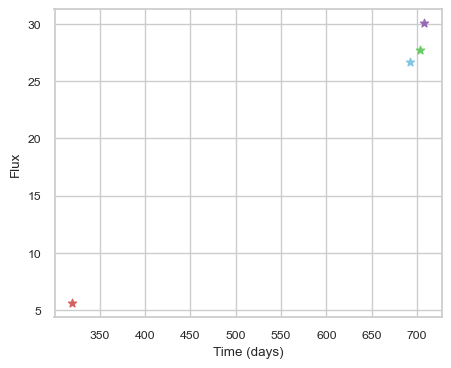

SNIax (3.9870427, False)
SNIax (4.147312, False)
SNIax (4.1339374, False)
SNIax (3.6266272, False)
SNIax (3.2491117, False)
SNIax (3.1124218, False)
SNIax (3.5790274, False)
SNIax (3.5368176, False)


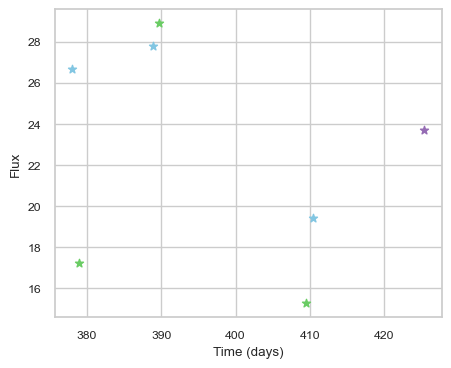

SNIax (4.437143, False)
SNIax (4.1215887, False)
SNIax (3.447541, False)
SNIax (3.2301104, False)
SNIax (3.6451719, False)
SNIax (3.6693335, False)
SNIax (2.9187808, False)
SNIax (2.7186668, False)
SNIax (3.0871117, False)
SNIax (2.6346848, False)
SNIax (2.8885696, False)
SNIax (2.5786197, False)
SNIax (3.486282, False)
SNIax (3.5659325, False)


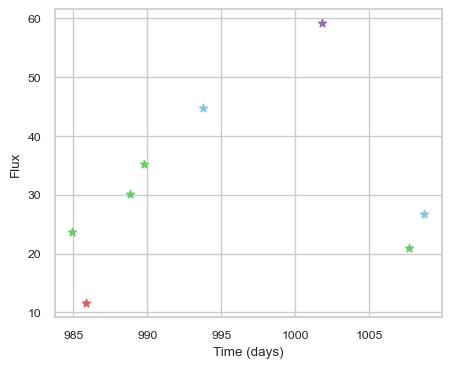

SNIax (4.2150965, False)
SNIax (3.9397018, False)
SNIax (3.4928567, False)
SNIax (3.9900045, False)
SNIax (3.2964113, False)
SNIax (2.5198083, False)
SNIax (2.909069, False)
SNIax (2.4052904, False)
SNIax (3.7786796, False)
SNIax (3.249129, False)
SNIax (3.9053628, False)
SNIax (3.7935066, False)
SNIax (4.076823, False)
SNIax (3.6154006, False)
SNIax (3.264837, False)
SNIax (3.3898575, False)


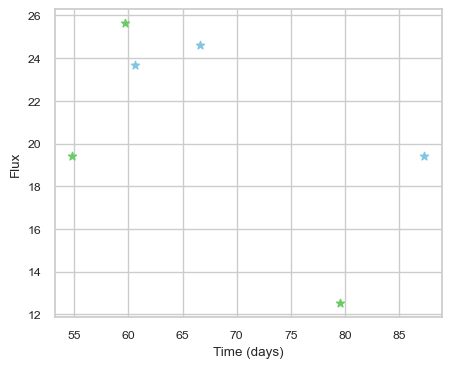

SNIax (4.810525, False)
SNIax (3.6624103, False)
SNIax (3.6127, False)
SNIax (3.346578, False)
SNIax (3.4199157, False)
SNIax (2.9159417, False)
SNIax (2.9238715, False)
SNIax (2.469865, False)
SNIax (2.5909085, False)
SNIax (2.798827, False)
SNIax (3.2819211, False)
SNIax (2.70086, False)


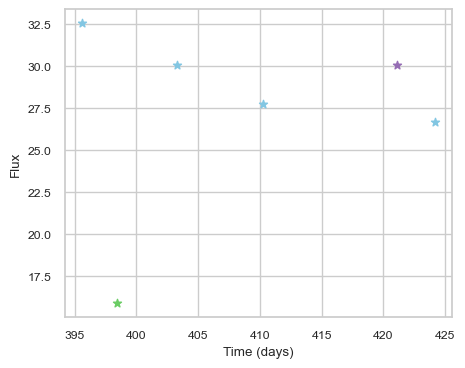

SNIax (5.2103763, False)
SNIax (5.268062, False)
SNIax (5.941353, False)
SNIax (5.728789, False)
SNIax (5.7873135, False)
SNIax (5.7925735, False)
SNIax (5.3128066, False)
SNIax (5.8014607, False)
SNIax (5.557755, False)
SNIax (5.8720717, False)
SNIax (5.9242077, False)
SNIax (5.7679424, False)


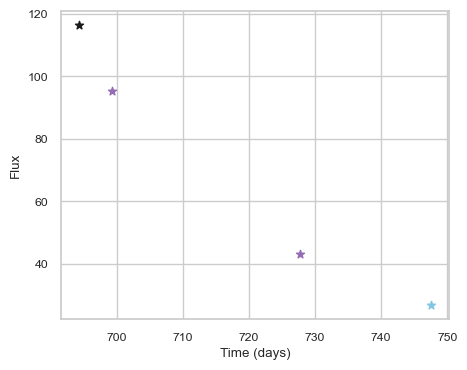

SNIax (3.8537083, False)
SNIax (3.7612634, False)
SNIax (4.4197316, False)
SNIax (3.671772, False)
SNIax (4.0186586, False)
SNIax (3.4746819, False)
SNIax (3.9534075, False)
SNIax (3.574547, False)


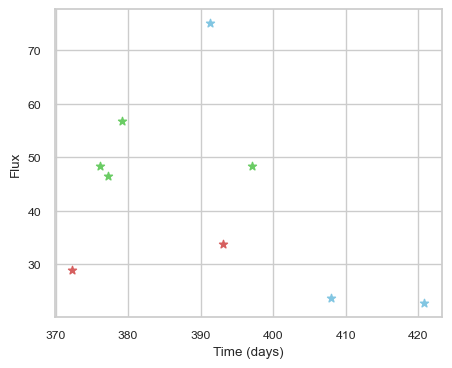

SNIax (3.7759602, False)
SNIax (4.804956, False)
SNIax (4.3659945, False)
SNIax (3.2663934, False)
SNIax (4.0029955, False)
SNIax (3.7669857, False)
SNIax (3.8517866, False)
SNIax (3.598782, False)
SNIax (3.4389668, False)
SNIax (3.741679, False)
SNIax (3.9289334, False)
SNIax (3.7749512, False)
SNIax (4.2861996, False)
SNIax (3.9289615, False)
SNIax (4.413847, False)
SNIax (3.1473675, False)
SNIax (2.3990905, False)
SNIax (2.1309023, False)


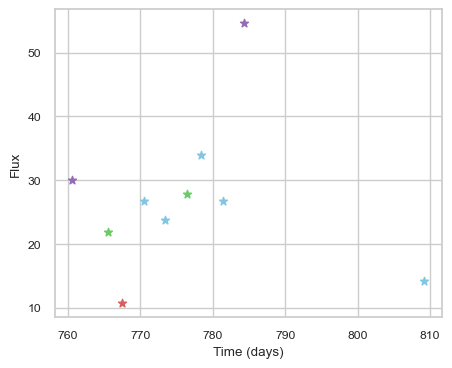

SNIax (4.288529, False)
SNIax (3.5969093, False)
SNIax (3.6435063, False)
SNIax (3.176066, False)
SNIax (3.2912316, False)
SNIax (2.719299, False)
SNIax (2.9972696, False)
SNIax (2.4237905, False)
SNIax (2.4446929, False)
SNIax (2.2749884, False)
SNIax (2.4130535, False)
SNIax (2.275368, False)
SNIax (2.508386, False)
SNIax (2.1548615, False)
SNIax (2.3210716, False)
SNIax (2.2902498, False)
SNIax (2.3236587, False)
SNIax (2.4242308, False)
SNIax (3.185743, False)
SNIax (2.7726653, False)


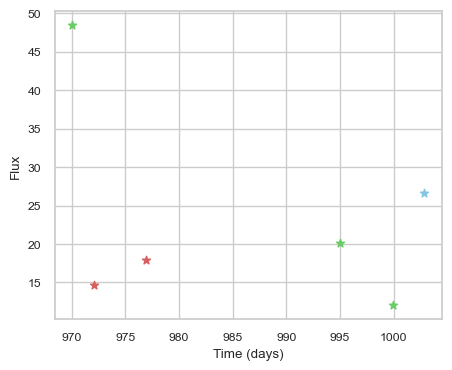

SNIax (3.909148, False)
SNIax (3.9704778, False)
SNIax (3.911177, False)
SNIax (2.9754403, False)
SNIax (3.645119, False)
SNIax (3.06638, False)
SNIax (3.298688, False)
SNIax (2.375838, False)
SNIax (2.9903646, False)
SNIax (2.615296, False)
SNIax (2.7539954, False)
SNIax (2.2650752, False)


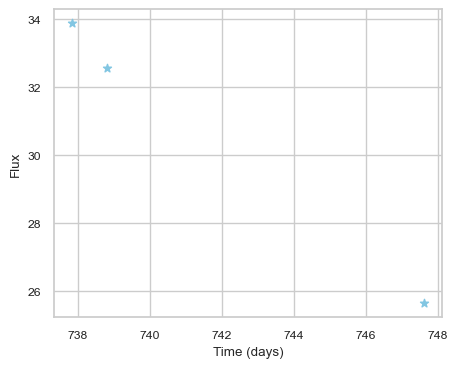

SNIax (4.1904116, False)
SNIax (3.7370355, False)
SNIax (3.6304348, False)
SNIax (3.8042848, False)
SNIax (4.218646, False)
SNIax (3.471772, False)


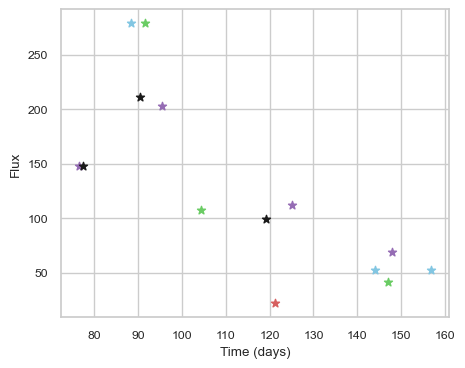

SNIax (3.8732076, False)
SNIax (3.705544, False)
SNIax (3.9795928, False)
SNIax (3.8548925, False)
SNIax (3.4960413, False)
SNIax (3.5171852, False)
SNIax (2.9385314, False)
SNIax (3.1960862, False)
SNIax (3.764333, False)
SNIax (3.4201295, False)
SNIax (3.2399406, False)
SNIax (3.0399222, False)
SNIax (2.5464802, False)
SNIax (2.6237843, False)
SNIax (2.9128952, False)
SNIax (2.8961616, False)
SNIax (2.9421308, False)
SNIax (2.7508047, False)
SNIax (3.010809, False)
SNIax (2.72322, False)
SNIax (3.1118028, False)
SNIax (2.9025683, False)
SNIax (2.6702857, False)
SNIax (2.8244405, False)
SNIax (2.9939597, False)
SNIax (2.7588415, False)
SNIax (2.4976122, False)
SNIax (2.593562, False)


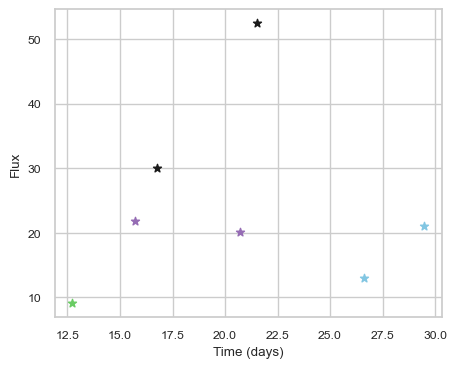

SNIax (4.4112372, False)
SNIax (3.8207364, False)
SNIax (3.272413, False)
SNIax (3.4302819, False)
SNIax (2.6685748, False)
SNIax (3.2173975, False)
SNIax (3.2716804, False)
SNIax (2.8965337, False)
SNIax (3.2872036, False)
SNIax (2.9984114, False)
SNIax (2.6697054, False)
SNIax (2.546217, False)
SNIax (2.9271865, False)
SNIax (2.6806462, False)


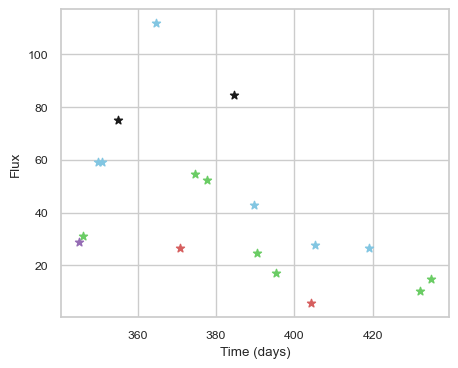

SNIax (3.779504, False)
SNIax (3.5623298, False)
SNIax (3.364782, False)
SNIax (3.522701, False)
SNIax (3.5186296, False)
SNIax (3.01724, False)
SNIax (3.462107, False)
SNIax (3.127345, False)
SNIax (3.3646462, False)
SNIax (3.2673585, False)
SNIax (2.8270724, False)
SNIax (3.150613, False)
SNIax (3.2289467, False)
SNIax (2.8715487, False)
SNIax (3.1312103, False)
SNIax (3.1195433, False)
SNIax (3.494516, False)
SNIax (3.3937776, False)
SNIax (3.4768274, False)
SNIax (3.7328782, False)
SNIax (2.8297353, False)
SNIax (3.059447, False)
SNIax (2.6924026, False)
SNIax (2.9479136, False)
SNIax (3.175674, False)
SNIax (2.625587, False)
SNIax (2.914498, False)
SNIax (2.685357, False)
SNIax (2.830714, False)
SNIax (2.3760293, False)
SNIax (2.739477, False)
SNIax (2.4091172, False)
SNIax (2.5804946, False)
SNIax (2.6194313, False)
SNIax (2.579967, False)
SNIax (2.785891, False)


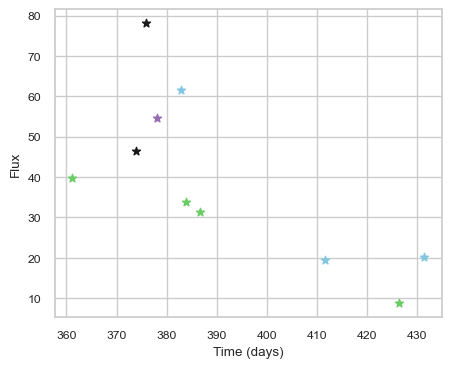

SNIax (3.8321178, False)
SNIax (3.1847804, False)
SNIax (3.4017043, False)
SNIax (3.5148535, False)
SNIax (4.370297, False)
SNIax (4.3573327, False)
SNIax (4.8795967, False)
SNIax (4.956183, False)
SNIax (5.660129, False)
SNIax (4.2224064, False)
SNIax (3.9194934, False)
SNIax (4.0825515, False)
SNIax (5.0308657, False)
SNIax (4.184508, False)
SNIax (3.3586078, False)
SNIax (3.0129182, False)
SNIax (3.3492587, False)
SNIax (2.7022264, False)
SNIax (2.475855, False)
SNIax (2.3300471, False)


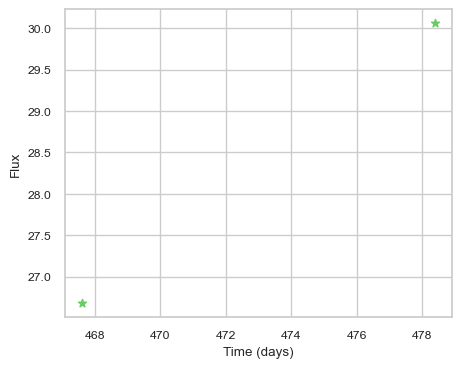

SNIax (4.107634, False)
SNIax (3.7105536, False)
SNIax (3.6416848, False)
SNIax (3.7118962, False)


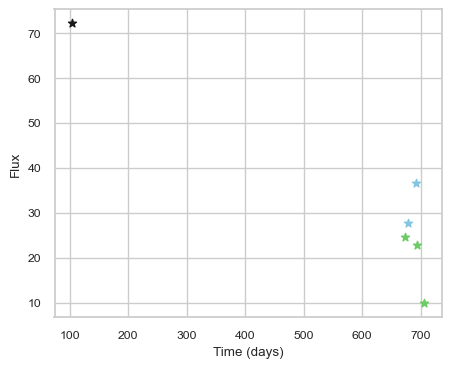

SNIax (4.7707524, False)
SNIax (4.625607, False)
SNIax (4.796806, False)
SNIax (3.780977, False)
SNIax (3.808317, False)
SNIax (2.8337774, False)
SNIax (2.6360695, False)
SNIax (3.0018053, False)
SNIax (2.854558, False)
SNIax (2.94508, False)
SNIax (2.9740229, False)
SNIax (3.1341362, False)


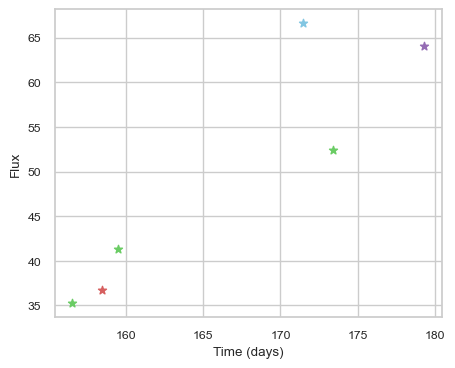

SNIax (3.8771887, False)
SNIax (3.935307, False)
SNIax (3.5260866, False)
SNIax (4.093689, False)
SNIax (4.294076, False)
SNIax (3.8462358, False)
SNIax (4.182544, False)
SNIax (2.96659, False)
SNIax (3.1077256, False)
SNIax (2.9418216, False)
SNIax (3.1341217, False)
SNIax (2.5847297, False)


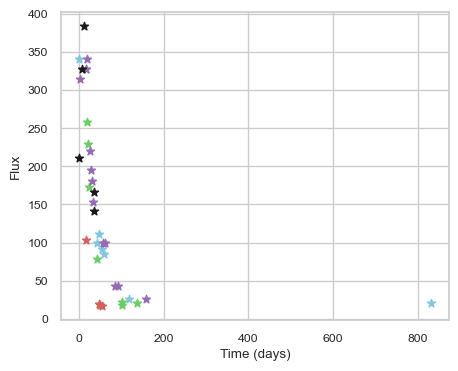

SNIax (4.0092745, False)
SNIax (4.7718515, False)
SNIax (4.190196, False)
SNIax (5.8933992, False)
SNIax (4.7264004, False)
SNIax (4.7594495, False)
SNIax (4.7103877, False)
SNIax (3.9259887, False)
SNIax (3.17866, False)
SNIax (3.247036, False)
SNIax (3.1682625, False)
SNIax (3.209858, False)
SNIax (4.01767, False)
SNIax (4.2665987, False)
SNIax (4.236263, False)
SNIax (2.940025, False)
SNIax (2.629889, False)
SNIax (2.9798646, False)
SNIax (2.6051707, False)
SNIax (2.7501342, False)
SNIax (2.662497, False)
SNIax (2.9575853, False)
SNIax (3.051607, False)
SNIax (2.4550526, False)
SNIax (2.6145785, False)
SNIax (2.8975098, False)
SNIax (2.3954334, False)
SNIax (3.2593954, False)
SNIax (2.3075554, False)
SNIax (2.7525232, False)
SNIax (2.7722375, False)
SNIax (3.0930254, False)
SNIax (3.2610428, False)
SNIax (3.2404878, False)
SNIax (3.3607192, False)
SNIax (2.7899642, False)
SNIax (2.9529152, False)
SNIax (3.3809743, False)
SNIax (2.9549954, False)
SNIax (2.4992192, False)
SNIax (2.869

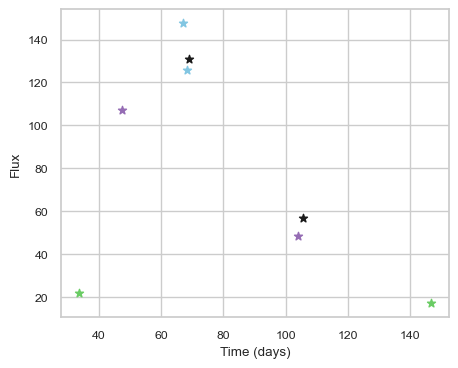

SNIax (3.945331, False)
SNIax (3.2226336, False)
SNIax (3.2710154, False)
SNIax (3.6584027, False)
SNIax (3.5338433, False)
SNIax (3.4190366, False)
SNIax (3.1879704, False)
SNIax (3.3251636, False)
SNIax (3.6953132, False)
SNIax (3.502791, False)
SNIax (3.9794202, False)
SNIax (3.3975704, False)
SNIax (3.3496695, False)
SNIax (4.0571933, False)
SNIax (3.2691073, False)
SNIax (3.3603656, False)


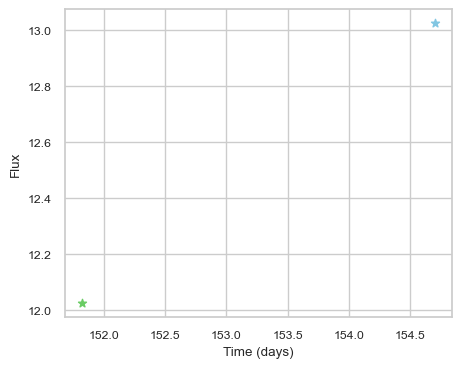

SNIax (5.2664547, False)
SNIax (4.7603593, False)
SNIax (4.1885867, False)
SNIax (4.3730626, False)


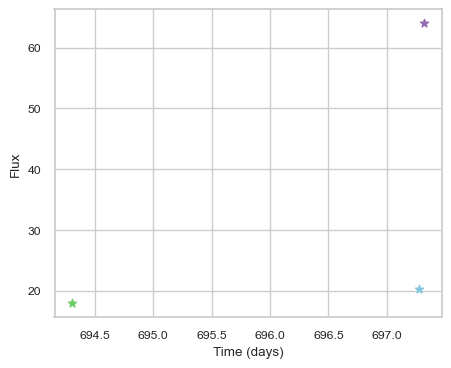

SNIax (4.156265, False)
SNIax (3.780334, False)
SNIax (3.1856167, False)
SNIax (2.9507215, False)
SNIax (3.302254, False)
SNIax (2.5554297, False)


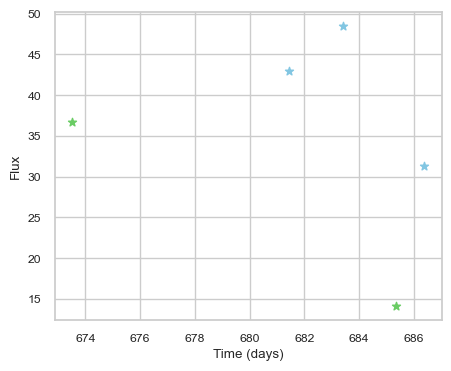

SNIax (4.1749063, False)
SNIax (4.573025, False)
SNIax (4.566046, False)
SNIax (4.5808735, False)
SNIax (3.2389677, False)
SNIax (3.3182614, False)
SNIax (3.446411, False)
SNIax (2.8112922, False)
SNIax (2.6883464, False)
SNIax (3.1190228, False)


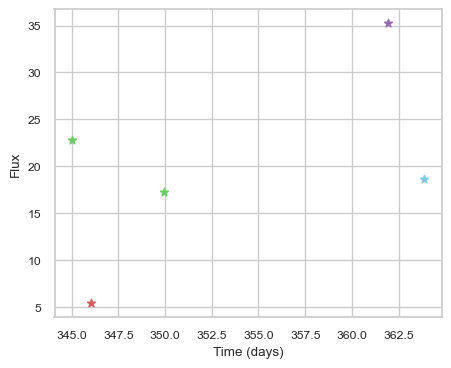

SNIax (4.1360803, False)
SNIax (3.609385, False)
SNIax (3.1940315, False)
SNIax (3.1947868, False)
SNIax (3.3566227, False)
SNIax (2.4072225, False)
SNIax (2.9237905, False)
SNIax (2.138623, False)
SNIax (2.3986883, False)
SNIax (1.9478246, False)


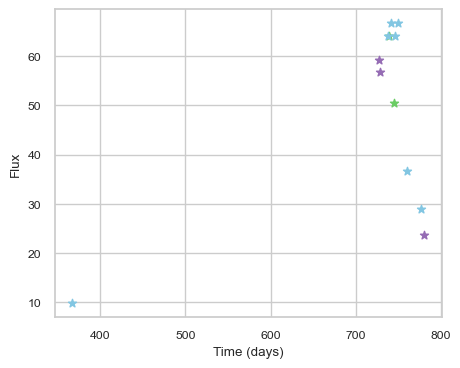

SNIax (3.895813, False)
SNIax (3.6781535, False)
SNIax (3.7126834, False)
SNIax (3.2028558, False)
SNIax (3.6363137, False)
SNIax (3.4596386, False)
SNIax (3.0846095, False)
SNIax (3.4106543, False)
SNIax (3.3768127, False)
SNIax (2.7586668, False)
SNIax (3.1129029, False)
SNIax (2.844629, False)
SNIax (3.2575939, False)
SNIax (2.8135264, False)
SNIax (2.5326798, False)
SNIax (2.4818845, False)
SNIax (2.8594012, False)
SNIax (2.511068, False)
SNIax (2.6647139, False)
SNIax (2.2128673, False)
SNIax (2.5430577, False)
SNIax (2.052395, False)
SNIax (2.7464092, False)
SNIax (2.411709, False)


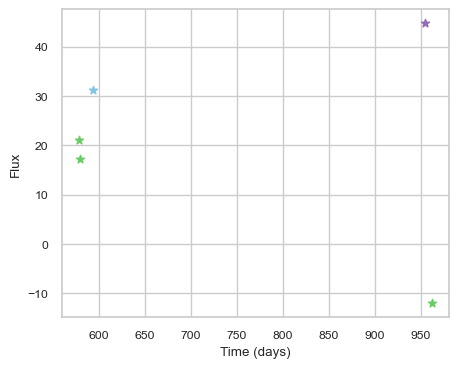

SNIax (4.9687414, False)
SNIax (4.2961855, False)
SNIax (4.2325187, False)
SNIax (3.7737496, False)
SNIax (4.5088844, False)
SNIax (5.315829, False)
SNIax (5.092537, False)
SNIax (5.6386456, False)
SNIax (5.2857976, False)
SNIax (5.571605, False)


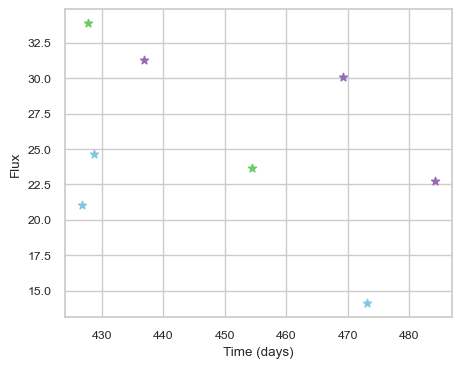

SNIax (3.9843469, False)
SNIax (3.6894987, False)
SNIax (3.486289, False)
SNIax (3.279471, False)
SNIax (3.5422292, False)
SNIax (4.2221155, False)
SNIax (4.0326743, False)
SNIax (4.496798, False)
SNIax (4.366091, False)
SNIax (4.510984, False)
SNIax (4.639283, False)
SNIax (5.148089, False)
SNIax (5.574783, False)
SNIax (4.8741026, False)
SNIax (4.1551256, False)
SNIax (5.122399, False)


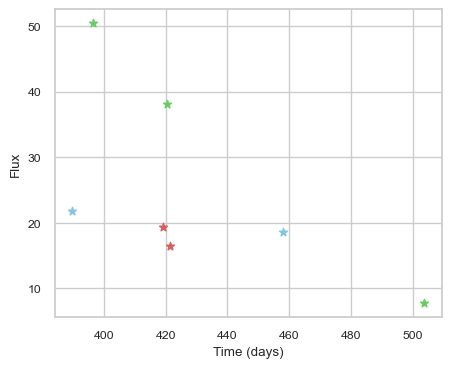

SNIax (3.8992684, False)
SNIax (3.3111851, False)
SNIax (3.3844347, False)
SNIax (3.1198387, False)
SNIax (3.6191735, False)
SNIax (2.728171, False)
SNIax (3.436643, False)
SNIax (2.7127376, False)
SNIax (2.98546, False)
SNIax (2.719922, False)
SNIax (3.9769163, False)
SNIax (3.6490824, False)
SNIax (4.109653, False)
SNIax (3.6003025, False)


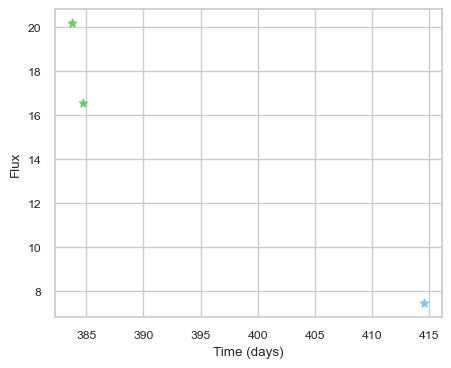

SNIax (4.0425873, False)
SNIax (3.2423494, False)
SNIax (3.4307775, False)
SNIax (3.3085148, False)
SNIax (3.2129714, False)
SNIax (3.718668, False)


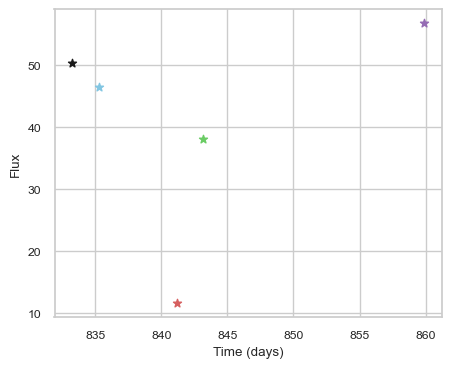

SNIax (4.532721, False)
SNIax (4.5098248, False)
SNIax (4.900629, False)
SNIax (4.8638463, False)
SNIax (5.208916, False)
SNIax (5.79967, False)
SNIax (5.7144866, False)
SNIax (6.007649, False)
SNIax (5.355985, False)
SNIax (5.369851, False)


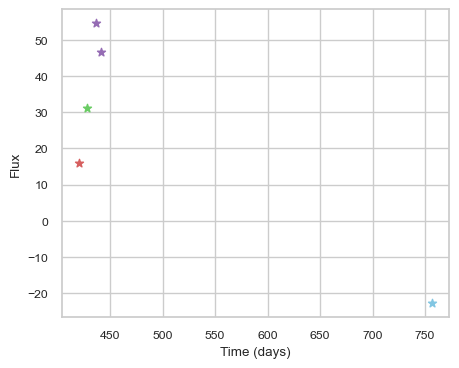

SNIax (3.9614437, False)
SNIax (4.568246, False)
SNIax (3.9567792, False)
SNIax (3.9554098, False)
SNIax (4.4429126, False)
SNIax (3.5283911, False)
SNIax (3.5708828, False)
SNIax (3.9248998, False)
SNIax (3.8936422, False)
SNIax (3.9887893, False)


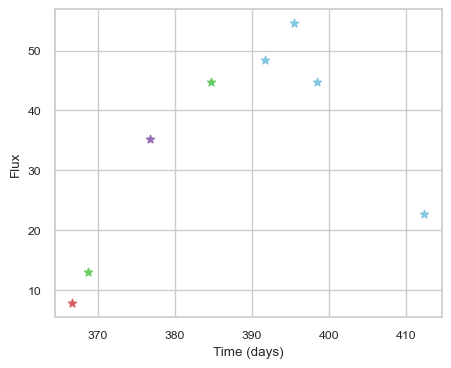

SNIax (3.758005, False)
SNIax (3.5892215, False)
SNIax (2.8843083, False)
SNIax (3.2734578, False)
SNIax (3.2489307, False)
SNIax (2.9141808, False)
SNIax (2.855151, False)
SNIax (2.1080508, False)
SNIax (2.4370089, False)
SNIax (2.107358, False)
SNIax (1.8933786, False)
SNIax (1.8539001, False)
SNIax (2.264592, False)
SNIax (1.9043928, False)
SNIax (1.9612805, False)
SNIax (1.8593729, False)


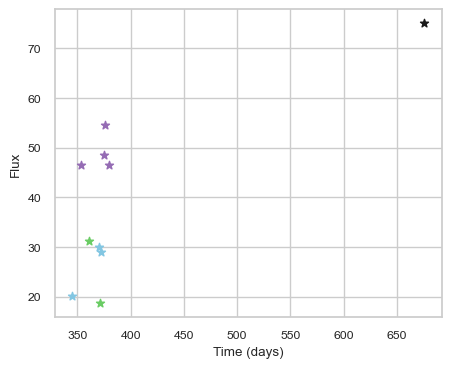

SNIax (4.2689056, False)
SNIax (4.002503, False)
SNIax (3.6132817, False)
SNIax (3.525923, False)
SNIax (4.06021, False)
SNIax (3.7680633, False)
SNIax (3.690858, False)
SNIax (2.9069023, False)
SNIax (3.0681345, False)
SNIax (2.6205342, False)
SNIax (3.0103045, False)
SNIax (2.4222279, False)
SNIax (2.7911115, False)
SNIax (2.3742392, False)
SNIax (3.054145, False)
SNIax (2.3221972, False)
SNIax (2.8039095, False)
SNIax (2.435767, False)
SNIax (3.3961256, False)
SNIax (3.3079631, False)


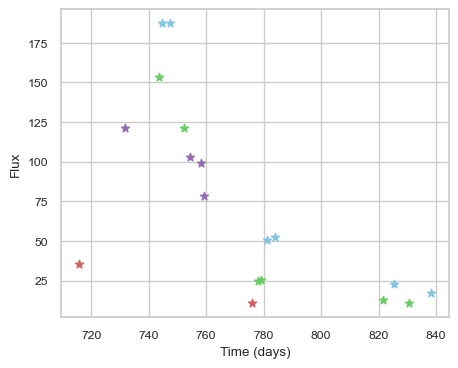

SNIax (3.8827395, False)
SNIax (4.4505014, False)
SNIax (4.6661334, False)
SNIax (3.9860935, False)
SNIax (4.4033475, False)
SNIax (4.5429287, False)
SNIax (5.8211756, False)
SNIax (5.2254405, False)
SNIax (4.6058044, False)
SNIax (3.7779682, False)
SNIax (4.090617, False)
SNIax (3.3032866, False)
SNIax (2.6973672, False)
SNIax (4.076973, False)
SNIax (4.238524, False)
SNIax (4.139403, False)
SNIax (4.8912525, False)
SNIax (4.326296, False)
SNIax (4.8071847, False)
SNIax (4.2619743, False)
SNIax (4.7519174, False)
SNIax (4.094068, False)
SNIax (4.1548777, False)
SNIax (4.2735415, False)
SNIax (4.3401117, False)
SNIax (4.300102, False)
SNIax (4.3246093, False)
SNIax (3.9397297, False)
SNIax (3.9479258, False)
SNIax (3.7498124, False)
SNIax (4.5873265, False)
SNIax (3.4891925, False)
SNIax (4.173249, False)
SNIax (3.879068, False)
SNIax (4.389177, False)
SNIax (3.5222247, False)


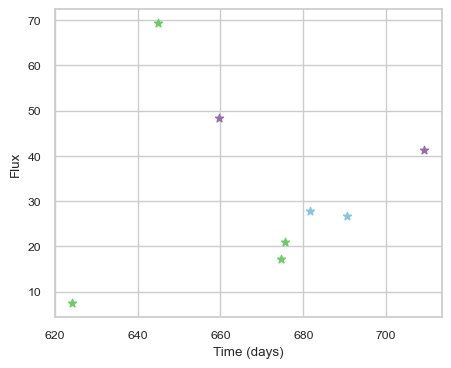

SNIax (3.9946904, False)
SNIax (3.476969, False)
SNIax (3.2887428, False)
SNIax (3.76146, False)
SNIax (4.706914, False)
SNIax (3.9364073, False)
SNIax (4.7483907, False)
SNIax (4.709285, False)
SNIax (4.3229656, False)
SNIax (4.655465, False)
SNIax (4.690158, False)
SNIax (4.4071136, False)
SNIax (4.0776772, False)
SNIax (3.9135082, False)
SNIax (4.379227, False)
SNIax (3.9846246, False)


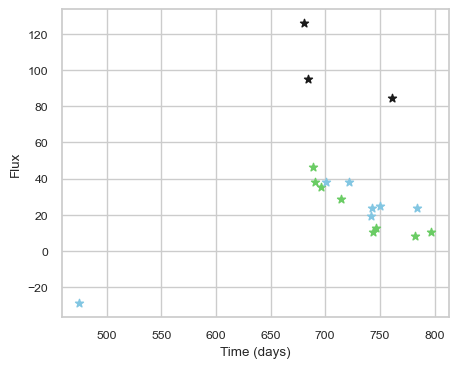

SNIax (3.8349168, False)
SNIax (3.8206642, False)
SNIax (3.7664301, False)
SNIax (3.706293, False)
SNIax (4.2610726, False)
SNIax (3.937592, False)
SNIax (3.74931, False)
SNIax (3.7977731, False)
SNIax (4.375174, False)
SNIax (4.205039, False)
SNIax (4.5277457, False)
SNIax (4.61923, False)
SNIax (4.6209345, False)
SNIax (3.8237252, False)
SNIax (3.6194203, False)
SNIax (4.0822363, False)
SNIax (4.64179, False)
SNIax (4.1352305, False)
SNIax (4.59938, False)
SNIax (3.9028568, False)
SNIax (3.376378, False)
SNIax (3.575623, False)
SNIax (3.5766823, False)
SNIax (3.6523068, False)
SNIax (3.1212769, False)
SNIax (3.3633478, False)
SNIax (3.0882113, False)
SNIax (3.0231283, False)
SNIax (3.5802233, False)
SNIax (4.2787876, False)
SNIax (5.954232, False)
SNIax (4.9916987, False)
SNIax (4.4240427, False)
SNIax (4.2254844, False)
SNIax (4.582491, False)
SNIax (4.134846, False)


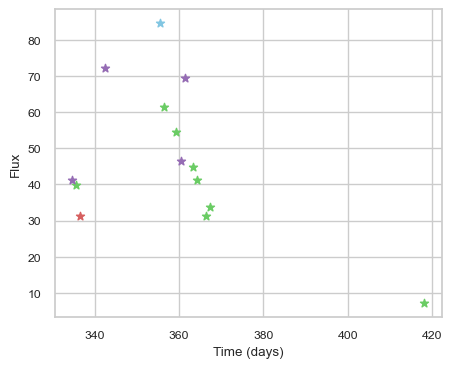

SNIax (4.14808, False)
SNIax (3.9108436, False)
SNIax (4.0305476, False)
SNIax (3.98449, False)
SNIax (4.118845, False)
SNIax (3.6901188, False)
SNIax (4.2958355, False)
SNIax (3.7832513, False)
SNIax (5.1097317, False)
SNIax (4.9001126, False)
SNIax (5.6090007, False)
SNIax (5.939611, False)
SNIax (5.8859706, False)
SNIax (5.686564, False)
SNIax (5.9786463, False)
SNIax (5.8978267, False)
SNIax (6.4754357, False)
SNIax (6.0706944, False)
SNIax (6.347973, False)
SNIax (5.9395227, False)
SNIax (6.091625, False)
SNIax (6.1897597, False)
SNIax (6.1970005, False)
SNIax (6.058822, False)
SNIax (5.977923, False)
SNIax (5.734763, False)
SNIax (6.3061013, False)
SNIax (5.4520645, False)


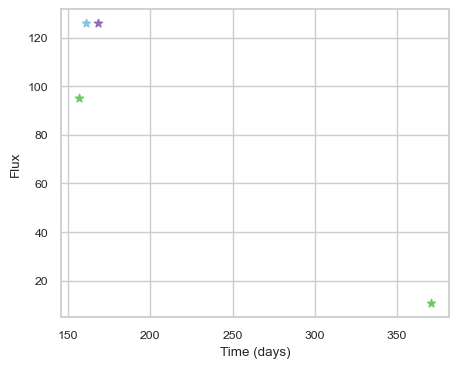

SNIax (3.7263134, False)
SNIax (4.2227635, False)
SNIax (4.0663977, False)
SNIax (3.8743665, False)
SNIax (3.4444292, False)
SNIax (3.1303806, False)
SNIax (3.5708911, False)
SNIax (3.602803, False)


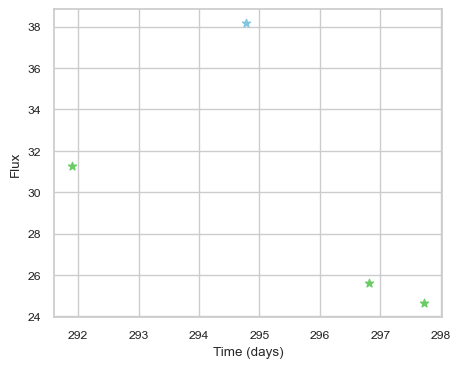

SNIax (4.007836, False)
SNIax (4.158353, False)
SNIax (3.815568, False)
SNIax (4.000422, False)
SNIax (3.557473, False)
SNIax (3.7091565, False)
SNIax (3.6067383, False)
SNIax (3.925072, False)


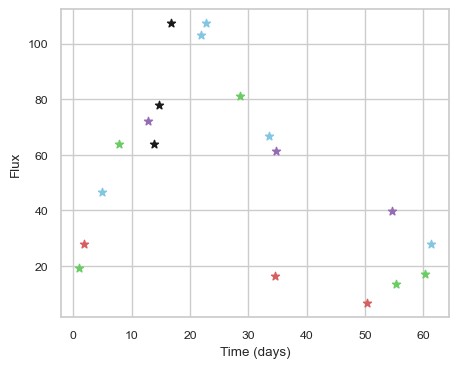

SNIax (3.8428802, False)
SNIax (3.4087327, False)
SNIax (3.458999, False)
SNIax (3.23804, False)
SNIax (3.868522, False)
SNIax (2.984759, False)
SNIax (3.2819192, False)
SNIax (2.5879219, False)
SNIax (3.0370913, False)
SNIax (2.4278808, False)
SNIax (3.721454, False)
SNIax (2.3412633, False)
SNIax (3.6459475, False)
SNIax (2.388882, False)
SNIax (3.9888403, False)
SNIax (2.0717843, False)
SNIax (3.344105, False)
SNIax (1.9508177, False)
SNIax (3.3590004, False)
SNIax (1.8022435, False)
SNIax (2.8325, False)
SNIax (2.2363956, False)
SNIax (2.4238906, False)
SNIax (1.9948936, False)
SNIax (2.3897142, False)
SNIax (2.939537, False)
SNIax (3.7030647, False)
SNIax (2.8560867, False)
SNIax (3.2679083, False)
SNIax (3.3610284, False)
SNIax (3.877635, False)
SNIax (3.1639223, False)
SNIax (3.4892304, False)
SNIax (3.2088995, False)
SNIax (3.4769533, False)
SNIax (3.2282481, False)
SNIax (3.1143332, False)
SNIax (3.0380414, False)


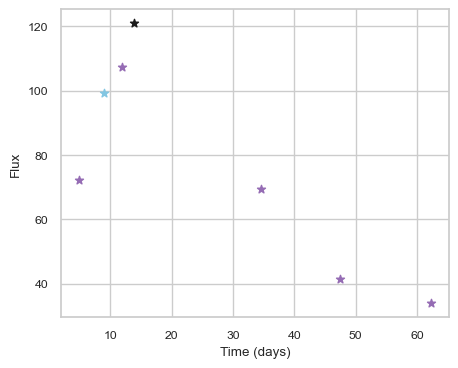

SNIax (3.971837, False)
SNIax (4.924888, False)
SNIax (4.9225297, False)
SNIax (4.8668857, False)
SNIax (5.3355427, False)
SNIax (5.3203278, False)
SNIax (5.6068945, False)
SNIax (5.655284, False)
SNIax (5.448357, False)
SNIax (5.2123666, False)
SNIax (5.5875087, False)
SNIax (5.2404985, False)
SNIax (5.2254415, False)
SNIax (5.0166984, False)


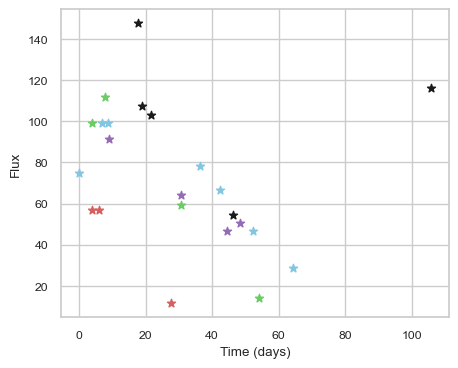

SNIax (4.441681, False)
SNIax (4.913681, False)
SNIax (5.9490414, False)
SNIax (6.423827, False)
SNIax (6.300808, False)
SNIax (6.075053, False)
SNIax (6.2628465, False)
SNIax (5.6799746, False)
SNIax (5.827844, False)
SNIax (6.154761, False)
SNIax (5.9300423, False)
SNIax (5.769331, False)
SNIax (5.830511, False)
SNIax (6.3634586, False)
SNIax (5.9211783, False)
SNIax (6.0389614, False)
SNIax (5.794306, False)
SNIax (5.5886097, False)
SNIax (4.7833505, False)
SNIax (5.096814, False)
SNIax (4.3518443, False)
SNIax (4.644356, False)
SNIax (4.938342, False)
SNIax (5.3432317, False)
SNIax (4.5465417, False)
SNIax (4.764223, False)
SNIax (4.758573, False)
SNIax (4.4672, False)
SNIax (4.1102047, False)
SNIax (5.0440063, False)
SNIax (4.4554467, False)
SNIax (4.48647, False)
SNIax (4.8258185, False)
SNIax (5.237437, False)
SNIax (5.046568, False)
SNIax (5.233708, False)
SNIax (4.739129, False)
SNIax (5.2265115, False)
SNIax (4.3027554, False)
SNIax (4.303346, False)
SNIax (4.280889, False)
S

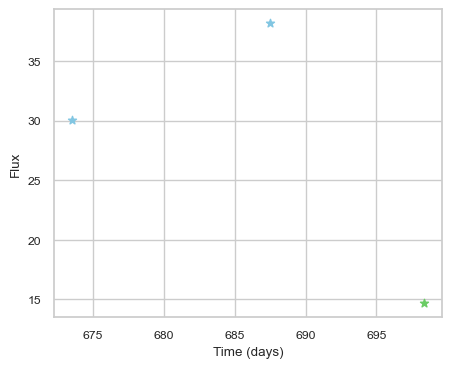

SNIax (4.13714, False)
SNIax (4.0772195, False)
SNIax (3.3335385, False)
SNIax (3.4098794, False)
SNIax (2.9137006, False)
SNIax (3.0516472, False)


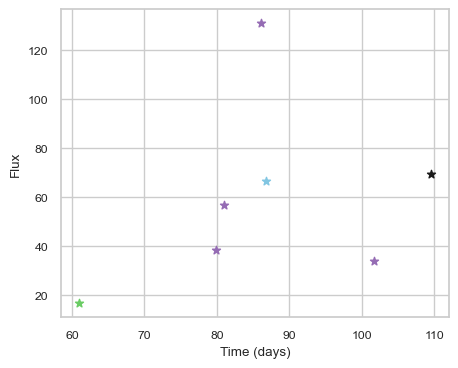

SNIax (3.9400342, False)
SNIax (3.6077702, False)
SNIax (3.3161979, False)
SNIax (3.0314596, False)
SNIax (3.1032493, False)
SNIax (2.6024234, False)
SNIax (3.3170547, False)
SNIax (3.2317502, False)
SNIax (4.2341633, False)
SNIax (3.6633453, False)
SNIax (3.0759776, False)
SNIax (3.1491394, False)
SNIax (2.8666973, False)
SNIax (3.4644141, False)


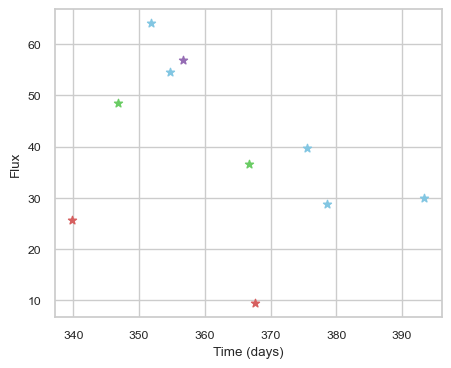

SNIax (3.9599974, False)
SNIax (4.364677, False)
SNIax (4.2410107, False)
SNIax (2.473543, False)
SNIax (3.3440266, False)
SNIax (3.466623, False)
SNIax (3.9678054, False)
SNIax (3.795675, False)
SNIax (3.8108363, False)
SNIax (3.7482724, False)
SNIax (3.4816296, False)
SNIax (3.4498298, False)
SNIax (3.9490275, False)
SNIax (3.54258, False)
SNIax (3.0364664, False)
SNIax (2.9891422, False)
SNIax (2.9669132, False)
SNIax (2.2827148, False)
SNIax (2.2917678, False)
SNIax (2.273445, False)


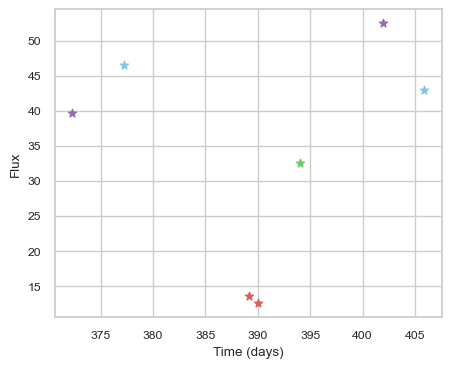

SNIax (4.126527, False)
SNIax (3.3446167, False)
SNIax (3.7517302, False)
SNIax (4.1197295, False)
SNIax (3.9541688, False)
SNIax (3.6919348, False)
SNIax (4.392395, False)
SNIax (3.80804, False)
SNIax (4.047956, False)
SNIax (3.3484201, False)
SNIax (3.4543405, False)
SNIax (2.9833195, False)
SNIax (3.6748319, False)
SNIax (3.0887191, False)


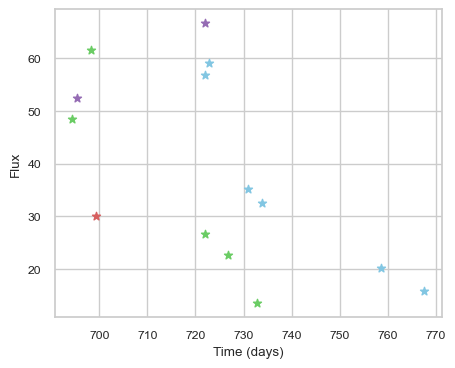

SNIax (3.8868334, False)
SNIax (3.823365, False)
SNIax (3.3472936, False)
SNIax (3.2114933, False)
SNIax (4.3019433, False)
SNIax (4.678368, False)
SNIax (4.5941834, False)
SNIax (4.5839086, False)
SNIax (4.9585567, False)
SNIax (3.7530236, False)
SNIax (4.2814736, False)
SNIax (3.657917, False)
SNIax (4.5878677, False)
SNIax (3.0540667, False)
SNIax (4.2110844, False)
SNIax (3.6207507, False)
SNIax (4.30898, False)
SNIax (3.0532298, False)
SNIax (3.6376827, False)
SNIax (3.1973119, False)
SNIax (3.2155411, False)
SNIax (3.3378425, False)
SNIax (2.9152741, False)
SNIax (3.0914419, False)
SNIax (3.1730893, False)
SNIax (2.4699838, False)
SNIax (2.7535884, False)
SNIax (2.32024, False)


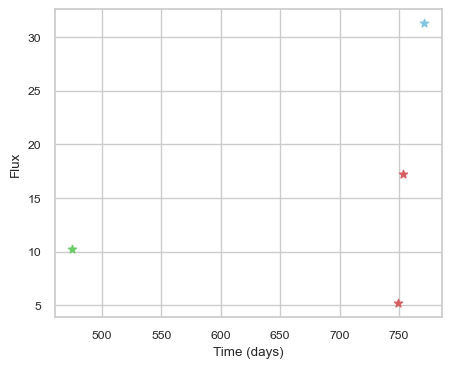

SNIax (3.8364866, False)
SNIax (3.4736242, False)
SNIax (3.4176402, False)
SNIax (3.4984093, False)
SNIax (2.9658453, False)
SNIax (2.993552, False)
SNIax (2.9303825, False)
SNIax (2.8264766, False)


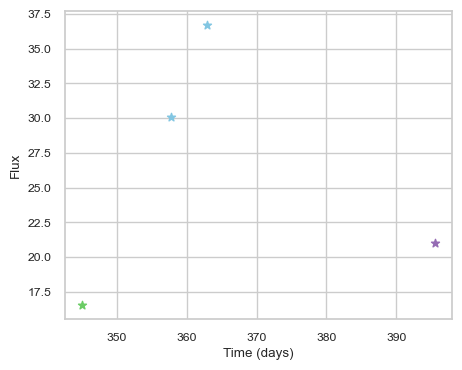

SNIax (3.9613843, False)
SNIax (3.5744836, False)
SNIax (3.6444561, False)
SNIax (3.3111348, False)
SNIax (3.4807048, False)
SNIax (3.5799518, False)
SNIax (4.0153985, False)
SNIax (4.3065267, False)


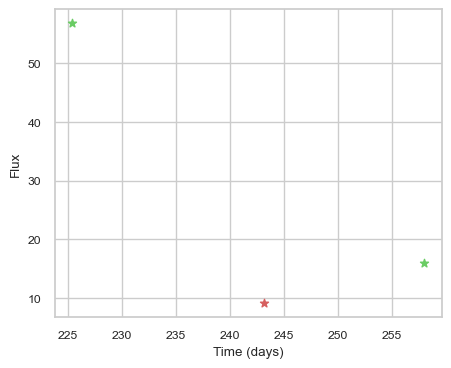

SNIax (3.6519701, False)
SNIax (3.2884374, False)
SNIax (3.7740755, False)
SNIax (3.6073196, False)
SNIax (4.6102304, False)
SNIax (3.775648, False)


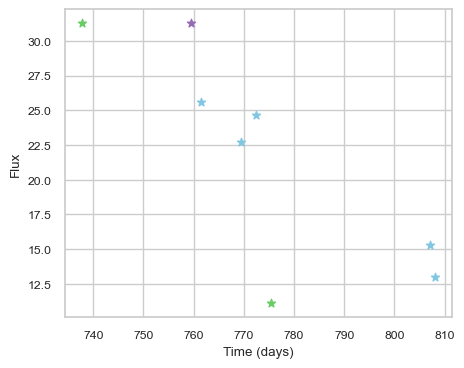

SNIax (3.8463855, False)
SNIax (2.990953, False)
SNIax (3.701429, False)
SNIax (3.90916, False)
SNIax (4.0891128, False)
SNIax (4.479906, False)
SNIax (4.552673, False)
SNIax (4.767846, False)
SNIax (5.142647, False)
SNIax (5.196936, False)
SNIax (5.2045403, False)
SNIax (5.0378137, False)
SNIax (4.5841885, False)
SNIax (4.7554755, False)
SNIax (3.9278288, False)
SNIax (4.737411, False)


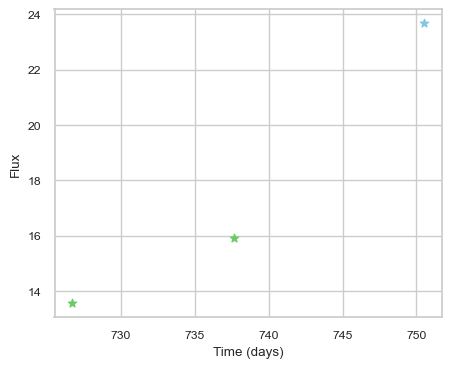

SNIax (4.153836, False)
SNIax (3.3373656, False)
SNIax (3.2722375, False)
SNIax (3.3544366, False)
SNIax (3.726529, False)
SNIax (2.7484117, False)


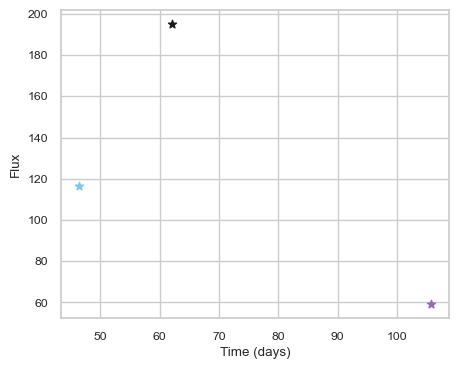

SNIax (3.8477087, False)
SNIax (3.5471718, False)
SNIax (3.4454618, False)
SNIax (3.851397, False)
SNIax (3.942988, False)
SNIax (4.1590757, False)


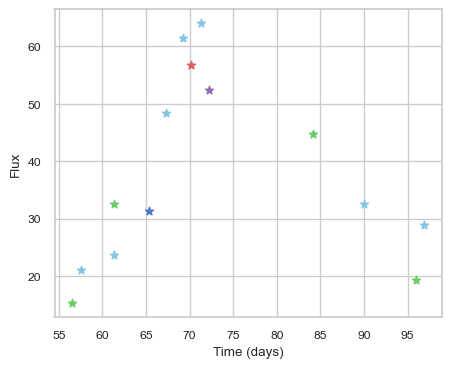

SNIax (3.850524, False)
SNIax (3.5864084, False)
SNIax (3.3165224, False)
SNIax (3.5338614, False)
SNIax (3.7770908, False)
SNIax (3.8916378, False)
SNIax (3.7577066, False)
SNIax (3.458775, False)
SNIax (3.6469152, False)
SNIax (3.4950545, False)
SNIax (3.6275914, False)
SNIax (3.7943678, False)
SNIax (3.6678603, False)
SNIax (4.1799912, False)
SNIax (4.0130463, False)
SNIax (3.8586915, False)
SNIax (3.6421456, False)
SNIax (3.9243271, False)
SNIax (3.7645557, False)
SNIax (3.6450772, False)
SNIax (3.2294552, False)
SNIax (3.1499767, False)
SNIax (4.0056167, False)
SNIax (3.428055, False)
SNIax (3.1584923, False)
SNIax (3.2533655, False)
SNIax (3.3863642, False)
SNIax (3.4387019, False)


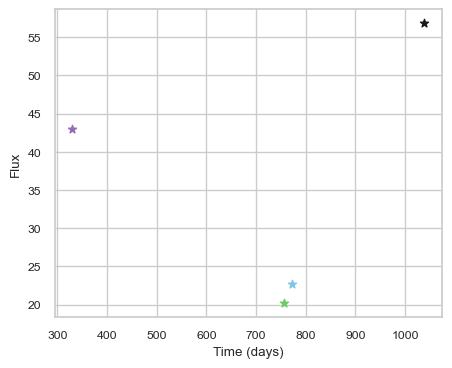

SNIax (4.6348567, False)
SNIax (5.1022935, False)
SNIax (5.1029277, False)
SNIax (4.4243016, False)
SNIax (4.283513, False)
SNIax (3.3870103, False)
SNIax (4.2545304, False)
SNIax (4.8305974, False)


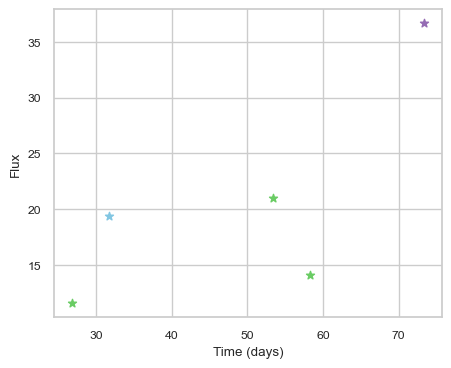

SNIax (4.0768557, False)
SNIax (3.7054768, False)
SNIax (3.4555938, False)
SNIax (2.8029776, False)
SNIax (3.3636634, False)
SNIax (3.5887687, False)
SNIax (3.9656935, False)
SNIax (4.044637, False)
SNIax (3.99542, False)
SNIax (3.776506, False)


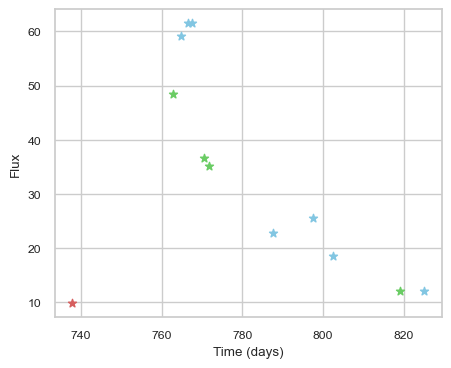

SNIax (3.8971777, False)
SNIax (3.5897396, False)
SNIax (3.2051277, False)
SNIax (3.1572304, False)
SNIax (3.2023044, False)
SNIax (3.3460693, False)
SNIax (3.9306912, False)
SNIax (3.2490594, False)
SNIax (3.66048, False)
SNIax (3.1769347, False)
SNIax (3.5879846, False)
SNIax (3.169954, False)
SNIax (3.3313928, False)
SNIax (3.3761034, False)
SNIax (3.2619524, False)
SNIax (3.0221188, False)
SNIax (2.6215427, False)
SNIax (2.749357, False)
SNIax (2.5331395, False)
SNIax (2.7502134, False)
SNIax (2.6334467, False)
SNIax (2.8915167, False)
SNIax (2.8285165, False)
SNIax (2.645642, False)


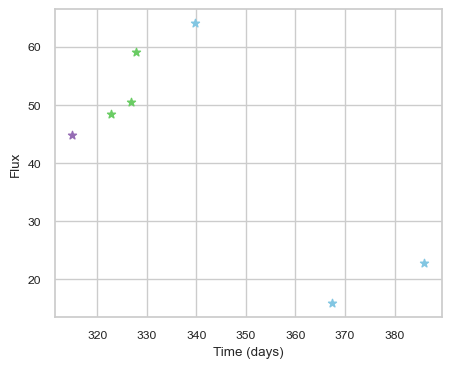

SNIax (3.8344474, False)
SNIax (3.7394984, False)
SNIax (3.5734556, False)
SNIax (3.3428283, False)
SNIax (3.529046, False)
SNIax (2.9090524, False)
SNIax (3.2545846, False)
SNIax (3.218929, False)
SNIax (3.2895675, False)
SNIax (2.608414, False)
SNIax (3.596989, False)
SNIax (2.3927572, False)
SNIax (2.5968218, False)
SNIax (2.1249158, False)


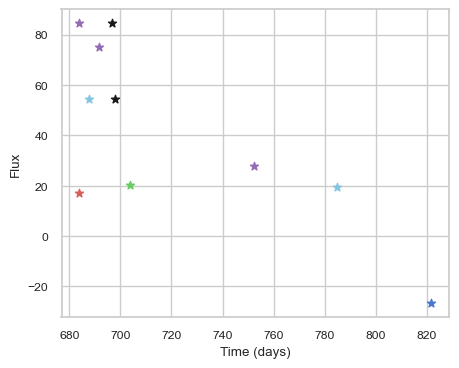

SNIax (4.0150995, False)
SNIax (4.5680113, False)
SNIax (4.149851, False)
SNIax (4.3131275, False)
SNIax (5.3793545, False)
SNIax (5.102515, False)
SNIax (4.9797497, False)
SNIax (5.0183887, False)
SNIax (5.0403214, False)
SNIax (4.944606, False)
SNIax (5.5425577, False)
SNIax (5.020722, False)
SNIax (4.588614, False)
SNIax (4.59785, False)
SNIax (4.883922, False)
SNIax (4.369087, False)
SNIax (5.178322, False)
SNIax (4.451419, False)
SNIax (4.8445454, False)
SNIax (5.0169706, False)


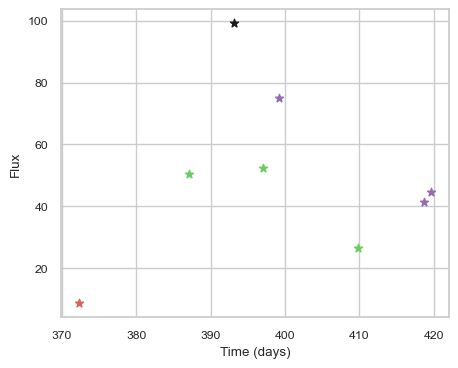

SNIax (4.041409, False)
SNIax (3.893894, False)
SNIax (3.6374962, False)
SNIax (3.3659024, False)
SNIax (3.7012143, False)
SNIax (3.7500021, False)
SNIax (4.0280066, False)
SNIax (3.454326, False)
SNIax (3.3603225, False)
SNIax (3.4524083, False)
SNIax (3.8323886, False)
SNIax (3.3649478, False)
SNIax (3.361311, False)
SNIax (3.1174793, False)
SNIax (3.7581553, False)
SNIax (2.919493, False)


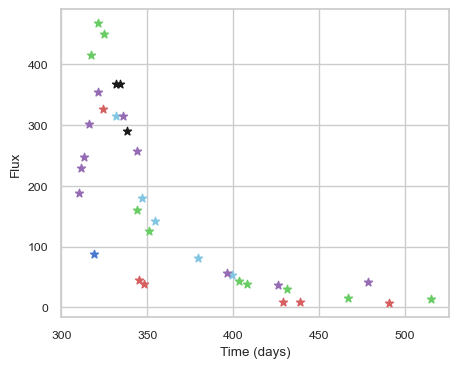

SNIax (3.5415704, False)
SNIax (4.480944, False)
SNIax (3.7395701, False)
SNIax (4.4154844, False)
SNIax (3.5235736, False)
SNIax (4.3037086, False)
SNIax (3.3311915, False)
SNIax (3.7286623, False)
SNIax (3.1110406, False)
SNIax (4.2218676, False)
SNIax (4.3022494, False)
SNIax (4.5685105, False)
SNIax (5.027308, False)
SNIax (5.802525, False)
SNIax (5.210806, False)
SNIax (5.5628834, False)
SNIax (4.7402415, False)
SNIax (5.244404, False)
SNIax (5.2562685, False)
SNIax (5.733273, False)
SNIax (5.4581947, False)
SNIax (5.0662208, False)
SNIax (4.424686, False)
SNIax (4.7824206, False)
SNIax (4.0775604, False)
SNIax (5.152074, False)
SNIax (3.5642452, False)
SNIax (3.8123312, False)
SNIax (3.257913, False)
SNIax (3.6721272, False)
SNIax (3.3729572, False)
SNIax (3.8025346, False)
SNIax (3.5998237, False)
SNIax (3.8421228, False)
SNIax (3.5023847, False)
SNIax (4.0716505, False)
SNIax (3.5573764, False)
SNIax (4.067883, False)
SNIax (3.332436, False)
SNIax (4.3272715, False)
SNIax (3.51

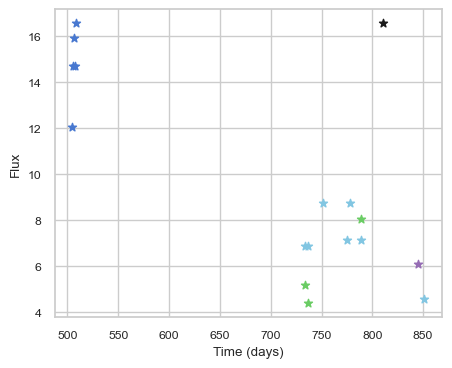

SNIax (3.8635657, False)
SNIax (4.83471, False)
SNIax (4.175212, False)
SNIax (4.3983917, False)
SNIax (3.8134654, False)
SNIax (3.702806, False)
SNIax (3.4943283, False)
SNIax (3.4646077, False)
SNIax (3.365002, False)
SNIax (3.366238, False)
SNIax (3.6005108, False)
SNIax (4.5322742, False)
SNIax (4.4678087, False)
SNIax (4.630068, False)
SNIax (4.13898, False)
SNIax (4.1796355, False)
SNIax (4.1071424, False)
SNIax (4.2267, False)
SNIax (3.7357259, False)
SNIax (4.0741253, False)
SNIax (3.8288372, False)
SNIax (4.12224, False)
SNIax (4.1338353, False)
SNIax (4.0154595, False)
SNIax (3.5449104, False)
SNIax (3.7895746, False)
SNIax (4.203875, False)
SNIax (3.370873, False)
SNIax (4.311088, False)
SNIax (3.7855241, False)
SNIax (4.1319594, False)
SNIax (3.6008646, False)
SNIax (4.577984, False)


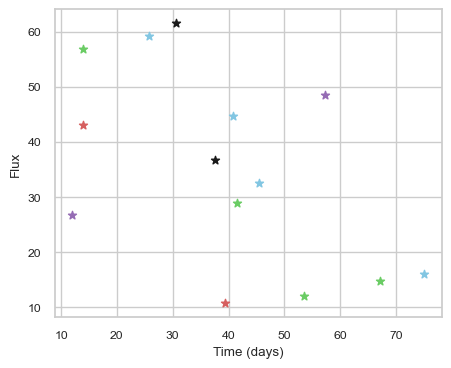

SNIax (4.108923, False)
SNIax (3.6409519, False)
SNIax (3.3987095, False)
SNIax (3.1961677, False)
SNIax (4.6143746, False)
SNIax (3.3878016, False)
SNIax (3.4926546, False)
SNIax (3.0176568, False)
SNIax (3.125501, False)
SNIax (3.0647147, False)
SNIax (2.9916606, False)
SNIax (3.6788914, False)
SNIax (2.8404279, False)
SNIax (3.5626407, False)
SNIax (3.2033818, False)
SNIax (2.386458, False)
SNIax (2.6662862, False)
SNIax (2.552526, False)
SNIax (2.8910346, False)
SNIax (2.000328, False)
SNIax (2.1612594, False)
SNIax (2.4915605, False)
SNIax (2.8116305, False)
SNIax (2.28663, False)
SNIax (2.95059, False)
SNIax (2.5312169, False)
SNIax (2.5454366, False)
SNIax (2.047684, False)


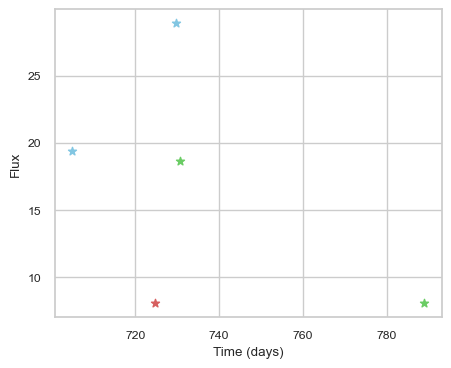

SNIax (3.9197934, False)
SNIax (3.4752946, False)
SNIax (3.4068823, False)
SNIax (3.3610704, False)
SNIax (3.596228, False)
SNIax (2.8651783, False)
SNIax (3.1649237, False)
SNIax (2.8451114, False)
SNIax (4.076664, False)
SNIax (3.8380933, False)


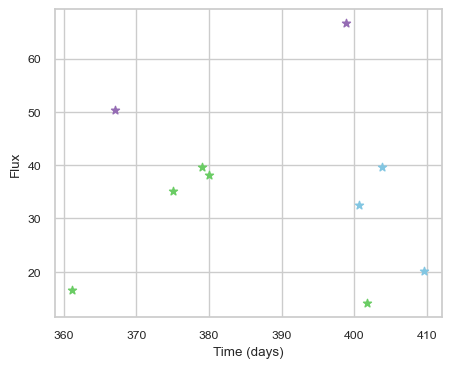

SNIax (4.019259, False)
SNIax (3.3874354, False)
SNIax (3.4177256, False)
SNIax (3.208479, False)
SNIax (3.2653084, False)
SNIax (2.4944327, False)
SNIax (2.8680594, False)
SNIax (2.7557468, False)
SNIax (3.0080779, False)
SNIax (2.8841655, False)
SNIax (3.05235, False)
SNIax (2.8806648, False)
SNIax (3.4289556, False)
SNIax (2.9681857, False)
SNIax (2.5247695, False)
SNIax (2.5825381, False)
SNIax (2.1425676, False)
SNIax (2.7697322, False)
SNIax (2.8554173, False)
SNIax (2.7439497, False)


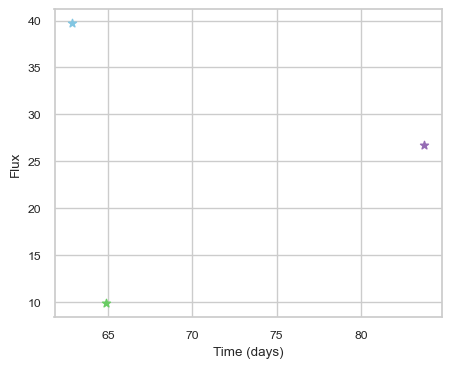

SNIax (4.9099345, False)
SNIax (6.1344466, False)
SNIax (5.80522, False)
SNIax (6.0166335, False)
SNIax (5.7670336, False)
SNIax (6.1129255, False)


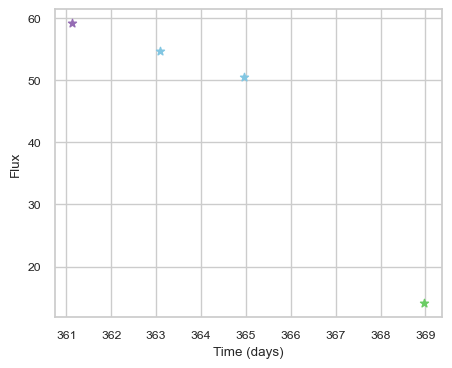

SNIax (4.0294695, False)
SNIax (3.854244, False)
SNIax (4.688568, False)
SNIax (4.8241096, False)
SNIax (4.9178243, False)
SNIax (5.0847573, False)
SNIax (5.158516, False)
SNIax (4.1616077, False)


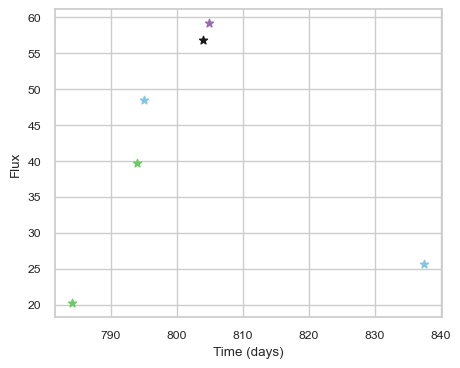

SNIax (4.2044115, False)
SNIax (3.4208975, False)
SNIax (3.232466, False)
SNIax (3.2926726, False)
SNIax (3.5957773, False)
SNIax (3.8901932, False)
SNIax (4.5471745, False)
SNIax (5.338137, False)
SNIax (5.5449624, False)
SNIax (4.988589, False)
SNIax (5.2446594, False)
SNIax (4.928389, False)


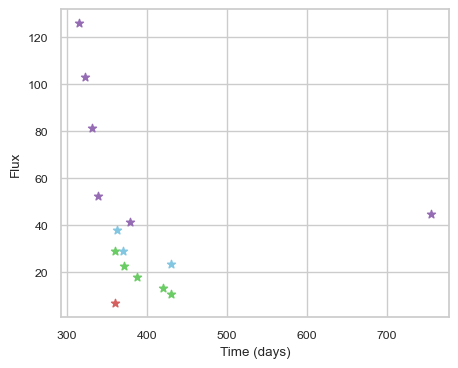

SNIax (3.7481797, False)
SNIax (4.0842714, False)
SNIax (3.615861, False)
SNIax (4.0163007, False)
SNIax (4.0813713, False)
SNIax (4.2531924, False)
SNIax (3.9287024, False)
SNIax (3.8512764, False)
SNIax (3.5606773, False)
SNIax (3.693742, False)
SNIax (3.920526, False)
SNIax (3.3634598, False)
SNIax (3.2755792, False)
SNIax (3.2149806, False)
SNIax (2.9529302, False)
SNIax (3.182644, False)
SNIax (3.177519, False)
SNIax (3.2631257, False)
SNIax (3.6610599, False)
SNIax (3.5879827, False)
SNIax (2.9362016, False)
SNIax (3.213893, False)
SNIax (3.7192302, False)
SNIax (3.424921, False)
SNIax (3.3107433, False)
SNIax (3.290869, False)
SNIax (2.8176162, False)
SNIax (3.531389, False)
SNIax (3.738452, False)
SNIax (3.6153622, False)


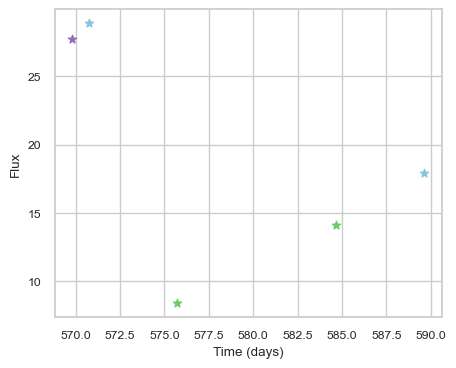

SNIax (3.6523733, False)
SNIax (2.9817467, False)
SNIax (3.4862611, False)
SNIax (3.6363053, False)
SNIax (2.847585, False)
SNIax (2.7980347, False)
SNIax (2.860966, False)
SNIax (2.778004, False)
SNIax (3.0520883, False)
SNIax (2.781354, False)


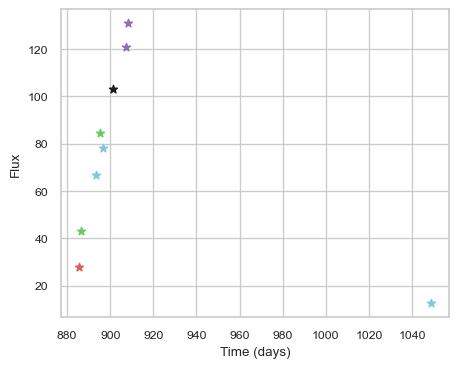

SNIax (3.7946105, False)
SNIax (4.1849704, False)
SNIax (4.232674, False)
SNIax (3.2588341, False)
SNIax (3.3913472, False)
SNIax (3.0995138, False)
SNIax (3.2989733, False)
SNIax (3.408107, False)
SNIax (3.3669302, False)
SNIax (3.5610325, False)
SNIax (3.9616883, False)
SNIax (3.8653717, False)
SNIax (3.4645376, False)
SNIax (3.3852007, False)
SNIax (4.3053994, False)
SNIax (3.4725482, False)
SNIax (3.410673, False)
SNIax (3.1086202, False)


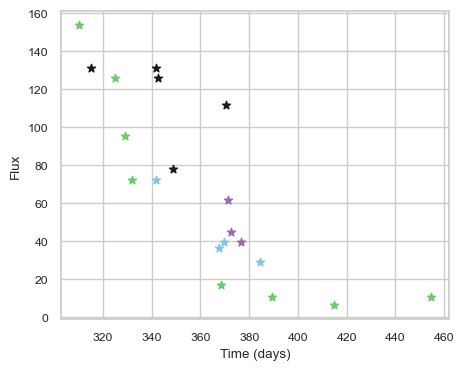

SNIax (3.787332, False)
SNIax (4.5360036, False)
SNIax (5.4813795, False)
SNIax (5.7371573, False)
SNIax (5.2012253, False)
SNIax (5.6045203, False)
SNIax (5.4776707, False)
SNIax (5.9874616, False)
SNIax (5.1510177, False)
SNIax (5.9352484, False)
SNIax (5.7325506, False)
SNIax (5.9702153, False)
SNIax (4.7214165, False)
SNIax (5.1786733, False)
SNIax (5.0878687, False)
SNIax (5.3989706, False)
SNIax (4.3239937, False)
SNIax (5.3545337, False)
SNIax (5.122331, False)
SNIax (4.9480267, False)
SNIax (5.2754545, False)
SNIax (5.2466764, False)
SNIax (4.886748, False)
SNIax (4.874752, False)
SNIax (4.839751, False)
SNIax (5.5575476, False)
SNIax (4.909196, False)
SNIax (4.562817, False)
SNIax (4.8065066, False)
SNIax (4.921298, False)
SNIax (5.040538, False)
SNIax (5.0306067, False)
SNIax (4.6419024, False)
SNIax (4.742879, False)
SNIax (4.5590277, False)
SNIax (5.0788608, False)
SNIax (5.163326, False)
SNIax (5.034555, False)
SNIax (5.38117, False)
SNIax (4.982143, False)


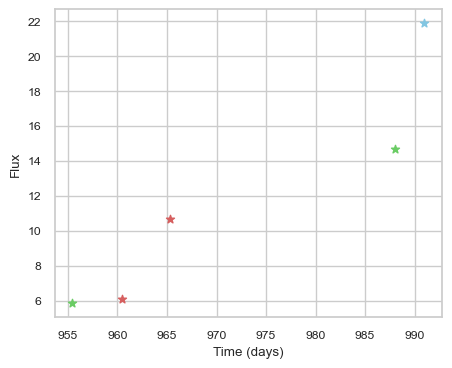

SNIax (4.185868, False)
SNIax (3.445564, False)
SNIax (3.3346019, False)
SNIax (3.540745, False)
SNIax (2.8169727, False)
SNIax (2.9964209, False)
SNIax (3.1212387, False)
SNIax (2.7958574, False)
SNIax (3.106111, False)
SNIax (2.696836, False)


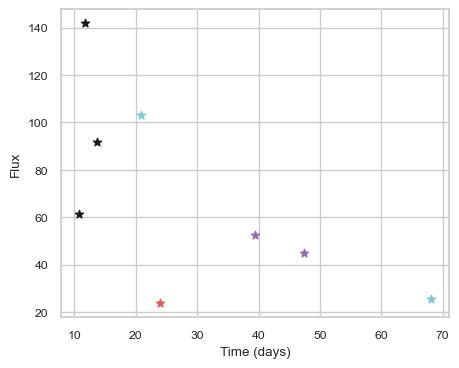

SNIax (4.297481, False)
SNIax (4.320539, False)
SNIax (4.0903816, False)
SNIax (4.246662, False)
SNIax (4.1838956, False)
SNIax (4.043468, False)
SNIax (3.3389332, False)
SNIax (3.392631, False)
SNIax (3.7538006, False)
SNIax (3.8764424, False)
SNIax (4.1713734, False)
SNIax (3.6198537, False)
SNIax (3.092482, False)
SNIax (3.3672605, False)
SNIax (2.6834903, False)
SNIax (2.9307714, False)


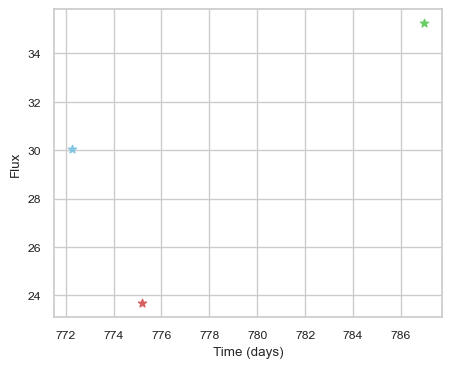

SNIax (3.8505006, False)
SNIax (3.366372, False)
SNIax (3.3457325, False)
SNIax (3.0559802, False)
SNIax (3.14435, False)
SNIax (2.3036933, False)


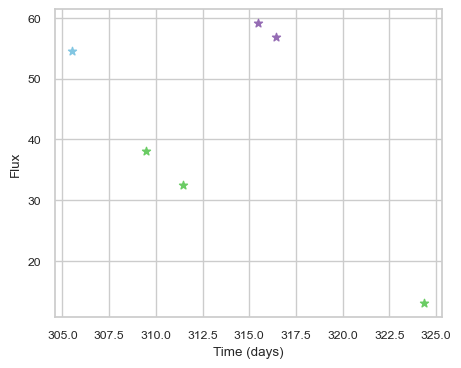

SNIax (3.9876623, False)
SNIax (4.4384065, False)
SNIax (4.2824683, False)
SNIax (3.4449954, False)
SNIax (3.6653936, False)
SNIax (3.340788, False)
SNIax (3.6494772, False)
SNIax (3.175442, False)
SNIax (4.5727196, False)
SNIax (3.8127186, False)
SNIax (3.435214, False)
SNIax (3.3651054, False)


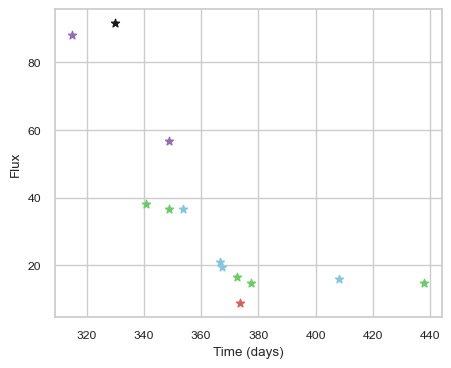

SNIax (3.5774238, False)
SNIax (4.1851125, False)
SNIax (4.075284, False)
SNIax (4.3842072, False)
SNIax (4.0281973, False)
SNIax (4.6162663, False)
SNIax (5.026308, False)
SNIax (4.6753173, False)
SNIax (4.4878626, False)
SNIax (4.939644, False)
SNIax (5.2419496, False)
SNIax (4.513687, False)
SNIax (4.2628, False)
SNIax (3.8359938, False)
SNIax (3.5469909, False)
SNIax (3.5255454, False)
SNIax (3.528437, False)
SNIax (3.753537, False)
SNIax (3.3668773, False)
SNIax (4.0486407, False)
SNIax (4.276079, False)
SNIax (4.064196, False)
SNIax (4.1219654, False)
SNIax (3.870962, False)
SNIax (4.1176476, False)
SNIax (4.261411, False)


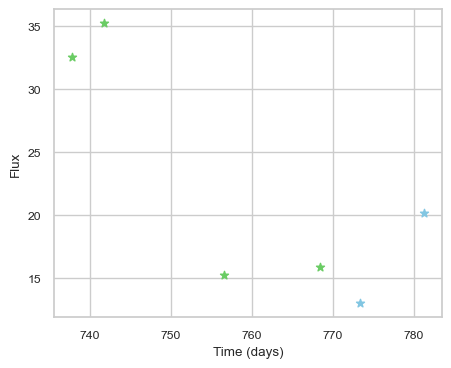

SNIax (3.762304, False)
SNIax (3.144319, False)
SNIax (3.3477662, False)
SNIax (3.1053631, False)
SNIax (3.2326648, False)
SNIax (3.793942, False)
SNIax (3.2846422, False)
SNIax (3.2205274, False)
SNIax (3.3449187, False)
SNIax (3.119071, False)
SNIax (2.734014, False)
SNIax (3.1994662, False)


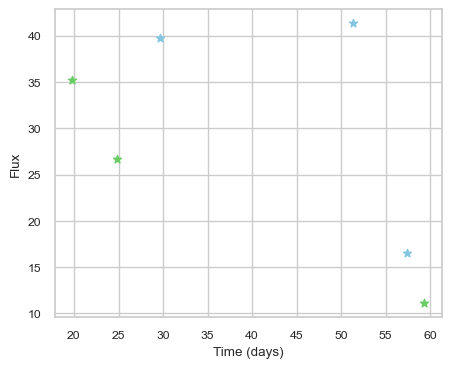

SNIax (4.1882706, False)
SNIax (3.2070935, False)
SNIax (3.6738226, False)
SNIax (4.04956, False)
SNIax (4.3203683, False)
SNIax (4.066453, False)
SNIax (5.7955594, False)
SNIax (5.183543, False)
SNIax (5.531789, False)
SNIax (4.995632, False)
SNIax (4.7940025, False)
SNIax (5.044764, False)


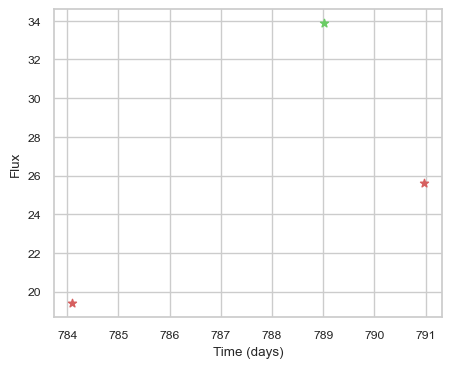

SNIax (3.9647508, False)
SNIax (4.556459, False)
SNIax (4.426503, False)
SNIax (2.9371164, False)
SNIax (4.164012, False)
SNIax (3.5380542, False)


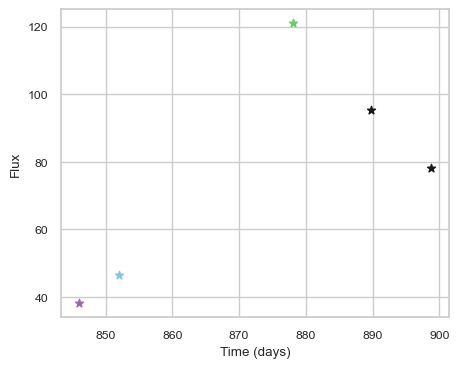

SNIax (3.8417954, False)
SNIax (3.5090978, False)
SNIax (3.260765, False)
SNIax (3.4749804, False)
SNIax (3.4905374, False)
SNIax (3.5608907, False)
SNIax (4.2780714, False)
SNIax (5.206626, False)
SNIax (4.64916, False)
SNIax (5.4271827, False)


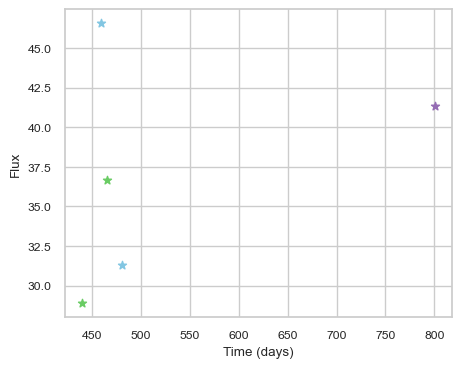

SNIax (4.0793366, False)
SNIax (3.6203308, False)
SNIax (3.5671728, False)
SNIax (3.4893966, False)
SNIax (2.7292159, False)
SNIax (3.3463743, False)
SNIax (3.5504894, False)
SNIax (3.205109, False)
SNIax (4.532701, False)
SNIax (4.7384453, False)


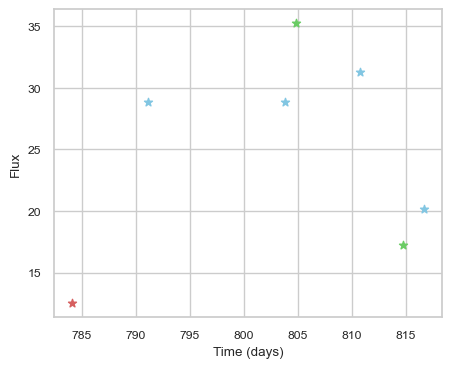

SNIax (3.9204133, False)
SNIax (4.2196984, False)
SNIax (3.8794134, False)
SNIax (3.7803466, False)
SNIax (3.7078824, False)
SNIax (4.1853085, False)
SNIax (3.875013, False)
SNIax (4.2732244, False)
SNIax (4.354512, False)
SNIax (5.04333, False)
SNIax (5.0541105, False)
SNIax (5.2812023, False)
SNIax (4.7593927, False)
SNIax (4.7527895, False)


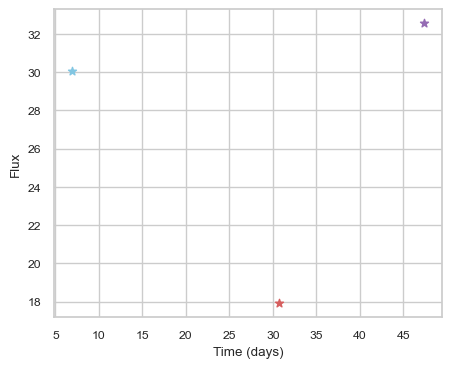

SNIax (4.4067774, False)
SNIax (3.0681276, False)
SNIax (3.228793, False)
SNIax (4.088824, False)
SNIax (4.639688, False)
SNIax (4.9604125, False)


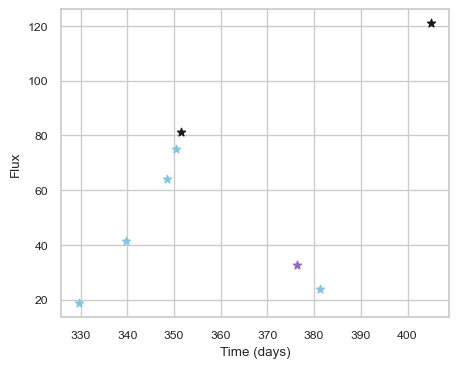

SNIax (4.12136, False)
SNIax (3.725021, False)
SNIax (3.2538683, False)
SNIax (3.3424423, False)
SNIax (2.973478, False)
SNIax (3.6610622, False)
SNIax (4.1128674, False)
SNIax (4.4057937, False)
SNIax (4.6826067, False)
SNIax (4.1703224, False)
SNIax (5.174188, False)
SNIax (3.8686244, False)
SNIax (4.5651493, False)
SNIax (4.048239, False)
SNIax (4.1593018, False)
SNIax (3.978879, False)


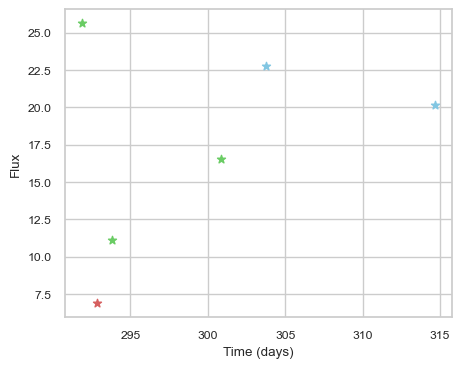

SNIax (4.147574, False)
SNIax (4.3315673, False)
SNIax (3.7386558, False)
SNIax (4.7200427, False)
SNIax (3.6793222, False)
SNIax (3.7640212, False)
SNIax (4.37394, False)
SNIax (3.9463663, False)
SNIax (3.686847, False)
SNIax (3.6999679, False)
SNIax (3.3870595, False)
SNIax (3.5157175, False)


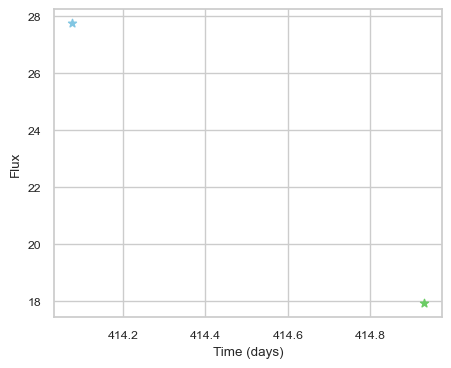

SNIax (4.257519, False)
SNIax (3.8421466, False)
SNIax (3.493928, False)
SNIax (3.1164699, False)


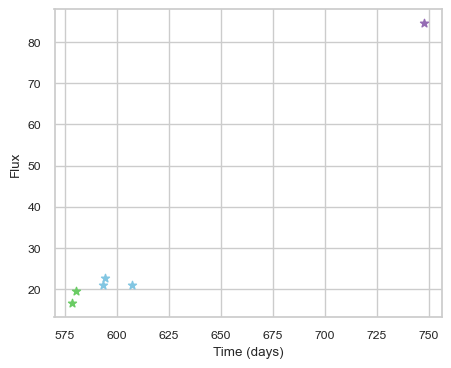

SNIax (4.1988115, False)
SNIax (3.4065626, False)
SNIax (3.6921065, False)
SNIax (3.0029054, False)
SNIax (3.185063, False)
SNIax (2.9857512, False)
SNIax (3.3235302, False)
SNIax (3.3512363, False)
SNIax (3.1081126, False)
SNIax (3.2218144, False)
SNIax (4.053206, False)
SNIax (2.9477096, False)


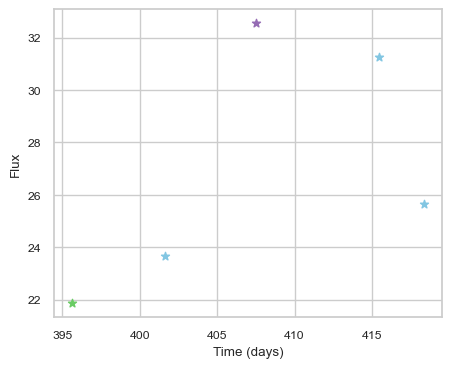

SNIax (4.8323307, False)
SNIax (3.99777, False)
SNIax (3.923699, False)
SNIax (3.1933017, False)
SNIax (3.3892136, False)
SNIax (3.1622918, False)
SNIax (2.8195589, False)
SNIax (2.991527, False)
SNIax (3.124009, False)
SNIax (2.7168806, False)


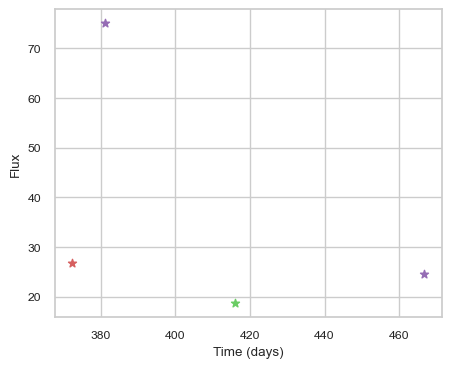

SNIax (3.990728, False)
SNIax (4.645507, False)
SNIax (4.6805644, False)
SNIax (3.6249905, False)
SNIax (4.537987, False)
SNIax (3.560266, False)
SNIax (4.7975736, False)
SNIax (3.8438756, False)


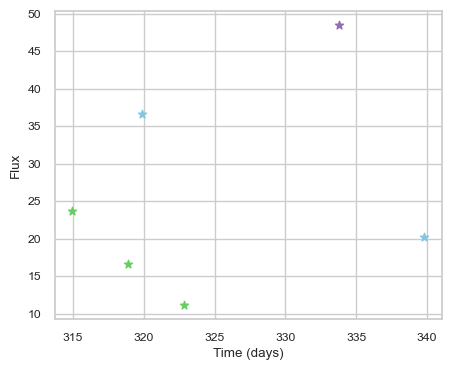

SNIax (5.1986675, False)
SNIax (5.2757707, False)
SNIax (4.9223337, False)
SNIax (5.0139184, False)
SNIax (4.480238, False)
SNIax (6.1737247, False)
SNIax (5.619163, False)
SNIax (5.260135, False)
SNIax (4.8369584, False)
SNIax (5.5204067, False)
SNIax (4.927106, False)
SNIax (4.6454444, False)


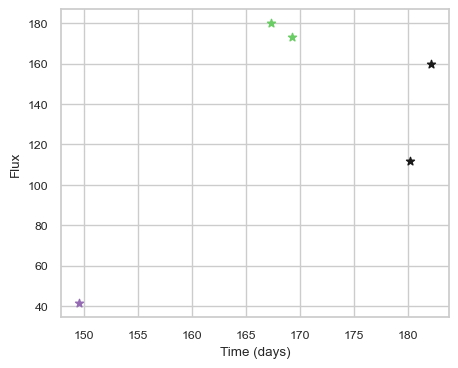

SNIax (3.6023417, False)
SNIax (3.9419544, False)
SNIax (3.6429362, False)
SNIax (3.7928007, False)
SNIax (4.6589932, False)
SNIax (5.4417396, False)
SNIax (4.3128724, False)
SNIax (4.351293, False)
SNIax (5.3591223, False)
SNIax (4.525226, False)


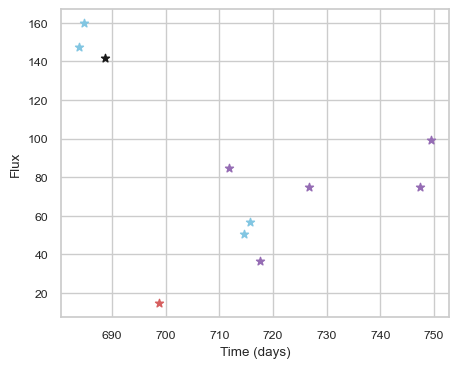

SNIax (3.9738886, False)
SNIax (4.384419, False)
SNIax (5.5441704, False)
SNIax (5.1981554, False)
SNIax (5.351326, False)
SNIax (5.537109, False)
SNIax (4.5944486, False)
SNIax (5.374894, False)
SNIax (5.430799, False)
SNIax (5.887828, False)
SNIax (6.1003695, False)
SNIax (5.7074447, False)
SNIax (5.8017826, False)
SNIax (6.223146, False)
SNIax (5.926141, False)
SNIax (5.430608, False)
SNIax (5.398798, False)
SNIax (6.1543355, False)
SNIax (6.36025, False)
SNIax (6.0553846, False)
SNIax (5.464704, False)
SNIax (5.1614413, False)


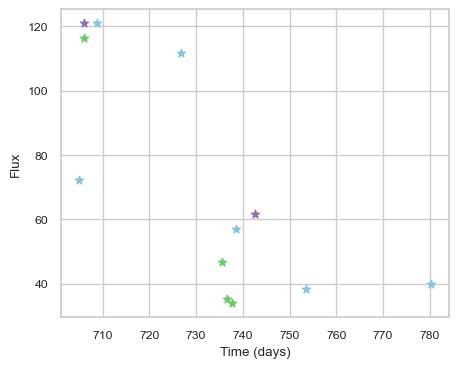

SNIax (3.789613, False)
SNIax (3.663288, False)
SNIax (4.3001075, False)
SNIax (5.0624723, False)
SNIax (5.972614, False)
SNIax (5.24944, False)
SNIax (5.4004087, False)
SNIax (5.082383, False)
SNIax (5.4005904, False)
SNIax (4.923681, False)
SNIax (5.2637024, False)
SNIax (5.5612535, False)
SNIax (5.790442, False)
SNIax (5.711794, False)
SNIax (5.3052435, False)
SNIax (5.56095, False)
SNIax (5.443502, False)
SNIax (5.7402205, False)
SNIax (5.608013, False)
SNIax (4.956948, False)
SNIax (5.094139, False)
SNIax (5.0623474, False)
SNIax (4.7535915, False)
SNIax (4.924745, False)


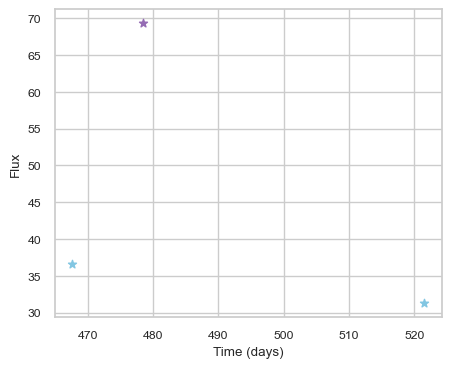

SNIax (3.8595238, False)
SNIax (4.0058746, False)
SNIax (3.4871168, False)
SNIax (3.44333, False)
SNIax (4.5034323, False)
SNIax (4.8927693, False)


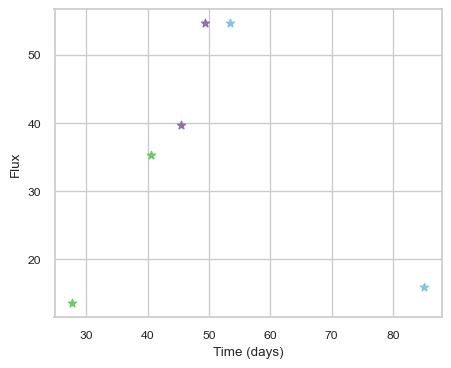

SNIax (4.6974216, False)
SNIax (3.4990427, False)
SNIax (3.720711, False)
SNIax (3.3749733, False)
SNIax (4.0292726, False)
SNIax (3.5768785, False)
SNIax (3.850493, False)
SNIax (3.6868503, False)
SNIax (4.284107, False)
SNIax (4.269537, False)
SNIax (4.6905465, False)
SNIax (4.0463953, False)


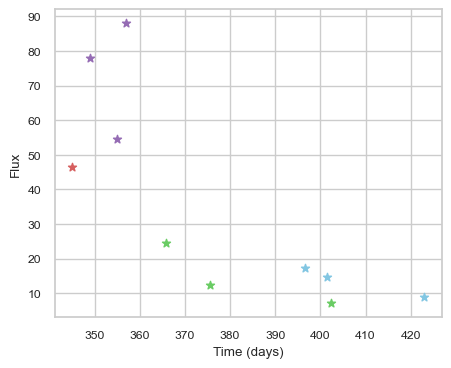

SNIax (3.756738, False)
SNIax (4.065172, False)
SNIax (4.5309873, False)
SNIax (3.5386944, False)
SNIax (3.483762, False)
SNIax (3.8410516, False)
SNIax (4.369898, False)
SNIax (4.7296786, False)
SNIax (5.4541783, False)
SNIax (4.6051517, False)
SNIax (3.4148614, False)
SNIax (3.7714365, False)
SNIax (2.8820632, False)
SNIax (3.1093502, False)
SNIax (2.6255708, False)
SNIax (2.7758992, False)
SNIax (2.877837, False)
SNIax (2.7098248, False)
SNIax (2.6036537, False)
SNIax (3.2466323, False)


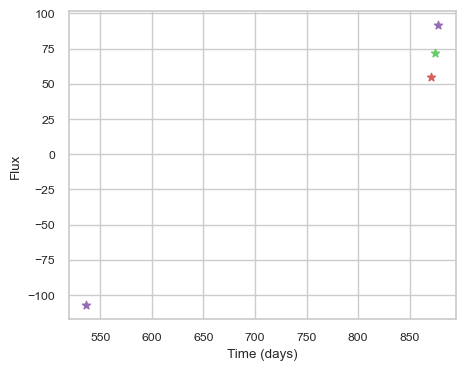

SNIax (3.8784165, False)
SNIax (3.5445206, False)
SNIax (3.8465867, False)
SNIax (4.2158475, False)
SNIax (4.4476185, False)
SNIax (4.2181077, False)
SNIax (3.6948886, False)
SNIax (3.5560389, False)


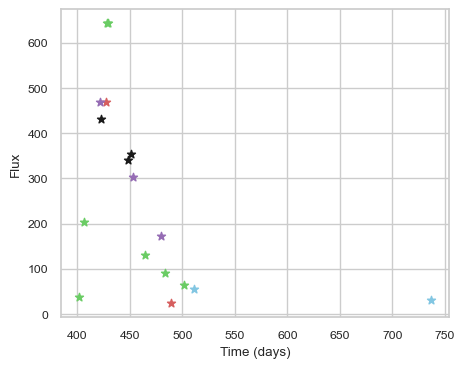

SNIax (3.6303654, False)
SNIax (3.5472403, False)
SNIax (3.5489824, False)
SNIax (3.5778172, False)
SNIax (3.0918143, False)
SNIax (2.1883776, False)
SNIax (2.9730904, False)
SNIax (3.759249, False)
SNIax (2.871578, False)
SNIax (3.7930977, False)
SNIax (4.1849585, False)
SNIax (4.6336317, False)
SNIax (4.8113084, False)
SNIax (5.045983, False)
SNIax (5.0897846, False)
SNIax (5.7767954, False)
SNIax (4.863507, False)
SNIax (5.7084794, False)
SNIax (4.2836018, False)
SNIax (4.9310293, False)
SNIax (4.2306585, False)
SNIax (4.995233, False)
SNIax (4.9232845, False)
SNIax (4.750008, False)
SNIax (3.8699539, False)
SNIax (4.7405868, False)
SNIax (4.14096, False)
SNIax (4.6979175, False)
SNIax (3.9413302, False)
SNIax (4.6131926, False)
SNIax (3.8008535, False)
SNIax (3.752873, False)
SNIax (4.183699, False)
SNIax (3.4687924, False)


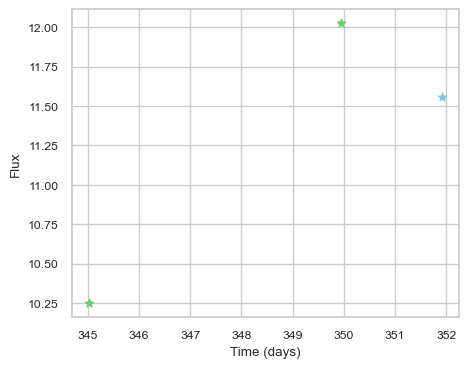

SNIax (4.251737, False)
SNIax (3.641273, False)
SNIax (3.5726354, False)
SNIax (3.0054946, False)
SNIax (3.3069632, False)
SNIax (3.42593, False)


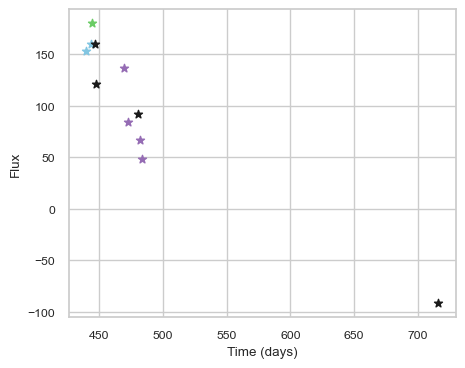

SNIax (4.16016, False)
SNIax (4.8708773, False)
SNIax (5.050699, False)
SNIax (4.402429, False)
SNIax (4.2316523, False)
SNIax (3.7488685, False)
SNIax (4.4431605, False)
SNIax (4.421246, False)
SNIax (4.1768765, False)
SNIax (4.317991, False)
SNIax (3.489792, False)
SNIax (3.3343692, False)
SNIax (3.7234502, False)
SNIax (3.6182232, False)
SNIax (3.6548388, False)
SNIax (3.976311, False)
SNIax (3.9944623, False)
SNIax (4.0682783, False)
SNIax (4.120658, False)
SNIax (4.06937, False)
SNIax (3.7438946, False)
SNIax (4.293374, False)


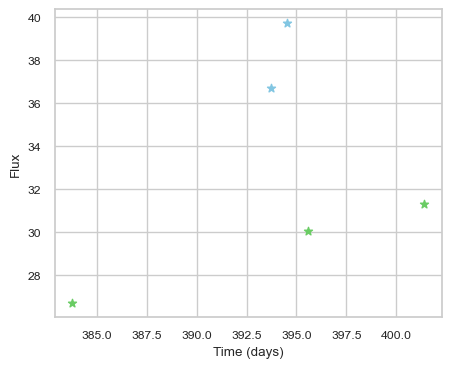

SNIax (4.058873, False)
SNIax (3.1195898, False)
SNIax (3.4332747, False)
SNIax (2.9433155, False)
SNIax (3.2624388, False)
SNIax (2.9065015, False)
SNIax (3.234622, False)
SNIax (2.602018, False)
SNIax (3.0586085, False)
SNIax (2.2987201, False)


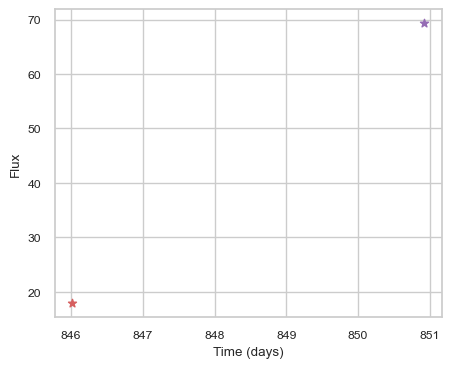

SNIax (4.0451612, False)
SNIax (4.394222, False)
SNIax (3.8493571, False)
SNIax (4.539123, False)


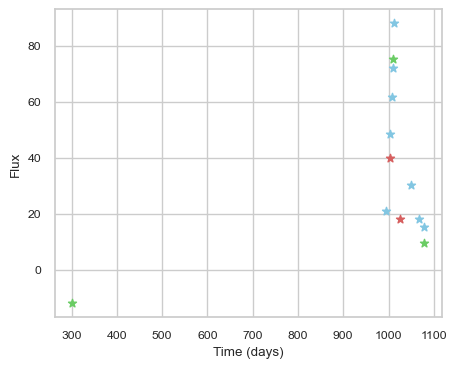

SNIax (3.9308915, False)
SNIax (4.2694716, False)
SNIax (4.015319, False)
SNIax (3.5148556, False)
SNIax (3.1868541, False)
SNIax (3.6096618, False)
SNIax (3.1059937, False)
SNIax (2.9806216, False)
SNIax (3.444499, False)
SNIax (2.7708175, False)
SNIax (2.749839, False)
SNIax (2.3531935, False)
SNIax (3.267814, False)
SNIax (2.8760197, False)
SNIax (3.5481782, False)
SNIax (3.3942065, False)
SNIax (3.5867205, False)
SNIax (3.0477872, False)
SNIax (4.0541573, False)
SNIax (3.363352, False)
SNIax (3.1368146, False)
SNIax (3.1676834, False)
SNIax (2.7615187, False)
SNIax (3.0863402, False)
SNIax (2.5106962, False)
SNIax (2.8707511, False)


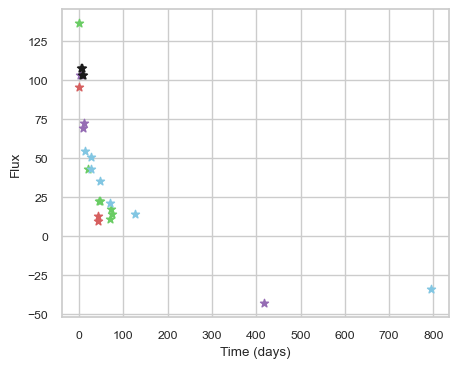

SNIax (4.4221787, False)
SNIax (5.6820602, False)
SNIax (5.5198803, False)
SNIax (5.810486, False)
SNIax (5.6217546, False)
SNIax (5.814958, False)
SNIax (5.4697776, False)
SNIax (5.552725, False)
SNIax (4.8967195, False)
SNIax (5.8668146, False)
SNIax (4.611315, False)
SNIax (6.03057, False)
SNIax (4.5379252, False)
SNIax (5.478608, False)
SNIax (4.445447, False)
SNIax (5.6473975, False)
SNIax (4.1850142, False)
SNIax (4.7958817, False)
SNIax (4.2638164, False)
SNIax (4.5732064, False)
SNIax (4.426529, False)
SNIax (4.74062, False)
SNIax (4.427131, False)
SNIax (4.394851, False)
SNIax (4.631292, False)
SNIax (4.799866, False)
SNIax (5.1186438, False)
SNIax (5.4564075, False)
SNIax (4.614104, False)
SNIax (5.0585456, False)
SNIax (4.866154, False)
SNIax (4.889239, False)
SNIax (4.4910254, False)
SNIax (4.784812, False)
SNIax (5.046811, False)
SNIax (5.6807265, False)
SNIax (4.8920236, False)
SNIax (4.726528, False)
SNIax (4.9354076, False)
SNIax (4.815513, False)
SNIax (5.0477104, Fals

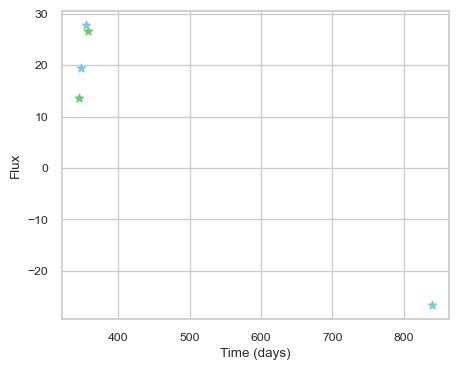

SNIax (4.059943, False)
SNIax (3.5656757, False)
SNIax (3.499673, False)
SNIax (3.075464, False)
SNIax (3.0099196, False)
SNIax (2.8659651, False)
SNIax (3.0763786, False)
SNIax (2.8498333, False)
SNIax (3.6086516, False)
SNIax (3.2194376, False)


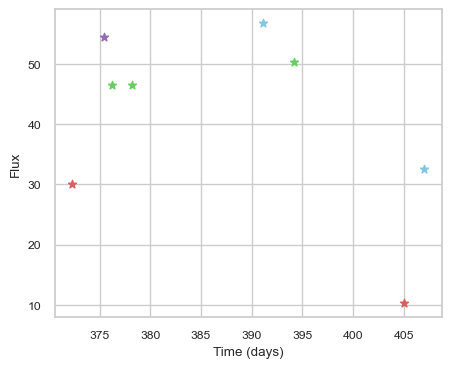

SNIax (3.8482008, False)
SNIax (4.8007126, False)
SNIax (4.338166, False)
SNIax (3.537918, False)
SNIax (4.7292047, False)
SNIax (3.5020912, False)
SNIax (4.207196, False)
SNIax (4.0770283, False)
SNIax (3.7518725, False)
SNIax (3.9817214, False)
SNIax (3.9986258, False)
SNIax (4.326885, False)
SNIax (4.8496194, False)
SNIax (4.985515, False)
SNIax (4.7053146, False)
SNIax (4.190193, False)


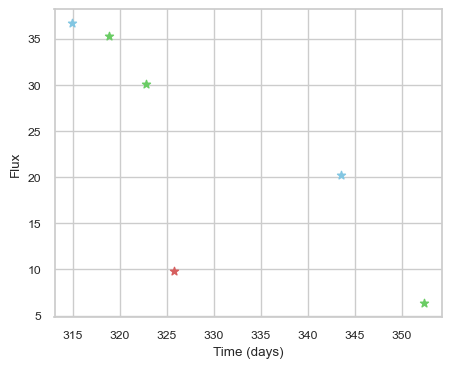

SNIax (3.9848552, False)
SNIax (4.201298, False)
SNIax (3.800335, False)
SNIax (3.6423328, False)
SNIax (3.7376869, False)
SNIax (3.6608412, False)
SNIax (4.3458834, False)
SNIax (3.5008407, False)
SNIax (3.5474534, False)
SNIax (3.1662214, False)
SNIax (4.0472345, False)
SNIax (3.7218814, False)


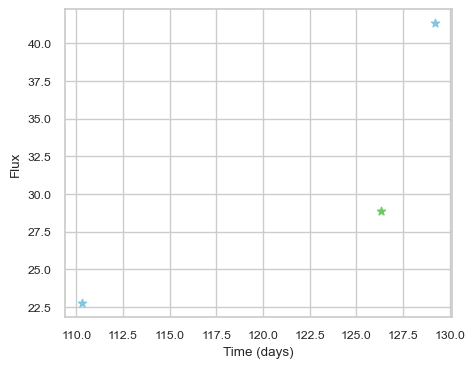

SNIax (5.0497165, False)
SNIax (4.7348824, False)
SNIax (4.8049984, False)
SNIax (4.471361, False)
SNIax (4.237331, False)
SNIax (4.032341, False)


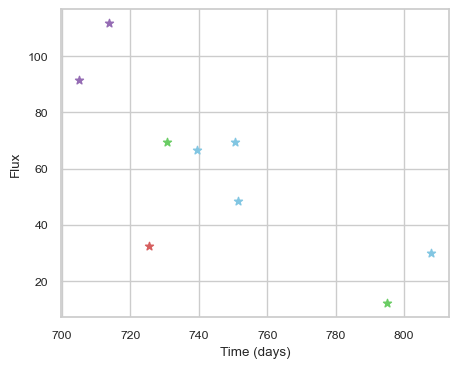

SNIax (3.8795688, False)
SNIax (4.0653024, False)
SNIax (5.40364, False)
SNIax (5.604864, False)
SNIax (6.549194, False)
SNIax (6.7390046, False)
SNIax (6.909865, False)
SNIax (6.622795, False)
SNIax (6.6856, False)
SNIax (6.5634766, False)
SNIax (6.7133884, False)
SNIax (6.315651, False)
SNIax (6.093978, False)
SNIax (6.2741795, False)
SNIax (6.696223, False)
SNIax (6.0577235, False)
SNIax (5.8450375, False)
SNIax (5.742752, False)


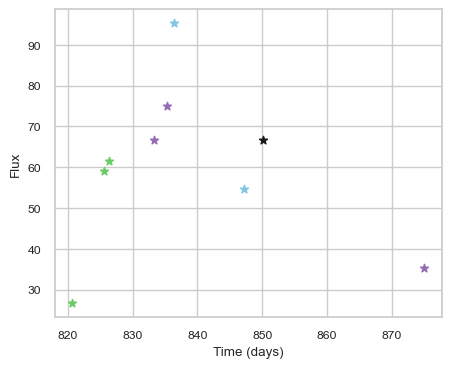

SNIax (3.9070911, False)
SNIax (3.3020988, False)
SNIax (3.3281958, False)
SNIax (3.9240263, False)
SNIax (4.014222, False)
SNIax (4.380408, False)
SNIax (4.653165, False)
SNIax (4.740724, False)
SNIax (5.075791, False)
SNIax (4.478769, False)
SNIax (5.326579, False)
SNIax (5.196487, False)
SNIax (5.3581085, False)
SNIax (4.853746, False)
SNIax (4.9543214, False)
SNIax (5.1077185, False)
SNIax (5.186116, False)
SNIax (4.7170744, False)


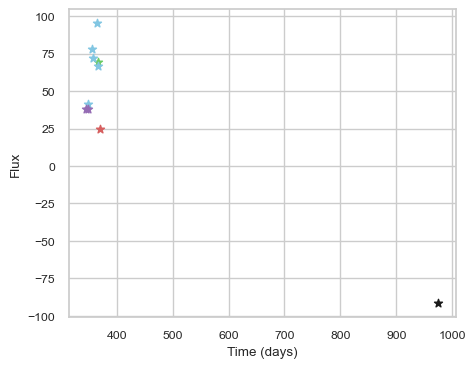

SNIax (3.9176905, False)
SNIax (3.318943, False)
SNIax (3.5693212, False)
SNIax (3.2756479, False)
SNIax (3.8723361, False)
SNIax (3.3894436, False)
SNIax (3.6251938, False)
SNIax (3.5161479, False)
SNIax (3.5581458, False)
SNIax (3.2106135, False)
SNIax (3.2194889, False)
SNIax (3.0341113, False)
SNIax (3.469286, False)
SNIax (2.5819685, False)
SNIax (3.031333, False)
SNIax (3.0033007, False)
SNIax (3.0523274, False)
SNIax (3.343958, False)
SNIax (3.5675066, False)
SNIax (3.5718243, False)


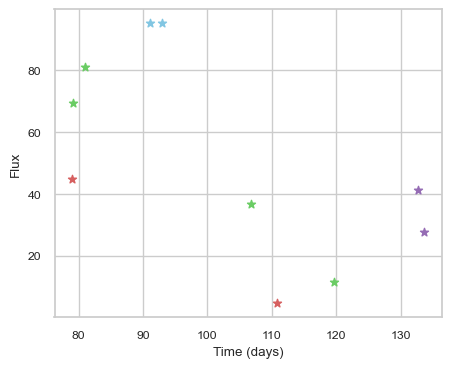

SNIax (4.158963, False)
SNIax (4.8412714, False)
SNIax (5.605323, False)
SNIax (4.3605676, False)
SNIax (4.8661904, False)
SNIax (4.9061503, False)
SNIax (5.623682, False)
SNIax (4.92506, False)
SNIax (5.2223067, False)
SNIax (4.9602933, False)
SNIax (5.3109303, False)
SNIax (4.949369, False)
SNIax (5.588535, False)
SNIax (5.288241, False)
SNIax (5.802172, False)
SNIax (4.7928967, False)
SNIax (5.0849113, False)
SNIax (4.845753, False)
SNIax (5.674527, False)
SNIax (4.6762605, False)


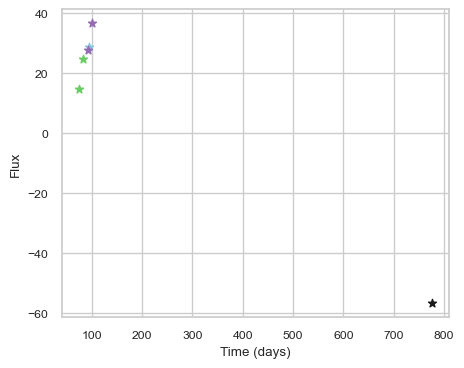

SNIax (5.104535, False)
SNIax (4.542859, False)
SNIax (4.228076, False)
SNIax (4.3022447, False)
SNIax (3.8635721, False)
SNIax (4.1089725, False)
SNIax (3.9291184, False)
SNIax (3.8617222, False)
SNIax (3.820864, False)
SNIax (3.7805812, False)
SNIax (4.4919157, False)
SNIax (4.6325917, False)


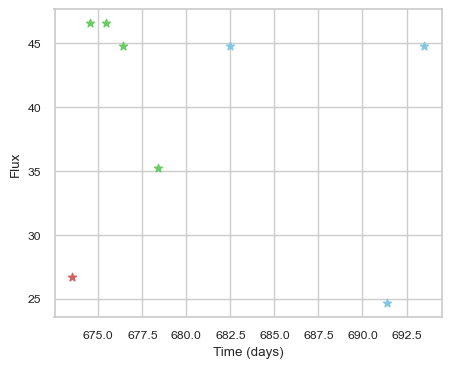

SNIax (3.8930488, False)
SNIax (4.3538313, False)
SNIax (4.415045, False)
SNIax (3.1634235, False)
SNIax (3.2177956, False)
SNIax (2.9393642, False)
SNIax (2.8908987, False)
SNIax (2.6068935, False)
SNIax (2.8866937, False)
SNIax (2.2716937, False)
SNIax (2.5862212, False)
SNIax (2.1896157, False)
SNIax (2.339375, False)
SNIax (2.415229, False)
SNIax (2.4792278, False)
SNIax (2.2182589, False)


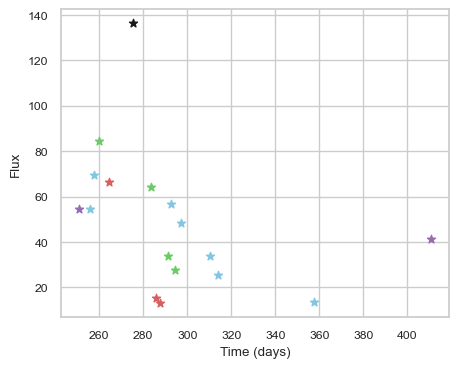

SNIax (3.7982805, False)
SNIax (3.4732056, False)
SNIax (3.2444234, False)
SNIax (3.398908, False)
SNIax (3.2861838, False)
SNIax (3.4893343, False)
SNIax (3.6096158, False)
SNIax (2.8534598, False)
SNIax (3.3058572, False)
SNIax (3.1265826, False)
SNIax (3.5699532, False)
SNIax (2.8439763, False)
SNIax (3.341275, False)
SNIax (3.0552468, False)
SNIax (3.6204674, False)
SNIax (2.7766645, False)
SNIax (3.9351513, False)
SNIax (2.9830785, False)
SNIax (3.748789, False)
SNIax (3.7974994, False)
SNIax (3.6823318, False)
SNIax (3.8164442, False)
SNIax (4.2625413, False)
SNIax (3.8135798, False)
SNIax (3.8567374, False)
SNIax (3.695727, False)
SNIax (3.6887796, False)
SNIax (4.045786, False)
SNIax (2.8798847, False)
SNIax (3.672681, False)
SNIax (3.8278718, False)
SNIax (2.9836485, False)
SNIax (4.026683, False)
SNIax (3.385364, False)


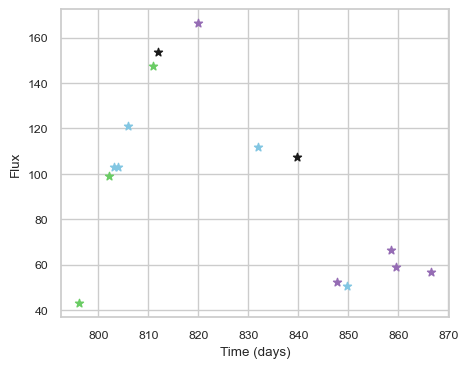

SNIax (3.7632802, False)
SNIax (3.501465, False)
SNIax (3.3955057, False)
SNIax (4.0015016, False)
SNIax (4.222938, False)
SNIax (4.060405, False)
SNIax (4.4158716, False)
SNIax (4.031991, False)
SNIax (3.866325, False)
SNIax (3.9971669, False)
SNIax (3.8415132, False)
SNIax (3.9850233, False)
SNIax (4.008786, False)
SNIax (4.165538, False)
SNIax (3.5966575, False)
SNIax (2.8638473, False)
SNIax (3.279412, False)
SNIax (2.5904052, False)
SNIax (3.3051171, False)
SNIax (3.214294, False)
SNIax (3.6774335, False)
SNIax (2.9807339, False)
SNIax (4.070073, False)
SNIax (2.978017, False)
SNIax (3.5969427, False)
SNIax (3.2894561, False)
SNIax (4.0055776, False)
SNIax (3.545969, False)
SNIax (3.5604193, False)
SNIax (3.4985056, False)


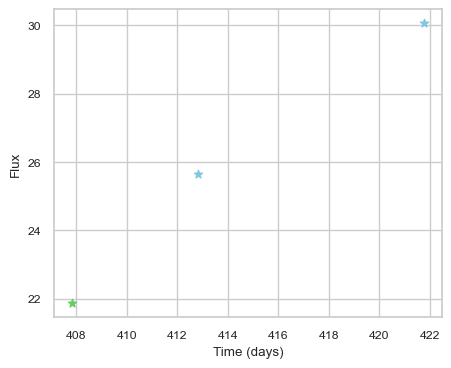

SNIax (4.0782485, False)
SNIax (3.4338365, False)
SNIax (3.7143118, False)
SNIax (3.3635094, False)
SNIax (3.5403037, False)
SNIax (3.859094, False)


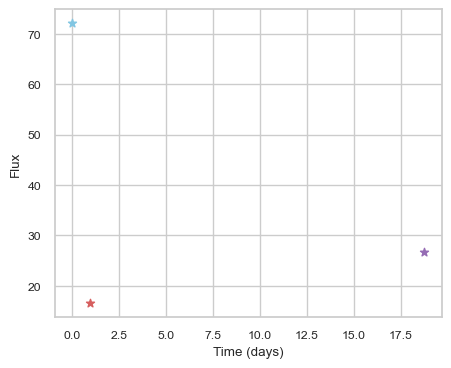

SNIax (4.3996983, False)
SNIax (4.7211027, False)
SNIax (4.538315, False)
SNIax (5.3983393, False)
SNIax (5.3467116, False)


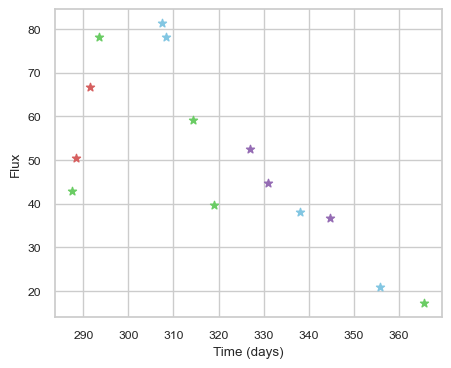

SNIax (3.7836232, False)
SNIax (4.1262712, False)
SNIax (3.5851643, False)
SNIax (4.236238, False)
SNIax (3.9412313, False)
SNIax (3.9352872, False)
SNIax (3.7972229, False)
SNIax (3.6054559, False)
SNIax (3.368406, False)
SNIax (3.146143, False)
SNIax (3.4646857, False)
SNIax (3.4219506, False)
SNIax (3.7885516, False)
SNIax (3.8954344, False)
SNIax (3.9699187, False)
SNIax (3.9010515, False)
SNIax (3.955533, False)
SNIax (4.3986287, False)
SNIax (3.449114, False)
SNIax (4.059886, False)
SNIax (3.2161894, False)
SNIax (3.001491, False)
SNIax (3.121001, False)
SNIax (3.2831235, False)
SNIax (3.371421, False)
SNIax (2.7825894, False)
SNIax (2.4000401, False)
SNIax (3.0882008, False)


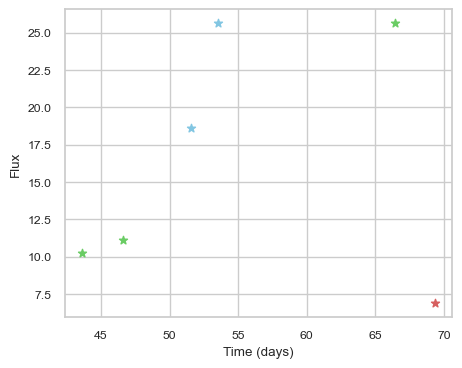

SNIax (4.158656, False)
SNIax (3.5214813, False)
SNIax (3.5383375, False)
SNIax (3.412175, False)
SNIax (3.0877404, False)
SNIax (3.3353665, False)
SNIax (2.9815187, False)
SNIax (3.420716, False)
SNIax (3.2149963, False)
SNIax (3.5222423, False)
SNIax (3.8848383, False)
SNIax (3.0585067, False)


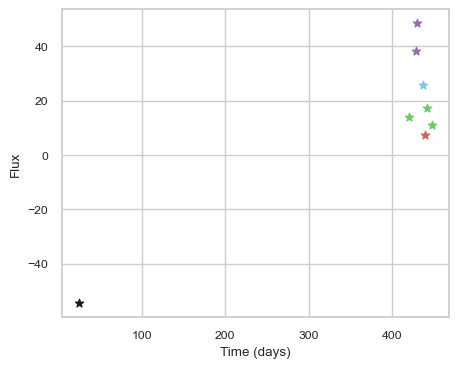

SNIax (3.9701557, False)
SNIax (3.6869502, False)
SNIax (3.895581, False)
SNIax (3.3513465, False)
SNIax (3.4311879, False)
SNIax (2.9762092, False)
SNIax (3.2640853, False)
SNIax (2.6399703, False)
SNIax (2.8630524, False)
SNIax (2.6712592, False)
SNIax (2.8357246, False)
SNIax (2.594047, False)
SNIax (2.7841954, False)
SNIax (2.824768, False)
SNIax (2.9584959, False)
SNIax (2.9492826, False)


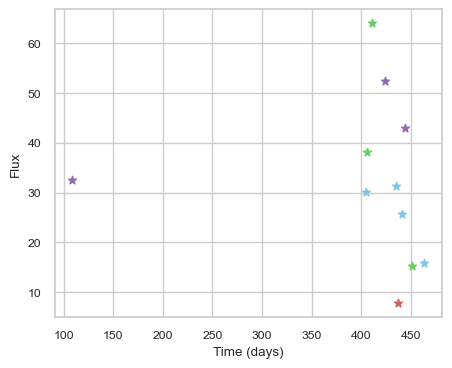

SNIax (3.8545618, False)
SNIax (3.752824, False)
SNIax (3.6789587, False)
SNIax (3.688779, False)
SNIax (3.3955016, False)
SNIax (2.941292, False)
SNIax (3.2093666, False)
SNIax (3.1029513, False)
SNIax (2.8723726, False)
SNIax (2.1561925, False)
SNIax (2.100068, False)
SNIax (1.9998565, False)
SNIax (2.0114124, False)
SNIax (1.9488318, False)
SNIax (1.9950545, False)
SNIax (2.042296, False)
SNIax (2.2372336, False)
SNIax (2.225336, False)
SNIax (1.9189687, False)
SNIax (2.2452796, False)
SNIax (2.3497481, False)
SNIax (2.1387525, False)


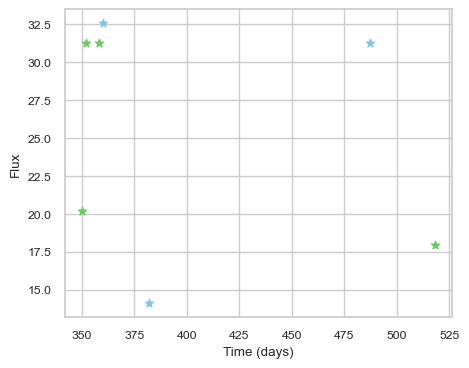

SNIax (3.8045192, False)
SNIax (3.7252321, False)
SNIax (3.482449, False)
SNIax (3.053933, False)
SNIax (2.8150249, False)
SNIax (3.3944414, False)
SNIax (3.6201084, False)
SNIax (3.1587808, False)
SNIax (4.5958586, False)
SNIax (4.5883203, False)
SNIax (4.2566805, False)
SNIax (4.178278, False)
SNIax (5.777236, False)
SNIax (5.455781, False)


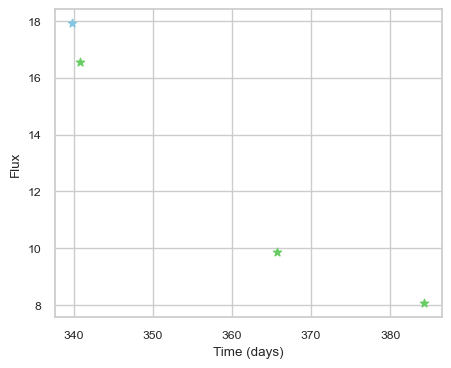

SNIax (3.842419, False)
SNIax (3.6897027, False)
SNIax (3.2796912, False)
SNIax (3.3907053, False)
SNIax (3.3378375, False)
SNIax (3.6117227, False)
SNIax (3.7344232, False)
SNIax (3.828481, False)


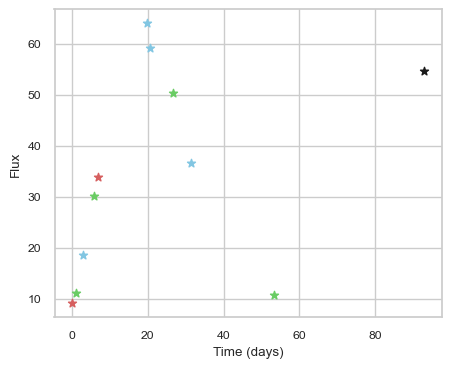

SNIax (4.27577, False)
SNIax (3.8144376, False)
SNIax (4.1054106, False)
SNIax (3.8939924, False)
SNIax (3.6285858, False)
SNIax (4.209445, False)
SNIax (3.1060693, False)
SNIax (3.810006, False)
SNIax (4.1634593, False)
SNIax (3.8811564, False)
SNIax (3.5739927, False)
SNIax (4.3539762, False)
SNIax (3.6405623, False)
SNIax (3.7197185, False)
SNIax (3.3275747, False)
SNIax (3.789267, False)
SNIax (3.441179, False)
SNIax (3.2654233, False)
SNIax (3.2844841, False)
SNIax (3.179032, False)
SNIax (3.040075, False)


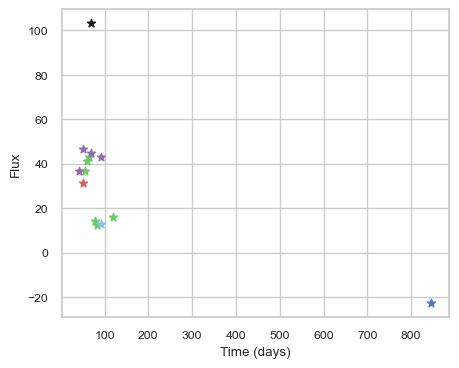

SNIax (3.989918, False)
SNIax (3.7129064, False)
SNIax (3.2937393, False)
SNIax (3.5175068, False)
SNIax (3.8131797, False)
SNIax (4.087156, False)
SNIax (4.35185, False)
SNIax (4.0431356, False)
SNIax (4.897199, False)
SNIax (4.624459, False)
SNIax (4.6320786, False)
SNIax (4.5449815, False)
SNIax (4.678245, False)
SNIax (5.1811733, False)
SNIax (5.071979, False)
SNIax (4.970798, False)
SNIax (4.200317, False)
SNIax (4.4899397, False)
SNIax (3.5955503, False)
SNIax (3.2811997, False)
SNIax (2.8850882, False)
SNIax (3.174179, False)
SNIax (2.8899019, False)
SNIax (3.327184, False)
SNIax (4.4320188, False)
SNIax (3.8778083, False)
SNIax (4.0534816, False)
SNIax (5.9155974, False)


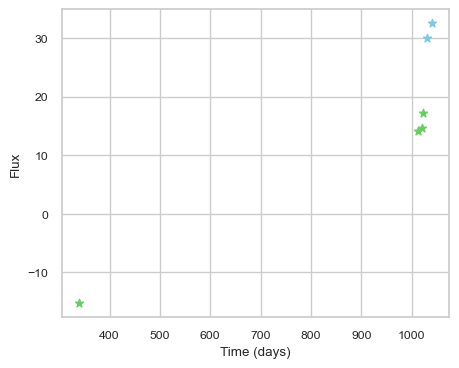

SNIax (5.1969876, False)
SNIax (4.9489126, False)
SNIax (5.3930964, False)
SNIax (5.0322165, False)
SNIax (4.7048845, False)
SNIax (4.8024344, False)
SNIax (4.416059, False)
SNIax (4.300209, False)
SNIax (4.222786, False)
SNIax (5.3738127, False)
SNIax (5.055701, False)
SNIax (5.869835, False)


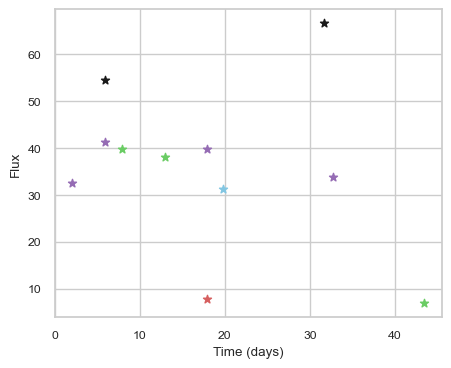

SNIax (4.3867188, False)
SNIax (4.204809, False)
SNIax (3.6976185, False)
SNIax (3.417441, False)
SNIax (3.129689, False)
SNIax (3.5891035, False)
SNIax (2.9269292, False)
SNIax (3.169916, False)
SNIax (3.289248, False)
SNIax (3.168225, False)
SNIax (3.3224201, False)
SNIax (3.148595, False)
SNIax (3.4410567, False)
SNIax (2.2040992, False)
SNIax (3.1575594, False)
SNIax (2.166358, False)
SNIax (2.9015346, False)
SNIax (2.3514743, False)
SNIax (3.2472339, False)
SNIax (2.7679727, False)
SNIax (3.161237, False)
SNIax (2.7749414, False)


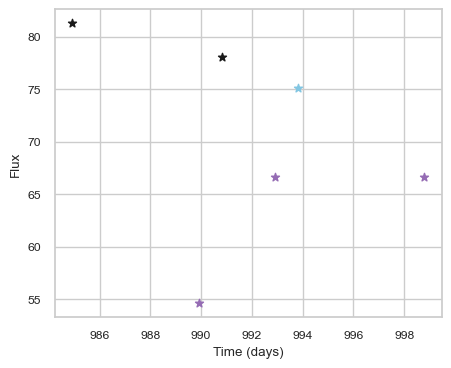

SNIax (3.9917996, False)
SNIax (3.8798594, False)
SNIax (4.177647, False)
SNIax (3.8977258, False)
SNIax (4.251114, False)
SNIax (4.38562, False)
SNIax (4.8987193, False)
SNIax (4.003227, False)
SNIax (4.60867, False)
SNIax (4.9562497, False)
SNIax (5.9723697, False)
SNIax (4.7651567, False)


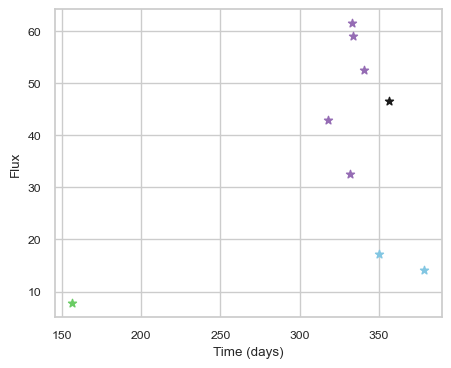

SNIax (3.7657437, False)
SNIax (3.7028642, False)
SNIax (3.361634, False)
SNIax (3.4107141, False)
SNIax (3.3460684, False)
SNIax (3.432043, False)
SNIax (3.6364076, False)
SNIax (3.8798108, False)
SNIax (4.480987, False)
SNIax (4.188884, False)
SNIax (3.6246202, False)
SNIax (4.382927, False)
SNIax (3.7545516, False)
SNIax (4.0674276, False)
SNIax (2.904787, False)
SNIax (3.7989776, False)
SNIax (3.9448833, False)
SNIax (4.0615134, False)


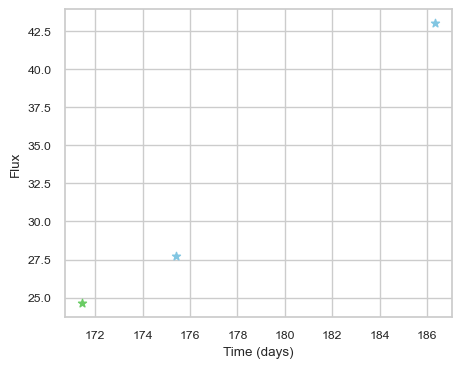

SNIax (4.034631, False)
SNIax (4.161421, False)
SNIax (3.720322, False)
SNIax (3.739178, False)
SNIax (3.7013178, False)
SNIax (3.8405101, False)


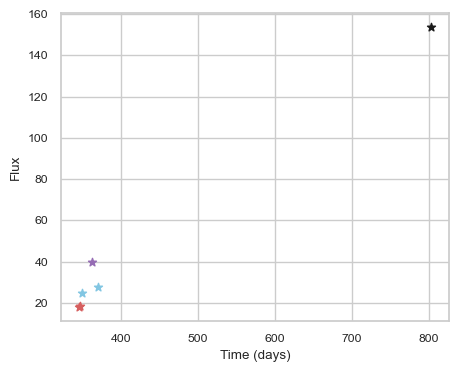

SNIax (3.8914242, False)
SNIax (4.085919, False)
SNIax (4.358376, False)
SNIax (4.516987, False)
SNIax (3.755974, False)
SNIax (4.2841396, False)
SNIax (4.27067, False)
SNIax (3.9283628, False)
SNIax (3.410992, False)
SNIax (4.4920607, False)
SNIax (4.4467106, False)
SNIax (4.3086767, False)


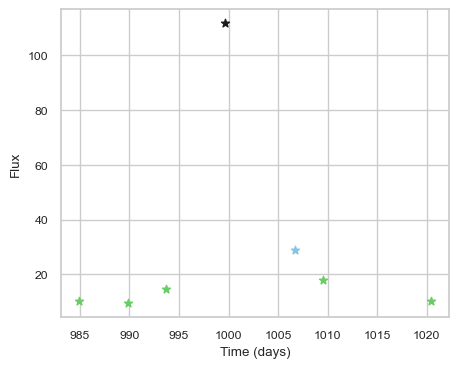

SNIax (4.3997264, False)
SNIax (4.0116014, False)
SNIax (3.587769, False)
SNIax (3.4550183, False)
SNIax (3.6138885, False)
SNIax (3.0791216, False)
SNIax (2.8226895, False)
SNIax (3.181786, False)
SNIax (2.616846, False)
SNIax (2.735148, False)
SNIax (2.394981, False)
SNIax (2.4573965, False)
SNIax (2.451608, False)
SNIax (2.4207327, False)


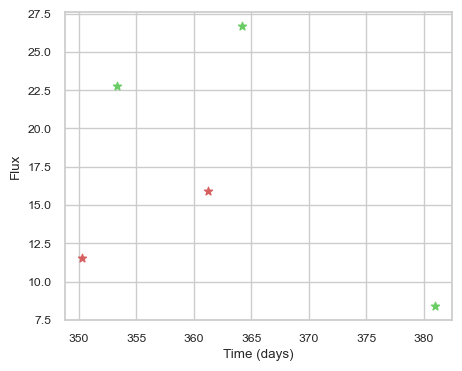

SNIax (3.8837717, False)
SNIax (3.7115128, False)
SNIax (3.2432811, False)
SNIax (2.9282277, False)
SNIax (3.4371674, False)
SNIax (3.1806126, False)
SNIax (3.281861, False)
SNIax (3.0371468, False)
SNIax (3.870259, False)
SNIax (3.20803, False)


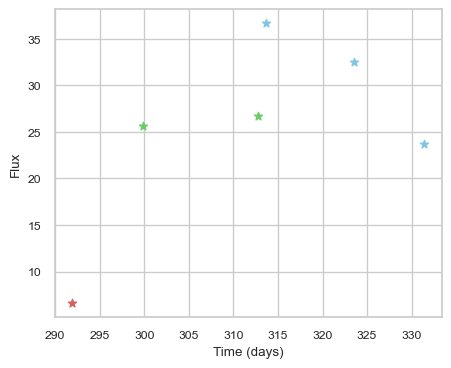

SNIax (4.1176157, False)
SNIax (4.5674005, False)
SNIax (3.7322114, False)
SNIax (3.6194572, False)
SNIax (3.406842, False)
SNIax (3.0741282, False)
SNIax (3.4412944, False)
SNIax (3.1376436, False)
SNIax (2.8299763, False)
SNIax (2.9103508, False)
SNIax (2.9910145, False)
SNIax (3.023055, False)


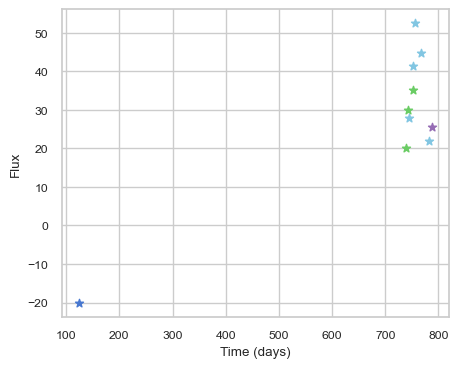

SNIax (4.255509, False)
SNIax (4.5172844, False)
SNIax (3.8865457, False)
SNIax (2.9392245, False)
SNIax (3.492002, False)
SNIax (2.4508874, False)
SNIax (2.9435527, False)
SNIax (2.6481984, False)
SNIax (2.6658962, False)
SNIax (2.6176586, False)
SNIax (3.0098076, False)
SNIax (2.1535602, False)
SNIax (2.7829537, False)
SNIax (2.8001132, False)
SNIax (2.9163232, False)
SNIax (3.1570368, False)
SNIax (3.0016606, False)
SNIax (2.9717977, False)
SNIax (2.7178268, False)
SNIax (3.1914313, False)


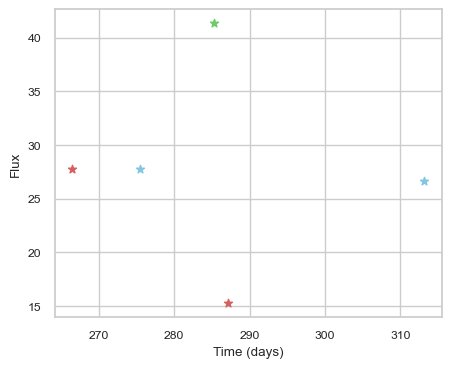

SNIax (3.4300969, False)
SNIax (4.486506, False)
SNIax (3.3187456, False)
SNIax (4.5967956, False)
SNIax (4.9485188, False)
SNIax (5.5078263, False)
SNIax (5.3283777, False)
SNIax (5.753412, False)
SNIax (6.246991, False)
SNIax (6.0400944, False)


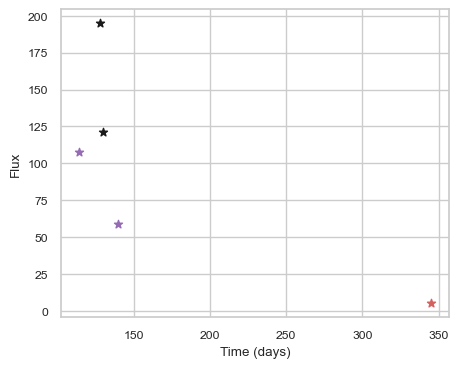

SNIax (3.7846055, False)
SNIax (4.158036, False)
SNIax (3.8191447, False)
SNIax (3.6626036, False)
SNIax (3.9837742, False)
SNIax (3.6486552, False)
SNIax (3.5575092, False)
SNIax (3.7233944, False)
SNIax (3.8954067, False)
SNIax (4.121933, False)


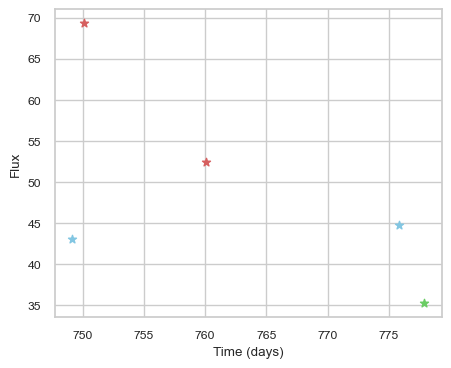

SNIax (3.7717686, False)
SNIax (3.4775627, False)
SNIax (3.325236, False)
SNIax (3.9957228, False)
SNIax (3.8143575, False)
SNIax (3.9738605, False)
SNIax (4.621366, False)
SNIax (5.603025, False)
SNIax (5.604864, False)
SNIax (5.9729505, False)


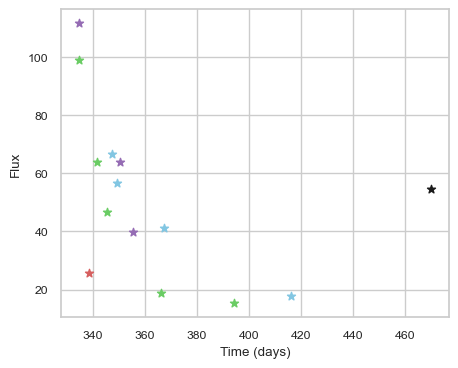

SNIax (3.8861942, False)
SNIax (4.1344805, False)
SNIax (5.1397305, False)
SNIax (5.943224, False)
SNIax (5.019739, False)
SNIax (5.3807817, False)
SNIax (5.7349176, False)
SNIax (5.1169767, False)
SNIax (5.518443, False)
SNIax (5.0423613, False)
SNIax (5.5399294, False)
SNIax (4.9686027, False)
SNIax (5.190172, False)
SNIax (5.111488, False)
SNIax (5.141837, False)
SNIax (5.1668353, False)
SNIax (5.176317, False)
SNIax (4.7055054, False)
SNIax (4.963785, False)
SNIax (4.821071, False)
SNIax (4.832915, False)
SNIax (4.8140364, False)
SNIax (4.8578486, False)
SNIax (4.9838653, False)
SNIax (4.7649374, False)
SNIax (5.182286, False)
SNIax (5.184991, False)


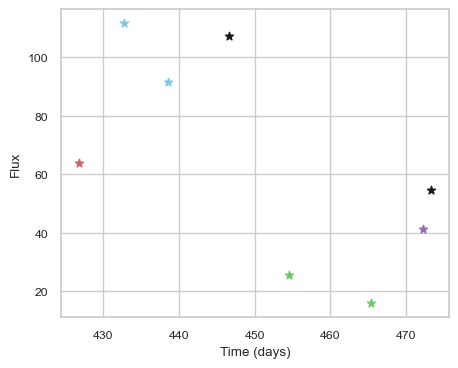

SNIax (4.0048156, False)
SNIax (5.033917, False)
SNIax (4.658332, False)
SNIax (4.7052226, False)
SNIax (5.1638007, False)
SNIax (4.3272505, False)
SNIax (4.684892, False)
SNIax (5.323185, False)
SNIax (3.751552, False)
SNIax (4.553828, False)
SNIax (4.885473, False)
SNIax (4.794285, False)
SNIax (4.8368363, False)
SNIax (4.580026, False)
SNIax (5.278179, False)
SNIax (4.743321, False)


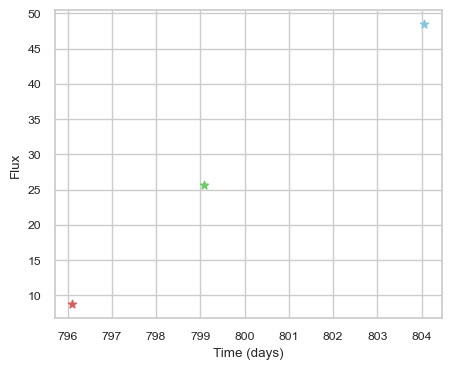

SNIax (4.342486, False)
SNIax (4.1082134, False)
SNIax (3.8778894, False)
SNIax (3.3130293, False)
SNIax (3.5539758, False)
SNIax (4.2725897, False)


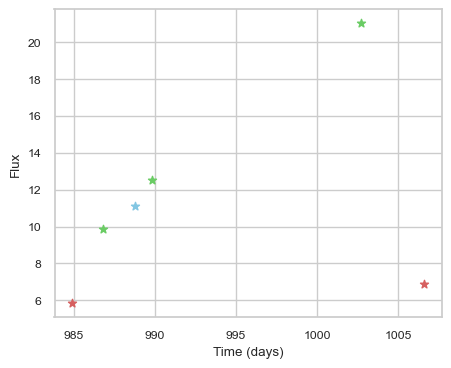

SNIax (4.146778, False)
SNIax (4.469873, False)
SNIax (3.2309809, False)
SNIax (3.6501405, False)
SNIax (3.6879778, False)
SNIax (3.544938, False)
SNIax (3.155318, False)
SNIax (3.320985, False)
SNIax (2.9723103, False)
SNIax (2.7746017, False)
SNIax (3.0159163, False)
SNIax (3.3747635, False)


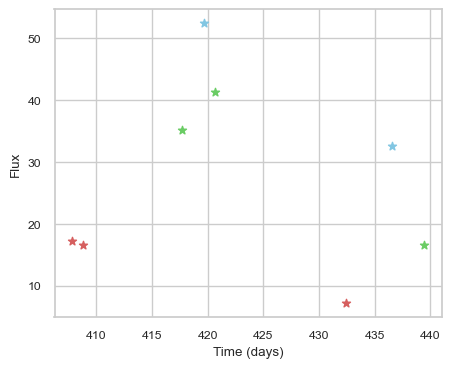

SNIax (3.9173176, False)
SNIax (4.4230914, False)
SNIax (4.459942, False)
SNIax (3.8937411, False)
SNIax (3.6394155, False)
SNIax (2.9149563, False)
SNIax (3.6287525, False)
SNIax (4.1525927, False)
SNIax (4.555522, False)
SNIax (4.1215925, False)
SNIax (4.029629, False)
SNIax (4.032609, False)
SNIax (3.6262727, False)
SNIax (3.1034267, False)
SNIax (2.8232856, False)
SNIax (2.8335924, False)


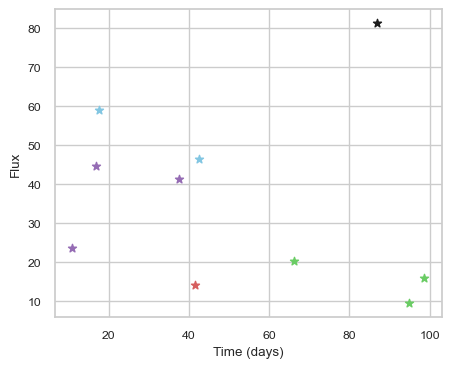

SNIax (4.087071, False)
SNIax (3.8021197, False)
SNIax (3.110118, False)
SNIax (3.2806928, False)
SNIax (3.814767, False)
SNIax (3.258319, False)
SNIax (3.5467944, False)
SNIax (2.7166262, False)
SNIax (3.0822318, False)
SNIax (2.3706906, False)
SNIax (3.2369153, False)
SNIax (2.2670608, False)
SNIax (2.939415, False)
SNIax (3.0800662, False)
SNIax (3.0813742, False)
SNIax (3.3805087, False)
SNIax (4.5665307, False)
SNIax (4.231833, False)
SNIax (3.6330328, False)
SNIax (4.024993, False)


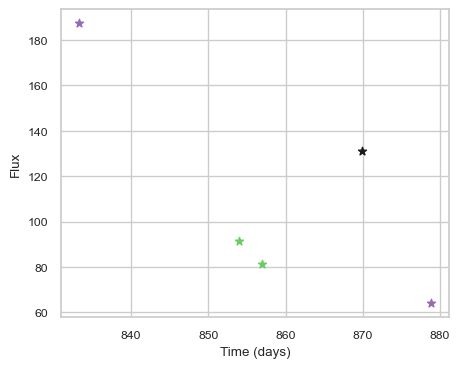

SNIax (3.6077409, False)
SNIax (3.4936666, False)
SNIax (3.1799073, False)
SNIax (3.7669938, False)
SNIax (3.6965196, False)
SNIax (3.8472648, False)
SNIax (3.319021, False)
SNIax (3.9634242, False)
SNIax (3.7007523, False)
SNIax (3.6727612, False)


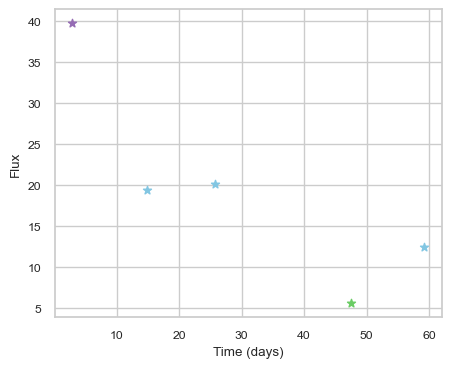

SNIax (4.297333, False)
SNIax (4.32062, False)
SNIax (3.3640764, False)
SNIax (3.1298556, False)
SNIax (3.1417356, False)
SNIax (3.385434, False)
SNIax (4.388114, False)
SNIax (4.468125, False)
SNIax (4.3465486, False)
SNIax (3.580005, False)


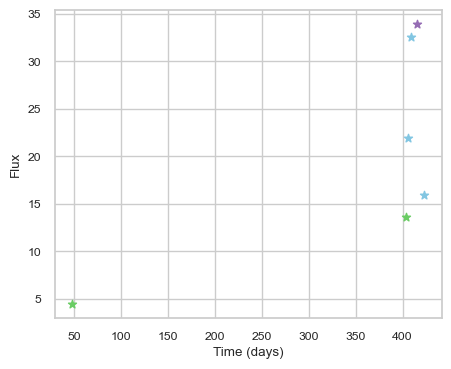

SNIax (5.786821, False)
SNIax (5.289073, False)
SNIax (5.265879, False)
SNIax (4.4754214, False)
SNIax (4.570919, False)
SNIax (4.6111474, False)
SNIax (4.702398, False)
SNIax (5.2698727, False)
SNIax (5.276692, False)
SNIax (5.198603, False)
SNIax (5.2727003, False)
SNIax (5.3165574, False)


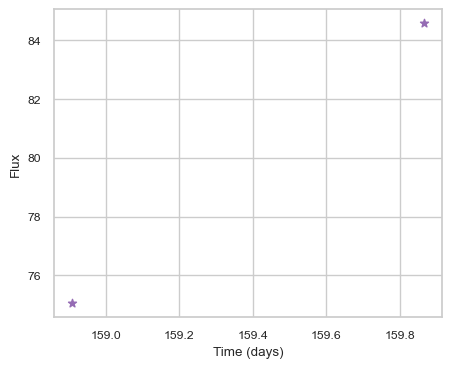

SNIax (3.892132, False)
SNIax (4.6020565, False)
SNIax (5.2148714, False)
SNIax (5.2481894, False)


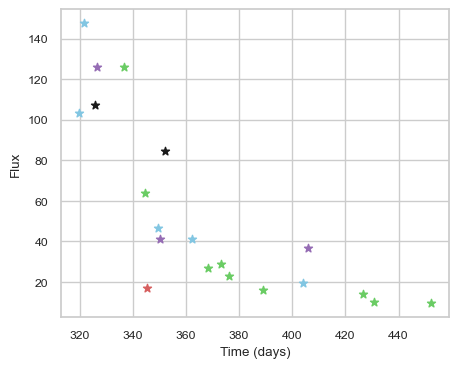

SNIax (3.774445, False)
SNIax (3.9826603, False)
SNIax (3.9709122, False)
SNIax (3.9858134, False)
SNIax (3.8750987, False)
SNIax (3.8601012, False)
SNIax (4.2522383, False)
SNIax (2.877057, False)
SNIax (2.812807, False)
SNIax (2.7891715, False)
SNIax (2.9197562, False)
SNIax (3.4057508, False)
SNIax (3.2004814, False)
SNIax (3.4497762, False)
SNIax (4.304575, False)
SNIax (3.930856, False)
SNIax (3.597447, False)
SNIax (3.7983267, False)
SNIax (4.169358, False)
SNIax (4.3408933, False)
SNIax (3.395741, False)
SNIax (3.5867608, False)
SNIax (3.6237113, False)
SNIax (3.500433, False)
SNIax (3.6172247, False)
SNIax (3.8367813, False)
SNIax (3.2694566, False)
SNIax (3.8638682, False)
SNIax (3.2441764, False)
SNIax (3.412106, False)
SNIax (3.1841888, False)
SNIax (3.372586, False)
SNIax (3.243422, False)
SNIax (3.67224, False)
SNIax (3.8803737, False)
SNIax (3.8868136, False)
SNIax (3.914731, False)
SNIax (3.6326296, False)
SNIax (4.058885, False)
SNIax (3.3986003, False)


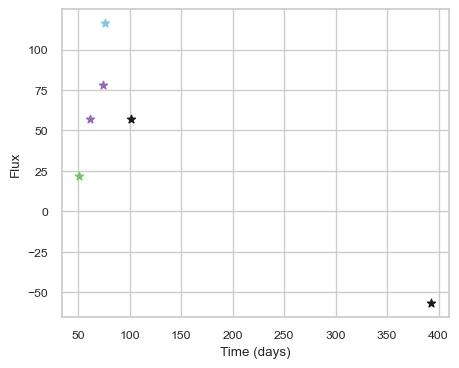

SNIax (3.8870094, False)
SNIax (3.6414137, False)
SNIax (3.4835753, False)
SNIax (2.4513805, False)
SNIax (3.0346594, False)
SNIax (2.7166605, False)
SNIax (4.0187345, False)
SNIax (3.7435641, False)
SNIax (4.713606, False)
SNIax (4.6862965, False)
SNIax (4.5608115, False)
SNIax (3.9860728, False)


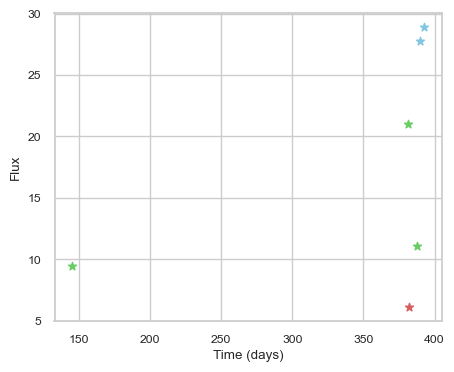

SNIax (5.3524046, False)
SNIax (4.507734, False)
SNIax (4.5843854, False)
SNIax (4.413002, False)
SNIax (4.250186, False)
SNIax (4.633044, False)
SNIax (4.10126, False)
SNIax (3.8240938, False)
SNIax (3.9154458, False)
SNIax (3.8335934, False)
SNIax (3.2548862, False)
SNIax (3.6011748, False)


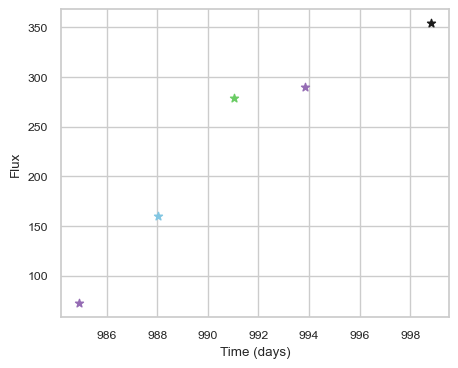

SNIax (3.6280627, False)
SNIax (3.7145534, False)
SNIax (3.3889682, False)
SNIax (3.4795258, False)
SNIax (3.0534775, False)
SNIax (3.121201, False)
SNIax (3.132716, False)
SNIax (2.3891234, False)
SNIax (2.879142, False)
SNIax (2.8248928, False)


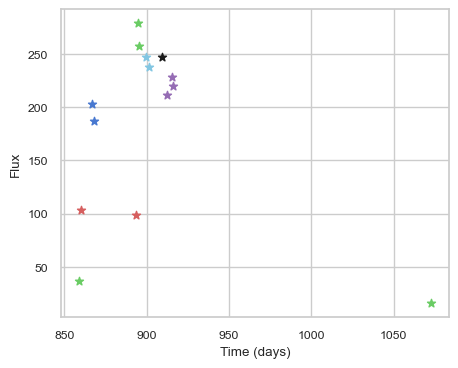

SNIax (3.5347838, False)
SNIax (3.8048723, False)
SNIax (3.3012016, False)
SNIax (3.9725456, False)
SNIax (3.4795902, False)
SNIax (4.8223286, False)
SNIax (2.9662895, False)
SNIax (4.083055, False)
SNIax (4.0485044, False)
SNIax (4.5080967, False)
SNIax (3.9772062, False)
SNIax (4.649719, False)
SNIax (3.1655076, False)
SNIax (3.726876, False)
SNIax (3.8430758, False)
SNIax (3.163016, False)
SNIax (3.0890753, False)
SNIax (3.1397533, False)
SNIax (2.8546152, False)
SNIax (3.4422138, False)
SNIax (3.845563, False)
SNIax (3.0495296, False)
SNIax (3.6534255, False)
SNIax (3.2306733, False)
SNIax (3.5939984, False)
SNIax (3.0961454, False)
SNIax (3.7248225, False)
SNIax (3.967648, False)


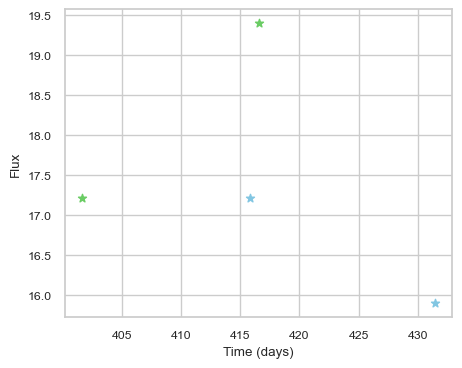

SNIax (3.781559, False)
SNIax (3.731439, False)
SNIax (3.142203, False)
SNIax (3.8455715, False)
SNIax (3.5883882, False)
SNIax (4.1240745, False)
SNIax (4.010489, False)
SNIax (4.2073708, False)


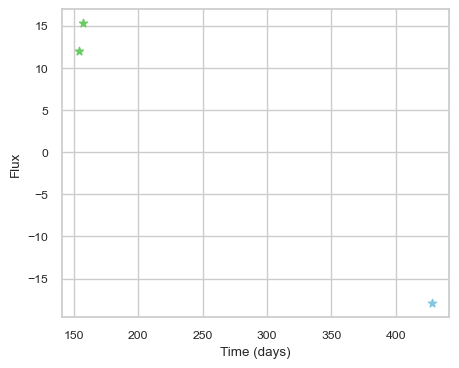

SNIax (4.028865, False)
SNIax (3.7427485, False)
SNIax (3.4649153, False)
SNIax (3.4268255, False)
SNIax (3.616725, False)
SNIax (5.74757, False)


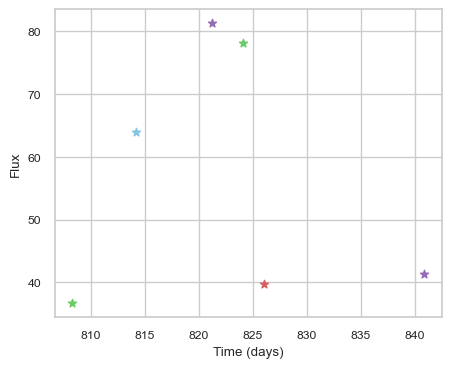

SNIax (3.989134, False)
SNIax (3.396407, False)
SNIax (3.5314221, False)
SNIax (4.3112545, False)
SNIax (4.8440876, False)
SNIax (5.1050253, False)
SNIax (5.408009, False)
SNIax (5.3689075, False)
SNIax (4.7582603, False)
SNIax (5.138398, False)
SNIax (5.256987, False)
SNIax (5.173916, False)


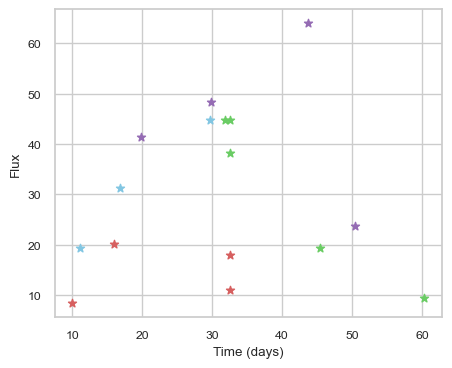

SNIax (4.000405, False)
SNIax (3.6962416, False)
SNIax (3.034539, False)
SNIax (2.9367316, False)
SNIax (2.5175004, False)
SNIax (2.6967838, False)
SNIax (2.7937562, False)
SNIax (2.8976305, False)
SNIax (3.1316316, False)
SNIax (2.8498387, False)
SNIax (3.4400508, False)
SNIax (4.1957765, False)
SNIax (3.79138, False)
SNIax (3.4391022, False)
SNIax (4.2683816, False)
SNIax (3.2936478, False)
SNIax (3.582451, False)
SNIax (3.3965895, False)
SNIax (3.9747891, False)
SNIax (3.3179772, False)
SNIax (3.5061314, False)
SNIax (3.4216423, False)
SNIax (3.6005852, False)
SNIax (3.7245233, False)
SNIax (4.09018, False)
SNIax (3.710246, False)
SNIax (3.5919476, False)
SNIax (3.9960115, False)
SNIax (2.8774796, False)
SNIax (2.7198117, False)


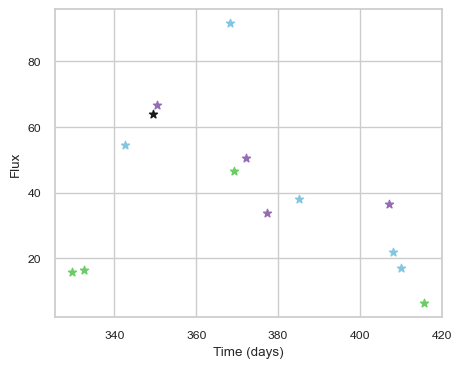

SNIax (4.0574994, False)
SNIax (3.7715712, False)
SNIax (3.634474, False)
SNIax (3.3553061, False)
SNIax (3.4247758, False)
SNIax (3.35818, False)
SNIax (3.531573, False)
SNIax (3.4516873, False)
SNIax (3.6174238, False)
SNIax (3.1981251, False)
SNIax (3.5406423, False)
SNIax (3.649377, False)
SNIax (4.7218194, False)
SNIax (5.40826, False)
SNIax (5.0968184, False)
SNIax (5.155918, False)
SNIax (6.0713987, False)
SNIax (5.003143, False)
SNIax (5.4860425, False)
SNIax (5.2257376, False)
SNIax (5.6008325, False)
SNIax (5.239273, False)
SNIax (5.717825, False)
SNIax (5.4097967, False)
SNIax (5.287801, False)
SNIax (5.160113, False)
SNIax (5.3652835, False)
SNIax (5.1860905, False)


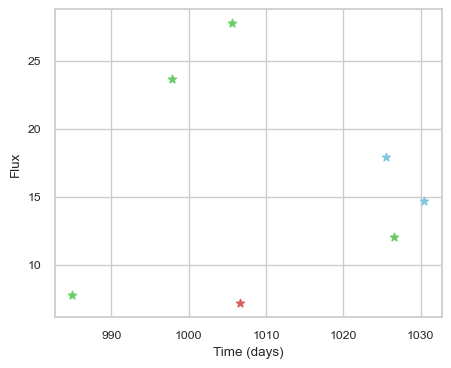

SNIax (3.9592006, False)
SNIax (3.7770848, False)
SNIax (3.2024283, False)
SNIax (3.0109854, False)
SNIax (3.33736, False)
SNIax (3.7667387, False)
SNIax (4.1701126, False)
SNIax (4.1722555, False)
SNIax (3.4520905, False)
SNIax (4.0379305, False)
SNIax (3.3585715, False)
SNIax (4.3970385, False)
SNIax (3.900485, False)
SNIax (4.222342, False)


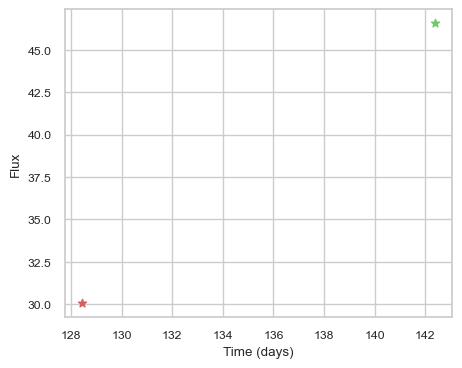

SNIax (3.973409, False)
SNIax (4.3504148, False)
SNIax (4.2213426, False)
SNIax (3.0875342, False)


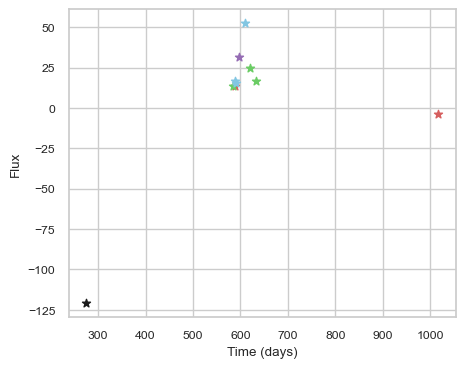

SNIax (3.9288394, False)
SNIax (4.13285, False)
SNIax (3.9477715, False)
SNIax (3.422499, False)
SNIax (3.4853008, False)
SNIax (3.386686, False)
SNIax (3.3624985, False)
SNIax (3.4335427, False)
SNIax (2.9790683, False)
SNIax (3.6862738, False)
SNIax (3.6192062, False)
SNIax (3.1455114, False)
SNIax (3.3864493, False)
SNIax (3.1860511, False)
SNIax (3.1112962, False)
SNIax (2.652676, False)
SNIax (2.902532, False)
SNIax (2.5457182, False)
SNIax (2.701532, False)
SNIax (2.4263666, False)


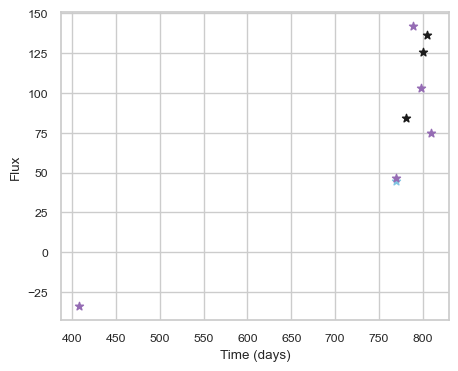

SNIax (3.879769, False)
SNIax (3.6404006, False)
SNIax (3.7921908, False)
SNIax (3.5295389, False)
SNIax (3.419177, False)
SNIax (2.8865979, False)
SNIax (2.9753952, False)
SNIax (3.590165, False)
SNIax (3.2303524, False)
SNIax (3.3605678, False)
SNIax (4.2103877, False)
SNIax (3.9594707, False)
SNIax (4.443441, False)
SNIax (4.724577, False)
SNIax (3.8624685, False)
SNIax (3.8852892, False)
SNIax (3.5804515, False)
SNIax (3.2665799, False)


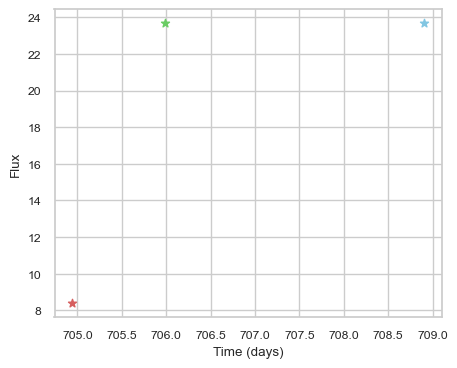

SNIax (3.8728082, False)
SNIax (3.8712397, False)
SNIax (3.121341, False)
SNIax (2.7020712, False)
SNIax (3.0488632, False)
SNIax (2.1732712, False)


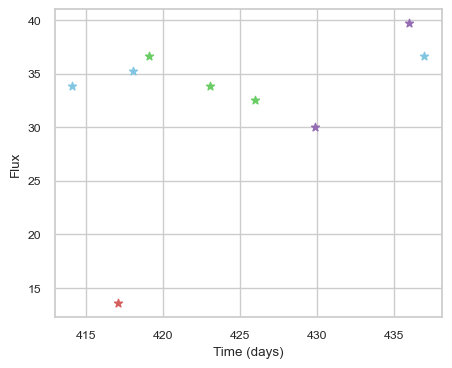

SNIax (3.9851494, False)
SNIax (3.6995676, False)
SNIax (3.528347, False)
SNIax (2.5003471, False)
SNIax (3.0251598, False)
SNIax (3.1431575, False)
SNIax (2.6921072, False)
SNIax (2.5874279, False)
SNIax (3.0944076, False)
SNIax (2.2321603, False)
SNIax (3.2483506, False)
SNIax (2.4141443, False)
SNIax (3.055536, False)
SNIax (2.5447028, False)
SNIax (2.2281075, False)
SNIax (2.384393, False)
SNIax (2.7638621, False)
SNIax (2.315221, False)


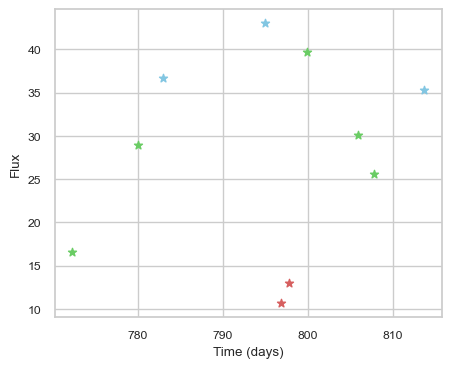

SNIax (3.809186, False)
SNIax (3.4330976, False)
SNIax (3.1200352, False)
SNIax (2.9420218, False)
SNIax (3.6732295, False)
SNIax (3.523646, False)
SNIax (3.2830296, False)
SNIax (4.105386, False)
SNIax (3.8147016, False)
SNIax (3.5991478, False)
SNIax (3.5833354, False)
SNIax (3.0584104, False)
SNIax (3.354594, False)
SNIax (3.328048, False)
SNIax (3.1720605, False)
SNIax (2.8265476, False)
SNIax (3.3124697, False)
SNIax (2.8294132, False)
SNIax (2.9477704, False)
SNIax (2.7381284, False)


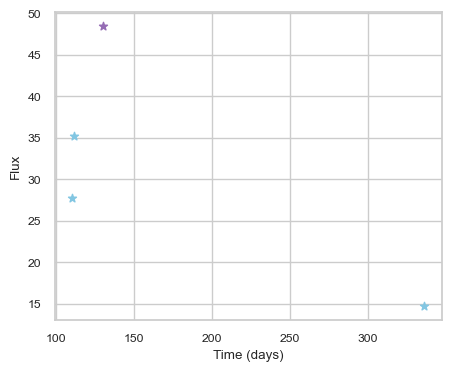

SNIax (4.577328, False)
SNIax (4.4103746, False)
SNIax (3.3167412, False)
SNIax (4.2203307, False)
SNIax (4.1300387, False)
SNIax (3.896183, False)
SNIax (3.978126, False)
SNIax (3.767958, False)


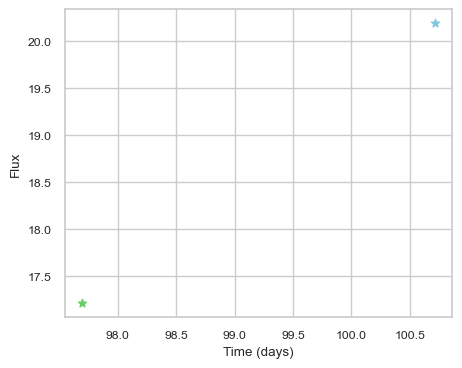

SNIax (4.712219, False)
SNIax (4.000483, False)
SNIax (3.4381547, False)
SNIax (3.0384147, False)


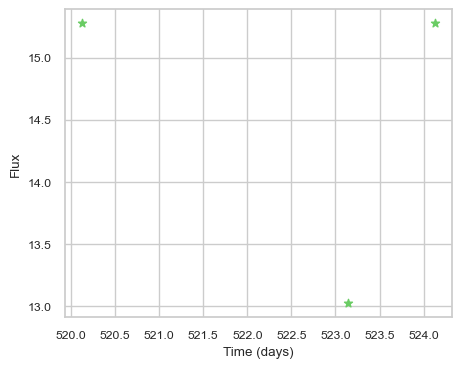

SNIax (4.726071, False)
SNIax (3.7727368, False)
SNIax (3.5083601, False)
SNIax (3.1851768, False)
SNIax (2.8719103, False)
SNIax (2.757826, False)


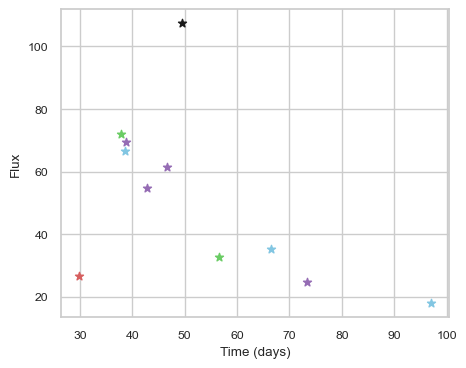

SNIax (3.929336, False)
SNIax (4.39587, False)
SNIax (4.5315366, False)
SNIax (3.1466784, False)
SNIax (4.0834956, False)
SNIax (3.4641676, False)
SNIax (4.3174205, False)
SNIax (3.5299501, False)
SNIax (4.327789, False)
SNIax (3.2407124, False)
SNIax (4.1147118, False)
SNIax (3.6138237, False)
SNIax (4.4481373, False)
SNIax (4.150274, False)
SNIax (3.3025913, False)
SNIax (3.175752, False)
SNIax (3.5718164, False)
SNIax (3.4812038, False)
SNIax (3.6393692, False)
SNIax (3.5331066, False)
SNIax (3.7113235, False)
SNIax (3.442272, False)


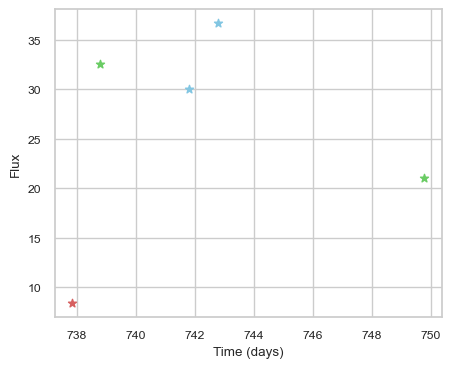

SNIax (4.0662217, False)
SNIax (3.4011302, False)
SNIax (3.2787921, False)
SNIax (3.2312274, False)
SNIax (4.0739384, False)
SNIax (2.7997124, False)
SNIax (2.777058, False)
SNIax (2.4367833, False)
SNIax (2.859711, False)
SNIax (1.9620641, False)


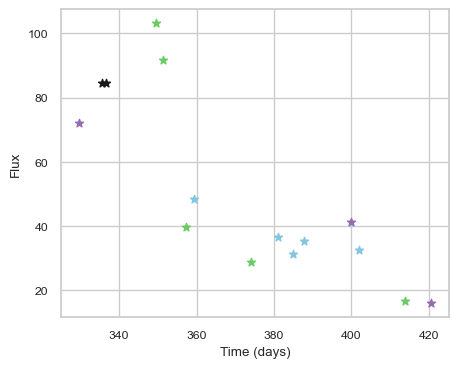

SNIax (3.6909704, False)
SNIax (3.9961517, False)
SNIax (3.5013049, False)
SNIax (4.5773726, False)
SNIax (4.0631056, False)
SNIax (4.8845773, False)
SNIax (3.693077, False)
SNIax (3.9169862, False)
SNIax (3.3438134, False)
SNIax (3.7137978, False)
SNIax (3.7506006, False)
SNIax (4.159879, False)
SNIax (5.034808, False)
SNIax (5.1816816, False)
SNIax (4.9093966, False)
SNIax (5.4070153, False)
SNIax (4.963393, False)
SNIax (5.602309, False)
SNIax (5.22632, False)
SNIax (5.4009514, False)
SNIax (5.3352294, False)
SNIax (5.5674443, False)
SNIax (4.745843, False)
SNIax (4.7137227, False)
SNIax (4.943489, False)
SNIax (4.9512205, False)
SNIax (4.3011975, False)
SNIax (5.150791, False)
SNIax (4.7727776, False)
SNIax (4.8207393, False)


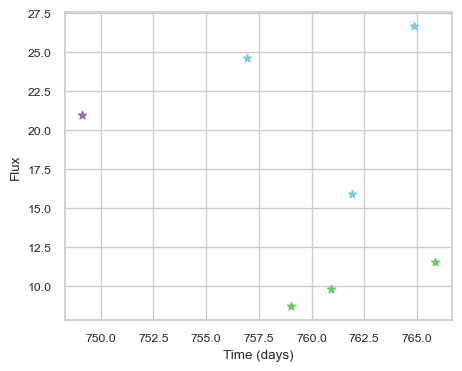

SNIax (4.7487154, False)
SNIax (4.178234, False)
SNIax (4.5197573, False)
SNIax (4.586047, False)
SNIax (4.4723454, False)
SNIax (4.567146, False)
SNIax (4.8422084, False)
SNIax (4.743312, False)
SNIax (4.4855747, False)
SNIax (4.6818967, False)
SNIax (4.211069, False)
SNIax (4.229554, False)
SNIax (4.2274637, False)
SNIax (4.275381, False)


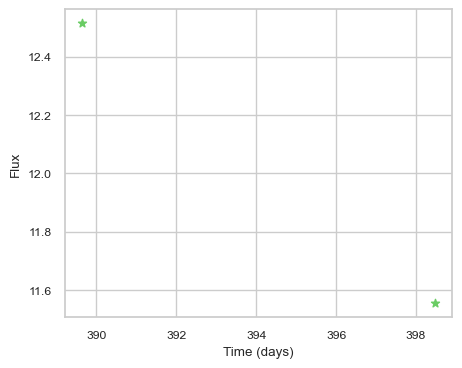

SNIax (3.8743143, False)
SNIax (3.5447395, False)
SNIax (3.3515472, False)
SNIax (4.0719037, False)


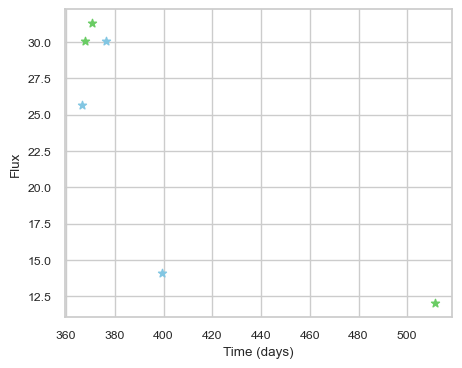

SNIax (3.8132794, False)
SNIax (3.4666638, False)
SNIax (3.2447355, False)
SNIax (2.9321704, False)
SNIax (3.7207031, False)
SNIax (2.6344252, False)
SNIax (3.1839101, False)
SNIax (2.9688942, False)
SNIax (4.3328285, False)
SNIax (4.3760934, False)
SNIax (4.408173, False)
SNIax (4.1683507, False)


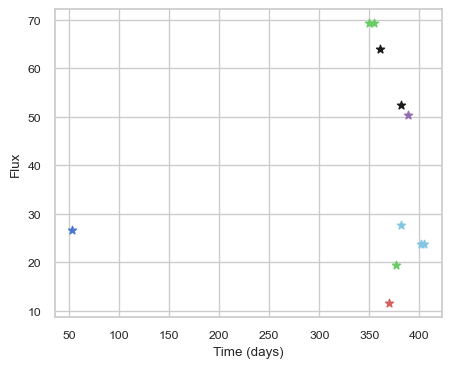

SNIax (3.874046, False)
SNIax (4.034976, False)
SNIax (3.7647498, False)
SNIax (3.7430024, False)
SNIax (4.053722, False)
SNIax (3.5420988, False)
SNIax (3.1839938, False)
SNIax (2.9906425, False)
SNIax (2.6964357, False)
SNIax (2.735973, False)
SNIax (3.3418572, False)
SNIax (2.7940357, False)
SNIax (2.6489415, False)
SNIax (2.5615184, False)
SNIax (2.8059783, False)
SNIax (2.8027031, False)
SNIax (2.8055742, False)
SNIax (2.9138346, False)
SNIax (3.5767787, False)
SNIax (2.9401772, False)
SNIax (2.8103316, False)
SNIax (2.936288, False)


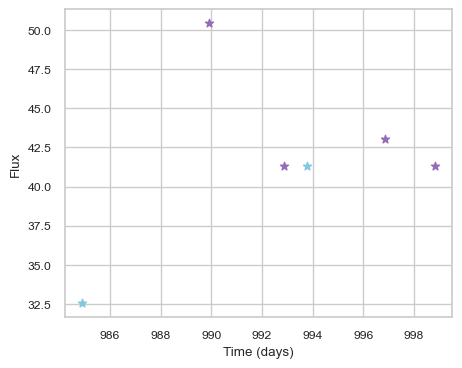

SNIax (4.008078, False)
SNIax (3.8044207, False)
SNIax (3.5900998, False)
SNIax (3.6042073, False)
SNIax (3.656277, False)
SNIax (3.0978303, False)
SNIax (3.0442085, False)
SNIax (3.2169454, False)
SNIax (2.705029, False)
SNIax (2.3814209, False)
SNIax (2.9404445, False)
SNIax (2.5235202, False)


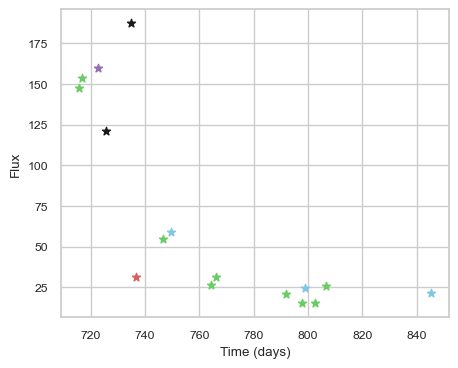

SNIax (3.7209382, False)
SNIax (3.495132, False)
SNIax (4.2915974, False)
SNIax (3.9524322, False)
SNIax (4.9503603, False)
SNIax (4.868143, False)
SNIax (5.3355227, False)
SNIax (4.6073394, False)
SNIax (4.8001413, False)
SNIax (4.081052, False)
SNIax (3.9400175, False)
SNIax (3.7862318, False)
SNIax (4.1483397, False)
SNIax (4.6754484, False)
SNIax (4.360385, False)
SNIax (5.198425, False)
SNIax (4.49053, False)
SNIax (4.476405, False)
SNIax (4.382843, False)
SNIax (4.165879, False)
SNIax (4.625271, False)
SNIax (4.5066433, False)
SNIax (4.7240157, False)
SNIax (4.884861, False)
SNIax (4.038777, False)
SNIax (4.1136727, False)
SNIax (4.0075936, False)
SNIax (4.4196486, False)
SNIax (4.2304873, False)
SNIax (4.309111, False)
SNIax (4.444258, False)
SNIax (3.3008595, False)


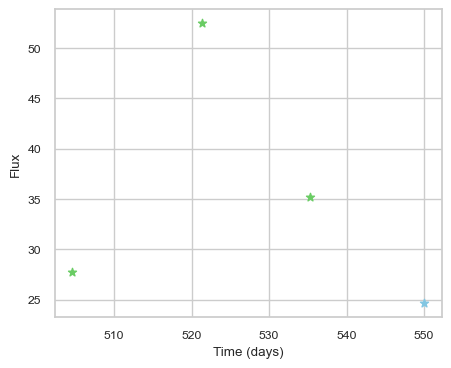

SNIax (4.3179736, False)
SNIax (4.003043, False)
SNIax (4.038731, False)
SNIax (4.428083, False)
SNIax (5.045765, False)
SNIax (5.192304, False)
SNIax (4.702549, False)
SNIax (4.029873, False)


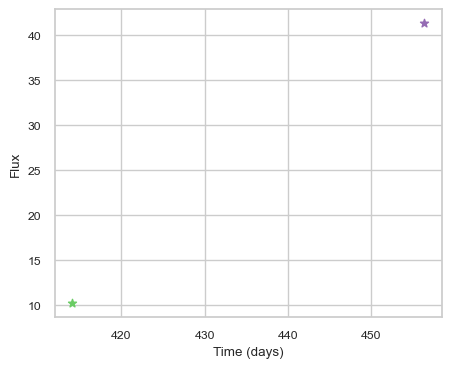

SNIax (4.6128407, False)
SNIax (3.8063538, False)
SNIax (4.572682, False)
SNIax (4.2826734, False)


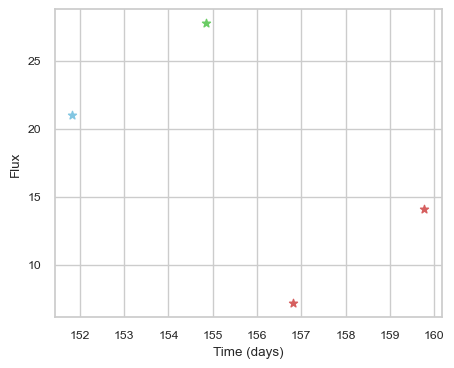

SNIax (4.575732, False)
SNIax (4.062433, False)
SNIax (3.522642, False)
SNIax (3.9597964, False)
SNIax (3.6187544, False)
SNIax (3.6216183, False)
SNIax (3.1706605, False)
SNIax (3.357527, False)


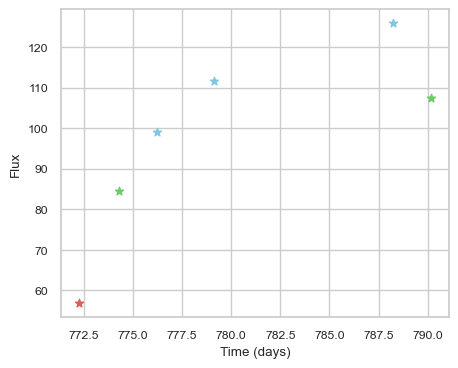

SNIax (3.8022358, False)
SNIax (4.237052, False)
SNIax (3.891429, False)
SNIax (3.3196702, False)
SNIax (3.307136, False)
SNIax (3.1862838, False)
SNIax (3.777848, False)
SNIax (3.4866333, False)
SNIax (3.8347964, False)
SNIax (3.8290672, False)
SNIax (3.7941847, False)
SNIax (3.3531206, False)


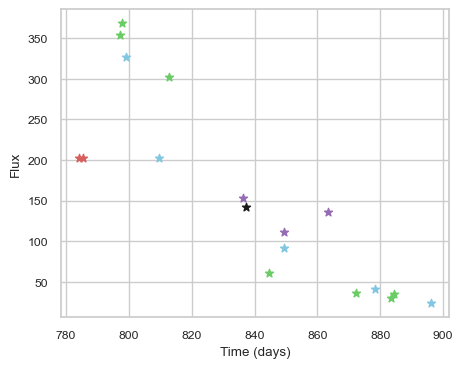

SNIax (3.804066, False)
SNIax (4.527134, False)
SNIax (3.4050405, False)
SNIax (3.848011, False)
SNIax (4.4469132, False)
SNIax (3.5630867, False)
SNIax (3.2530136, False)
SNIax (2.6173759, False)
SNIax (3.0245633, False)
SNIax (2.340835, False)
SNIax (2.4363074, False)
SNIax (2.556452, False)
SNIax (2.6455047, False)
SNIax (2.7695777, False)
SNIax (3.0657117, False)
SNIax (2.206254, False)
SNIax (3.6927686, False)
SNIax (3.429825, False)
SNIax (2.850528, False)
SNIax (2.5646083, False)
SNIax (2.736569, False)
SNIax (3.0730846, False)
SNIax (3.0299783, False)
SNIax (2.7850752, False)
SNIax (2.9603992, False)
SNIax (2.9288082, False)
SNIax (2.7018173, False)
SNIax (2.7480528, False)
SNIax (2.713498, False)
SNIax (2.6614027, False)
SNIax (2.8380299, False)
SNIax (2.8265264, False)
SNIax (3.0290434, False)
SNIax (2.6996765, False)
SNIax (2.807244, False)
SNIax (2.3981142, False)


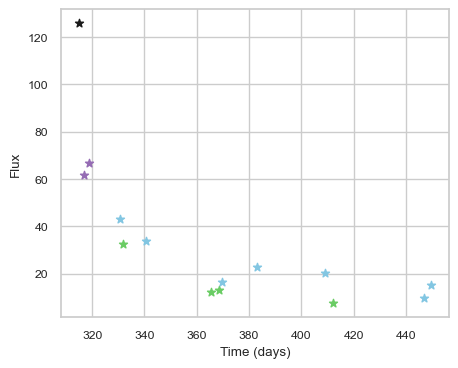

SNIax (3.8108146, False)
SNIax (4.0797477, False)
SNIax (4.540905, False)
SNIax (3.8582354, False)
SNIax (4.049156, False)
SNIax (4.226769, False)
SNIax (4.3356524, False)
SNIax (4.3642697, False)
SNIax (4.2003508, False)
SNIax (4.5969567, False)
SNIax (4.664949, False)
SNIax (4.2340965, False)
SNIax (4.4181027, False)
SNIax (4.1638494, False)
SNIax (4.1345854, False)
SNIax (3.7769156, False)
SNIax (3.3158593, False)
SNIax (3.5246928, False)
SNIax (3.2581573, False)
SNIax (3.3786113, False)
SNIax (4.113123, False)
SNIax (3.8525705, False)
SNIax (4.214878, False)
SNIax (3.603355, False)
SNIax (4.014611, False)
SNIax (3.7917995, False)
SNIax (3.6828086, False)
SNIax (3.8047197, False)


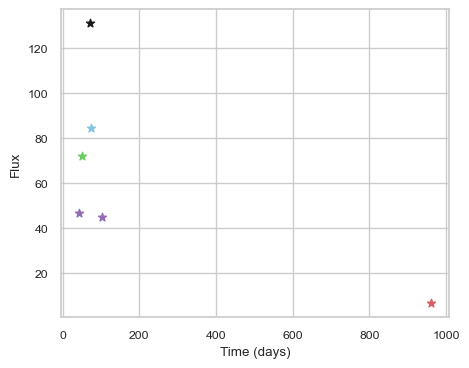

SNIax (5.7931895, False)
SNIax (5.322731, False)
SNIax (5.1214404, False)
SNIax (5.4099207, False)
SNIax (5.5682073, False)
SNIax (5.7416043, False)
SNIax (5.5596733, False)
SNIax (4.8508615, False)
SNIax (4.292457, False)
SNIax (3.8446817, False)
SNIax (4.3871627, False)
SNIax (4.408582, False)


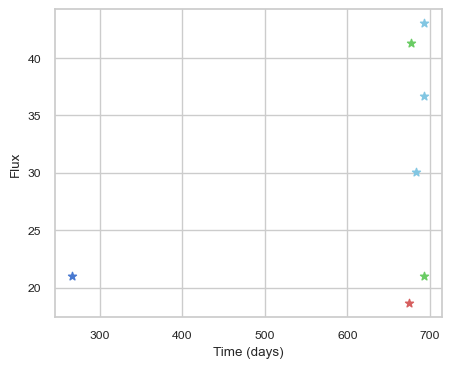

SNIax (3.6525235, False)
SNIax (3.794969, False)
SNIax (3.898324, False)
SNIax (4.7394824, False)
SNIax (3.6578763, False)
SNIax (2.9573908, False)
SNIax (3.3603215, False)
SNIax (2.2190824, False)
SNIax (2.3035572, False)
SNIax (1.9828825, False)
SNIax (2.7633965, False)
SNIax (2.54716, False)
SNIax (2.6199176, False)
SNIax (2.300591, False)


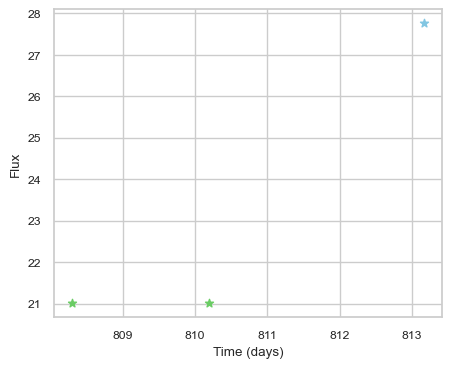

SNIax (4.0646796, False)
SNIax (3.3976908, False)
SNIax (3.4495432, False)
SNIax (2.8081005, False)
SNIax (3.4162517, False)
SNIax (2.8915913, False)


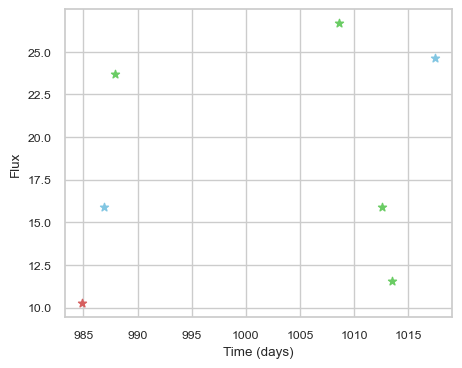

SNIax (3.8946214, False)
SNIax (4.423937, False)
SNIax (3.1410336, False)
SNIax (3.9436169, False)
SNIax (3.5915096, False)
SNIax (3.211656, False)
SNIax (3.0169256, False)
SNIax (3.144461, False)
SNIax (3.978327, False)
SNIax (3.659668, False)
SNIax (3.1365964, False)
SNIax (3.8284616, False)
SNIax (3.6931121, False)
SNIax (3.2046037, False)


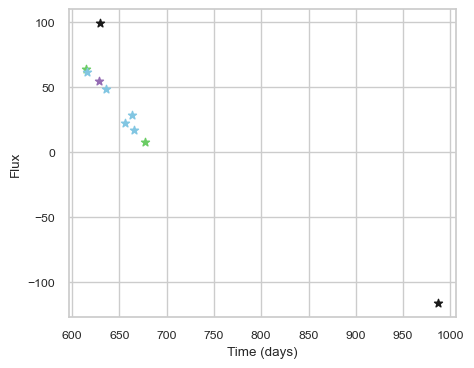

SNIax (3.6964407, False)
SNIax (3.6777544, False)
SNIax (3.8636675, False)
SNIax (3.940186, False)
SNIax (3.721484, False)
SNIax (3.1740909, False)
SNIax (3.414636, False)
SNIax (3.51257, False)
SNIax (3.5987864, False)
SNIax (3.547153, False)
SNIax (4.373958, False)
SNIax (4.245138, False)
SNIax (3.8176541, False)
SNIax (3.455551, False)
SNIax (3.545483, False)
SNIax (3.2254007, False)
SNIax (3.5129573, False)
SNIax (3.2031515, False)
SNIax (4.1408424, False)
SNIax (4.362415, False)


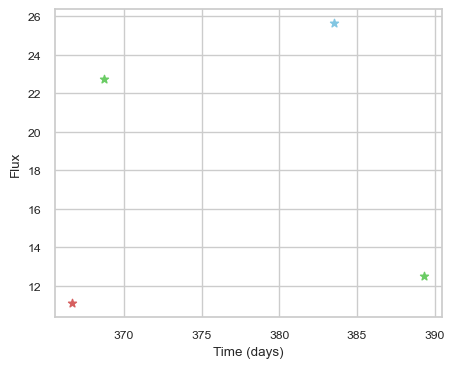

SNIax (3.8536267, False)
SNIax (3.5467465, False)
SNIax (2.939323, False)
SNIax (2.589895, False)
SNIax (2.7385092, False)
SNIax (2.60616, False)
SNIax (3.3257873, False)
SNIax (2.9677181, False)


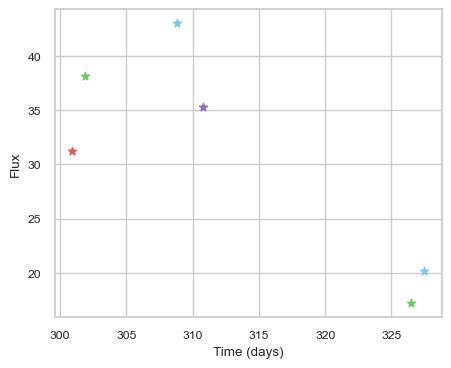

SNIax (3.8434086, False)
SNIax (4.6519523, False)
SNIax (4.6075835, False)
SNIax (3.433102, False)
SNIax (3.6773162, False)
SNIax (4.1995974, False)
SNIax (4.3228703, False)
SNIax (4.7163606, False)
SNIax (4.8905377, False)
SNIax (5.0148907, False)
SNIax (4.0895925, False)
SNIax (3.942451, False)


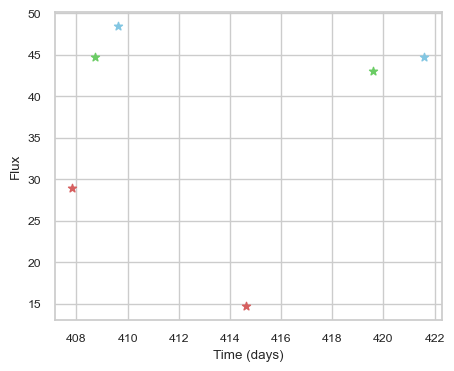

SNIax (3.9126205, False)
SNIax (4.7577887, False)
SNIax (5.4970636, False)
SNIax (3.1053672, False)
SNIax (3.508051, False)
SNIax (3.2266276, False)
SNIax (3.1352372, False)
SNIax (3.1762507, False)
SNIax (3.2450733, False)
SNIax (2.6151273, False)
SNIax (3.2685938, False)
SNIax (2.4251525, False)


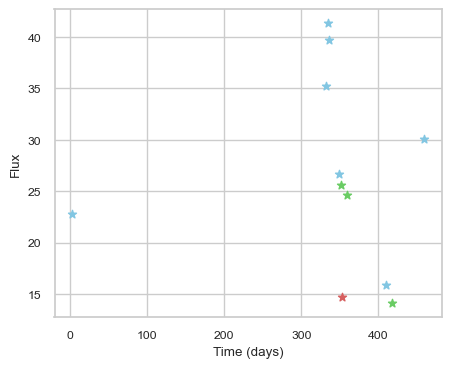

SNIax (3.633464, False)
SNIax (4.5336285, False)
SNIax (3.35617, False)
SNIax (4.1442313, False)
SNIax (3.5400498, False)
SNIax (4.2399755, False)
SNIax (3.6137903, False)
SNIax (4.058827, False)
SNIax (3.2071292, False)
SNIax (3.5246112, False)
SNIax (3.3499231, False)
SNIax (3.9922078, False)
SNIax (3.808996, False)
SNIax (4.6290874, False)
SNIax (4.206887, False)
SNIax (4.605253, False)
SNIax (5.1901283, False)
SNIax (5.0963287, False)
SNIax (4.5550175, False)
SNIax (4.1752853, False)
SNIax (4.187734, False)
SNIax (5.219932, False)


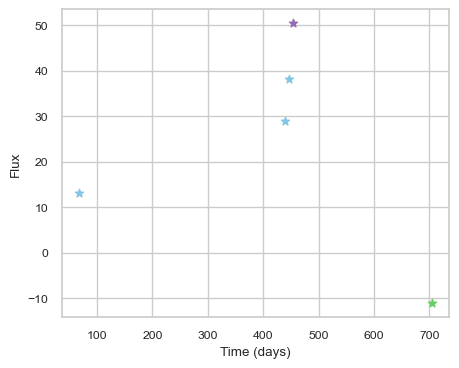

SNIax (3.9517956, False)
SNIax (3.6713037, False)
SNIax (3.606458, False)
SNIax (3.74299, False)
SNIax (3.3197062, False)
SNIax (3.6174738, False)
SNIax (3.410118, False)
SNIax (3.6961172, False)
SNIax (3.950651, False)
SNIax (4.134851, False)


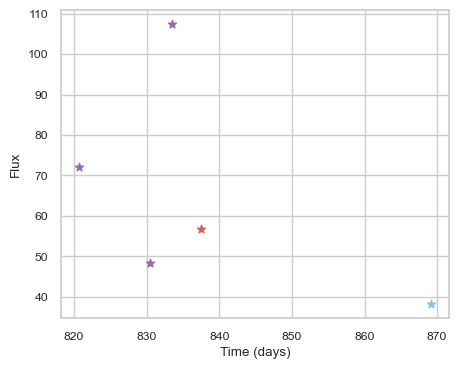

SNIax (3.7566447, False)
SNIax (3.4816294, False)
SNIax (3.324985, False)
SNIax (3.8749404, False)
SNIax (3.8455832, False)
SNIax (4.684783, False)
SNIax (4.5571737, False)
SNIax (4.5749974, False)
SNIax (5.1349754, False)
SNIax (5.4570236, False)


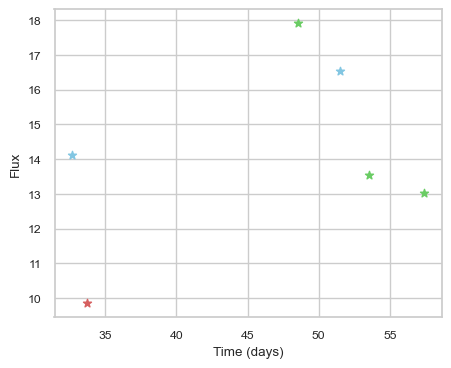

SNIax (4.105171, False)
SNIax (3.596742, False)
SNIax (3.109421, False)
SNIax (3.566473, False)
SNIax (3.2936697, False)
SNIax (2.6810668, False)
SNIax (3.0654771, False)
SNIax (3.1028912, False)
SNIax (3.3730772, False)
SNIax (2.8672876, False)
SNIax (3.4156432, False)
SNIax (2.9451096, False)


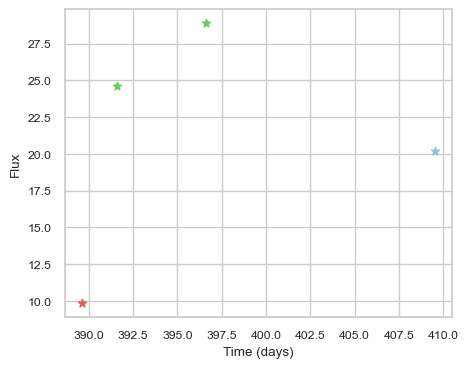

SNIax (3.950339, False)
SNIax (4.1159673, False)
SNIax (3.2460876, False)
SNIax (2.6836736, False)
SNIax (2.8820105, False)
SNIax (2.4140115, False)
SNIax (2.5347857, False)
SNIax (2.4301834, False)


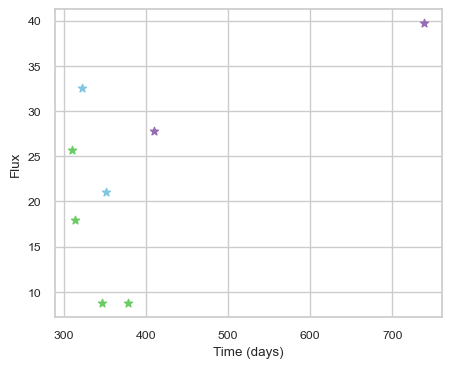

SNIax (3.961048, False)
SNIax (4.0741205, False)
SNIax (3.6106517, False)
SNIax (3.6886337, False)
SNIax (2.9541855, False)
SNIax (3.3459458, False)
SNIax (3.40638, False)
SNIax (3.9028943, False)
SNIax (3.3007882, False)
SNIax (2.9768527, False)
SNIax (4.1095686, False)
SNIax (4.540788, False)
SNIax (4.2860208, False)
SNIax (4.2268686, False)
SNIax (4.187422, False)
SNIax (3.8541524, False)


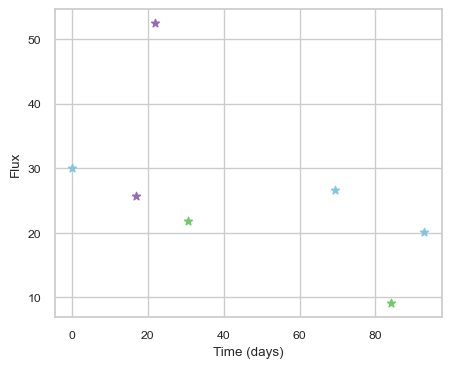

SNIax (4.2148514, False)
SNIax (3.933771, False)
SNIax (4.355887, False)
SNIax (4.2422814, False)
SNIax (4.2435718, False)
SNIax (4.4601607, False)
SNIax (4.6978855, False)
SNIax (5.2403836, False)
SNIax (5.2363796, False)
SNIax (5.5077257, False)
SNIax (5.3674397, False)
SNIax (4.7457, False)
SNIax (4.895993, False)


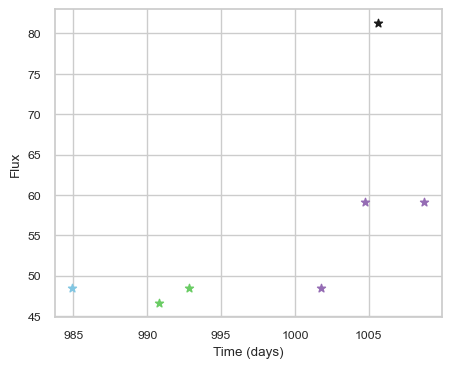

SNIax (4.2096214, False)
SNIax (4.5825768, False)
SNIax (5.0080533, False)
SNIax (5.3866773, False)
SNIax (5.161225, False)
SNIax (5.393664, False)
SNIax (5.384521, False)
SNIax (5.275031, False)
SNIax (5.087531, False)
SNIax (4.9862027, False)
SNIax (5.409569, False)
SNIax (5.2487135, False)
SNIax (5.078409, False)
SNIax (4.2840095, False)


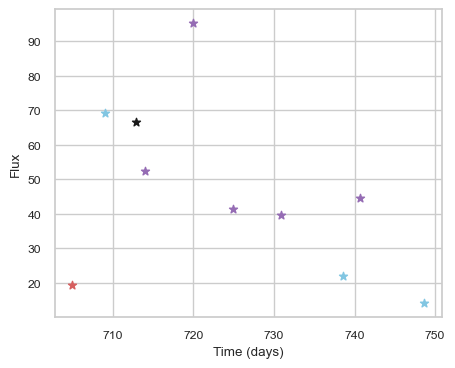

SNIax (3.8412406, False)
SNIax (3.957376, False)
SNIax (3.7605033, False)
SNIax (3.970347, False)
SNIax (4.836941, False)
SNIax (4.6093955, False)
SNIax (5.4170156, False)
SNIax (3.70612, False)
SNIax (4.2478724, False)
SNIax (3.507395, False)
SNIax (4.8100986, False)
SNIax (3.313724, False)
SNIax (4.034362, False)
SNIax (3.4999466, False)
SNIax (3.7423642, False)
SNIax (4.0242677, False)
SNIax (3.3366258, False)
SNIax (3.8108878, False)
SNIax (3.7016466, False)
SNIax (3.8442278, False)


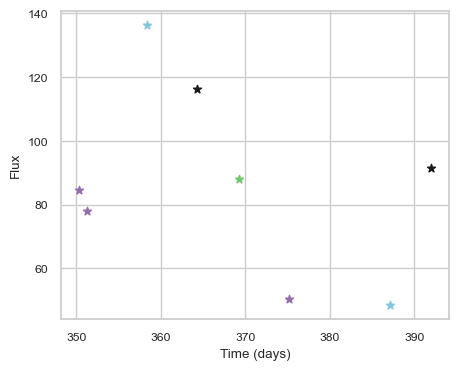

SNIax (3.8652592, False)
SNIax (3.9028482, False)
SNIax (4.6114745, False)
SNIax (3.9812872, False)
SNIax (3.370939, False)
SNIax (4.1601605, False)
SNIax (4.5413084, False)
SNIax (4.884427, False)
SNIax (4.205129, False)
SNIax (3.5414808, False)
SNIax (3.183423, False)
SNIax (3.4000788, False)
SNIax (3.95224, False)
SNIax (4.133933, False)
SNIax (4.1501184, False)
SNIax (4.550747, False)


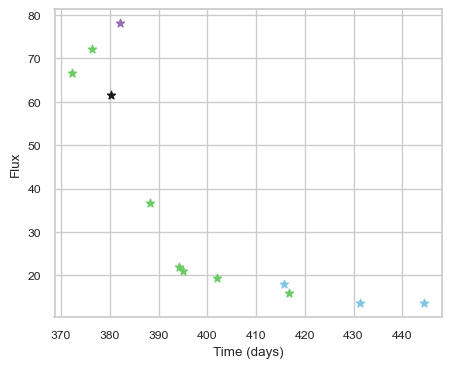

SNIax (3.7153068, False)
SNIax (3.3896034, False)
SNIax (3.721975, False)
SNIax (3.2082078, False)
SNIax (3.852539, False)
SNIax (3.9540186, False)
SNIax (3.465932, False)
SNIax (3.5884056, False)
SNIax (3.129448, False)
SNIax (3.4906864, False)
SNIax (3.2213275, False)
SNIax (3.2320704, False)
SNIax (2.84066, False)
SNIax (3.0565705, False)
SNIax (2.3167384, False)
SNIax (2.7221441, False)
SNIax (2.2852154, False)
SNIax (2.0280523, False)
SNIax (2.1276476, False)
SNIax (2.1253283, False)
SNIax (2.5720053, False)
SNIax (2.1223326, False)
SNIax (2.4986749, False)
SNIax (2.2064252, False)


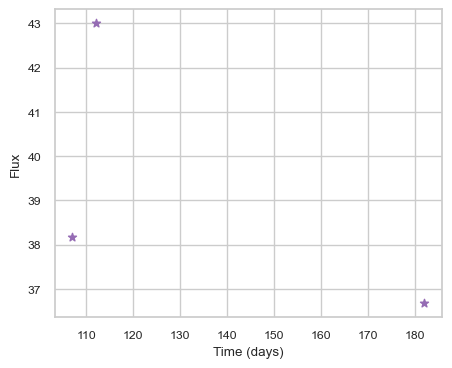

SNIax (4.108563, False)
SNIax (3.798056, False)
SNIax (3.684751, False)
SNIax (3.6654558, False)
SNIax (4.0335455, False)
SNIax (4.401962, False)


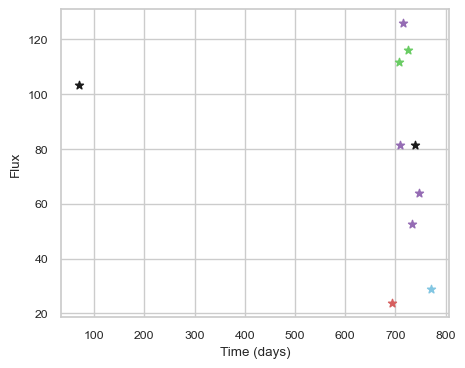

SNIax (3.9651222, False)
SNIax (3.7318501, False)
SNIax (3.9780936, False)
SNIax (3.9823823, False)
SNIax (3.3911872, False)
SNIax (4.191307, False)
SNIax (4.7529063, False)
SNIax (5.2458696, False)
SNIax (5.8005595, False)
SNIax (5.6105537, False)
SNIax (5.744848, False)
SNIax (5.223007, False)
SNIax (4.661015, False)
SNIax (5.673289, False)
SNIax (5.803537, False)
SNIax (6.0331354, False)
SNIax (5.876503, False)
SNIax (5.8059297, False)
SNIax (6.320194, False)
SNIax (5.37417, False)


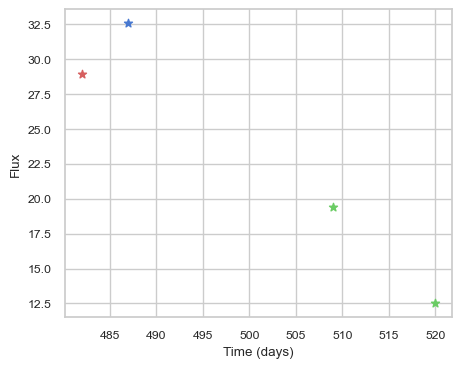

SNIax (3.8881783, False)
SNIax (4.79114, False)
SNIax (4.458533, False)
SNIax (5.2756853, False)
SNIax (4.0165524, False)
SNIax (4.5152545, False)
SNIax (5.1145577, False)
SNIax (4.6469126, False)


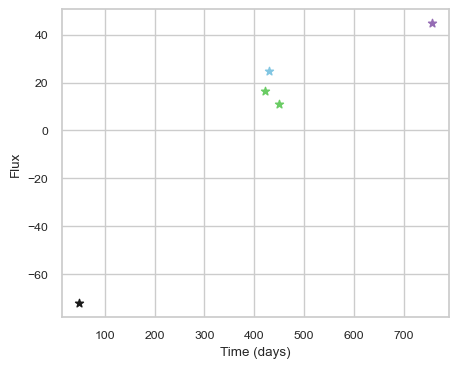

SNIax (5.2617474, False)
SNIax (4.671113, False)
SNIax (4.9340878, False)
SNIax (4.4515357, False)
SNIax (4.3085275, False)
SNIax (3.6394374, False)
SNIax (3.8152199, False)
SNIax (4.2996593, False)
SNIax (4.375804, False)
SNIax (3.691142, False)


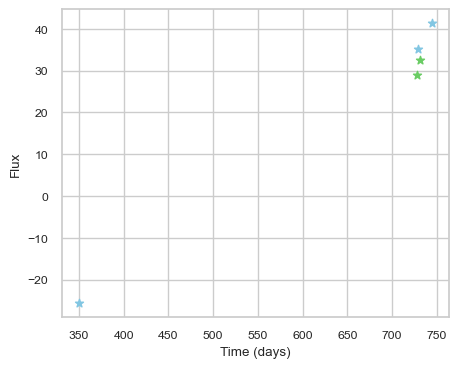

SNIax (3.9898956, False)
SNIax (4.055328, False)
SNIax (4.1754317, False)
SNIax (3.2000184, False)
SNIax (3.2549677, False)
SNIax (2.8748786, False)
SNIax (2.9205675, False)
SNIax (2.2817376, False)
SNIax (2.4227462, False)
SNIax (1.9770685, False)


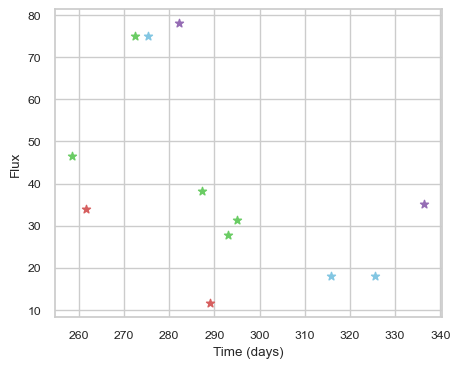

SNIax (3.747557, False)
SNIax (4.034645, False)
SNIax (3.8709636, False)
SNIax (3.588141, False)
SNIax (3.8791537, False)
SNIax (4.766916, False)
SNIax (5.6749077, False)
SNIax (5.5552573, False)
SNIax (5.89042, False)
SNIax (5.432607, False)
SNIax (5.9410696, False)
SNIax (5.472704, False)
SNIax (5.433763, False)
SNIax (5.2754, False)
SNIax (5.9287486, False)
SNIax (5.3474317, False)
SNIax (5.5082593, False)
SNIax (5.4069376, False)
SNIax (5.6999035, False)
SNIax (5.4176636, False)
SNIax (5.179425, False)
SNIax (5.450441, False)
SNIax (5.1284494, False)
SNIax (5.1071167, False)


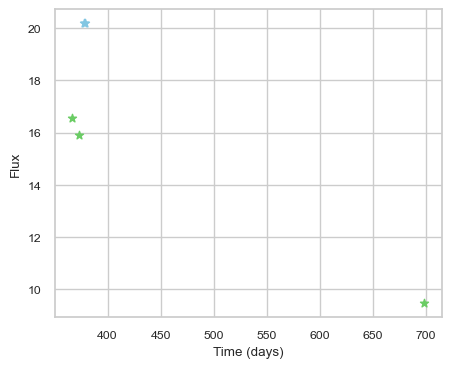

SNIax (4.6652775, False)
SNIax (3.75587, False)
SNIax (3.705872, False)
SNIax (3.3569593, False)
SNIax (3.4714785, False)
SNIax (2.726875, False)
SNIax (2.899099, False)
SNIax (2.533726, False)
SNIax (3.6247034, False)
SNIax (3.6357267, False)


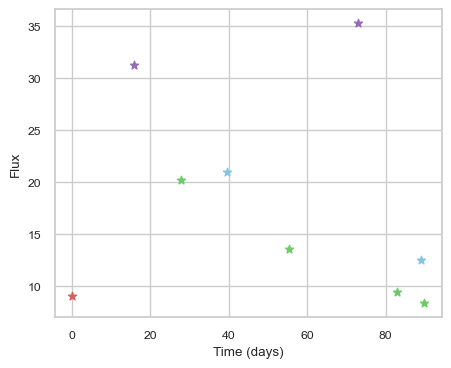

SNIax (4.2769732, False)
SNIax (4.6890607, False)
SNIax (5.221346, False)
SNIax (4.441338, False)
SNIax (4.9376526, False)
SNIax (5.2438464, False)
SNIax (5.544273, False)
SNIax (5.27496, False)
SNIax (5.317562, False)
SNIax (4.9873066, False)
SNIax (5.5321755, False)
SNIax (5.8781953, False)
SNIax (5.3987136, False)
SNIax (5.0478573, False)
SNIax (5.213659, False)
SNIax (4.248246, False)
SNIax (5.138775, False)


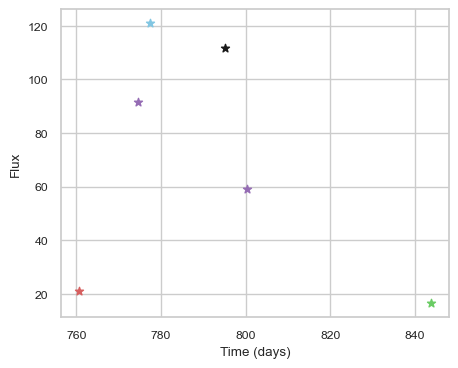

SNIax (3.7945657, False)
SNIax (4.343109, False)
SNIax (3.5171654, False)
SNIax (3.299146, False)
SNIax (3.5466986, False)
SNIax (3.2349331, False)
SNIax (3.617953, False)
SNIax (3.2954068, False)
SNIax (3.7704856, False)
SNIax (3.2027388, False)
SNIax (3.0277526, False)
SNIax (2.367934, False)


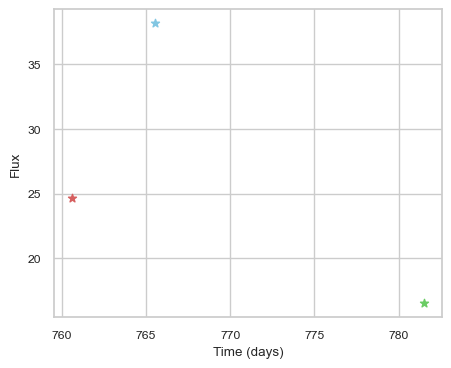

SNIax (3.8837256, False)
SNIax (4.211297, False)
SNIax (4.361556, False)
SNIax (3.5276346, False)
SNIax (4.6770334, False)
SNIax (4.6402974, False)


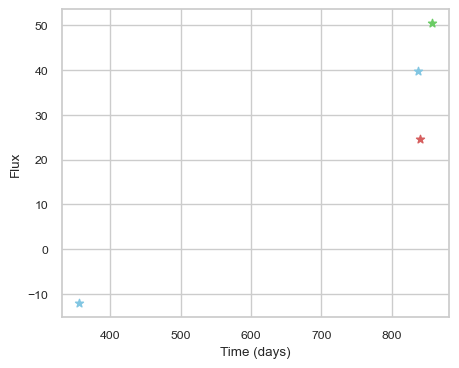

SNIax (3.9474564, False)
SNIax (4.0658703, False)
SNIax (4.0087967, False)
SNIax (3.505786, False)
SNIax (3.6616638, False)
SNIax (3.3971534, False)
SNIax (2.8990486, False)
SNIax (2.9605484, False)


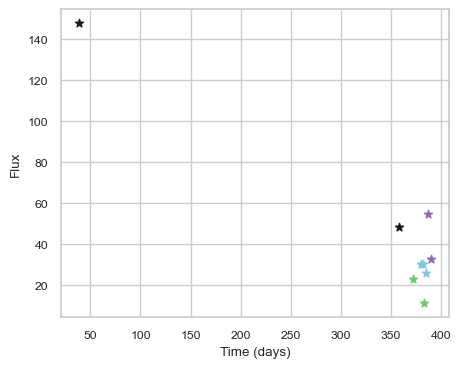

SNIax (4.1948633, False)
SNIax (3.7836378, False)
SNIax (4.308018, False)
SNIax (4.301275, False)
SNIax (4.557592, False)
SNIax (3.807368, False)
SNIax (4.034889, False)
SNIax (3.4971874, False)
SNIax (3.1363075, False)
SNIax (2.9967473, False)
SNIax (3.0491824, False)
SNIax (2.9481075, False)
SNIax (3.1786716, False)
SNIax (2.7382936, False)
SNIax (3.1040332, False)
SNIax (2.8567212, False)
SNIax (3.6817842, False)
SNIax (3.5447688, False)


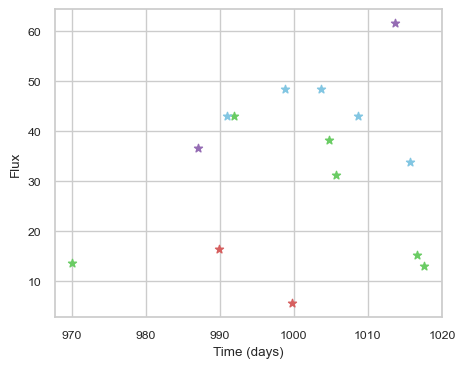

SNIax (4.1576915, False)
SNIax (3.9339302, False)
SNIax (3.3910334, False)
SNIax (3.291515, False)
SNIax (2.9677215, False)
SNIax (3.6400528, False)
SNIax (3.5485659, False)
SNIax (3.0407462, False)
SNIax (3.211594, False)
SNIax (3.1157596, False)
SNIax (3.7758632, False)
SNIax (4.2054763, False)
SNIax (4.1987505, False)
SNIax (3.8754995, False)
SNIax (3.8190372, False)
SNIax (3.8508282, False)
SNIax (4.1155086, False)
SNIax (3.98151, False)
SNIax (4.210549, False)
SNIax (3.792004, False)
SNIax (3.7626188, False)
SNIax (3.8399155, False)
SNIax (4.080402, False)
SNIax (3.684173, False)
SNIax (3.8976336, False)
SNIax (3.280994, False)
SNIax (3.0528705, False)
SNIax (3.1238747, False)
SNIax (2.3119655, False)
SNIax (2.8387003, False)


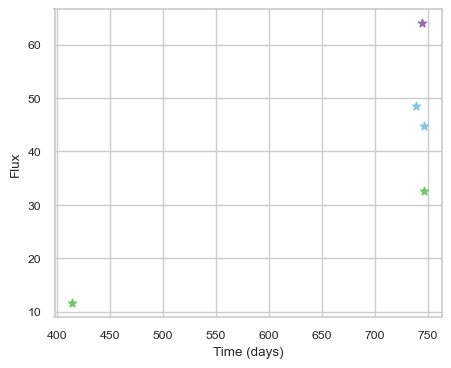

SNIax (3.9989789, False)
SNIax (3.540695, False)
SNIax (3.7415442, False)
SNIax (3.640291, False)
SNIax (3.9228745, False)
SNIax (3.817138, False)
SNIax (4.366797, False)
SNIax (3.373586, False)
SNIax (3.6576672, False)
SNIax (3.403606, False)


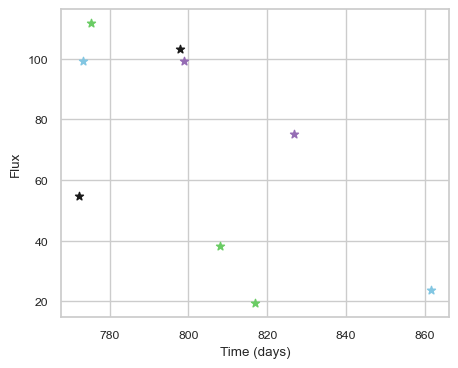

SNIax (3.8552964, False)
SNIax (3.4602723, False)
SNIax (3.6553185, False)
SNIax (3.6726267, False)
SNIax (4.0208917, False)
SNIax (4.0793176, False)
SNIax (3.6549683, False)
SNIax (4.0668235, False)
SNIax (4.153267, False)
SNIax (3.839068, False)
SNIax (3.6882477, False)
SNIax (4.3126993, False)
SNIax (4.073382, False)
SNIax (4.428512, False)
SNIax (4.15314, False)
SNIax (3.9592195, False)
SNIax (3.4323902, False)
SNIax (3.3148532, False)


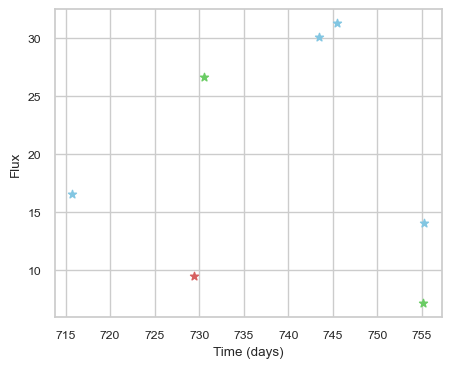

SNIax (4.366765, False)
SNIax (3.9133918, False)
SNIax (3.7619538, False)
SNIax (3.2586493, False)
SNIax (3.4519422, False)
SNIax (3.313845, False)
SNIax (3.7986608, False)
SNIax (3.2079906, False)
SNIax (2.700801, False)
SNIax (2.6092904, False)
SNIax (2.9887385, False)
SNIax (2.9048245, False)
SNIax (3.0875578, False)
SNIax (2.9317513, False)


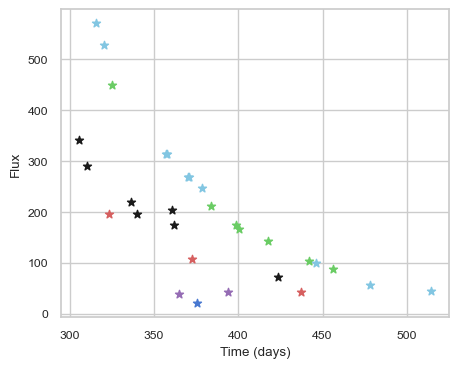

SNIax (3.984376, False)
SNIax (4.0589514, False)
SNIax (3.3089573, False)
SNIax (4.1610184, False)
SNIax (3.7128448, False)
SNIax (4.195333, False)
SNIax (3.0201528, False)
SNIax (3.2333057, False)
SNIax (2.9674306, False)
SNIax (3.0368912, False)
SNIax (2.9162607, False)
SNIax (2.752713, False)
SNIax (3.004613, False)
SNIax (2.9828627, False)
SNIax (2.9154887, False)
SNIax (3.4192085, False)
SNIax (2.877155, False)
SNIax (2.5440001, False)
SNIax (3.0523596, False)
SNIax (2.92567, False)
SNIax (3.5158892, False)
SNIax (3.648106, False)
SNIax (3.5632749, False)
SNIax (3.6840818, False)
SNIax (3.964583, False)
SNIax (2.2446313, False)
SNIax (2.936822, False)
SNIax (2.867807, False)
SNIax (2.5655472, False)
SNIax (3.1780174, False)
SNIax (2.8345585, False)
SNIax (2.9731247, False)
SNIax (3.5870728, False)
SNIax (3.3664103, False)
SNIax (3.922743, False)
SNIax (3.1959214, False)
SNIax (3.0926151, False)
SNIax (3.1558778, False)
SNIax (3.8343332, False)
SNIax (2.6037939, False)
SNIax (3.156

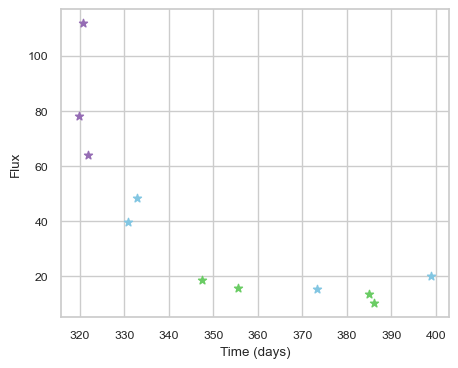

SNIax (3.7938607, False)
SNIax (3.9797492, False)
SNIax (4.5127606, False)
SNIax (4.6490636, False)
SNIax (5.2965465, False)
SNIax (3.9874604, False)
SNIax (3.6711862, False)
SNIax (3.4855025, False)
SNIax (3.6154537, False)
SNIax (3.5076697, False)
SNIax (3.71442, False)
SNIax (4.2262244, False)
SNIax (3.69115, False)
SNIax (3.8773346, False)
SNIax (3.3001463, False)
SNIax (3.3073554, False)
SNIax (3.2902343, False)
SNIax (3.3075316, False)
SNIax (3.4452715, False)
SNIax (3.5700576, False)
SNIax (3.468265, False)
SNIax (3.3615887, False)


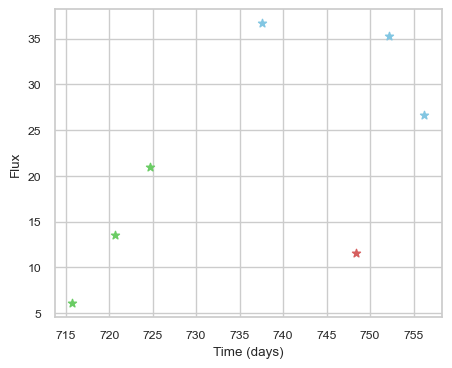

SNIax (4.0150414, False)
SNIax (3.4518337, False)
SNIax (3.2181993, False)
SNIax (2.6925857, False)
SNIax (2.8210142, False)
SNIax (2.6145723, False)
SNIax (2.893707, False)
SNIax (2.2873821, False)
SNIax (2.634028, False)
SNIax (2.6019375, False)
SNIax (2.6533053, False)
SNIax (2.347613, False)
SNIax (3.2431965, False)
SNIax (2.6763973, False)


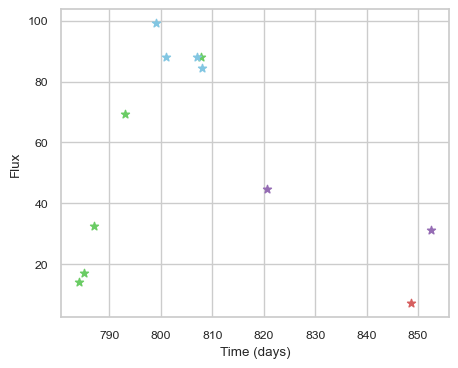

SNIax (3.8030987, False)
SNIax (3.504265, False)
SNIax (3.0925906, False)
SNIax (3.2530777, False)
SNIax (3.3985176, False)
SNIax (3.1115398, False)
SNIax (3.0938709, False)
SNIax (3.3577142, False)
SNIax (3.1994598, False)
SNIax (2.891462, False)
SNIax (3.2591996, False)
SNIax (2.9431245, False)
SNIax (3.0197039, False)
SNIax (2.7925396, False)
SNIax (3.3293297, False)
SNIax (2.2889395, False)
SNIax (2.7501583, False)
SNIax (2.0434282, False)
SNIax (2.1615176, False)
SNIax (1.7371242, False)
SNIax (2.015603, False)
SNIax (2.3635464, False)
SNIax (2.5529723, False)
SNIax (2.305081, False)


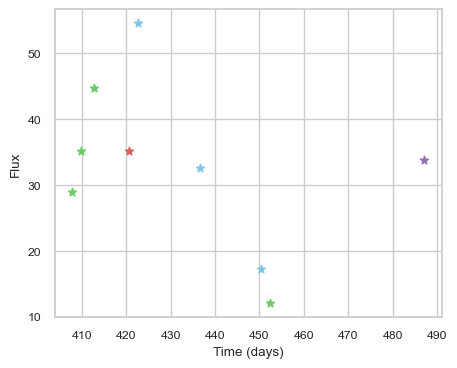

SNIax (3.8659995, False)
SNIax (3.6753705, False)
SNIax (3.7641587, False)
SNIax (3.1040456, False)
SNIax (3.5901275, False)
SNIax (3.076727, False)
SNIax (2.9519167, False)
SNIax (2.5812094, False)
SNIax (2.862548, False)
SNIax (1.7998767, False)
SNIax (2.2734034, False)
SNIax (2.1411252, False)
SNIax (2.5358326, False)
SNIax (2.3425405, False)
SNIax (2.5528443, False)
SNIax (2.3955624, False)
SNIax (2.7887766, False)
SNIax (2.15963, False)


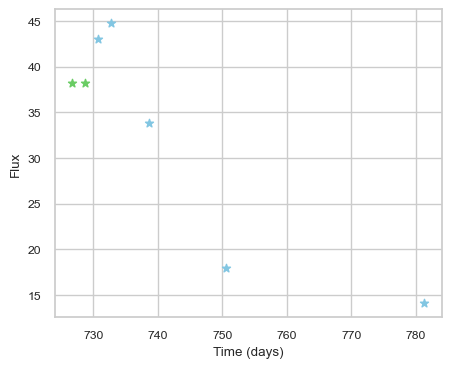

SNIax (3.8399236, False)
SNIax (3.3239245, False)
SNIax (2.8592494, False)
SNIax (2.702633, False)
SNIax (2.6944914, False)
SNIax (2.65925, False)
SNIax (2.6566978, False)
SNIax (2.0630925, False)
SNIax (2.492177, False)
SNIax (2.3446245, False)
SNIax (3.2340393, False)
SNIax (3.1014504, False)
SNIax (3.727224, False)
SNIax (3.3200488, False)


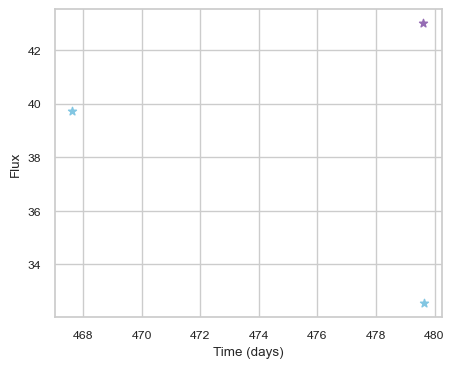

SNIax (4.5693054, False)
SNIax (4.7737865, False)
SNIax (4.8932505, False)
SNIax (5.1386113, False)
SNIax (4.7600226, False)
SNIax (4.757203, False)


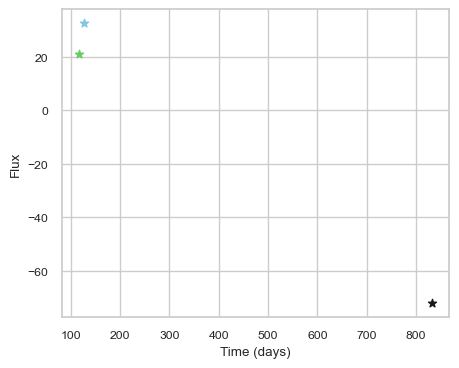

SNIax (4.1973853, False)
SNIax (3.9412398, False)
SNIax (3.5553484, False)
SNIax (3.549736, False)
SNIax (3.8435123, False)
SNIax (3.8862803, False)


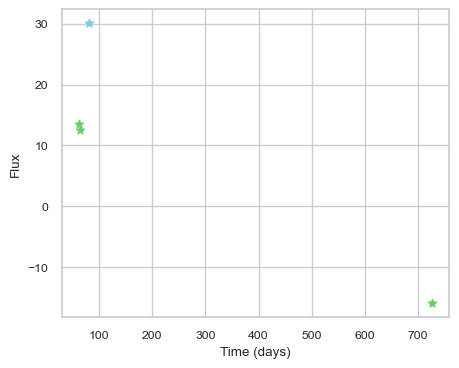

SNIax (4.1838045, False)
SNIax (3.5649078, False)
SNIax (3.0905933, False)
SNIax (3.1866553, False)
SNIax (2.8658001, False)
SNIax (2.6531074, False)
SNIax (3.5089786, False)
SNIax (3.4526238, False)


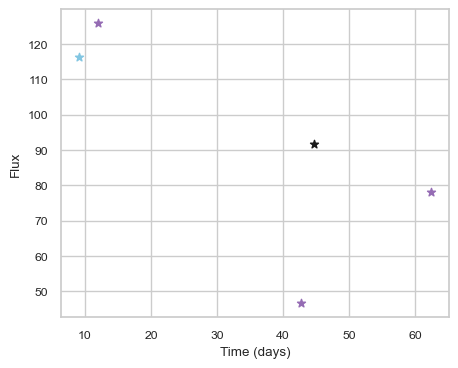

SNIax (4.082295, False)
SNIax (4.0923233, False)
SNIax (5.504907, False)
SNIax (5.0084724, False)
SNIax (6.3052707, False)
SNIax (5.8790174, False)
SNIax (6.2346354, False)
SNIax (6.300577, False)
SNIax (5.4555764, False)
SNIax (5.76566, False)


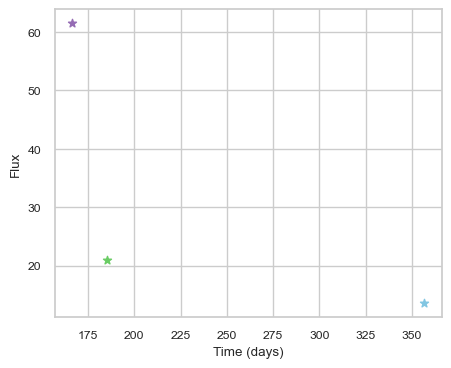

SNIax (3.9513175, False)
SNIax (4.146528, False)
SNIax (4.3141637, False)
SNIax (3.5501974, False)
SNIax (4.4261627, False)
SNIax (3.6633172, False)


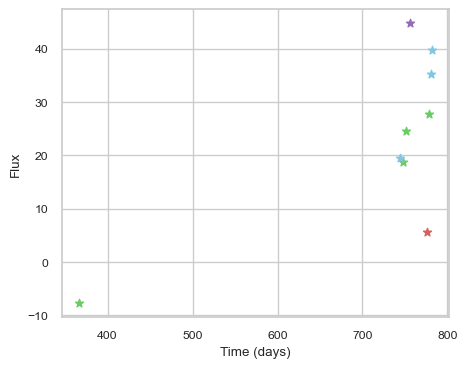

SNIax (4.096365, False)
SNIax (4.2649155, False)
SNIax (3.7836955, False)
SNIax (3.3606029, False)
SNIax (3.0049644, False)
SNIax (2.538846, False)
SNIax (3.0101235, False)
SNIax (2.1346116, False)
SNIax (2.7207816, False)
SNIax (2.3373175, False)
SNIax (2.6380038, False)
SNIax (2.6277833, False)
SNIax (2.8238163, False)
SNIax (2.3120697, False)
SNIax (2.8255856, False)
SNIax (2.3477468, False)
SNIax (2.7082984, False)
SNIax (2.513438, False)


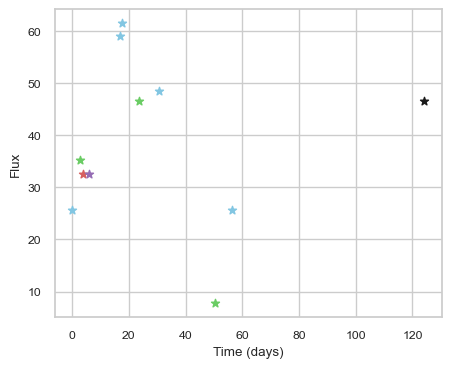

SNIax (4.2207646, False)
SNIax (3.8603578, False)
SNIax (3.6752477, False)
SNIax (3.9571328, False)
SNIax (4.6920156, False)
SNIax (4.8710737, False)
SNIax (5.7659664, False)
SNIax (5.288662, False)
SNIax (4.111331, False)
SNIax (3.8346806, False)
SNIax (3.642487, False)
SNIax (3.7235637, False)
SNIax (3.9207137, False)
SNIax (4.1267653, False)
SNIax (4.060484, False)
SNIax (4.2655926, False)
SNIax (3.9449165, False)
SNIax (3.4871418, False)
SNIax (3.3598611, False)
SNIax (3.5413055, False)
SNIax (4.6369066, False)


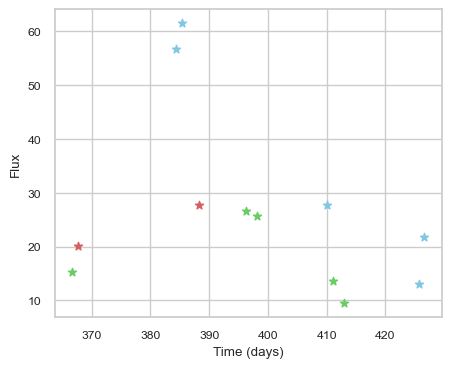

SNIax (3.6550717, False)
SNIax (3.5742798, False)
SNIax (3.2716491, False)
SNIax (3.7624662, False)
SNIax (3.5080397, False)
SNIax (3.1668346, False)
SNIax (3.0700438, False)
SNIax (3.1382692, False)
SNIax (3.4396646, False)
SNIax (2.9343517, False)
SNIax (2.9873068, False)
SNIax (2.7580357, False)
SNIax (3.413641, False)
SNIax (2.858105, False)
SNIax (3.0912075, False)
SNIax (2.5197043, False)
SNIax (2.394832, False)
SNIax (2.1791563, False)
SNIax (2.7768543, False)
SNIax (2.0453477, False)
SNIax (2.6613157, False)
SNIax (2.3575838, False)
SNIax (2.137193, False)
SNIax (1.9370079, False)


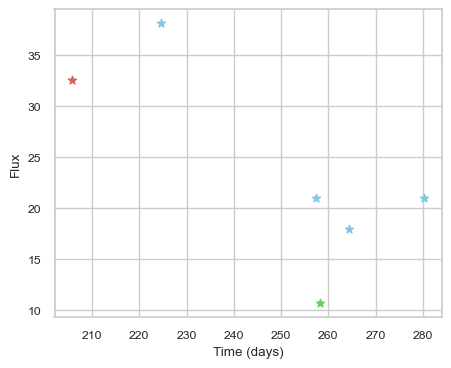

SNIax (3.5696342, False)
SNIax (3.929412, False)
SNIax (3.6173017, False)
SNIax (3.0818326, False)
SNIax (4.6257763, False)
SNIax (3.935923, False)
SNIax (3.6955762, False)
SNIax (4.277446, False)
SNIax (4.173393, False)
SNIax (4.200111, False)
SNIax (4.5629344, False)
SNIax (3.9990416, False)


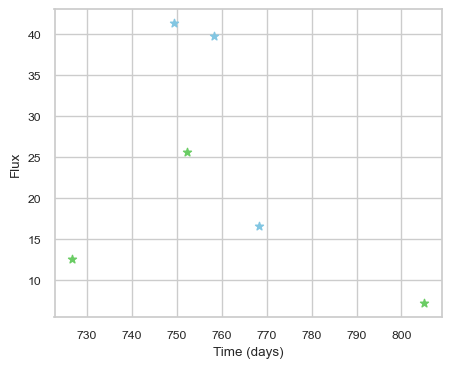

SNIax (3.8766963, False)
SNIax (3.4059002, False)
SNIax (3.2791631, False)
SNIax (3.0205574, False)
SNIax (2.927985, False)
SNIax (2.6875145, False)
SNIax (3.207822, False)
SNIax (2.8106878, False)
SNIax (2.95914, False)
SNIax (3.0814211, False)
SNIax (3.117223, False)
SNIax (2.8481598, False)


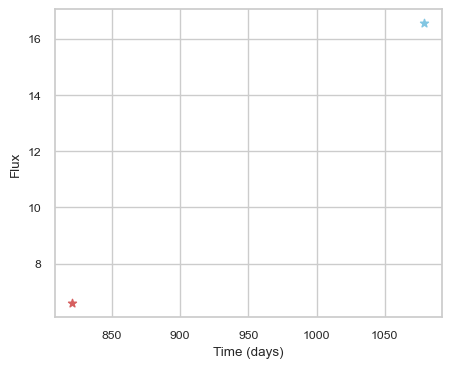

SNIax (4.7669034, False)
SNIax (4.592473, False)
SNIax (4.5506835, False)
SNIax (4.600102, False)


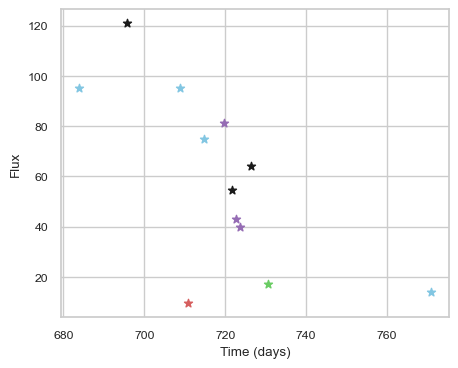

SNIax (3.7862463, False)
SNIax (3.9427698, False)
SNIax (4.34267, False)
SNIax (4.243576, False)
SNIax (4.3685846, False)
SNIax (4.0318594, False)
SNIax (4.0922785, False)
SNIax (5.577749, False)
SNIax (5.8918777, False)
SNIax (5.509871, False)
SNIax (4.9800525, False)
SNIax (3.9746635, False)
SNIax (4.9780226, False)
SNIax (5.030353, False)
SNIax (5.4988008, False)
SNIax (4.460052, False)
SNIax (6.100208, False)
SNIax (4.7399344, False)
SNIax (5.7218328, False)
SNIax (5.307199, False)
SNIax (4.9616733, False)
SNIax (4.4991765, False)
SNIax (5.0368886, False)
SNIax (4.8730493, False)


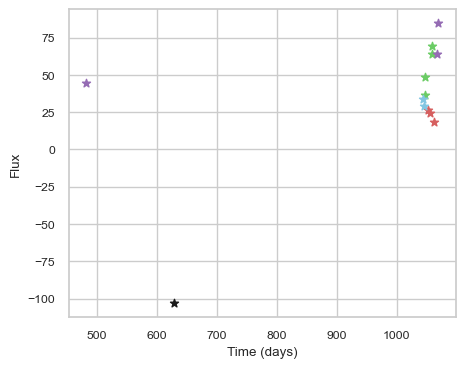

SNIax (3.9408638, False)
SNIax (4.060722, False)
SNIax (3.7121577, False)
SNIax (4.015163, False)
SNIax (3.7860143, False)
SNIax (3.4368918, False)
SNIax (2.9302223, False)
SNIax (3.3067796, False)
SNIax (2.9329286, False)
SNIax (2.6388948, False)
SNIax (3.409255, False)
SNIax (2.1547472, False)
SNIax (2.4753048, False)
SNIax (2.3001184, False)
SNIax (3.1108959, False)
SNIax (2.266311, False)
SNIax (2.7096624, False)
SNIax (2.1175551, False)
SNIax (3.0737169, False)
SNIax (2.7785783, False)
SNIax (3.2787905, False)
SNIax (3.2131848, False)
SNIax (3.5633278, False)
SNIax (3.0593512, False)
SNIax (4.1903872, False)
SNIax (3.05902, False)


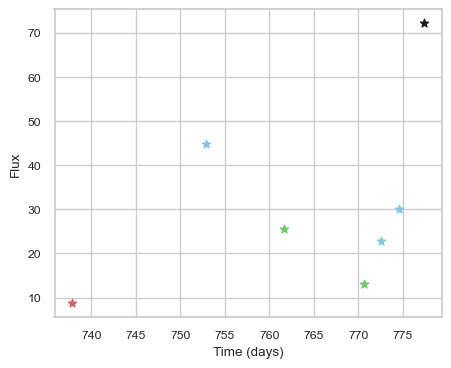

SNIax (4.7906604, False)
SNIax (3.7381477, False)
SNIax (4.066306, False)
SNIax (4.6025767, False)
SNIax (5.0882845, False)
SNIax (5.522874, False)
SNIax (5.199376, False)
SNIax (5.031814, False)
SNIax (5.066647, False)
SNIax (4.661884, False)
SNIax (4.373171, False)
SNIax (4.4940944, False)
SNIax (4.4690776, False)
SNIax (4.2740426, False)


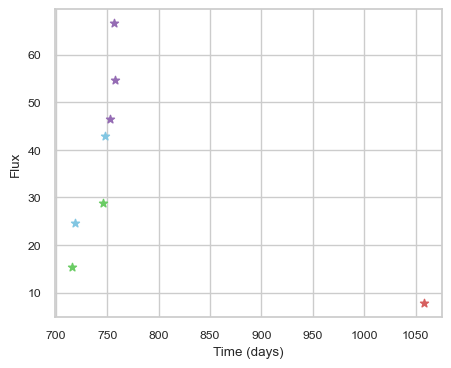

SNIax (4.3877234, False)
SNIax (3.5414703, False)
SNIax (3.1073651, False)
SNIax (3.2368808, False)
SNIax (3.4237666, False)
SNIax (3.4761925, False)
SNIax (3.7265706, False)
SNIax (4.2020593, False)
SNIax (5.051537, False)
SNIax (4.5840387, False)
SNIax (4.916433, False)
SNIax (4.970377, False)
SNIax (5.3948555, False)
SNIax (4.806935, False)
SNIax (5.001772, False)
SNIax (5.4725504, False)


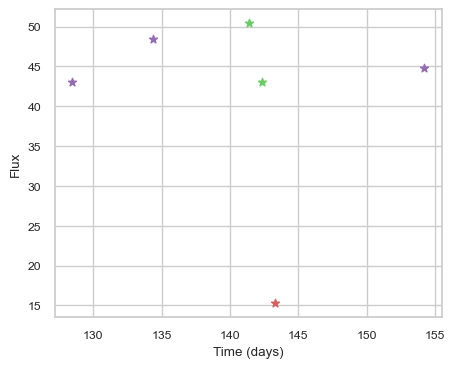

SNIax (4.0265107, False)
SNIax (4.3304653, False)
SNIax (4.1216283, False)
SNIax (4.0718827, False)
SNIax (3.5069995, False)
SNIax (3.7294867, False)
SNIax (3.3639061, False)
SNIax (3.5284305, False)
SNIax (3.5369463, False)
SNIax (3.5079312, False)
SNIax (3.3768272, False)
SNIax (2.6649532, False)


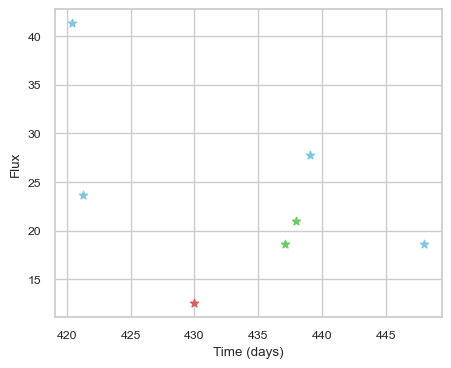

SNIax (3.9039023, False)
SNIax (3.6964223, False)
SNIax (3.452652, False)
SNIax (3.488947, False)
SNIax (2.7335398, False)
SNIax (2.8490875, False)
SNIax (3.0892885, False)
SNIax (2.8824286, False)
SNIax (3.5549183, False)
SNIax (3.108674, False)
SNIax (3.214778, False)
SNIax (3.1532352, False)
SNIax (3.092601, False)
SNIax (3.3579526, False)


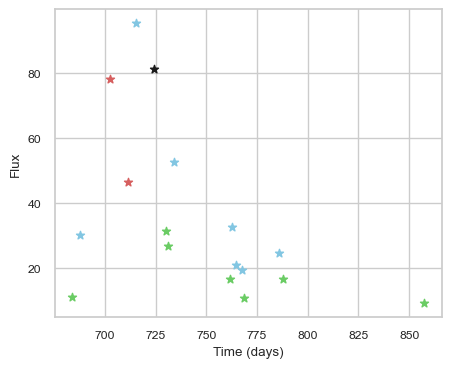

SNIax (3.716231, False)
SNIax (3.6217403, False)
SNIax (3.2996614, False)
SNIax (3.3429136, False)
SNIax (2.705651, False)
SNIax (3.7091544, False)
SNIax (3.7304294, False)
SNIax (3.6224697, False)
SNIax (3.0746632, False)
SNIax (3.1255832, False)
SNIax (3.5506613, False)
SNIax (3.783768, False)
SNIax (3.1054373, False)
SNIax (3.5603979, False)
SNIax (3.619611, False)
SNIax (3.1215281, False)
SNIax (3.610588, False)
SNIax (2.6474154, False)
SNIax (3.3872015, False)
SNIax (3.087292, False)
SNIax (3.2259297, False)
SNIax (2.5259373, False)
SNIax (3.0158796, False)
SNIax (2.399179, False)
SNIax (2.4054322, False)
SNIax (2.1246579, False)
SNIax (2.1898522, False)
SNIax (2.3740106, False)
SNIax (2.6996925, False)
SNIax (2.0267022, False)
SNIax (2.774319, False)
SNIax (2.297797, False)
SNIax (3.3534408, False)
SNIax (2.6098948, False)


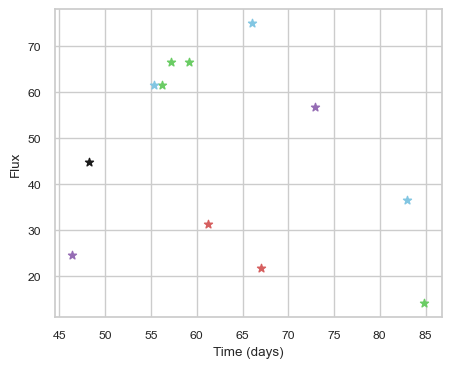

SNIax (4.2106705, False)
SNIax (3.9008133, False)
SNIax (3.614283, False)
SNIax (4.3821874, False)
SNIax (3.2938695, False)
SNIax (3.4145105, False)
SNIax (3.7632606, False)
SNIax (3.2196429, False)
SNIax (3.4633427, False)
SNIax (3.1627052, False)
SNIax (3.9091427, False)
SNIax (3.3940706, False)
SNIax (3.9758017, False)
SNIax (3.624886, False)
SNIax (4.34967, False)
SNIax (3.9836147, False)
SNIax (4.30601, False)
SNIax (4.386069, False)
SNIax (4.1790543, False)
SNIax (3.9380145, False)
SNIax (4.2827687, False)
SNIax (4.0438957, False)
SNIax (3.8913968, False)
SNIax (3.4010806, False)


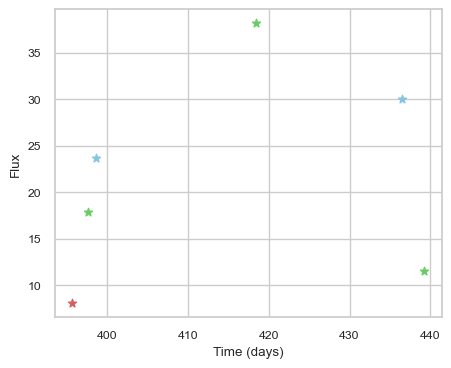

SNIax (4.322333, False)
SNIax (3.9869063, False)
SNIax (3.3469768, False)
SNIax (2.9561162, False)
SNIax (3.141267, False)
SNIax (2.6117373, False)
SNIax (2.8680613, False)
SNIax (2.9954937, False)
SNIax (2.9018886, False)
SNIax (2.169097, False)
SNIax (2.4171507, False)
SNIax (2.3073266, False)


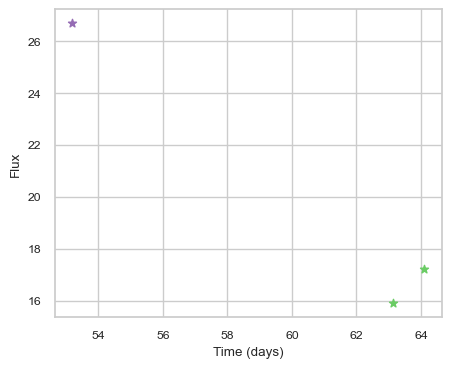

SNIax (4.0215025, False)
SNIax (3.6140845, False)
SNIax (3.2493129, False)
SNIax (3.12961, False)
SNIax (3.1950989, False)
SNIax (3.2215955, False)


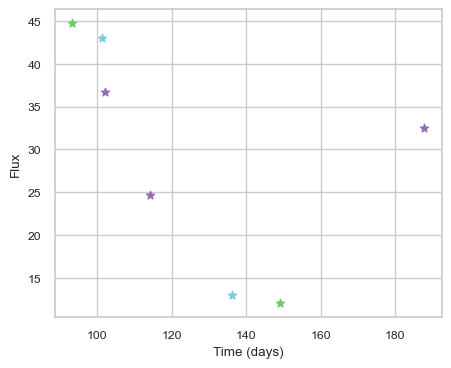

SNIax (3.8256485, False)
SNIax (3.7729187, False)
SNIax (3.8142705, False)
SNIax (4.554017, False)
SNIax (4.541484, False)
SNIax (5.894052, False)
SNIax (5.409651, False)
SNIax (5.755164, False)
SNIax (5.02469, False)
SNIax (4.5489936, False)
SNIax (3.8807712, False)
SNIax (4.5304766, False)
SNIax (4.3869023, False)
SNIax (5.2348833, False)


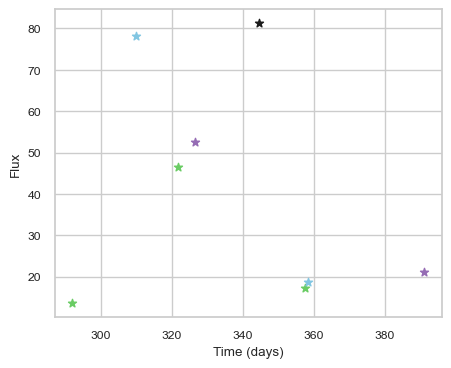

SNIax (3.8955538, False)
SNIax (3.969416, False)
SNIax (3.2314465, False)
SNIax (3.623322, False)
SNIax (3.7359943, False)
SNIax (3.7668536, False)
SNIax (4.1678824, False)
SNIax (3.3210707, False)
SNIax (2.9237742, False)
SNIax (3.2130558, False)
SNIax (4.532209, False)
SNIax (3.3527498, False)
SNIax (3.3670137, False)
SNIax (2.5861511, False)
SNIax (2.7651863, False)
SNIax (2.7387857, False)


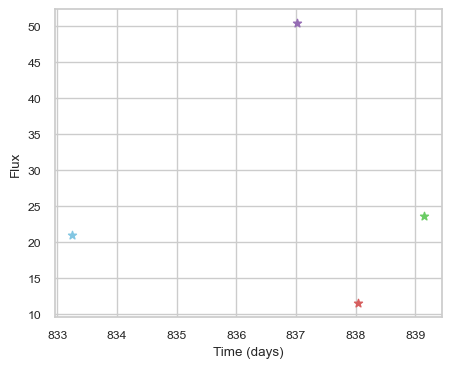

SNIax (3.8568923, False)
SNIax (3.201751, False)
SNIax (3.353721, False)
SNIax (3.5347695, False)
SNIax (3.6877685, False)
SNIax (3.2624223, False)
SNIax (2.846349, False)
SNIax (2.8261218, False)


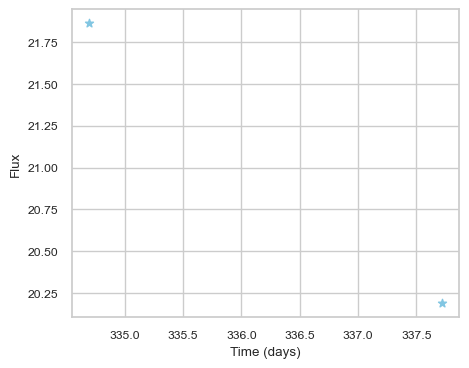

SNIax (4.097064, False)
SNIax (3.7824879, False)
SNIax (3.12748, False)
SNIax (3.648238, False)


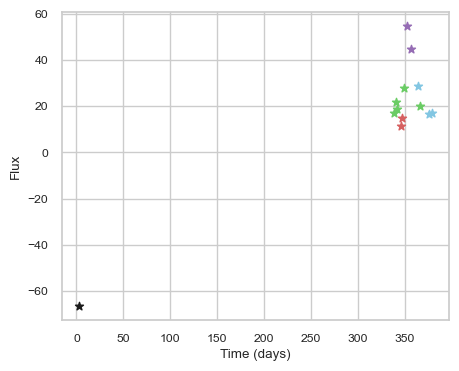

SNIax (4.1288347, False)
SNIax (3.9511378, False)
SNIax (3.8901045, False)
SNIax (3.2381055, False)
SNIax (3.4577224, False)
SNIax (2.5107605, False)
SNIax (2.6997573, False)
SNIax (2.677127, False)
SNIax (3.1744776, False)
SNIax (3.1053507, False)
SNIax (3.525792, False)
SNIax (2.9270568, False)
SNIax (3.039015, False)
SNIax (2.0231385, False)
SNIax (2.9135976, False)
SNIax (2.6688228, False)
SNIax (3.6520877, False)
SNIax (2.8154438, False)
SNIax (2.9062696, False)
SNIax (3.2356136, False)
SNIax (2.783046, False)
SNIax (2.999054, False)
SNIax (2.9323075, False)
SNIax (2.8462496, False)
SNIax (2.4160068, False)
SNIax (2.7067997, False)


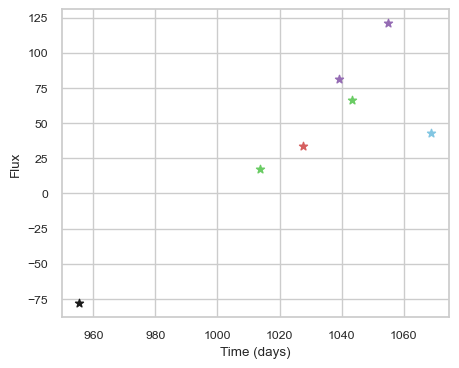

SNIax (3.8350742, False)
SNIax (3.68841, False)
SNIax (3.9253738, False)
SNIax (3.4173045, False)
SNIax (3.2865741, False)
SNIax (3.7347279, False)
SNIax (3.401763, False)
SNIax (3.8237786, False)
SNIax (4.1975527, False)
SNIax (4.2637196, False)
SNIax (5.074973, False)
SNIax (3.5742009, False)
SNIax (3.7016714, False)
SNIax (2.8469203, False)


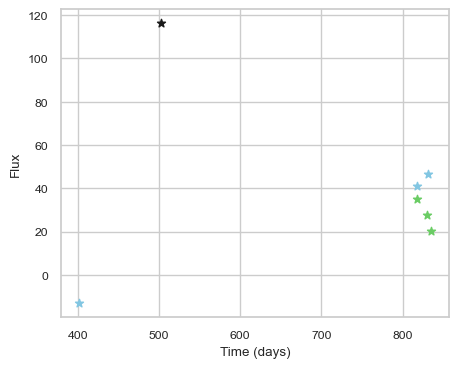

SNIax (4.023393, False)
SNIax (3.8010871, False)
SNIax (3.9129515, False)
SNIax (3.9299417, False)
SNIax (3.7873006, False)
SNIax (3.4138305, False)
SNIax (3.5181668, False)
SNIax (3.5228186, False)
SNIax (3.6683905, False)
SNIax (2.6582289, False)
SNIax (2.9887006, False)
SNIax (4.724559, False)
SNIax (4.8174934, False)
SNIax (5.0391393, False)


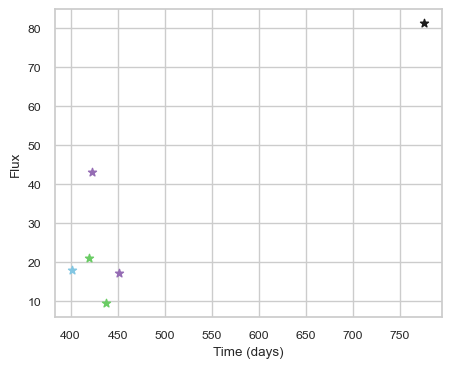

SNIax (4.8296075, False)
SNIax (4.0862513, False)
SNIax (4.5340157, False)
SNIax (4.1511006, False)
SNIax (4.33723, False)
SNIax (4.2177806, False)
SNIax (4.8861613, False)
SNIax (4.5025253, False)
SNIax (4.7077107, False)
SNIax (4.960059, False)
SNIax (4.716085, False)
SNIax (5.3365345, False)


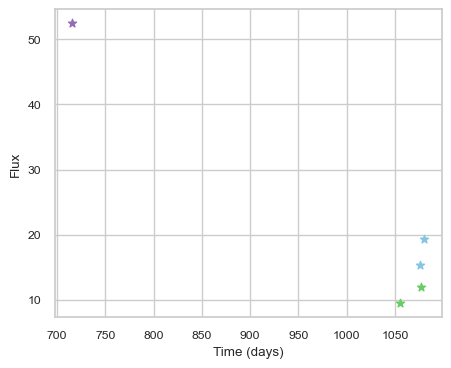

SNIax (4.5161133, False)
SNIax (4.613762, False)
SNIax (4.886343, False)
SNIax (4.400054, False)
SNIax (4.7265835, False)
SNIax (4.1212544, False)
SNIax (3.3919818, False)
SNIax (3.3880236, False)
SNIax (3.5984483, False)
SNIax (3.0790975, False)


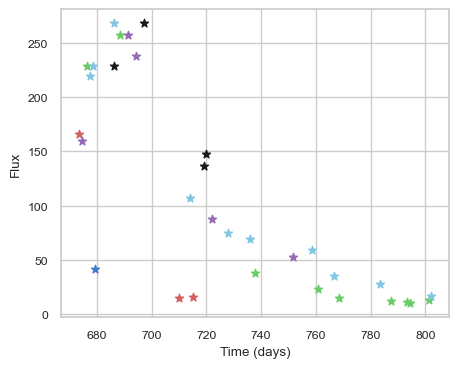

SNIax (3.7914453, False)
SNIax (4.0819845, False)
SNIax (4.5285697, False)
SNIax (4.6427574, False)
SNIax (4.504959, False)
SNIax (4.9556665, False)
SNIax (5.073453, False)
SNIax (5.3220024, False)
SNIax (5.2333465, False)
SNIax (5.307029, False)
SNIax (5.445515, False)
SNIax (5.9496517, False)
SNIax (5.0534725, False)
SNIax (5.395615, False)
SNIax (5.588633, False)
SNIax (5.2446804, False)
SNIax (3.8273492, False)
SNIax (3.313684, False)
SNIax (3.669794, False)
SNIax (3.7461536, False)
SNIax (3.0660558, False)
SNIax (2.8005202, False)
SNIax (2.9280365, False)
SNIax (2.7360845, False)
SNIax (2.8130097, False)
SNIax (2.651552, False)
SNIax (2.725228, False)
SNIax (2.3523242, False)
SNIax (2.9183767, False)
SNIax (2.635172, False)
SNIax (3.184671, False)
SNIax (2.6444755, False)
SNIax (3.728145, False)
SNIax (2.7756872, False)
SNIax (3.9792213, False)
SNIax (2.7444062, False)
SNIax (3.0623302, False)
SNIax (2.7822442, False)
SNIax (3.4094703, False)
SNIax (2.968097, False)
SNIax (3.28001

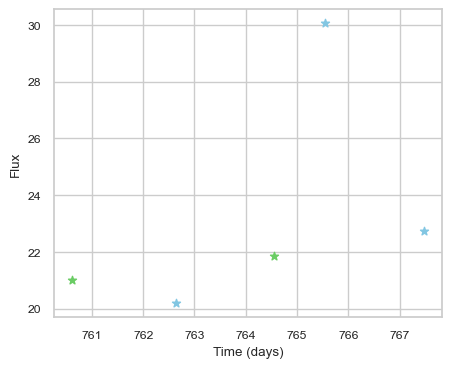

SNIax (4.040279, False)
SNIax (3.1266248, False)
SNIax (3.0542588, False)
SNIax (3.0233068, False)
SNIax (3.3620524, False)
SNIax (3.153443, False)
SNIax (3.3025448, False)
SNIax (2.815074, False)
SNIax (2.9045863, False)
SNIax (2.5744236, False)


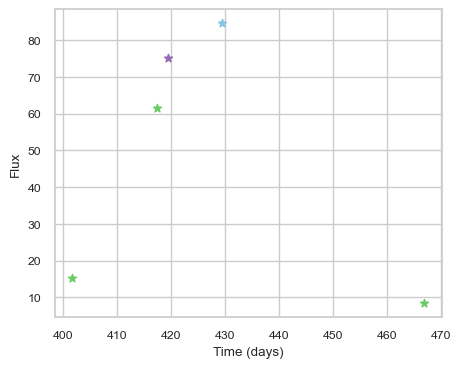

SNIax (3.7951658, False)
SNIax (3.6333368, False)
SNIax (3.3590488, False)
SNIax (3.3715153, False)
SNIax (3.4216158, False)
SNIax (3.4419096, False)
SNIax (3.4877095, False)
SNIax (3.4794192, False)
SNIax (3.3553011, False)
SNIax (2.9764056, False)


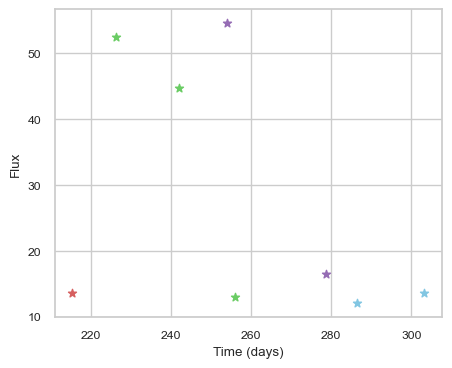

SNIax (3.841804, False)
SNIax (3.3131769, False)
SNIax (3.330218, False)
SNIax (3.3367412, False)
SNIax (3.8673968, False)
SNIax (3.820979, False)
SNIax (3.9603136, False)
SNIax (3.288994, False)
SNIax (3.7145643, False)
SNIax (3.672296, False)
SNIax (3.585036, False)
SNIax (3.8537543, False)
SNIax (3.3413503, False)
SNIax (3.6472363, False)
SNIax (3.5976238, False)
SNIax (3.5293775, False)


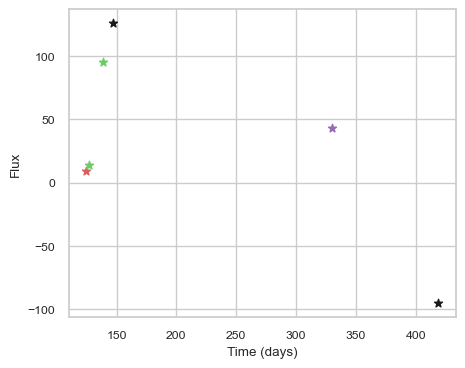

SNIax (3.7482097, False)
SNIax (3.841104, False)
SNIax (3.0047119, False)
SNIax (3.8829024, False)
SNIax (3.289984, False)
SNIax (3.66985, False)
SNIax (3.4788685, False)
SNIax (3.523629, False)
SNIax (3.3590753, False)
SNIax (2.8887596, False)
SNIax (3.7669106, False)
SNIax (3.8533022, False)


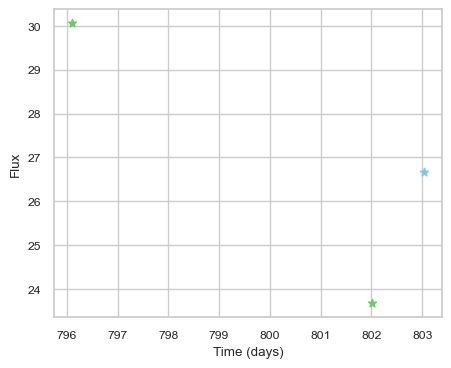

SNIax (3.6596334, False)
SNIax (3.4473693, False)
SNIax (3.194502, False)
SNIax (3.8939922, False)
SNIax (3.5804493, False)
SNIax (4.3787847, False)


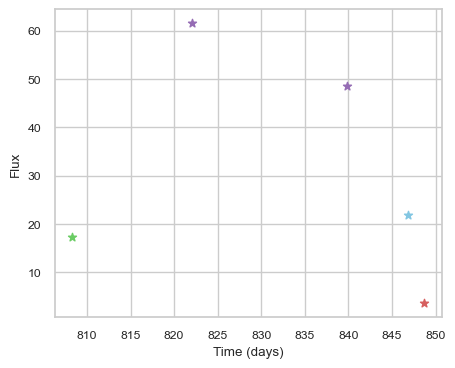

SNIax (3.8504782, False)
SNIax (3.5933406, False)
SNIax (3.138084, False)
SNIax (3.6371639, False)
SNIax (3.2953455, False)
SNIax (3.121023, False)
SNIax (2.7926028, False)
SNIax (2.8570387, False)
SNIax (2.5371768, False)
SNIax (2.9993753, False)


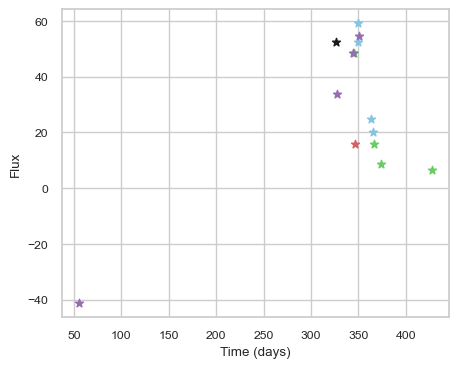

SNIax (3.9743938, False)
SNIax (3.8719485, False)
SNIax (3.8497, False)
SNIax (3.7121785, False)
SNIax (3.8563128, False)
SNIax (3.3383021, False)
SNIax (3.5783615, False)
SNIax (3.196821, False)
SNIax (3.8372922, False)
SNIax (3.264836, False)
SNIax (3.5042107, False)
SNIax (3.465983, False)
SNIax (3.613181, False)
SNIax (3.236218, False)
SNIax (3.5655303, False)
SNIax (3.921136, False)
SNIax (3.915392, False)
SNIax (3.1498392, False)
SNIax (3.6808197, False)
SNIax (3.6047742, False)
SNIax (3.10899, False)
SNIax (3.5672622, False)
SNIax (2.8327882, False)
SNIax (3.2275474, False)
SNIax (2.858404, False)
SNIax (2.9476252, False)
SNIax (3.600683, False)
SNIax (3.7616851, False)


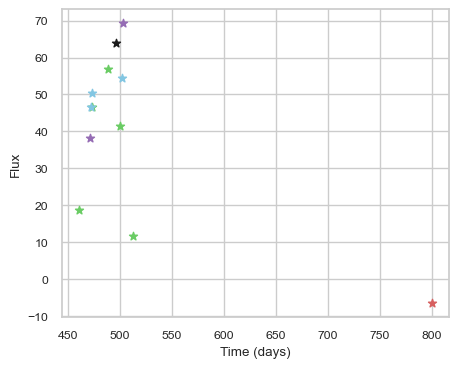

SNIax (4.1740584, False)
SNIax (3.507773, False)
SNIax (3.5949278, False)
SNIax (2.9963093, False)
SNIax (3.4049962, False)
SNIax (3.177742, False)
SNIax (3.1345823, False)
SNIax (2.6779954, False)
SNIax (2.9501688, False)
SNIax (2.6351206, False)
SNIax (3.5782795, False)
SNIax (3.221392, False)
SNIax (3.8405907, False)
SNIax (3.3902817, False)
SNIax (3.6760228, False)
SNIax (3.530133, False)
SNIax (3.3533156, False)
SNIax (2.9131575, False)
SNIax (3.0960407, False)
SNIax (2.7290657, False)
SNIax (2.70926, False)
SNIax (2.7663152, False)
SNIax (2.9648445, False)
SNIax (3.4884257, False)


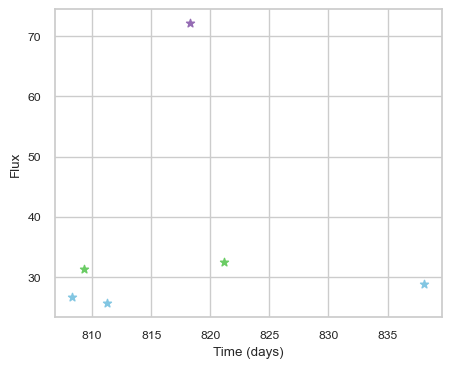

SNIax (4.0647902, False)
SNIax (3.457262, False)
SNIax (3.1445372, False)
SNIax (2.8870847, False)
SNIax (3.491056, False)
SNIax (2.655594, False)
SNIax (3.2584858, False)
SNIax (3.112455, False)
SNIax (3.6383727, False)
SNIax (2.815143, False)
SNIax (2.86978, False)
SNIax (2.8994467, False)


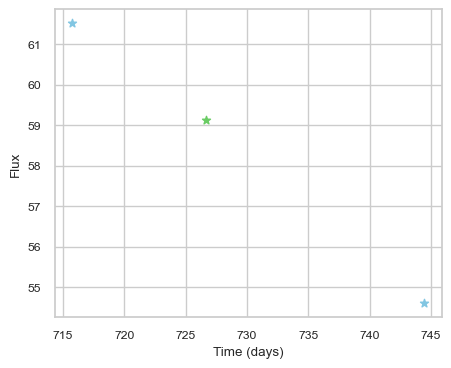

SNIax (3.9804747, False)
SNIax (4.132897, False)
SNIax (4.7149076, False)
SNIax (4.2887197, False)
SNIax (3.309841, False)
SNIax (2.7875197, False)


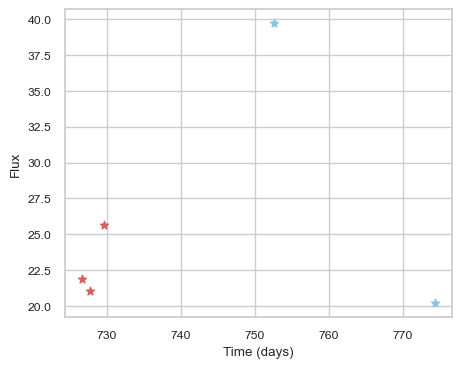

SNIax (3.859696, False)
SNIax (4.1442156, False)
SNIax (4.197982, False)
SNIax (3.9008064, False)
SNIax (3.804136, False)
SNIax (3.4401596, False)
SNIax (3.7180777, False)
SNIax (3.2807827, False)
SNIax (4.3414226, False)
SNIax (3.43458, False)


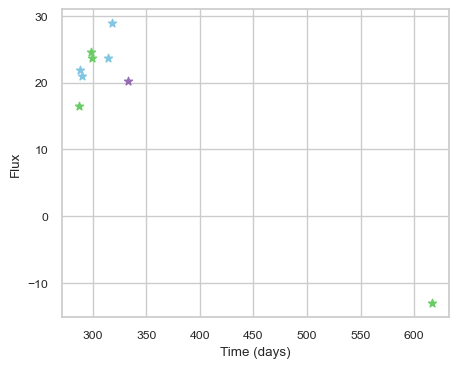

SNIax (5.219243, False)
SNIax (4.67791, False)
SNIax (4.3226957, False)
SNIax (5.027459, False)
SNIax (4.2809863, False)
SNIax (5.355858, False)
SNIax (4.6535015, False)
SNIax (5.4148726, False)
SNIax (5.4068666, False)
SNIax (5.659707, False)
SNIax (5.562997, False)
SNIax (5.621495, False)
SNIax (4.858261, False)
SNIax (5.172356, False)
SNIax (5.182463, False)
SNIax (4.8723354, False)
SNIax (5.142865, False)
SNIax (4.9920363, False)


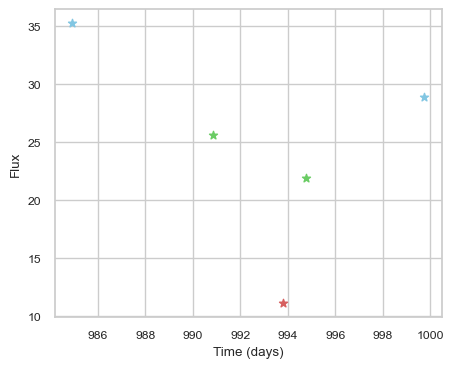

SNIax (4.1067777, False)
SNIax (3.9605744, False)
SNIax (3.9569068, False)
SNIax (3.511693, False)
SNIax (3.1086888, False)
SNIax (2.787465, False)
SNIax (3.0953648, False)
SNIax (2.1696305, False)
SNIax (2.8406022, False)
SNIax (2.396401, False)


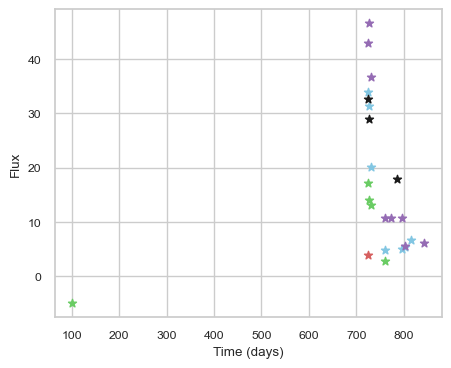

SNIax (4.2366953, False)
SNIax (4.455219, False)
SNIax (3.7794445, False)
SNIax (2.9713871, False)
SNIax (3.4617264, False)
SNIax (3.1440437, False)
SNIax (3.2908263, False)
SNIax (3.269258, False)
SNIax (3.0042472, False)
SNIax (2.4837656, False)
SNIax (2.6364667, False)
SNIax (2.6132016, False)
SNIax (2.9747286, False)
SNIax (2.7312841, False)
SNIax (2.6725066, False)
SNIax (2.4715881, False)
SNIax (2.5401475, False)
SNIax (2.267474, False)
SNIax (2.6963034, False)
SNIax (2.8625584, False)
SNIax (2.7530725, False)
SNIax (2.4887223, False)
SNIax (3.1052287, False)
SNIax (3.0410545, False)
SNIax (2.5096529, False)
SNIax (2.758643, False)
SNIax (2.9041438, False)
SNIax (3.0719123, False)
SNIax (3.1230297, False)
SNIax (3.3989809, False)
SNIax (3.474387, False)
SNIax (3.4143505, False)
SNIax (3.8494668, False)
SNIax (3.5776494, False)
SNIax (3.120881, False)
SNIax (3.4436734, False)
SNIax (3.7840931, False)
SNIax (4.195915, False)


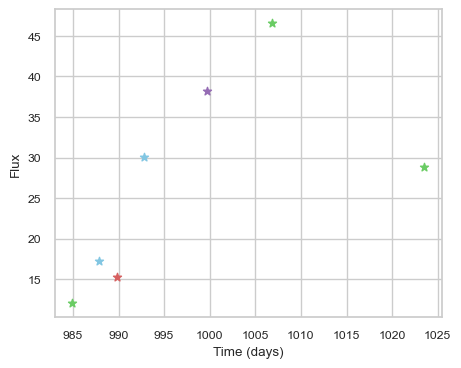

SNIax (3.9130204, False)
SNIax (3.7772326, False)
SNIax (3.412368, False)
SNIax (3.454383, False)
SNIax (3.2674804, False)
SNIax (3.6418452, False)
SNIax (2.913917, False)
SNIax (3.0581691, False)
SNIax (2.921551, False)
SNIax (2.9607842, False)
SNIax (2.7853825, False)
SNIax (2.111934, False)
SNIax (2.634614, False)
SNIax (2.766192, False)


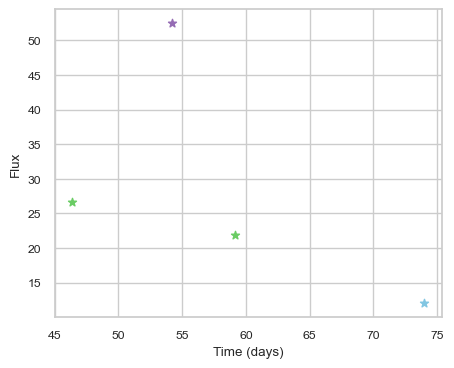

SNIax (5.3139615, False)
SNIax (3.9040446, False)
SNIax (4.354299, False)
SNIax (4.8360777, False)
SNIax (5.504701, False)
SNIax (4.931945, False)
SNIax (4.7385235, False)
SNIax (4.324726, False)


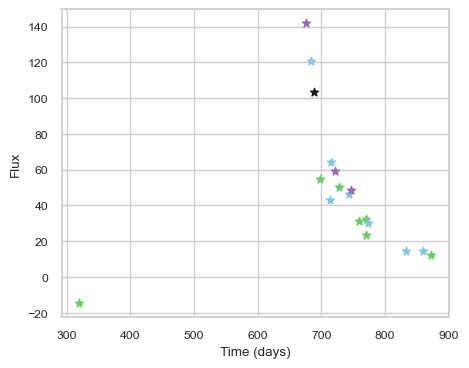

SNIax (3.7474165, False)
SNIax (4.3125424, False)
SNIax (3.9905663, False)
SNIax (4.304114, False)
SNIax (3.4265935, False)
SNIax (3.6188748, False)
SNIax (4.1184235, False)
SNIax (4.794884, False)
SNIax (4.3697805, False)
SNIax (3.6926906, False)
SNIax (4.132736, False)
SNIax (2.9939604, False)
SNIax (2.4907763, False)
SNIax (2.4057078, False)
SNIax (2.9487958, False)
SNIax (2.4306617, False)
SNIax (2.26161, False)
SNIax (2.6251953, False)
SNIax (4.208101, False)
SNIax (2.1965833, False)
SNIax (2.9756997, False)
SNIax (2.8933852, False)
SNIax (3.3272986, False)
SNIax (3.0360618, False)
SNIax (3.5156267, False)
SNIax (3.3737469, False)
SNIax (3.1612859, False)
SNIax (3.4382493, False)
SNIax (2.8459194, False)
SNIax (2.886031, False)
SNIax (2.7996194, False)
SNIax (2.796158, False)
SNIax (2.4799602, False)
SNIax (2.524866, False)
SNIax (1.899033, False)
SNIax (2.54327, False)


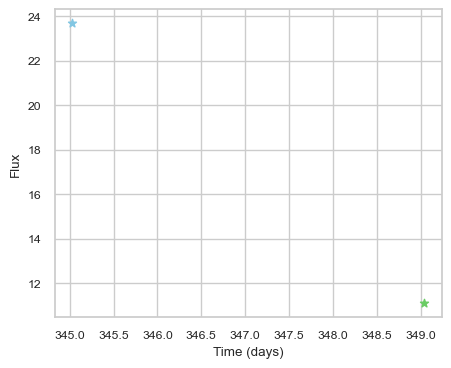

SNIax (4.837499, False)
SNIax (5.017053, False)
SNIax (4.986209, False)
SNIax (4.5398626, False)


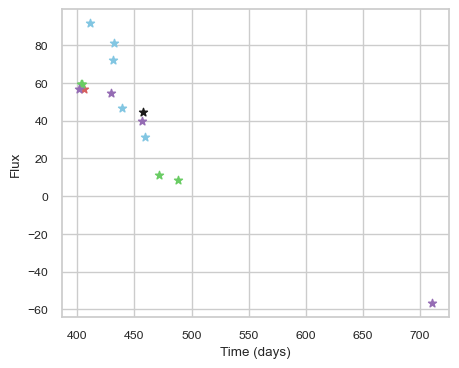

SNIax (3.8601615, False)
SNIax (3.1383603, False)
SNIax (3.5199432, False)
SNIax (3.087488, False)
SNIax (3.0937192, False)
SNIax (2.9937837, False)
SNIax (2.8286622, False)
SNIax (2.9186864, False)
SNIax (3.879376, False)
SNIax (2.8885992, False)
SNIax (3.1909676, False)
SNIax (2.5706315, False)
SNIax (2.718338, False)
SNIax (2.4128647, False)
SNIax (3.394334, False)
SNIax (2.8889031, False)
SNIax (3.4012718, False)
SNIax (2.6714787, False)
SNIax (2.9532976, False)
SNIax (2.660257, False)
SNIax (3.0785172, False)
SNIax (3.0795295, False)
SNIax (3.2962961, False)
SNIax (2.471704, False)
SNIax (2.441154, False)
SNIax (2.521001, False)
SNIax (2.6442816, False)
SNIax (2.2547784, False)
SNIax (3.073334, False)
SNIax (3.0797951, False)


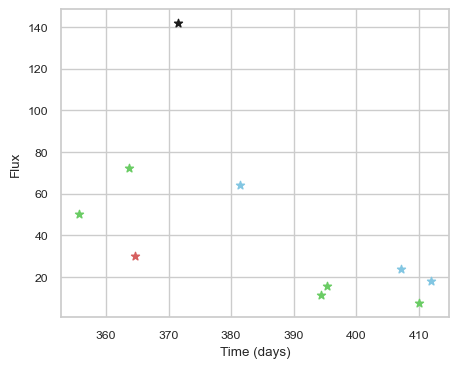

SNIax (3.8361847, False)
SNIax (3.3597045, False)
SNIax (3.643815, False)
SNIax (3.8703344, False)
SNIax (3.9270437, False)
SNIax (3.9205496, False)
SNIax (4.6481943, False)
SNIax (4.087661, False)
SNIax (3.4378276, False)
SNIax (2.9526796, False)
SNIax (3.7527838, False)
SNIax (3.3777888, False)
SNIax (3.2287183, False)
SNIax (3.3834307, False)
SNIax (3.3264766, False)
SNIax (2.9957306, False)
SNIax (3.0027304, False)
SNIax (2.9573762, False)
SNIax (2.955294, False)
SNIax (2.661386, False)


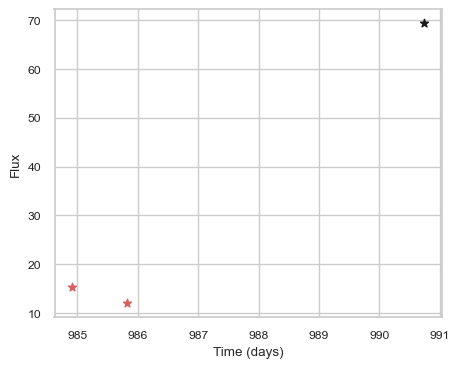

SNIax (3.8602448, False)
SNIax (4.5190763, False)
SNIax (3.9533083, False)
SNIax (4.230712, False)
SNIax (3.5889919, False)
SNIax (3.3855898, False)


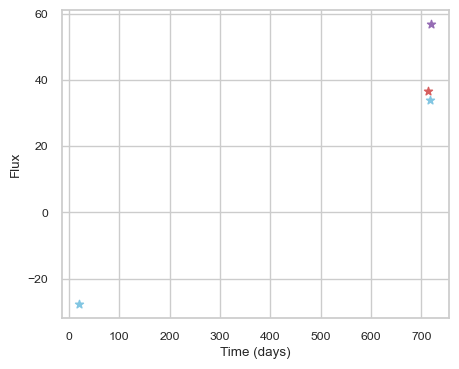

SNIax (6.2086625, False)
SNIax (8.302298, False)
SNIax (5.312107, False)
SNIax (4.6607676, False)
SNIax (3.8368735, False)
SNIax (5.4240475, False)
SNIax (5.3777885, False)
SNIax (6.019707, False)


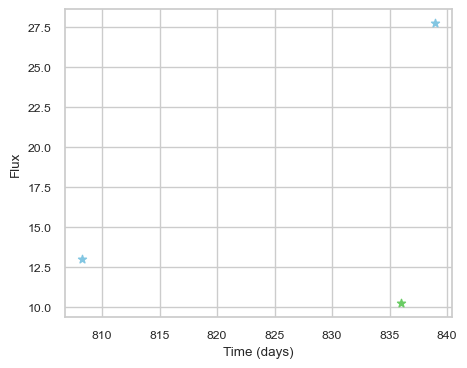

SNIax (4.780687, False)
SNIax (3.9257634, False)
SNIax (4.8719945, False)
SNIax (4.5095696, False)
SNIax (4.541243, False)
SNIax (4.790952, False)


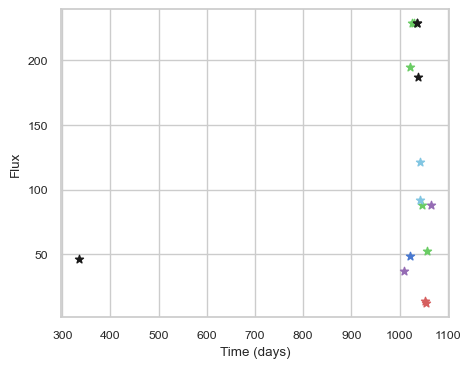

SNIax (3.9094903, False)
SNIax (3.9845984, False)
SNIax (3.9757826, False)
SNIax (3.9018807, False)
SNIax (3.812481, False)
SNIax (4.050486, False)
SNIax (4.5677934, False)
SNIax (4.399953, False)
SNIax (5.245885, False)
SNIax (5.4710336, False)
SNIax (5.8102474, False)
SNIax (5.2357287, False)
SNIax (5.44132, False)
SNIax (5.398724, False)
SNIax (4.500398, False)
SNIax (3.810085, False)
SNIax (3.7600353, False)
SNIax (3.3224065, False)
SNIax (3.864292, False)
SNIax (2.8770943, False)
SNIax (2.9434302, False)
SNIax (3.0200615, False)
SNIax (3.2846992, False)
SNIax (2.785404, False)
SNIax (2.5942717, False)
SNIax (2.9549344, False)
SNIax (3.042784, False)
SNIax (2.5638328, False)
SNIax (2.914686, False)
SNIax (2.6420195, False)
SNIax (3.035804, False)
SNIax (2.5873528, False)


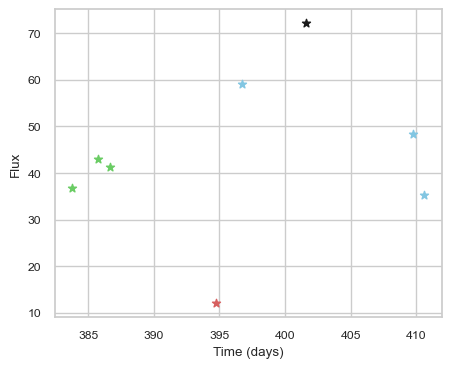

SNIax (3.8931494, False)
SNIax (2.8087566, False)
SNIax (3.3277597, False)
SNIax (2.9676027, False)
SNIax (3.025388, False)
SNIax (2.783457, False)
SNIax (2.6057143, False)
SNIax (2.5041142, False)
SNIax (2.01984, False)
SNIax (2.6097379, False)
SNIax (3.3494842, False)
SNIax (3.123163, False)
SNIax (2.8151705, False)
SNIax (2.6041133, False)
SNIax (2.6814518, False)
SNIax (2.3037996, False)


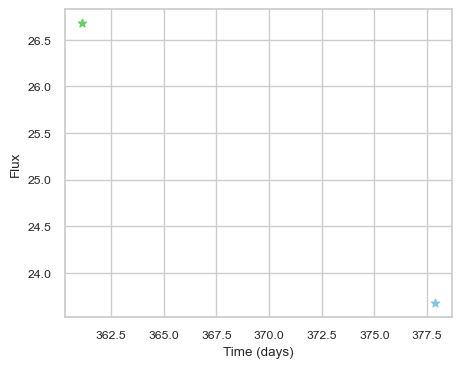

SNIax (4.1746283, False)
SNIax (3.448634, False)
SNIax (3.885487, False)
SNIax (2.910856, False)


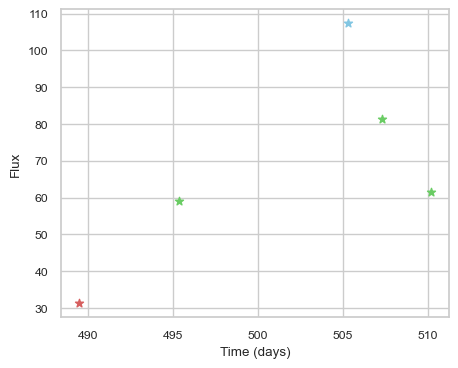

SNIax (4.0907598, False)
SNIax (4.90708, False)
SNIax (4.5768776, False)
SNIax (3.7299821, False)
SNIax (3.342982, False)
SNIax (3.4086583, False)
SNIax (3.6485493, False)
SNIax (3.421103, False)
SNIax (3.659851, False)
SNIax (3.7209432, False)


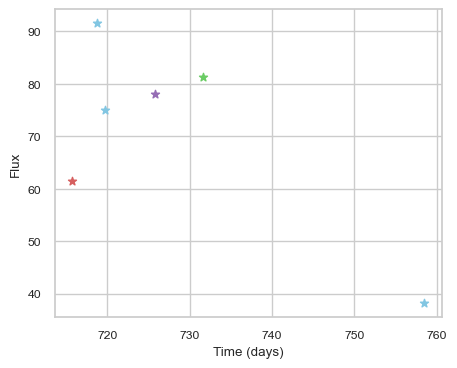

SNIax (4.0574, False)
SNIax (4.5477943, False)
SNIax (4.6662765, False)
SNIax (5.0082955, False)
SNIax (5.1079164, False)
SNIax (4.527145, False)
SNIax (3.7701216, False)
SNIax (3.2538447, False)
SNIax (3.2390544, False)
SNIax (3.7506752, False)
SNIax (4.3658223, False)
SNIax (3.5379026, False)


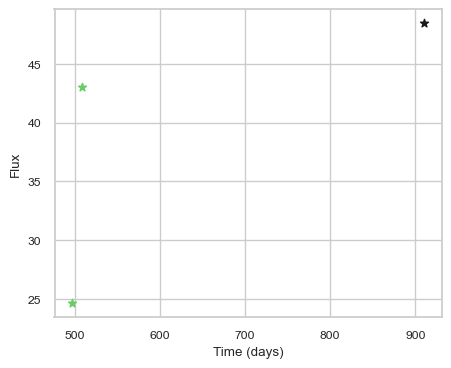

SNIax (3.7999132, False)
SNIax (3.820541, False)
SNIax (3.4368625, False)
SNIax (3.0852737, False)
SNIax (3.8532138, False)
SNIax (3.7217422, False)


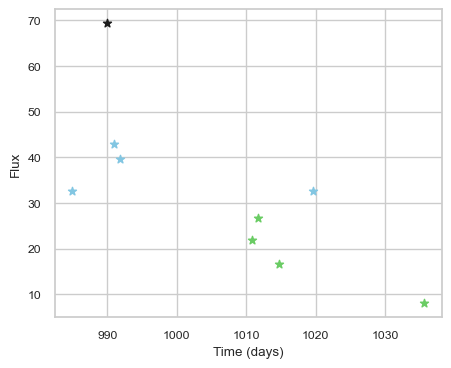

SNIax (3.897543, False)
SNIax (3.686298, False)
SNIax (3.3595908, False)
SNIax (3.9539409, False)
SNIax (4.0678253, False)
SNIax (3.549037, False)
SNIax (3.6712384, False)
SNIax (4.426453, False)
SNIax (3.6949766, False)
SNIax (4.1216145, False)
SNIax (4.074788, False)
SNIax (4.174661, False)
SNIax (4.663798, False)
SNIax (4.220456, False)
SNIax (4.079013, False)
SNIax (3.6072686, False)
SNIax (4.469111, False)
SNIax (4.2226458, False)


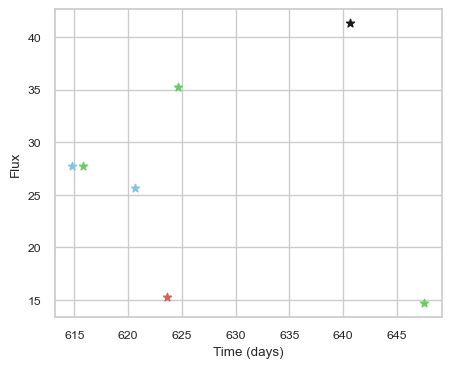

SNIax (3.7126002, False)
SNIax (3.9632397, False)
SNIax (3.231837, False)
SNIax (3.1939154, False)
SNIax (3.3140821, False)
SNIax (3.3628755, False)
SNIax (3.7526665, False)
SNIax (3.872829, False)
SNIax (4.32474, False)
SNIax (2.5861826, False)
SNIax (3.2806282, False)
SNIax (3.8936548, False)
SNIax (3.735769, False)
SNIax (3.490203, False)


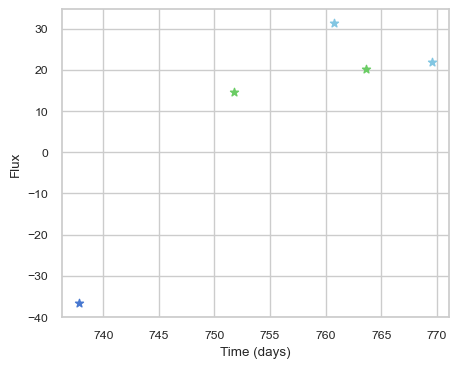

SNIax (3.8340113, False)
SNIax (4.3243923, False)
SNIax (4.152551, False)
SNIax (3.517856, False)
SNIax (3.3577342, False)
SNIax (3.2726912, False)
SNIax (3.6956983, False)
SNIax (3.391169, False)
SNIax (3.5313966, False)
SNIax (3.5440717, False)


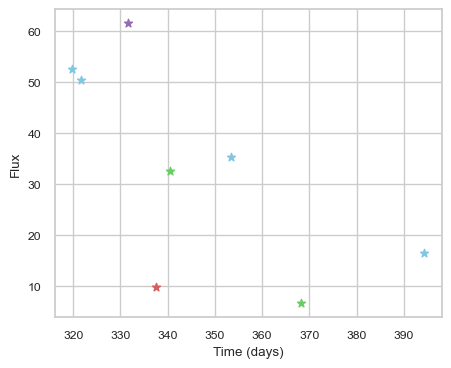

SNIax (3.9830008, False)
SNIax (4.7160797, False)
SNIax (4.5875254, False)
SNIax (5.0254655, False)
SNIax (5.0294733, False)
SNIax (4.5002766, False)
SNIax (4.677627, False)
SNIax (4.151809, False)
SNIax (4.538493, False)
SNIax (4.541657, False)
SNIax (4.507272, False)
SNIax (4.542288, False)
SNIax (4.0655046, False)
SNIax (4.10663, False)
SNIax (4.3178883, False)
SNIax (4.5892143, False)


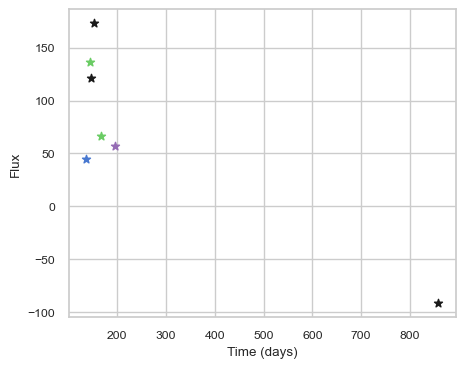

SNIax (3.6578965, False)
SNIax (4.448019, False)
SNIax (3.842462, False)
SNIax (4.31864, False)
SNIax (3.9670155, False)
SNIax (4.726455, False)
SNIax (3.5525703, False)
SNIax (3.728326, False)
SNIax (4.0101023, False)
SNIax (3.8235457, False)
SNIax (3.8411984, False)
SNIax (4.1226306, False)
SNIax (3.1170783, False)
SNIax (4.498457, False)


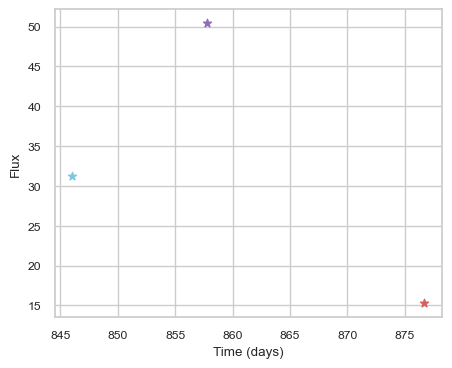

SNIax (3.8427184, False)
SNIax (3.325845, False)
SNIax (3.6780083, False)
SNIax (3.538813, False)
SNIax (3.6335275, False)
SNIax (3.7617192, False)


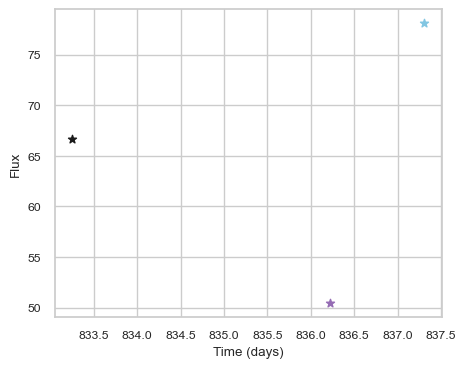

SNIax (3.8013923, False)
SNIax (3.7870057, False)
SNIax (3.8764055, False)
SNIax (3.8062694, False)
SNIax (3.983922, False)
SNIax (3.6364605, False)


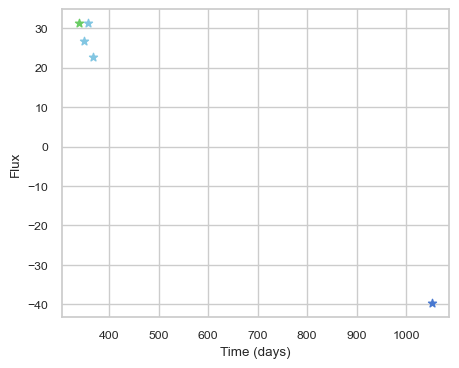

SNIax (4.798537, False)
SNIax (4.99298, False)
SNIax (4.894634, False)
SNIax (4.683388, False)
SNIax (4.0376916, False)
SNIax (4.4649367, False)
SNIax (4.1216903, False)
SNIax (4.048292, False)
SNIax (4.657158, False)
SNIax (5.5062532, False)


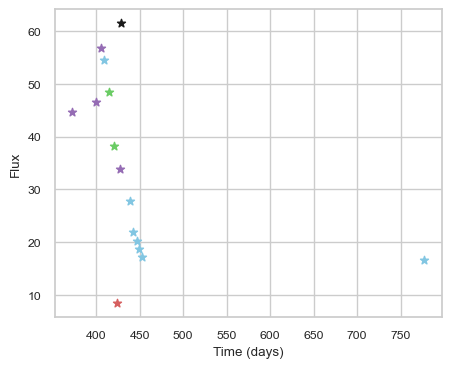

SNIax (3.89002, False)
SNIax (3.1757822, False)
SNIax (3.8069258, False)
SNIax (2.7424738, False)
SNIax (3.599204, False)
SNIax (2.5955873, False)
SNIax (3.7001312, False)
SNIax (3.2072806, False)
SNIax (3.5547924, False)
SNIax (3.005837, False)
SNIax (3.302455, False)
SNIax (3.071874, False)
SNIax (3.8004897, False)
SNIax (3.3104405, False)
SNIax (3.1284513, False)
SNIax (2.6806552, False)
SNIax (3.6826115, False)
SNIax (3.371612, False)
SNIax (3.0115743, False)
SNIax (2.4045298, False)
SNIax (2.6740606, False)
SNIax (2.2842374, False)
SNIax (2.302881, False)
SNIax (2.1558564, False)
SNIax (2.5354755, False)
SNIax (2.2745466, False)
SNIax (2.2020314, False)
SNIax (2.3418229, False)
SNIax (3.0402105, False)
SNIax (3.0049644, False)


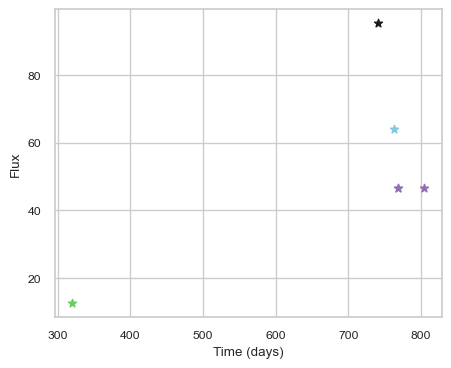

SNIax (3.7425315, False)
SNIax (3.8886542, False)
SNIax (3.8426573, False)
SNIax (3.4488695, False)
SNIax (3.3599494, False)
SNIax (3.3203344, False)
SNIax (3.4344685, False)
SNIax (2.971821, False)
SNIax (3.3905756, False)
SNIax (2.8814206, False)
SNIax (3.3786445, False)
SNIax (3.818943, False)


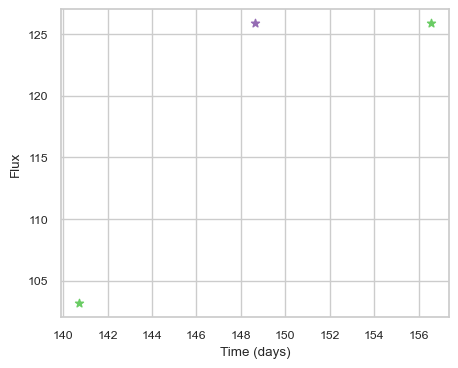

SNIax (4.1561522, False)
SNIax (5.293105, False)
SNIax (6.0202985, False)
SNIax (6.0827417, False)
SNIax (5.7736125, False)
SNIax (6.169699, False)


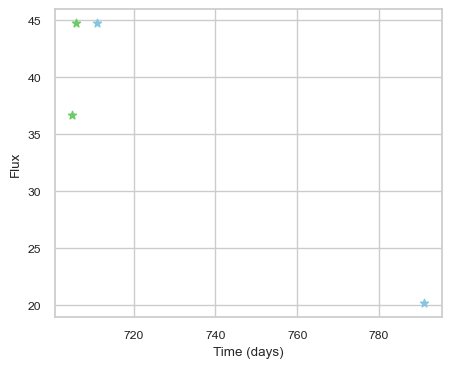

SNIax (3.905471, False)
SNIax (3.4504752, False)
SNIax (3.2236638, False)
SNIax (3.7310786, False)
SNIax (4.495527, False)
SNIax (3.679216, False)
SNIax (3.7649176, False)
SNIax (3.6317024, False)


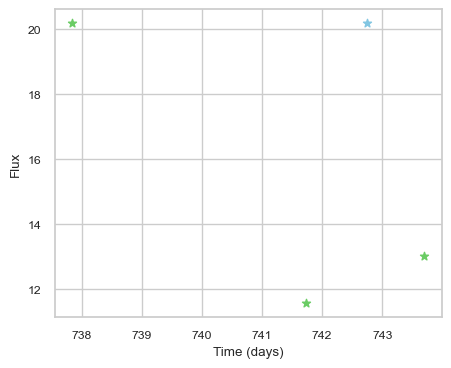

SNIax (4.3016567, False)
SNIax (3.1271384, False)
SNIax (3.3002167, False)
SNIax (3.347375, False)
SNIax (3.5093477, False)
SNIax (2.7332754, False)
SNIax (2.9300683, False)
SNIax (2.6723158, False)


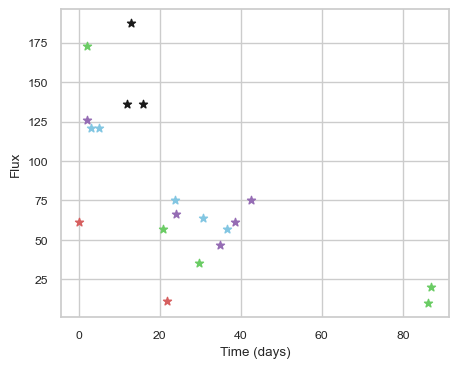

SNIax (3.9278698, False)
SNIax (4.664184, False)
SNIax (4.253757, False)
SNIax (4.9773617, False)
SNIax (5.1655073, False)
SNIax (4.667722, False)
SNIax (5.380679, False)
SNIax (5.1911373, False)
SNIax (4.389816, False)
SNIax (4.4285035, False)
SNIax (3.5782795, False)
SNIax (4.0865197, False)
SNIax (4.033175, False)
SNIax (3.9663694, False)
SNIax (3.9169803, False)
SNIax (2.6658287, False)
SNIax (3.0587797, False)
SNIax (2.6763682, False)
SNIax (2.5302851, False)
SNIax (2.7545762, False)
SNIax (3.2024736, False)
SNIax (2.5411954, False)
SNIax (3.0416665, False)
SNIax (2.4916682, False)
SNIax (2.9130058, False)
SNIax (2.9111397, False)
SNIax (3.1234663, False)
SNIax (2.2619357, False)
SNIax (3.009554, False)
SNIax (2.9377854, False)
SNIax (2.995516, False)
SNIax (2.4742973, False)
SNIax (2.8084912, False)
SNIax (2.827846, False)
SNIax (3.0722325, False)
SNIax (3.0793643, False)
SNIax (4.249308, False)
SNIax (4.224401, False)
SNIax (3.236831, False)
SNIax (3.6642058, False)


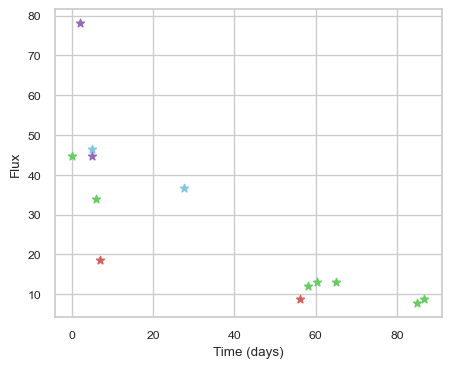

SNIax (4.041278, False)
SNIax (3.439985, False)
SNIax (3.2234569, False)
SNIax (3.3035338, False)
SNIax (3.383779, False)
SNIax (3.785248, False)
SNIax (3.8654299, False)
SNIax (3.875126, False)
SNIax (4.264403, False)
SNIax (4.100102, False)
SNIax (4.795901, False)
SNIax (5.007773, False)
SNIax (5.021282, False)
SNIax (5.7887497, False)
SNIax (5.6212306, False)
SNIax (4.904971, False)
SNIax (4.843928, False)
SNIax (4.2675467, False)
SNIax (4.6113424, False)
SNIax (4.1771455, False)
SNIax (4.142892, False)
SNIax (4.0826583, False)
SNIax (4.040473, False)
SNIax (3.8620038, False)
SNIax (3.8370435, False)


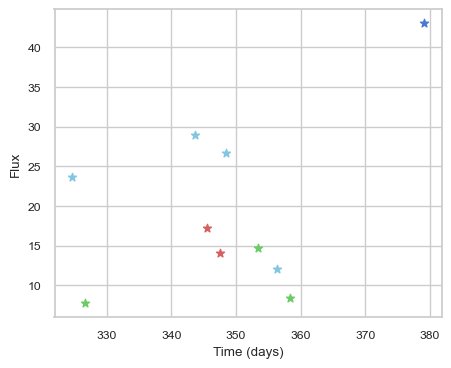

SNIax (3.8338125, False)
SNIax (3.7026923, False)
SNIax (3.3030567, False)
SNIax (3.734958, False)
SNIax (3.508092, False)
SNIax (3.4942622, False)
SNIax (3.5359519, False)
SNIax (3.773981, False)
SNIax (3.6941094, False)
SNIax (4.027562, False)
SNIax (4.3253694, False)
SNIax (4.046283, False)
SNIax (4.1821933, False)
SNIax (4.184746, False)
SNIax (4.0215263, False)
SNIax (4.162182, False)
SNIax (3.9902203, False)
SNIax (4.3339243, False)
SNIax (3.8336384, False)
SNIax (5.7939386, False)


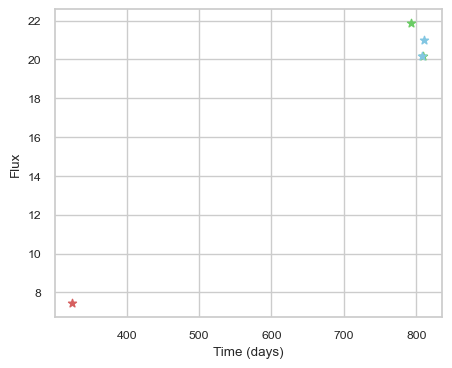

SNIax (4.253044, False)
SNIax (4.414552, False)
SNIax (4.195316, False)
SNIax (3.4313865, False)
SNIax (3.501317, False)
SNIax (3.1982374, False)
SNIax (3.6414554, False)
SNIax (4.063148, False)
SNIax (4.621108, False)
SNIax (4.2981067, False)


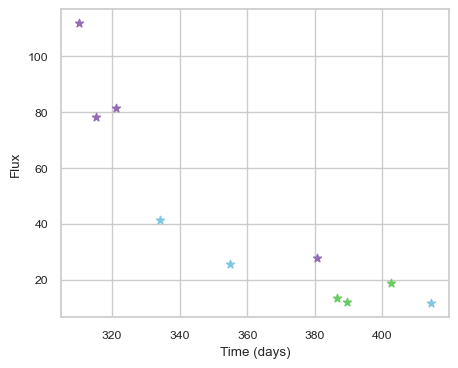

SNIax (3.6886852, False)
SNIax (4.4337144, False)
SNIax (3.7327614, False)
SNIax (4.074992, False)
SNIax (3.7260146, False)
SNIax (4.2900515, False)
SNIax (4.5584254, False)
SNIax (4.3220973, False)
SNIax (3.615494, False)
SNIax (3.816075, False)
SNIax (3.7221262, False)
SNIax (3.7265806, False)
SNIax (3.2750168, False)
SNIax (3.1748166, False)
SNIax (3.2884865, False)
SNIax (3.1281846, False)
SNIax (3.0523963, False)
SNIax (2.8694386, False)
SNIax (3.1071365, False)
SNIax (3.1431577, False)


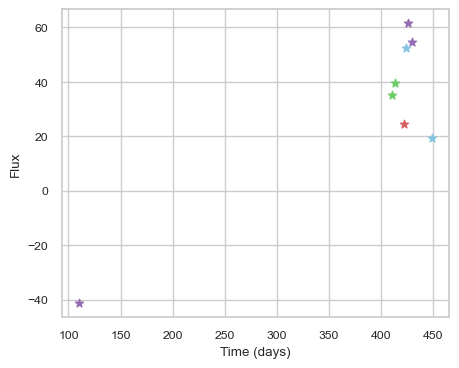

SNIax (4.0837364, False)
SNIax (4.2591887, False)
SNIax (4.091322, False)
SNIax (3.3397937, False)
SNIax (3.6062376, False)
SNIax (3.5012896, False)
SNIax (2.9325855, False)
SNIax (3.5347195, False)
SNIax (2.9971623, False)
SNIax (2.3381808, False)
SNIax (2.9900274, False)
SNIax (2.996016, False)
SNIax (3.7713044, False)
SNIax (2.8248155, False)
SNIax (2.952292, False)
SNIax (2.3570743, False)


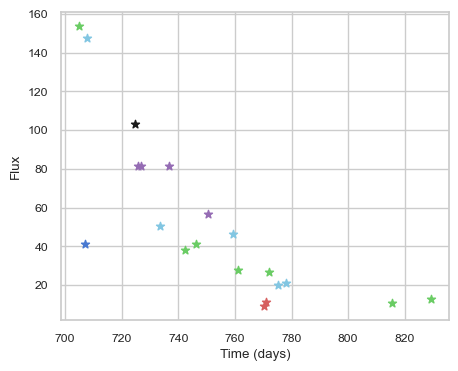

SNIax (3.6903713, False)
SNIax (3.422182, False)
SNIax (3.4839544, False)
SNIax (3.5913646, False)
SNIax (3.9879687, False)
SNIax (3.292084, False)
SNIax (4.5396647, False)
SNIax (4.8850927, False)
SNIax (4.501568, False)
SNIax (3.28902, False)
SNIax (3.6562765, False)
SNIax (2.567466, False)
SNIax (2.928244, False)
SNIax (1.6672969, False)
SNIax (2.6054845, False)
SNIax (2.2236302, False)
SNIax (2.9224758, False)
SNIax (2.2880259, False)
SNIax (2.6576416, False)
SNIax (2.6222436, False)
SNIax (2.4533873, False)
SNIax (2.494615, False)
SNIax (2.4988394, False)
SNIax (2.1149836, False)
SNIax (2.0981848, False)
SNIax (2.697753, False)
SNIax (2.3131738, False)
SNIax (2.7079158, False)
SNIax (3.2291694, False)
SNIax (2.7853134, False)
SNIax (3.2011054, False)
SNIax (2.7801485, False)
SNIax (2.920211, False)
SNIax (1.8372785, False)
SNIax (2.6015794, False)
SNIax (2.0241334, False)
SNIax (2.7716143, False)
SNIax (2.1991425, False)
SNIax (2.6421413, False)
SNIax (2.4145231, False)


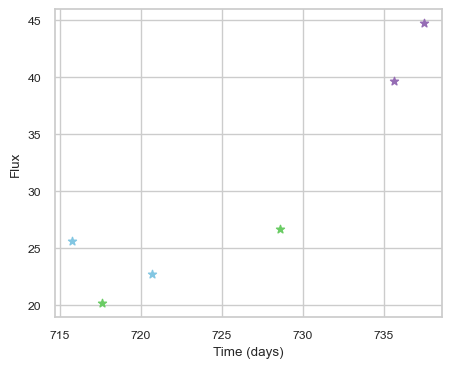

SNIax (4.048904, False)
SNIax (3.599351, False)
SNIax (3.0479178, False)
SNIax (2.77879, False)
SNIax (2.8561094, False)
SNIax (2.28431, False)
SNIax (2.520305, False)
SNIax (2.6491275, False)
SNIax (3.0890062, False)
SNIax (2.4141052, False)
SNIax (2.9044075, False)
SNIax (2.4784837, False)


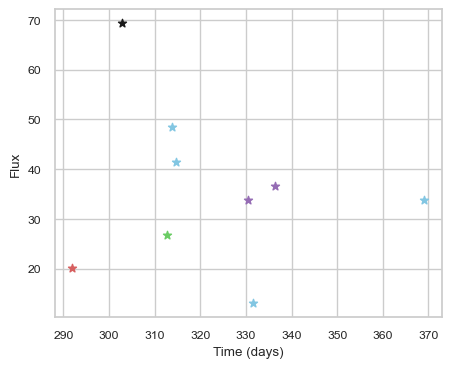

SNIax (3.8190997, False)
SNIax (4.6205087, False)
SNIax (4.4750123, False)
SNIax (4.681201, False)
SNIax (3.316499, False)
SNIax (4.676796, False)
SNIax (4.5267406, False)
SNIax (5.0882416, False)
SNIax (5.4884768, False)
SNIax (5.3741713, False)
SNIax (4.6793103, False)
SNIax (4.6908393, False)
SNIax (3.8380206, False)
SNIax (3.3465223, False)
SNIax (2.828478, False)
SNIax (4.1521163, False)
SNIax (4.250218, False)
SNIax (4.421679, False)


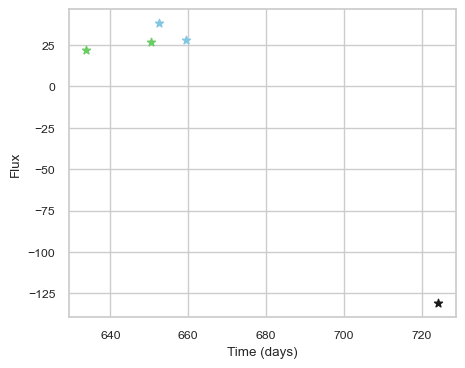

SNIax (4.652512, False)
SNIax (4.078462, False)
SNIax (4.4077115, False)
SNIax (3.772712, False)
SNIax (4.024768, False)
SNIax (4.747292, False)
SNIax (4.9656777, False)
SNIax (4.593741, False)
SNIax (4.54441, False)
SNIax (5.151666, False)


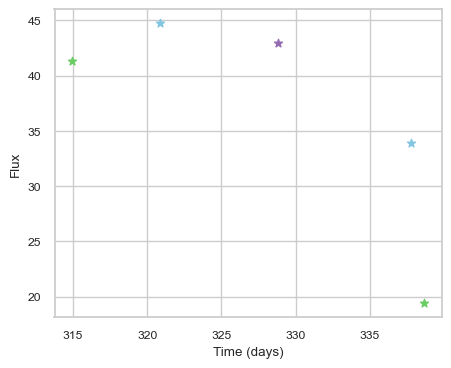

SNIax (3.9864688, False)
SNIax (4.369996, False)
SNIax (4.4232206, False)
SNIax (3.8129115, False)
SNIax (4.177998, False)
SNIax (5.217825, False)
SNIax (5.761825, False)
SNIax (5.716408, False)
SNIax (5.4026213, False)
SNIax (5.816911, False)


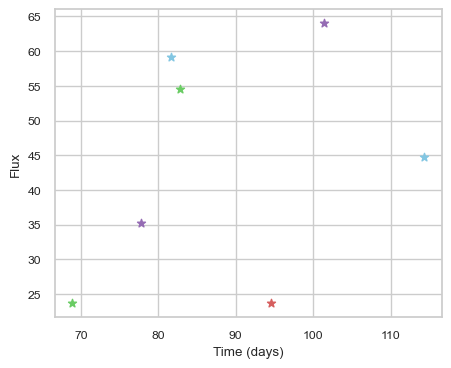

SNIax (3.8841739, False)
SNIax (3.805052, False)
SNIax (3.1260092, False)
SNIax (3.175289, False)
SNIax (3.3905616, False)
SNIax (3.418741, False)
SNIax (3.013276, False)
SNIax (2.788432, False)
SNIax (2.8001769, False)
SNIax (2.7448533, False)
SNIax (3.4406173, False)
SNIax (2.2087178, False)
SNIax (2.7939787, False)
SNIax (2.0655649, False)


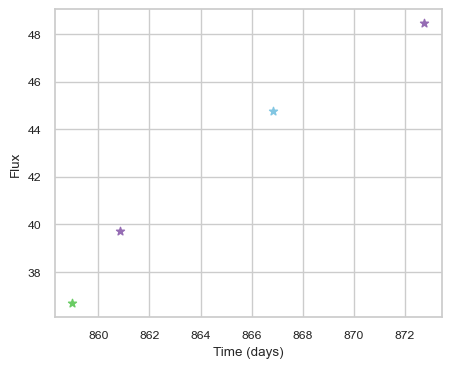

SNIax (4.5177035, False)
SNIax (4.6697702, False)
SNIax (4.7135468, False)
SNIax (4.9763603, False)
SNIax (4.8256884, False)
SNIax (4.959318, False)
SNIax (5.04242, False)
SNIax (5.2094464, False)


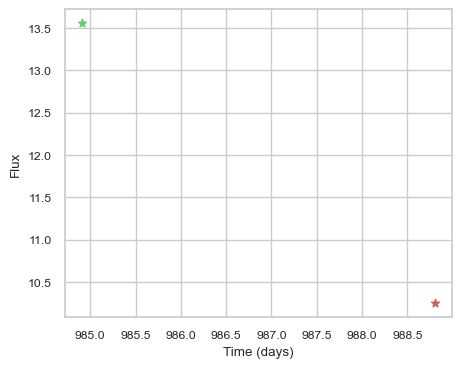

SNIax (3.8249855, False)
SNIax (3.8351223, False)
SNIax (3.5723808, False)
SNIax (3.3562098, False)


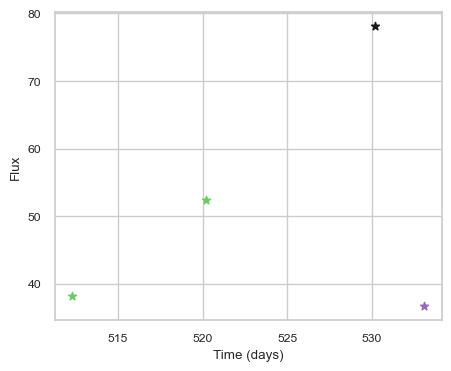

SNIax (4.150519, False)
SNIax (4.075487, False)
SNIax (4.042038, False)
SNIax (4.603021, False)
SNIax (3.9291556, False)
SNIax (4.219133, False)
SNIax (3.7425768, False)
SNIax (3.2566907, False)


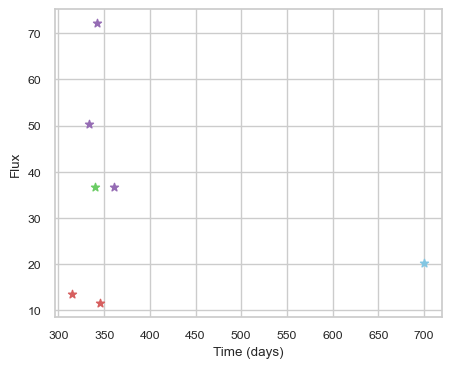

SNIax (3.7601311, False)
SNIax (4.193209, False)
SNIax (3.8628745, False)
SNIax (3.7899413, False)
SNIax (3.2358878, False)
SNIax (3.3606255, False)
SNIax (3.61843, False)
SNIax (3.3336906, False)
SNIax (3.9783144, False)
SNIax (4.60321, False)
SNIax (4.1780705, False)
SNIax (3.0533319, False)
SNIax (3.5373812, False)
SNIax (4.0245433, False)


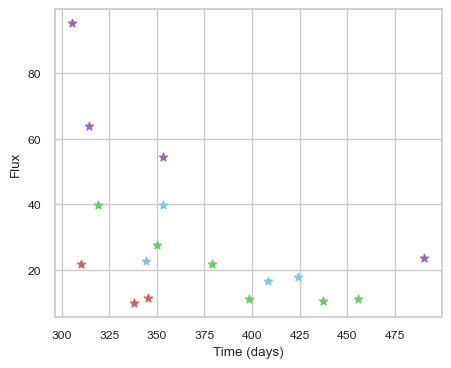

SNIax (3.8127804, False)
SNIax (4.033949, False)
SNIax (3.9145665, False)
SNIax (3.9168882, False)
SNIax (3.453493, False)
SNIax (3.966299, False)
SNIax (3.5741239, False)
SNIax (3.374315, False)
SNIax (4.1029897, False)
SNIax (4.29544, False)
SNIax (4.0679007, False)
SNIax (3.4921725, False)
SNIax (2.9143476, False)
SNIax (3.6453888, False)
SNIax (4.2823014, False)
SNIax (3.4370291, False)
SNIax (3.9845378, False)
SNIax (3.8973916, False)
SNIax (3.602169, False)
SNIax (3.6566641, False)
SNIax (4.199322, False)
SNIax (3.81093, False)
SNIax (4.0773606, False)
SNIax (3.8058908, False)
SNIax (3.6163862, False)
SNIax (3.3707902, False)
SNIax (3.7354941, False)
SNIax (3.4351234, False)
SNIax (3.2483716, False)
SNIax (3.6002078, False)
SNIax (3.7894793, False)
SNIax (3.8910966, False)
SNIax (4.0812907, False)
SNIax (4.3400373, False)


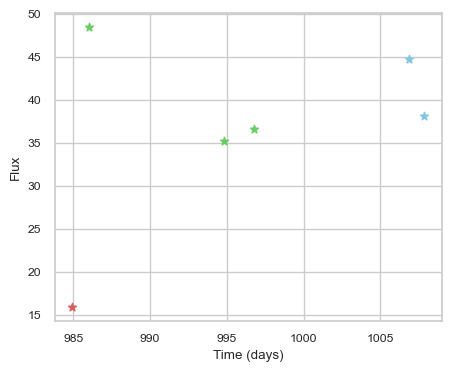

SNIax (4.1597695, False)
SNIax (4.703929, False)
SNIax (3.9127076, False)
SNIax (4.193819, False)
SNIax (5.0081162, False)
SNIax (4.489593, False)
SNIax (4.1198125, False)
SNIax (3.9438615, False)
SNIax (3.992493, False)
SNIax (3.3829584, False)
SNIax (3.2431593, False)
SNIax (3.2025816, False)


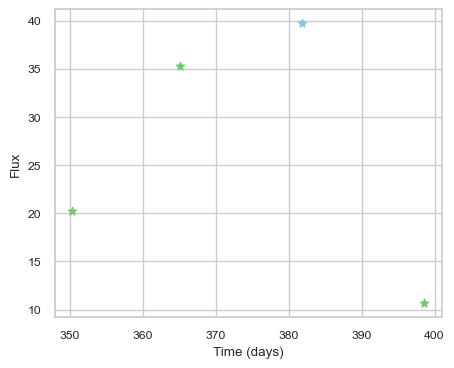

SNIax (3.823019, False)
SNIax (3.5973978, False)
SNIax (3.2016528, False)
SNIax (3.0919924, False)
SNIax (3.8614445, False)
SNIax (2.9456105, False)
SNIax (4.3070846, False)
SNIax (4.0136485, False)


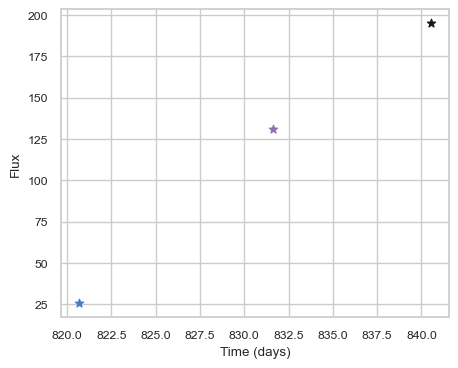

SNIax (3.7308948, False)
SNIax (4.3968344, False)
SNIax (3.593548, False)
SNIax (3.9805303, False)
SNIax (3.970603, False)
SNIax (4.0620255, False)


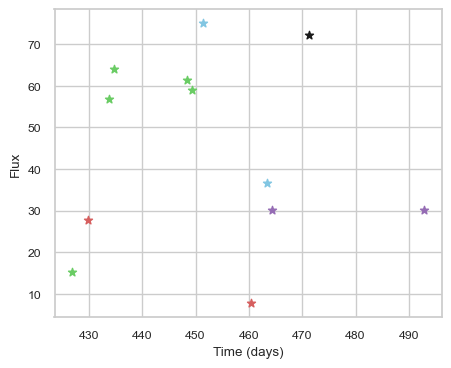

SNIax (3.9374437, False)
SNIax (3.736798, False)
SNIax (3.751122, False)
SNIax (4.298878, False)
SNIax (3.9337451, False)
SNIax (3.4187088, False)
SNIax (3.236534, False)
SNIax (3.529882, False)
SNIax (3.7136233, False)
SNIax (3.1459527, False)
SNIax (3.090946, False)
SNIax (3.311008, False)
SNIax (3.1580958, False)
SNIax (3.2167535, False)
SNIax (3.1761549, False)
SNIax (3.8291779, False)
SNIax (4.336831, False)
SNIax (3.7019708, False)
SNIax (3.483582, False)
SNIax (2.9772878, False)
SNIax (2.913941, False)
SNIax (3.2916577, False)
SNIax (2.9787164, False)
SNIax (2.6037817, False)


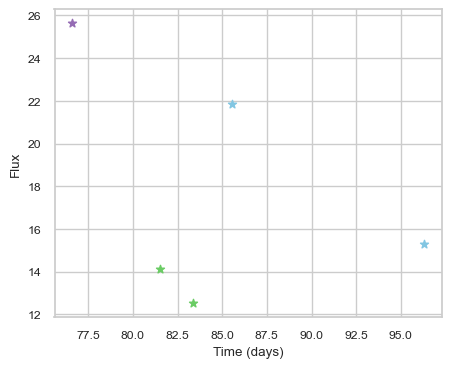

SNIax (5.0883627, False)
SNIax (4.7163815, False)
SNIax (4.7689176, False)
SNIax (4.658663, False)
SNIax (4.430817, False)
SNIax (4.5355873, False)
SNIax (3.8958123, False)
SNIax (4.1653056, False)
SNIax (3.6784928, False)
SNIax (3.4306664, False)


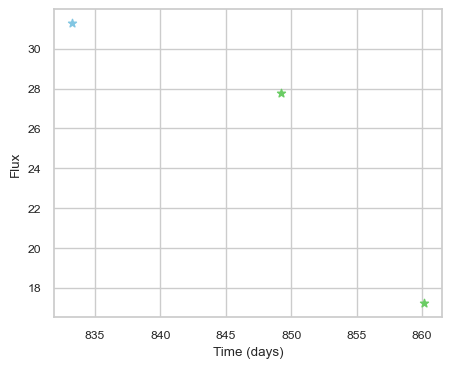

SNIax (3.9871888, False)
SNIax (3.3476555, False)
SNIax (3.4293137, False)
SNIax (3.1361818, False)
SNIax (3.4653282, False)
SNIax (3.7271397, False)


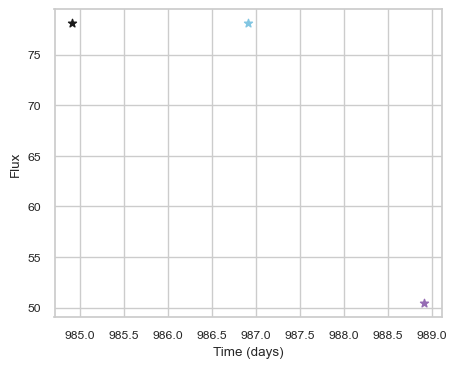

SNIax (3.7898376, False)
SNIax (3.7167864, False)
SNIax (4.1006417, False)
SNIax (3.7319064, False)
SNIax (3.837074, False)
SNIax (3.141677, False)


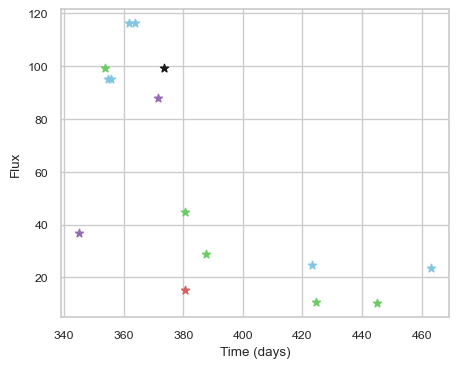

SNIax (4.067692, False)
SNIax (3.4225855, False)
SNIax (3.5498695, False)
SNIax (4.677476, False)
SNIax (5.2396116, False)
SNIax (5.3510213, False)
SNIax (5.3971486, False)
SNIax (5.299967, False)
SNIax (5.3459697, False)
SNIax (5.299601, False)
SNIax (5.2337656, False)
SNIax (5.4806123, False)
SNIax (5.3775573, False)
SNIax (5.3351207, False)
SNIax (5.426894, False)
SNIax (5.2490954, False)
SNIax (5.0405593, False)
SNIax (5.5021434, False)
SNIax (5.564491, False)
SNIax (5.404661, False)
SNIax (5.5694923, False)
SNIax (5.980739, False)
SNIax (5.59182, False)
SNIax (5.8368416, False)
SNIax (5.2455134, False)
SNIax (5.763012, False)
SNIax (5.1463776, False)
SNIax (5.59419, False)
SNIax (5.453609, False)
SNIax (5.444483, False)


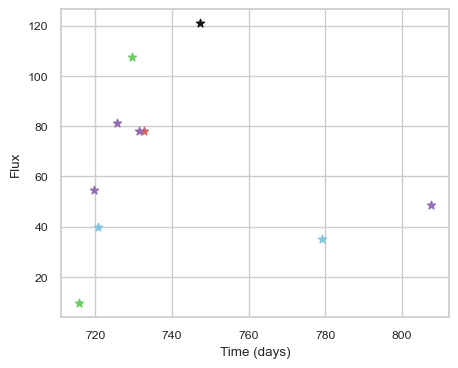

SNIax (3.8981376, False)
SNIax (3.5080278, False)
SNIax (3.349719, False)
SNIax (3.223568, False)
SNIax (3.5360336, False)
SNIax (2.692433, False)
SNIax (3.0377758, False)
SNIax (3.6767776, False)
SNIax (3.9490604, False)
SNIax (3.6028926, False)
SNIax (4.066496, False)
SNIax (4.1197376, False)
SNIax (4.47162, False)
SNIax (4.342476, False)
SNIax (5.3348308, False)
SNIax (5.2458797, False)
SNIax (5.6472554, False)
SNIax (4.1998167, False)
SNIax (4.814972, False)
SNIax (4.138721, False)


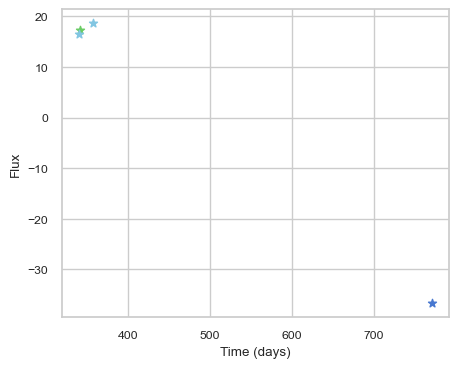

SNIax (5.130017, False)
SNIax (4.845669, False)
SNIax (4.1060805, False)
SNIax (4.2669215, False)
SNIax (4.3430333, False)
SNIax (3.684981, False)
SNIax (4.4610815, False)
SNIax (5.199446, False)


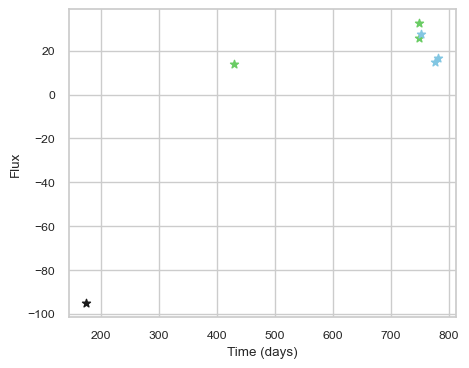

SNIax (4.2154603, False)
SNIax (3.9079528, False)
SNIax (3.9995131, False)
SNIax (3.4837227, False)
SNIax (3.798501, False)
SNIax (3.2108655, False)
SNIax (3.2327693, False)
SNIax (3.1526754, False)
SNIax (3.4967356, False)
SNIax (2.5855007, False)
SNIax (2.9643447, False)
SNIax (3.5956004, False)
SNIax (3.572336, False)
SNIax (3.8019733, False)


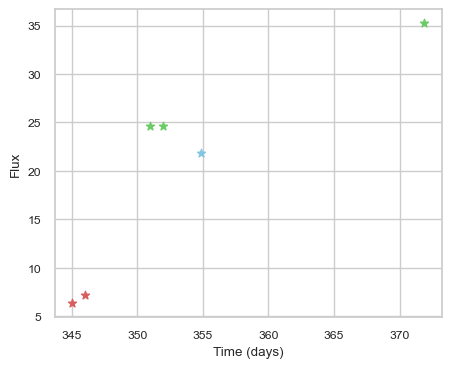

SNIax (3.9498239, False)
SNIax (3.7790103, False)
SNIax (3.5890138, False)
SNIax (3.5401552, False)
SNIax (3.3121915, False)
SNIax (2.6959295, False)
SNIax (2.8154452, False)
SNIax (2.3218186, False)
SNIax (2.842194, False)
SNIax (2.0538137, False)
SNIax (2.1532052, False)
SNIax (2.0725393, False)


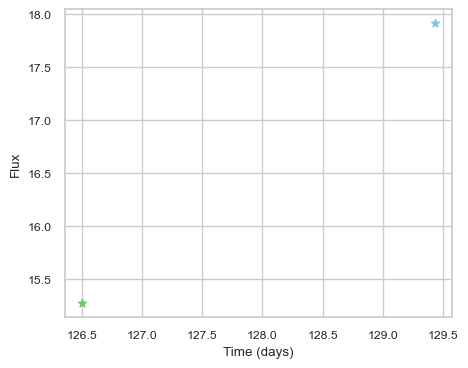

SNIax (4.761453, False)
SNIax (4.3272476, False)
SNIax (3.6440809, False)
SNIax (3.5967312, False)


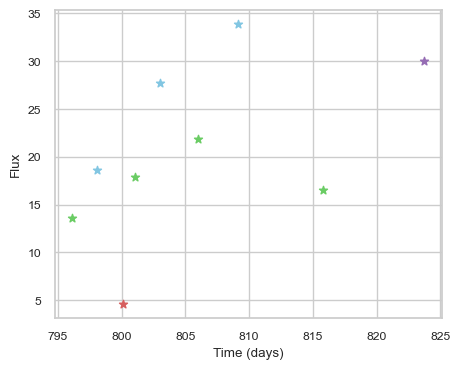

SNIax (4.0666986, False)
SNIax (3.3909903, False)
SNIax (3.3779416, False)
SNIax (2.8843937, False)
SNIax (2.724047, False)
SNIax (2.4165223, False)
SNIax (2.7644951, False)
SNIax (2.1905508, False)
SNIax (2.605506, False)
SNIax (2.4340134, False)
SNIax (2.9900672, False)
SNIax (2.5408335, False)
SNIax (2.920246, False)
SNIax (2.7001913, False)
SNIax (3.0376024, False)
SNIax (2.7634964, False)
SNIax (2.6651394, False)
SNIax (2.8894615, False)


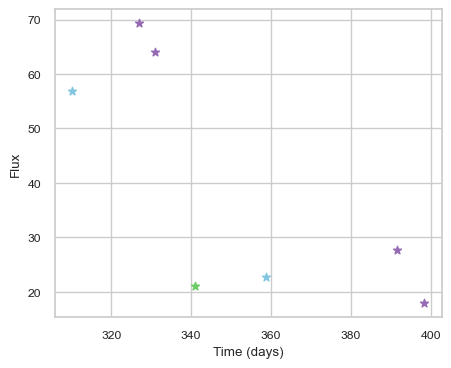

SNIax (3.768858, False)
SNIax (4.374542, False)
SNIax (3.794808, False)
SNIax (3.479028, False)
SNIax (3.9363313, False)
SNIax (3.9138052, False)
SNIax (3.8288982, False)
SNIax (3.9507742, False)
SNIax (3.5011058, False)
SNIax (3.1169016, False)
SNIax (3.4641173, False)
SNIax (3.4331393, False)
SNIax (3.1933305, False)
SNIax (3.7756495, False)


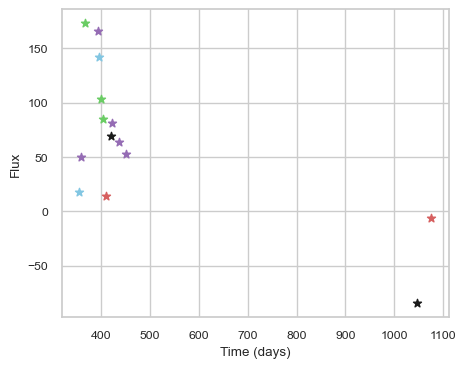

SNIax (3.754694, False)
SNIax (3.6033707, False)
SNIax (3.5237858, False)
SNIax (2.9824996, False)
SNIax (3.1968822, False)
SNIax (3.2660677, False)
SNIax (3.0823262, False)
SNIax (2.610263, False)
SNIax (3.376575, False)
SNIax (2.324838, False)
SNIax (2.6620295, False)
SNIax (2.2590156, False)
SNIax (2.5242853, False)
SNIax (2.6338747, False)
SNIax (2.772019, False)
SNIax (2.7913775, False)
SNIax (3.1281426, False)
SNIax (2.9307566, False)
SNIax (2.7890642, False)
SNIax (2.4708037, False)
SNIax (2.8975918, False)
SNIax (2.5248272, False)
SNIax (3.0559316, False)
SNIax (2.4288929, False)
SNIax (2.5409894, False)
SNIax (3.401639, False)
SNIax (3.1002278, False)
SNIax (3.4898844, False)


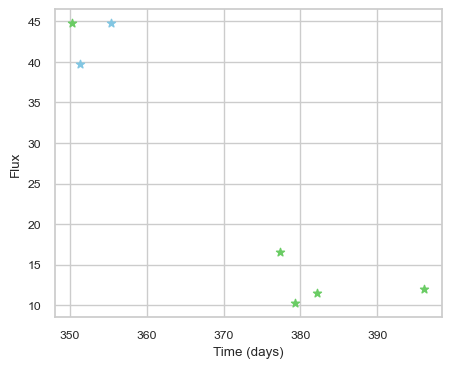

SNIax (3.9618, False)
SNIax (3.6446402, False)
SNIax (3.5658195, False)
SNIax (3.221007, False)
SNIax (3.7046123, False)
SNIax (3.0560994, False)
SNIax (3.9564836, False)
SNIax (4.388074, False)
SNIax (3.531319, False)
SNIax (3.4562104, False)
SNIax (3.1815426, False)
SNIax (2.81564, False)
SNIax (2.636743, False)
SNIax (2.7881956, False)


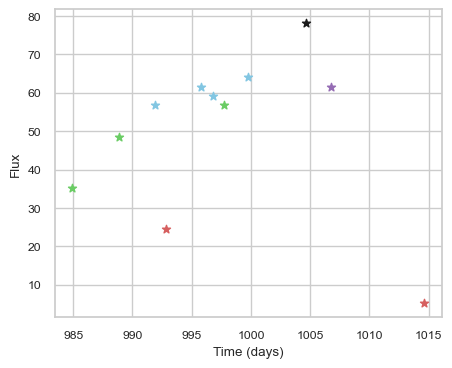

SNIax (3.8971248, False)
SNIax (3.83172, False)
SNIax (3.4017296, False)
SNIax (3.3406894, False)
SNIax (3.936249, False)
SNIax (3.588967, False)
SNIax (4.1035247, False)
SNIax (3.6473122, False)
SNIax (4.57188, False)
SNIax (3.7339957, False)
SNIax (4.354574, False)
SNIax (4.076134, False)
SNIax (4.2574115, False)
SNIax (4.0075626, False)
SNIax (4.1762, False)
SNIax (4.2685633, False)
SNIax (5.1109896, False)
SNIax (4.4099054, False)
SNIax (4.7966795, False)
SNIax (3.55294, False)
SNIax (3.5347571, False)
SNIax (4.279284, False)


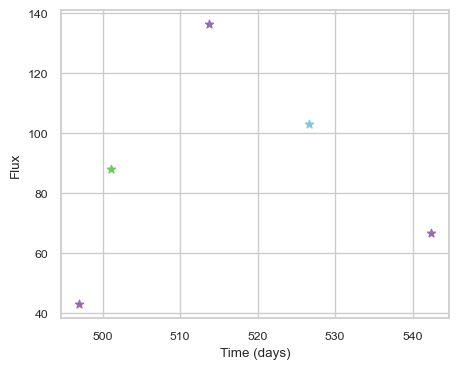

SNIax (4.1388984, False)
SNIax (4.152971, False)
SNIax (4.132249, False)
SNIax (4.548022, False)
SNIax (5.42949, False)
SNIax (5.544326, False)
SNIax (5.864288, False)
SNIax (5.2699785, False)
SNIax (6.136303, False)
SNIax (5.3633475, False)


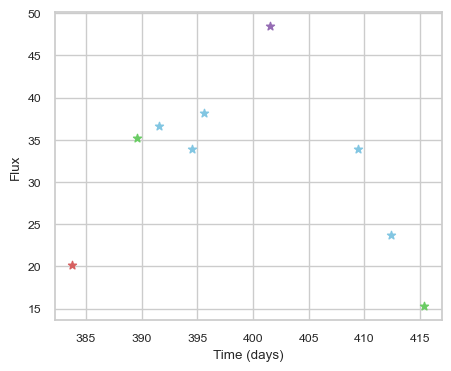

SNIax (3.9317744, False)
SNIax (4.0850496, False)
SNIax (3.970677, False)
SNIax (2.662909, False)
SNIax (4.081587, False)
SNIax (3.443309, False)
SNIax (3.9247124, False)
SNIax (4.094155, False)
SNIax (3.626483, False)
SNIax (4.1573267, False)
SNIax (4.1583133, False)
SNIax (4.1928873, False)
SNIax (3.9291599, False)
SNIax (4.412283, False)
SNIax (4.4267364, False)
SNIax (4.2150817, False)
SNIax (3.7615006, False)
SNIax (4.029874, False)


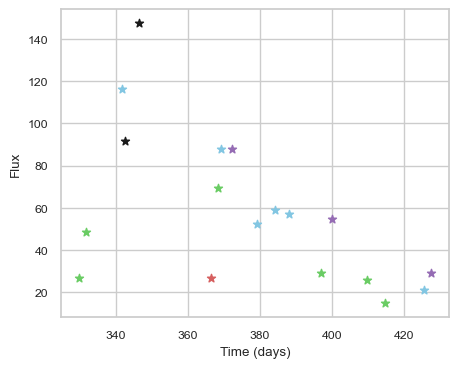

SNIax (3.9624908, False)
SNIax (3.9463778, False)
SNIax (3.5611334, False)
SNIax (3.3547606, False)
SNIax (4.062459, False)
SNIax (4.6669025, False)
SNIax (4.876978, False)
SNIax (4.8825035, False)
SNIax (5.604504, False)
SNIax (4.736334, False)
SNIax (4.4499087, False)
SNIax (4.3911204, False)
SNIax (4.2642093, False)
SNIax (4.7889295, False)
SNIax (4.461754, False)
SNIax (4.7407455, False)
SNIax (5.0759573, False)
SNIax (4.488132, False)
SNIax (5.1390877, False)
SNIax (4.689953, False)
SNIax (5.359456, False)
SNIax (4.757117, False)
SNIax (5.0052156, False)
SNIax (4.7015076, False)
SNIax (4.9959702, False)
SNIax (4.8569427, False)
SNIax (4.758753, False)
SNIax (4.7576, False)
SNIax (4.340238, False)
SNIax (4.41453, False)
SNIax (4.662015, False)
SNIax (4.286824, False)
SNIax (4.2367406, False)
SNIax (4.0304284, False)
SNIax (4.021069, False)
SNIax (4.594312, False)


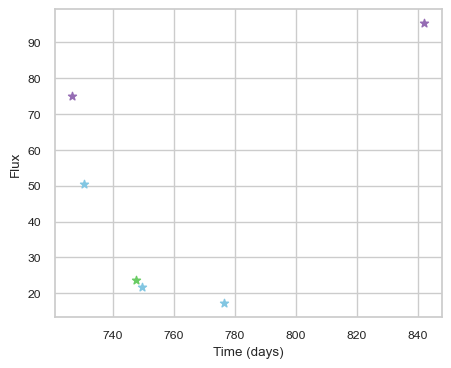

SNIax (3.760846, False)
SNIax (3.3307745, False)
SNIax (3.6801918, False)
SNIax (3.3319333, False)
SNIax (3.8849146, False)
SNIax (3.61021, False)
SNIax (3.804097, False)
SNIax (3.143456, False)
SNIax (3.2623785, False)
SNIax (3.234013, False)
SNIax (3.4881294, False)
SNIax (4.2079835, False)


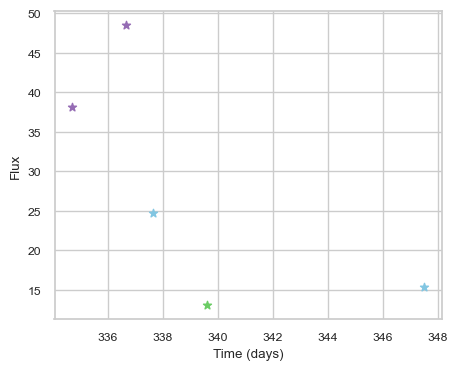

SNIax (4.672422, False)
SNIax (4.94478, False)
SNIax (4.9906116, False)
SNIax (5.3103113, False)
SNIax (5.5448365, False)
SNIax (5.593105, False)
SNIax (4.455049, False)
SNIax (4.1919622, False)
SNIax (4.010445, False)
SNIax (4.536133, False)


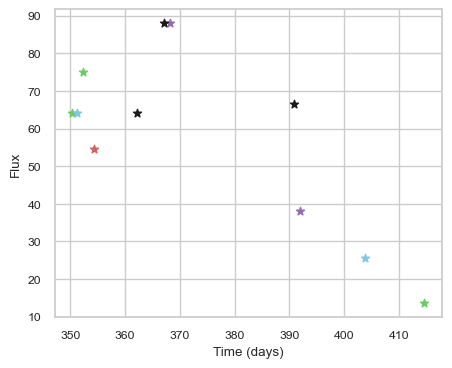

SNIax (3.8720996, False)
SNIax (3.5630283, False)
SNIax (4.141387, False)
SNIax (4.3730245, False)
SNIax (4.4619603, False)
SNIax (4.3778224, False)
SNIax (4.4770613, False)
SNIax (4.5445485, False)
SNIax (4.4887733, False)
SNIax (4.292857, False)
SNIax (3.3666525, False)
SNIax (3.2242818, False)
SNIax (4.0204644, False)
SNIax (2.9011858, False)
SNIax (3.097523, False)
SNIax (3.0656343, False)
SNIax (3.2905571, False)
SNIax (2.8016062, False)
SNIax (3.316493, False)
SNIax (2.4628623, False)
SNIax (2.8012807, False)
SNIax (2.834942, False)


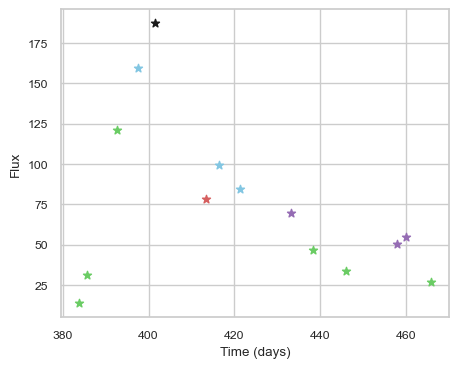

SNIax (3.815036, False)
SNIax (3.5443745, False)
SNIax (3.5103784, False)
SNIax (2.8781717, False)
SNIax (3.334333, False)
SNIax (3.9219034, False)
SNIax (4.353212, False)
SNIax (3.838863, False)
SNIax (3.5325787, False)
SNIax (3.229622, False)
SNIax (3.3253133, False)
SNIax (3.1405592, False)
SNIax (2.8107588, False)
SNIax (3.059644, False)
SNIax (3.0206091, False)
SNIax (2.546798, False)
SNIax (3.3775058, False)
SNIax (2.6033025, False)
SNIax (3.165485, False)
SNIax (2.8964224, False)
SNIax (3.1884058, False)
SNIax (2.9891388, False)
SNIax (3.0974789, False)
SNIax (2.8647718, False)
SNIax (3.3168328, False)
SNIax (2.9311588, False)
SNIax (2.864374, False)
SNIax (2.7966757, False)


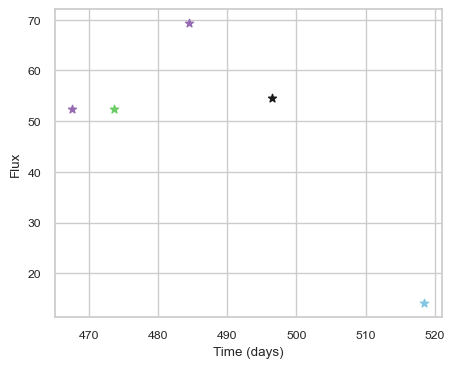

SNIax (3.8936093, False)
SNIax (4.111205, False)
SNIax (3.7277348, False)
SNIax (4.0154634, False)
SNIax (3.5624022, False)
SNIax (3.397557, False)
SNIax (3.1594498, False)
SNIax (3.8241942, False)
SNIax (3.416364, False)
SNIax (3.480388, False)


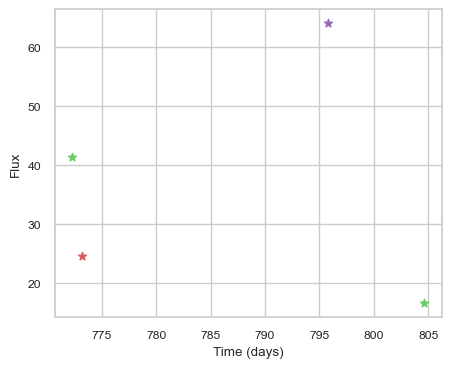

SNIax (3.9089456, False)
SNIax (3.1685157, False)
SNIax (3.2505956, False)
SNIax (3.4291503, False)
SNIax (3.0711746, False)
SNIax (3.377893, False)
SNIax (3.3741648, False)
SNIax (2.9356642, False)


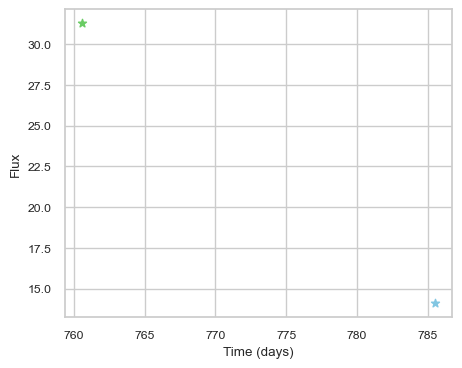

SNIax (3.9307704, False)
SNIax (2.998812, False)
SNIax (3.47838, False)
SNIax (4.0350184, False)


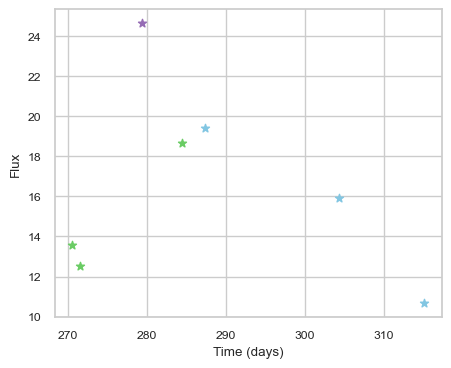

SNIax (4.5169754, False)
SNIax (3.9837935, False)
SNIax (3.516943, False)
SNIax (3.4940689, False)
SNIax (3.2735705, False)
SNIax (3.5683668, False)
SNIax (2.4599326, False)
SNIax (2.4713907, False)
SNIax (2.5265582, False)
SNIax (2.3183, False)
SNIax (2.669514, False)
SNIax (2.5025933, False)
SNIax (3.1259005, False)
SNIax (3.200508, False)


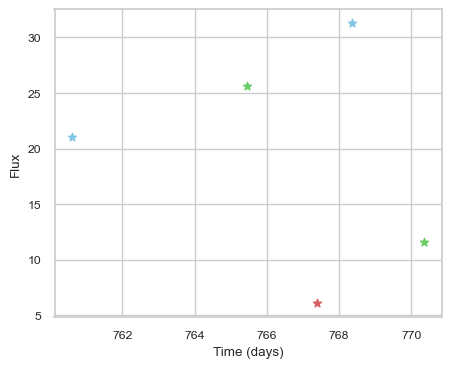

SNIax (3.8380349, False)
SNIax (3.4064293, False)
SNIax (3.079032, False)
SNIax (3.2264688, False)
SNIax (3.6090298, False)
SNIax (2.9022288, False)
SNIax (3.1827998, False)
SNIax (2.8501627, False)
SNIax (3.109236, False)
SNIax (2.9247348, False)


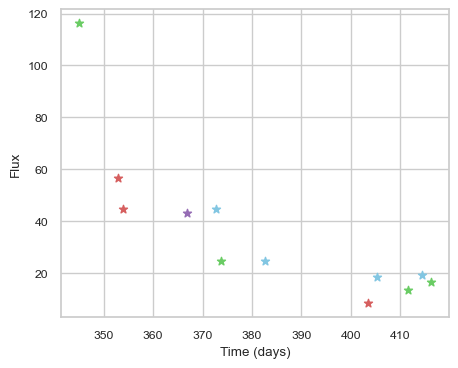

SNIax (3.6157558, False)
SNIax (3.909193, False)
SNIax (3.2289324, False)
SNIax (3.7138588, False)
SNIax (3.4920866, False)
SNIax (3.2995431, False)
SNIax (3.1972868, False)
SNIax (3.1684895, False)
SNIax (3.1982453, False)
SNIax (2.9795713, False)
SNIax (2.8855033, False)
SNIax (2.9941452, False)
SNIax (2.8709562, False)
SNIax (2.5320036, False)
SNIax (2.7154658, False)
SNIax (3.205227, False)
SNIax (3.6291366, False)
SNIax (2.6019387, False)
SNIax (3.081918, False)
SNIax (2.7335029, False)
SNIax (3.1799695, False)
SNIax (2.6785123, False)
SNIax (3.0381265, False)
SNIax (2.740229, False)


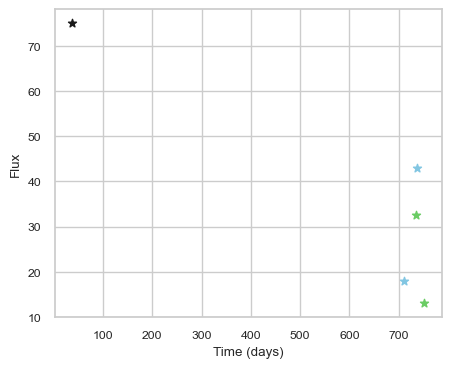

SNIax (3.973592, False)
SNIax (3.249919, False)
SNIax (3.8858762, False)
SNIax (3.5417747, False)
SNIax (3.0722928, False)
SNIax (2.5420089, False)
SNIax (2.895894, False)
SNIax (3.0423772, False)
SNIax (2.740145, False)
SNIax (2.641957, False)


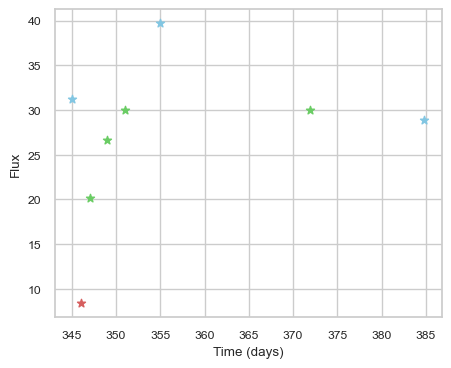

SNIax (3.866686, False)
SNIax (3.746476, False)
SNIax (3.2975595, False)
SNIax (3.4418561, False)
SNIax (3.2428439, False)
SNIax (2.802464, False)
SNIax (3.0452316, False)
SNIax (2.8411534, False)
SNIax (3.2375703, False)
SNIax (2.854296, False)
SNIax (3.2042484, False)
SNIax (2.966843, False)
SNIax (3.1185424, False)
SNIax (3.724559, False)
SNIax (3.754851, False)
SNIax (3.1688123, False)


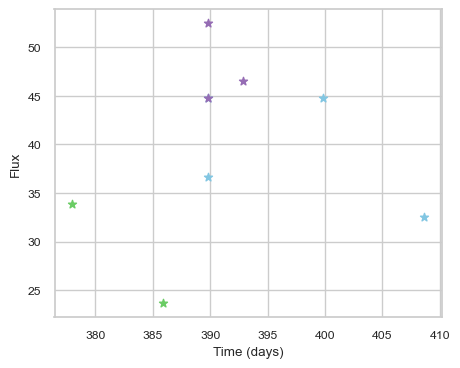

SNIax (4.5432196, False)
SNIax (4.221069, False)
SNIax (4.9842134, False)
SNIax (4.038897, False)
SNIax (4.204816, False)
SNIax (3.4800844, False)
SNIax (3.446888, False)
SNIax (4.034089, False)
SNIax (3.8882992, False)
SNIax (4.3289847, False)
SNIax (3.8425202, False)
SNIax (4.2494736, False)
SNIax (3.6998806, False)
SNIax (4.0878663, False)
SNIax (4.138997, False)
SNIax (4.2094197, False)


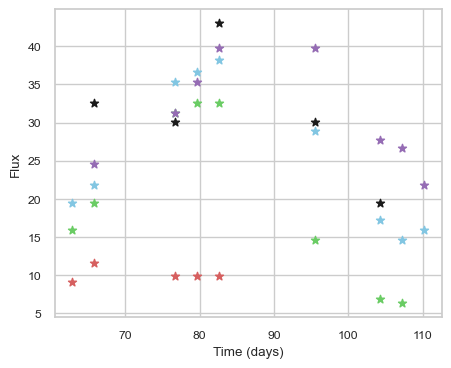

SNIax (4.1508512, False)
SNIax (3.4855871, False)
SNIax (3.4782126, False)
SNIax (3.1810832, False)
SNIax (2.9455996, False)
SNIax (2.6477041, False)
SNIax (2.984955, False)
SNIax (2.8586621, False)
SNIax (3.2546904, False)
SNIax (3.9971607, False)
SNIax (2.5067294, False)
SNIax (2.399898, False)
SNIax (2.482762, False)
SNIax (2.625993, False)
SNIax (2.4952152, False)
SNIax (2.8593714, False)
SNIax (2.8001108, False)
SNIax (2.7215261, False)
SNIax (2.8124123, False)
SNIax (2.7605212, False)
SNIax (2.6583056, False)
SNIax (2.9246864, False)
SNIax (3.15008, False)
SNIax (2.931725, False)
SNIax (2.994988, False)
SNIax (2.8114352, False)
SNIax (3.202229, False)
SNIax (2.693824, False)
SNIax (2.8716104, False)
SNIax (2.8640342, False)
SNIax (2.633009, False)
SNIax (3.3526611, False)
SNIax (2.88801, False)
SNIax (3.128316, False)
SNIax (2.7310293, False)
SNIax (2.965896, False)
SNIax (3.5554025, False)
SNIax (2.6223285, False)
SNIax (2.6138458, False)
SNIax (2.4621215, False)
SNIax (2.635680

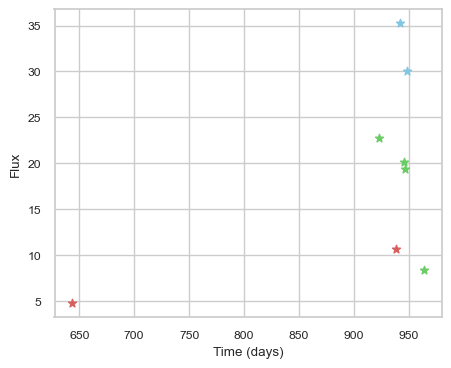

SNIax (3.9624062, False)
SNIax (4.3447537, False)
SNIax (3.6731544, False)
SNIax (3.5996835, False)
SNIax (3.365363, False)
SNIax (3.199156, False)
SNIax (3.2098029, False)
SNIax (3.068153, False)
SNIax (3.3067849, False)
SNIax (3.0957205, False)
SNIax (3.130509, False)
SNIax (3.2642066, False)
SNIax (3.4213934, False)
SNIax (3.4072313, False)
SNIax (3.659092, False)
SNIax (3.4090655, False)


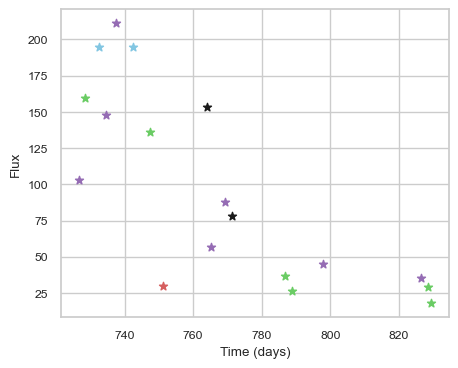

SNIax (3.709871, False)
SNIax (3.3756807, False)
SNIax (3.4966328, False)
SNIax (3.0715773, False)
SNIax (3.1966407, False)
SNIax (2.8361936, False)
SNIax (2.9215817, False)
SNIax (2.597595, False)
SNIax (2.8037128, False)
SNIax (2.211787, False)
SNIax (2.7964308, False)
SNIax (1.9767659, False)
SNIax (2.440308, False)
SNIax (2.268632, False)
SNIax (2.1674109, False)
SNIax (2.47143, False)
SNIax (3.3368, False)
SNIax (2.6779754, False)
SNIax (3.0173495, False)
SNIax (2.7487957, False)
SNIax (3.4101813, False)
SNIax (2.61372, False)
SNIax (3.1333015, False)
SNIax (2.7506318, False)
SNIax (3.7177992, False)
SNIax (3.1958647, False)
SNIax (3.0394354, False)
SNIax (3.0402594, False)
SNIax (3.1414535, False)
SNIax (2.57021, False)
SNIax (2.9565146, False)
SNIax (2.5205677, False)
SNIax (3.3726368, False)
SNIax (2.6421704, False)
SNIax (3.0466962, False)
SNIax (2.8676178, False)


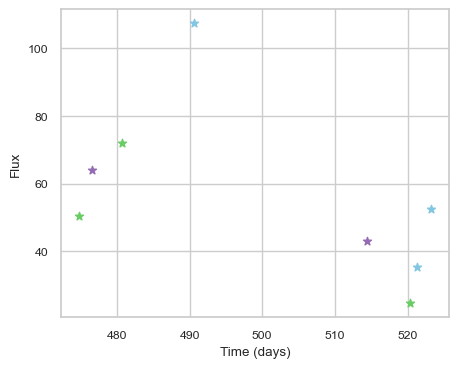

SNIax (3.9460294, False)
SNIax (3.9919996, False)
SNIax (3.8391821, False)
SNIax (3.6923032, False)
SNIax (4.3341703, False)
SNIax (3.95295, False)
SNIax (4.770388, False)
SNIax (4.287042, False)
SNIax (5.1776595, False)
SNIax (4.676969, False)
SNIax (5.573679, False)
SNIax (5.251685, False)
SNIax (4.629176, False)
SNIax (4.7865133, False)
SNIax (4.78974, False)
SNIax (5.059109, False)


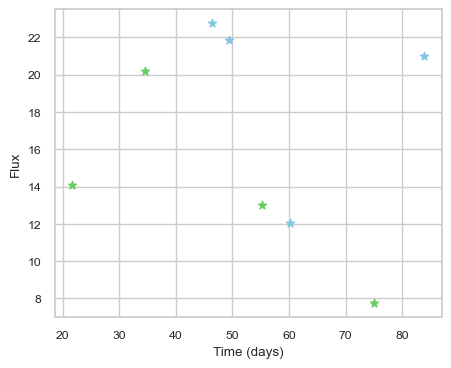

SNIax (3.9266553, False)
SNIax (3.484813, False)
SNIax (3.1726604, False)
SNIax (3.4934962, False)
SNIax (3.3954413, False)
SNIax (3.793059, False)
SNIax (3.6803277, False)
SNIax (3.735281, False)
SNIax (3.8080804, False)
SNIax (3.8879373, False)
SNIax (3.8274918, False)
SNIax (3.701537, False)
SNIax (4.13442, False)
SNIax (4.1589684, False)
SNIax (4.178055, False)
SNIax (4.0348334, False)


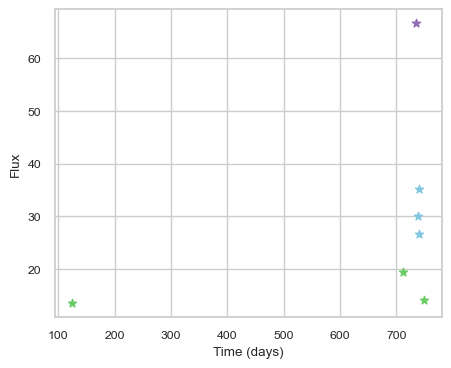

SNIax (4.7748313, False)
SNIax (4.2066693, False)
SNIax (4.3878617, False)
SNIax (3.497881, False)
SNIax (3.7419496, False)
SNIax (5.2533627, False)
SNIax (5.8659444, False)
SNIax (4.7871547, False)
SNIax (4.634929, False)
SNIax (4.4627175, False)
SNIax (4.0715256, False)
SNIax (4.1527267, False)
SNIax (3.7001808, False)
SNIax (3.9814606, False)


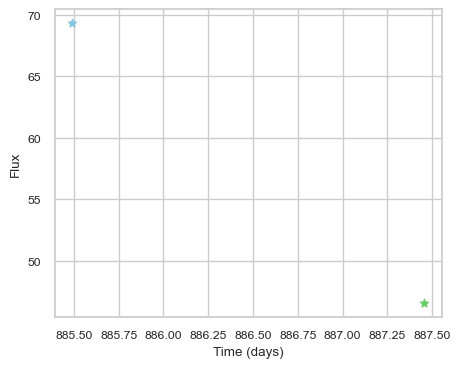

SNIax (4.193054, False)
SNIax (4.207488, False)
SNIax (4.6829486, False)
SNIax (4.9310784, False)


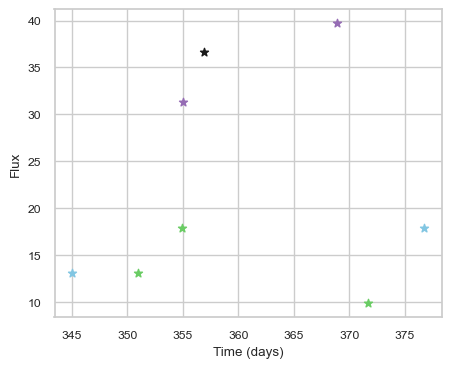

SNIax (3.9338143, False)
SNIax (3.7695355, False)
SNIax (3.3692148, False)
SNIax (3.437235, False)
SNIax (3.4002757, False)
SNIax (3.2268677, False)
SNIax (3.2350852, False)
SNIax (2.982046, False)
SNIax (3.2331061, False)
SNIax (3.3718314, False)
SNIax (2.417014, False)
SNIax (2.713748, False)
SNIax (3.1398482, False)
SNIax (3.2105997, False)
SNIax (2.6655276, False)
SNIax (2.9222457, False)


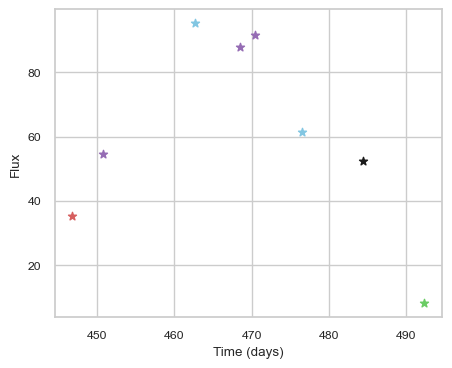

SNIax (4.284992, False)
SNIax (4.7365336, False)
SNIax (5.0284786, False)
SNIax (3.5474114, False)
SNIax (3.5760612, False)
SNIax (4.0557327, False)
SNIax (4.3423066, False)
SNIax (4.266376, False)
SNIax (4.5763493, False)
SNIax (4.552073, False)
SNIax (4.143535, False)
SNIax (3.9514241, False)
SNIax (4.2703457, False)
SNIax (4.0751486, False)
SNIax (4.140274, False)
SNIax (4.238027, False)


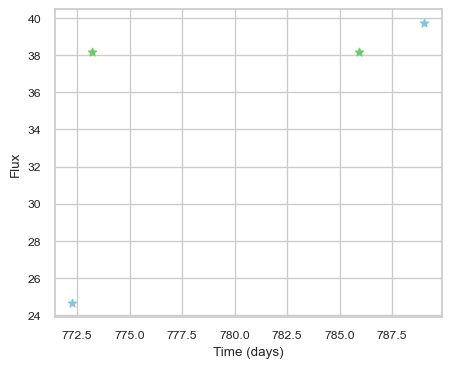

SNIax (3.809451, False)
SNIax (3.3883805, False)
SNIax (3.1755676, False)
SNIax (2.8367898, False)
SNIax (3.2863245, False)
SNIax (2.607173, False)
SNIax (4.255673, False)
SNIax (3.6430995, False)


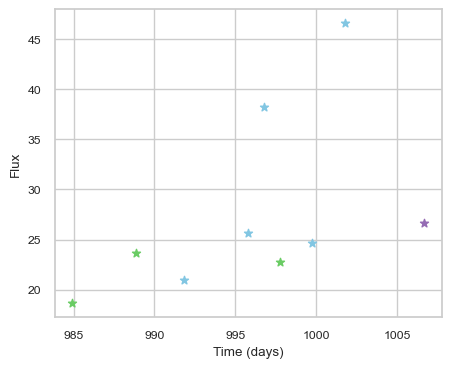

SNIax (4.2695236, False)
SNIax (3.954446, False)
SNIax (3.442078, False)
SNIax (2.7990422, False)
SNIax (3.0082939, False)
SNIax (3.233893, False)
SNIax (3.6635406, False)
SNIax (3.8098047, False)
SNIax (3.5852132, False)
SNIax (3.396078, False)
SNIax (2.663054, False)
SNIax (2.2283819, False)
SNIax (2.8054147, False)
SNIax (2.497143, False)
SNIax (2.11341, False)
SNIax (2.1920562, False)
SNIax (2.5863745, False)
SNIax (1.8476655, False)


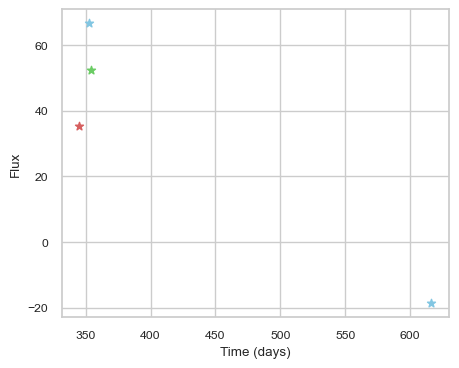

SNIax (3.994588, False)
SNIax (4.233577, False)
SNIax (4.32741, False)
SNIax (4.1001554, False)
SNIax (3.7645893, False)
SNIax (2.935802, False)
SNIax (3.8353965, False)
SNIax (4.2317886, False)


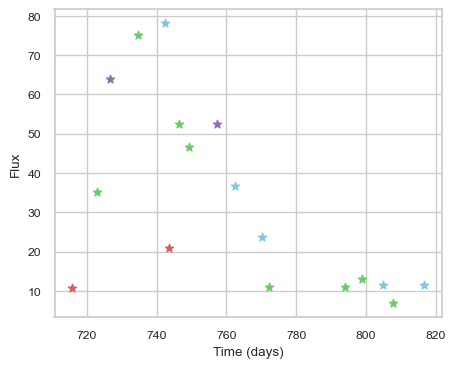

SNIax (3.9330728, False)
SNIax (4.1281366, False)
SNIax (3.4924788, False)
SNIax (2.6617062, False)
SNIax (2.9952543, False)
SNIax (2.6133564, False)
SNIax (2.9807374, False)
SNIax (2.9115825, False)
SNIax (2.8643754, False)
SNIax (2.6869879, False)
SNIax (2.8188603, False)
SNIax (2.53071, False)
SNIax (3.0335643, False)
SNIax (2.7054038, False)
SNIax (3.1010222, False)
SNIax (3.0263698, False)
SNIax (3.324174, False)
SNIax (2.9479866, False)
SNIax (2.961447, False)
SNIax (2.6983218, False)
SNIax (2.6914058, False)
SNIax (2.7621467, False)
SNIax (2.2350695, False)
SNIax (2.725941, False)
SNIax (2.8139577, False)
SNIax (2.8621962, False)
SNIax (2.7970982, False)
SNIax (2.8086884, False)
SNIax (2.6858034, False)
SNIax (2.5546365, False)
SNIax (2.0278037, False)
SNIax (2.571781, False)
SNIax (2.5040119, False)
SNIax (2.4744859, False)


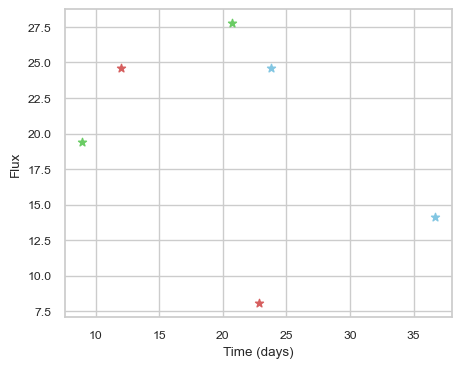

SNIax (3.9661036, False)
SNIax (3.4644833, False)
SNIax (3.4521914, False)
SNIax (3.3930223, False)
SNIax (2.9883895, False)
SNIax (3.970606, False)
SNIax (4.0975666, False)
SNIax (3.6298048, False)
SNIax (3.6935937, False)
SNIax (3.502579, False)
SNIax (3.2544227, False)
SNIax (3.5474784, False)


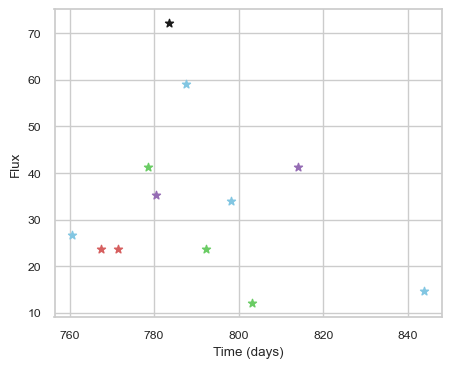

SNIax (3.9495828, False)
SNIax (3.343088, False)
SNIax (3.1970587, False)
SNIax (3.2802956, False)
SNIax (2.9234495, False)
SNIax (2.557967, False)
SNIax (2.8996994, False)
SNIax (1.7986064, False)
SNIax (3.144691, False)
SNIax (2.186342, False)
SNIax (3.2225506, False)
SNIax (2.9017303, False)
SNIax (3.2787702, False)
SNIax (3.1034467, False)
SNIax (3.2200797, False)
SNIax (2.3465567, False)
SNIax (2.4692404, False)
SNIax (2.0959313, False)
SNIax (2.1685631, False)
SNIax (2.3191557, False)
SNIax (2.090831, False)
SNIax (2.4440591, False)
SNIax (2.3659518, False)
SNIax (2.428745, False)


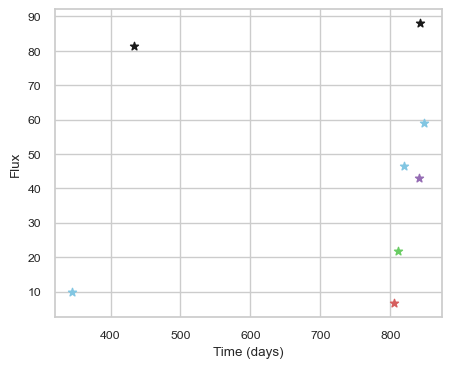

SNIax (4.0211635, False)
SNIax (3.8416817, False)
SNIax (3.70119, False)
SNIax (3.4029934, False)
SNIax (3.7296119, False)
SNIax (3.649966, False)
SNIax (3.2334018, False)
SNIax (2.6392744, False)
SNIax (2.7526064, False)
SNIax (3.3253164, False)
SNIax (3.2652967, False)
SNIax (2.9268768, False)
SNIax (3.0191603, False)
SNIax (3.2343554, False)
SNIax (3.48038, False)
SNIax (3.5992503, False)


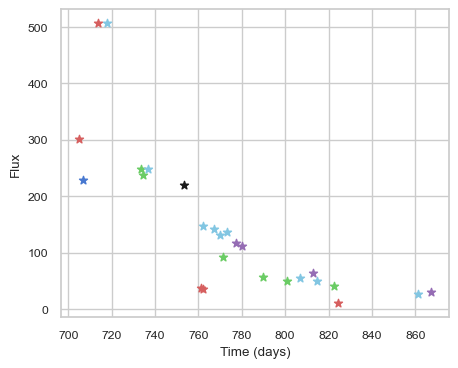

SNIax (3.7389874, False)
SNIax (3.870877, False)
SNIax (3.6802747, False)
SNIax (4.7818127, False)
SNIax (4.0505114, False)
SNIax (4.2753606, False)
SNIax (5.0311837, False)
SNIax (4.7260203, False)
SNIax (5.1339593, False)
SNIax (5.874528, False)
SNIax (5.2349434, False)
SNIax (5.507884, False)
SNIax (5.032215, False)
SNIax (5.846701, False)
SNIax (4.244045, False)
SNIax (4.8266106, False)
SNIax (4.646901, False)
SNIax (4.294107, False)
SNIax (3.9366696, False)
SNIax (4.486742, False)
SNIax (4.700197, False)
SNIax (4.518482, False)
SNIax (4.680011, False)
SNIax (4.828158, False)
SNIax (4.6207037, False)
SNIax (5.2504954, False)
SNIax (4.094514, False)
SNIax (4.9901094, False)
SNIax (3.3156893, False)
SNIax (5.025982, False)
SNIax (3.8477738, False)
SNIax (4.3387036, False)
SNIax (4.189747, False)
SNIax (4.5893083, False)
SNIax (3.8294637, False)
SNIax (4.141851, False)
SNIax (3.5100927, False)
SNIax (4.2287974, False)
SNIax (3.8146412, False)
SNIax (4.0267057, False)
SNIax (4.074986, 

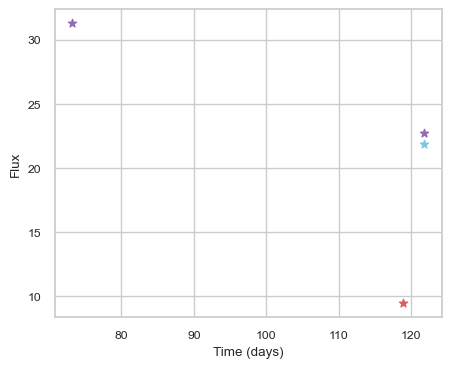

SNIax (4.2242956, False)
SNIax (3.95924, False)
SNIax (3.8932478, False)
SNIax (3.7396822, False)
SNIax (3.7343254, False)
SNIax (4.0590806, False)
SNIax (3.4594603, False)
SNIax (3.8648674, False)


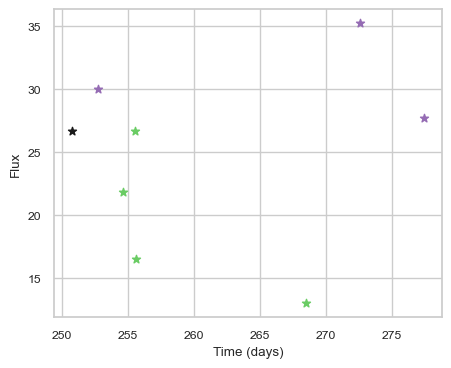

SNIax (5.4234395, False)
SNIax (5.1239533, False)
SNIax (4.39302, False)
SNIax (3.9039688, False)
SNIax (4.1314816, False)
SNIax (4.2827163, False)
SNIax (4.1863265, False)
SNIax (4.064843, False)
SNIax (4.5093803, False)
SNIax (3.9155035, False)
SNIax (3.9199173, False)
SNIax (3.7798352, False)
SNIax (3.676189, False)
SNIax (3.590976, False)
SNIax (3.077428, False)
SNIax (3.3993022, False)


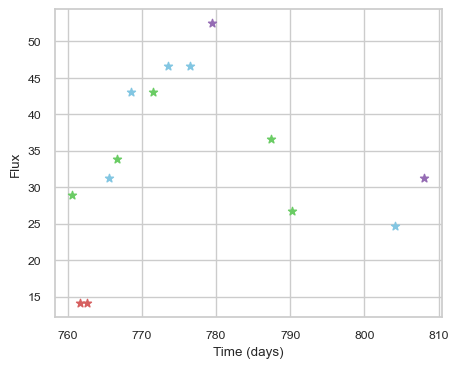

SNIax (3.9880478, False)
SNIax (3.0250802, False)
SNIax (2.8484905, False)
SNIax (3.2896996, False)
SNIax (3.1341436, False)
SNIax (2.8305624, False)
SNIax (2.7717676, False)
SNIax (2.294842, False)
SNIax (2.4028976, False)
SNIax (2.2269785, False)
SNIax (3.1333382, False)
SNIax (2.323431, False)
SNIax (2.554404, False)
SNIax (2.280849, False)
SNIax (2.501156, False)
SNIax (2.2005537, False)
SNIax (2.2804325, False)
SNIax (2.301158, False)
SNIax (2.3585992, False)
SNIax (2.1545718, False)
SNIax (2.3291535, False)
SNIax (2.4125738, False)
SNIax (2.8739507, False)
SNIax (2.235288, False)
SNIax (2.246953, False)
SNIax (1.9762745, False)
SNIax (2.3349745, False)
SNIax (2.466514, False)


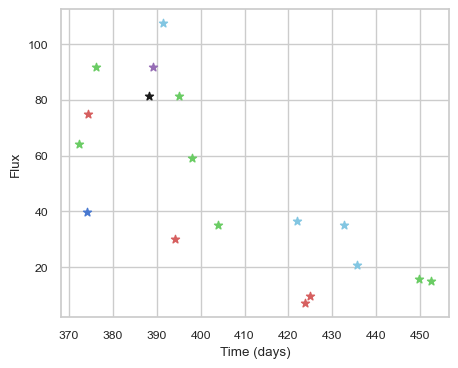

SNIax (3.802323, False)
SNIax (3.0890436, False)
SNIax (3.358388, False)
SNIax (4.2485867, False)
SNIax (3.8915637, False)
SNIax (3.3930035, False)
SNIax (3.7231019, False)
SNIax (3.2948816, False)
SNIax (3.3034472, False)
SNIax (2.7679753, False)
SNIax (3.170377, False)
SNIax (3.0528164, False)
SNIax (3.9238563, False)
SNIax (3.269724, False)
SNIax (4.1489553, False)
SNIax (3.6468697, False)
SNIax (3.3119175, False)
SNIax (3.1171408, False)
SNIax (3.3895411, False)
SNIax (2.9581926, False)
SNIax (2.7645972, False)
SNIax (2.4745495, False)
SNIax (2.1004272, False)
SNIax (1.870208, False)
SNIax (2.350814, False)
SNIax (2.0457256, False)
SNIax (2.5875957, False)
SNIax (2.0791569, False)
SNIax (1.9613882, False)
SNIax (1.8732853, False)
SNIax (2.3544948, False)
SNIax (1.7149905, False)
SNIax (1.744325, False)
SNIax (1.8997444, False)
SNIax (2.4155984, False)
SNIax (1.9876255, False)


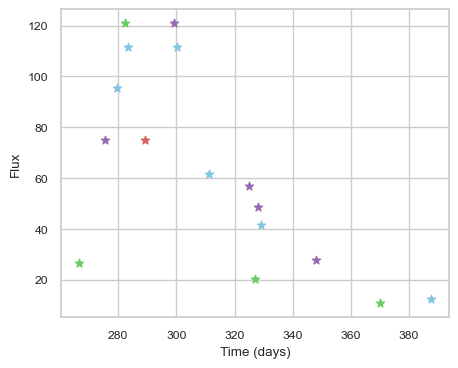

SNIax (3.7333488, False)
SNIax (3.9077516, False)
SNIax (3.445413, False)
SNIax (3.6659467, False)
SNIax (3.704981, False)
SNIax (3.888239, False)
SNIax (3.570063, False)
SNIax (3.5893104, False)
SNIax (4.4683633, False)
SNIax (4.096724, False)
SNIax (4.8473177, False)
SNIax (3.7494335, False)
SNIax (3.8691585, False)
SNIax (3.604989, False)
SNIax (4.051341, False)
SNIax (3.7802205, False)
SNIax (3.9446738, False)
SNIax (4.0567913, False)
SNIax (4.5787053, False)
SNIax (4.1190715, False)
SNIax (4.9598403, False)
SNIax (4.209169, False)
SNIax (4.589596, False)
SNIax (4.227032, False)
SNIax (4.792544, False)
SNIax (4.191515, False)
SNIax (4.5704913, False)
SNIax (4.1328225, False)
SNIax (4.6048703, False)
SNIax (4.646928, False)
SNIax (4.3868704, False)
SNIax (4.127396, False)


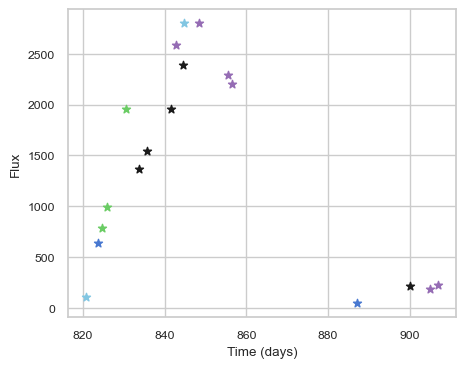

SNIax (5.5787253, False)
SNIax (6.4023685, False)
SNIax (6.0569696, False)
SNIax (7.308849, False)
SNIax (4.9441056, False)
SNIax (4.6281133, False)
SNIax (4.314188, False)
SNIax (3.9778686, False)
SNIax (3.2556868, False)
SNIax (3.1708927, False)
SNIax (2.696717, False)
SNIax (3.9960322, False)
SNIax (2.356551, False)
SNIax (3.9064963, False)
SNIax (2.0885763, False)
SNIax (2.975441, False)
SNIax (2.7855856, False)
SNIax (2.5235124, False)
SNIax (2.0606048, False)
SNIax (3.1066673, False)
SNIax (2.1159809, False)
SNIax (2.609148, False)
SNIax (2.0975327, False)
SNIax (3.598316, False)
SNIax (1.7819221, False)
SNIax (3.0508363, False)
SNIax (1.940646, False)
SNIax (3.0183666, False)
SNIax (2.382092, False)
SNIax (3.8127437, False)
SNIax (3.522797, False)
SNIax (3.6505768, False)
SNIax (3.5334883, False)
SNIax (3.7643569, False)
SNIax (3.2286942, False)
SNIax (3.7625647, False)


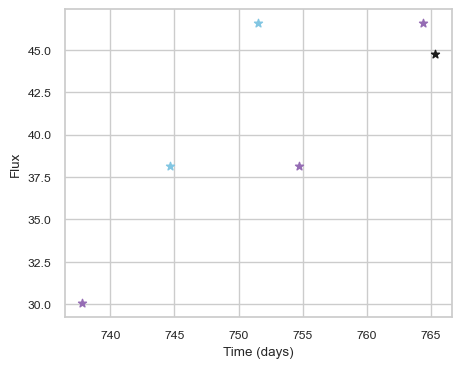

SNIax (4.241038, False)
SNIax (3.588452, False)
SNIax (3.7185717, False)
SNIax (4.0731177, False)
SNIax (4.39733, False)
SNIax (4.679663, False)
SNIax (4.7281547, False)
SNIax (4.643117, False)
SNIax (4.596179, False)
SNIax (4.8939056, False)
SNIax (5.216272, False)
SNIax (5.0239024, False)


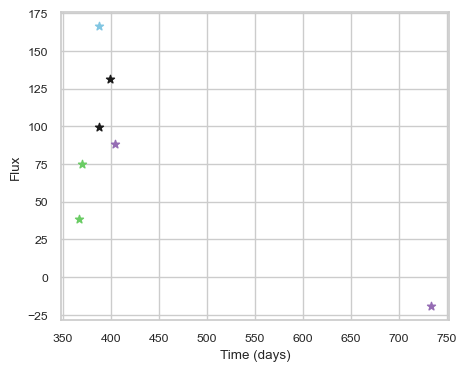

SNIax (3.8025672, False)
SNIax (3.0840993, False)
SNIax (2.8898816, False)
SNIax (3.654547, False)
SNIax (3.5224707, False)
SNIax (3.6449537, False)
SNIax (4.0147, False)
SNIax (3.637238, False)
SNIax (4.7088394, False)
SNIax (5.643236, False)
SNIax (5.543137, False)
SNIax (5.524955, False)
SNIax (6.221156, False)
SNIax (5.253059, False)


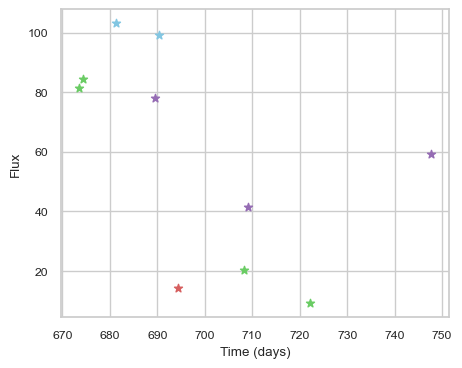

SNIax (3.9952054, False)
SNIax (4.937881, False)
SNIax (5.2472997, False)
SNIax (6.01568, False)
SNIax (6.0784383, False)
SNIax (6.383646, False)
SNIax (6.280275, False)
SNIax (5.4764605, False)
SNIax (6.049587, False)
SNIax (5.4296284, False)
SNIax (5.8844995, False)
SNIax (5.7794886, False)
SNIax (6.238121, False)
SNIax (6.1047983, False)
SNIax (6.6725082, False)
SNIax (6.228765, False)
SNIax (6.6049256, False)
SNIax (6.1666503, False)
SNIax (6.189251, False)
SNIax (6.1535025, False)


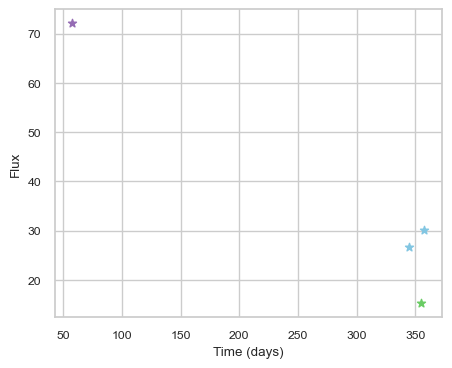

SNIax (5.923585, False)
SNIax (5.871226, False)
SNIax (5.691617, False)
SNIax (5.790162, False)
SNIax (5.9759855, False)
SNIax (6.3250246, False)
SNIax (6.254417, False)
SNIax (6.554481, False)


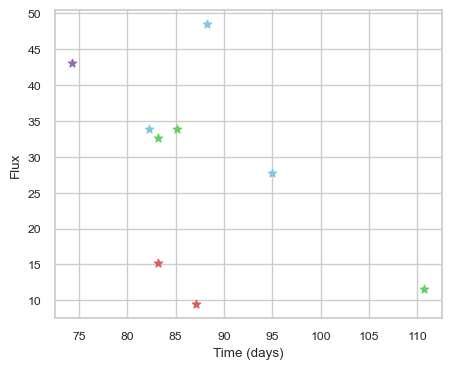

SNIax (4.722591, False)
SNIax (5.1139255, False)
SNIax (5.181363, False)
SNIax (4.7244463, False)
SNIax (3.777581, False)
SNIax (3.4443142, False)
SNIax (3.6327596, False)
SNIax (3.1082702, False)
SNIax (3.6769464, False)
SNIax (3.3687098, False)
SNIax (3.5379403, False)
SNIax (3.2881844, False)
SNIax (3.210118, False)
SNIax (3.502242, False)
SNIax (4.282831, False)
SNIax (3.6663032, False)
SNIax (3.357402, False)
SNIax (3.3411083, False)


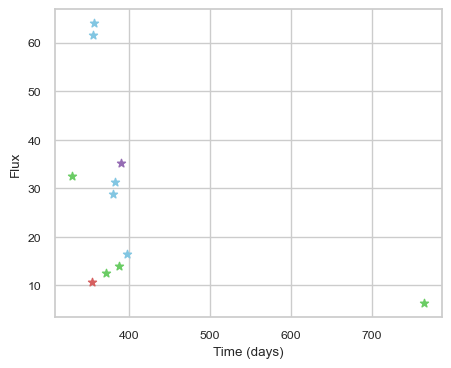

SNIax (3.9844708, False)
SNIax (3.9013002, False)
SNIax (3.6897206, False)
SNIax (3.6309586, False)
SNIax (3.580079, False)
SNIax (3.8417447, False)
SNIax (4.07072, False)
SNIax (4.3268394, False)
SNIax (4.6687717, False)
SNIax (3.9419136, False)
SNIax (3.6852868, False)
SNIax (3.9200878, False)
SNIax (3.2664657, False)
SNIax (3.472557, False)
SNIax (3.1827302, False)
SNIax (3.3552547, False)
SNIax (3.4148445, False)
SNIax (3.454002, False)
SNIax (2.9522095, False)
SNIax (3.507123, False)
SNIax (3.9582417, False)
SNIax (3.5501332, False)


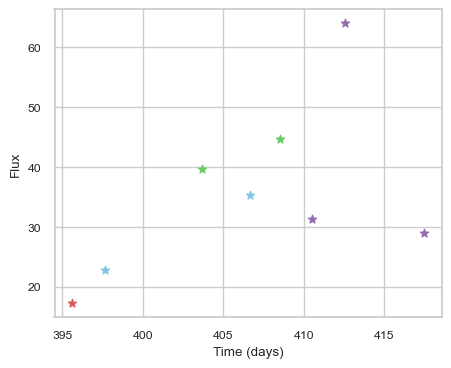

SNIax (3.8882864, False)
SNIax (4.873583, False)
SNIax (4.0467043, False)
SNIax (4.5094137, False)
SNIax (4.371517, False)
SNIax (3.1102197, False)
SNIax (3.654023, False)
SNIax (3.5777724, False)
SNIax (3.8528068, False)
SNIax (3.754311, False)
SNIax (4.232699, False)
SNIax (4.077654, False)
SNIax (4.0355034, False)
SNIax (3.8694227, False)
SNIax (3.9390209, False)
SNIax (4.4591866, False)


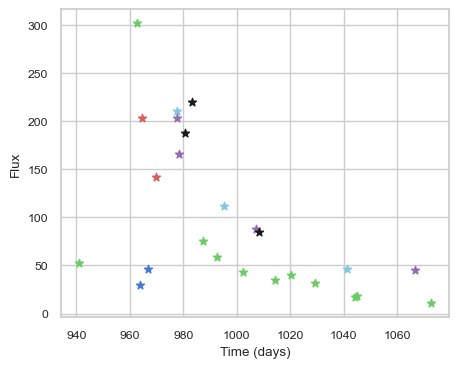

SNIax (3.7112322, False)
SNIax (3.5762072, False)
SNIax (3.5533028, False)
SNIax (4.728794, False)
SNIax (5.9966803, False)
SNIax (6.3105526, False)
SNIax (6.7292905, False)
SNIax (6.006678, False)
SNIax (6.418206, False)
SNIax (5.719223, False)
SNIax (6.196243, False)
SNIax (5.8005114, False)
SNIax (5.814313, False)
SNIax (5.533188, False)
SNIax (5.479633, False)
SNIax (5.2038608, False)
SNIax (6.059298, False)
SNIax (5.2012687, False)
SNIax (5.829189, False)
SNIax (5.874454, False)
SNIax (5.5134363, False)
SNIax (5.3880157, False)
SNIax (4.811263, False)
SNIax (4.3805594, False)
SNIax (4.3020825, False)
SNIax (4.801597, False)
SNIax (4.5727835, False)
SNIax (5.0318823, False)
SNIax (4.712665, False)
SNIax (5.0752378, False)
SNIax (4.8700395, False)
SNIax (5.10496, False)
SNIax (5.3992395, False)
SNIax (4.987564, False)
SNIax (4.469001, False)
SNIax (4.5176654, False)
SNIax (5.182202, False)
SNIax (4.4812465, False)
SNIax (4.432417, False)
SNIax (4.690943, False)
SNIax (5.260926, Fals

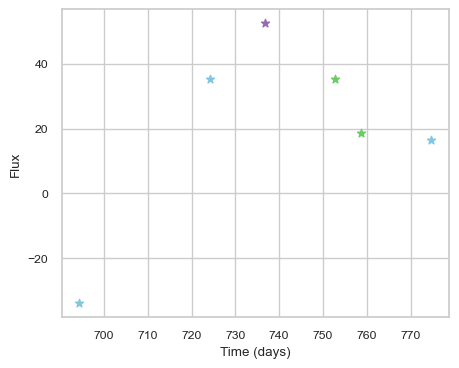

SNIax (3.798227, False)
SNIax (3.6723802, False)
SNIax (3.6620533, False)
SNIax (3.4288936, False)
SNIax (3.2412362, False)
SNIax (2.8714364, False)
SNIax (3.1516345, False)
SNIax (3.109691, False)
SNIax (3.8816376, False)
SNIax (3.2443879, False)
SNIax (3.212971, False)
SNIax (2.8907433, False)


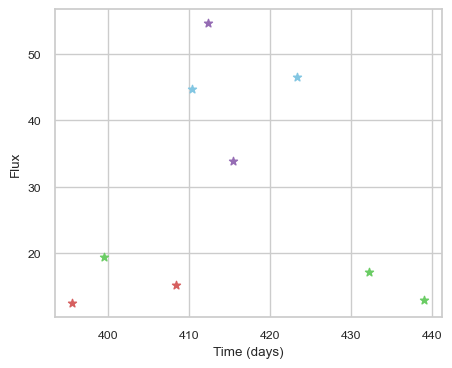

SNIax (4.0738287, False)
SNIax (4.387814, False)
SNIax (4.05272, False)
SNIax (4.0413437, False)
SNIax (4.2993474, False)
SNIax (4.0954814, False)
SNIax (3.925483, False)
SNIax (3.7590883, False)
SNIax (4.3209295, False)
SNIax (4.1420455, False)
SNIax (4.69535, False)
SNIax (3.9933379, False)
SNIax (3.646545, False)
SNIax (4.350248, False)
SNIax (4.125492, False)
SNIax (4.222699, False)
SNIax (3.831525, False)
SNIax (4.381028, False)


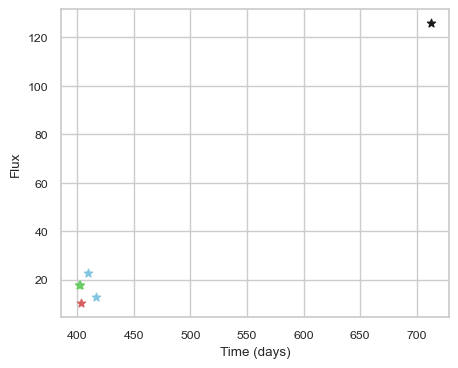

SNIax (3.9785967, False)
SNIax (3.5179806, False)
SNIax (3.4601755, False)
SNIax (3.4369419, False)
SNIax (3.4108424, False)
SNIax (3.185477, False)
SNIax (2.8765147, False)
SNIax (2.6395862, False)
SNIax (3.155222, False)
SNIax (2.6745825, False)
SNIax (3.4030175, False)
SNIax (3.4710753, False)


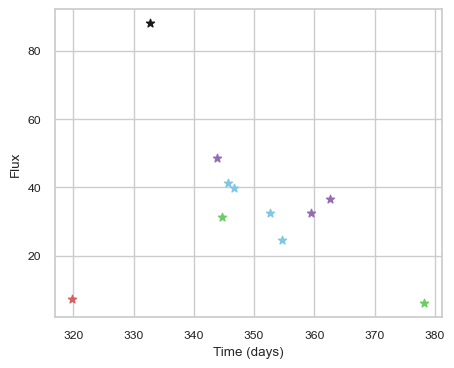

SNIax (3.9637365, False)
SNIax (4.129084, False)
SNIax (3.7467782, False)
SNIax (4.0129604, False)
SNIax (3.7961311, False)
SNIax (3.1922054, False)
SNIax (3.4222357, False)
SNIax (2.6611378, False)
SNIax (3.5538063, False)
SNIax (3.060704, False)
SNIax (3.5537038, False)
SNIax (3.1339712, False)
SNIax (3.015979, False)
SNIax (2.7844102, False)
SNIax (2.8311272, False)
SNIax (2.646581, False)
SNIax (2.9157743, False)
SNIax (2.6767664, False)
SNIax (3.0908318, False)
SNIax (2.712369, False)
SNIax (3.6967545, False)
SNIax (3.724527, False)


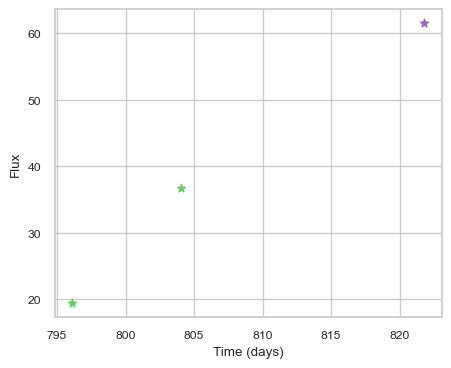

SNIax (3.9541204, False)
SNIax (3.4236495, False)
SNIax (3.2656336, False)
SNIax (2.6975071, False)
SNIax (2.765106, False)
SNIax (3.1584306, False)


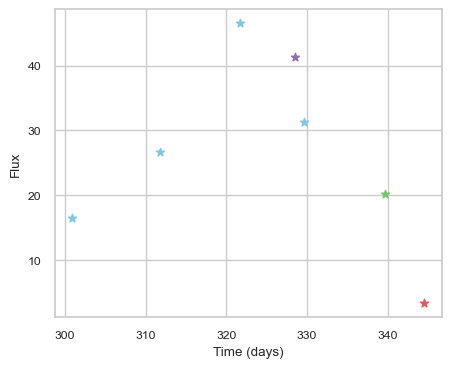

SNIax (3.8832517, False)
SNIax (3.7402692, False)
SNIax (2.946704, False)
SNIax (3.8423922, False)
SNIax (3.2737894, False)
SNIax (3.4874375, False)
SNIax (3.9676929, False)
SNIax (3.3908422, False)
SNIax (3.5279417, False)
SNIax (3.1258469, False)
SNIax (3.4788113, False)
SNIax (3.358139, False)
SNIax (3.7005312, False)
SNIax (3.2346041, False)


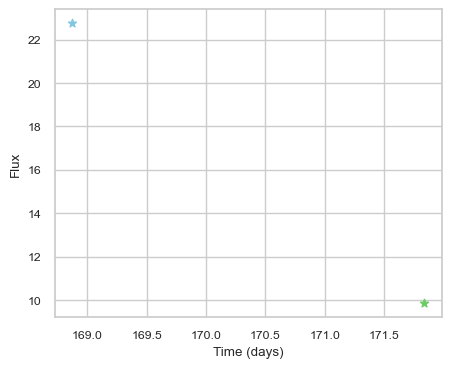

SNIax (4.2130575, False)
SNIax (3.8636253, False)
SNIax (3.305507, False)
SNIax (3.576891, False)


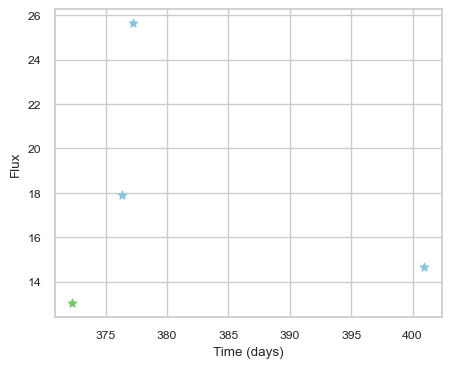

SNIax (4.2828493, False)
SNIax (3.4181135, False)
SNIax (3.4579067, False)
SNIax (2.6877782, False)
SNIax (2.894242, False)
SNIax (2.5560527, False)
SNIax (2.840257, False)
SNIax (2.733152, False)


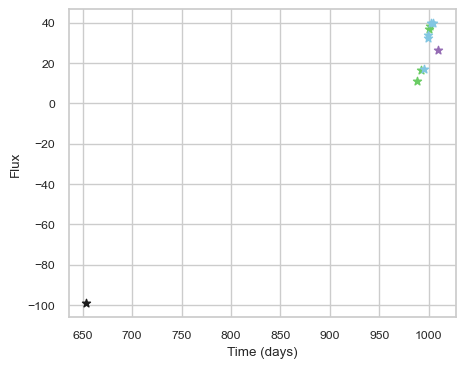

SNIax (4.00003, False)
SNIax (4.251684, False)
SNIax (3.9660864, False)
SNIax (3.8106656, False)
SNIax (3.6068077, False)
SNIax (3.3219488, False)
SNIax (3.7011375, False)
SNIax (3.523297, False)
SNIax (3.5565321, False)
SNIax (3.4633162, False)
SNIax (3.3382077, False)
SNIax (3.5246942, False)
SNIax (3.1195512, False)
SNIax (2.8494437, False)
SNIax (3.313855, False)
SNIax (2.6419919, False)
SNIax (3.1666884, False)
SNIax (3.3485992, False)
SNIax (2.784819, False)
SNIax (3.1800578, False)
SNIax (2.577148, False)
SNIax (2.2675683, False)


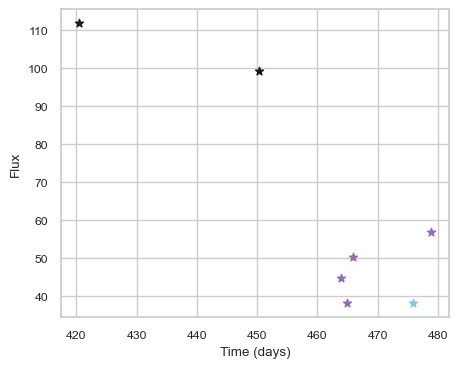

SNIax (4.770605, False)
SNIax (4.484051, False)
SNIax (5.0655594, False)
SNIax (4.625673, False)
SNIax (4.9210286, False)
SNIax (5.1029434, False)
SNIax (5.2300773, False)
SNIax (5.329642, False)
SNIax (5.515808, False)
SNIax (5.731064, False)
SNIax (5.930191, False)
SNIax (5.8496256, False)
SNIax (5.6194687, False)
SNIax (5.729853, False)


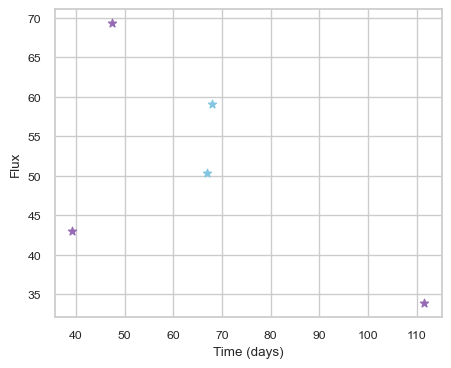

SNIax (4.161555, False)
SNIax (3.732703, False)
SNIax (3.3631253, False)
SNIax (3.2728558, False)
SNIax (3.3002434, False)
SNIax (3.1679127, False)
SNIax (3.2564876, False)
SNIax (3.4016142, False)
SNIax (3.7972498, False)
SNIax (4.2972364, False)


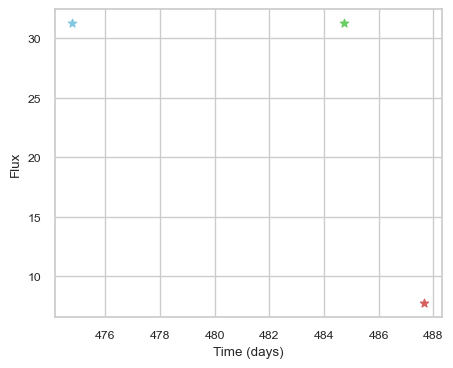

SNIax (4.3783665, False)
SNIax (4.045277, False)
SNIax (3.8473642, False)
SNIax (3.177057, False)
SNIax (3.4885466, False)
SNIax (3.137988, False)


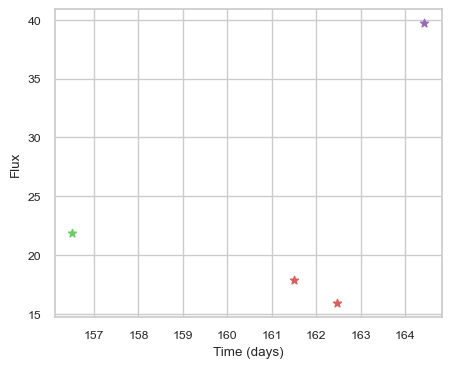

SNIax (3.6633945, False)
SNIax (4.084147, False)
SNIax (3.5144975, False)
SNIax (3.6012871, False)
SNIax (3.1462138, False)
SNIax (3.648634, False)
SNIax (3.247244, False)
SNIax (2.5652158, False)


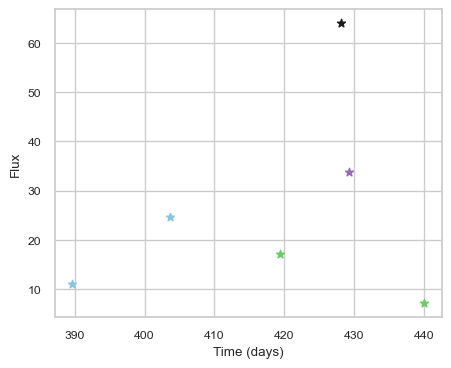

SNIax (5.1250176, False)
SNIax (4.2825937, False)
SNIax (4.494743, False)
SNIax (4.47106, False)
SNIax (4.934137, False)
SNIax (4.7891827, False)
SNIax (4.973943, False)
SNIax (5.676799, False)
SNIax (5.2590957, False)
SNIax (4.919874, False)
SNIax (5.274799, False)
SNIax (5.0062766, False)


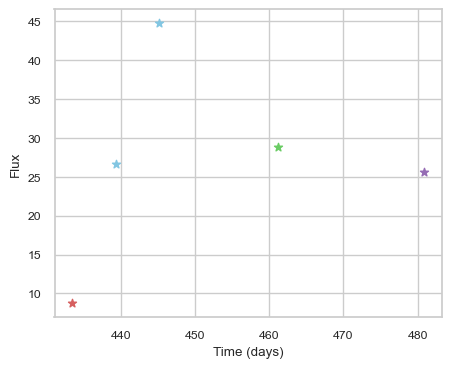

SNIax (3.7485383, False)
SNIax (4.267497, False)
SNIax (3.3605235, False)
SNIax (3.7183256, False)
SNIax (3.3600655, False)
SNIax (4.026976, False)
SNIax (3.3833425, False)
SNIax (4.0110445, False)
SNIax (4.217602, False)
SNIax (4.1007495, False)


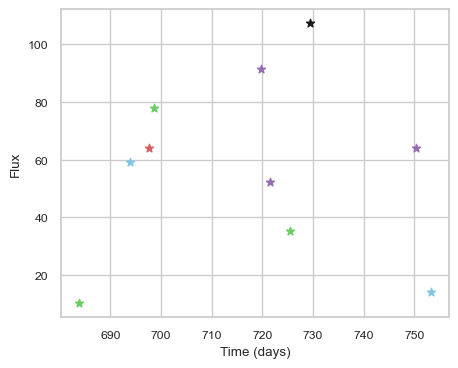

SNIax (3.8136027, False)
SNIax (3.6173372, False)
SNIax (3.3584945, False)
SNIax (3.8452618, False)
SNIax (4.116868, False)
SNIax (4.0764213, False)
SNIax (4.3438377, False)
SNIax (3.462113, False)
SNIax (2.8783731, False)
SNIax (2.400116, False)
SNIax (3.1706533, False)
SNIax (2.224675, False)
SNIax (2.9265707, False)
SNIax (2.2992265, False)
SNIax (3.0064602, False)
SNIax (2.639148, False)
SNIax (2.9688365, False)
SNIax (2.7267888, False)
SNIax (3.5963678, False)
SNIax (2.476578, False)


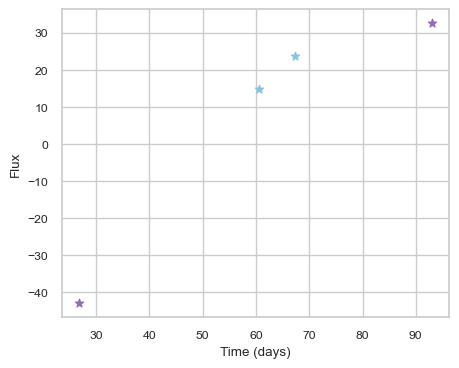

SNIax (4.4979396, False)
SNIax (4.248251, False)
SNIax (4.656264, False)
SNIax (4.116748, False)
SNIax (3.7884142, False)
SNIax (3.551203, False)
SNIax (3.901479, False)
SNIax (3.7254071, False)


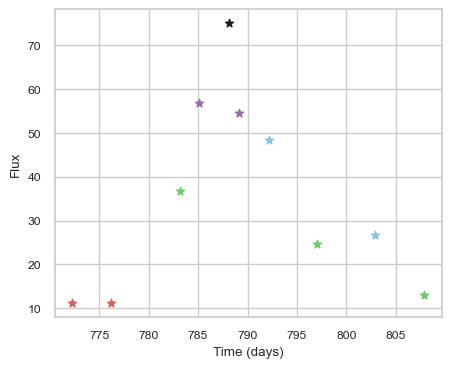

SNIax (3.8941686, False)
SNIax (4.043514, False)
SNIax (3.3801048, False)
SNIax (3.3511424, False)
SNIax (3.2261221, False)
SNIax (2.4661417, False)
SNIax (3.453944, False)
SNIax (3.1720417, False)
SNIax (3.6935015, False)
SNIax (3.202873, False)
SNIax (4.119455, False)
SNIax (3.6893854, False)
SNIax (3.7074323, False)
SNIax (3.7474003, False)
SNIax (3.8418908, False)
SNIax (3.3075683, False)
SNIax (3.215638, False)
SNIax (3.0358534, False)
SNIax (2.5106764, False)
SNIax (3.100197, False)


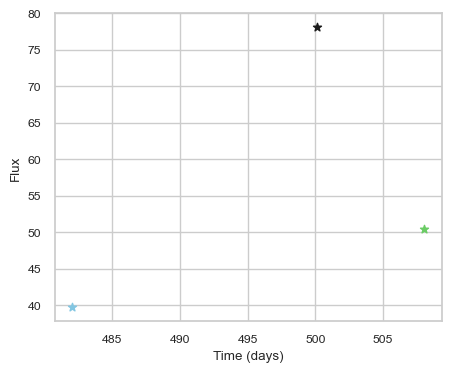

SNIax (3.9071813, False)
SNIax (4.0155582, False)
SNIax (3.740758, False)
SNIax (3.8824697, False)
SNIax (3.829506, False)
SNIax (3.502955, False)


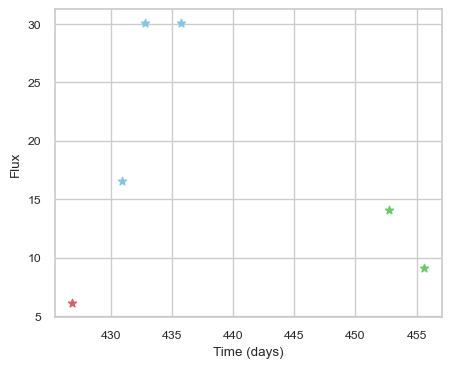

SNIax (4.7371387, False)
SNIax (4.5457373, False)
SNIax (3.8379009, False)
SNIax (3.6120925, False)
SNIax (3.8608024, False)
SNIax (3.1887715, False)
SNIax (3.2480135, False)
SNIax (3.0111039, False)
SNIax (3.3039591, False)
SNIax (2.7212856, False)
SNIax (3.308589, False)
SNIax (2.9346788, False)


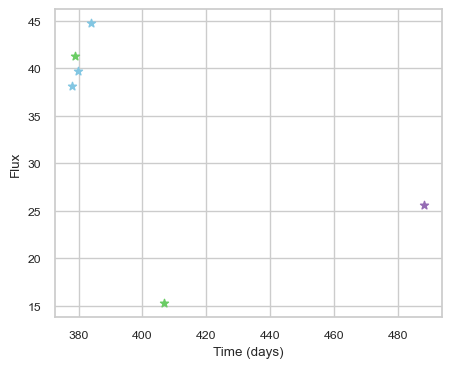

SNIax (3.9587626, False)
SNIax (3.4671717, False)
SNIax (3.368736, False)
SNIax (2.8850572, False)
SNIax (3.2309597, False)
SNIax (2.92032, False)
SNIax (3.1684034, False)
SNIax (2.4688427, False)
SNIax (2.5926871, False)
SNIax (3.172138, False)
SNIax (3.9962034, False)
SNIax (3.9141, False)


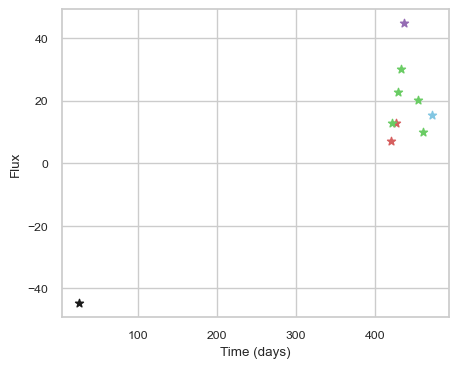

SNIax (4.2065387, False)
SNIax (3.9511397, False)
SNIax (4.0888147, False)
SNIax (3.827036, False)
SNIax (3.2671719, False)
SNIax (3.4049485, False)
SNIax (3.7605994, False)
SNIax (3.0816905, False)
SNIax (2.7656903, False)
SNIax (2.937964, False)
SNIax (3.3328602, False)
SNIax (3.0849783, False)
SNIax (3.1762402, False)
SNIax (3.3945963, False)
SNIax (3.0839968, False)
SNIax (3.529859, False)
SNIax (3.5174885, False)
SNIax (3.193301, False)
SNIax (2.7479622, False)
SNIax (2.7361243, False)


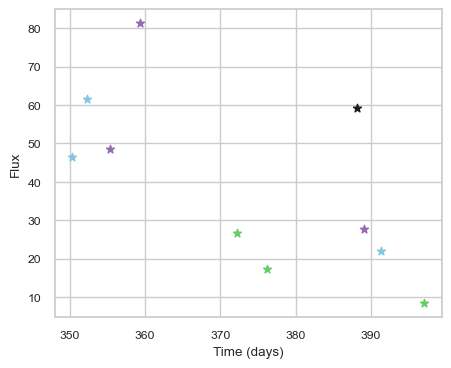

SNIax (3.8481705, False)
SNIax (3.7569973, False)
SNIax (3.3216684, False)
SNIax (3.5711417, False)
SNIax (3.850788, False)
SNIax (2.612051, False)
SNIax (3.0593104, False)
SNIax (2.6608667, False)
SNIax (2.9762979, False)
SNIax (2.436173, False)
SNIax (2.863569, False)
SNIax (2.2636275, False)
SNIax (2.3777182, False)
SNIax (2.5129426, False)
SNIax (2.669356, False)
SNIax (2.0868826, False)
SNIax (2.2986267, False)
SNIax (1.6499889, False)
SNIax (1.9780405, False)
SNIax (1.9310182, False)


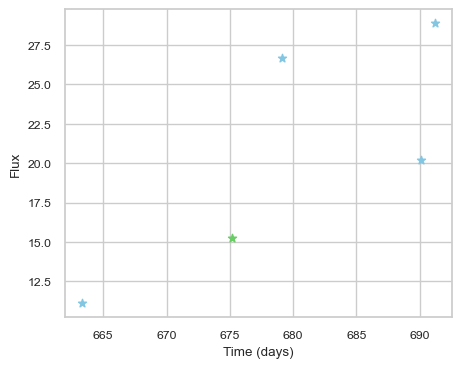

SNIax (4.9601326, False)
SNIax (4.6554728, False)
SNIax (3.7931354, False)
SNIax (3.5394955, False)
SNIax (3.6628308, False)
SNIax (3.3276372, False)
SNIax (2.8973641, False)
SNIax (2.8439825, False)
SNIax (2.6943045, False)
SNIax (2.6991208, False)


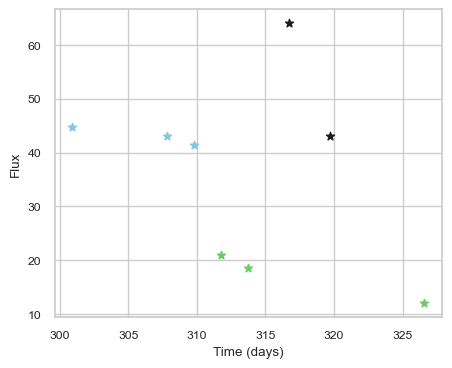

SNIax (4.4216523, False)
SNIax (5.3154464, False)
SNIax (5.5560403, False)
SNIax (5.8114977, False)
SNIax (5.0068717, False)
SNIax (5.787459, False)
SNIax (5.1894603, False)
SNIax (5.253853, False)
SNIax (5.106323, False)
SNIax (5.1363235, False)
SNIax (4.7466693, False)
SNIax (4.9960217, False)
SNIax (4.257826, False)
SNIax (4.173779, False)
SNIax (3.021704, False)
SNIax (3.612544, False)


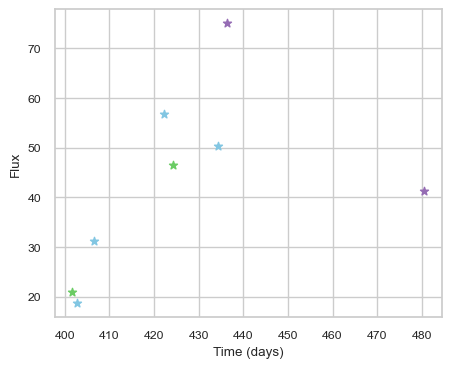

SNIax (3.9572093, False)
SNIax (3.548379, False)
SNIax (3.30385, False)
SNIax (3.7420766, False)
SNIax (3.7819471, False)
SNIax (3.3392925, False)
SNIax (3.1079497, False)
SNIax (3.6006951, False)
SNIax (3.5520058, False)
SNIax (3.5268052, False)
SNIax (3.3724575, False)
SNIax (3.4602005, False)
SNIax (3.4040172, False)
SNIax (3.410557, False)
SNIax (3.2726154, False)
SNIax (3.0386777, False)


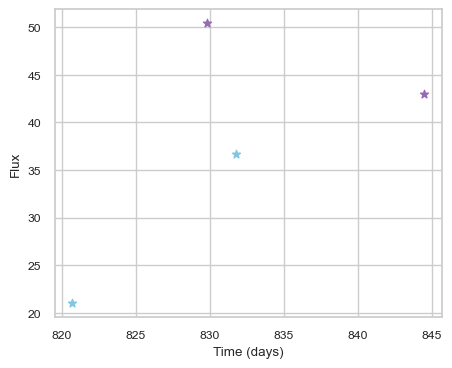

SNIax (4.0973616, False)
SNIax (3.448317, False)
SNIax (3.4442542, False)
SNIax (3.777864, False)
SNIax (4.1982207, False)
SNIax (4.257352, False)
SNIax (3.8942132, False)
SNIax (4.16556, False)


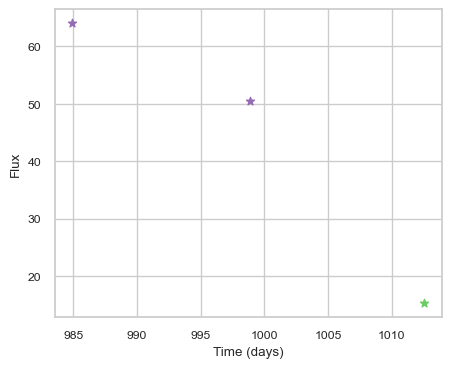

SNIax (3.8054595, False)
SNIax (3.5913723, False)
SNIax (3.5922031, False)
SNIax (3.5166705, False)
SNIax (3.9927158, False)
SNIax (3.676817, False)


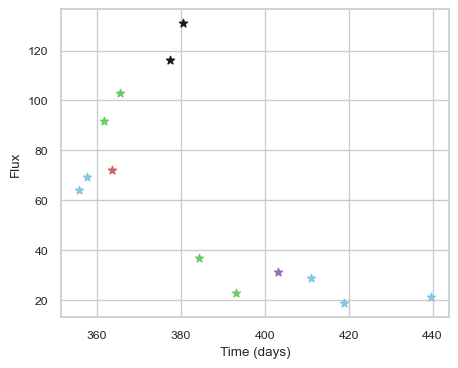

SNIax (3.8571653, False)
SNIax (3.7884562, False)
SNIax (4.268557, False)
SNIax (3.8182802, False)
SNIax (3.512589, False)
SNIax (3.4311144, False)
SNIax (3.7451108, False)
SNIax (3.426694, False)
SNIax (3.487245, False)
SNIax (3.5489166, False)
SNIax (3.0934567, False)
SNIax (2.811361, False)
SNIax (3.4046674, False)
SNIax (2.823481, False)
SNIax (3.833812, False)
SNIax (2.6728506, False)
SNIax (3.234142, False)
SNIax (3.336197, False)
SNIax (2.587741, False)
SNIax (2.5219884, False)
SNIax (1.9313695, False)
SNIax (1.7795174, False)
SNIax (1.9311678, False)
SNIax (1.8512803, False)
SNIax (2.2301087, False)
SNIax (2.1356347, False)


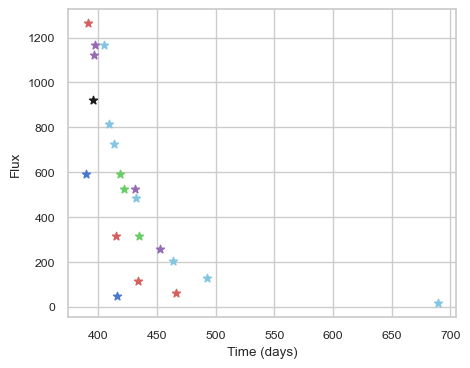

SNIax (3.592053, False)
SNIax (5.0069823, False)
SNIax (3.3225515, False)
SNIax (3.7540936, False)
SNIax (2.7764528, False)
SNIax (3.1774292, False)
SNIax (2.8189366, False)
SNIax (2.4571943, False)
SNIax (3.129782, False)
SNIax (2.6390703, False)
SNIax (1.9755534, False)
SNIax (2.089401, False)
SNIax (2.6128552, False)
SNIax (2.3577724, False)
SNIax (2.616647, False)
SNIax (2.8793676, False)
SNIax (2.2231119, False)
SNIax (4.0734487, False)
SNIax (3.5709572, False)
SNIax (4.6657286, False)
SNIax (4.214774, False)
SNIax (3.9344397, False)
SNIax (3.9877784, False)
SNIax (4.417234, False)
SNIax (4.0298586, False)
SNIax (3.5779884, False)
SNIax (3.6115947, False)
SNIax (3.5080254, False)
SNIax (2.9955058, False)
SNIax (4.040381, False)
SNIax (4.0460563, False)
SNIax (3.4786246, False)
SNIax (4.0303397, False)
SNIax (4.28287, False)
SNIax (3.8002172, False)
SNIax (4.1703305, False)
SNIax (3.8562827, False)
SNIax (4.5606055, False)
SNIax (4.1592865, False)
SNIax (4.4022856, False)
SNIax (4.

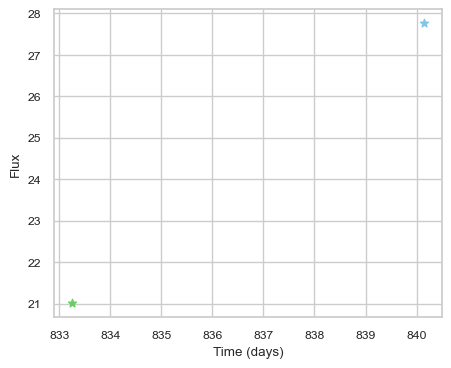

SNIax (3.8391156, False)
SNIax (3.33116, False)
SNIax (3.3034549, False)
SNIax (3.2881157, False)


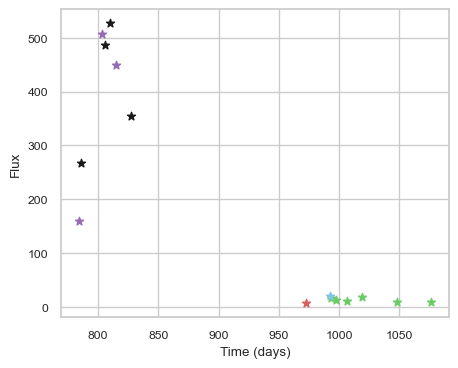

SNIax (3.6542647, False)
SNIax (3.0398688, False)
SNIax (3.5267973, False)
SNIax (3.3946462, False)
SNIax (3.134795, False)
SNIax (3.3015668, False)
SNIax (3.014527, False)
SNIax (3.6301565, False)
SNIax (3.2305725, False)
SNIax (3.4896822, False)
SNIax (2.957242, False)
SNIax (3.5371284, False)
SNIax (3.2438786, False)
SNIax (3.4566164, False)
SNIax (3.085275, False)
SNIax (3.6408184, False)
SNIax (3.0048754, False)
SNIax (2.8903806, False)
SNIax (2.6559265, False)
SNIax (2.7072797, False)
SNIax (2.91729, False)
SNIax (2.685966, False)
SNIax (2.742931, False)
SNIax (2.7170415, False)
SNIax (2.5814867, False)
SNIax (2.4214106, False)
SNIax (2.8253257, False)
SNIax (2.6730645, False)
SNIax (2.7235744, False)
SNIax (2.5626137, False)


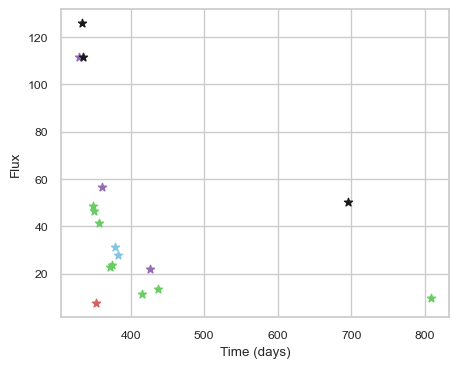

SNIax (3.8379407, False)
SNIax (3.8945591, False)
SNIax (4.1417737, False)
SNIax (4.051209, False)
SNIax (3.8734949, False)
SNIax (3.789378, False)
SNIax (3.4545043, False)
SNIax (3.7237482, False)
SNIax (3.8996751, False)
SNIax (4.311671, False)
SNIax (4.41679, False)
SNIax (4.3270445, False)
SNIax (4.0984416, False)
SNIax (4.0501785, False)
SNIax (4.3415008, False)
SNIax (3.933857, False)
SNIax (3.2884667, False)
SNIax (3.576791, False)
SNIax (3.7865512, False)
SNIax (3.390703, False)
SNIax (3.57875, False)
SNIax (3.2865744, False)
SNIax (3.0599642, False)
SNIax (2.9479823, False)
SNIax (3.0583198, False)
SNIax (3.2260077, False)
SNIax (3.0386438, False)
SNIax (3.0543177, False)
SNIax (2.9363494, False)
SNIax (2.9878738, False)
SNIax (3.448519, False)
SNIax (3.771754, False)
SNIax (3.7475145, False)
SNIax (3.5398853, False)


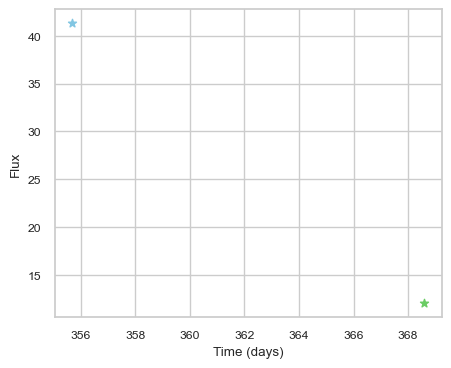

SNIax (3.8387504, False)
SNIax (3.640795, False)
SNIax (3.6090345, False)
SNIax (3.584499, False)


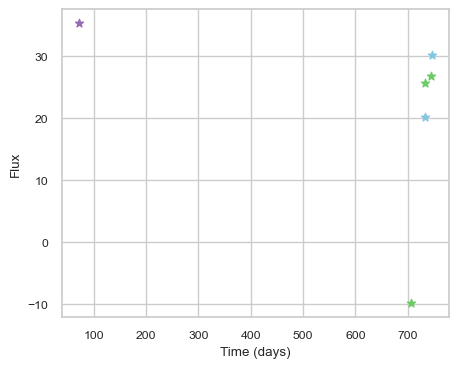

SNIax (5.300983, False)
SNIax (5.38029, False)
SNIax (5.1771064, False)
SNIax (4.806555, False)
SNIax (4.70638, False)
SNIax (4.6908417, False)
SNIax (5.0809555, False)
SNIax (4.795357, False)
SNIax (4.2482114, False)
SNIax (4.6905107, False)
SNIax (4.1390896, False)
SNIax (4.828192, False)


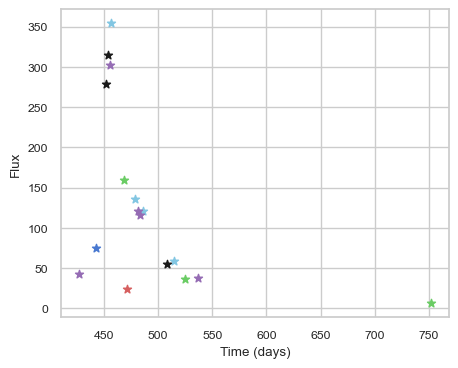

SNIax (3.8703265, False)
SNIax (3.487054, False)
SNIax (3.5297484, False)
SNIax (5.0019884, False)
SNIax (3.629363, False)
SNIax (4.2257476, False)
SNIax (3.4885068, False)
SNIax (3.7006946, False)
SNIax (3.573193, False)
SNIax (3.2405324, False)
SNIax (3.4626706, False)
SNIax (3.4443514, False)
SNIax (3.0880206, False)
SNIax (3.4131696, False)
SNIax (2.5593002, False)
SNIax (3.1234927, False)
SNIax (3.045075, False)
SNIax (3.0162747, False)
SNIax (3.2529907, False)
SNIax (2.882281, False)
SNIax (3.3822742, False)
SNIax (2.8852131, False)
SNIax (3.031411, False)
SNIax (2.7507133, False)
SNIax (3.1361582, False)
SNIax (3.263821, False)
SNIax (3.0119023, False)
SNIax (3.0532682, False)
SNIax (2.9245493, False)
SNIax (2.9219162, False)
SNIax (3.1357007, False)
SNIax (3.1232421, False)
SNIax (2.947898, False)
SNIax (3.1224153, False)


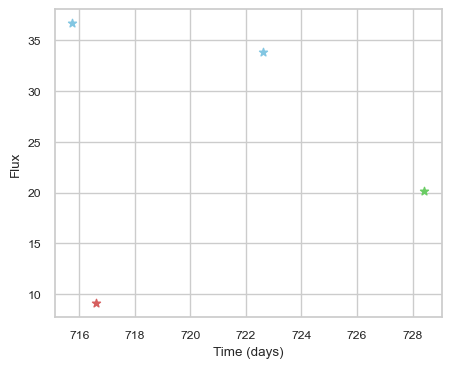

SNIax (3.804361, False)
SNIax (3.5278852, False)
SNIax (3.2720482, False)
SNIax (3.4509645, False)
SNIax (2.930401, False)
SNIax (2.680608, False)
SNIax (3.0166044, False)
SNIax (2.6005814, False)


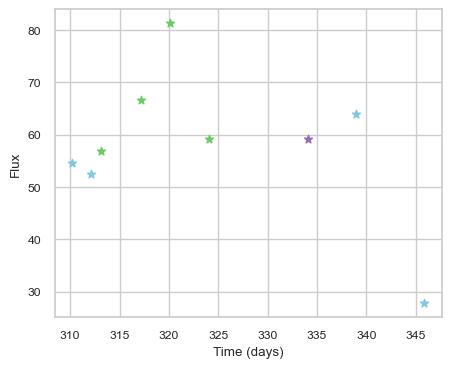

SNIax (3.8559282, False)
SNIax (4.4996643, False)
SNIax (3.8629699, False)
SNIax (4.3593125, False)
SNIax (3.4185853, False)
SNIax (3.85619, False)
SNIax (3.5412993, False)
SNIax (3.5107756, False)
SNIax (3.653616, False)
SNIax (4.0084877, False)
SNIax (3.9366677, False)
SNIax (3.681565, False)
SNIax (3.5628498, False)
SNIax (3.2837179, False)
SNIax (3.8667436, False)
SNIax (3.9346042, False)
SNIax (3.6177833, False)
SNIax (4.019922, False)


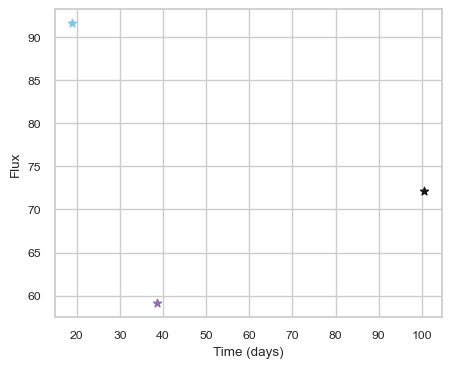

SNIax (3.9499016, False)
SNIax (4.609876, False)
SNIax (3.9761784, False)
SNIax (3.5165267, False)
SNIax (4.5188174, False)
SNIax (4.646071, False)


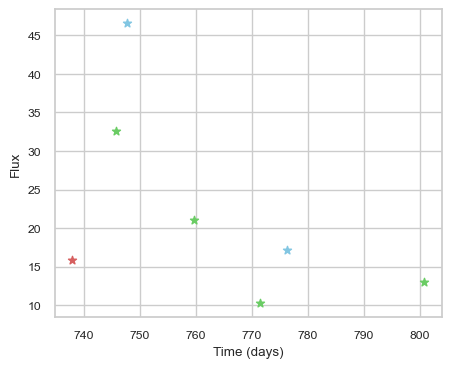

SNIax (3.7925923, False)
SNIax (3.786646, False)
SNIax (3.3396971, False)
SNIax (2.7996292, False)
SNIax (4.04188, False)
SNIax (2.8173106, False)
SNIax (3.1545286, False)
SNIax (2.961017, False)
SNIax (2.7581515, False)
SNIax (2.9448485, False)
SNIax (2.5782492, False)
SNIax (2.7496326, False)
SNIax (2.5294197, False)
SNIax (2.6062834, False)


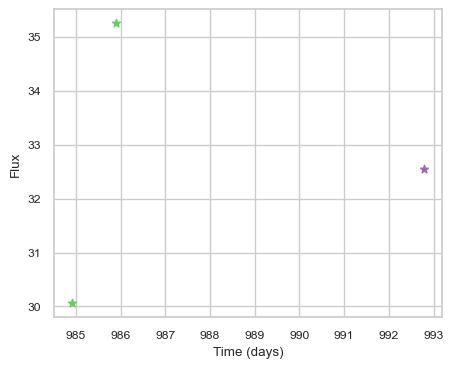

SNIax (3.6728754, False)
SNIax (4.09644, False)
SNIax (3.392883, False)
SNIax (3.6621518, False)
SNIax (3.5127242, False)
SNIax (3.9216955, False)


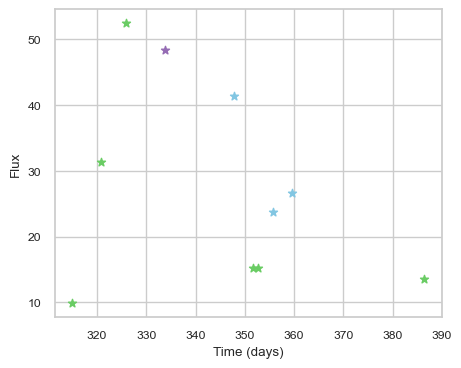

SNIax (3.7538579, False)
SNIax (3.7519493, False)
SNIax (3.4946246, False)
SNIax (3.7021048, False)
SNIax (3.2022429, False)
SNIax (3.421016, False)
SNIax (3.738238, False)
SNIax (2.4047415, False)
SNIax (2.8266668, False)
SNIax (2.2078297, False)
SNIax (3.2278905, False)
SNIax (2.7051358, False)
SNIax (2.6883905, False)
SNIax (3.086091, False)
SNIax (2.80719, False)
SNIax (2.2577536, False)
SNIax (2.9559739, False)
SNIax (2.5551193, False)
SNIax (4.8879905, False)
SNIax (4.2023854, False)


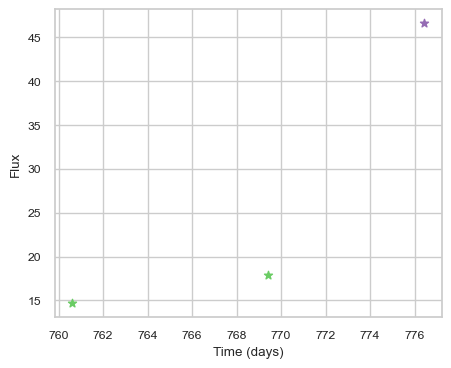

SNIax (4.112584, False)
SNIax (3.2347405, False)
SNIax (3.1586456, False)
SNIax (3.3982973, False)
SNIax (3.5983746, False)
SNIax (2.4924643, False)


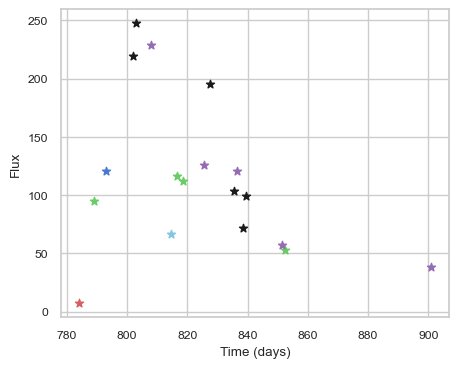

SNIax (3.669859, False)
SNIax (3.812009, False)
SNIax (3.4380012, False)
SNIax (3.3332713, False)
SNIax (3.3048263, False)
SNIax (3.7058024, False)
SNIax (3.070602, False)
SNIax (3.6437874, False)
SNIax (3.5480404, False)
SNIax (3.4247856, False)
SNIax (3.6324766, False)
SNIax (2.5380702, False)
SNIax (3.4124238, False)
SNIax (3.0126884, False)
SNIax (2.8973331, False)
SNIax (2.9411342, False)
SNIax (3.2786164, False)
SNIax (3.2823927, False)
SNIax (3.2588449, False)
SNIax (3.4440703, False)
SNIax (4.017051, False)
SNIax (3.535778, False)
SNIax (4.096687, False)
SNIax (3.8830638, False)
SNIax (3.7676783, False)
SNIax (3.815154, False)
SNIax (4.363148, False)
SNIax (3.628542, False)
SNIax (3.8007548, False)
SNIax (3.8117337, False)
SNIax (4.247116, False)
SNIax (3.8730402, False)
SNIax (3.1221392, False)
SNIax (3.556909, False)
SNIax (4.2925897, False)
SNIax (4.111437, False)


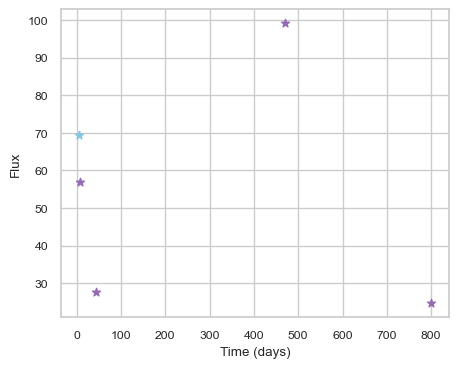

SNIax (3.8298378, False)
SNIax (4.6067505, False)
SNIax (4.6233516, False)
SNIax (3.5959508, False)
SNIax (3.682168, False)
SNIax (3.4145496, False)
SNIax (4.592873, False)
SNIax (4.0655537, False)
SNIax (4.5859876, False)
SNIax (3.2289708, False)


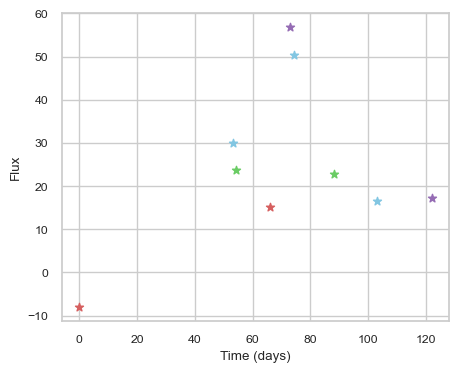

SNIax (4.4296727, False)
SNIax (4.28936, False)
SNIax (3.8885388, False)
SNIax (3.2222443, False)
SNIax (2.7961364, False)
SNIax (3.0952675, False)
SNIax (3.550572, False)
SNIax (3.4544427, False)
SNIax (3.3497577, False)
SNIax (4.128134, False)
SNIax (3.8970668, False)
SNIax (4.1281343, False)
SNIax (3.7641597, False)
SNIax (3.8146055, False)
SNIax (2.915391, False)
SNIax (2.70485, False)
SNIax (3.3730545, False)


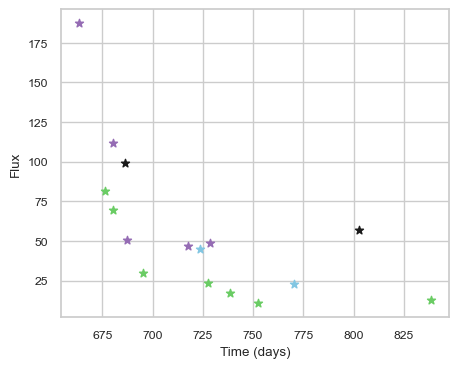

SNIax (3.806327, False)
SNIax (4.101477, False)
SNIax (4.693302, False)
SNIax (5.792727, False)
SNIax (5.2721906, False)
SNIax (6.0751824, False)
SNIax (5.096459, False)
SNIax (5.8424854, False)
SNIax (5.096016, False)
SNIax (5.737088, False)
SNIax (5.8064623, False)
SNIax (5.983885, False)
SNIax (5.1371055, False)
SNIax (5.8684125, False)
SNIax (5.6721764, False)
SNIax (5.5776625, False)
SNIax (5.3846087, False)
SNIax (5.6420994, False)
SNIax (5.343732, False)
SNIax (5.320841, False)
SNIax (5.475601, False)
SNIax (5.4351997, False)
SNIax (5.381117, False)
SNIax (5.406956, False)
SNIax (5.1301575, False)
SNIax (5.342747, False)
SNIax (5.2378135, False)
SNIax (5.5019994, False)
SNIax (5.543587, False)
SNIax (6.47642, False)
SNIax (5.8626776, False)
SNIax (6.012937, False)


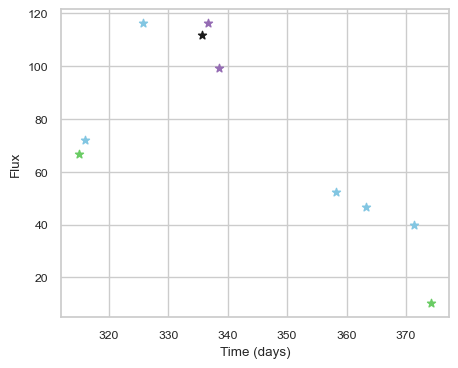

SNIax (3.8282835, False)
SNIax (4.4573, False)
SNIax (3.9780478, False)
SNIax (5.308131, False)
SNIax (3.8394265, False)
SNIax (4.77594, False)
SNIax (4.1715827, False)
SNIax (3.607583, False)
SNIax (4.299033, False)
SNIax (3.8055909, False)
SNIax (3.966031, False)
SNIax (3.914605, False)
SNIax (3.8941567, False)
SNIax (3.7563863, False)
SNIax (4.366488, False)
SNIax (3.664965, False)
SNIax (3.8193555, False)
SNIax (3.5309157, False)
SNIax (3.7645602, False)
SNIax (3.4708533, False)


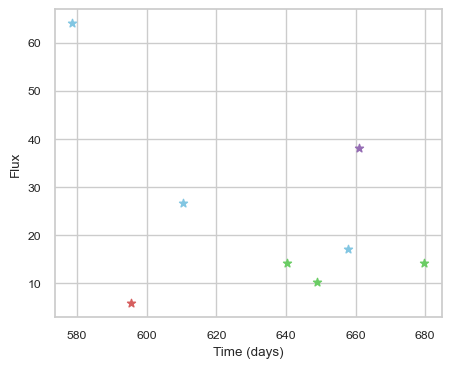

SNIax (3.7253444, False)
SNIax (3.5859854, False)
SNIax (4.1795006, False)
SNIax (4.044151, False)
SNIax (3.9754455, False)
SNIax (3.831072, False)
SNIax (4.35572, False)
SNIax (3.6137877, False)
SNIax (4.203985, False)
SNIax (3.9090445, False)
SNIax (3.8234453, False)
SNIax (3.7447574, False)
SNIax (4.0664372, False)
SNIax (4.103082, False)
SNIax (4.427243, False)
SNIax (4.168895, False)


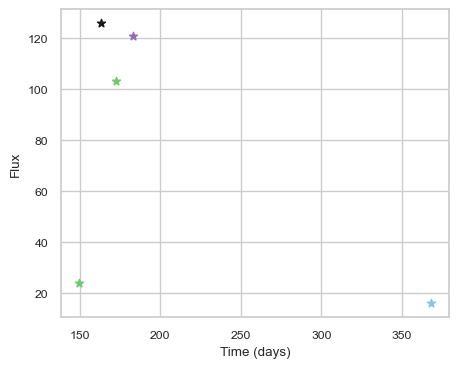

SNIax (4.116341, False)
SNIax (4.1881003, False)
SNIax (3.7189984, False)
SNIax (4.1133757, False)
SNIax (4.599312, False)
SNIax (4.6534805, False)
SNIax (5.001723, False)
SNIax (4.8115067, False)
SNIax (4.724033, False)
SNIax (4.6082025, False)


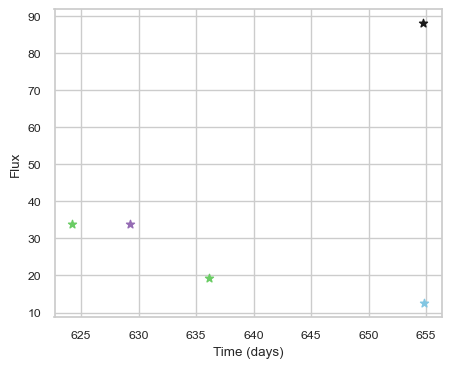

SNIax (3.7368822, False)
SNIax (3.4825969, False)
SNIax (3.5057523, False)
SNIax (3.6574664, False)
SNIax (3.3223724, False)
SNIax (4.303295, False)
SNIax (4.0759473, False)
SNIax (5.827528, False)
SNIax (4.539378, False)
SNIax (4.268504, False)


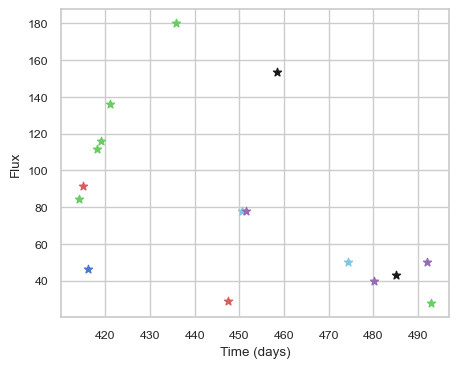

SNIax (4.4580855, False)
SNIax (4.7524548, False)
SNIax (5.035014, False)
SNIax (5.282754, False)
SNIax (4.918044, False)
SNIax (5.126412, False)
SNIax (4.4639435, False)
SNIax (4.4744077, False)
SNIax (4.3584642, False)
SNIax (4.5918145, False)
SNIax (4.569144, False)
SNIax (4.727943, False)
SNIax (3.2605848, False)
SNIax (3.6482396, False)
SNIax (3.3743033, False)
SNIax (3.6928976, False)
SNIax (2.916975, False)
SNIax (2.988767, False)
SNIax (3.10473, False)
SNIax (2.7468069, False)
SNIax (2.7524729, False)
SNIax (3.0104687, False)
SNIax (3.5999193, False)
SNIax (2.932442, False)
SNIax (2.9396808, False)
SNIax (3.0465858, False)
SNIax (3.081465, False)
SNIax (3.4401658, False)
SNIax (2.841066, False)
SNIax (3.2920654, False)
SNIax (3.0644011, False)
SNIax (3.3996375, False)


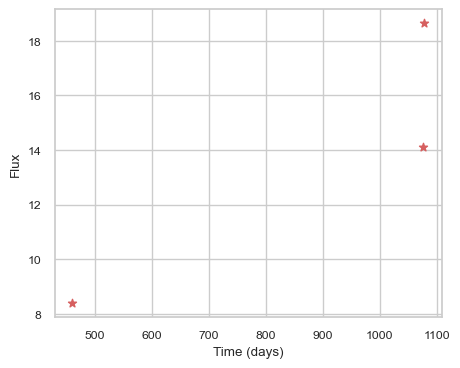

SNIax (4.0355797, False)
SNIax (4.402066, False)
SNIax (3.686542, False)
SNIax (3.8074715, False)
SNIax (3.1355505, False)
SNIax (2.894243, False)


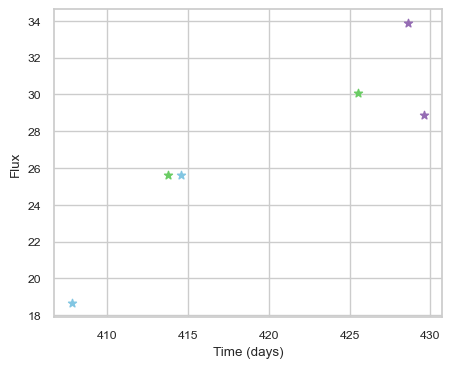

SNIax (4.1098747, False)
SNIax (3.44504, False)
SNIax (3.0688164, False)
SNIax (2.858977, False)
SNIax (3.4665685, False)
SNIax (2.7856123, False)
SNIax (2.9665022, False)
SNIax (2.6861484, False)
SNIax (3.7770848, False)
SNIax (3.0676763, False)
SNIax (3.3915536, False)
SNIax (3.4560566, False)


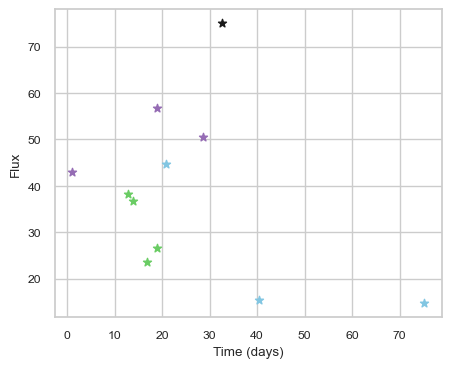

SNIax (3.9798188, False)
SNIax (4.0818577, False)
SNIax (3.5952675, False)
SNIax (3.3140676, False)
SNIax (3.8101192, False)
SNIax (3.694955, False)
SNIax (4.666597, False)
SNIax (3.737138, False)
SNIax (3.6816804, False)
SNIax (3.44137, False)
SNIax (3.9322078, False)
SNIax (3.151923, False)
SNIax (4.413993, False)
SNIax (3.7221966, False)
SNIax (3.0049098, False)
SNIax (3.5679002, False)
SNIax (4.1945944, False)
SNIax (3.9072492, False)
SNIax (4.639305, False)
SNIax (3.8764215, False)
SNIax (3.6105926, False)
SNIax (3.671122, False)


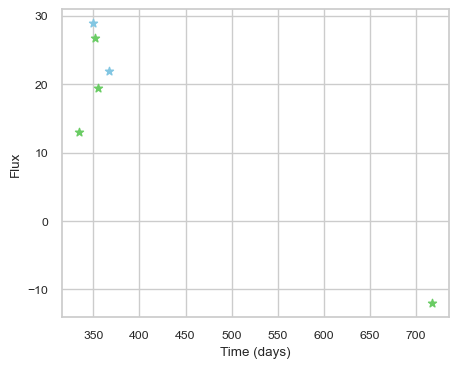

SNIax (4.299134, False)
SNIax (3.8404973, False)
SNIax (3.288511, False)
SNIax (3.0236993, False)
SNIax (2.964139, False)
SNIax (2.8592763, False)
SNIax (3.4970865, False)
SNIax (2.8678954, False)
SNIax (3.0413876, False)
SNIax (3.139571, False)
SNIax (4.385484, False)
SNIax (4.099431, False)


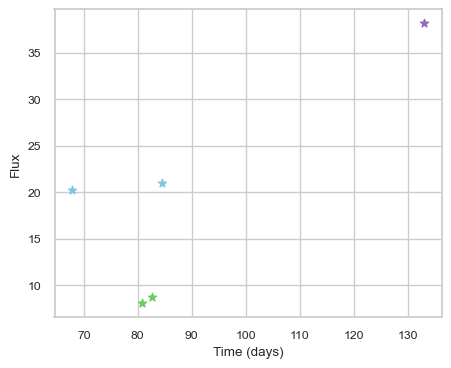

SNIax (4.010916, False)
SNIax (3.7611415, False)
SNIax (3.041091, False)
SNIax (3.4399436, False)
SNIax (3.4997432, False)
SNIax (3.5114293, False)
SNIax (3.436666, False)
SNIax (3.2976165, False)
SNIax (3.3821173, False)
SNIax (4.1811843, False)


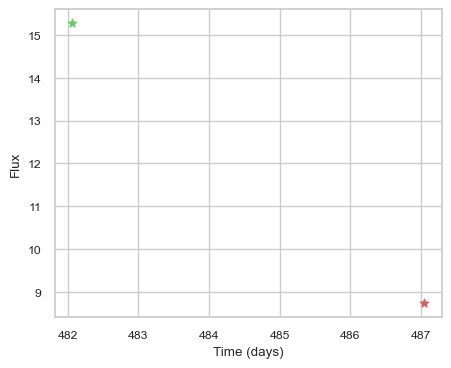

SNIax (4.8439097, False)
SNIax (4.041745, False)
SNIax (3.806358, False)
SNIax (3.7993078, False)


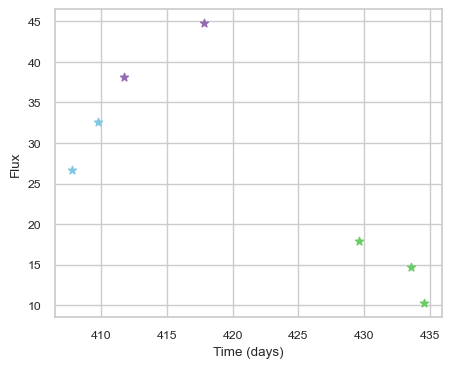

SNIax (4.124958, False)
SNIax (3.511908, False)
SNIax (3.114344, False)
SNIax (3.1787765, False)
SNIax (3.1413698, False)
SNIax (2.7906044, False)
SNIax (3.1929154, False)
SNIax (2.9696975, False)
SNIax (2.9334211, False)
SNIax (2.6437278, False)
SNIax (2.9009845, False)
SNIax (2.771347, False)
SNIax (2.5606925, False)
SNIax (2.993409, False)


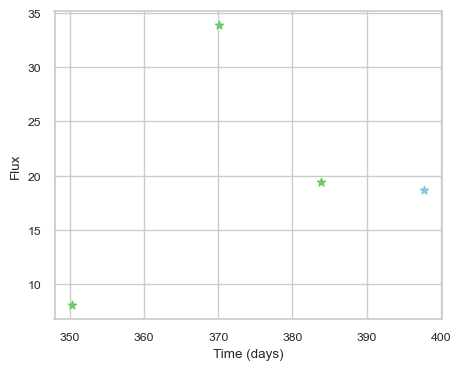

SNIax (4.062176, False)
SNIax (3.5015876, False)
SNIax (3.3740435, False)
SNIax (2.8181167, False)
SNIax (3.035687, False)
SNIax (2.4368558, False)
SNIax (2.9821682, False)
SNIax (2.643811, False)


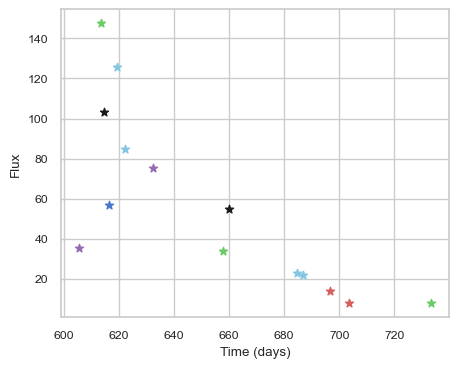

SNIax (3.5284514, False)
SNIax (3.4985242, False)
SNIax (3.2866585, False)
SNIax (3.0876586, False)
SNIax (3.192366, False)
SNIax (2.9707546, False)
SNIax (3.4156983, False)
SNIax (3.367525, False)
SNIax (3.025086, False)
SNIax (3.6510875, False)
SNIax (3.2488482, False)
SNIax (2.7794094, False)
SNIax (2.5241327, False)
SNIax (2.3236578, False)
SNIax (2.986118, False)
SNIax (2.5248594, False)
SNIax (3.1416564, False)
SNIax (2.878142, False)
SNIax (2.7688136, False)
SNIax (2.582424, False)
SNIax (2.5843682, False)
SNIax (2.4872599, False)
SNIax (2.6193635, False)
SNIax (2.4183357, False)
SNIax (2.9141548, False)
SNIax (2.7519102, False)
SNIax (2.9315596, False)
SNIax (2.808729, False)


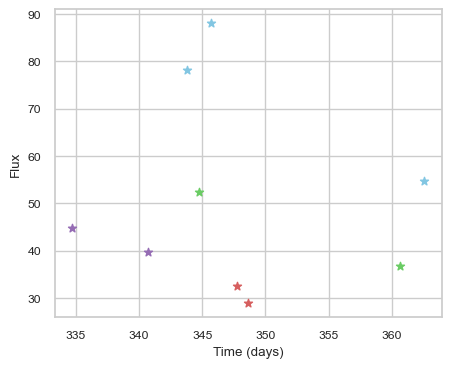

SNIax (3.9588032, False)
SNIax (3.5499775, False)
SNIax (3.4488492, False)
SNIax (3.3771188, False)
SNIax (3.8777328, False)
SNIax (3.6301582, False)
SNIax (3.6743026, False)
SNIax (2.6391485, False)
SNIax (2.9372578, False)
SNIax (3.0546243, False)
SNIax (3.9797819, False)
SNIax (3.5721254, False)
SNIax (3.672254, False)
SNIax (3.3736475, False)
SNIax (3.8403633, False)
SNIax (3.6193206, False)
SNIax (3.8607247, False)
SNIax (3.632597, False)


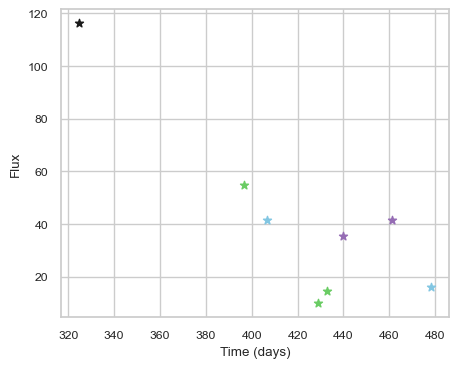

SNIax (3.700818, False)
SNIax (3.8618338, False)
SNIax (4.0515804, False)
SNIax (3.167099, False)
SNIax (3.1183765, False)
SNIax (2.6629817, False)
SNIax (4.713159, False)
SNIax (4.1748548, False)
SNIax (3.4265807, False)
SNIax (2.4205742, False)
SNIax (2.7301414, False)
SNIax (2.8017278, False)
SNIax (3.383813, False)
SNIax (3.908157, False)
SNIax (4.794095, False)
SNIax (4.2841167, False)


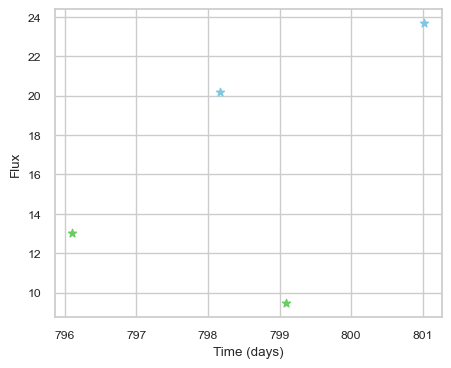

SNIax (4.012813, False)
SNIax (3.3822443, False)
SNIax (3.3128927, False)
SNIax (3.0462713, False)
SNIax (3.0841212, False)
SNIax (3.0830123, False)
SNIax (3.252403, False)
SNIax (3.1494198, False)


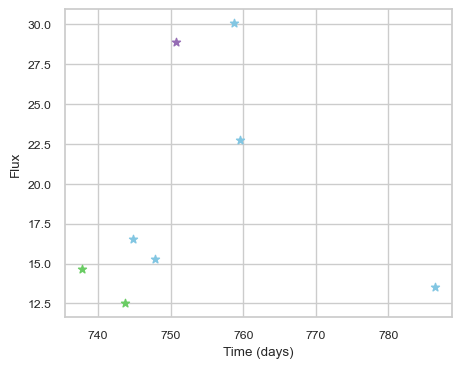

SNIax (4.1289716, False)
SNIax (3.1461806, False)
SNIax (3.0826747, False)
SNIax (3.2486482, False)
SNIax (3.1053917, False)
SNIax (3.0050185, False)
SNIax (2.972531, False)
SNIax (3.1864345, False)
SNIax (3.3391063, False)
SNIax (3.2331903, False)
SNIax (2.6943448, False)
SNIax (3.2140577, False)
SNIax (3.1029444, False)
SNIax (3.2848232, False)
SNIax (3.1381903, False)
SNIax (3.3252919, False)


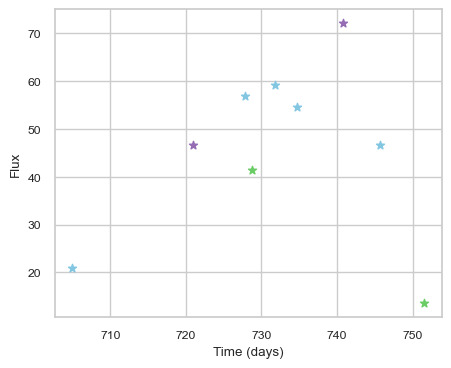

SNIax (4.0168247, False)
SNIax (3.5659306, False)
SNIax (3.2610378, False)
SNIax (3.0217037, False)
SNIax (3.185645, False)
SNIax (4.280208, False)
SNIax (4.631755, False)
SNIax (4.541082, False)
SNIax (4.1931324, False)
SNIax (4.155765, False)
SNIax (4.639769, False)
SNIax (4.1307964, False)
SNIax (4.3825154, False)
SNIax (4.117998, False)
SNIax (4.23158, False)
SNIax (3.793492, False)
SNIax (3.520702, False)
SNIax (3.7228398, False)


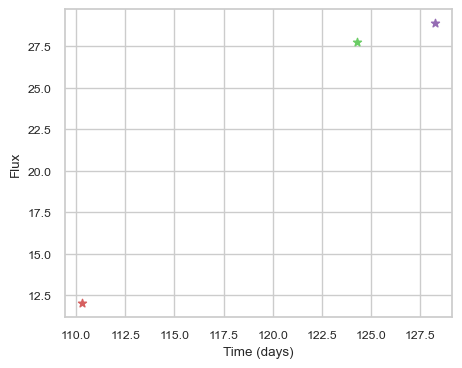

SNIax (4.7265077, False)
SNIax (4.1365085, False)
SNIax (4.141829, False)
SNIax (3.4949663, False)
SNIax (3.850229, False)
SNIax (3.6316204, False)


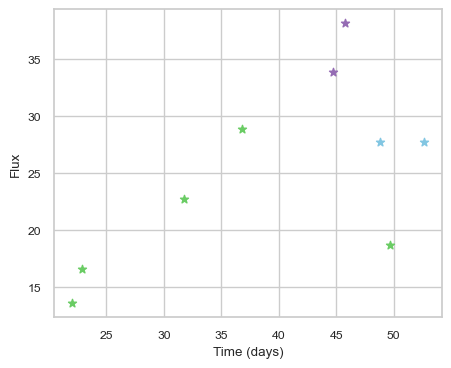

SNIax (4.5184145, False)
SNIax (3.8468738, False)
SNIax (3.2872207, False)
SNIax (2.5889416, False)
SNIax (2.8361301, False)
SNIax (2.4723654, False)
SNIax (2.6314313, False)
SNIax (3.027314, False)
SNIax (3.104126, False)
SNIax (2.852283, False)
SNIax (2.9185557, False)
SNIax (2.7747846, False)
SNIax (2.9723783, False)
SNIax (3.2276738, False)
SNIax (3.3357873, False)
SNIax (2.9071195, False)
SNIax (3.4585042, False)
SNIax (2.7920485, False)


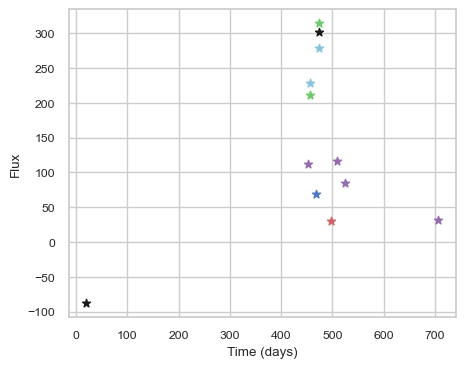

SNIax (3.7687957, False)
SNIax (3.8761597, False)
SNIax (3.6149287, False)
SNIax (3.498872, False)
SNIax (3.487178, False)
SNIax (3.3178394, False)
SNIax (3.3854141, False)
SNIax (3.1618798, False)
SNIax (3.2647328, False)
SNIax (3.7233508, False)
SNIax (3.288162, False)
SNIax (3.3586564, False)
SNIax (3.4689915, False)
SNIax (3.6122708, False)
SNIax (3.8336773, False)
SNIax (3.078412, False)
SNIax (3.147058, False)
SNIax (2.9055603, False)
SNIax (2.9693265, False)
SNIax (2.6741865, False)
SNIax (2.5575526, False)
SNIax (2.7258444, False)
SNIax (2.8947096, False)
SNIax (2.677315, False)


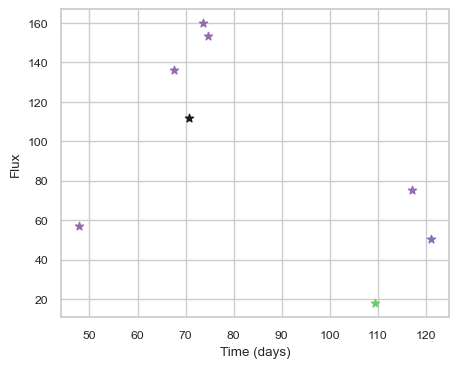

SNIax (4.1263957, False)
SNIax (4.282346, False)
SNIax (4.2622805, False)
SNIax (4.9354362, False)
SNIax (5.8013244, False)
SNIax (6.0707026, False)
SNIax (6.7111335, False)
SNIax (6.1966386, False)
SNIax (6.2125278, False)
SNIax (5.7165537, False)
SNIax (5.688307, False)
SNIax (5.7175784, False)
SNIax (5.751317, False)
SNIax (5.7646914, False)
SNIax (6.0998273, False)
SNIax (5.643217, False)


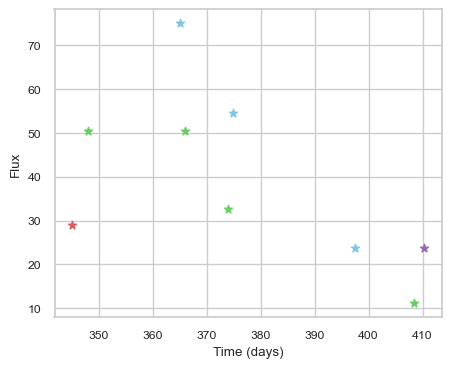

SNIax (3.963472, False)
SNIax (4.210336, False)
SNIax (4.4517026, False)
SNIax (3.2258546, False)
SNIax (3.112347, False)
SNIax (3.6148684, False)
SNIax (3.94837, False)
SNIax (3.6491163, False)
SNIax (3.931519, False)
SNIax (3.728411, False)
SNIax (4.232939, False)
SNIax (3.7592967, False)
SNIax (4.0425153, False)
SNIax (3.50174, False)
SNIax (3.6007853, False)
SNIax (3.668095, False)
SNIax (3.8285427, False)
SNIax (3.8081675, False)


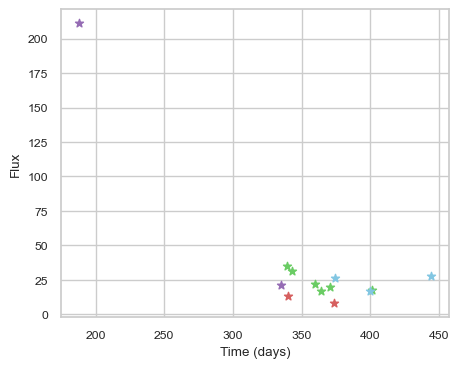

SNIax (3.5364425, False)
SNIax (3.4332457, False)
SNIax (4.1014056, False)
SNIax (4.346438, False)
SNIax (4.0930696, False)
SNIax (4.241114, False)
SNIax (4.0885515, False)
SNIax (4.378028, False)
SNIax (3.71565, False)
SNIax (4.083636, False)
SNIax (4.1671395, False)
SNIax (4.027967, False)
SNIax (4.197108, False)
SNIax (3.7086654, False)
SNIax (3.3974557, False)
SNIax (3.8075957, False)
SNIax (3.5000677, False)
SNIax (3.6905196, False)
SNIax (3.4254336, False)
SNIax (3.1228182, False)
SNIax (3.4176953, False)
SNIax (3.546231, False)
SNIax (3.2966716, False)
SNIax (3.4678023, False)
SNIax (4.070118, False)
SNIax (4.0328565, False)


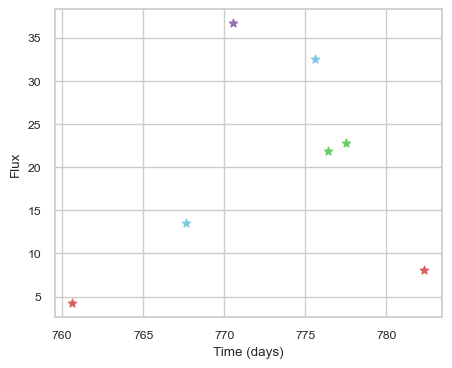

SNIax (3.951809, False)
SNIax (3.6340716, False)
SNIax (3.470012, False)
SNIax (3.0856717, False)
SNIax (3.9798856, False)
SNIax (3.2728548, False)
SNIax (3.1437006, False)
SNIax (3.4891982, False)
SNIax (3.2943318, False)
SNIax (3.1759605, False)
SNIax (3.2296026, False)
SNIax (3.2806141, False)
SNIax (3.3956487, False)
SNIax (3.2567594, False)


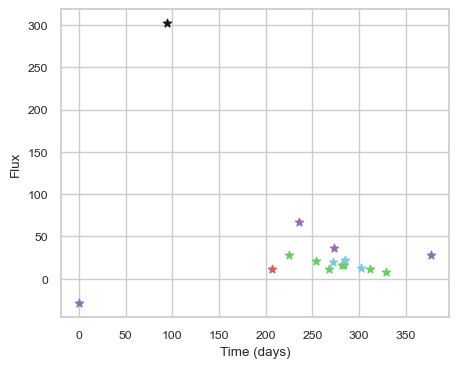

SNIax (4.427545, False)
SNIax (3.8431447, False)
SNIax (3.752241, False)
SNIax (3.7168107, False)
SNIax (3.895707, False)
SNIax (3.6703515, False)
SNIax (3.4715257, False)
SNIax (4.161873, False)
SNIax (4.260418, False)
SNIax (4.2163405, False)
SNIax (3.9194431, False)
SNIax (3.9164531, False)
SNIax (4.047503, False)
SNIax (3.6619797, False)
SNIax (3.7710853, False)
SNIax (3.6580784, False)
SNIax (3.980973, False)
SNIax (3.6686993, False)
SNIax (4.0053234, False)
SNIax (4.0364165, False)
SNIax (4.0154023, False)
SNIax (3.569849, False)
SNIax (3.9677963, False)
SNIax (4.1458945, False)
SNIax (4.2185946, False)
SNIax (4.028002, False)
SNIax (4.1810513, False)
SNIax (4.664668, False)
SNIax (4.346033, False)
SNIax (4.7995477, False)
SNIax (4.576941, False)


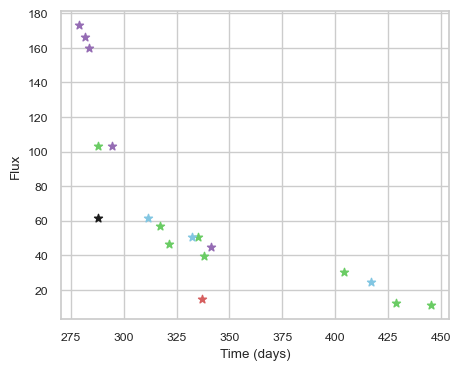

SNIax (3.8800151, False)
SNIax (4.0743413, False)
SNIax (3.447545, False)
SNIax (3.5002964, False)
SNIax (3.647054, False)
SNIax (3.9845226, False)
SNIax (3.6388154, False)
SNIax (4.0197186, False)
SNIax (4.2967863, False)
SNIax (3.7004762, False)
SNIax (4.24035, False)
SNIax (3.585416, False)
SNIax (4.1871486, False)
SNIax (3.160333, False)
SNIax (4.2430983, False)
SNIax (3.2748494, False)
SNIax (4.4427357, False)
SNIax (3.7413478, False)
SNIax (4.162727, False)
SNIax (3.385163, False)
SNIax (3.9042478, False)
SNIax (3.6184027, False)
SNIax (3.8926888, False)
SNIax (3.7145748, False)
SNIax (4.044734, False)
SNIax (3.6393633, False)
SNIax (4.2021575, False)
SNIax (3.8857937, False)
SNIax (4.0895042, False)
SNIax (3.8215816, False)
SNIax (3.9996507, False)
SNIax (3.1151052, False)
SNIax (4.041465, False)
SNIax (3.7247353, False)
SNIax (3.5867987, False)


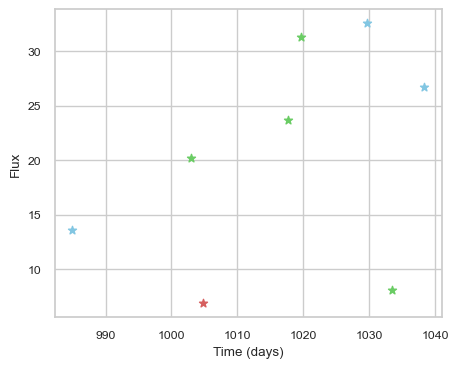

SNIax (4.8200574, False)
SNIax (4.6191993, False)
SNIax (4.5040183, False)
SNIax (4.1509895, False)
SNIax (4.3938527, False)
SNIax (4.2878385, False)
SNIax (4.7052665, False)
SNIax (4.374819, False)
SNIax (4.6468587, False)
SNIax (4.1860166, False)
SNIax (5.076458, False)
SNIax (4.447873, False)
SNIax (4.2072344, False)
SNIax (3.997976, False)
SNIax (4.1629267, False)
SNIax (4.0703435, False)


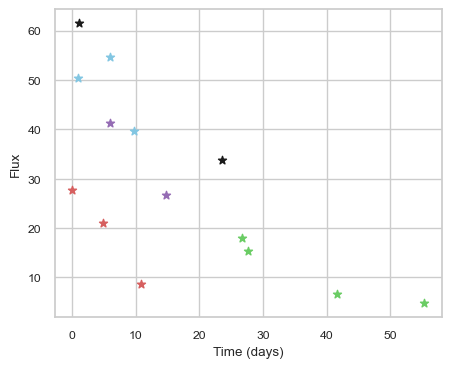

SNIax (4.3921576, False)
SNIax (4.217095, False)
SNIax (3.7572377, False)
SNIax (3.4984958, False)
SNIax (3.6987853, False)
SNIax (3.296357, False)
SNIax (3.9513552, False)
SNIax (3.9426117, False)
SNIax (3.3442395, False)
SNIax (3.5819738, False)
SNIax (3.9139931, False)
SNIax (4.160413, False)
SNIax (3.3939457, False)
SNIax (4.3728437, False)
SNIax (3.6686246, False)
SNIax (4.022803, False)
SNIax (3.5665946, False)
SNIax (4.0222583, False)
SNIax (3.4964504, False)
SNIax (3.8866084, False)
SNIax (3.4258206, False)
SNIax (3.6715224, False)
SNIax (3.4139228, False)
SNIax (3.765731, False)
SNIax (3.7521102, False)
SNIax (3.7586153, False)


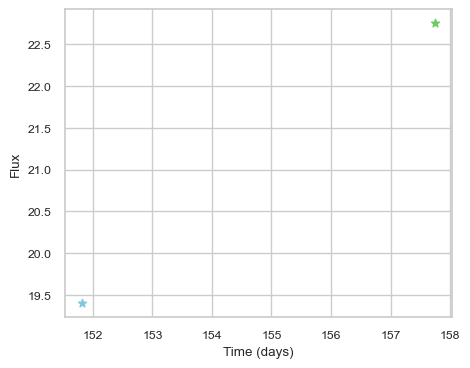

SNIax (5.2229996, False)
SNIax (4.5486593, False)
SNIax (4.4016614, False)
SNIax (5.0508237, False)


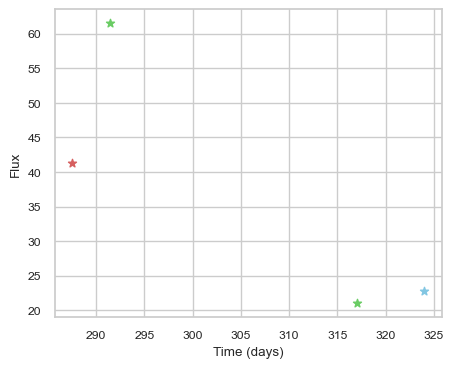

SNIax (4.1490865, False)
SNIax (4.9719343, False)
SNIax (5.45408, False)
SNIax (4.2187123, False)
SNIax (4.1531115, False)
SNIax (3.6532948, False)
SNIax (3.5908203, False)
SNIax (3.284854, False)


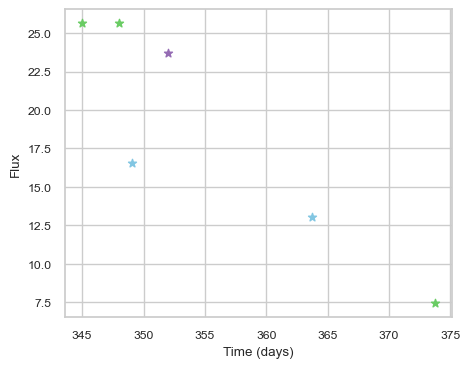

SNIax (3.8584976, False)
SNIax (3.7670732, False)
SNIax (3.5613725, False)
SNIax (3.831861, False)
SNIax (3.4665759, False)
SNIax (4.1111293, False)
SNIax (4.805141, False)
SNIax (4.63557, False)
SNIax (4.8166566, False)
SNIax (4.914459, False)
SNIax (4.407216, False)
SNIax (4.609461, False)


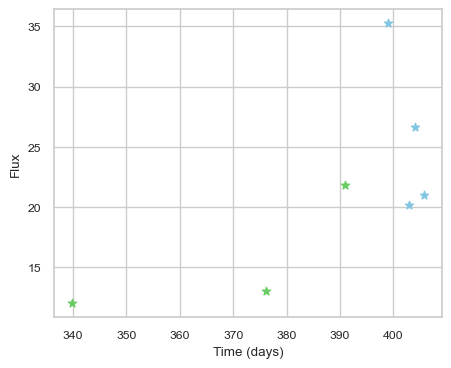

SNIax (3.8199832, False)
SNIax (3.6784208, False)
SNIax (3.5679588, False)
SNIax (3.5083246, False)
SNIax (3.1703494, False)
SNIax (3.0800536, False)
SNIax (3.5877151, False)
SNIax (3.5016823, False)
SNIax (3.744874, False)
SNIax (3.4041572, False)
SNIax (2.8585696, False)
SNIax (3.0832486, False)
SNIax (3.5196488, False)
SNIax (3.0323262, False)


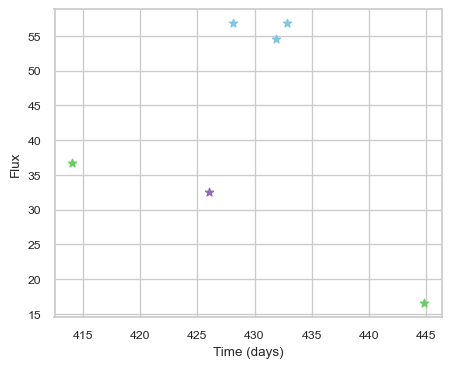

SNIax (3.9271686, False)
SNIax (3.3511858, False)
SNIax (3.4019456, False)
SNIax (3.7493107, False)
SNIax (4.51756, False)
SNIax (3.1182451, False)
SNIax (4.1994305, False)
SNIax (3.5577, False)
SNIax (3.8343441, False)
SNIax (3.4715922, False)
SNIax (4.1245184, False)
SNIax (3.184279, False)


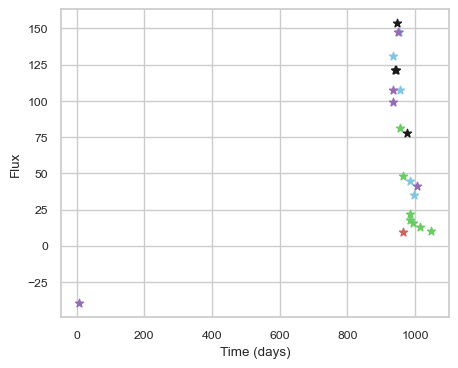

SNIax (4.643013, False)
SNIax (3.671947, False)
SNIax (4.5082197, False)
SNIax (4.2642183, False)
SNIax (4.8996277, False)
SNIax (4.3750224, False)
SNIax (4.4543867, False)
SNIax (3.9420257, False)
SNIax (4.2792373, False)
SNIax (4.2519927, False)
SNIax (3.890991, False)
SNIax (4.168603, False)
SNIax (4.0505967, False)
SNIax (4.300472, False)
SNIax (4.34752, False)
SNIax (3.7156236, False)
SNIax (4.3425393, False)
SNIax (4.4679365, False)
SNIax (3.3322484, False)
SNIax (3.9501395, False)
SNIax (2.83997, False)
SNIax (3.3637664, False)
SNIax (3.1237657, False)
SNIax (3.575383, False)
SNIax (3.174477, False)
SNIax (3.581964, False)
SNIax (3.8231018, False)
SNIax (3.3803458, False)
SNIax (3.5198321, False)
SNIax (3.3716059, False)
SNIax (3.3424447, False)
SNIax (2.8904088, False)
SNIax (3.6099865, False)
SNIax (3.2332506, False)
SNIax (3.350625, False)
SNIax (3.4900997, False)
SNIax (3.4028087, False)
SNIax (3.482239, False)
SNIax (2.7142193, False)
SNIax (3.222225, False)
SNIax (3.095901

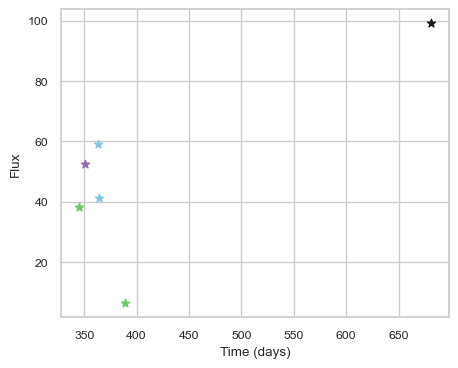

SNIax (4.262351, False)
SNIax (4.333749, False)
SNIax (4.781486, False)
SNIax (4.5510373, False)
SNIax (4.904337, False)
SNIax (5.675354, False)
SNIax (5.8129225, False)
SNIax (5.748042, False)
SNIax (5.9521275, False)
SNIax (5.505438, False)
SNIax (5.4514117, False)
SNIax (5.43695, False)


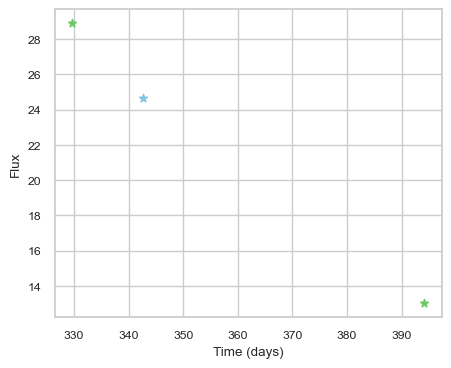

SNIax (3.7257526, False)
SNIax (4.2260795, False)
SNIax (3.1791298, False)
SNIax (4.209654, False)
SNIax (5.4910693, False)
SNIax (5.66568, False)


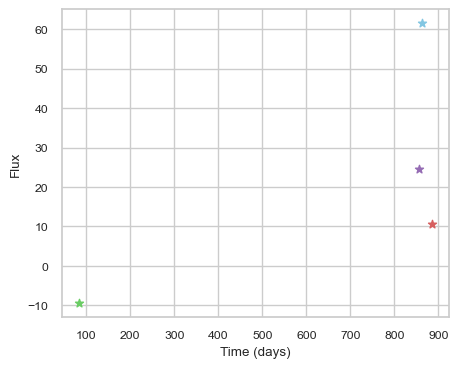

SNIax (4.0854163, False)
SNIax (4.1830564, False)
SNIax (3.8736982, False)
SNIax (3.7621295, False)
SNIax (2.9440026, False)
SNIax (3.9812706, False)
SNIax (3.9973855, False)
SNIax (3.517589, False)


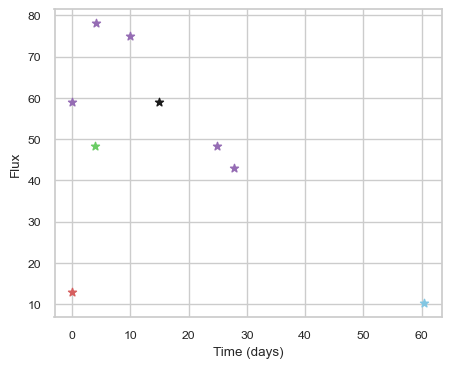

SNIax (4.415591, False)
SNIax (4.341848, False)
SNIax (4.575637, False)
SNIax (5.6435046, False)
SNIax (5.6865473, False)
SNIax (5.9808292, False)
SNIax (6.0826564, False)
SNIax (5.9989214, False)
SNIax (6.086118, False)
SNIax (5.358232, False)
SNIax (5.544187, False)
SNIax (4.6689663, False)
SNIax (5.3437185, False)
SNIax (5.2087164, False)
SNIax (5.135977, False)
SNIax (5.057173, False)
SNIax (4.746641, False)


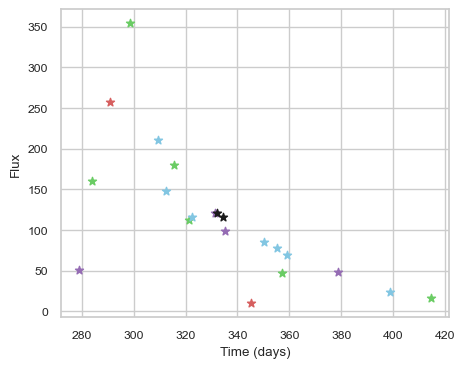

SNIax (3.969044, False)
SNIax (3.7584534, False)
SNIax (3.5625496, False)
SNIax (5.226255, False)
SNIax (5.2401514, False)
SNIax (4.3366966, False)
SNIax (5.424944, False)
SNIax (5.6989784, False)
SNIax (6.0623856, False)
SNIax (5.704576, False)
SNIax (5.4878383, False)
SNIax (5.525539, False)
SNIax (5.1562505, False)
SNIax (5.5416903, False)
SNIax (5.2097244, False)
SNIax (5.644655, False)
SNIax (4.9153824, False)
SNIax (5.7546735, False)
SNIax (5.7032948, False)
SNIax (5.6207213, False)
SNIax (6.0614285, False)
SNIax (6.1151266, False)
SNIax (5.9659243, False)
SNIax (6.2090282, False)
SNIax (6.1301355, False)
SNIax (5.8495216, False)
SNIax (5.85905, False)
SNIax (5.856438, False)
SNIax (6.172053, False)
SNIax (5.909718, False)
SNIax (5.9459963, False)
SNIax (5.9155545, False)
SNIax (5.6951776, False)
SNIax (5.8299513, False)
SNIax (5.5295706, False)
SNIax (5.917624, False)
SNIax (5.8169475, False)
SNIax (5.9812155, False)
SNIax (6.1645365, False)
SNIax (5.93779, False)
SNIax (5.94934

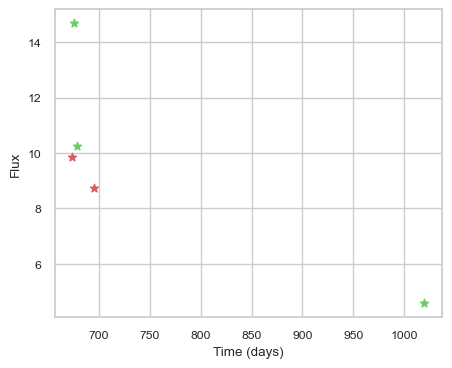

SNIax (3.819079, False)
SNIax (4.3649316, False)
SNIax (3.1695065, False)
SNIax (3.6516109, False)
SNIax (3.6204538, False)
SNIax (3.6961563, False)
SNIax (3.2872539, False)
SNIax (3.0395768, False)
SNIax (3.9095185, False)
SNIax (4.738857, False)


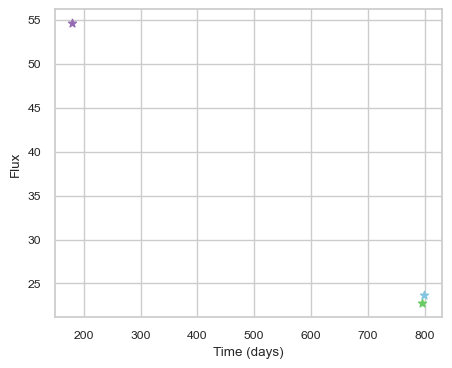

SNIax (5.1428146, False)
SNIax (4.462409, False)
SNIax (4.661087, False)
SNIax (4.0563254, False)
SNIax (3.94663, False)
SNIax (3.2948024, False)


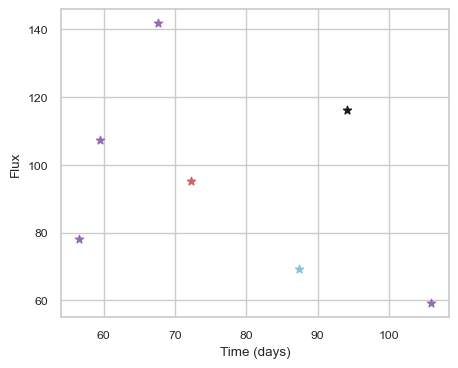

SNIax (3.9023323, False)
SNIax (4.093467, False)
SNIax (4.724189, False)
SNIax (4.7647266, False)
SNIax (4.670231, False)
SNIax (4.815679, False)
SNIax (6.0751257, False)
SNIax (6.1746855, False)
SNIax (6.481493, False)
SNIax (6.5229306, False)
SNIax (6.510384, False)
SNIax (6.8373528, False)
SNIax (5.5434747, False)
SNIax (5.590881, False)


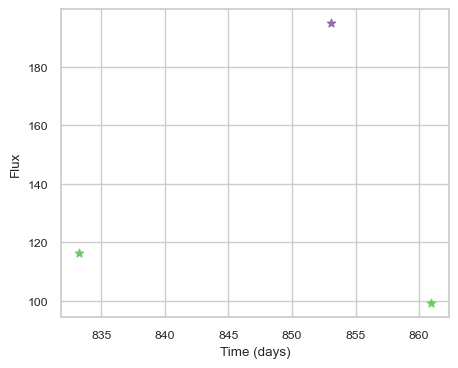

SNIax (3.7656765, False)
SNIax (3.8267624, False)
SNIax (3.473612, False)
SNIax (3.9195518, False)
SNIax (2.8157084, False)
SNIax (3.4371011, False)


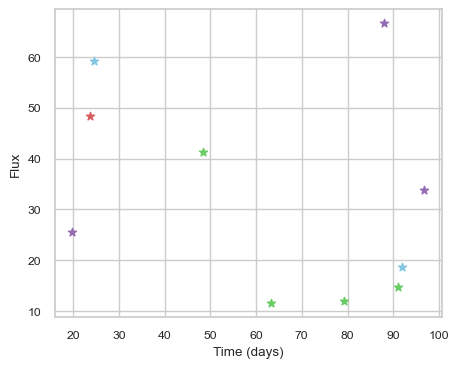

SNIax (3.9171455, False)
SNIax (3.8226647, False)
SNIax (3.4744086, False)
SNIax (3.4496896, False)
SNIax (4.0062895, False)
SNIax (3.5579085, False)
SNIax (3.8294055, False)
SNIax (4.662722, False)
SNIax (4.628104, False)
SNIax (5.0109377, False)
SNIax (3.638233, False)
SNIax (3.3145227, False)
SNIax (3.5972295, False)
SNIax (3.31191, False)
SNIax (4.611597, False)
SNIax (3.7292757, False)
SNIax (3.517824, False)
SNIax (3.014626, False)
SNIax (3.4360976, False)
SNIax (3.0464935, False)


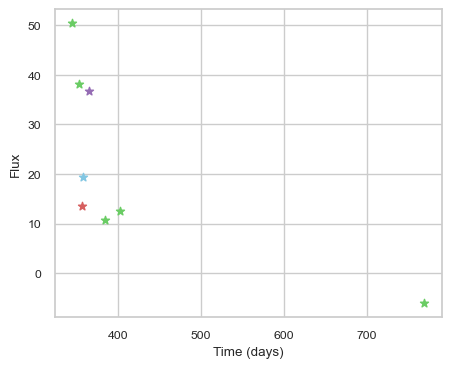

SNIax (3.6641505, False)
SNIax (3.774501, False)
SNIax (3.1909993, False)
SNIax (4.4217563, False)
SNIax (5.179799, False)
SNIax (5.08068, False)
SNIax (5.013251, False)
SNIax (4.5085454, False)
SNIax (3.6540265, False)
SNIax (4.6712513, False)
SNIax (4.236444, False)
SNIax (4.3719616, False)
SNIax (3.6871445, False)
SNIax (3.8525832, False)
SNIax (4.09407, False)
SNIax (3.8549678, False)


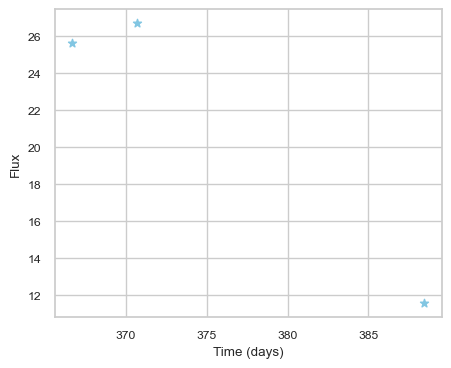

SNIax (4.2430205, False)
SNIax (3.7023754, False)
SNIax (3.4259632, False)
SNIax (2.9951982, False)
SNIax (2.9831846, False)
SNIax (2.671546, False)


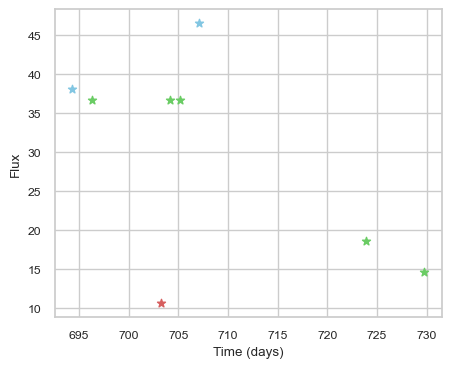

SNIax (4.15423, False)
SNIax (4.262024, False)
SNIax (4.0470324, False)
SNIax (4.2434545, False)
SNIax (4.604737, False)
SNIax (3.957635, False)
SNIax (4.8880377, False)
SNIax (4.4119587, False)
SNIax (4.3171315, False)
SNIax (4.6798353, False)
SNIax (4.6623063, False)
SNIax (4.82609, False)
SNIax (4.597691, False)
SNIax (4.702496, False)
SNIax (4.297422, False)
SNIax (4.2456155, False)


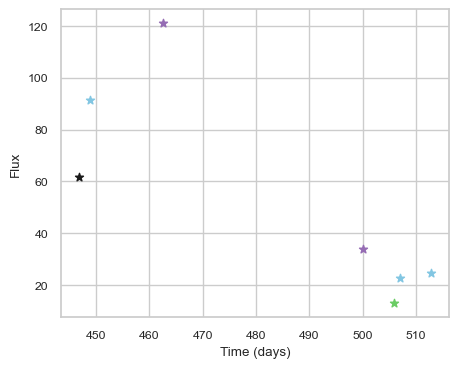

SNIax (3.8893154, False)
SNIax (3.5608118, False)
SNIax (3.823427, False)
SNIax (4.057093, False)
SNIax (3.4242885, False)
SNIax (3.9403508, False)
SNIax (3.8698134, False)
SNIax (3.7300582, False)
SNIax (3.2477427, False)
SNIax (3.275356, False)
SNIax (3.091437, False)
SNIax (3.2641623, False)
SNIax (2.8687513, False)
SNIax (3.0347083, False)


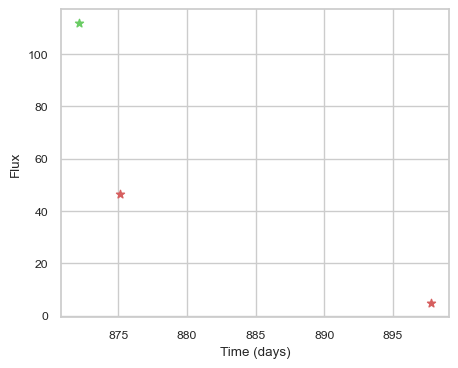

SNIax (3.6649036, False)
SNIax (4.1033206, False)
SNIax (4.6243453, False)
SNIax (4.589584, False)
SNIax (4.29632, False)
SNIax (5.145911, False)


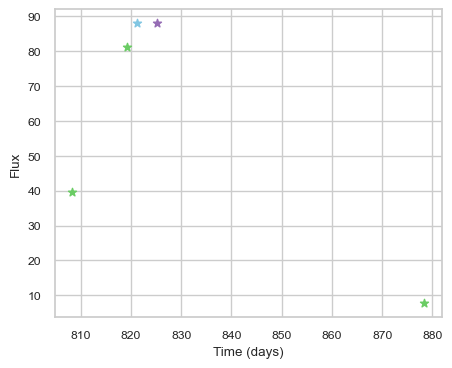

SNIax (3.8148441, False)
SNIax (3.369912, False)
SNIax (3.3565385, False)
SNIax (4.3816304, False)
SNIax (4.4657874, False)
SNIax (3.9289079, False)
SNIax (4.2325015, False)
SNIax (3.8823366, False)
SNIax (3.885837, False)
SNIax (3.8473651, False)


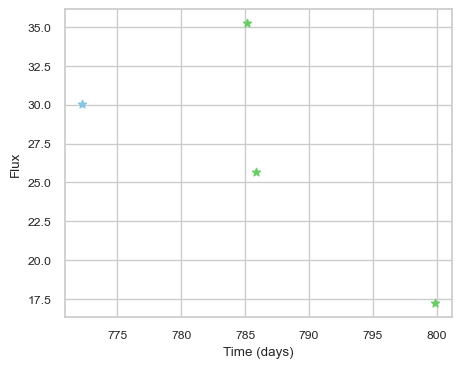

SNIax (4.0496635, False)
SNIax (3.3879452, False)
SNIax (3.8002691, False)
SNIax (3.2015574, False)
SNIax (3.3766165, False)
SNIax (2.881994, False)
SNIax (3.201058, False)
SNIax (2.6956227, False)


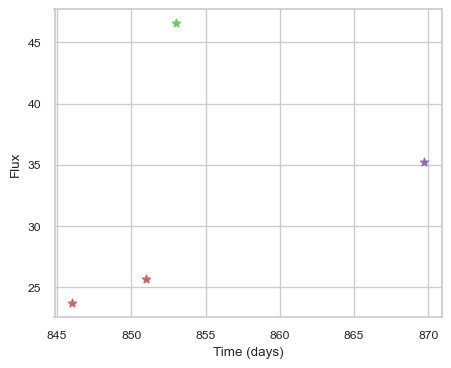

SNIax (3.924941, False)
SNIax (4.5235825, False)
SNIax (4.1588354, False)
SNIax (3.721271, False)
SNIax (3.5753105, False)
SNIax (2.5912385, False)
SNIax (3.281165, False)
SNIax (2.664594, False)


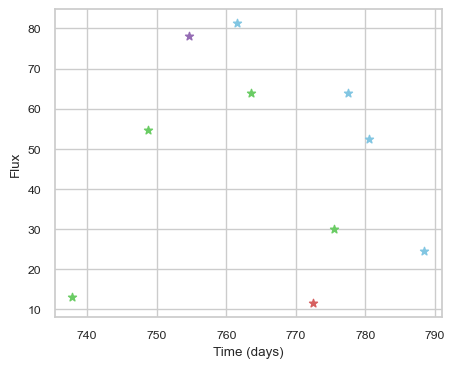

SNIax (3.8916745, False)
SNIax (3.229353, False)
SNIax (3.2915401, False)
SNIax (2.9952347, False)
SNIax (3.6427462, False)
SNIax (3.7313268, False)
SNIax (3.58984, False)
SNIax (3.774075, False)
SNIax (4.204658, False)
SNIax (4.3750095, False)
SNIax (4.347379, False)
SNIax (4.4386663, False)
SNIax (5.625599, False)
SNIax (4.9066157, False)
SNIax (4.738487, False)
SNIax (4.6684732, False)
SNIax (4.456553, False)
SNIax (4.22273, False)
SNIax (4.367964, False)
SNIax (3.783432, False)


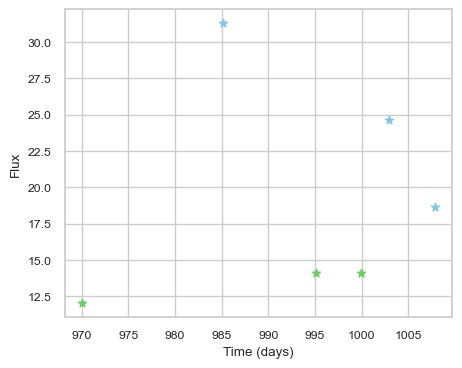

SNIax (4.7667155, False)
SNIax (4.4803414, False)
SNIax (3.9710536, False)
SNIax (4.5153365, False)
SNIax (4.0310025, False)
SNIax (4.033719, False)
SNIax (4.0588703, False)
SNIax (3.9842417, False)
SNIax (3.588378, False)
SNIax (3.844592, False)
SNIax (3.71838, False)
SNIax (3.6878247, False)


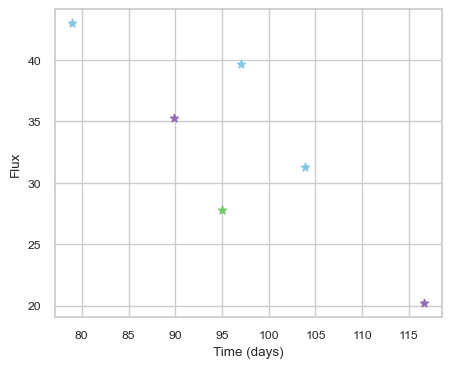

SNIax (3.7589314, False)
SNIax (4.168257, False)
SNIax (3.6274981, False)
SNIax (3.4492304, False)
SNIax (3.5544758, False)
SNIax (4.151035, False)
SNIax (4.2056894, False)
SNIax (4.516013, False)
SNIax (4.5506, False)
SNIax (4.6954765, False)
SNIax (4.877235, False)
SNIax (5.5323176, False)


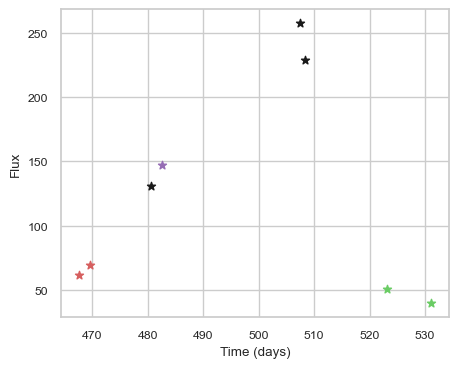

SNIax (3.8995106, False)
SNIax (4.8611593, False)
SNIax (4.574763, False)
SNIax (4.272467, False)
SNIax (3.8460355, False)
SNIax (3.312833, False)
SNIax (3.8104463, False)
SNIax (3.3333004, False)
SNIax (3.8467572, False)
SNIax (3.9115255, False)
SNIax (3.7810657, False)
SNIax (3.329404, False)
SNIax (3.8472927, False)
SNIax (3.47828, False)
SNIax (4.086948, False)
SNIax (3.8890986, False)


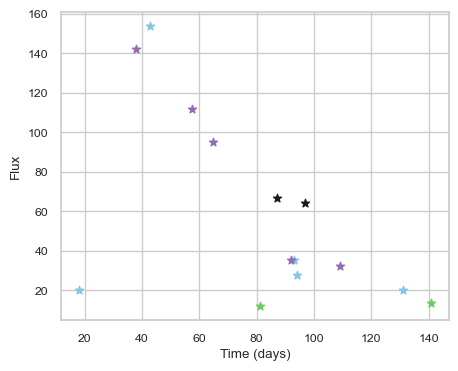

SNIax (3.9643197, False)
SNIax (3.5053892, False)
SNIax (3.469563, False)
SNIax (3.8634334, False)
SNIax (4.0475073, False)
SNIax (3.8966103, False)
SNIax (3.7534184, False)
SNIax (4.2295623, False)
SNIax (4.7204566, False)
SNIax (5.204562, False)
SNIax (5.646484, False)
SNIax (6.0195556, False)
SNIax (6.04411, False)
SNIax (6.2058663, False)
SNIax (5.9594855, False)
SNIax (5.6460495, False)
SNIax (5.706801, False)
SNIax (6.056368, False)
SNIax (5.615539, False)
SNIax (6.11592, False)
SNIax (5.7791243, False)
SNIax (6.180084, False)
SNIax (5.1852074, False)
SNIax (5.4841914, False)
SNIax (5.1470327, False)
SNIax (5.3411565, False)
SNIax (4.6134005, False)
SNIax (5.374043, False)


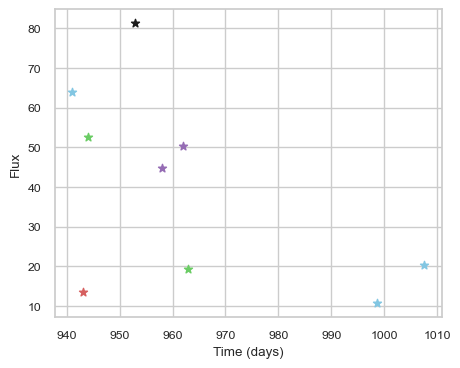

SNIax (3.9276721, False)
SNIax (4.1806087, False)
SNIax (4.656199, False)
SNIax (4.2455554, False)
SNIax (4.6452436, False)
SNIax (4.7496696, False)
SNIax (4.963216, False)
SNIax (4.2102513, False)
SNIax (4.7150373, False)
SNIax (3.9114678, False)
SNIax (4.356537, False)
SNIax (3.9404972, False)
SNIax (4.414884, False)
SNIax (3.9497714, False)
SNIax (4.338665, False)
SNIax (3.76537, False)
SNIax (4.006661, False)
SNIax (3.3597412, False)


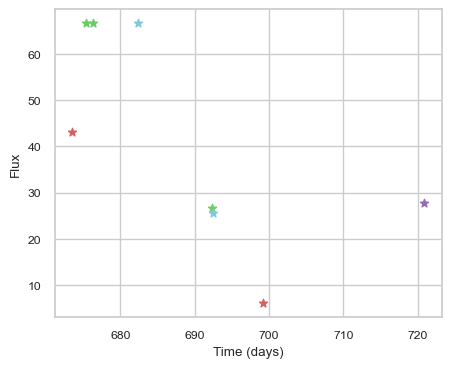

SNIax (3.845654, False)
SNIax (4.2787733, False)
SNIax (4.6973977, False)
SNIax (4.5063086, False)
SNIax (3.67718, False)
SNIax (3.7700717, False)
SNIax (3.8661528, False)
SNIax (2.6858444, False)
SNIax (2.5861456, False)
SNIax (2.410832, False)
SNIax (3.1184492, False)
SNIax (2.2903366, False)
SNIax (2.5104866, False)
SNIax (2.5611398, False)
SNIax (3.0630004, False)
SNIax (2.7121975, False)


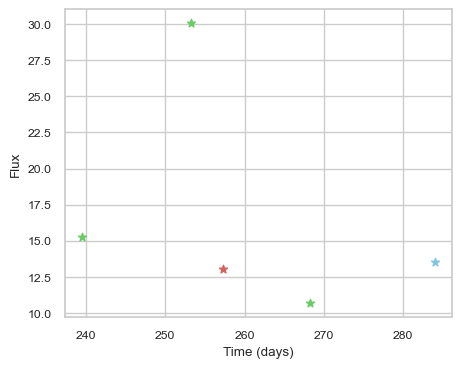

SNIax (3.6786335, False)
SNIax (3.454859, False)
SNIax (3.1049633, False)
SNIax (3.0556917, False)
SNIax (3.4729545, False)
SNIax (3.738666, False)
SNIax (3.2542055, False)
SNIax (3.7129002, False)
SNIax (3.8022466, False)
SNIax (3.884343, False)


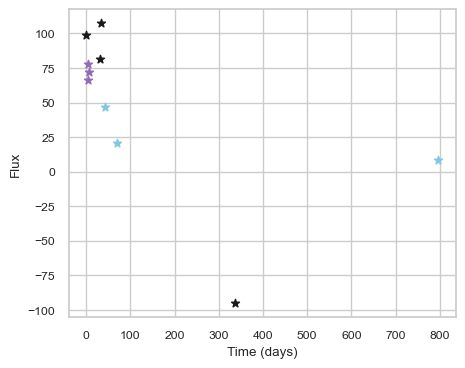

SNIax (4.2179036, False)
SNIax (4.8256054, False)
SNIax (5.0744724, False)
SNIax (4.528304, False)
SNIax (5.3384624, False)
SNIax (4.6366863, False)
SNIax (5.1010776, False)
SNIax (4.7641015, False)
SNIax (5.576268, False)
SNIax (5.2665653, False)
SNIax (5.9565306, False)
SNIax (4.9270797, False)
SNIax (5.995026, False)
SNIax (6.0312004, False)
SNIax (5.4302044, False)
SNIax (4.6821413, False)
SNIax (5.4572263, False)
SNIax (5.165451, False)
SNIax (4.870945, False)


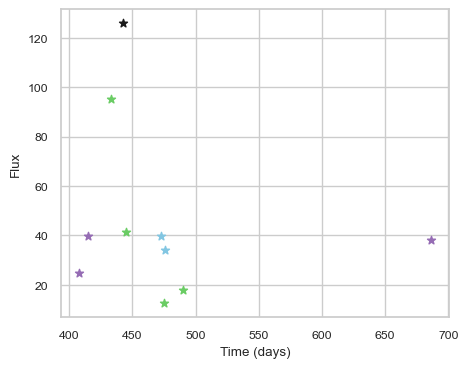

SNIax (3.839378, False)
SNIax (3.4987013, False)
SNIax (3.2291014, False)
SNIax (3.2809772, False)
SNIax (3.0359035, False)
SNIax (3.3821476, False)
SNIax (3.078552, False)
SNIax (3.3022532, False)
SNIax (3.2103467, False)
SNIax (2.7795243, False)
SNIax (2.9828439, False)
SNIax (2.6727972, False)
SNIax (2.7420442, False)
SNIax (2.741008, False)
SNIax (3.0716794, False)
SNIax (2.7254775, False)
SNIax (2.689149, False)
SNIax (2.8639555, False)
SNIax (3.3592563, False)
SNIax (2.9918292, False)


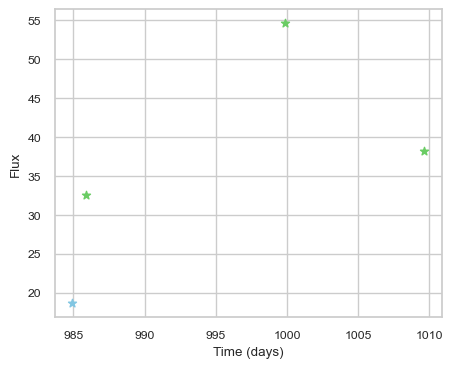

SNIax (3.96943, False)
SNIax (3.6967528, False)
SNIax (3.2789605, False)
SNIax (3.1757207, False)
SNIax (3.1461585, False)
SNIax (3.4843123, False)
SNIax (2.8974614, False)
SNIax (2.7351148, False)


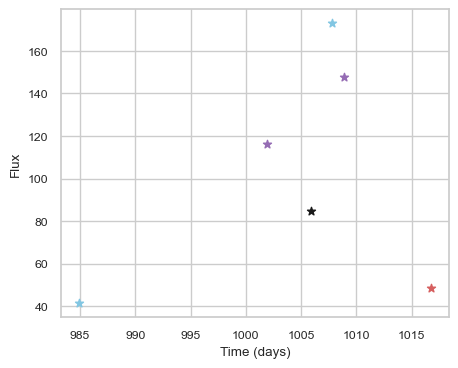

SNIax (3.8512955, False)
SNIax (3.7330742, False)
SNIax (3.7522514, False)
SNIax (4.197516, False)
SNIax (3.6544392, False)
SNIax (3.9831653, False)
SNIax (3.6837275, False)
SNIax (3.2728405, False)
SNIax (3.86401, False)
SNIax (3.0309844, False)
SNIax (3.4597914, False)
SNIax (4.0083075, False)


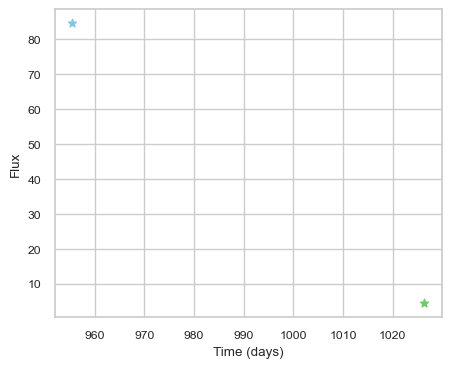

SNIax (3.6842973, False)
SNIax (3.5813684, False)
SNIax (3.6796155, False)
SNIax (2.98818, False)


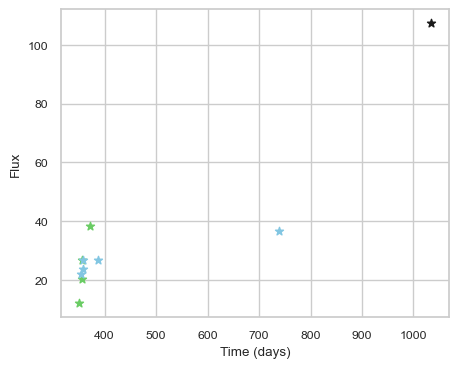

SNIax (4.0407124, False)
SNIax (3.4494166, False)
SNIax (3.5433292, False)
SNIax (2.8806431, False)
SNIax (2.9912288, False)
SNIax (2.6825094, False)
SNIax (3.011257, False)
SNIax (2.5849879, False)
SNIax (2.6856515, False)
SNIax (2.2520154, False)
SNIax (2.5701187, False)
SNIax (2.0583677, False)
SNIax (1.9357611, False)
SNIax (1.760195, False)
SNIax (2.931907, False)
SNIax (2.0334861, False)
SNIax (2.6378112, False)
SNIax (2.0989046, False)
SNIax (3.9847476, False)
SNIax (4.695661, False)


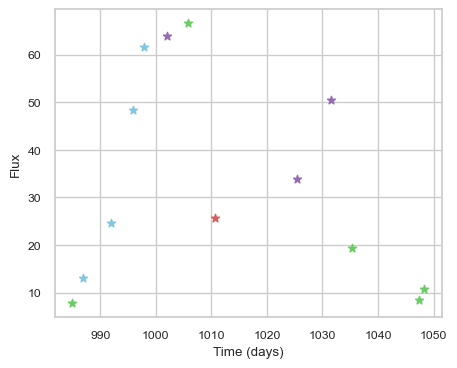

SNIax (3.7398412, False)
SNIax (3.782942, False)
SNIax (3.3579078, False)
SNIax (3.4139, False)
SNIax (2.9629428, False)
SNIax (3.448742, False)
SNIax (2.7747526, False)
SNIax (3.5654783, False)
SNIax (3.1300983, False)
SNIax (3.7311683, False)
SNIax (3.5920503, False)
SNIax (2.5679138, False)
SNIax (3.1171224, False)
SNIax (2.096321, False)
SNIax (2.6936443, False)
SNIax (2.2572112, False)
SNIax (2.6890678, False)
SNIax (1.8353397, False)
SNIax (2.2592392, False)
SNIax (1.7878163, False)
SNIax (2.008414, False)
SNIax (1.8953642, False)
SNIax (2.155495, False)
SNIax (2.1527505, False)
SNIax (1.9995888, False)
SNIax (2.3194625, False)


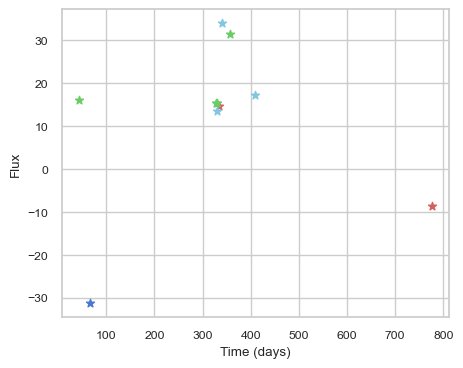

SNIax (4.289261, False)
SNIax (3.2758098, False)
SNIax (3.307446, False)
SNIax (4.204324, False)
SNIax (3.6579666, False)
SNIax (4.1482005, False)
SNIax (3.9747121, False)
SNIax (4.028354, False)
SNIax (3.8447292, False)
SNIax (3.8881657, False)
SNIax (4.118992, False)
SNIax (4.899903, False)
SNIax (3.9414892, False)
SNIax (4.09742, False)
SNIax (6.5560346, False)
SNIax (6.7221847, False)
SNIax (8.41959, False)
SNIax (8.439827, False)
SNIax (7.321442, False)
SNIax (9.802188, False)


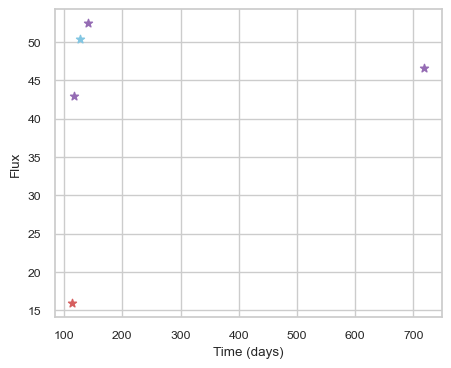

SNIax (4.2452216, False)
SNIax (4.084048, False)
SNIax (3.9687853, False)
SNIax (3.2940679, False)
SNIax (3.2821941, False)
SNIax (3.2756968, False)
SNIax (3.0955698, False)
SNIax (3.136849, False)
SNIax (3.5725422, False)
SNIax (3.4225051, False)


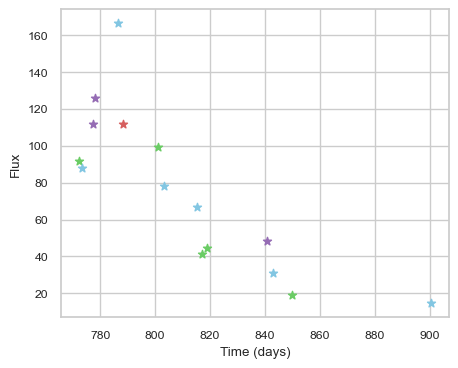

SNIax (3.7867115, False)
SNIax (3.2543194, False)
SNIax (3.302891, False)
SNIax (3.0595233, False)
SNIax (3.6950953, False)
SNIax (3.483453, False)
SNIax (4.5165663, False)
SNIax (4.1141505, False)
SNIax (4.1064577, False)
SNIax (4.695259, False)
SNIax (3.817902, False)
SNIax (4.086257, False)
SNIax (3.9055214, False)
SNIax (3.382017, False)
SNIax (3.689427, False)
SNIax (2.7024667, False)
SNIax (2.4831903, False)
SNIax (2.680648, False)
SNIax (2.7382147, False)
SNIax (3.8587348, False)
SNIax (2.7088401, False)
SNIax (3.39422, False)
SNIax (3.1881387, False)
SNIax (3.6218667, False)
SNIax (2.8525434, False)
SNIax (2.5418355, False)
SNIax (2.1384108, False)
SNIax (3.1307998, False)
SNIax (2.1058345, False)
SNIax (1.9452771, False)


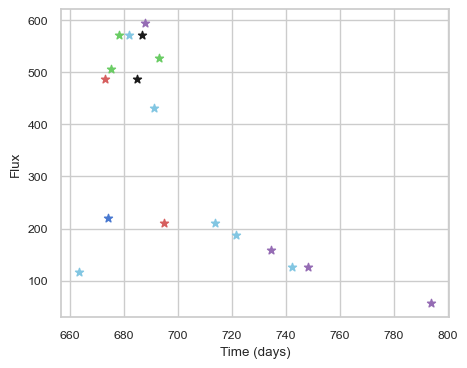

SNIax (3.7235315, False)
SNIax (4.4040656, False)
SNIax (3.439749, False)
SNIax (3.7672696, False)
SNIax (3.5429058, False)
SNIax (4.205506, False)
SNIax (3.2106593, False)
SNIax (3.1193748, False)
SNIax (3.5601432, False)
SNIax (3.6096869, False)
SNIax (4.48803, False)
SNIax (5.1680565, False)
SNIax (4.7561812, False)
SNIax (5.1775956, False)
SNIax (3.33376, False)
SNIax (3.9029193, False)
SNIax (3.6879094, False)
SNIax (3.0495722, False)
SNIax (2.858661, False)
SNIax (2.769369, False)
SNIax (2.954255, False)
SNIax (2.5942097, False)
SNIax (3.4200087, False)
SNIax (3.6727333, False)
SNIax (2.989728, False)
SNIax (2.966511, False)
SNIax (2.8262815, False)
SNIax (2.6342056, False)
SNIax (2.999448, False)
SNIax (2.9573774, False)
SNIax (2.6817708, False)
SNIax (2.7130606, False)
SNIax (3.1971223, False)
SNIax (2.5924587, False)
SNIax (3.1442034, False)
SNIax (2.5180736, False)


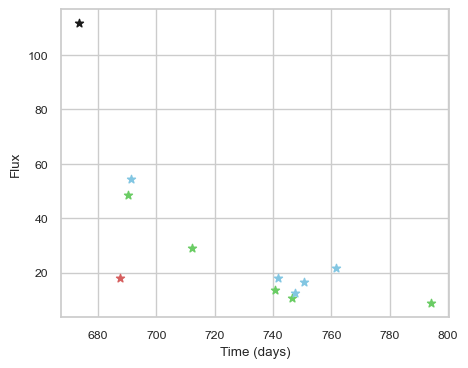

SNIax (3.686644, False)
SNIax (3.991831, False)
SNIax (3.4703324, False)
SNIax (3.9130356, False)
SNIax (3.2018003, False)
SNIax (3.434201, False)
SNIax (3.0784986, False)
SNIax (3.5493152, False)
SNIax (3.4352715, False)
SNIax (3.7137892, False)
SNIax (3.8802392, False)
SNIax (3.4557436, False)
SNIax (2.9755795, False)
SNIax (2.7729666, False)
SNIax (2.8834918, False)
SNIax (2.8828855, False)
SNIax (2.5842133, False)
SNIax (2.7662654, False)
SNIax (2.802153, False)
SNIax (2.5385873, False)
SNIax (2.868896, False)
SNIax (2.5582397, False)
SNIax (3.5598733, False)
SNIax (3.2140398, False)


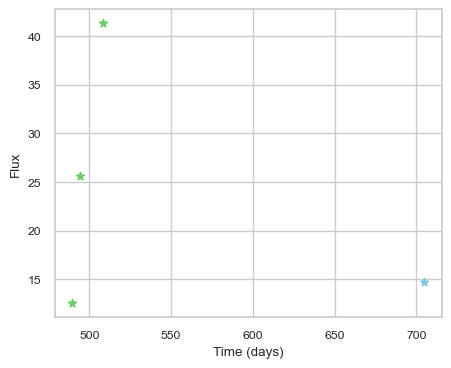

SNIax (4.3597097, False)
SNIax (3.6694582, False)
SNIax (3.590917, False)
SNIax (3.1790547, False)
SNIax (2.8500354, False)
SNIax (3.6936343, False)
SNIax (3.4425333, False)
SNIax (3.3360248, False)


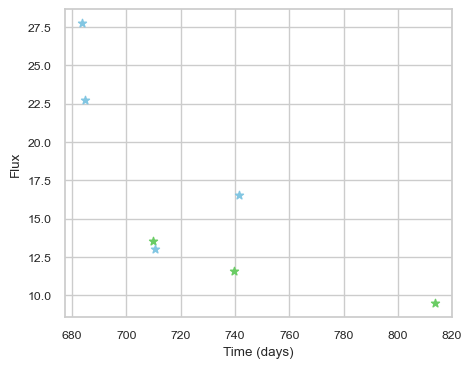

SNIax (3.7721698, False)
SNIax (3.6371734, False)
SNIax (3.1059887, False)
SNIax (3.7914495, False)
SNIax (3.2618194, False)
SNIax (3.7499547, False)
SNIax (3.5372722, False)
SNIax (3.4785511, False)
SNIax (3.8268828, False)
SNIax (3.3824267, False)
SNIax (3.5710752, False)
SNIax (3.0346289, False)
SNIax (3.767593, False)
SNIax (4.170015, False)


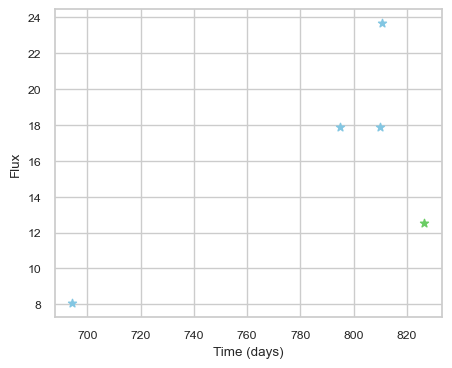

SNIax (4.4257054, False)
SNIax (4.2942553, False)
SNIax (4.383917, False)
SNIax (3.80159, False)
SNIax (4.176227, False)
SNIax (3.9818656, False)
SNIax (3.4225507, False)
SNIax (3.7087698, False)
SNIax (3.3301349, False)
SNIax (3.386559, False)


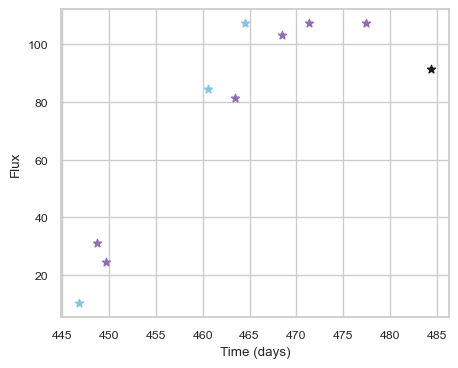

SNIax (4.1402864, False)
SNIax (3.7335863, False)
SNIax (3.263234, False)
SNIax (3.0766952, False)
SNIax (3.0867527, False)
SNIax (3.3346925, False)
SNIax (2.9729013, False)
SNIax (4.161153, False)
SNIax (4.8905067, False)
SNIax (4.8271112, False)
SNIax (5.0233793, False)
SNIax (5.3291855, False)
SNIax (5.304258, False)
SNIax (5.384797, False)
SNIax (5.4593883, False)
SNIax (5.398738, False)
SNIax (5.1996865, False)
SNIax (5.071965, False)
SNIax (5.289827, False)
SNIax (4.7678905, False)


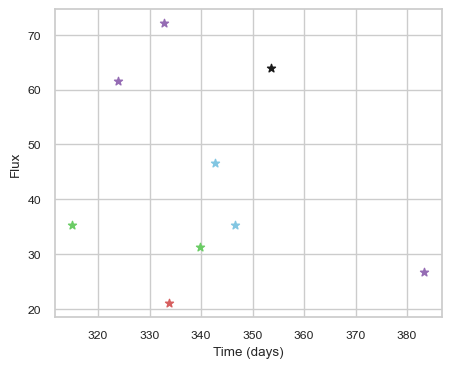

SNIax (3.7315161, False)
SNIax (4.1185164, False)
SNIax (3.6099603, False)
SNIax (3.2888522, False)
SNIax (3.763923, False)
SNIax (3.3091574, False)
SNIax (3.4334884, False)
SNIax (4.187582, False)
SNIax (4.173316, False)
SNIax (3.5684264, False)
SNIax (4.5138297, False)
SNIax (3.857814, False)
SNIax (4.2595124, False)
SNIax (3.4491966, False)
SNIax (4.199468, False)
SNIax (4.715022, False)
SNIax (6.1442957, False)
SNIax (5.411741, False)


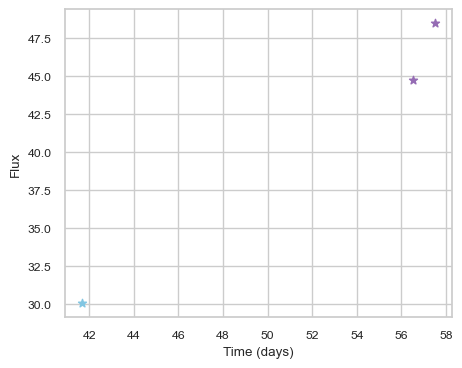

SNIax (4.1468444, False)
SNIax (3.9451082, False)
SNIax (3.595738, False)
SNIax (3.127545, False)
SNIax (3.6767418, False)
SNIax (3.2119584, False)


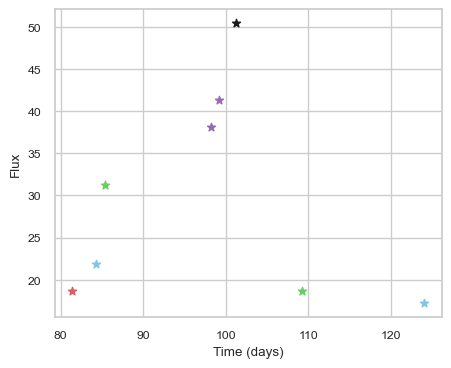

SNIax (4.0775037, False)
SNIax (4.018389, False)
SNIax (3.7807822, False)
SNIax (4.712593, False)
SNIax (4.4891143, False)
SNIax (4.76349, False)
SNIax (4.049107, False)
SNIax (5.399005, False)
SNIax (5.058784, False)
SNIax (5.394474, False)
SNIax (5.1346006, False)
SNIax (5.3259315, False)
SNIax (4.3440213, False)
SNIax (5.200942, False)
SNIax (4.7479987, False)
SNIax (5.071064, False)


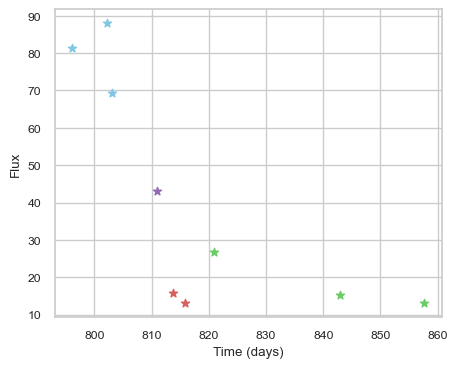

SNIax (3.80533, False)
SNIax (3.7390366, False)
SNIax (3.496445, False)
SNIax (3.8291988, False)
SNIax (4.281963, False)
SNIax (4.2868547, False)
SNIax (4.725263, False)
SNIax (5.022012, False)
SNIax (4.0282907, False)
SNIax (4.02324, False)
SNIax (4.0021453, False)
SNIax (3.888222, False)
SNIax (4.323609, False)
SNIax (3.1896813, False)
SNIax (3.7310505, False)
SNIax (3.1147966, False)
SNIax (2.6598337, False)
SNIax (2.738991, False)


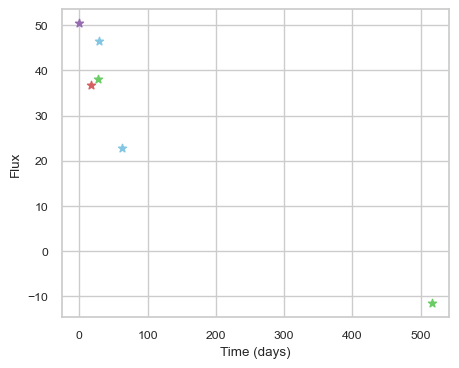

SNIax (4.316196, False)
SNIax (3.8681672, False)
SNIax (4.319634, False)
SNIax (4.314133, False)
SNIax (5.269725, False)
SNIax (4.9164867, False)
SNIax (4.820499, False)
SNIax (5.338858, False)
SNIax (5.4775777, False)
SNIax (4.6364603, False)
SNIax (6.320845, False)


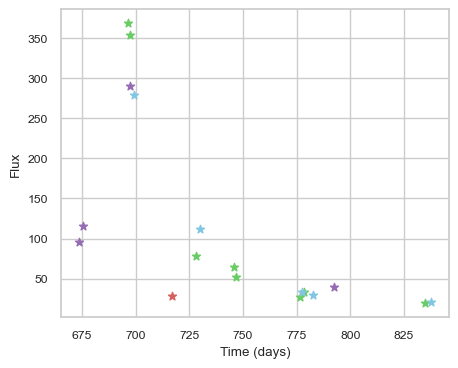

SNIax (3.8006077, False)
SNIax (3.8894632, False)
SNIax (4.1902704, False)
SNIax (4.063024, False)
SNIax (3.9165106, False)
SNIax (3.7005458, False)
SNIax (3.4920948, False)
SNIax (3.4648726, False)
SNIax (4.2615414, False)
SNIax (3.7355466, False)
SNIax (3.9685154, False)
SNIax (3.0182164, False)
SNIax (2.7498245, False)
SNIax (3.2465813, False)
SNIax (3.0752954, False)
SNIax (2.8448088, False)
SNIax (2.6929283, False)
SNIax (2.5980806, False)
SNIax (3.135347, False)
SNIax (2.707485, False)
SNIax (2.3771365, False)
SNIax (2.8251417, False)
SNIax (3.0035508, False)
SNIax (3.106285, False)
SNIax (2.7472138, False)
SNIax (2.8187926, False)
SNIax (2.6832156, False)
SNIax (3.014298, False)
SNIax (2.902037, False)
SNIax (2.7235746, False)
SNIax (2.6842387, False)
SNIax (2.7656608, False)
SNIax (3.1748862, False)
SNIax (2.8945436, False)
SNIax (2.9700208, False)
SNIax (2.6334805, False)


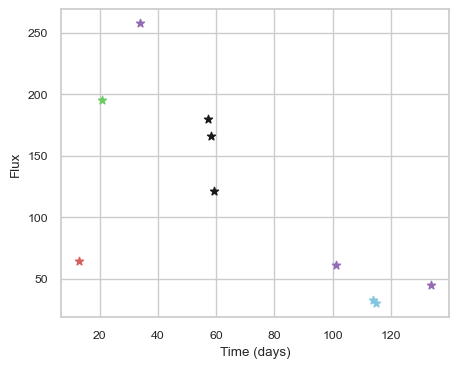

SNIax (3.8599124, False)
SNIax (4.024164, False)
SNIax (3.3158596, False)
SNIax (4.0356264, False)
SNIax (3.2808769, False)
SNIax (2.63496, False)
SNIax (3.3951159, False)
SNIax (3.1366823, False)
SNIax (3.6929793, False)
SNIax (3.6973915, False)
SNIax (4.006084, False)
SNIax (3.7993455, False)
SNIax (3.4414294, False)
SNIax (3.2114148, False)
SNIax (3.0417874, False)
SNIax (3.2223463, False)
SNIax (2.7740917, False)
SNIax (2.9862204, False)
SNIax (2.9418118, False)
SNIax (3.0482967, False)


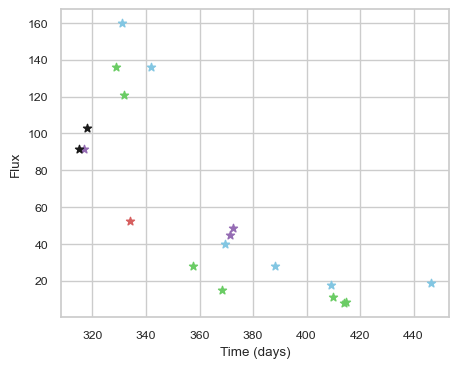

SNIax (3.8540304, False)
SNIax (4.074703, False)
SNIax (4.6301446, False)
SNIax (4.0604577, False)
SNIax (4.4258976, False)
SNIax (4.802905, False)
SNIax (3.6838667, False)
SNIax (4.52759, False)
SNIax (5.2211537, False)
SNIax (5.9252076, False)
SNIax (4.9463797, False)
SNIax (4.9226723, False)
SNIax (3.8439577, False)
SNIax (4.577344, False)
SNIax (4.9325585, False)
SNIax (5.644312, False)
SNIax (5.3571105, False)
SNIax (5.015986, False)
SNIax (5.409267, False)
SNIax (5.3706703, False)
SNIax (5.256428, False)
SNIax (5.4693403, False)
SNIax (5.388133, False)
SNIax (5.2526746, False)
SNIax (5.6120124, False)
SNIax (5.236459, False)
SNIax (5.523057, False)
SNIax (5.1603923, False)
SNIax (4.611099, False)
SNIax (4.75122, False)
SNIax (4.9941473, False)
SNIax (4.642716, False)
SNIax (5.2477956, False)
SNIax (4.248513, False)
SNIax (5.309247, False)
SNIax (4.3476105, False)
SNIax (4.9749494, False)
SNIax (4.3361125, False)


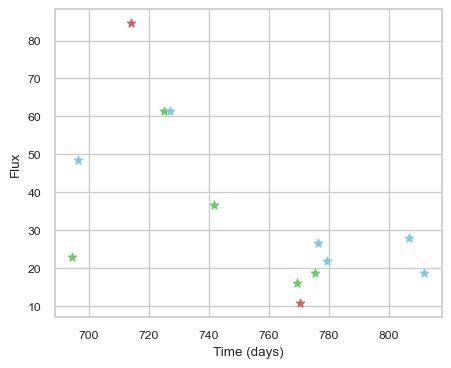

SNIax (3.5470662, False)
SNIax (3.8334816, False)
SNIax (3.2539783, False)
SNIax (3.4363132, False)
SNIax (3.388922, False)
SNIax (3.317377, False)
SNIax (3.2987785, False)
SNIax (3.8405113, False)
SNIax (4.338253, False)
SNIax (3.9844801, False)
SNIax (4.6778564, False)
SNIax (5.035491, False)
SNIax (5.0115976, False)
SNIax (4.039694, False)
SNIax (2.8886957, False)
SNIax (3.057446, False)
SNIax (3.5319777, False)
SNIax (2.540759, False)
SNIax (2.5145288, False)
SNIax (2.5785375, False)
SNIax (3.2337716, False)
SNIax (2.5774064, False)
SNIax (3.5781643, False)
SNIax (3.626721, False)
SNIax (3.3081603, False)
SNIax (3.083569, False)


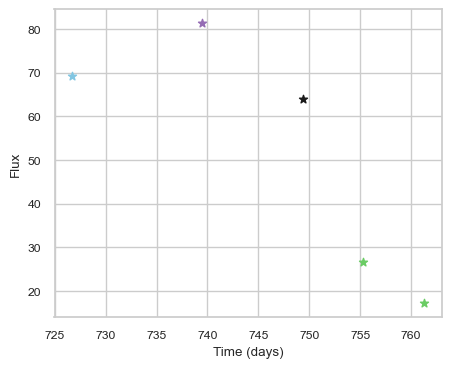

SNIax (3.8008425, False)
SNIax (3.5307267, False)
SNIax (3.4228501, False)
SNIax (3.308205, False)
SNIax (4.0765195, False)
SNIax (4.2870207, False)
SNIax (4.3165584, False)
SNIax (4.299368, False)
SNIax (4.0643134, False)
SNIax (3.1972976, False)


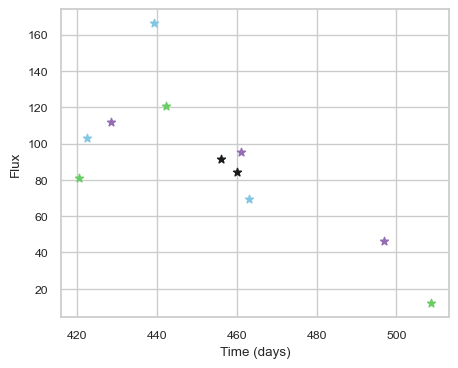

SNIax (3.834728, False)
SNIax (3.645685, False)
SNIax (4.5316696, False)
SNIax (4.6280556, False)
SNIax (4.595962, False)
SNIax (4.3690705, False)
SNIax (4.6761055, False)
SNIax (5.338439, False)
SNIax (5.846482, False)
SNIax (6.115903, False)
SNIax (6.3800697, False)
SNIax (6.3360577, False)
SNIax (6.5275383, False)
SNIax (6.456924, False)
SNIax (6.906158, False)
SNIax (6.381986, False)
SNIax (6.2730465, False)
SNIax (6.601302, False)
SNIax (5.7156444, False)
SNIax (5.7165017, False)
SNIax (5.9677258, False)
SNIax (5.8833275, False)


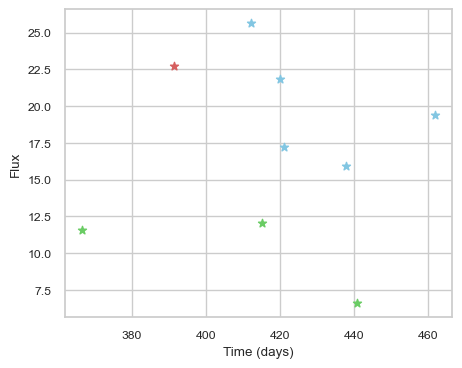

SNIax (3.8828712, False)
SNIax (3.4418576, False)
SNIax (3.445036, False)
SNIax (4.1087527, False)
SNIax (4.0175595, False)
SNIax (3.7234797, False)
SNIax (4.3635097, False)
SNIax (3.9125264, False)
SNIax (3.9614034, False)
SNIax (3.6227946, False)
SNIax (3.3794448, False)
SNIax (3.4861047, False)
SNIax (4.006126, False)
SNIax (3.9204004, False)
SNIax (4.15035, False)
SNIax (4.1035137, False)
SNIax (3.9073596, False)
SNIax (3.9938686, False)


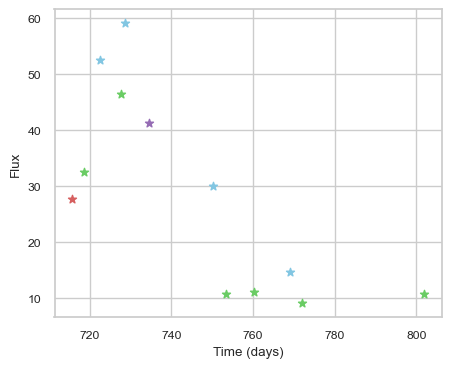

SNIax (3.810029, False)
SNIax (4.2957177, False)
SNIax (3.9014308, False)
SNIax (3.087679, False)
SNIax (4.7524796, False)
SNIax (3.831356, False)
SNIax (3.1765249, False)
SNIax (3.621726, False)
SNIax (3.6053383, False)
SNIax (3.200562, False)
SNIax (3.5747337, False)
SNIax (3.3180814, False)
SNIax (3.5710354, False)
SNIax (3.2573037, False)
SNIax (3.3984287, False)
SNIax (2.919183, False)
SNIax (2.3789024, False)
SNIax (2.7029202, False)
SNIax (2.3163755, False)
SNIax (2.2966514, False)
SNIax (2.24168, False)
SNIax (2.3297946, False)
SNIax (2.562363, False)
SNIax (2.5594969, False)


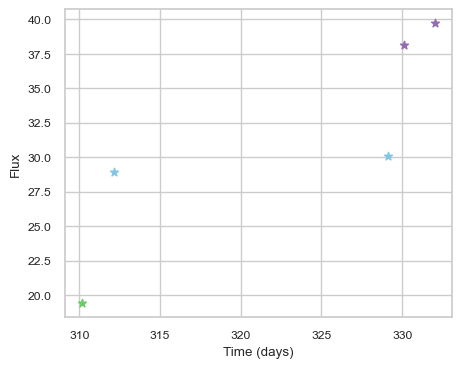

SNIax (4.958161, False)
SNIax (4.6786876, False)
SNIax (4.155383, False)
SNIax (5.201512, False)
SNIax (5.382231, False)
SNIax (5.8275566, False)
SNIax (4.900211, False)
SNIax (5.187312, False)
SNIax (5.1308312, False)
SNIax (5.1969967, False)


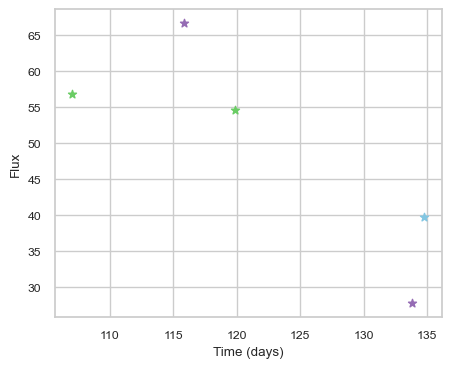

SNIax (4.1855373, False)
SNIax (4.2328267, False)
SNIax (4.767798, False)
SNIax (4.5154433, False)
SNIax (5.3040767, False)
SNIax (3.8876688, False)
SNIax (4.097964, False)
SNIax (3.9213727, False)
SNIax (4.163716, False)
SNIax (3.8862593, False)


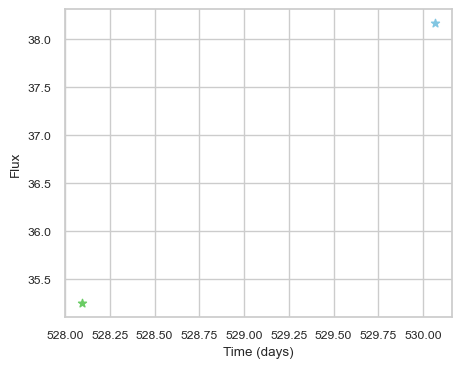

SNIax (3.8439047, False)
SNIax (3.9549563, False)
SNIax (3.7688785, False)
SNIax (3.6794286, False)


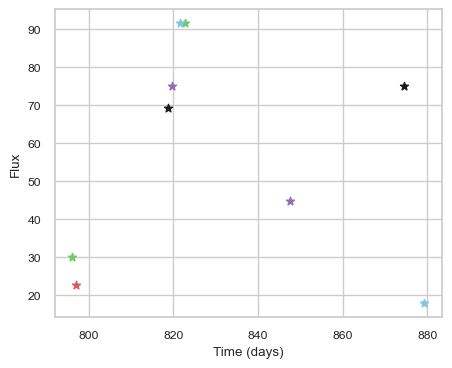

SNIax (3.8128443, False)
SNIax (3.4265132, False)
SNIax (3.5748248, False)
SNIax (3.564964, False)
SNIax (3.1882973, False)
SNIax (2.8596787, False)
SNIax (3.4900193, False)
SNIax (2.9402251, False)
SNIax (3.4892244, False)
SNIax (3.814174, False)
SNIax (3.874467, False)
SNIax (4.2616687, False)
SNIax (5.284061, False)
SNIax (4.6939135, False)
SNIax (5.106293, False)
SNIax (5.263328, False)
SNIax (4.0883927, False)
SNIax (3.8681695, False)


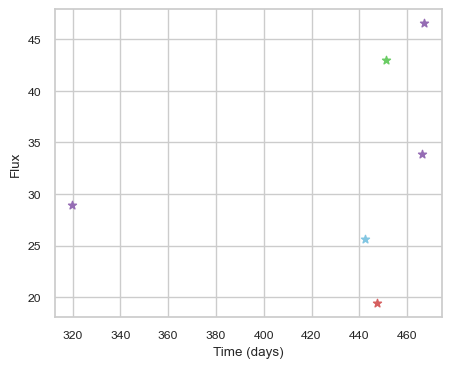

SNIax (3.9475162, False)
SNIax (3.821157, False)
SNIax (4.0763106, False)
SNIax (3.7708156, False)
SNIax (3.4385483, False)
SNIax (3.4759092, False)
SNIax (3.3568366, False)
SNIax (3.647302, False)
SNIax (3.2548413, False)
SNIax (2.5906284, False)
SNIax (2.5086727, False)
SNIax (2.3765159, False)


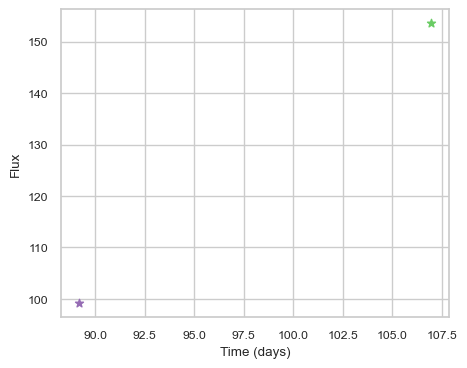

SNIax (3.6464224, False)
SNIax (3.8246188, False)
SNIax (3.45207, False)
SNIax (4.4497437, False)


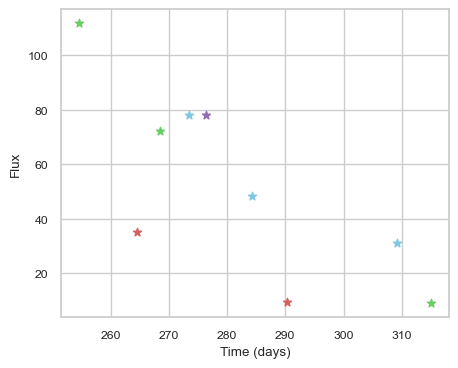

SNIax (3.6954505, False)
SNIax (3.9474401, False)
SNIax (3.9146464, False)
SNIax (2.8067627, False)
SNIax (3.4933288, False)
SNIax (3.430945, False)
SNIax (3.2579207, False)
SNIax (3.9324524, False)
SNIax (3.622832, False)
SNIax (3.582109, False)
SNIax (3.2255695, False)
SNIax (3.5212183, False)
SNIax (3.3570294, False)
SNIax (3.4489963, False)
SNIax (4.169852, False)
SNIax (3.3383992, False)
SNIax (3.3571749, False)
SNIax (3.3964515, False)


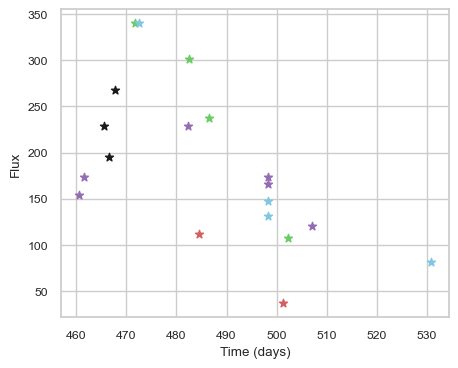

SNIax (3.7816577, False)
SNIax (3.864837, False)
SNIax (4.031462, False)
SNIax (4.56875, False)
SNIax (4.4612374, False)
SNIax (5.0920796, False)
SNIax (3.5208735, False)
SNIax (4.576941, False)
SNIax (3.872355, False)
SNIax (3.940748, False)
SNIax (3.469831, False)
SNIax (3.1686404, False)
SNIax (4.056565, False)
SNIax (3.2640662, False)
SNIax (3.6137, False)
SNIax (4.0560455, False)
SNIax (3.939383, False)
SNIax (3.2664092, False)
SNIax (4.627319, False)
SNIax (4.4882545, False)
SNIax (4.7551823, False)
SNIax (4.0840464, False)
SNIax (3.5947173, False)
SNIax (3.9096127, False)
SNIax (4.1961236, False)
SNIax (4.137277, False)
SNIax (3.9971585, False)
SNIax (3.85086, False)
SNIax (4.4410853, False)
SNIax (4.4932947, False)
SNIax (4.4507113, False)
SNIax (4.8187127, False)
SNIax (4.3302927, False)
SNIax (4.595533, False)
SNIax (4.999752, False)
SNIax (5.087946, False)
SNIax (4.4102335, False)


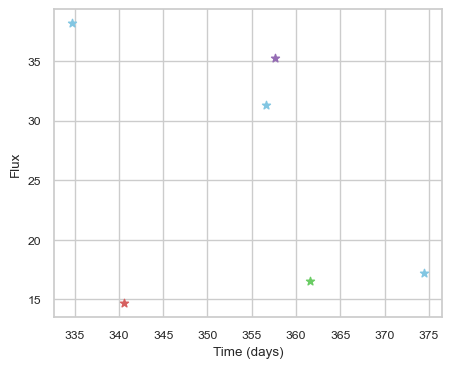

SNIax (4.1829276, False)
SNIax (4.2035284, False)
SNIax (4.090221, False)
SNIax (3.5170527, False)
SNIax (3.310274, False)
SNIax (2.6211753, False)
SNIax (3.4203591, False)
SNIax (3.724701, False)
SNIax (4.6258254, False)
SNIax (4.09081, False)
SNIax (3.963963, False)
SNIax (3.9543188, False)


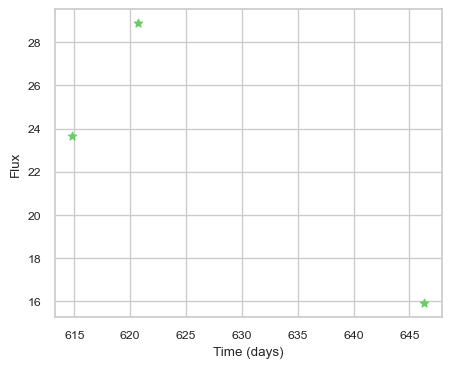

SNIax (3.7919202, False)
SNIax (3.413337, False)
SNIax (3.4612982, False)
SNIax (3.4320736, False)
SNIax (4.427104, False)
SNIax (4.439181, False)


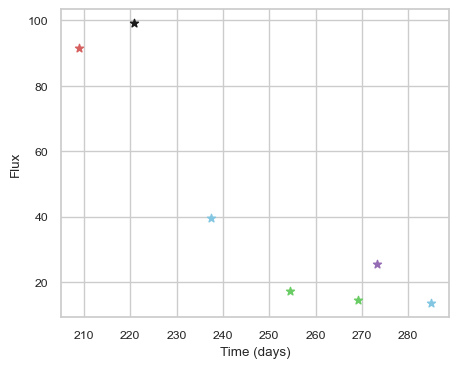

SNIax (3.3696885, False)
SNIax (3.2800055, False)
SNIax (3.5650282, False)
SNIax (3.4825923, False)
SNIax (3.3287, False)
SNIax (3.329326, False)
SNIax (3.1411817, False)
SNIax (3.2180908, False)
SNIax (3.3789482, False)
SNIax (3.0632775, False)
SNIax (3.489301, False)
SNIax (3.202636, False)
SNIax (2.789625, False)
SNIax (2.7364254, False)


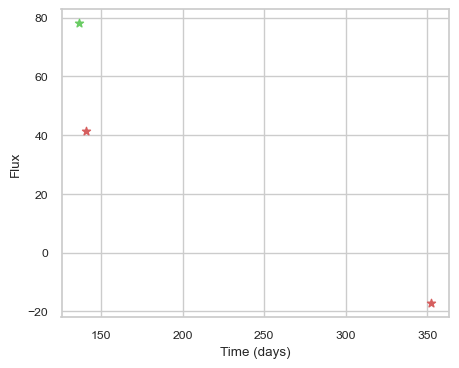

SNIax (3.7039013, False)
SNIax (4.2524176, False)
SNIax (4.3177023, False)
SNIax (3.637209, False)
SNIax (3.9698875, False)
SNIax (3.6077871, False)


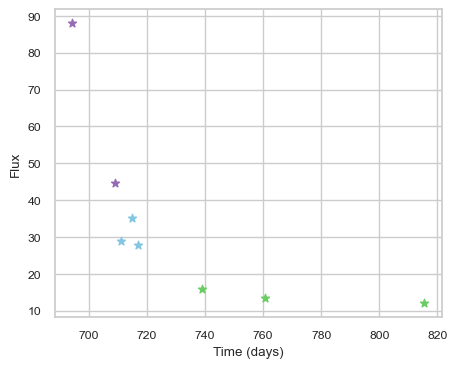

SNIax (3.5646918, False)
SNIax (3.6988575, False)
SNIax (3.8230307, False)
SNIax (3.9641814, False)
SNIax (3.1494625, False)
SNIax (3.3226051, False)
SNIax (3.6817348, False)
SNIax (3.2574787, False)
SNIax (3.3693795, False)
SNIax (3.3239772, False)
SNIax (4.199764, False)
SNIax (4.3876877, False)
SNIax (4.317281, False)
SNIax (3.963039, False)
SNIax (4.2040577, False)
SNIax (4.088763, False)


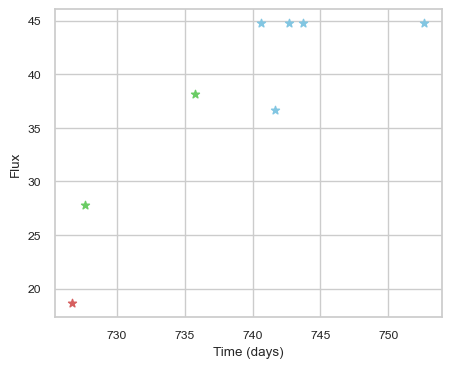

SNIax (3.9935997, False)
SNIax (3.967845, False)
SNIax (4.1326323, False)
SNIax (2.6588159, False)
SNIax (4.1861115, False)
SNIax (3.043847, False)
SNIax (3.436753, False)
SNIax (2.9163702, False)
SNIax (3.028286, False)
SNIax (2.894094, False)
SNIax (2.6720035, False)
SNIax (2.7702277, False)
SNIax (2.7602277, False)
SNIax (2.538729, False)
SNIax (2.6766806, False)
SNIax (2.9042704, False)


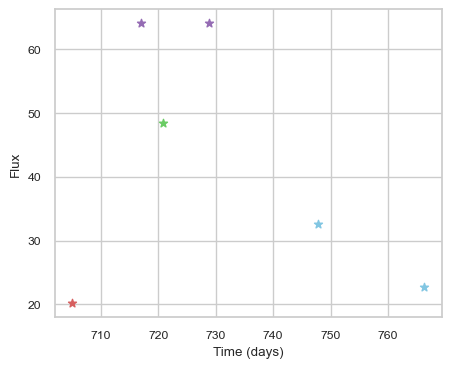

SNIax (3.8015196, False)
SNIax (3.9251544, False)
SNIax (3.8623056, False)
SNIax (2.7163284, False)
SNIax (3.4588614, False)
SNIax (2.6432853, False)
SNIax (3.5372982, False)
SNIax (3.3494422, False)
SNIax (3.9504457, False)
SNIax (3.5972042, False)
SNIax (3.8967566, False)
SNIax (3.6556804, False)


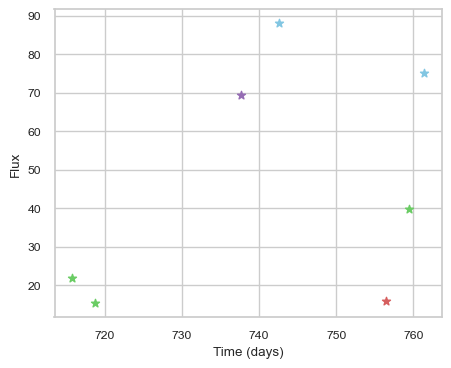

SNIax (3.9078615, False)
SNIax (3.4744618, False)
SNIax (3.389188, False)
SNIax (3.7408955, False)
SNIax (3.4800754, False)
SNIax (3.2164035, False)
SNIax (3.744469, False)
SNIax (3.3538291, False)
SNIax (3.0909812, False)
SNIax (3.646354, False)
SNIax (3.9343505, False)
SNIax (3.9477487, False)
SNIax (3.804974, False)
SNIax (3.9836087, False)


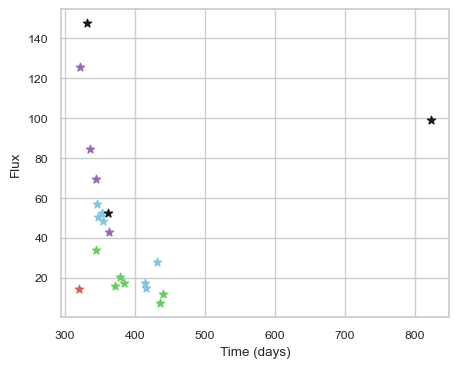

SNIax (3.7142162, False)
SNIax (4.0865355, False)
SNIax (3.8303602, False)
SNIax (4.574983, False)
SNIax (3.6964324, False)
SNIax (3.9595034, False)
SNIax (3.9966445, False)
SNIax (3.8057973, False)
SNIax (3.60431, False)
SNIax (3.84883, False)
SNIax (3.592092, False)
SNIax (3.5499582, False)
SNIax (4.079183, False)
SNIax (3.7009048, False)
SNIax (4.1772237, False)
SNIax (3.624161, False)
SNIax (3.6551664, False)
SNIax (3.4566283, False)
SNIax (4.2020025, False)
SNIax (3.5230749, False)
SNIax (4.0201797, False)
SNIax (4.8624463, False)
SNIax (3.9900773, False)
SNIax (4.1688194, False)
SNIax (3.6980221, False)
SNIax (4.072167, False)
SNIax (3.4886184, False)
SNIax (3.9819741, False)
SNIax (4.0685177, False)
SNIax (3.971478, False)
SNIax (3.6410484, False)
SNIax (3.5181868, False)
SNIax (3.1626713, False)
SNIax (3.5414321, False)
SNIax (3.4031682, False)
SNIax (3.534935, False)
SNIax (3.612632, False)
SNIax (3.627669, False)
SNIax (3.120399, False)
SNIax (3.6986823, False)
SNIax (3.59734

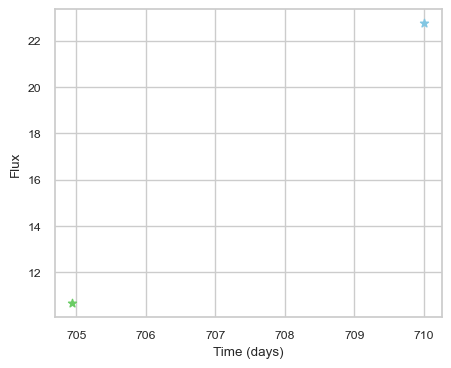

SNIax (4.4354053, False)
SNIax (3.6941738, False)
SNIax (3.4795642, False)
SNIax (3.5432212, False)


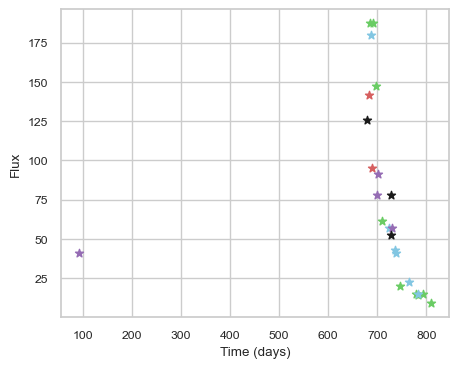

SNIax (3.8361354, False)
SNIax (3.8306727, False)
SNIax (3.87372, False)
SNIax (3.7896128, False)
SNIax (3.6548147, False)
SNIax (4.1208043, False)
SNIax (2.9354055, False)
SNIax (2.839082, False)
SNIax (2.8783073, False)
SNIax (2.7127023, False)
SNIax (2.663733, False)
SNIax (2.4621356, False)
SNIax (2.9062383, False)
SNIax (2.354022, False)
SNIax (2.528432, False)
SNIax (2.4049027, False)
SNIax (2.1901782, False)
SNIax (2.4890423, False)
SNIax (3.8394434, False)
SNIax (2.9400847, False)
SNIax (3.2612064, False)
SNIax (3.1777978, False)
SNIax (3.2929792, False)
SNIax (3.5763133, False)
SNIax (3.655226, False)
SNIax (3.7958863, False)
SNIax (4.239911, False)
SNIax (4.0205274, False)
SNIax (4.0297093, False)
SNIax (3.5032246, False)
SNIax (3.3636625, False)
SNIax (3.442333, False)
SNIax (3.5359726, False)
SNIax (3.5578144, False)
SNIax (3.3856566, False)
SNIax (3.371483, False)
SNIax (3.4317555, False)
SNIax (2.8918839, False)
SNIax (3.5192425, False)
SNIax (3.0715673, False)
SNIax (3.7

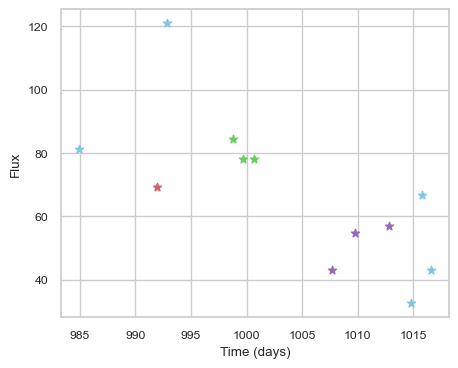

SNIax (3.635383, False)
SNIax (3.5545518, False)
SNIax (3.584719, False)
SNIax (3.7113152, False)
SNIax (3.586987, False)
SNIax (3.6324842, False)
SNIax (3.7093754, False)
SNIax (3.262856, False)
SNIax (2.521649, False)
SNIax (3.589377, False)
SNIax (2.6215556, False)
SNIax (3.7034616, False)
SNIax (3.621149, False)
SNIax (3.4989665, False)
SNIax (4.1554127, False)
SNIax (3.615, False)
SNIax (4.1451106, False)
SNIax (3.655255, False)
SNIax (4.3774834, False)
SNIax (3.9021676, False)
SNIax (3.712988, False)
SNIax (3.8029494, False)
SNIax (3.6930895, False)
SNIax (3.9849207, False)


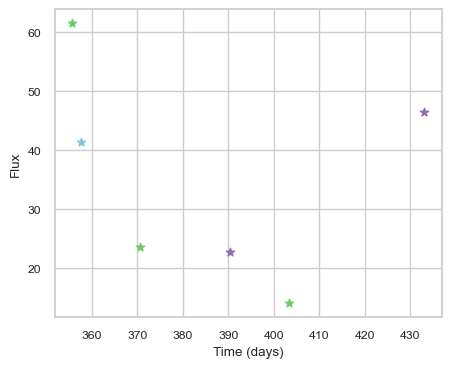

SNIax (3.7577589, False)
SNIax (3.2281415, False)
SNIax (3.2782366, False)
SNIax (3.1545992, False)
SNIax (3.7002413, False)
SNIax (3.9091148, False)
SNIax (3.1210735, False)
SNIax (3.0573843, False)
SNIax (3.06535, False)
SNIax (2.6273086, False)
SNIax (2.6866634, False)
SNIax (2.8411226, False)


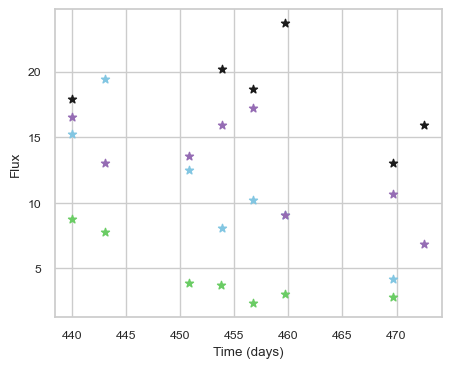

SNIax (5.377059, False)
SNIax (4.724364, False)
SNIax (4.718995, False)
SNIax (4.9278455, False)
SNIax (5.363442, False)
SNIax (4.0755787, False)
SNIax (4.311412, False)
SNIax (4.4309764, False)
SNIax (4.6854076, False)
SNIax (4.303, False)
SNIax (4.1954336, False)
SNIax (4.4966087, False)
SNIax (4.368703, False)
SNIax (3.7759476, False)
SNIax (3.7154052, False)
SNIax (3.9056103, False)
SNIax (3.8695629, False)
SNIax (4.0570426, False)
SNIax (4.0106244, False)
SNIax (3.6091678, False)
SNIax (3.3284206, False)
SNIax (3.6224334, False)
SNIax (3.837382, False)
SNIax (3.9943843, False)
SNIax (3.4508715, False)
SNIax (3.2316294, False)
SNIax (3.4970732, False)
SNIax (3.7441382, False)
SNIax (4.0566244, False)
SNIax (3.7381701, False)
SNIax (3.2783191, False)
SNIax (3.3848414, False)
SNIax (3.452506, False)
SNIax (3.6320314, False)
SNIax (3.3752391, False)
SNIax (3.667473, False)
SNIax (3.6836042, False)


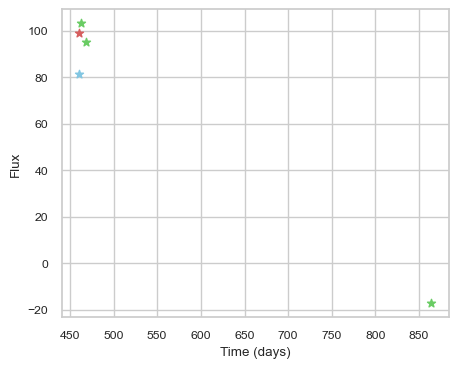

SNIax (3.6646185, False)
SNIax (4.1955757, False)
SNIax (3.6878355, False)
SNIax (3.708074, False)
SNIax (3.1640034, False)
SNIax (3.760211, False)
SNIax (4.1789565, False)
SNIax (5.8665113, False)
SNIax (4.0400743, False)
SNIax (3.4407847, False)


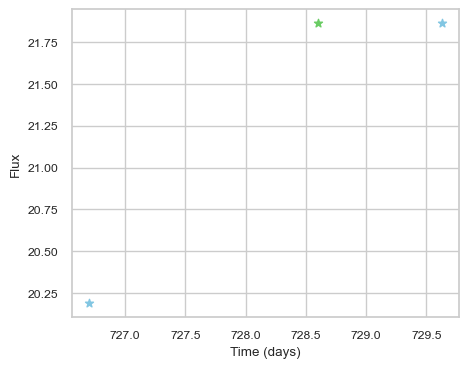

SNIax (4.2542477, False)
SNIax (3.8904047, False)
SNIax (3.1197517, False)
SNIax (2.8490787, False)
SNIax (2.960462, False)
SNIax (2.4999983, False)


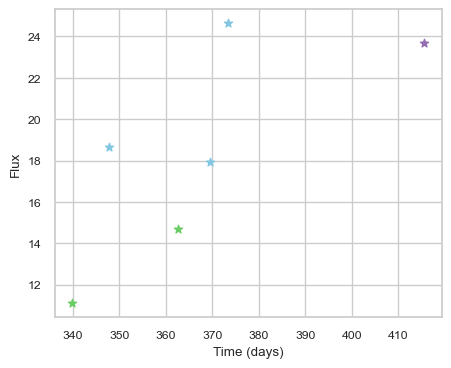

SNIax (5.3787575, False)
SNIax (5.014687, False)
SNIax (5.1517997, False)
SNIax (5.0108404, False)
SNIax (4.3643374, False)
SNIax (4.771487, False)
SNIax (4.8318415, False)
SNIax (4.836092, False)
SNIax (4.1948867, False)
SNIax (4.552832, False)
SNIax (5.4618435, False)
SNIax (4.981954, False)


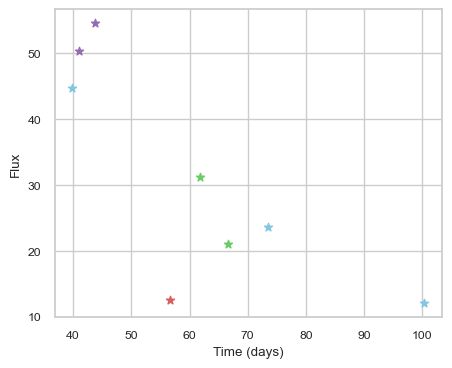

SNIax (4.2027197, False)
SNIax (4.0600133, False)
SNIax (3.5188358, False)
SNIax (3.243394, False)
SNIax (3.7065353, False)
SNIax (3.221379, False)
SNIax (3.0335453, False)
SNIax (2.979034, False)
SNIax (3.1343808, False)
SNIax (3.605252, False)
SNIax (3.7389078, False)
SNIax (3.5555978, False)
SNIax (3.0660696, False)
SNIax (3.0381649, False)
SNIax (3.3123713, False)
SNIax (2.883287, False)


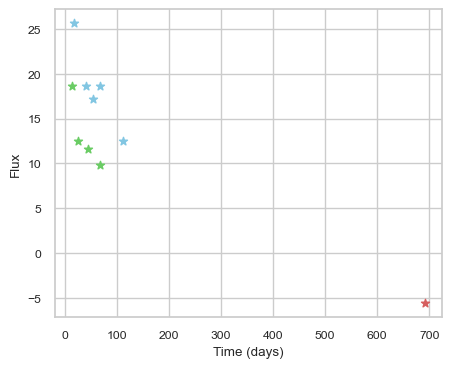

SNIax (3.9026008, False)
SNIax (3.2677538, False)
SNIax (3.330578, False)
SNIax (2.7849426, False)
SNIax (2.6667683, False)
SNIax (3.2229083, False)
SNIax (3.1292048, False)
SNIax (3.1872466, False)
SNIax (3.3955123, False)
SNIax (3.3012307, False)
SNIax (3.4190054, False)
SNIax (3.2993953, False)
SNIax (3.11044, False)
SNIax (3.5017273, False)
SNIax (2.9036577, False)
SNIax (3.4681048, False)
SNIax (3.7532952, False)
SNIax (3.5850143, False)
SNIax (3.7931366, False)
SNIax (4.2047873, False)


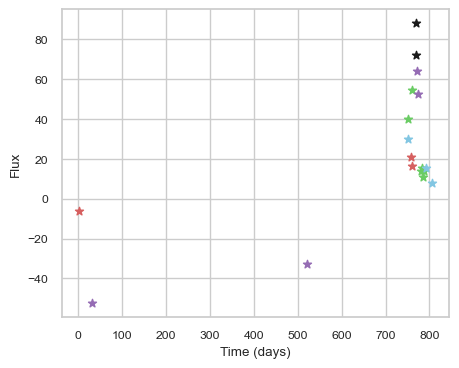

SNIax (4.4887075, False)
SNIax (4.5566807, False)
SNIax (3.8262372, False)
SNIax (4.7610264, False)
SNIax (4.0298204, False)
SNIax (4.5225754, False)
SNIax (4.226024, False)
SNIax (4.076429, False)
SNIax (3.555619, False)
SNIax (3.7997253, False)
SNIax (4.2590966, False)
SNIax (4.2576456, False)
SNIax (4.7007394, False)
SNIax (4.564781, False)
SNIax (4.773133, False)
SNIax (4.7572465, False)
SNIax (4.5820827, False)
SNIax (4.905914, False)
SNIax (4.9394546, False)
SNIax (4.436159, False)
SNIax (5.115642, False)
SNIax (4.0561533, False)
SNIax (4.5213118, False)
SNIax (4.033938, False)
SNIax (3.926696, False)
SNIax (3.8718863, False)
SNIax (3.0047069, False)
SNIax (3.6419926, False)
SNIax (3.2773921, False)
SNIax (2.9783077, False)
SNIax (3.3001633, False)
SNIax (2.9816442, False)
SNIax (3.031282, False)
SNIax (2.82584, False)
SNIax (2.8838508, False)
SNIax (3.1363444, False)


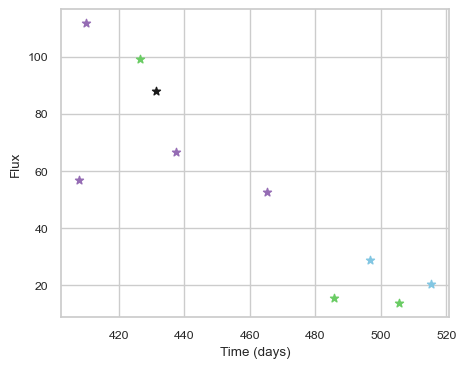

SNIax (3.879358, False)
SNIax (2.9565887, False)
SNIax (3.48495, False)
SNIax (4.074481, False)
SNIax (4.7108464, False)
SNIax (4.0778213, False)
SNIax (4.3049054, False)
SNIax (5.161434, False)
SNIax (4.534114, False)
SNIax (5.093508, False)
SNIax (5.2563787, False)
SNIax (4.6968856, False)
SNIax (5.054262, False)
SNIax (4.789363, False)
SNIax (4.7084403, False)
SNIax (4.811548, False)
SNIax (4.4804087, False)
SNIax (4.5238943, False)
SNIax (4.4449515, False)
SNIax (4.5250673, False)


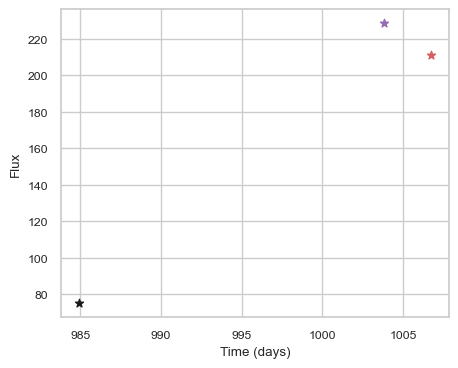

SNIax (3.7796583, False)
SNIax (3.8236246, False)
SNIax (3.9063764, False)
SNIax (3.7169232, False)
SNIax (3.974082, False)
SNIax (4.037649, False)


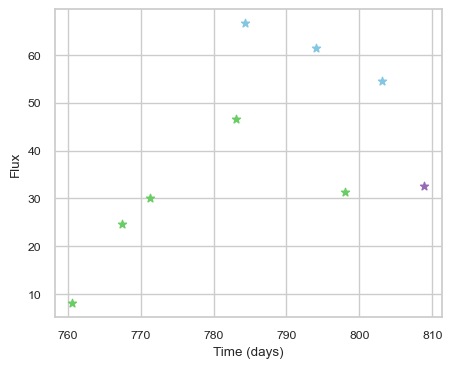

SNIax (4.10017, False)
SNIax (3.2596762, False)
SNIax (3.169733, False)
SNIax (2.650462, False)
SNIax (2.9673383, False)
SNIax (2.2455125, False)
SNIax (2.507318, False)
SNIax (3.0398002, False)
SNIax (4.010364, False)
SNIax (3.9285638, False)
SNIax (4.852228, False)
SNIax (4.232534, False)
SNIax (5.1090937, False)
SNIax (4.6957855, False)
SNIax (5.221004, False)
SNIax (4.433986, False)
SNIax (4.900456, False)
SNIax (4.518103, False)


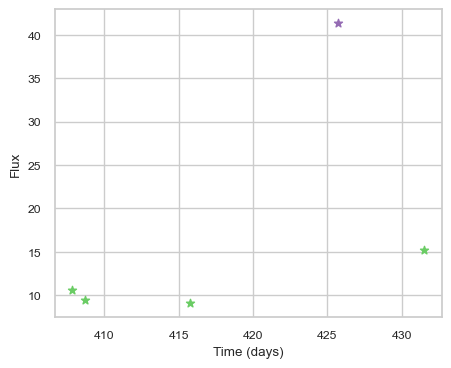

SNIax (5.2005844, False)
SNIax (4.3605614, False)
SNIax (4.221654, False)
SNIax (4.0880165, False)
SNIax (4.157881, False)
SNIax (4.1433115, False)
SNIax (4.5041285, False)
SNIax (4.194933, False)
SNIax (4.4414945, False)
SNIax (4.5151234, False)


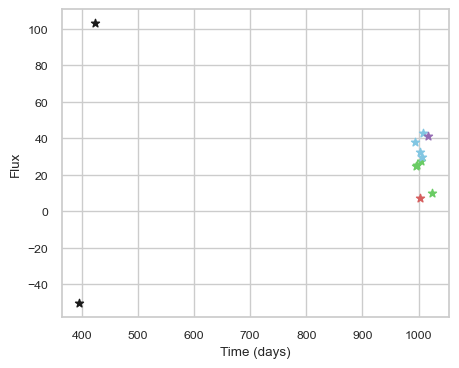

SNIax (4.413856, False)
SNIax (4.045404, False)
SNIax (4.2873287, False)
SNIax (3.826054, False)
SNIax (4.134088, False)
SNIax (4.036534, False)
SNIax (3.6028857, False)
SNIax (3.285213, False)
SNIax (3.717537, False)
SNIax (3.1811528, False)
SNIax (3.1479948, False)
SNIax (3.0218697, False)
SNIax (2.6730435, False)
SNIax (2.549949, False)
SNIax (3.133006, False)
SNIax (2.440236, False)
SNIax (2.9898415, False)
SNIax (2.220343, False)
SNIax (2.5461392, False)
SNIax (2.1464546, False)
SNIax (2.8042254, False)
SNIax (2.4216163, False)
SNIax (2.5895214, False)
SNIax (2.6224818, False)


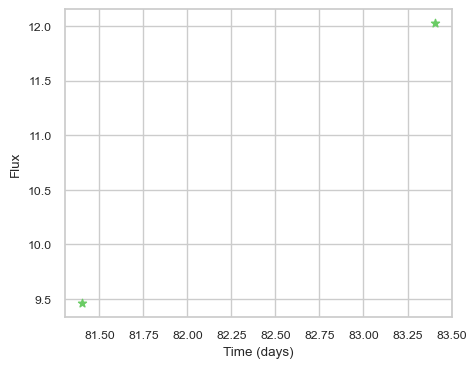

SNIax (3.991246, False)
SNIax (3.4847715, False)
SNIax (3.3718073, False)
SNIax (3.3833597, False)


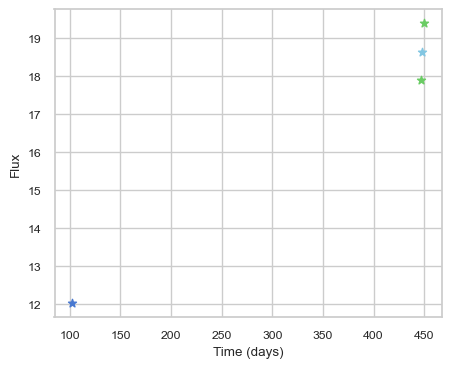

SNIax (4.248266, False)
SNIax (4.801082, False)
SNIax (3.6125348, False)
SNIax (3.5447652, False)
SNIax (3.8621023, False)
SNIax (4.0218873, False)
SNIax (4.000879, False)
SNIax (3.3964834, False)


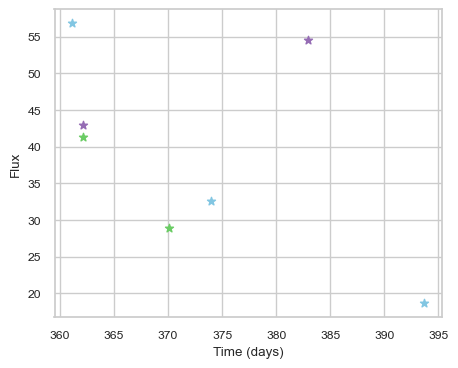

SNIax (3.8414385, False)
SNIax (3.6595013, False)
SNIax (3.8847995, False)
SNIax (3.0477948, False)
SNIax (3.443053, False)
SNIax (2.5621495, False)
SNIax (2.4676857, False)
SNIax (2.3538177, False)
SNIax (2.7870686, False)
SNIax (2.144078, False)
SNIax (2.2799597, False)
SNIax (2.1565895, False)
SNIax (3.2721114, False)
SNIax (2.5300395, False)


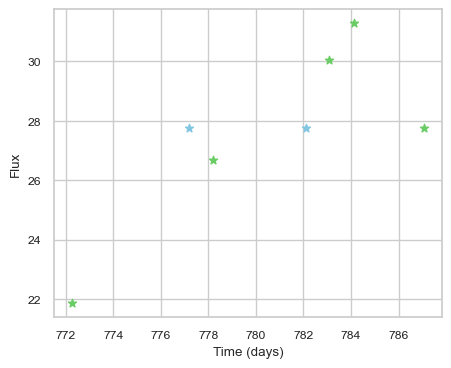

SNIax (3.8617718, False)
SNIax (3.4532504, False)
SNIax (3.2556205, False)
SNIax (3.3720934, False)
SNIax (3.2817726, False)
SNIax (3.55438, False)
SNIax (4.0672827, False)
SNIax (3.7656767, False)
SNIax (3.7066078, False)
SNIax (3.7832134, False)
SNIax (4.1510763, False)
SNIax (3.7676485, False)
SNIax (4.446087, False)
SNIax (4.181933, False)


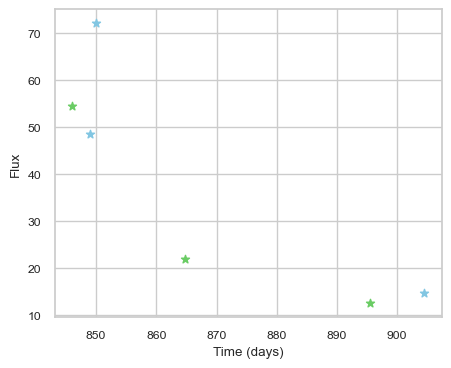

SNIax (3.7651021, False)
SNIax (3.4822724, False)
SNIax (3.5646658, False)
SNIax (3.5765145, False)
SNIax (3.8452566, False)
SNIax (4.368528, False)
SNIax (4.267332, False)
SNIax (4.224232, False)
SNIax (3.981576, False)
SNIax (3.693815, False)
SNIax (2.9842184, False)
SNIax (2.947101, False)


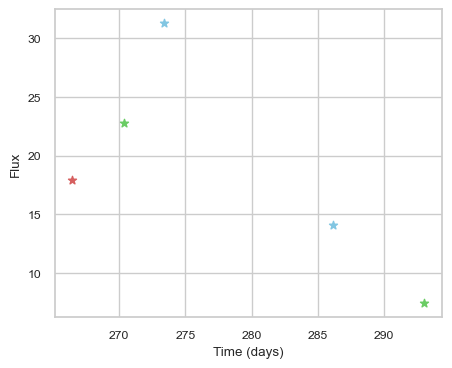

SNIax (3.916847, False)
SNIax (4.4885106, False)
SNIax (4.176983, False)
SNIax (4.2705903, False)
SNIax (5.0499635, False)
SNIax (4.6972637, False)
SNIax (3.9073756, False)
SNIax (4.2721386, False)
SNIax (4.5950823, False)
SNIax (4.6614146, False)


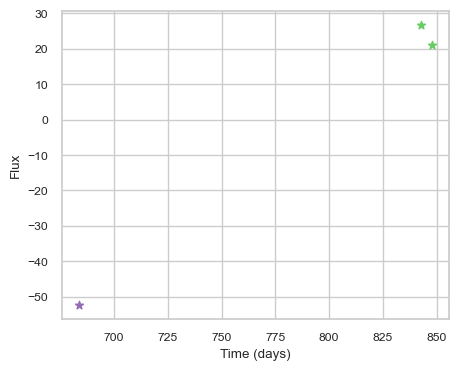

SNIax (3.9643238, False)
SNIax (4.0887823, False)
SNIax (4.08722, False)
SNIax (3.527144, False)
SNIax (3.4707148, False)
SNIax (3.1617296, False)


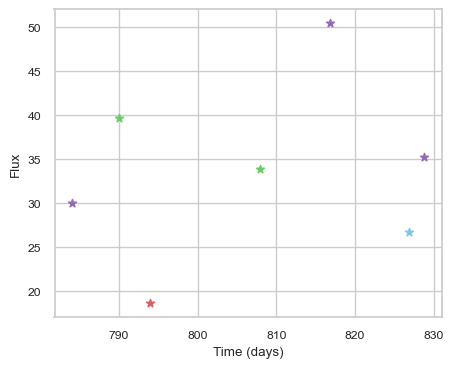

SNIax (4.01367, False)
SNIax (3.292625, False)
SNIax (3.0103757, False)
SNIax (3.0637906, False)
SNIax (3.18009, False)
SNIax (3.0189903, False)
SNIax (2.5586565, False)
SNIax (2.2342074, False)
SNIax (2.6885498, False)
SNIax (2.823513, False)
SNIax (3.3315594, False)
SNIax (3.2577133, False)
SNIax (3.1965866, False)
SNIax (3.6443982, False)


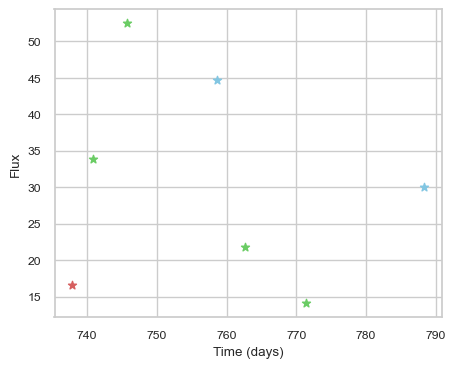

SNIax (4.1461663, False)
SNIax (3.7462685, False)
SNIax (3.672605, False)
SNIax (2.5757804, False)
SNIax (3.227361, False)
SNIax (3.0571306, False)
SNIax (3.463027, False)
SNIax (2.4320064, False)
SNIax (2.6889408, False)
SNIax (2.2478898, False)
SNIax (2.662975, False)
SNIax (2.209699, False)
SNIax (2.5786338, False)
SNIax (2.2599256, False)


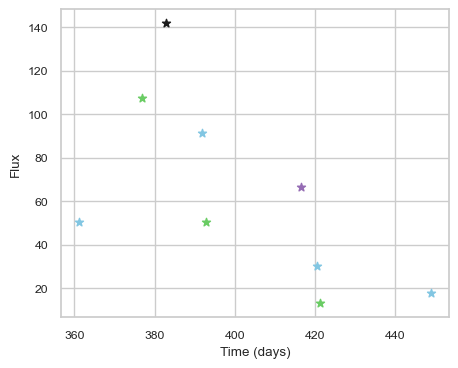

SNIax (3.8313534, False)
SNIax (3.5198286, False)
SNIax (3.603573, False)
SNIax (3.9780583, False)
SNIax (4.467616, False)
SNIax (4.8220024, False)
SNIax (3.4841707, False)
SNIax (3.9292898, False)
SNIax (3.6562397, False)
SNIax (4.310446, False)
SNIax (4.693216, False)
SNIax (3.717214, False)
SNIax (4.362516, False)
SNIax (4.0739045, False)
SNIax (4.503232, False)
SNIax (4.0582323, False)
SNIax (4.3479214, False)
SNIax (3.7303512, False)


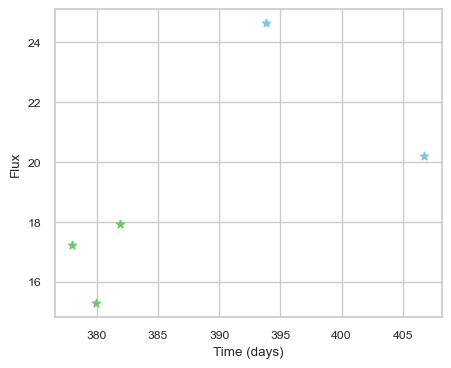

SNIax (4.348641, False)
SNIax (3.2504992, False)
SNIax (3.4916382, False)
SNIax (3.0693703, False)
SNIax (3.3598373, False)
SNIax (2.45485, False)
SNIax (2.6228075, False)
SNIax (2.1087234, False)
SNIax (2.0311344, False)
SNIax (2.183408, False)


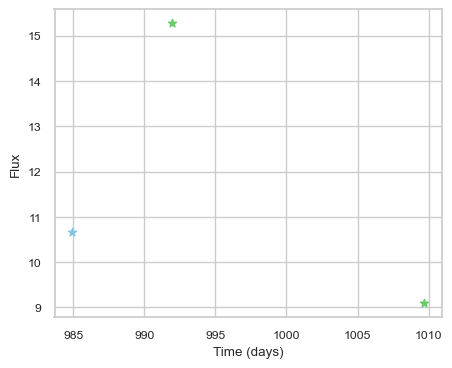

SNIax (3.8495543, False)
SNIax (3.857748, False)
SNIax (3.5886247, False)
SNIax (3.5082428, False)
SNIax (3.4148827, False)
SNIax (3.6833615, False)


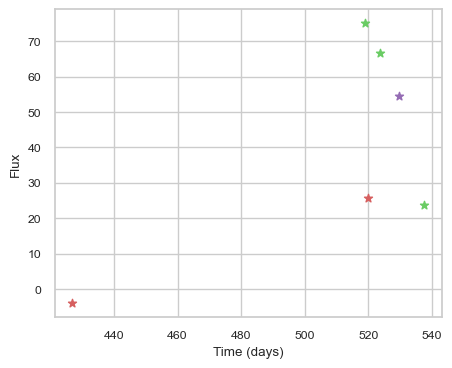

SNIax (3.9822598, False)
SNIax (4.6998415, False)
SNIax (3.4651546, False)
SNIax (4.2378883, False)
SNIax (4.538759, False)
SNIax (4.032989, False)
SNIax (5.2630153, False)
SNIax (5.118749, False)
SNIax (4.4285574, False)
SNIax (4.26208, False)
SNIax (4.4945574, False)
SNIax (4.232263, False)


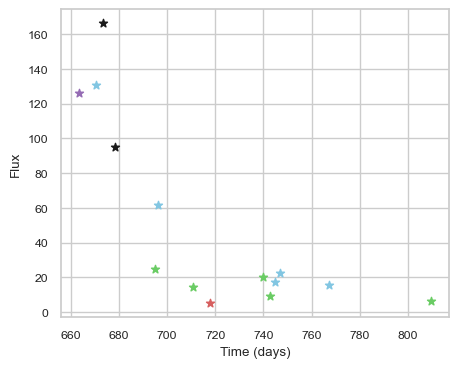

SNIax (3.8156075, False)
SNIax (4.051982, False)
SNIax (4.32899, False)
SNIax (4.508392, False)
SNIax (3.6066284, False)
SNIax (3.933931, False)
SNIax (3.856213, False)
SNIax (3.6414099, False)
SNIax (3.6196191, False)
SNIax (4.0770373, False)
SNIax (4.2960763, False)
SNIax (3.8797004, False)
SNIax (3.7705445, False)
SNIax (3.6589613, False)
SNIax (3.580323, False)
SNIax (3.9678404, False)
SNIax (3.7053604, False)
SNIax (3.2962139, False)
SNIax (4.249103, False)
SNIax (3.7037191, False)
SNIax (3.4043787, False)
SNIax (3.4798396, False)
SNIax (3.0687315, False)
SNIax (3.4755766, False)
SNIax (3.3311663, False)
SNIax (3.371152, False)
SNIax (3.4834554, False)
SNIax (3.4526463, False)


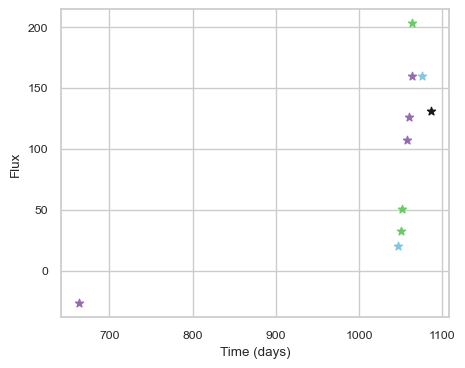

SNIax (3.8160233, False)
SNIax (4.1752095, False)
SNIax (3.7249744, False)
SNIax (3.6563911, False)
SNIax (3.1785607, False)
SNIax (3.0701764, False)
SNIax (3.4070835, False)
SNIax (3.1375737, False)
SNIax (3.1528676, False)
SNIax (3.492183, False)
SNIax (4.1447625, False)
SNIax (3.3161914, False)
SNIax (3.5630014, False)
SNIax (2.8362062, False)
SNIax (2.9989226, False)
SNIax (2.46364, False)
SNIax (2.771219, False)
SNIax (2.7450578, False)
SNIax (3.1552212, False)
SNIax (2.6994305, False)


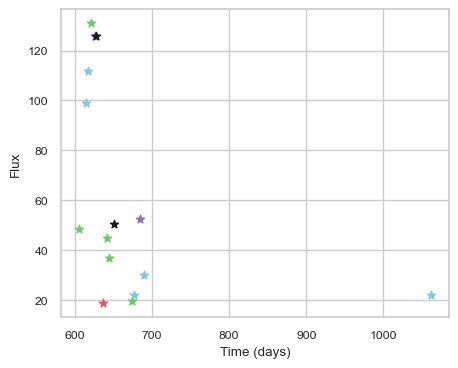

SNIax (3.6258109, False)
SNIax (3.3379416, False)
SNIax (3.3254986, False)
SNIax (3.6215851, False)
SNIax (3.9702044, False)
SNIax (4.2188344, False)
SNIax (4.5346184, False)
SNIax (3.725247, False)
SNIax (3.8335745, False)
SNIax (3.9216402, False)
SNIax (4.46418, False)
SNIax (3.593729, False)
SNIax (3.3157601, False)
SNIax (2.7680018, False)
SNIax (2.8759956, False)
SNIax (2.4430604, False)
SNIax (2.9890845, False)
SNIax (2.8473222, False)
SNIax (2.7272825, False)
SNIax (2.8059707, False)
SNIax (2.3250432, False)
SNIax (2.3422053, False)
SNIax (2.551328, False)
SNIax (1.81855, False)
SNIax (1.7659899, False)
SNIax (2.0239766, False)
SNIax (1.7208152, False)
SNIax (1.6581874, False)
SNIax (2.4959147, False)
SNIax (1.827337, False)


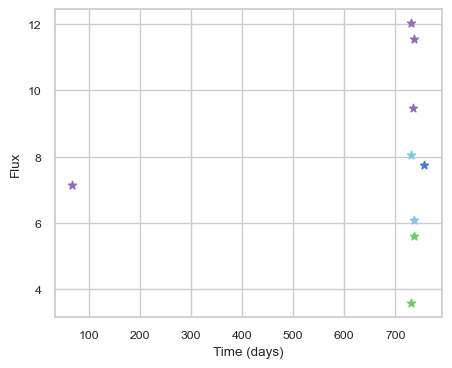

SNIax (5.1189923, False)
SNIax (5.85205, False)
SNIax (4.4412336, False)
SNIax (5.0915833, False)
SNIax (4.9953737, False)
SNIax (5.14173, False)
SNIax (5.284011, False)
SNIax (4.534607, False)
SNIax (5.0704126, False)
SNIax (4.3140397, False)
SNIax (4.3896413, False)
SNIax (4.4032617, False)
SNIax (4.7389164, False)
SNIax (4.884762, False)
SNIax (4.208713, False)
SNIax (5.5322337, False)


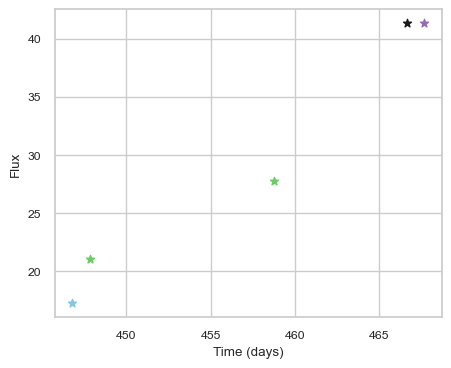

SNIax (4.1341343, False)
SNIax (3.591122, False)
SNIax (3.17205, False)
SNIax (2.712191, False)
SNIax (2.9953578, False)
SNIax (2.6747355, False)
SNIax (2.8843288, False)
SNIax (3.1708457, False)
SNIax (3.0810826, False)
SNIax (2.9588559, False)


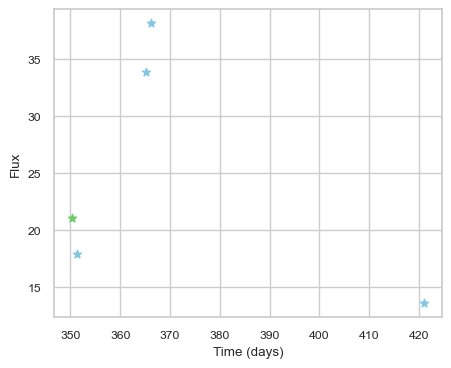

SNIax (4.251612, False)
SNIax (3.4609785, False)
SNIax (3.331482, False)
SNIax (3.2412748, False)
SNIax (3.252857, False)
SNIax (2.707376, False)
SNIax (2.5353937, False)
SNIax (2.3203602, False)
SNIax (3.1456149, False)
SNIax (2.8315217, False)


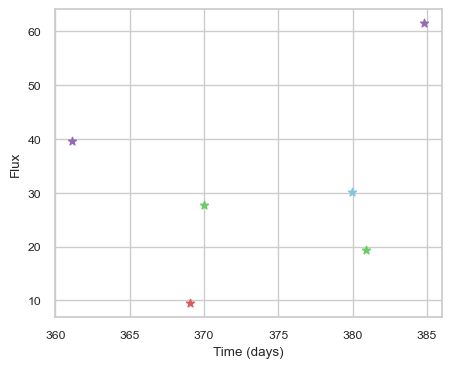

SNIax (4.153058, False)
SNIax (3.729713, False)
SNIax (4.1175694, False)
SNIax (3.9719975, False)
SNIax (3.9588702, False)
SNIax (3.642132, False)
SNIax (3.7316053, False)
SNIax (3.085412, False)
SNIax (2.8975823, False)
SNIax (2.4310298, False)
SNIax (3.061849, False)
SNIax (2.4353688, False)


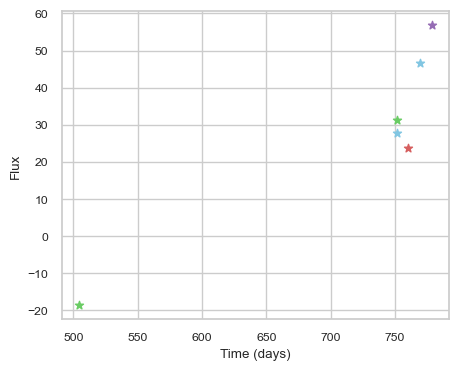

SNIax (4.1572137, False)
SNIax (4.455015, False)
SNIax (4.1009727, False)
SNIax (3.33771, False)
SNIax (3.4605935, False)
SNIax (2.8172255, False)
SNIax (2.8867602, False)
SNIax (3.4326067, False)
SNIax (3.0501037, False)
SNIax (2.6976938, False)
SNIax (2.8794115, False)
SNIax (2.86535, False)


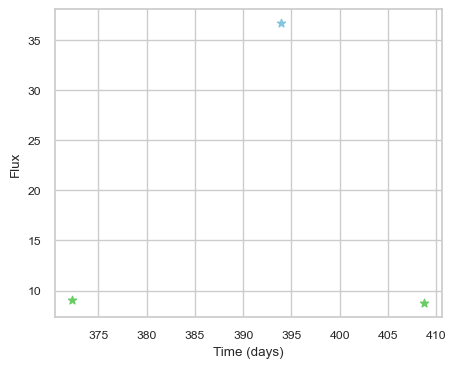

SNIax (4.9283147, False)
SNIax (4.111606, False)
SNIax (4.4178495, False)
SNIax (5.150172, False)
SNIax (5.754506, False)
SNIax (5.5391216, False)


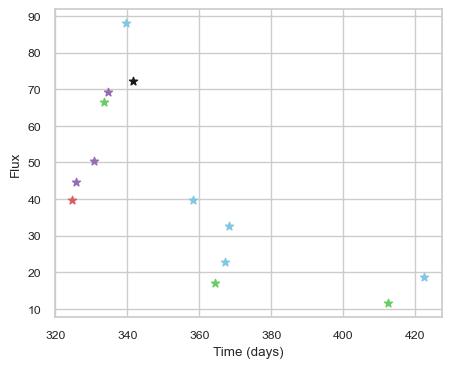

SNIax (3.9161732, False)
SNIax (4.5140505, False)
SNIax (5.089673, False)
SNIax (4.8396096, False)
SNIax (5.4473963, False)
SNIax (5.202355, False)
SNIax (5.55368, False)
SNIax (5.056635, False)
SNIax (3.8451262, False)
SNIax (4.6790385, False)
SNIax (4.430801, False)
SNIax (5.1180906, False)
SNIax (3.4598234, False)
SNIax (4.676113, False)
SNIax (3.0610147, False)
SNIax (3.081314, False)
SNIax (2.7545784, False)
SNIax (2.7760835, False)
SNIax (2.789752, False)
SNIax (2.6659489, False)
SNIax (2.2214901, False)
SNIax (2.2997422, False)
SNIax (2.557596, False)
SNIax (2.5776625, False)
SNIax (2.6936464, False)
SNIax (2.5128562, False)


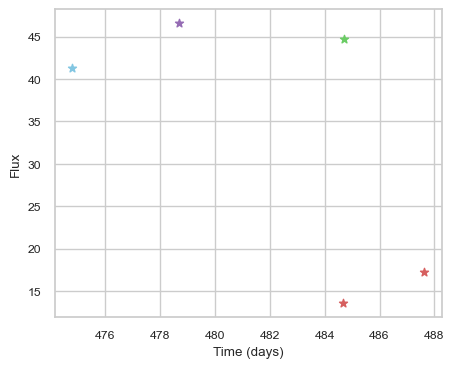

SNIax (4.0027943, False)
SNIax (3.9490519, False)
SNIax (3.7514207, False)
SNIax (3.57047, False)
SNIax (3.5440946, False)
SNIax (3.6765924, False)
SNIax (3.7072213, False)
SNIax (3.1704063, False)
SNIax (3.4577444, False)
SNIax (3.0759642, False)


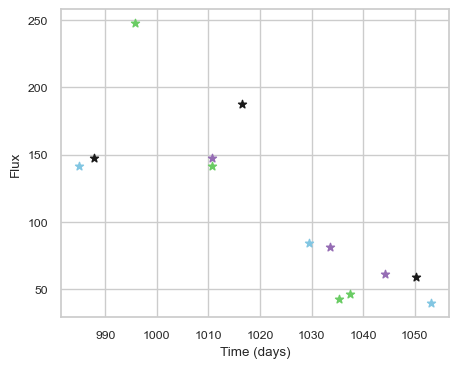

SNIax (3.788007, False)
SNIax (3.6584196, False)
SNIax (3.554806, False)
SNIax (3.6092968, False)
SNIax (3.1494973, False)
SNIax (3.0221803, False)
SNIax (3.927709, False)
SNIax (4.139101, False)
SNIax (4.348551, False)
SNIax (4.640454, False)
SNIax (4.722157, False)
SNIax (5.1699495, False)
SNIax (4.784892, False)
SNIax (4.2530947, False)
SNIax (4.0129485, False)
SNIax (4.2335315, False)
SNIax (4.1944213, False)
SNIax (4.541439, False)
SNIax (3.9440172, False)
SNIax (4.3841033, False)
SNIax (3.9746685, False)
SNIax (4.670416, False)
SNIax (4.289735, False)
SNIax (4.451167, False)
SNIax (4.657316, False)
SNIax (4.5346584, False)


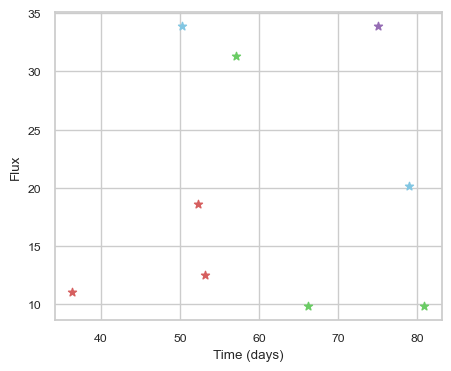

SNIax (3.878497, False)
SNIax (3.4034739, False)
SNIax (3.0645316, False)
SNIax (3.3609257, False)
SNIax (3.498218, False)
SNIax (2.9277744, False)
SNIax (3.5882494, False)
SNIax (3.1975446, False)
SNIax (3.4671986, False)
SNIax (3.1347907, False)
SNIax (3.7008588, False)
SNIax (3.569793, False)
SNIax (3.1727889, False)
SNIax (3.6345742, False)
SNIax (3.571976, False)
SNIax (3.5620239, False)
SNIax (3.1169705, False)
SNIax (3.5382705, False)


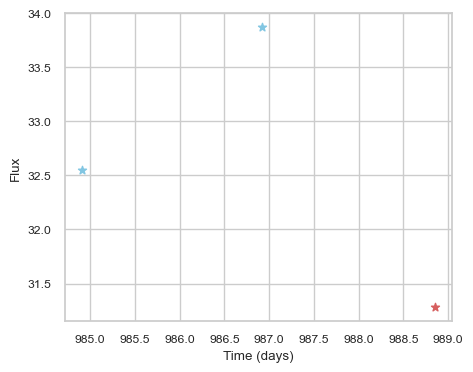

SNIax (3.7568483, False)
SNIax (3.6383612, False)
SNIax (3.0612469, False)
SNIax (3.9141386, False)
SNIax (3.297555, False)
SNIax (3.5292296, False)


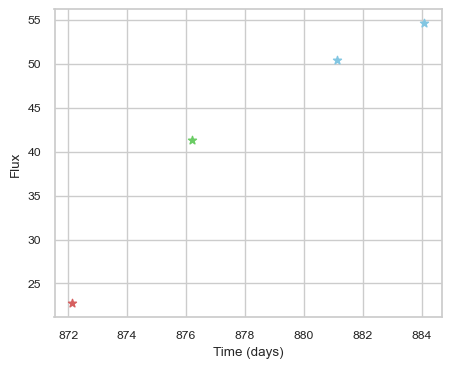

SNIax (3.8754227, False)
SNIax (4.2984757, False)
SNIax (3.9974809, False)
SNIax (2.8830588, False)
SNIax (3.5727246, False)
SNIax (3.412774, False)
SNIax (3.2757761, False)
SNIax (3.5022054, False)


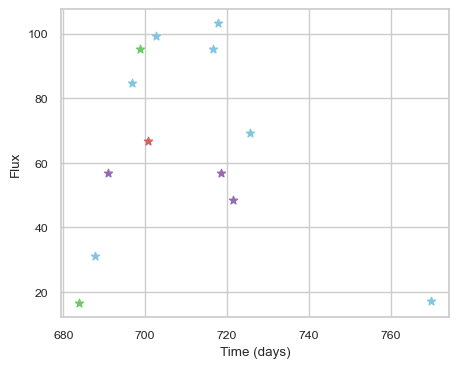

SNIax (3.9489205, False)
SNIax (3.720399, False)
SNIax (3.4429588, False)
SNIax (3.0985124, False)
SNIax (2.445576, False)
SNIax (2.786022, False)
SNIax (3.2062697, False)
SNIax (3.321364, False)
SNIax (4.050222, False)
SNIax (3.7150748, False)
SNIax (4.2693567, False)
SNIax (4.3183966, False)
SNIax (4.546771, False)
SNIax (4.470664, False)
SNIax (4.963867, False)
SNIax (4.3671474, False)
SNIax (4.8568354, False)
SNIax (4.70778, False)
SNIax (4.5622363, False)
SNIax (4.61435, False)
SNIax (5.4345794, False)
SNIax (4.7292175, False)
SNIax (5.058573, False)
SNIax (4.839558, False)
SNIax (5.337496, False)
SNIax (4.268724, False)


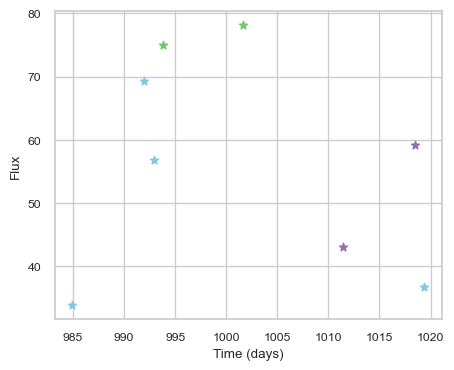

SNIax (4.0776386, False)
SNIax (3.8365397, False)
SNIax (3.857772, False)
SNIax (4.5455375, False)
SNIax (4.7801046, False)
SNIax (4.587, False)
SNIax (4.5843763, False)
SNIax (4.841126, False)
SNIax (5.0381236, False)
SNIax (5.106495, False)
SNIax (5.320626, False)
SNIax (4.946084, False)
SNIax (4.9682903, False)
SNIax (4.9324303, False)
SNIax (5.130055, False)
SNIax (4.9042397, False)


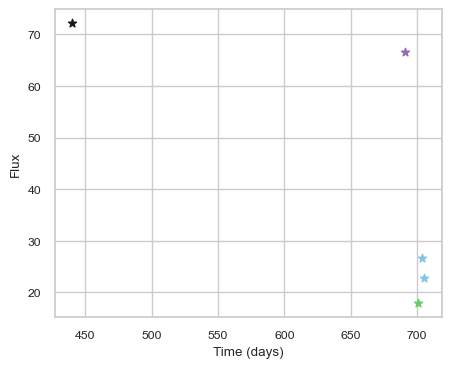

SNIax (4.537086, False)
SNIax (4.914144, False)
SNIax (4.654641, False)
SNIax (4.955066, False)
SNIax (5.136919, False)
SNIax (4.8362145, False)
SNIax (4.507758, False)
SNIax (4.8003902, False)
SNIax (4.0997744, False)
SNIax (4.3985, False)


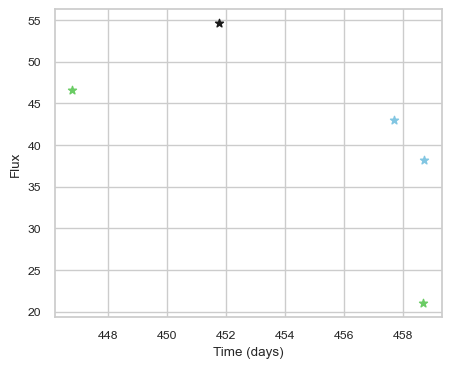

SNIax (4.0196276, False)
SNIax (3.9283593, False)
SNIax (4.144497, False)
SNIax (3.7281833, False)
SNIax (3.2009985, False)
SNIax (3.0345361, False)
SNIax (3.4222758, False)
SNIax (3.2352185, False)
SNIax (3.358098, False)
SNIax (2.6472318, False)


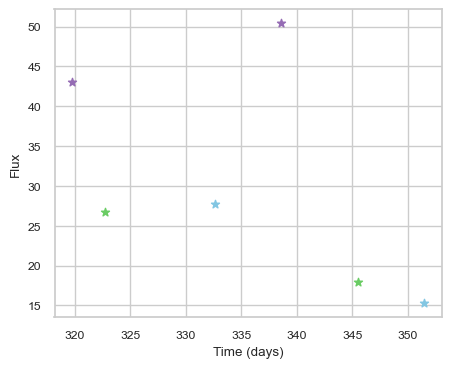

SNIax (4.072932, False)
SNIax (4.226965, False)
SNIax (4.3054085, False)
SNIax (3.62492, False)
SNIax (3.8744655, False)
SNIax (2.8756042, False)
SNIax (3.4750085, False)
SNIax (2.93754, False)
SNIax (3.018341, False)
SNIax (3.6833928, False)
SNIax (3.6915758, False)
SNIax (3.1261504, False)


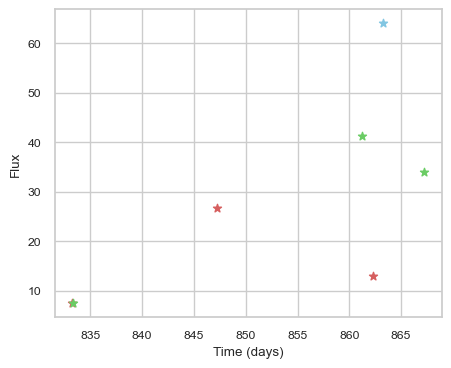

SNIax (3.827126, False)
SNIax (3.9815576, False)
SNIax (3.294542, False)
SNIax (3.397819, False)
SNIax (3.6619773, False)
SNIax (3.6200063, False)
SNIax (2.6660237, False)
SNIax (2.4202561, False)
SNIax (2.995609, False)
SNIax (2.779822, False)
SNIax (2.8697915, False)
SNIax (3.226125, False)
SNIax (4.148867, False)
SNIax (3.8365374, False)


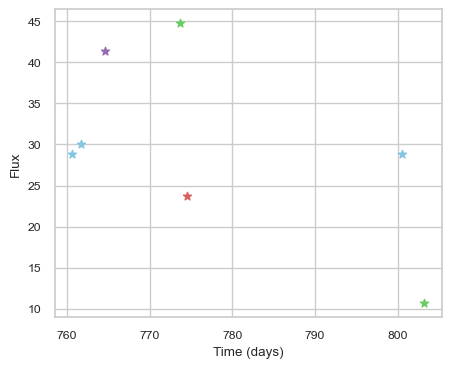

SNIax (4.0479956, False)
SNIax (3.3863382, False)
SNIax (2.9738479, False)
SNIax (3.2633662, False)
SNIax (3.2526765, False)
SNIax (2.932822, False)
SNIax (2.9911664, False)
SNIax (3.2592947, False)
SNIax (3.4771934, False)
SNIax (3.0073292, False)
SNIax (2.5151122, False)
SNIax (2.2988646, False)
SNIax (3.3769853, False)
SNIax (2.8886518, False)


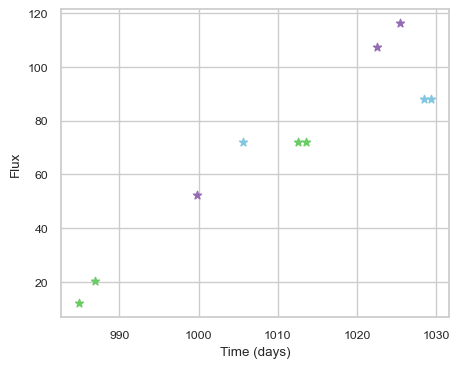

SNIax (3.8546238, False)
SNIax (3.7940285, False)
SNIax (3.3764193, False)
SNIax (2.872932, False)
SNIax (2.7535646, False)
SNIax (2.327277, False)
SNIax (2.5770578, False)
SNIax (2.585287, False)
SNIax (3.186203, False)
SNIax (2.585185, False)
SNIax (2.5140376, False)
SNIax (2.58239, False)
SNIax (3.7002378, False)
SNIax (2.7959697, False)
SNIax (4.0682197, False)
SNIax (2.9859872, False)
SNIax (4.2424617, False)
SNIax (2.6304705, False)
SNIax (3.9986267, False)
SNIax (2.827002, False)


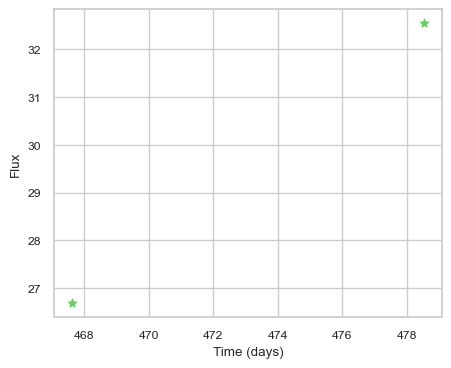

SNIax (4.017169, False)
SNIax (3.6091373, False)
SNIax (3.805196, False)
SNIax (3.591746, False)


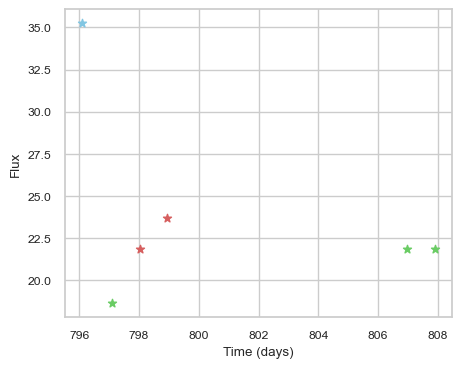

SNIax (3.7815466, False)
SNIax (3.6814845, False)
SNIax (3.315636, False)
SNIax (3.2623038, False)
SNIax (3.7259395, False)
SNIax (3.0007267, False)
SNIax (3.9139307, False)
SNIax (3.0676715, False)
SNIax (3.1963844, False)
SNIax (3.1816583, False)
SNIax (3.3945498, False)
SNIax (3.2581856, False)


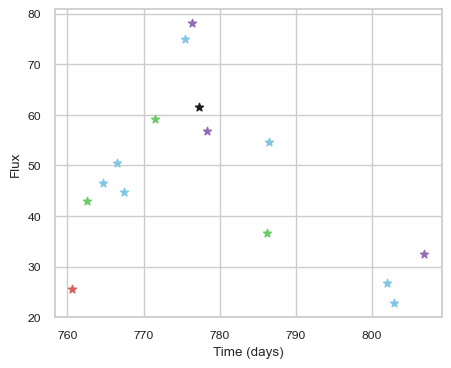

SNIax (3.9029074, False)
SNIax (4.236036, False)
SNIax (4.349581, False)
SNIax (3.0011377, False)
SNIax (3.235022, False)
SNIax (2.669332, False)
SNIax (3.057442, False)
SNIax (2.769787, False)
SNIax (2.9408545, False)
SNIax (2.8521662, False)
SNIax (2.7366214, False)
SNIax (2.6030142, False)
SNIax (2.8750353, False)
SNIax (2.9334743, False)
SNIax (3.1493056, False)
SNIax (3.0519164, False)
SNIax (3.6200397, False)
SNIax (2.8628426, False)
SNIax (3.1029375, False)
SNIax (2.315866, False)
SNIax (2.3565545, False)
SNIax (1.9940583, False)
SNIax (2.3403308, False)
SNIax (2.3589795, False)
SNIax (2.5446582, False)
SNIax (2.1143947, False)
SNIax (2.1491954, False)
SNIax (1.905607, False)
SNIax (2.2706294, False)
SNIax (2.0328705, False)


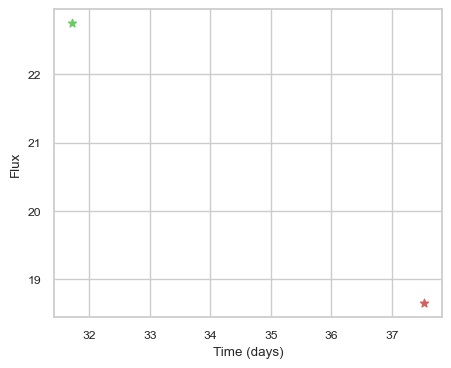

SNIax (3.806415, False)
SNIax (3.0311708, False)
SNIax (3.4291537, False)
SNIax (3.1103506, False)


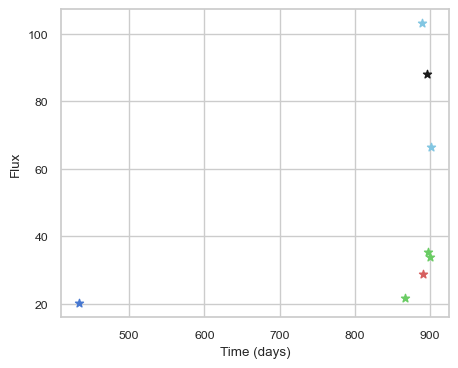

SNIax (3.9796574, False)
SNIax (4.713769, False)
SNIax (3.7735128, False)
SNIax (3.7556355, False)
SNIax (3.7717493, False)
SNIax (4.1034737, False)
SNIax (4.5066276, False)
SNIax (5.0808663, False)
SNIax (5.2846932, False)
SNIax (6.2489367, False)
SNIax (6.3501153, False)
SNIax (6.0061145, False)
SNIax (5.3703175, False)
SNIax (5.7164907, False)
SNIax (5.5678444, False)
SNIax (5.5241356, False)


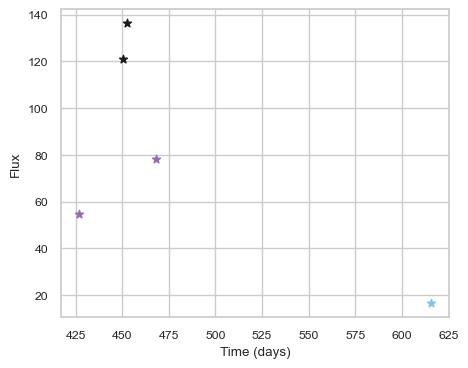

SNIax (4.688959, False)
SNIax (4.7412663, False)
SNIax (5.403244, False)
SNIax (5.010712, False)
SNIax (4.9408374, False)
SNIax (4.785677, False)
SNIax (4.201358, False)
SNIax (4.63769, False)
SNIax (4.3068113, False)
SNIax (4.6770773, False)


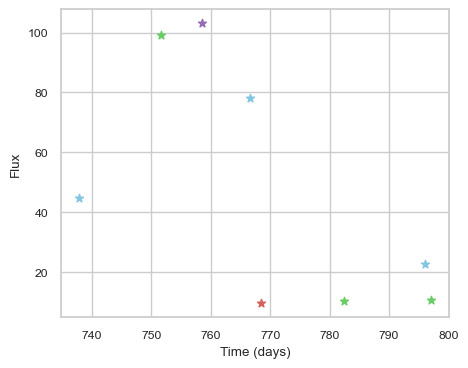

SNIax (4.269339, False)
SNIax (3.947478, False)
SNIax (4.8797746, False)
SNIax (5.424563, False)
SNIax (5.9080405, False)
SNIax (5.9374294, False)
SNIax (5.6675963, False)
SNIax (5.0629363, False)
SNIax (4.9968305, False)
SNIax (5.560436, False)
SNIax (5.435592, False)
SNIax (5.59187, False)
SNIax (5.1651096, False)
SNIax (5.2398686, False)
SNIax (5.2981215, False)
SNIax (5.0800443, False)


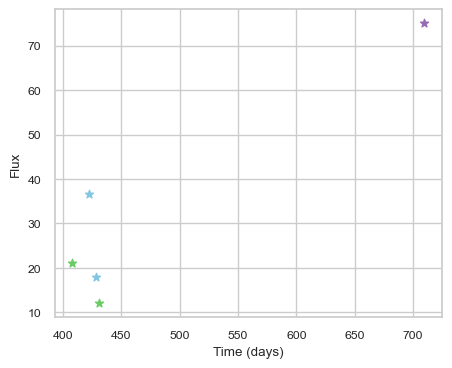

SNIax (4.359577, False)
SNIax (3.536587, False)
SNIax (3.86164, False)
SNIax (3.6668875, False)
SNIax (3.0169888, False)
SNIax (3.1394932, False)
SNIax (3.007798, False)
SNIax (3.3340912, False)
SNIax (4.196424, False)
SNIax (3.9815161, False)


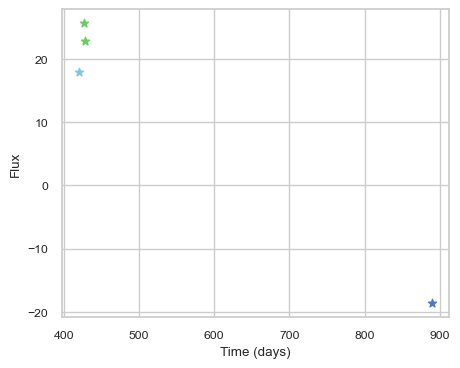

SNIax (4.027168, False)
SNIax (3.619861, False)
SNIax (3.4546063, False)
SNIax (3.4249642, False)
SNIax (3.685048, False)
SNIax (3.4448795, False)
SNIax (4.276063, False)
SNIax (4.837837, False)


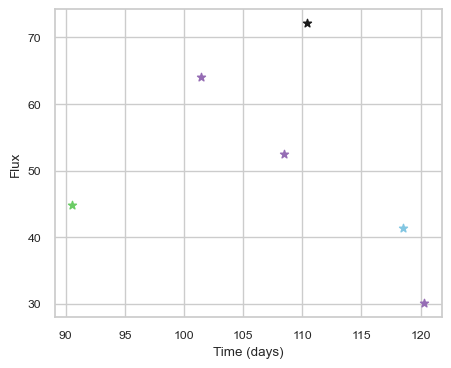

SNIax (3.8877134, False)
SNIax (4.2440643, False)
SNIax (4.2721896, False)
SNIax (3.5074828, False)
SNIax (3.06323, False)
SNIax (3.1016216, False)
SNIax (3.529395, False)
SNIax (4.144371, False)
SNIax (3.5982618, False)
SNIax (3.9765441, False)
SNIax (4.4915204, False)
SNIax (5.1256075, False)


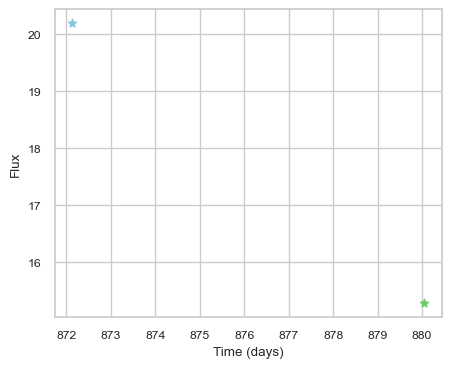

SNIax (4.3065267, False)
SNIax (3.6000385, False)
SNIax (3.6550274, False)
SNIax (3.361049, False)


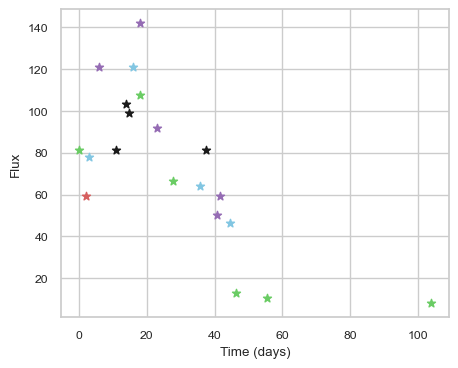

SNIax (4.2836623, False)
SNIax (5.112942, False)
SNIax (4.8181286, False)
SNIax (5.610378, False)
SNIax (4.8782377, False)
SNIax (4.244941, False)
SNIax (4.5603223, False)
SNIax (4.3105235, False)
SNIax (3.510089, False)
SNIax (3.747966, False)
SNIax (3.198512, False)
SNIax (4.249112, False)
SNIax (3.3281605, False)
SNIax (4.4736695, False)
SNIax (3.8187928, False)
SNIax (3.7629821, False)
SNIax (3.8067255, False)
SNIax (4.4281435, False)
SNIax (3.4788988, False)
SNIax (3.474928, False)
SNIax (2.8267508, False)
SNIax (3.1854148, False)
SNIax (3.2278118, False)
SNIax (3.5310504, False)
SNIax (3.2666624, False)
SNIax (3.7088304, False)
SNIax (3.3835733, False)
SNIax (4.0625834, False)
SNIax (3.318446, False)
SNIax (3.6679547, False)
SNIax (3.2589302, False)
SNIax (3.8724687, False)
SNIax (3.123745, False)
SNIax (3.8453362, False)
SNIax (3.1422906, False)
SNIax (2.845702, False)
SNIax (2.9722662, False)
SNIax (2.9869852, False)
SNIax (2.8819406, False)


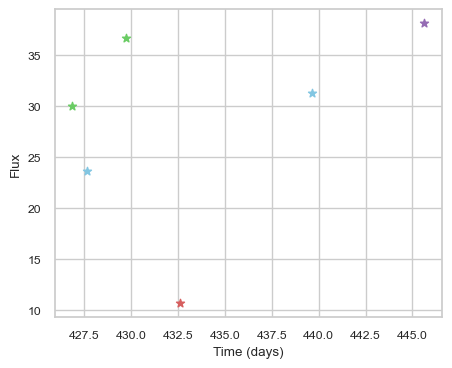

SNIax (4.0782437, False)
SNIax (3.7161653, False)
SNIax (3.8456666, False)
SNIax (3.775779, False)
SNIax (4.4005914, False)
SNIax (3.7911634, False)
SNIax (4.067192, False)
SNIax (3.930633, False)
SNIax (2.9414601, False)
SNIax (2.8346877, False)
SNIax (3.4208539, False)
SNIax (3.4987142, False)


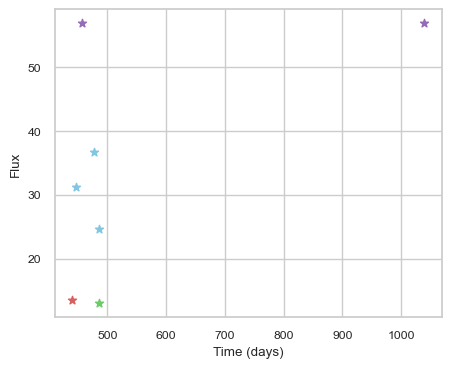

SNIax (3.8790512, False)
SNIax (4.0945654, False)
SNIax (3.464157, False)
SNIax (3.582757, False)
SNIax (3.7398176, False)
SNIax (3.6612017, False)
SNIax (4.08588, False)
SNIax (3.7632155, False)
SNIax (3.9089403, False)
SNIax (3.6790154, False)
SNIax (3.9878433, False)
SNIax (3.582428, False)
SNIax (3.7831316, False)
SNIax (4.0386224, False)


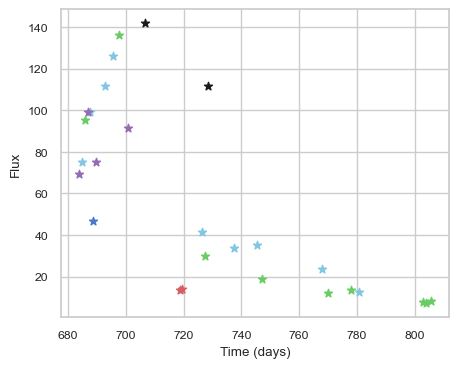

SNIax (3.743603, False)
SNIax (3.8118951, False)
SNIax (3.980538, False)
SNIax (4.1387978, False)
SNIax (3.8809233, False)
SNIax (3.9879947, False)
SNIax (3.6634169, False)
SNIax (3.622267, False)
SNIax (3.986221, False)
SNIax (4.0690727, False)
SNIax (3.5857477, False)
SNIax (3.5773942, False)
SNIax (3.6779513, False)
SNIax (2.9648247, False)
SNIax (3.6718316, False)
SNIax (3.927557, False)
SNIax (3.6094036, False)
SNIax (3.73981, False)
SNIax (4.135951, False)
SNIax (4.684832, False)
SNIax (4.2988253, False)
SNIax (4.4264364, False)
SNIax (3.2007778, False)
SNIax (4.4187946, False)
SNIax (5.0404663, False)
SNIax (4.3116117, False)
SNIax (3.4592805, False)
SNIax (3.4219892, False)
SNIax (3.0836837, False)
SNIax (2.187755, False)
SNIax (1.8922129, False)
SNIax (2.5476468, False)
SNIax (2.42439, False)
SNIax (2.7425992, False)
SNIax (2.4693751, False)
SNIax (1.6263168, False)
SNIax (1.6389792, False)
SNIax (1.676331, False)
SNIax (1.7986737, False)
SNIax (2.1788037, False)
SNIax (2.1266

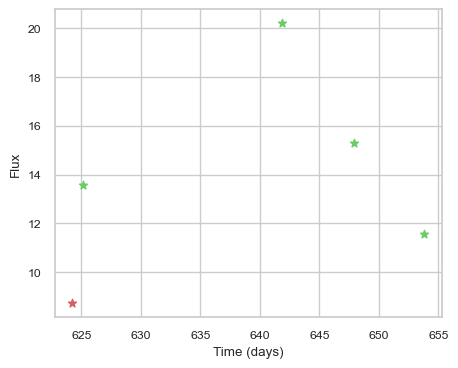

SNIax (3.8950958, False)
SNIax (4.3164997, False)
SNIax (3.7726643, False)
SNIax (3.5803082, False)
SNIax (3.5675635, False)
SNIax (3.0283384, False)
SNIax (3.2707505, False)
SNIax (3.1165924, False)
SNIax (3.5916357, False)
SNIax (3.0549967, False)


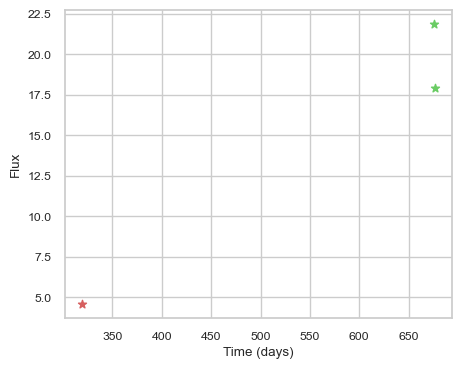

SNIax (3.7421136, False)
SNIax (4.2050824, False)
SNIax (3.8560543, False)
SNIax (3.4456887, False)
SNIax (3.2349966, False)
SNIax (3.4295368, False)


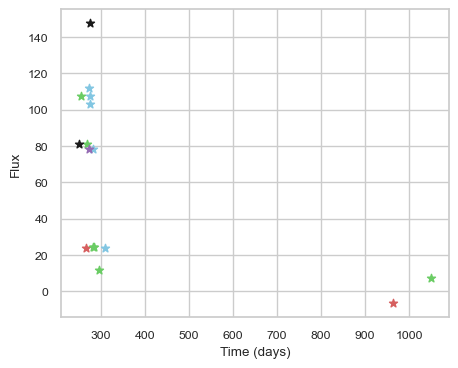

SNIax (4.304032, False)
SNIax (3.9071314, False)
SNIax (4.4344697, False)
SNIax (4.3851113, False)
SNIax (5.3843794, False)
SNIax (4.537686, False)
SNIax (5.6290846, False)
SNIax (5.780618, False)
SNIax (5.9652896, False)
SNIax (6.1515803, False)
SNIax (5.8325624, False)
SNIax (6.0009294, False)
SNIax (6.4986906, False)
SNIax (6.100628, False)
SNIax (5.838834, False)
SNIax (6.127672, False)
SNIax (6.060689, False)
SNIax (6.0765424, False)
SNIax (5.2143626, False)
SNIax (5.795361, False)
SNIax (5.2660465, False)
SNIax (5.2137556, False)
SNIax (5.2415204, False)
SNIax (5.4007397, False)
SNIax (5.5093317, False)
SNIax (5.7723947, False)
SNIax (5.3461056, False)
SNIax (5.5161185, False)
SNIax (5.757676, False)
SNIax (5.1863694, False)
SNIax (6.094646, False)
SNIax (5.3778605, False)


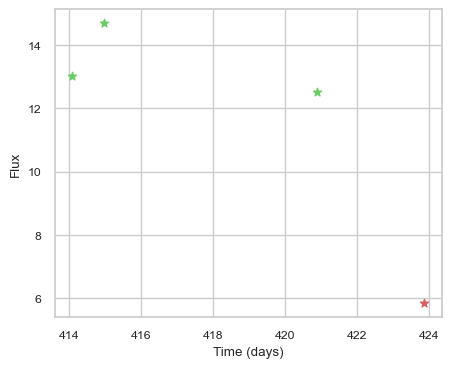

SNIax (3.6749063, False)
SNIax (3.9529006, False)
SNIax (3.4491386, False)
SNIax (3.6303062, False)
SNIax (3.667621, False)
SNIax (3.8073864, False)
SNIax (3.870053, False)
SNIax (3.5648212, False)


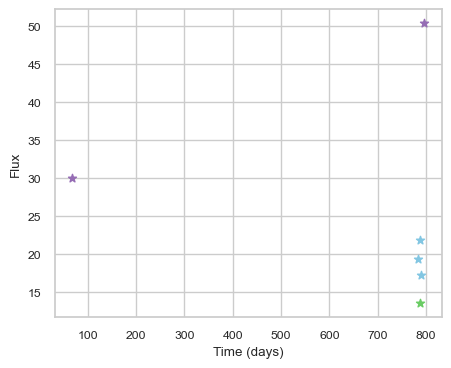

SNIax (4.292694, False)
SNIax (3.9014866, False)
SNIax (4.027505, False)
SNIax (3.4505565, False)
SNIax (3.0948155, False)
SNIax (3.2827604, False)
SNIax (3.0881464, False)
SNIax (2.9561565, False)
SNIax (3.406794, False)
SNIax (3.0295527, False)
SNIax (2.9077487, False)
SNIax (2.9777806, False)


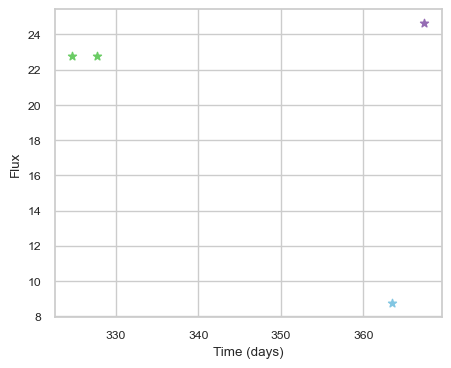

SNIax (3.957495, False)
SNIax (3.9769194, False)
SNIax (3.7083485, False)
SNIax (3.6857052, False)
SNIax (3.8178983, False)
SNIax (4.4941397, False)
SNIax (4.771434, False)
SNIax (4.3677545, False)


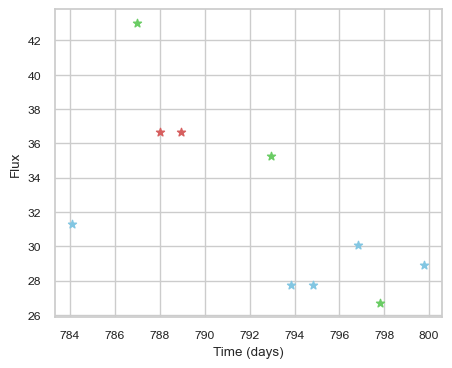

SNIax (3.8065846, False)
SNIax (3.6092465, False)
SNIax (3.5319233, False)
SNIax (3.3135242, False)
SNIax (3.52619, False)
SNIax (3.1559756, False)
SNIax (3.7291474, False)
SNIax (3.2367105, False)
SNIax (3.491122, False)
SNIax (3.9983423, False)
SNIax (4.495041, False)
SNIax (4.5045824, False)
SNIax (4.384888, False)
SNIax (4.285988, False)
SNIax (4.544441, False)
SNIax (4.1988387, False)
SNIax (4.425994, False)
SNIax (4.686331, False)
SNIax (4.8797393, False)
SNIax (4.457844, False)


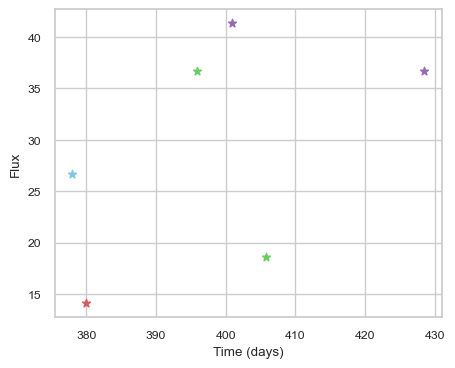

SNIax (4.125349, False)
SNIax (3.5764678, False)
SNIax (3.031828, False)
SNIax (2.5918918, False)
SNIax (3.0974433, False)
SNIax (2.676984, False)
SNIax (3.5158162, False)
SNIax (2.8802965, False)
SNIax (2.665437, False)
SNIax (2.8052423, False)
SNIax (3.0267596, False)
SNIax (2.9792683, False)


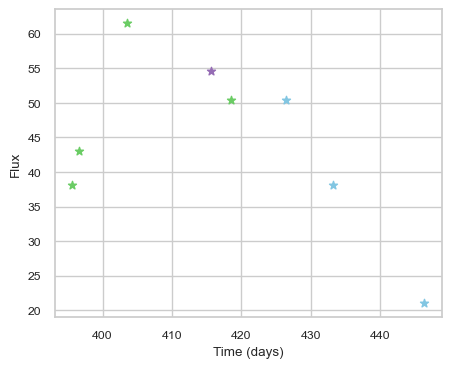

SNIax (4.099994, False)
SNIax (3.412169, False)
SNIax (3.4559588, False)
SNIax (3.7413728, False)
SNIax (4.1662493, False)
SNIax (4.8015695, False)
SNIax (5.169709, False)
SNIax (4.2726727, False)
SNIax (4.684951, False)
SNIax (4.6695333, False)
SNIax (4.6857376, False)
SNIax (4.2111816, False)
SNIax (4.195854, False)
SNIax (3.9013748, False)
SNIax (3.964825, False)
SNIax (3.7396812, False)


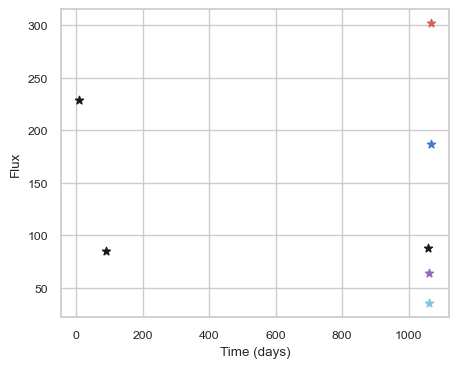

SNIax (3.825956, False)
SNIax (3.1429796, False)
SNIax (3.6863217, False)
SNIax (3.701333, False)
SNIax (3.731815, False)
SNIax (3.7588851, False)
SNIax (3.8382092, False)
SNIax (3.604499, False)
SNIax (3.3452747, False)
SNIax (4.358968, False)
SNIax (4.27378, False)
SNIax (4.4090734, False)
SNIax (3.4939475, False)
SNIax (4.655326, False)


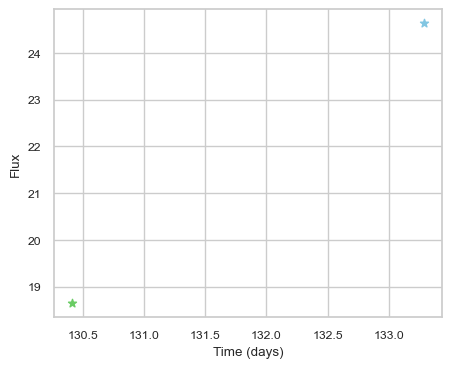

SNIax (3.8094132, False)
SNIax (3.7837245, False)
SNIax (3.8045874, False)
SNIax (3.6790154, False)


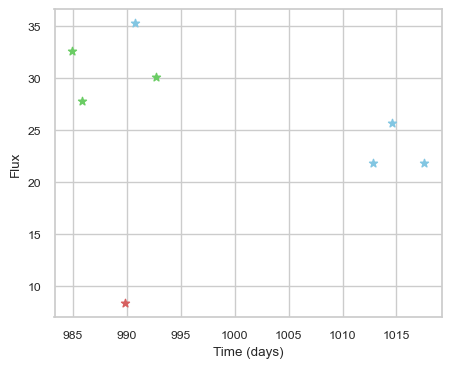

SNIax (4.3001294, False)
SNIax (4.29468, False)
SNIax (4.24284, False)
SNIax (3.9821746, False)
SNIax (4.379157, False)
SNIax (3.7619498, False)
SNIax (3.9666955, False)
SNIax (4.337893, False)
SNIax (4.3360076, False)
SNIax (4.4182405, False)
SNIax (4.6147976, False)
SNIax (4.218495, False)
SNIax (3.6617622, False)
SNIax (3.6825304, False)
SNIax (3.336884, False)
SNIax (2.958417, False)


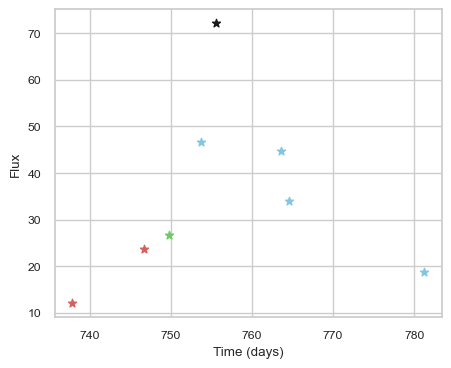

SNIax (3.8254328, False)
SNIax (3.6705594, False)
SNIax (3.2325904, False)
SNIax (2.9086263, False)
SNIax (2.3723328, False)
SNIax (2.392132, False)
SNIax (4.1326046, False)
SNIax (3.3698604, False)
SNIax (3.9892142, False)
SNIax (3.1796875, False)
SNIax (3.262085, False)
SNIax (4.5264835, False)
SNIax (4.5272694, False)
SNIax (3.9466856, False)
SNIax (4.2000093, False)
SNIax (3.231434, False)


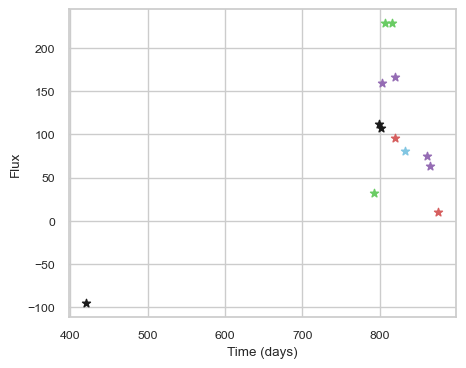

SNIax (4.010817, False)
SNIax (4.090867, False)
SNIax (4.022119, False)
SNIax (3.6237097, False)
SNIax (3.8492153, False)
SNIax (4.0763144, False)
SNIax (3.9250765, False)
SNIax (3.5772817, False)
SNIax (4.1042547, False)
SNIax (3.7006469, False)
SNIax (4.1695423, False)
SNIax (3.7254224, False)
SNIax (4.928473, False)
SNIax (4.393585, False)
SNIax (5.052478, False)
SNIax (4.3143225, False)
SNIax (5.069392, False)
SNIax (4.75435, False)
SNIax (5.3699756, False)
SNIax (5.3333807, False)
SNIax (5.006894, False)
SNIax (4.9630594, False)
SNIax (4.9085727, False)
SNIax (5.0266767, False)
SNIax (5.0474186, False)
SNIax (5.391154, False)


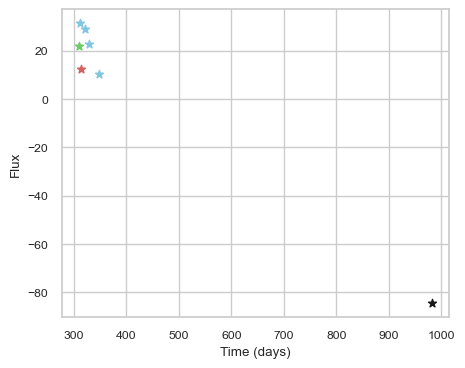

SNIax (4.0090623, False)
SNIax (3.9005027, False)
SNIax (3.4615135, False)
SNIax (3.4030335, False)
SNIax (3.2549198, False)
SNIax (2.6583989, False)
SNIax (2.8155432, False)
SNIax (2.1461024, False)
SNIax (2.7055945, False)
SNIax (2.5969293, False)
SNIax (3.132589, False)
SNIax (2.8169093, False)
SNIax (3.732431, False)
SNIax (3.6323738, False)


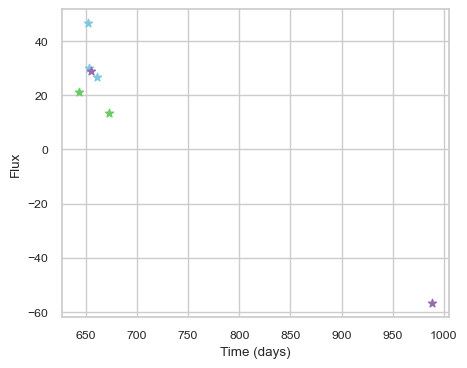

SNIax (4.2888865, False)
SNIax (3.9817688, False)
SNIax (3.605368, False)
SNIax (4.637388, False)
SNIax (4.790537, False)
SNIax (4.450784, False)
SNIax (3.7931178, False)
SNIax (4.0997972, False)
SNIax (3.8463705, False)
SNIax (3.915944, False)
SNIax (3.5419626, False)
SNIax (4.0291934, False)
SNIax (4.39659, False)
SNIax (4.1387057, False)


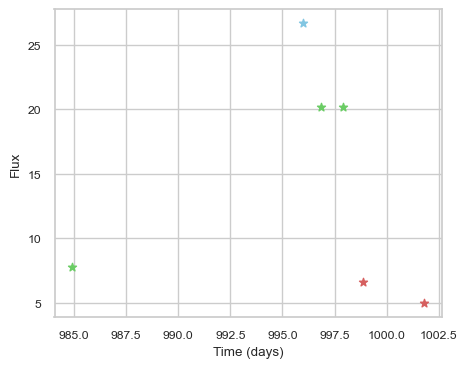

SNIax (4.4609766, False)
SNIax (4.0605783, False)
SNIax (3.9111068, False)
SNIax (3.7028174, False)
SNIax (2.9282563, False)
SNIax (2.912387, False)
SNIax (2.8663263, False)
SNIax (2.9211254, False)
SNIax (2.87211, False)
SNIax (2.9254832, False)
SNIax (3.567516, False)
SNIax (3.0076087, False)


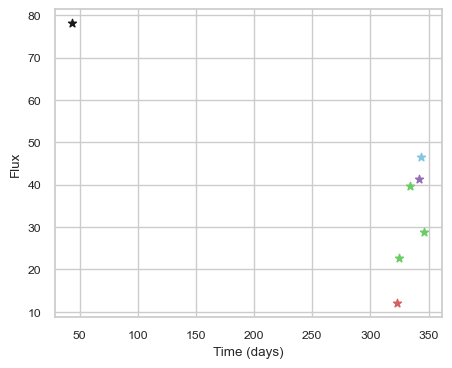

SNIax (4.5360665, False)
SNIax (3.7968113, False)
SNIax (4.1303396, False)
SNIax (3.8909447, False)
SNIax (3.204334, False)
SNIax (2.5734377, False)
SNIax (3.18311, False)
SNIax (2.8808284, False)
SNIax (2.9952579, False)
SNIax (2.337673, False)
SNIax (2.403355, False)
SNIax (2.0562198, False)
SNIax (2.514984, False)
SNIax (2.2990909, False)


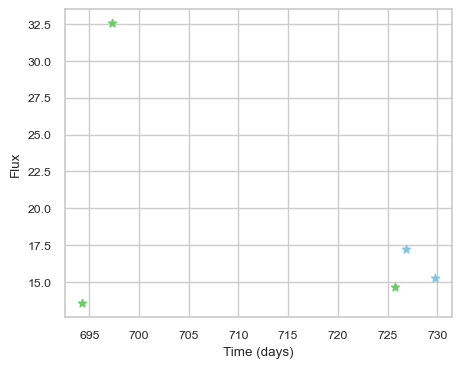

SNIax (5.0738516, False)
SNIax (4.8958426, False)
SNIax (3.3345282, False)
SNIax (3.8960304, False)
SNIax (3.1484957, False)
SNIax (4.17412, False)
SNIax (3.031281, False)
SNIax (4.2631965, False)
SNIax (3.397424, False)
SNIax (4.1912856, False)


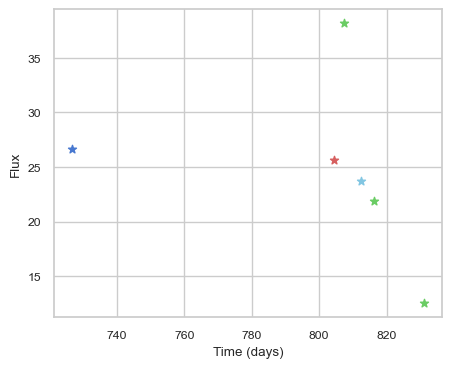

SNIax (3.802435, False)
SNIax (4.7585664, False)
SNIax (3.7617939, False)
SNIax (4.5868893, False)
SNIax (3.590296, False)
SNIax (3.1709654, False)
SNIax (3.549612, False)
SNIax (3.6159594, False)
SNIax (3.4087434, False)
SNIax (3.7848287, False)
SNIax (3.2721314, False)
SNIax (3.481082, False)


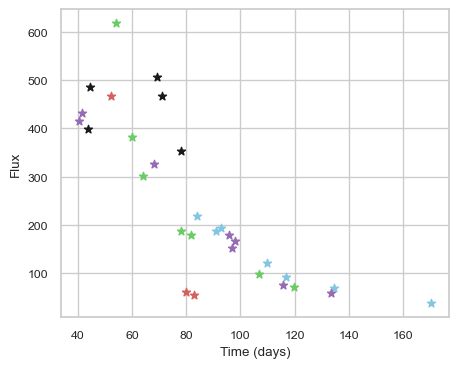

SNIax (5.0582237, False)
SNIax (5.539831, False)
SNIax (4.3316765, False)
SNIax (4.3015275, False)
SNIax (3.8440962, False)
SNIax (3.8951857, False)
SNIax (4.341918, False)
SNIax (3.901781, False)
SNIax (3.1656847, False)
SNIax (4.5597, False)
SNIax (5.0907474, False)
SNIax (5.6485558, False)
SNIax (5.3167562, False)
SNIax (5.5566044, False)
SNIax (4.291589, False)
SNIax (4.220023, False)
SNIax (3.4616182, False)
SNIax (3.9945085, False)
SNIax (3.514463, False)
SNIax (4.1648664, False)
SNIax (3.7317932, False)
SNIax (3.4758952, False)
SNIax (2.7935607, False)
SNIax (3.3248448, False)
SNIax (2.7198641, False)
SNIax (3.33275, False)
SNIax (3.6971931, False)
SNIax (3.4051526, False)
SNIax (3.2722046, False)
SNIax (3.240715, False)
SNIax (2.525491, False)
SNIax (3.3961637, False)
SNIax (3.1653647, False)
SNIax (3.0305457, False)
SNIax (2.7538095, False)
SNIax (3.1092932, False)
SNIax (2.6515632, False)
SNIax (3.2310073, False)
SNIax (3.008279, False)
SNIax (3.009853, False)
SNIax (3.493519

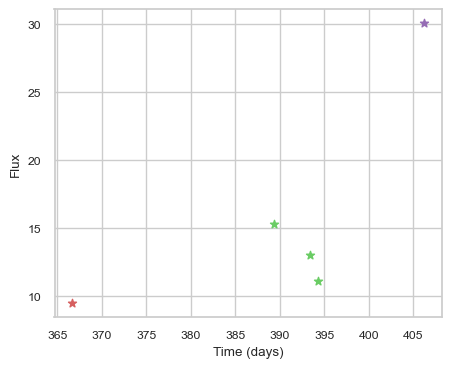

SNIax (4.5031567, False)
SNIax (3.5612621, False)
SNIax (3.9599154, False)
SNIax (3.5997162, False)
SNIax (4.1407146, False)
SNIax (3.6878648, False)
SNIax (3.8367243, False)
SNIax (3.6052678, False)
SNIax (4.047227, False)
SNIax (3.6320345, False)


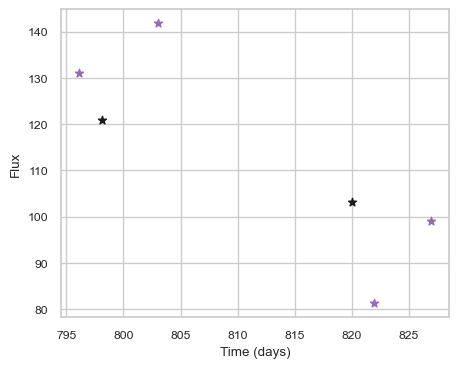

SNIax (3.8426895, False)
SNIax (3.6596653, False)
SNIax (4.256728, False)
SNIax (4.0085645, False)
SNIax (3.5328434, False)
SNIax (3.853274, False)
SNIax (3.5506117, False)
SNIax (3.753074, False)
SNIax (3.6358223, False)
SNIax (3.788491, False)
SNIax (3.527883, False)
SNIax (3.5220234, False)


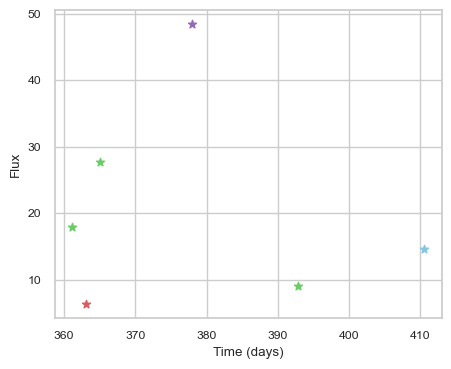

SNIax (4.2344995, False)
SNIax (3.512238, False)
SNIax (3.4765675, False)
SNIax (3.1180453, False)
SNIax (3.0420475, False)
SNIax (3.5086098, False)
SNIax (4.1960664, False)
SNIax (3.9150164, False)
SNIax (5.383691, False)
SNIax (4.348469, False)
SNIax (4.4778795, False)
SNIax (4.080867, False)


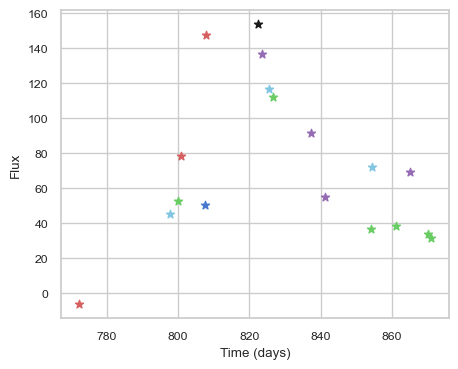

SNIax (3.811213, False)
SNIax (3.8870761, False)
SNIax (3.145948, False)
SNIax (3.5474846, False)
SNIax (3.4730728, False)
SNIax (3.3019934, False)
SNIax (3.384847, False)
SNIax (3.670131, False)
SNIax (3.860597, False)
SNIax (5.0093293, False)
SNIax (4.04441, False)
SNIax (3.662713, False)
SNIax (3.178609, False)
SNIax (4.2190714, False)
SNIax (3.743664, False)
SNIax (3.1010678, False)
SNIax (3.2764602, False)
SNIax (3.0497007, False)
SNIax (3.51095, False)
SNIax (3.875055, False)
SNIax (3.9144537, False)
SNIax (4.12876, False)
SNIax (4.2334023, False)
SNIax (3.7669916, False)
SNIax (3.316261, False)
SNIax (3.6125503, False)
SNIax (3.633339, False)
SNIax (3.5567603, False)
SNIax (4.0958257, False)
SNIax (4.0290647, False)
SNIax (3.6697464, False)
SNIax (4.3293138, False)
SNIax (3.800908, False)
SNIax (4.3059983, False)
SNIax (3.6341476, False)
SNIax (4.3924437, False)


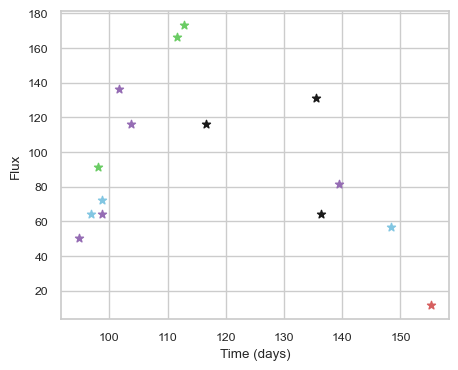

SNIax (3.7638314, False)
SNIax (3.8284159, False)
SNIax (3.53095, False)
SNIax (3.6445496, False)
SNIax (3.5519068, False)
SNIax (3.626728, False)
SNIax (4.333299, False)
SNIax (3.8077598, False)
SNIax (4.1094856, False)
SNIax (3.680435, False)
SNIax (4.3441353, False)
SNIax (3.8652961, False)
SNIax (4.539416, False)
SNIax (4.269185, False)
SNIax (3.6928926, False)
SNIax (3.2645564, False)
SNIax (5.0385275, False)
SNIax (3.9855056, False)
SNIax (5.1855497, False)
SNIax (4.131364, False)
SNIax (5.2229495, False)
SNIax (4.689054, False)
SNIax (5.132299, False)
SNIax (4.7772865, False)
SNIax (5.132707, False)
SNIax (4.102702, False)
SNIax (4.3782, False)
SNIax (4.711364, False)
SNIax (4.643417, False)
SNIax (4.8874617, False)


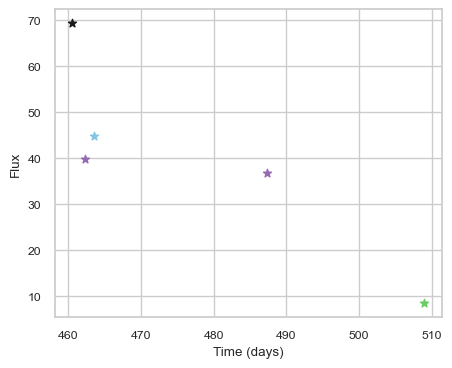

SNIax (4.169267, False)
SNIax (4.0877724, False)
SNIax (4.56626, False)
SNIax (3.9357662, False)
SNIax (3.7655356, False)
SNIax (3.762759, False)
SNIax (3.4363716, False)
SNIax (3.0169258, False)
SNIax (3.1510284, False)
SNIax (3.4221833, False)


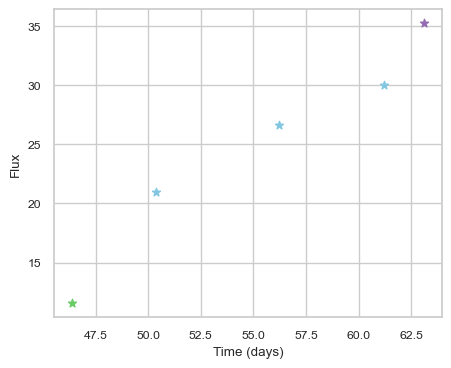

SNIax (5.297405, False)
SNIax (3.8880746, False)
SNIax (3.66114, False)
SNIax (2.906401, False)
SNIax (2.848233, False)
SNIax (2.827992, False)
SNIax (3.113054, False)
SNIax (3.24669, False)
SNIax (3.2669, False)
SNIax (3.2933006, False)


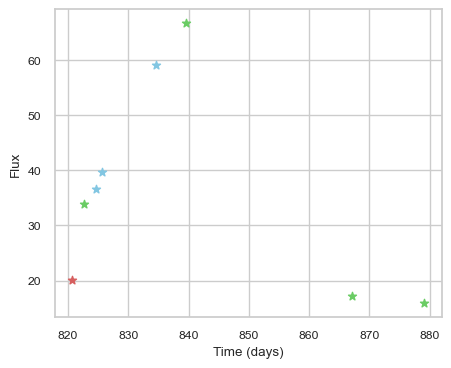

SNIax (3.8831928, False)
SNIax (4.077643, False)
SNIax (3.878948, False)
SNIax (2.8318596, False)
SNIax (3.7956638, False)
SNIax (3.3054924, False)
SNIax (3.4301615, False)
SNIax (3.596961, False)
SNIax (3.4322433, False)
SNIax (3.4424462, False)
SNIax (3.0297, False)
SNIax (2.9511025, False)
SNIax (3.1106799, False)
SNIax (3.2066271, False)
SNIax (2.5918546, False)
SNIax (2.741971, False)


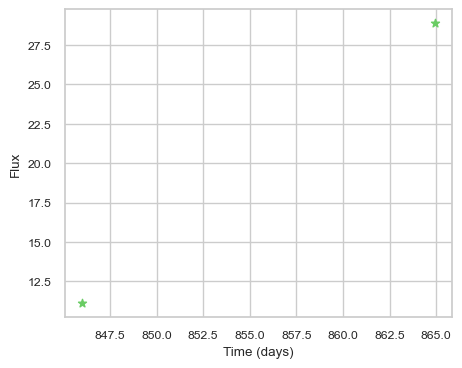

SNIax (4.0513186, False)
SNIax (3.3550596, False)
SNIax (3.2572057, False)
SNIax (2.9867487, False)


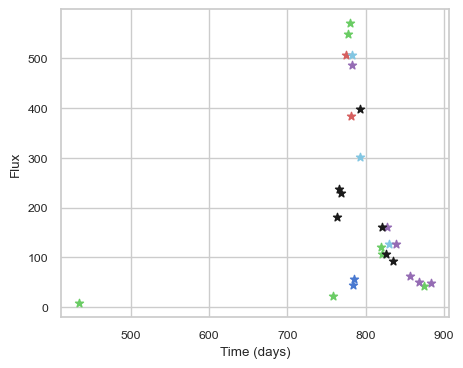

SNIax (3.832435, False)
SNIax (3.9087055, False)
SNIax (3.4745276, False)
SNIax (3.2074177, False)
SNIax (3.0990841, False)
SNIax (2.931855, False)
SNIax (3.4403086, False)
SNIax (3.0065277, False)
SNIax (3.4876804, False)
SNIax (3.0795903, False)
SNIax (2.9255035, False)
SNIax (2.8944132, False)
SNIax (3.4114692, False)
SNIax (3.0870721, False)
SNIax (4.3157234, False)
SNIax (3.9292903, False)
SNIax (4.5392127, False)
SNIax (4.7979608, False)
SNIax (5.1809254, False)
SNIax (4.9392357, False)
SNIax (5.34331, False)
SNIax (4.4690814, False)
SNIax (3.792812, False)
SNIax (3.3931184, False)
SNIax (4.798666, False)
SNIax (4.0772552, False)
SNIax (4.2777395, False)
SNIax (4.9888883, False)
SNIax (3.2829518, False)
SNIax (3.512348, False)
SNIax (3.1359794, False)
SNIax (3.4894946, False)
SNIax (3.0184, False)
SNIax (3.7358425, False)
SNIax (2.9574685, False)
SNIax (3.489192, False)
SNIax (3.2215142, False)
SNIax (3.9559162, False)
SNIax (3.823827, False)
SNIax (3.273174, False)
SNIax (2.8150

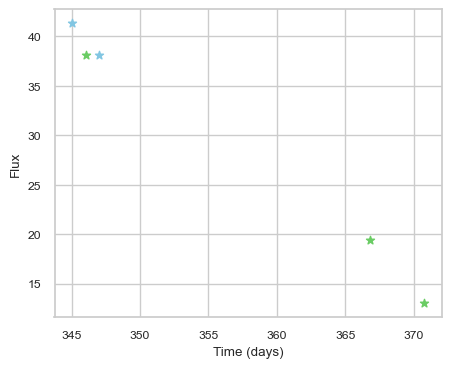

SNIax (4.139589, False)
SNIax (4.1769385, False)
SNIax (3.6379957, False)
SNIax (3.9589689, False)
SNIax (4.076426, False)
SNIax (4.2347155, False)
SNIax (3.6310534, False)
SNIax (2.9227903, False)
SNIax (3.2400296, False)
SNIax (3.0230222, False)


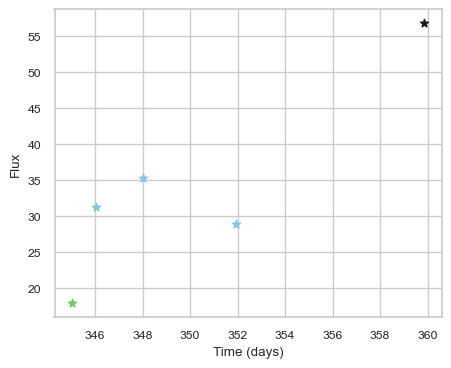

SNIax (4.9038105, False)
SNIax (4.538228, False)
SNIax (4.1480484, False)
SNIax (5.366708, False)
SNIax (5.016513, False)
SNIax (5.553136, False)
SNIax (5.4667625, False)
SNIax (5.718444, False)
SNIax (5.135031, False)
SNIax (6.2062273, False)


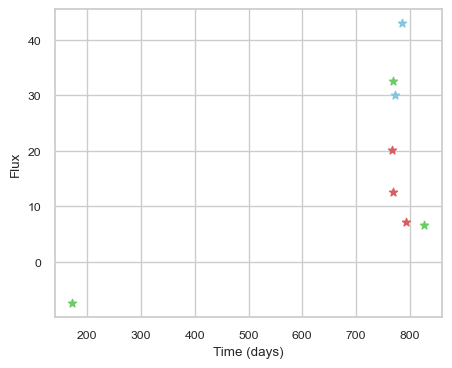

SNIax (4.002687, False)
SNIax (4.279821, False)
SNIax (3.9526956, False)
SNIax (4.2648993, False)
SNIax (4.0634513, False)
SNIax (4.047601, False)
SNIax (3.972543, False)
SNIax (2.4855294, False)
SNIax (3.1406567, False)
SNIax (2.5992656, False)
SNIax (2.5271463, False)
SNIax (2.6968262, False)
SNIax (2.971154, False)
SNIax (3.2945733, False)
SNIax (3.30367, False)
SNIax (2.9495227, False)


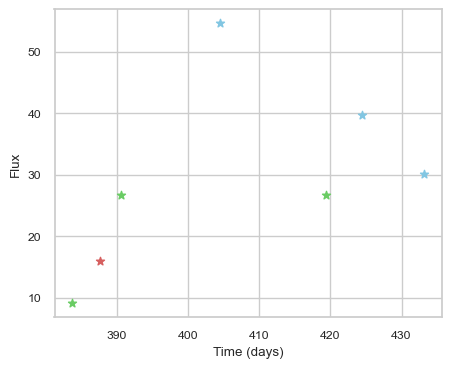

SNIax (3.9341373, False)
SNIax (3.4625304, False)
SNIax (3.498588, False)
SNIax (3.781165, False)
SNIax (3.251178, False)
SNIax (2.4199233, False)
SNIax (2.4981067, False)
SNIax (3.3188643, False)
SNIax (3.0822773, False)
SNIax (2.9306052, False)
SNIax (3.1891866, False)
SNIax (3.0783741, False)
SNIax (2.8119767, False)
SNIax (2.8598437, False)


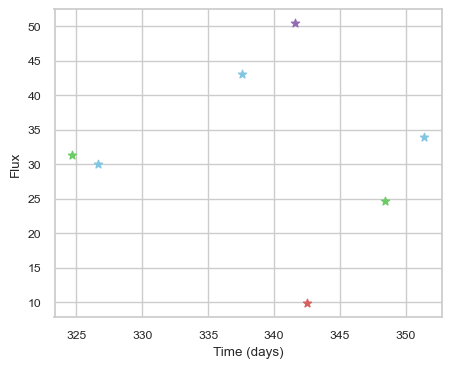

SNIax (3.9953723, False)
SNIax (4.042125, False)
SNIax (3.636761, False)
SNIax (3.5490723, False)
SNIax (3.5553148, False)
SNIax (2.8385193, False)
SNIax (3.567571, False)
SNIax (2.5378902, False)
SNIax (3.605871, False)
SNIax (3.2030902, False)
SNIax (2.9989352, False)
SNIax (2.3623195, False)
SNIax (3.2862687, False)
SNIax (2.437232, False)


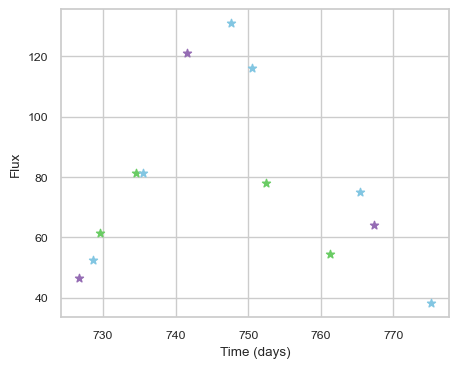

SNIax (3.8821383, False)
SNIax (3.2233608, False)
SNIax (3.4203985, False)
SNIax (3.6978788, False)
SNIax (3.4132876, False)
SNIax (3.4206364, False)
SNIax (4.3026953, False)
SNIax (4.364505, False)
SNIax (4.114265, False)
SNIax (4.181156, False)
SNIax (4.5748305, False)
SNIax (3.9901786, False)
SNIax (3.7880528, False)
SNIax (3.4527855, False)
SNIax (3.6845217, False)
SNIax (3.5865989, False)
SNIax (3.4144297, False)
SNIax (4.0384216, False)
SNIax (3.9048483, False)
SNIax (4.4685497, False)
SNIax (4.1157484, False)
SNIax (4.2442265, False)
SNIax (4.1287055, False)
SNIax (4.3495502, False)
SNIax (4.0633245, False)
SNIax (4.25124, False)


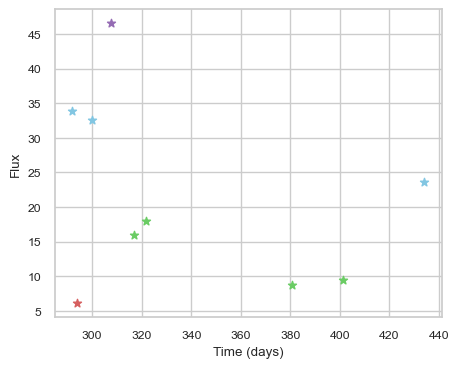

SNIax (3.8721294, False)
SNIax (4.088348, False)
SNIax (3.3808858, False)
SNIax (3.8510482, False)
SNIax (3.459821, False)
SNIax (3.7406132, False)
SNIax (3.4616702, False)
SNIax (3.8701146, False)
SNIax (3.5372381, False)
SNIax (3.3744652, False)
SNIax (3.6244285, False)
SNIax (3.438654, False)
SNIax (3.4947338, False)
SNIax (3.4911933, False)
SNIax (3.238814, False)
SNIax (3.3274887, False)
SNIax (3.5761425, False)
SNIax (3.3197668, False)


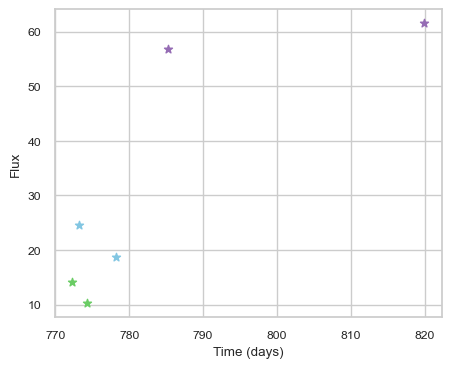

SNIax (3.9126678, False)
SNIax (3.4317732, False)
SNIax (3.065239, False)
SNIax (3.1803162, False)
SNIax (3.3543003, False)
SNIax (3.0423586, False)
SNIax (3.0274324, False)
SNIax (3.1436412, False)
SNIax (2.935937, False)
SNIax (3.1424613, False)
SNIax (3.3947845, False)
SNIax (3.8062797, False)


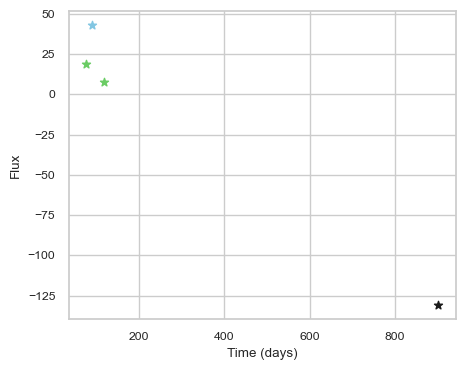

SNIax (4.6244974, False)
SNIax (4.014719, False)
SNIax (4.1512504, False)
SNIax (4.9949684, False)
SNIax (4.4634676, False)
SNIax (3.8838, False)
SNIax (4.502517, False)
SNIax (4.4854608, False)


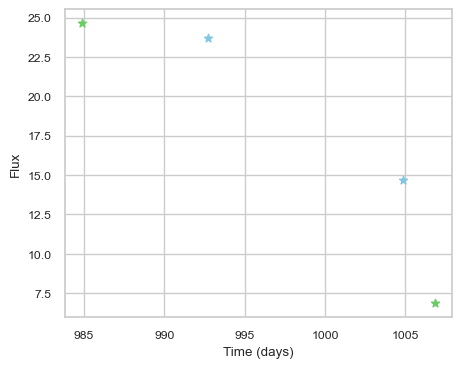

SNIax (3.9453368, False)
SNIax (3.8326428, False)
SNIax (3.3578136, False)
SNIax (4.099202, False)
SNIax (4.105484, False)
SNIax (4.510736, False)
SNIax (4.5336647, False)
SNIax (4.9386587, False)


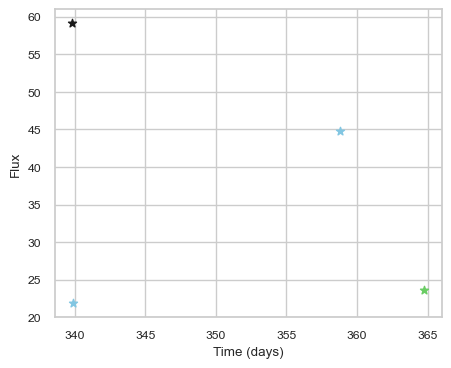

SNIax (3.9334834, False)
SNIax (3.8352249, False)
SNIax (3.6932878, False)
SNIax (3.6118703, False)
SNIax (3.2235622, False)
SNIax (3.0491884, False)
SNIax (3.2017844, False)
SNIax (2.8674803, False)


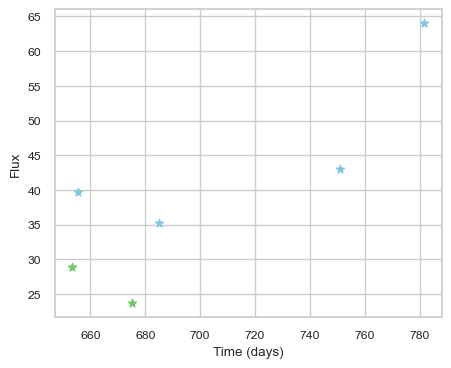

SNIax (3.907834, False)
SNIax (4.120693, False)
SNIax (3.5815632, False)
SNIax (3.8822055, False)
SNIax (3.2007782, False)
SNIax (3.4221306, False)
SNIax (3.9033241, False)
SNIax (3.8786047, False)
SNIax (5.3130074, False)
SNIax (4.8734436, False)
SNIax (6.088846, False)
SNIax (5.5189357, False)


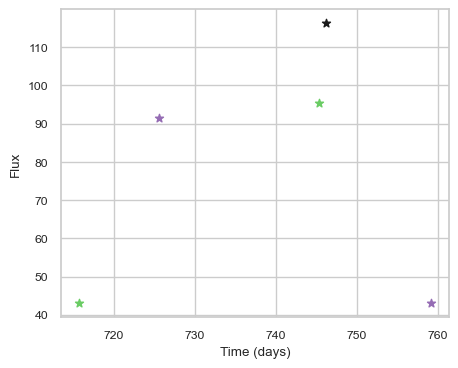

SNIax (3.8642864, False)
SNIax (3.3573391, False)
SNIax (2.7341332, False)
SNIax (3.947628, False)
SNIax (5.1322856, False)
SNIax (5.3858957, False)
SNIax (5.787717, False)
SNIax (5.942732, False)
SNIax (5.395466, False)
SNIax (6.061764, False)


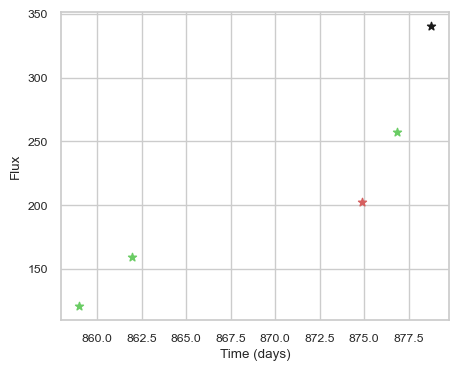

SNIax (3.524705, False)
SNIax (3.6759505, False)
SNIax (3.9028203, False)
SNIax (3.765444, False)
SNIax (3.83136, False)
SNIax (3.6679475, False)
SNIax (3.473272, False)
SNIax (3.3599591, False)
SNIax (3.4173594, False)
SNIax (4.7772937, False)


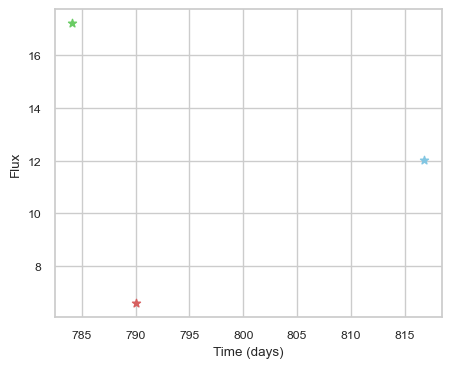

SNIax (4.095413, False)
SNIax (3.399921, False)
SNIax (3.115083, False)
SNIax (3.2225647, False)
SNIax (3.3126287, False)
SNIax (4.201293, False)


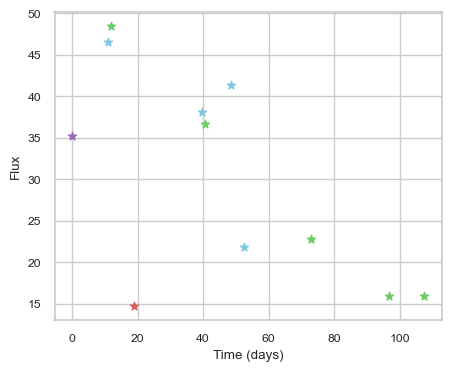

SNIax (4.2728386, False)
SNIax (4.252035, False)
SNIax (4.560935, False)
SNIax (4.717522, False)
SNIax (4.812985, False)
SNIax (4.493229, False)
SNIax (4.8796096, False)
SNIax (4.876053, False)
SNIax (4.33293, False)
SNIax (4.0120554, False)
SNIax (4.759425, False)
SNIax (4.677823, False)
SNIax (5.2423577, False)
SNIax (5.0844774, False)
SNIax (4.9065576, False)
SNIax (4.518923, False)
SNIax (5.0463114, False)
SNIax (5.2932625, False)
SNIax (5.482799, False)
SNIax (5.0565143, False)
SNIax (5.1400228, False)


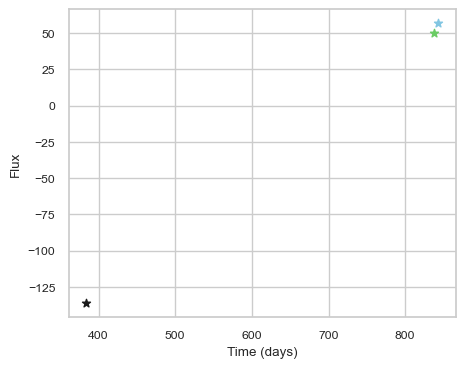

SNIax (3.7561386, False)
SNIax (3.6892104, False)
SNIax (3.8021393, False)
SNIax (3.3054035, False)
SNIax (3.4412718, False)
SNIax (2.764844, False)


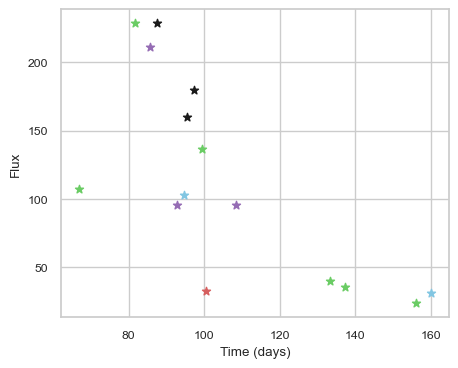

SNIax (3.7543592, False)
SNIax (4.092172, False)
SNIax (3.2484977, False)
SNIax (3.5934925, False)
SNIax (3.7830775, False)
SNIax (3.123534, False)
SNIax (4.109906, False)
SNIax (4.237755, False)
SNIax (3.2435164, False)
SNIax (3.0072608, False)
SNIax (3.4248452, False)
SNIax (3.2811997, False)
SNIax (3.789323, False)
SNIax (4.059459, False)
SNIax (3.7313519, False)
SNIax (4.1820602, False)
SNIax (3.4033823, False)
SNIax (3.7061706, False)
SNIax (3.0745213, False)
SNIax (3.5407405, False)
SNIax (3.0746176, False)
SNIax (3.294861, False)
SNIax (3.2424178, False)
SNIax (2.9501336, False)
SNIax (2.9926152, False)
SNIax (3.0434537, False)
SNIax (2.6328764, False)
SNIax (2.9597104, False)
SNIax (2.9227002, False)
SNIax (2.5974956, False)


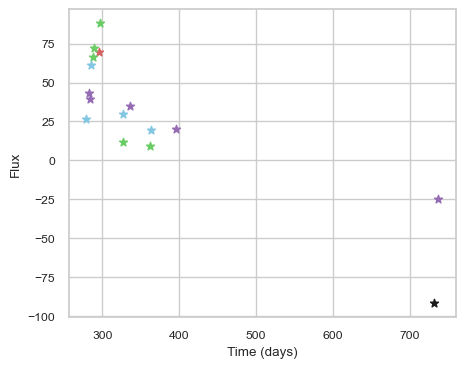

SNIax (4.021769, False)
SNIax (4.0734897, False)
SNIax (3.5251727, False)
SNIax (3.86369, False)
SNIax (4.0456085, False)
SNIax (3.9614336, False)
SNIax (3.89411, False)
SNIax (3.5383067, False)
SNIax (3.346486, False)
SNIax (3.1056259, False)
SNIax (3.0034232, False)
SNIax (2.91706, False)
SNIax (2.8755243, False)
SNIax (2.6368089, False)
SNIax (3.2717972, False)
SNIax (2.9073925, False)
SNIax (3.9241374, False)
SNIax (3.5689943, False)
SNIax (2.1190312, False)
SNIax (1.6521316, False)
SNIax (1.841803, False)
SNIax (2.3801475, False)
SNIax (2.8276815, False)
SNIax (1.9791225, False)
SNIax (2.3856788, False)
SNIax (1.7274181, False)
SNIax (2.220166, False)
SNIax (2.167096, False)
SNIax (2.4312425, False)
SNIax (2.6908438, False)
SNIax (2.8969166, False)
SNIax (3.104697, False)


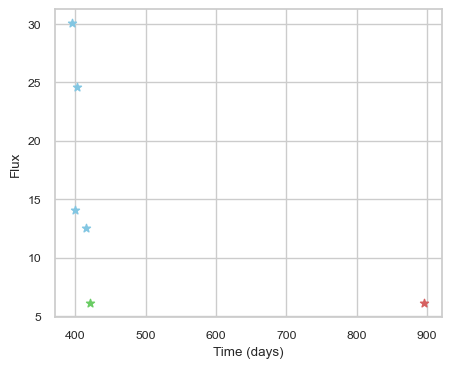

SNIax (4.1454706, False)
SNIax (3.483252, False)
SNIax (3.34065, False)
SNIax (3.4089556, False)
SNIax (3.3039854, False)
SNIax (3.218936, False)
SNIax (3.0842226, False)
SNIax (3.3871577, False)
SNIax (3.7607589, False)
SNIax (3.3090081, False)
SNIax (3.509137, False)
SNIax (3.5932963, False)


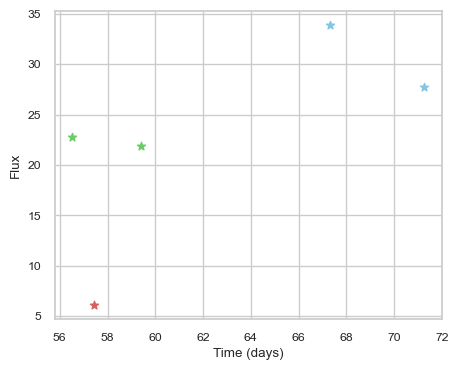

SNIax (4.940963, False)
SNIax (3.5647793, False)
SNIax (3.729697, False)
SNIax (4.0483994, False)
SNIax (3.367125, False)
SNIax (3.6440983, False)
SNIax (3.659731, False)
SNIax (4.5773416, False)
SNIax (3.7259927, False)
SNIax (3.8127751, False)


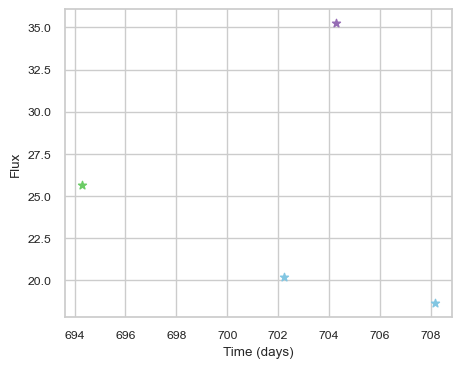

SNIax (3.9302368, False)
SNIax (3.6139276, False)
SNIax (3.4741862, False)
SNIax (3.6075923, False)
SNIax (4.1753044, False)
SNIax (4.85506, False)
SNIax (5.215853, False)
SNIax (5.2325797, False)


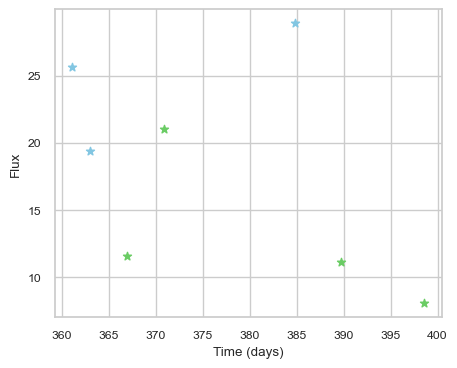

SNIax (4.651562, False)
SNIax (4.533538, False)
SNIax (4.0017676, False)
SNIax (4.621955, False)
SNIax (3.802147, False)
SNIax (3.6509042, False)
SNIax (3.6462667, False)
SNIax (3.3159952, False)
SNIax (3.5730622, False)
SNIax (3.881689, False)
SNIax (3.9292338, False)
SNIax (3.5864809, False)
SNIax (3.5352361, False)
SNIax (3.5915332, False)


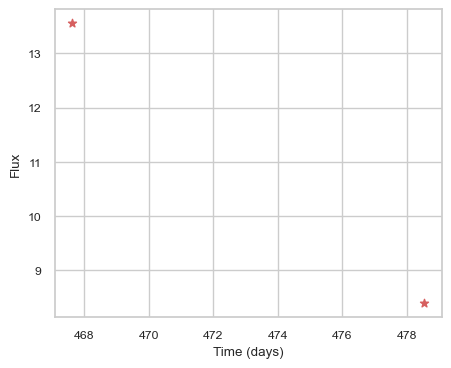

SNIax (3.9522612, False)
SNIax (4.1925, False)
SNIax (3.6220422, False)
SNIax (3.2673779, False)


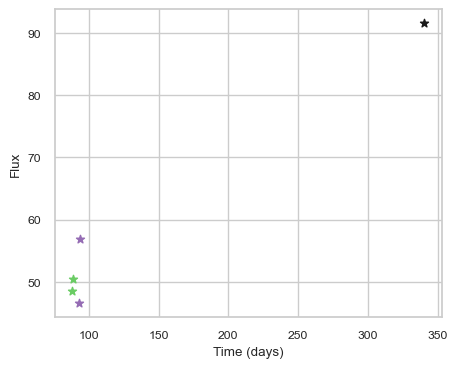

SNIax (4.1101184, False)
SNIax (4.5094056, False)
SNIax (4.5985417, False)
SNIax (4.7531652, False)
SNIax (5.186648, False)
SNIax (4.854292, False)
SNIax (4.868004, False)
SNIax (4.560222, False)
SNIax (4.5100327, False)
SNIax (4.49061, False)


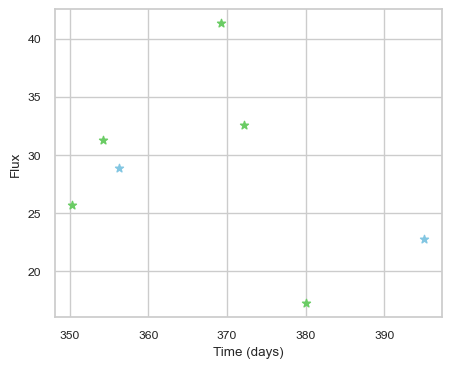

SNIax (3.9777966, False)
SNIax (3.2932558, False)
SNIax (3.6061034, False)
SNIax (2.919513, False)
SNIax (3.164597, False)
SNIax (2.8291702, False)
SNIax (3.453683, False)
SNIax (3.024341, False)
SNIax (3.7897747, False)
SNIax (3.488097, False)
SNIax (3.4971123, False)
SNIax (3.821446, False)
SNIax (3.0198944, False)
SNIax (3.2698164, False)


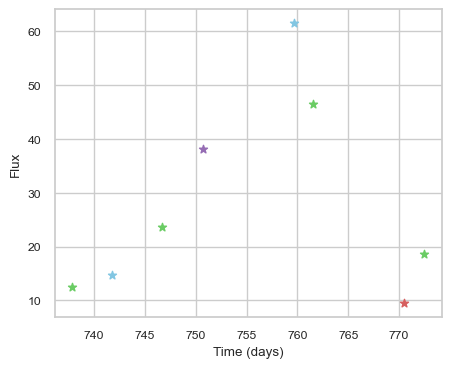

SNIax (3.843784, False)
SNIax (3.2677329, False)
SNIax (3.2403138, False)
SNIax (2.96515, False)
SNIax (2.9447062, False)
SNIax (2.6357152, False)
SNIax (2.709841, False)
SNIax (2.6318233, False)
SNIax (2.3513155, False)
SNIax (2.437439, False)
SNIax (3.0329857, False)
SNIax (2.6452725, False)
SNIax (2.8513532, False)
SNIax (2.9815454, False)
SNIax (3.2583022, False)
SNIax (2.561554, False)


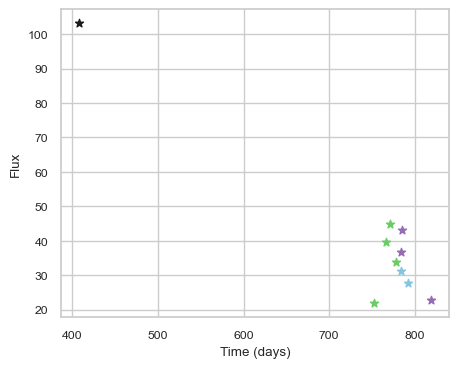

SNIax (3.9753451, False)
SNIax (3.652254, False)
SNIax (3.8924274, False)
SNIax (3.1668663, False)
SNIax (3.1257584, False)
SNIax (2.9160044, False)
SNIax (2.6145105, False)
SNIax (2.5299144, False)
SNIax (2.3971486, False)
SNIax (2.3460987, False)
SNIax (2.5521235, False)
SNIax (2.6999986, False)
SNIax (2.949295, False)
SNIax (3.4235764, False)
SNIax (3.9671478, False)
SNIax (3.3758047, False)
SNIax (3.6056879, False)
SNIax (3.80476, False)
SNIax (4.5944366, False)
SNIax (4.787279, False)


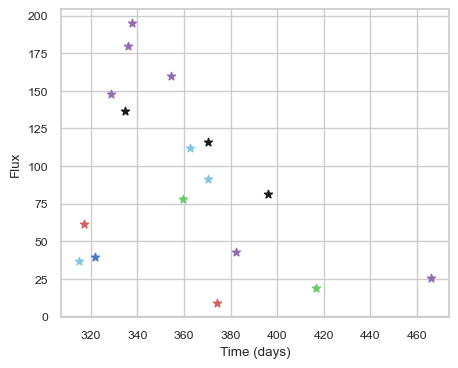

SNIax (3.7838008, False)
SNIax (4.0274224, False)
SNIax (3.4373283, False)
SNIax (4.1798244, False)
SNIax (4.7836647, False)
SNIax (5.9849644, False)
SNIax (4.7015853, False)
SNIax (3.4797754, False)
SNIax (3.554592, False)
SNIax (3.0974765, False)
SNIax (3.6918898, False)
SNIax (2.6343045, False)
SNIax (3.885225, False)
SNIax (2.8740637, False)
SNIax (2.749107, False)
SNIax (2.7189903, False)
SNIax (2.7666044, False)
SNIax (2.9843466, False)
SNIax (2.6524577, False)
SNIax (2.9445908, False)
SNIax (3.5189245, False)
SNIax (3.4492042, False)
SNIax (3.4774327, False)
SNIax (3.470442, False)
SNIax (3.8168962, False)
SNIax (3.8887906, False)
SNIax (4.0768547, False)
SNIax (3.7496078, False)
SNIax (3.3466005, False)
SNIax (3.706083, False)
SNIax (3.6060255, False)
SNIax (3.340727, False)
SNIax (3.6002433, False)
SNIax (3.4425633, False)


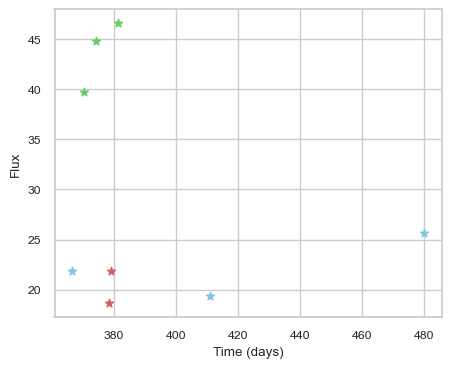

SNIax (3.9001813, False)
SNIax (3.480948, False)
SNIax (3.1595757, False)
SNIax (2.8058765, False)
SNIax (3.3101637, False)
SNIax (2.1208966, False)
SNIax (2.7739787, False)
SNIax (2.2990756, False)
SNIax (3.0065103, False)
SNIax (2.2536547, False)
SNIax (2.7561533, False)
SNIax (2.102994, False)
SNIax (2.5639281, False)
SNIax (2.0240989, False)
SNIax (2.762294, False)
SNIax (2.2571428, False)


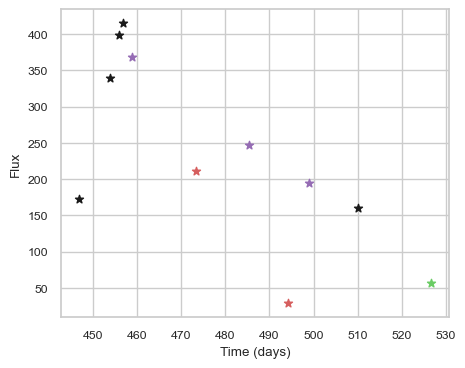

SNIax (3.6963403, False)
SNIax (3.4056733, False)
SNIax (3.393139, False)
SNIax (3.9468822, False)
SNIax (2.995461, False)
SNIax (3.4848287, False)
SNIax (3.2695153, False)
SNIax (3.2464566, False)
SNIax (3.0502043, False)
SNIax (3.0622509, False)
SNIax (3.1733115, False)
SNIax (3.1730585, False)
SNIax (3.541774, False)
SNIax (2.7199335, False)
SNIax (3.087399, False)
SNIax (3.2311845, False)
SNIax (3.4940536, False)
SNIax (3.2214963, False)
SNIax (3.0304844, False)
SNIax (3.3736966, False)
SNIax (3.267204, False)
SNIax (2.9309523, False)


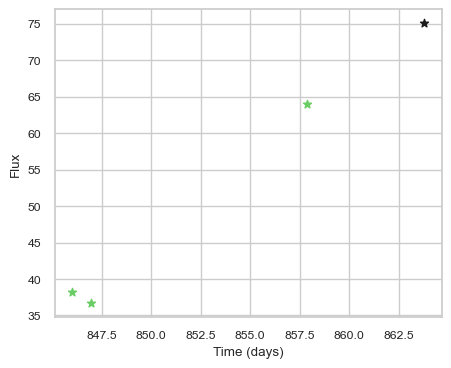

SNIax (3.8601968, False)
SNIax (3.4745271, False)
SNIax (3.43573, False)
SNIax (3.2343283, False)
SNIax (3.1406612, False)
SNIax (4.0080914, False)
SNIax (4.048269, False)
SNIax (4.662663, False)


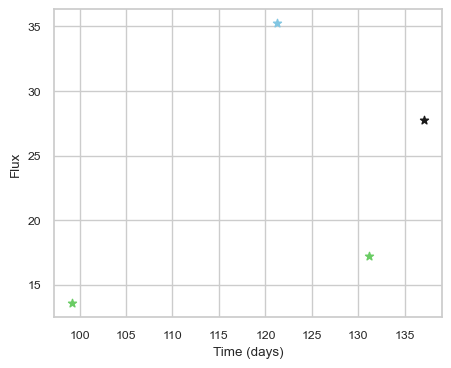

SNIax (5.213156, False)
SNIax (4.1755567, False)
SNIax (3.9237163, False)
SNIax (4.110809, False)
SNIax (3.3989127, False)
SNIax (3.4843538, False)
SNIax (3.2655063, False)
SNIax (3.469402, False)


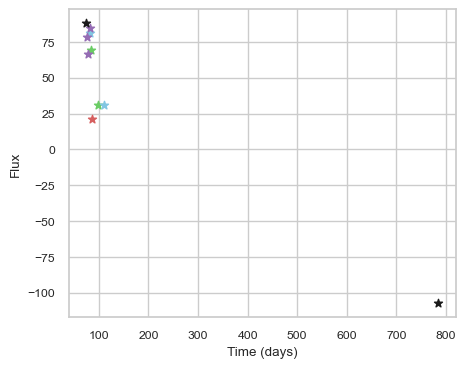

SNIax (4.4767494, False)
SNIax (3.9836826, False)
SNIax (4.7004557, False)
SNIax (4.878042, False)
SNIax (4.6757555, False)
SNIax (4.880353, False)
SNIax (4.8964033, False)
SNIax (4.786245, False)
SNIax (5.1913676, False)
SNIax (5.093616, False)
SNIax (4.901611, False)
SNIax (4.941944, False)
SNIax (4.573553, False)
SNIax (4.46092, False)
SNIax (4.3456426, False)
SNIax (4.8799973, False)
SNIax (4.6232786, False)
SNIax (4.7673984, False)
SNIax (4.6140213, False)
SNIax (4.650583, False)


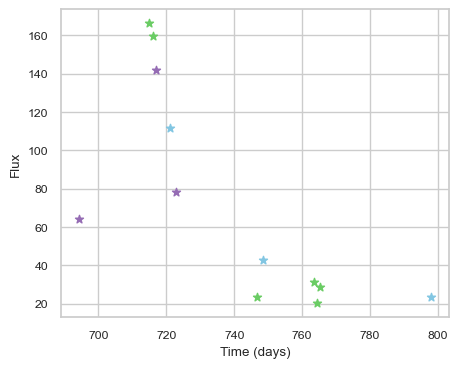

SNIax (3.7079916, False)
SNIax (3.7401142, False)
SNIax (3.7477932, False)
SNIax (4.087712, False)
SNIax (3.294514, False)
SNIax (3.4338336, False)
SNIax (3.2656524, False)
SNIax (3.2108161, False)
SNIax (3.692938, False)
SNIax (4.5839853, False)
SNIax (3.6649363, False)
SNIax (3.921169, False)
SNIax (4.029916, False)
SNIax (4.073778, False)
SNIax (3.7533405, False)
SNIax (4.062915, False)
SNIax (3.5386038, False)
SNIax (3.5372758, False)
SNIax (3.5336096, False)
SNIax (3.6286187, False)
SNIax (3.7054124, False)
SNIax (3.7249641, False)
SNIax (3.709875, False)
SNIax (3.4735632, False)


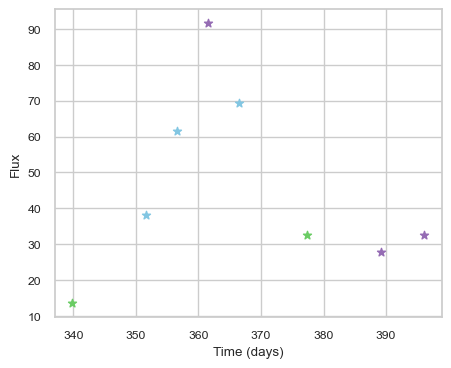

SNIax (3.9694932, False)
SNIax (3.6376722, False)
SNIax (3.3226886, False)
SNIax (3.030187, False)
SNIax (2.9472394, False)
SNIax (3.1818674, False)
SNIax (3.347914, False)
SNIax (3.5207582, False)
SNIax (3.5114968, False)
SNIax (2.9409354, False)
SNIax (2.8878942, False)
SNIax (2.6691597, False)
SNIax (3.1666481, False)
SNIax (2.694911, False)
SNIax (2.0571568, False)
SNIax (2.6377928, False)


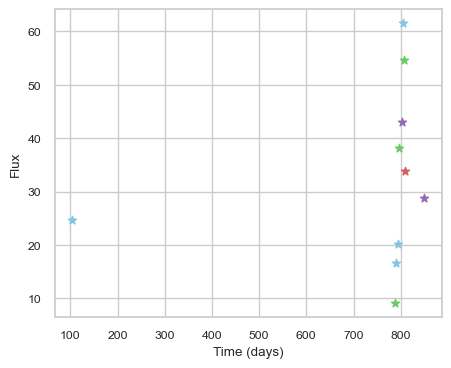

SNIax (4.1669683, False)
SNIax (3.6679034, False)
SNIax (3.7367866, False)
SNIax (3.3667996, False)
SNIax (3.2732162, False)
SNIax (3.3086498, False)
SNIax (3.284819, False)
SNIax (3.5766041, False)
SNIax (3.1428123, False)
SNIax (2.8828082, False)
SNIax (2.805473, False)
SNIax (2.6839182, False)
SNIax (2.557615, False)
SNIax (3.0293405, False)
SNIax (3.0886593, False)
SNIax (2.3737025, False)
SNIax (2.9640405, False)
SNIax (2.6403327, False)
SNIax (3.1150696, False)
SNIax (2.899967, False)


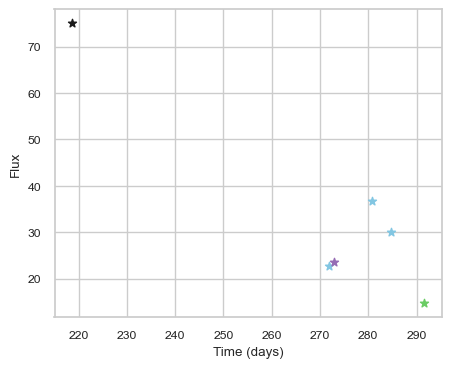

SNIax (3.8950481, False)
SNIax (3.2784019, False)
SNIax (3.9050689, False)
SNIax (3.1703672, False)
SNIax (3.1890264, False)
SNIax (3.1757414, False)
SNIax (2.3944037, False)
SNIax (3.135174, False)
SNIax (2.9767048, False)
SNIax (2.9127836, False)
SNIax (2.9774668, False)
SNIax (2.8005106, False)


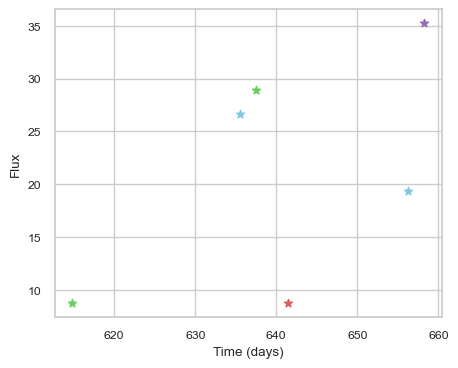

SNIax (3.9258542, False)
SNIax (3.3733585, False)
SNIax (3.3356466, False)
SNIax (3.5570228, False)
SNIax (3.1879592, False)
SNIax (3.2011063, False)
SNIax (3.4916894, False)
SNIax (3.0489311, False)
SNIax (3.1303797, False)
SNIax (3.172834, False)
SNIax (3.4936495, False)
SNIax (3.3053727, False)


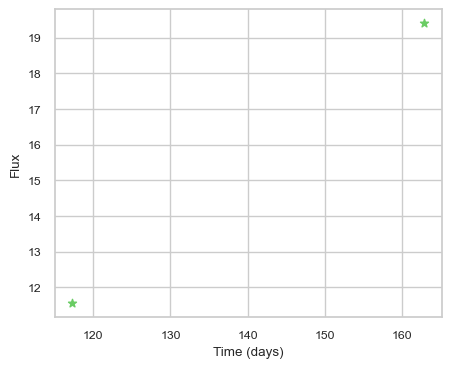

SNIax (3.8885074, False)
SNIax (3.5874686, False)
SNIax (3.5491521, False)
SNIax (3.6983638, False)


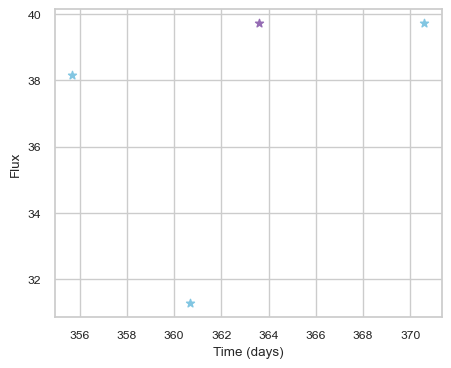

SNIax (3.7957242, False)
SNIax (3.6563454, False)
SNIax (3.4611876, False)
SNIax (3.6030314, False)
SNIax (4.146723, False)
SNIax (4.806739, False)
SNIax (4.0593433, False)
SNIax (4.5416903, False)


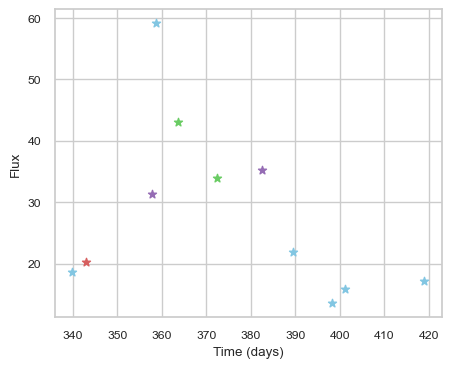

SNIax (3.902636, False)
SNIax (3.63267, False)
SNIax (3.0198674, False)
SNIax (3.9142005, False)
SNIax (3.7019932, False)
SNIax (3.442078, False)
SNIax (4.780937, False)
SNIax (2.6530666, False)
SNIax (3.2501066, False)
SNIax (2.05471, False)
SNIax (2.5356395, False)
SNIax (2.7819245, False)
SNIax (2.8361547, False)
SNIax (2.5015874, False)
SNIax (2.1901035, False)
SNIax (2.2002537, False)
SNIax (2.155519, False)
SNIax (2.1884878, False)
SNIax (2.144988, False)
SNIax (2.1072311, False)
SNIax (2.253314, False)
SNIax (2.0424461, False)


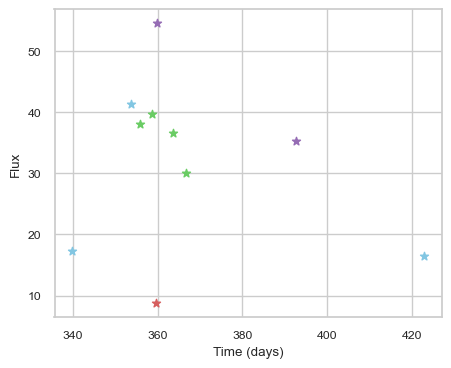

SNIax (4.135246, False)
SNIax (3.7256355, False)
SNIax (3.071124, False)
SNIax (3.3226175, False)
SNIax (2.6898267, False)
SNIax (2.6246293, False)
SNIax (3.2575965, False)
SNIax (2.353973, False)
SNIax (2.5898545, False)
SNIax (2.507704, False)
SNIax (2.616863, False)
SNIax (2.405258, False)
SNIax (3.2757945, False)
SNIax (3.1985414, False)
SNIax (3.1800122, False)
SNIax (2.9707458, False)
SNIax (2.6972883, False)
SNIax (2.5956616, False)
SNIax (2.7948523, False)
SNIax (2.740673, False)


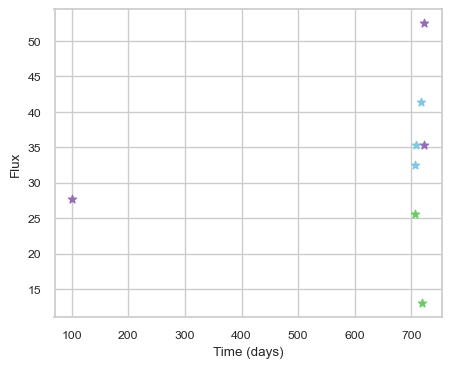

SNIax (5.267589, False)
SNIax (5.1047826, False)
SNIax (4.9887133, False)
SNIax (5.023516, False)
SNIax (4.7154074, False)
SNIax (4.8127036, False)
SNIax (5.062783, False)
SNIax (5.4240193, False)
SNIax (5.3184066, False)
SNIax (5.5815635, False)
SNIax (5.414994, False)
SNIax (5.303259, False)
SNIax (4.7816763, False)
SNIax (5.2191625, False)
SNIax (5.297651, False)
SNIax (5.3981943, False)


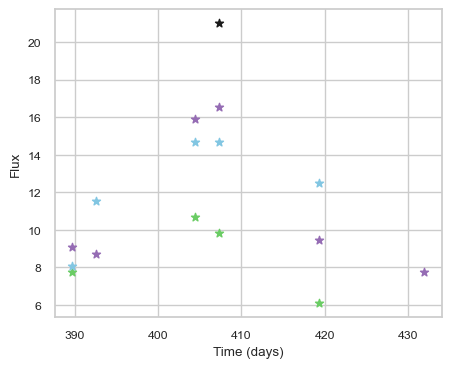

SNIax (4.7626886, False)
SNIax (3.8252027, False)
SNIax (4.2220798, False)
SNIax (4.2453804, False)
SNIax (3.3868585, False)
SNIax (3.7002242, False)
SNIax (3.584486, False)
SNIax (2.993388, False)
SNIax (2.7303896, False)
SNIax (3.1311162, False)
SNIax (3.2171984, False)
SNIax (2.7512603, False)
SNIax (2.3588035, False)
SNIax (2.6509328, False)
SNIax (2.4406364, False)
SNIax (2.7142289, False)
SNIax (2.9949303, False)
SNIax (2.3397744, False)
SNIax (2.3384607, False)
SNIax (2.5233355, False)
SNIax (2.671316, False)
SNIax (2.6809838, False)
SNIax (3.07877, False)


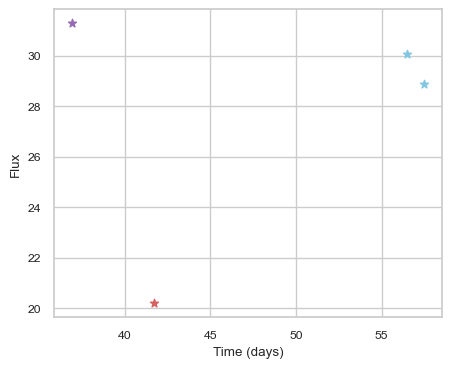

SNIax (4.284323, False)
SNIax (3.5986004, False)
SNIax (3.4363313, False)
SNIax (3.7606137, False)
SNIax (3.8517687, False)
SNIax (3.4354467, False)
SNIax (3.5501688, False)
SNIax (3.8863096, False)


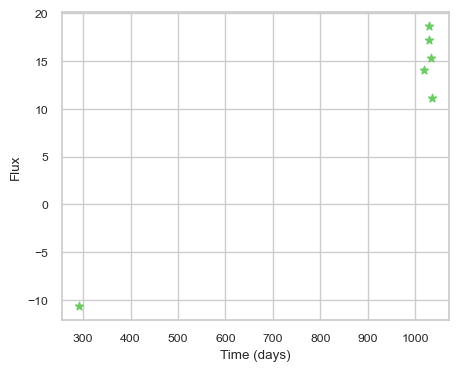

SNIax (4.008108, False)
SNIax (4.2562056, False)
SNIax (4.109576, False)
SNIax (3.7896233, False)
SNIax (3.4830313, False)
SNIax (3.9543874, False)
SNIax (3.831842, False)
SNIax (4.42172, False)
SNIax (4.218183, False)
SNIax (4.3029733, False)
SNIax (3.7338285, False)
SNIax (4.048265, False)


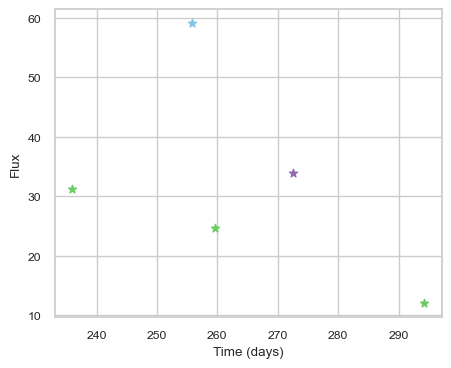

SNIax (3.6365101, False)
SNIax (3.527717, False)
SNIax (3.5028956, False)
SNIax (3.4514956, False)
SNIax (3.5871873, False)
SNIax (3.3757188, False)
SNIax (3.2380083, False)
SNIax (3.2596476, False)
SNIax (3.4794369, False)
SNIax (3.2770307, False)


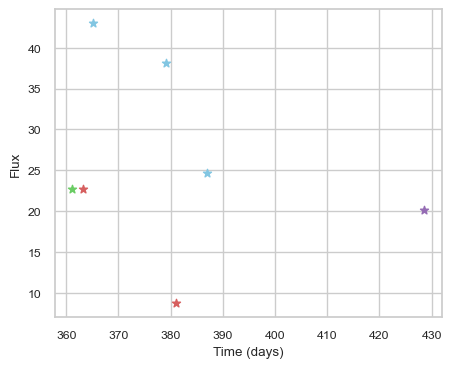

SNIax (3.7909632, False)
SNIax (3.4373262, False)
SNIax (3.1562417, False)
SNIax (3.766927, False)
SNIax (4.383861, False)
SNIax (2.6445096, False)
SNIax (3.5396795, False)
SNIax (2.7970982, False)
SNIax (2.868717, False)
SNIax (2.4903593, False)
SNIax (2.8562913, False)
SNIax (2.4777522, False)
SNIax (3.3885133, False)
SNIax (2.655348, False)


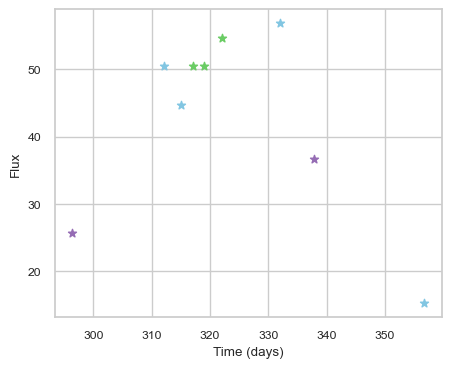

SNIax (3.9563558, False)
SNIax (3.958373, False)
SNIax (3.808056, False)
SNIax (3.6857517, False)
SNIax (3.3102071, False)
SNIax (3.5203266, False)
SNIax (3.7919319, False)
SNIax (3.6065993, False)
SNIax (4.310061, False)
SNIax (3.7482662, False)
SNIax (4.0970106, False)
SNIax (3.8441598, False)
SNIax (3.53551, False)
SNIax (3.581683, False)
SNIax (3.8239543, False)
SNIax (3.8982573, False)
SNIax (3.257646, False)
SNIax (2.6024456, False)


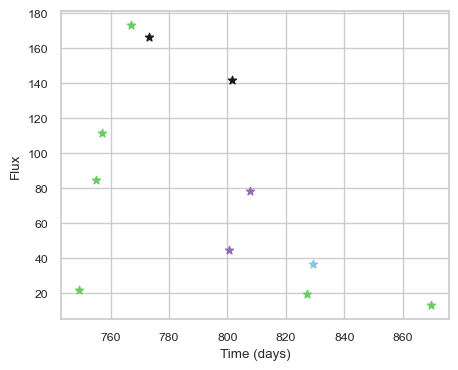

SNIax (3.7340198, False)
SNIax (3.3641856, False)
SNIax (3.2036338, False)
SNIax (3.5954328, False)
SNIax (3.859839, False)
SNIax (3.9360282, False)
SNIax (3.3769057, False)
SNIax (3.0704243, False)
SNIax (3.4619129, False)
SNIax (3.0056412, False)
SNIax (3.6109734, False)
SNIax (4.316828, False)
SNIax (4.9552307, False)
SNIax (4.3574843, False)
SNIax (4.237534, False)
SNIax (4.390699, False)
SNIax (4.6115, False)
SNIax (4.096367, False)
SNIax (4.1066556, False)
SNIax (4.0274367, False)
SNIax (4.000104, False)
SNIax (3.4580579, False)


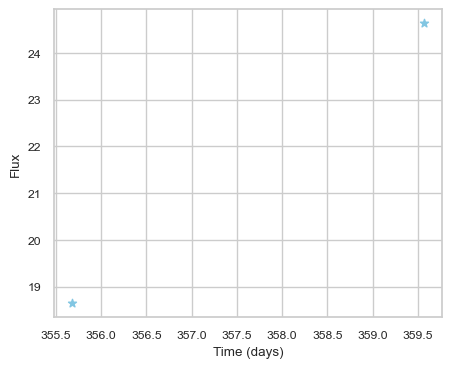

SNIax (4.2041173, False)
SNIax (3.7881472, False)
SNIax (3.3949072, False)
SNIax (3.2797048, False)


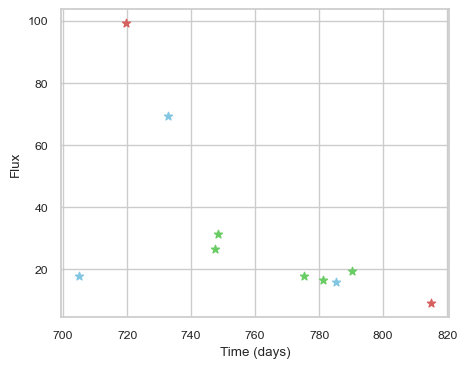

SNIax (3.7012727, False)
SNIax (3.5235448, False)
SNIax (2.9220784, False)
SNIax (3.5354853, False)
SNIax (3.1831565, False)
SNIax (2.9985697, False)
SNIax (4.7769117, False)
SNIax (4.7355456, False)
SNIax (3.2660072, False)
SNIax (3.5031703, False)
SNIax (2.9480855, False)
SNIax (2.8769112, False)
SNIax (2.9637616, False)
SNIax (2.474313, False)
SNIax (2.5607173, False)
SNIax (2.3441477, False)
SNIax (2.4202714, False)
SNIax (2.1561108, False)
SNIax (2.6951413, False)
SNIax (2.3786643, False)


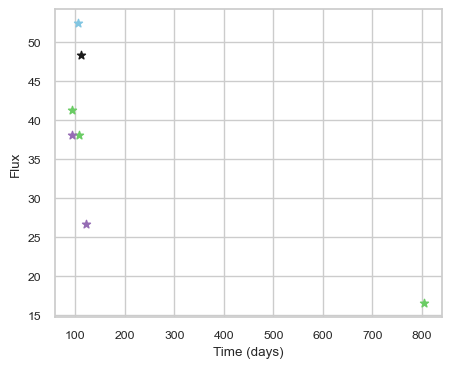

SNIax (4.217087, False)
SNIax (4.074588, False)
SNIax (3.3899465, False)
SNIax (3.864419, False)
SNIax (4.466479, False)
SNIax (4.5296683, False)
SNIax (4.244044, False)
SNIax (3.6795185, False)
SNIax (3.5471826, False)
SNIax (3.9977984, False)
SNIax (3.3270934, False)
SNIax (3.234101, False)
SNIax (3.4964812, False)
SNIax (3.202739, False)


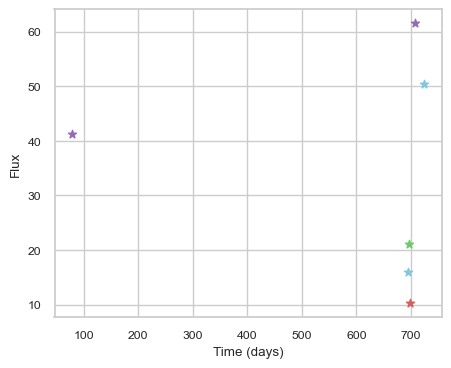

SNIax (4.313408, False)
SNIax (4.5044045, False)
SNIax (4.5657306, False)
SNIax (3.8015776, False)
SNIax (3.1659493, False)
SNIax (2.6342444, False)
SNIax (3.1394725, False)
SNIax (2.5425055, False)
SNIax (3.0166512, False)
SNIax (3.682959, False)
SNIax (4.786233, False)
SNIax (4.482134, False)


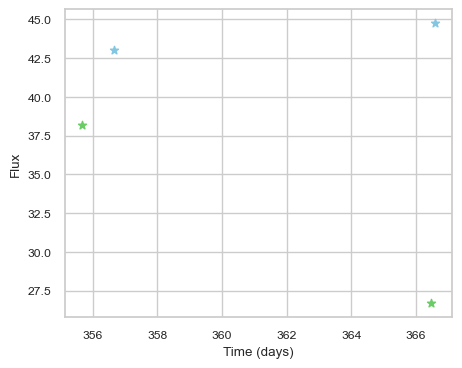

SNIax (3.864622, False)
SNIax (3.3685458, False)
SNIax (3.12809, False)
SNIax (3.2300527, False)
SNIax (3.103716, False)
SNIax (3.13625, False)
SNIax (3.2401745, False)
SNIax (2.6792789, False)


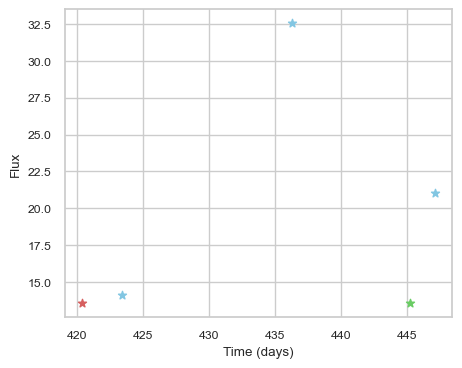

SNIax (3.9195697, False)
SNIax (4.428154, False)
SNIax (3.559748, False)
SNIax (4.3653717, False)
SNIax (4.344928, False)
SNIax (4.025667, False)
SNIax (4.1511254, False)
SNIax (4.2422233, False)
SNIax (4.175606, False)
SNIax (3.9498143, False)


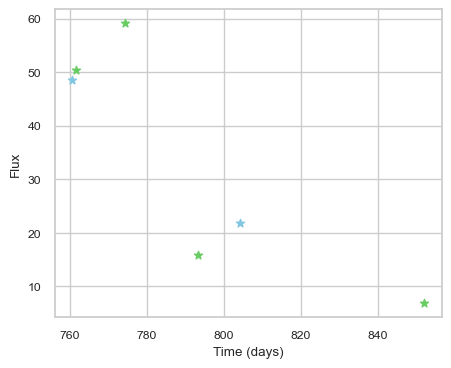

SNIax (3.6734257, False)
SNIax (3.5211504, False)
SNIax (3.3556812, False)
SNIax (3.1597657, False)
SNIax (3.0741858, False)
SNIax (3.406932, False)
SNIax (3.3256195, False)
SNIax (2.7236483, False)
SNIax (2.4746916, False)
SNIax (2.168321, False)
SNIax (2.3770168, False)
SNIax (2.2291913, False)


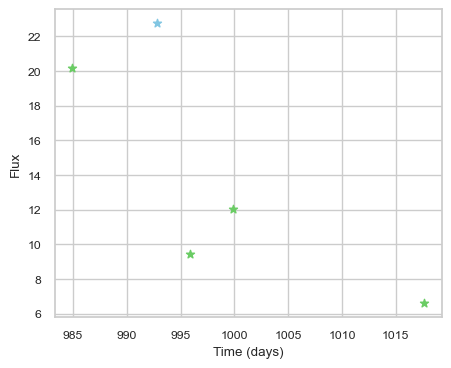

SNIax (4.9165936, False)
SNIax (4.6526337, False)
SNIax (4.7597604, False)
SNIax (4.673737, False)
SNIax (3.4706156, False)
SNIax (3.9578657, False)
SNIax (3.693664, False)
SNIax (3.8791854, False)
SNIax (3.5944476, False)
SNIax (4.0694046, False)


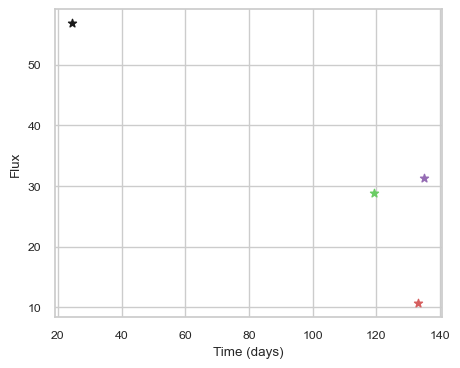

SNIax (4.05007, False)
SNIax (3.8286653, False)
SNIax (3.8165228, False)
SNIax (3.7103593, False)
SNIax (3.4188178, False)
SNIax (3.5691493, False)
SNIax (3.0224411, False)
SNIax (3.1497488, False)


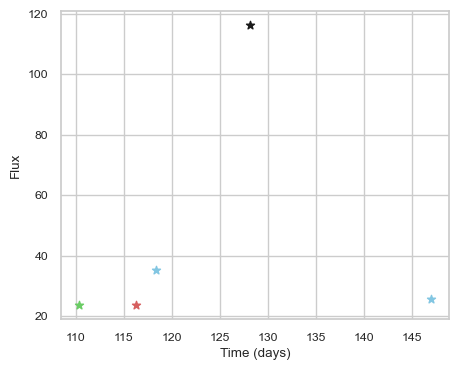

SNIax (4.0162487, False)
SNIax (3.6496782, False)
SNIax (3.664543, False)
SNIax (3.8742187, False)
SNIax (4.0221653, False)
SNIax (3.81369, False)
SNIax (3.6208217, False)
SNIax (3.920495, False)
SNIax (4.2762322, False)
SNIax (4.129944, False)


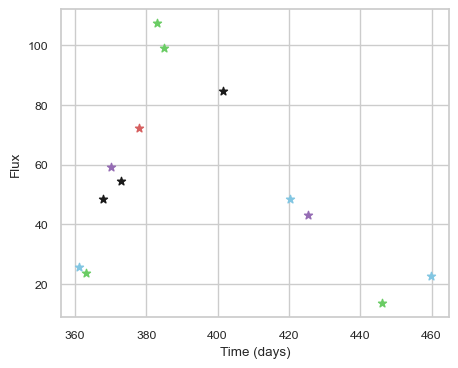

SNIax (3.8296974, False)
SNIax (3.5429833, False)
SNIax (3.1791394, False)
SNIax (3.1814113, False)
SNIax (3.412711, False)
SNIax (3.1472054, False)
SNIax (3.6378267, False)
SNIax (2.8079264, False)
SNIax (3.7819169, False)
SNIax (3.3985128, False)
SNIax (3.3132613, False)
SNIax (2.910967, False)
SNIax (2.974149, False)
SNIax (2.5334983, False)
SNIax (2.7516148, False)
SNIax (2.4145026, False)
SNIax (2.3438141, False)
SNIax (1.8719231, False)
SNIax (2.531892, False)
SNIax (1.818551, False)
SNIax (2.27097, False)
SNIax (1.7513627, False)
SNIax (2.2493737, False)
SNIax (1.8429893, False)
SNIax (2.175963, False)
SNIax (1.8083409, False)


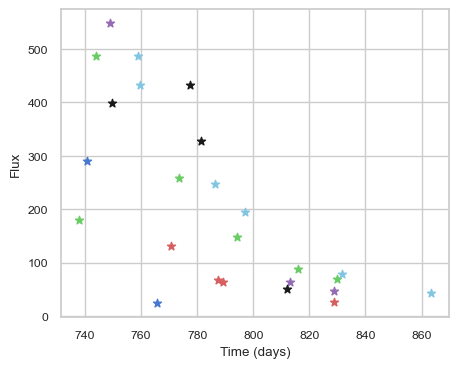

SNIax (3.6799254, False)
SNIax (3.149914, False)
SNIax (3.0276794, False)
SNIax (3.433419, False)
SNIax (3.031211, False)
SNIax (3.2484896, False)
SNIax (3.3899424, False)
SNIax (3.0007648, False)
SNIax (2.9383736, False)
SNIax (2.8056235, False)
SNIax (2.9045746, False)
SNIax (2.1030881, False)
SNIax (3.344094, False)
SNIax (1.8219265, False)
SNIax (3.8344562, False)
SNIax (3.869656, False)
SNIax (3.6598222, False)
SNIax (2.9720337, False)
SNIax (2.99603, False)
SNIax (2.3967786, False)
SNIax (2.988228, False)
SNIax (2.5995586, False)
SNIax (3.7277148, False)
SNIax (3.4114258, False)
SNIax (3.3116927, False)
SNIax (3.0636287, False)
SNIax (2.8091712, False)
SNIax (3.2992566, False)
SNIax (3.4348314, False)
SNIax (3.0935895, False)
SNIax (3.5921757, False)
SNIax (3.2709653, False)
SNIax (2.9047616, False)
SNIax (2.7260556, False)
SNIax (2.509588, False)
SNIax (2.7402275, False)
SNIax (2.866552, False)
SNIax (2.649252, False)
SNIax (2.6504092, False)
SNIax (2.5963373, False)
SNIax (2.43

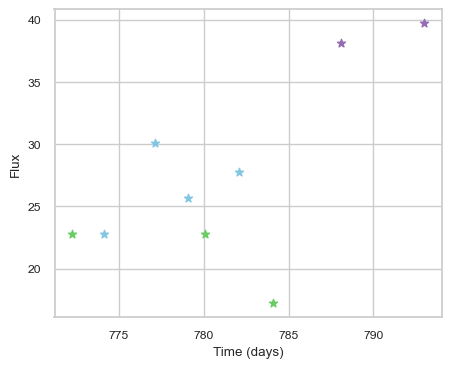

SNIax (4.084506, False)
SNIax (3.3078208, False)
SNIax (3.2214727, False)
SNIax (2.835241, False)
SNIax (2.9034703, False)
SNIax (2.6971288, False)
SNIax (2.6806698, False)
SNIax (2.5003455, False)
SNIax (2.3504992, False)
SNIax (2.167367, False)
SNIax (2.8363752, False)
SNIax (2.4529684, False)
SNIax (2.3533864, False)
SNIax (2.3345454, False)
SNIax (2.293243, False)
SNIax (2.6699226, False)
SNIax (2.999896, False)
SNIax (3.2099802, False)


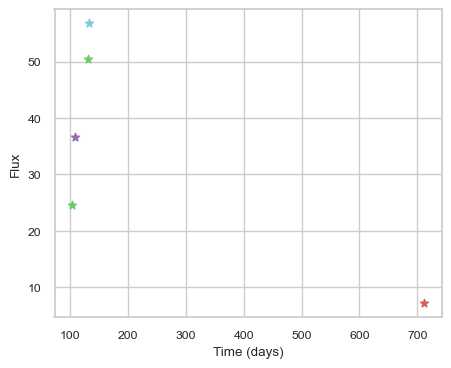

SNIax (3.9739425, False)
SNIax (3.935939, False)
SNIax (3.470962, False)
SNIax (3.551235, False)
SNIax (3.33465, False)
SNIax (3.096673, False)
SNIax (3.497097, False)
SNIax (3.141285, False)
SNIax (3.0800667, False)
SNIax (2.8783123, False)


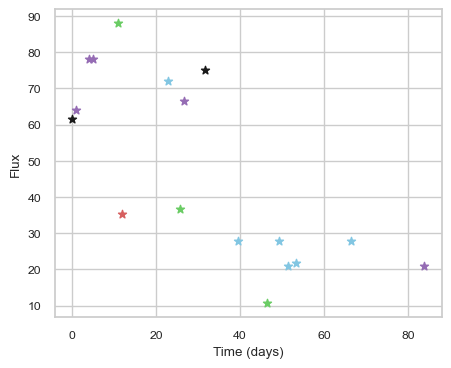

SNIax (4.3764677, False)
SNIax (4.817033, False)
SNIax (4.1362185, False)
SNIax (4.3874016, False)
SNIax (4.5652533, False)
SNIax (4.437104, False)
SNIax (4.589608, False)
SNIax (4.018125, False)
SNIax (3.9313276, False)
SNIax (3.8459496, False)
SNIax (4.068063, False)
SNIax (4.405899, False)
SNIax (4.26212, False)
SNIax (5.454713, False)
SNIax (5.01018, False)
SNIax (5.5214343, False)
SNIax (5.039951, False)
SNIax (5.6352606, False)
SNIax (4.9658785, False)
SNIax (4.728173, False)
SNIax (4.7893543, False)
SNIax (4.528987, False)
SNIax (4.9293175, False)
SNIax (5.269588, False)
SNIax (5.0698953, False)
SNIax (4.9145565, False)
SNIax (4.7243114, False)
SNIax (4.646408, False)
SNIax (4.7401686, False)
SNIax (4.1976056, False)
SNIax (4.797529, False)
SNIax (4.9875817, False)
SNIax (4.6736856, False)


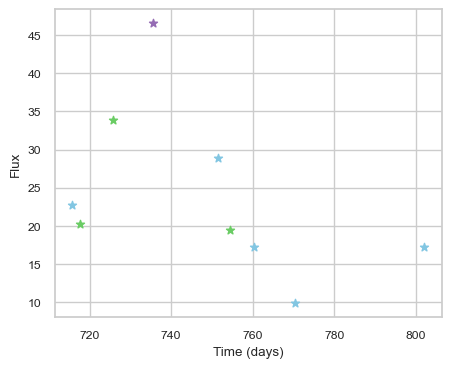

SNIax (3.9407887, False)
SNIax (3.5592213, False)
SNIax (3.0942657, False)
SNIax (2.9845483, False)
SNIax (3.0339036, False)
SNIax (2.7444491, False)
SNIax (2.9340162, False)
SNIax (2.4086943, False)
SNIax (3.4937694, False)
SNIax (3.3763359, False)
SNIax (3.344907, False)
SNIax (3.5280006, False)
SNIax (3.395198, False)
SNIax (3.1262763, False)
SNIax (2.957576, False)
SNIax (3.0118637, False)
SNIax (3.187817, False)
SNIax (3.379449, False)


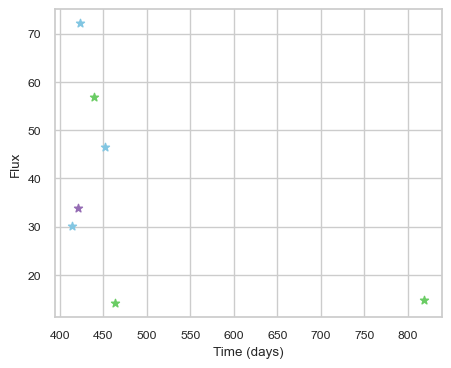

SNIax (3.889818, False)
SNIax (3.6829655, False)
SNIax (3.6593862, False)
SNIax (3.8627481, False)
SNIax (4.1338015, False)
SNIax (3.7811842, False)
SNIax (3.1657128, False)
SNIax (3.1588895, False)
SNIax (2.937913, False)
SNIax (2.681616, False)
SNIax (3.0917397, False)
SNIax (2.7515306, False)
SNIax (3.0958714, False)
SNIax (2.6765418, False)


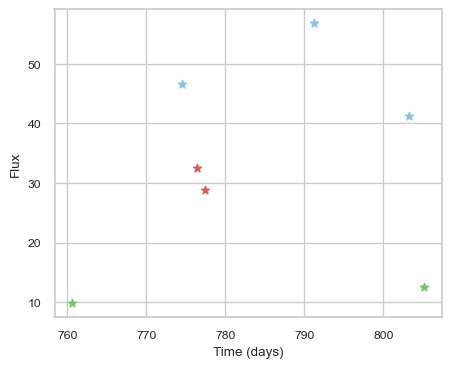

SNIax (3.872882, False)
SNIax (3.298756, False)
SNIax (3.1929998, False)
SNIax (3.2528927, False)
SNIax (3.1451886, False)
SNIax (3.0093338, False)
SNIax (3.341759, False)
SNIax (2.7938874, False)
SNIax (3.3767507, False)
SNIax (3.0529456, False)
SNIax (3.815549, False)
SNIax (3.5220613, False)
SNIax (3.296141, False)
SNIax (3.0553832, False)


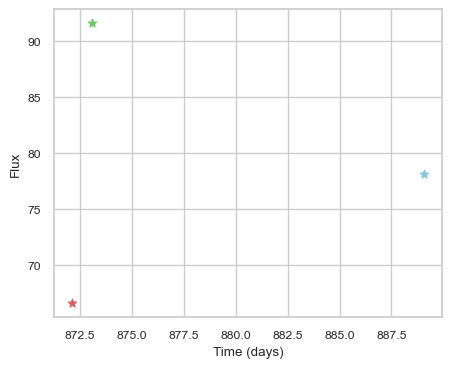

SNIax (3.677371, False)
SNIax (4.1514087, False)
SNIax (4.4288864, False)
SNIax (4.3067145, False)
SNIax (3.5942626, False)
SNIax (3.2365751, False)


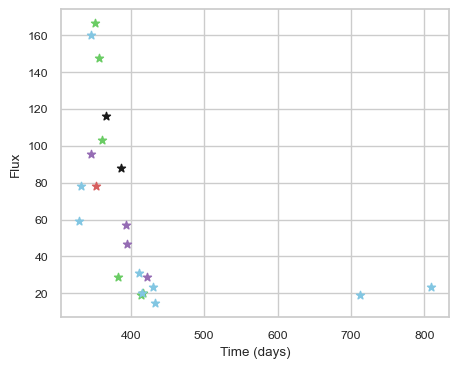

SNIax (3.84498, False)
SNIax (3.8353095, False)
SNIax (3.5749207, False)
SNIax (3.7578688, False)
SNIax (3.3958585, False)
SNIax (3.4074843, False)
SNIax (3.241843, False)
SNIax (2.8162956, False)
SNIax (2.9834354, False)
SNIax (2.3281636, False)
SNIax (2.7652965, False)
SNIax (2.5022924, False)
SNIax (3.3122516, False)
SNIax (3.0901392, False)
SNIax (2.97362, False)
SNIax (3.2905, False)
SNIax (2.8765013, False)
SNIax (3.1396797, False)
SNIax (2.9616218, False)
SNIax (3.6974995, False)
SNIax (3.3380651, False)
SNIax (3.50256, False)
SNIax (3.1621904, False)
SNIax (3.0681884, False)
SNIax (3.257326, False)
SNIax (3.0996304, False)
SNIax (3.489631, False)
SNIax (2.9210994, False)
SNIax (3.1115317, False)
SNIax (2.920844, False)
SNIax (3.363714, False)
SNIax (2.9354784, False)
SNIax (2.9817667, False)
SNIax (2.9153008, False)
SNIax (3.097873, False)
SNIax (2.7340152, False)
SNIax (2.5319586, False)
SNIax (2.4717424, False)
SNIax (3.0496948, False)
SNIax (2.4137838, False)
SNIax (2.883226

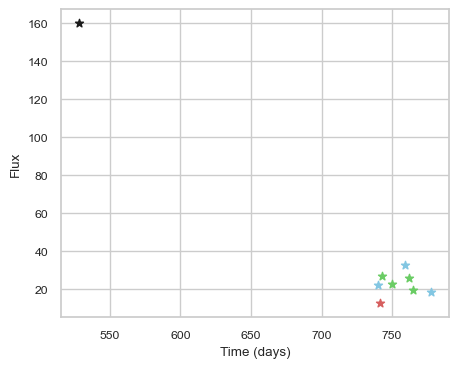

SNIax (3.9137626, False)
SNIax (4.4439225, False)
SNIax (3.7436235, False)
SNIax (3.310897, False)
SNIax (3.0752242, False)
SNIax (2.9500291, False)
SNIax (2.7299376, False)
SNIax (2.4177017, False)
SNIax (2.9042008, False)
SNIax (2.5847623, False)
SNIax (2.622397, False)
SNIax (2.7564025, False)
SNIax (2.7763731, False)
SNIax (2.550706, False)
SNIax (3.3197489, False)
SNIax (2.7387764, False)
SNIax (2.709952, False)
SNIax (2.5087562, False)


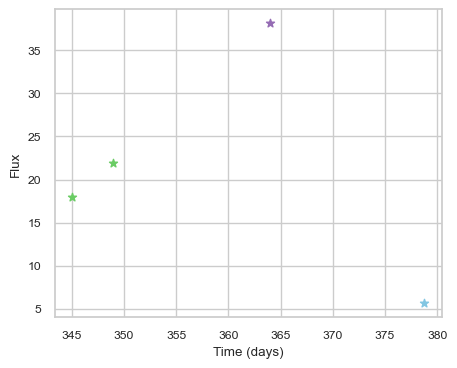

SNIax (4.2276063, False)
SNIax (3.681954, False)
SNIax (3.590123, False)
SNIax (3.041633, False)
SNIax (3.0507624, False)
SNIax (2.4858851, False)
SNIax (2.8687232, False)
SNIax (3.348062, False)


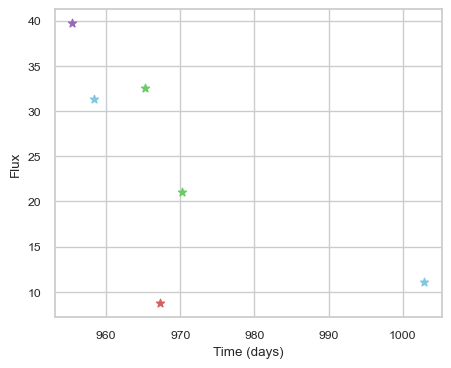

SNIax (3.713024, False)
SNIax (3.4613295, False)
SNIax (3.1986501, False)
SNIax (3.7969203, False)
SNIax (3.1805527, False)
SNIax (3.369246, False)
SNIax (4.0299277, False)
SNIax (3.682396, False)
SNIax (3.4381998, False)
SNIax (2.7226615, False)
SNIax (3.6599371, False)
SNIax (3.6448183, False)


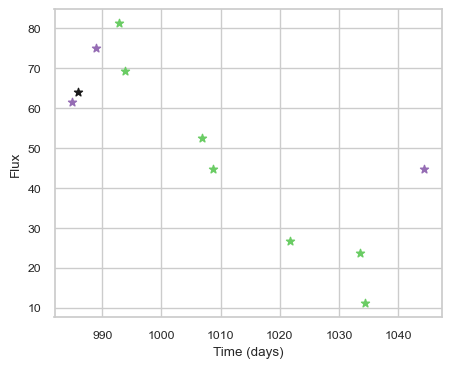

SNIax (3.8909056, False)
SNIax (3.72194, False)
SNIax (4.0025396, False)
SNIax (3.948219, False)
SNIax (4.149267, False)
SNIax (3.754628, False)
SNIax (4.2988677, False)
SNIax (4.0735216, False)
SNIax (3.621336, False)
SNIax (3.7262957, False)
SNIax (3.4562917, False)
SNIax (3.6715577, False)
SNIax (3.6215, False)
SNIax (3.6835945, False)
SNIax (3.6746526, False)
SNIax (3.725316, False)
SNIax (3.5251083, False)
SNIax (3.8033748, False)
SNIax (3.3588617, False)
SNIax (3.7396927, False)
SNIax (3.612411, False)
SNIax (3.632982, False)


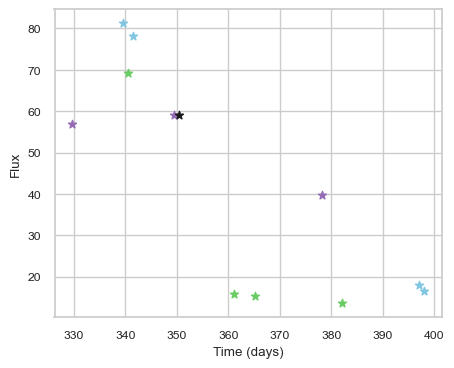

SNIax (4.0432897, False)
SNIax (4.224277, False)
SNIax (4.7216215, False)
SNIax (5.1305656, False)
SNIax (5.2060246, False)
SNIax (5.617174, False)
SNIax (5.571782, False)
SNIax (5.908796, False)
SNIax (5.6559772, False)
SNIax (5.343334, False)
SNIax (5.801563, False)
SNIax (6.0144525, False)
SNIax (5.6106915, False)
SNIax (5.9006824, False)
SNIax (5.3929906, False)
SNIax (5.8547525, False)
SNIax (5.36458, False)
SNIax (5.5898557, False)
SNIax (5.755371, False)
SNIax (5.5499043, False)
SNIax (5.1840105, False)
SNIax (5.369345, False)
SNIax (4.9018674, False)
SNIax (5.319617, False)


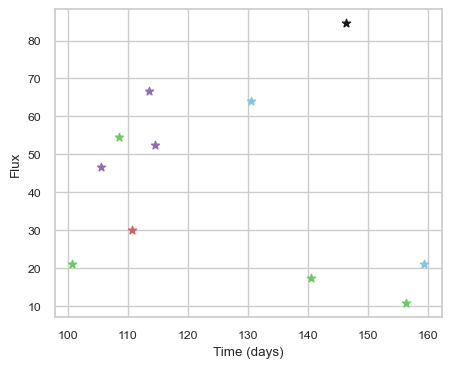

SNIax (4.290001, False)
SNIax (3.7954936, False)
SNIax (3.4543824, False)
SNIax (3.4515302, False)
SNIax (3.4035242, False)
SNIax (3.8284996, False)
SNIax (4.088457, False)
SNIax (4.534939, False)
SNIax (5.1227818, False)
SNIax (4.326811, False)
SNIax (5.2852564, False)
SNIax (4.0548987, False)
SNIax (4.3992295, False)
SNIax (4.5008254, False)
SNIax (4.506723, False)
SNIax (4.086069, False)
SNIax (4.3966575, False)
SNIax (4.130462, False)
SNIax (3.3998897, False)
SNIax (3.0066075, False)
SNIax (3.0576243, False)
SNIax (2.9662688, False)


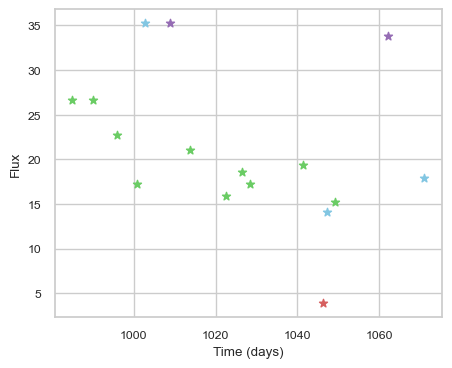

SNIax (3.7997024, False)
SNIax (3.9249187, False)
SNIax (3.4915845, False)
SNIax (3.6895912, False)
SNIax (3.6537838, False)
SNIax (4.257493, False)
SNIax (4.074649, False)
SNIax (4.507949, False)
SNIax (3.936047, False)
SNIax (3.8016758, False)
SNIax (3.920414, False)
SNIax (4.049339, False)
SNIax (3.8014634, False)
SNIax (4.566922, False)
SNIax (4.078977, False)
SNIax (4.472219, False)
SNIax (4.269062, False)
SNIax (4.285314, False)
SNIax (3.9212728, False)
SNIax (4.1529903, False)
SNIax (3.8922215, False)
SNIax (4.279744, False)
SNIax (4.661593, False)
SNIax (4.749146, False)
SNIax (3.988808, False)
SNIax (4.2695684, False)
SNIax (4.021786, False)
SNIax (4.5652895, False)
SNIax (4.0961995, False)
SNIax (4.8124304, False)
SNIax (5.1778426, False)
SNIax (5.2247915, False)


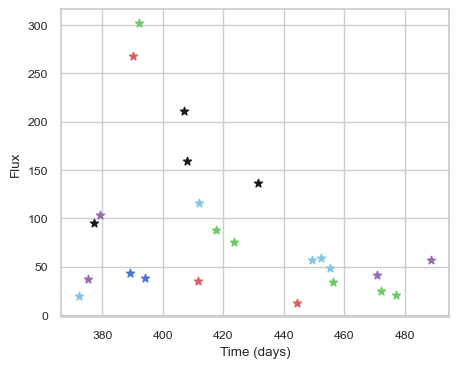

SNIax (3.7339828, False)
SNIax (3.6122265, False)
SNIax (3.0906622, False)
SNIax (3.090964, False)
SNIax (3.3668091, False)
SNIax (3.402371, False)
SNIax (3.9643583, False)
SNIax (3.1655886, False)
SNIax (3.3411722, False)
SNIax (3.538433, False)
SNIax (3.7217512, False)
SNIax (2.924122, False)
SNIax (4.772107, False)
SNIax (3.8851106, False)
SNIax (4.833463, False)
SNIax (4.2396965, False)
SNIax (4.64427, False)
SNIax (3.3362904, False)
SNIax (4.342513, False)
SNIax (3.2977116, False)
SNIax (3.8176758, False)
SNIax (3.0461502, False)
SNIax (3.8914475, False)
SNIax (3.6521873, False)
SNIax (4.301314, False)
SNIax (3.4395816, False)
SNIax (3.0203834, False)
SNIax (3.9646974, False)
SNIax (3.5762646, False)
SNIax (4.195004, False)
SNIax (3.6412523, False)
SNIax (3.850785, False)
SNIax (3.8942056, False)
SNIax (3.8317683, False)
SNIax (4.419909, False)
SNIax (3.960791, False)
SNIax (4.24243, False)
SNIax (3.7654307, False)
SNIax (4.2599926, False)
SNIax (3.294928, False)
SNIax (3.6906905,

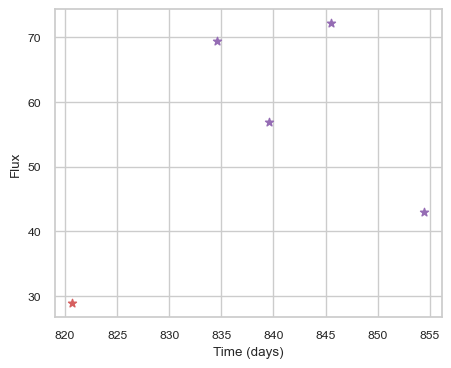

SNIax (3.9571884, False)
SNIax (4.337119, False)
SNIax (4.139286, False)
SNIax (3.9104428, False)
SNIax (3.50192, False)
SNIax (3.3997743, False)
SNIax (2.906104, False)
SNIax (3.2524462, False)
SNIax (3.343787, False)
SNIax (3.2619452, False)


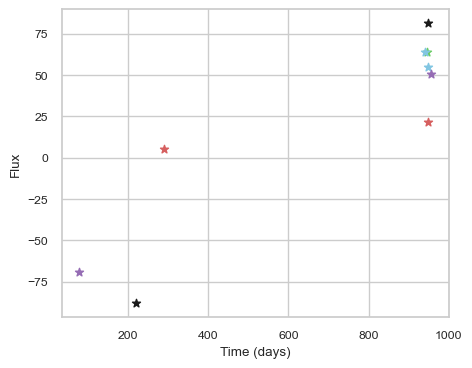

SNIax (3.8506575, False)
SNIax (3.9828732, False)
SNIax (3.880222, False)
SNIax (4.200088, False)
SNIax (3.7895486, False)
SNIax (4.0182667, False)
SNIax (3.5470772, False)
SNIax (3.6954975, False)
SNIax (3.83374, False)
SNIax (3.2314327, False)
SNIax (3.189659, False)
SNIax (2.3426225, False)
SNIax (3.1467264, False)
SNIax (3.2984076, False)
SNIax (2.7774572, False)
SNIax (2.0654173, False)
SNIax (2.527243, False)
SNIax (2.0051444, False)


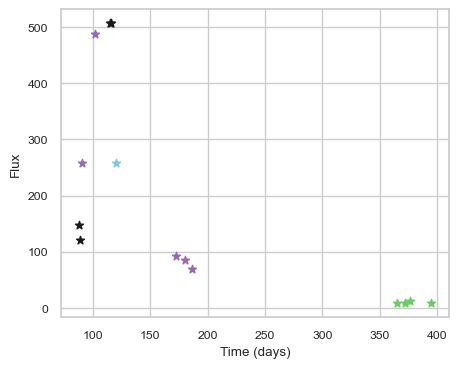

SNIax (3.7390084, False)
SNIax (3.8056893, False)
SNIax (3.7867806, False)
SNIax (3.639631, False)
SNIax (4.0418167, False)
SNIax (3.8028843, False)
SNIax (3.1281672, False)
SNIax (3.041161, False)
SNIax (3.2687075, False)
SNIax (3.4345343, False)
SNIax (3.230662, False)
SNIax (3.5171201, False)
SNIax (2.8113334, False)
SNIax (3.3703003, False)
SNIax (3.0989037, False)
SNIax (3.2101514, False)
SNIax (2.828081, False)
SNIax (3.2174752, False)
SNIax (2.8672068, False)
SNIax (2.992881, False)
SNIax (3.0205624, False)
SNIax (2.499095, False)
SNIax (2.8052046, False)
SNIax (2.505228, False)
SNIax (2.7881107, False)
SNIax (2.4018686, False)
SNIax (2.7072365, False)
SNIax (2.6910093, False)


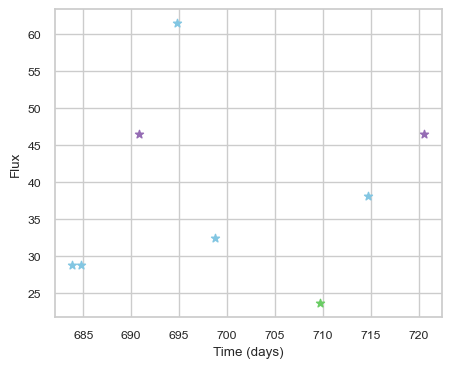

SNIax (4.7692523, False)
SNIax (5.0148525, False)
SNIax (4.9527555, False)
SNIax (5.3818555, False)
SNIax (5.14923, False)
SNIax (5.5067906, False)
SNIax (5.8215685, False)
SNIax (5.912151, False)
SNIax (5.9885964, False)
SNIax (6.0243917, False)
SNIax (5.3160753, False)
SNIax (5.891897, False)
SNIax (5.7817607, False)
SNIax (5.781467, False)
SNIax (5.4680676, False)
SNIax (5.4833846, False)


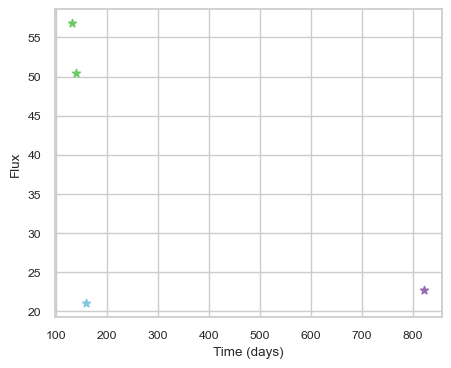

SNIax (3.8433015, False)
SNIax (4.333227, False)
SNIax (4.280252, False)
SNIax (3.8792896, False)
SNIax (4.1862836, False)
SNIax (4.856865, False)
SNIax (4.549645, False)
SNIax (4.4459805, False)


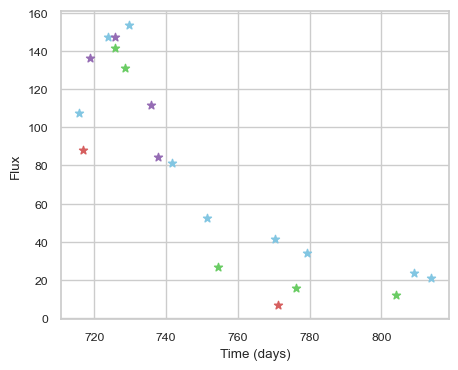

SNIax (3.788969, False)
SNIax (3.5796633, False)
SNIax (4.2352214, False)
SNIax (4.091141, False)
SNIax (4.246089, False)
SNIax (4.154044, False)
SNIax (4.110085, False)
SNIax (3.475699, False)
SNIax (3.2309644, False)
SNIax (3.0176172, False)
SNIax (3.8037484, False)
SNIax (3.1104422, False)
SNIax (3.645699, False)
SNIax (3.357046, False)
SNIax (3.0185091, False)
SNIax (2.8822687, False)
SNIax (3.0413356, False)
SNIax (2.5814831, False)
SNIax (2.7285128, False)
SNIax (2.8355875, False)
SNIax (3.1901257, False)
SNIax (3.1880481, False)
SNIax (3.6922622, False)
SNIax (2.3326056, False)
SNIax (3.2472522, False)
SNIax (2.5834959, False)
SNIax (3.0301228, False)
SNIax (2.5480142, False)
SNIax (2.7559745, False)
SNIax (2.8476448, False)
SNIax (2.8202138, False)
SNIax (2.7508938, False)
SNIax (3.0362725, False)
SNIax (2.659718, False)
SNIax (2.9962504, False)
SNIax (2.4388344, False)
SNIax (3.271826, False)
SNIax (2.3550556, False)
SNIax (2.8350003, False)
SNIax (2.5799823, False)


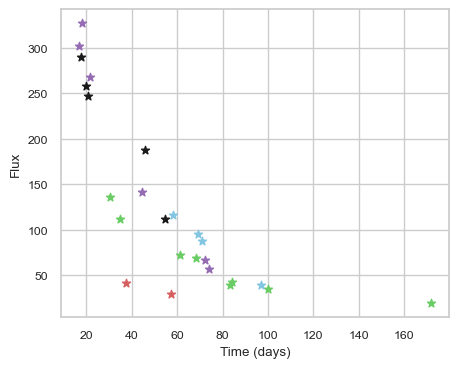

SNIax (5.3743052, False)
SNIax (4.0760813, False)
SNIax (3.0090773, False)
SNIax (3.4872243, False)
SNIax (3.6715422, False)
SNIax (3.2598286, False)
SNIax (3.4641423, False)
SNIax (3.8189855, False)
SNIax (3.66914, False)
SNIax (3.2262154, False)
SNIax (4.1547084, False)
SNIax (3.5950642, False)
SNIax (2.9963384, False)
SNIax (2.8126934, False)
SNIax (2.5741544, False)
SNIax (2.6502583, False)
SNIax (2.869723, False)
SNIax (3.0609622, False)
SNIax (3.1295733, False)
SNIax (3.0190334, False)
SNIax (3.2664695, False)
SNIax (3.1009579, False)
SNIax (3.2205439, False)
SNIax (3.5078537, False)
SNIax (3.0686266, False)
SNIax (2.7523353, False)
SNIax (3.1903706, False)
SNIax (2.524682, False)
SNIax (3.3312526, False)
SNIax (2.5114098, False)
SNIax (2.906423, False)
SNIax (2.7611182, False)
SNIax (2.5813043, False)
SNIax (2.376716, False)
SNIax (3.2905722, False)
SNIax (2.360065, False)
SNIax (2.7492297, False)
SNIax (2.7386148, False)
SNIax (2.819691, False)
SNIax (2.7303748, False)
SNIax (2

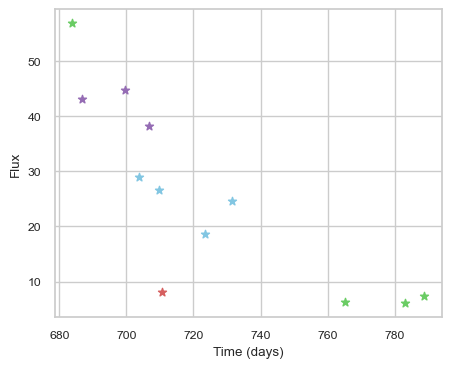

SNIax (6.286245, False)
SNIax (6.1405983, False)
SNIax (3.449393, False)
SNIax (3.5511055, False)
SNIax (3.8029149, False)
SNIax (4.9786186, False)
SNIax (4.768066, False)
SNIax (5.4476323, False)
SNIax (4.3727884, False)
SNIax (5.325113, False)
SNIax (4.7002816, False)
SNIax (5.083419, False)
SNIax (3.6765563, False)
SNIax (4.9838037, False)
SNIax (4.528341, False)
SNIax (4.7618423, False)
SNIax (3.974181, False)
SNIax (4.8150086, False)
SNIax (6.2940803, False)
SNIax (5.636106, False)
SNIax (5.3994784, False)
SNIax (4.742499, False)
SNIax (5.2611036, False)
SNIax (4.5486364, False)


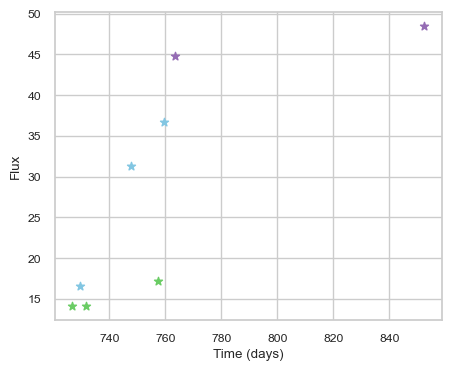

SNIax (4.3392906, False)
SNIax (3.4690318, False)
SNIax (3.3188517, False)
SNIax (3.1247754, False)
SNIax (2.9771214, False)
SNIax (2.6200948, False)
SNIax (2.4391842, False)
SNIax (2.1363747, False)
SNIax (2.4716334, False)
SNIax (2.3572438, False)
SNIax (2.7440836, False)
SNIax (2.5152392, False)
SNIax (3.4612699, False)
SNIax (2.9622927, False)
SNIax (3.4718862, False)
SNIax (3.6458552, False)


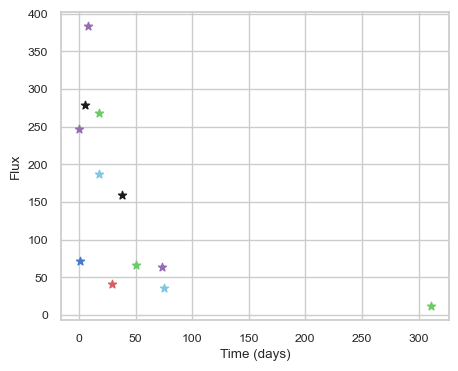

SNIax (3.9822934, False)
SNIax (3.2545352, False)
SNIax (2.9565692, False)
SNIax (3.5526836, False)
SNIax (3.1862757, False)
SNIax (3.5502079, False)
SNIax (3.2144883, False)
SNIax (2.7327006, False)
SNIax (2.929553, False)
SNIax (2.9882715, False)
SNIax (3.5501742, False)
SNIax (3.2359488, False)
SNIax (3.2594824, False)
SNIax (3.8497105, False)
SNIax (3.5779274, False)
SNIax (3.5176082, False)
SNIax (3.2410593, False)
SNIax (3.3796706, False)
SNIax (3.2289426, False)
SNIax (3.5647342, False)
SNIax (2.8103395, False)
SNIax (3.380688, False)
SNIax (3.3628197, False)


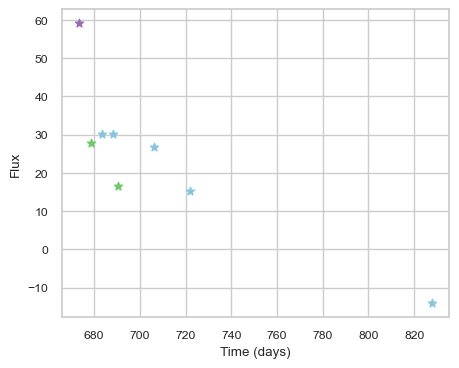

SNIax (3.825857, False)
SNIax (3.6560392, False)
SNIax (3.6957948, False)
SNIax (3.1053224, False)
SNIax (3.7465503, False)
SNIax (3.522095, False)
SNIax (3.310967, False)
SNIax (3.8860447, False)
SNIax (3.4595063, False)
SNIax (4.3213463, False)
SNIax (3.5138834, False)
SNIax (3.9950774, False)
SNIax (4.3320436, False)
SNIax (3.8436792, False)
SNIax (3.9337392, False)
SNIax (4.131363, False)


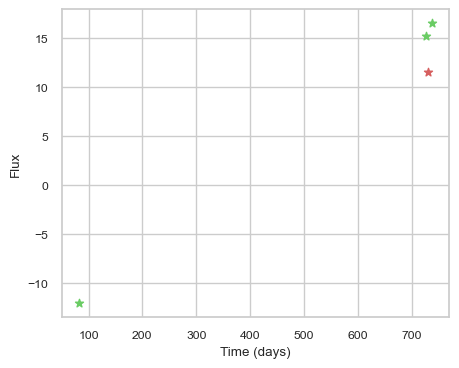

SNIax (3.7761562, False)
SNIax (4.1261644, False)
SNIax (3.651437, False)
SNIax (3.1098514, False)
SNIax (3.1915853, False)
SNIax (2.8057764, False)
SNIax (2.877792, False)
SNIax (2.7565503, False)


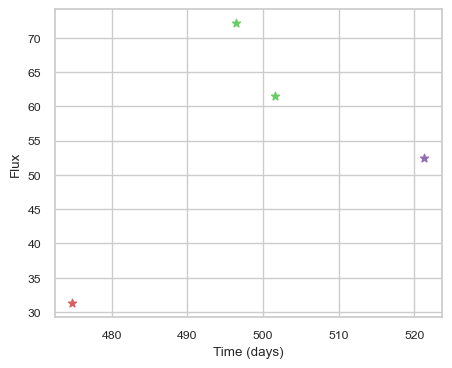

SNIax (3.93903, False)
SNIax (4.717625, False)
SNIax (4.1013026, False)
SNIax (3.0892236, False)
SNIax (4.504641, False)
SNIax (4.222803, False)
SNIax (3.7371085, False)
SNIax (3.4677873, False)


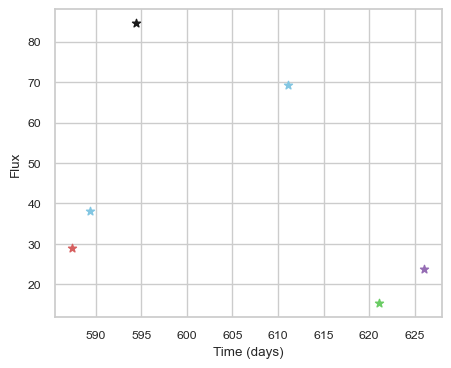

SNIax (3.7967434, False)
SNIax (3.7971015, False)
SNIax (4.557085, False)
SNIax (4.336453, False)
SNIax (4.27717, False)
SNIax (4.1050158, False)
SNIax (3.3991494, False)
SNIax (3.4179082, False)
SNIax (3.7295053, False)
SNIax (2.7393403, False)
SNIax (2.932011, False)
SNIax (2.3102772, False)


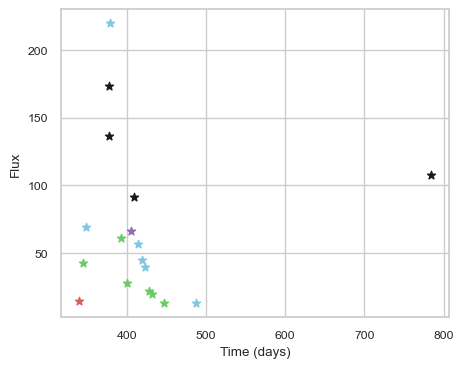

SNIax (3.9213004, False)
SNIax (4.1325955, False)
SNIax (4.022099, False)
SNIax (2.8310988, False)
SNIax (3.1730702, False)
SNIax (3.3002563, False)
SNIax (3.555921, False)
SNIax (3.4193282, False)
SNIax (4.3230796, False)
SNIax (3.59866, False)
SNIax (4.390401, False)
SNIax (3.5381527, False)
SNIax (3.0347083, False)
SNIax (3.4330022, False)
SNIax (3.7072918, False)
SNIax (3.9013855, False)
SNIax (3.9459105, False)
SNIax (3.727165, False)
SNIax (3.5964122, False)
SNIax (3.562866, False)
SNIax (3.2908163, False)
SNIax (3.544978, False)
SNIax (3.9241395, False)
SNIax (3.5092363, False)
SNIax (3.3877106, False)
SNIax (3.4389904, False)
SNIax (3.2296953, False)
SNIax (3.280511, False)
SNIax (3.656901, False)
SNIax (3.314549, False)
SNIax (3.2307925, False)
SNIax (3.3040512, False)
SNIax (3.1715627, False)
SNIax (3.187694, False)
SNIax (2.750599, False)
SNIax (3.723459, False)


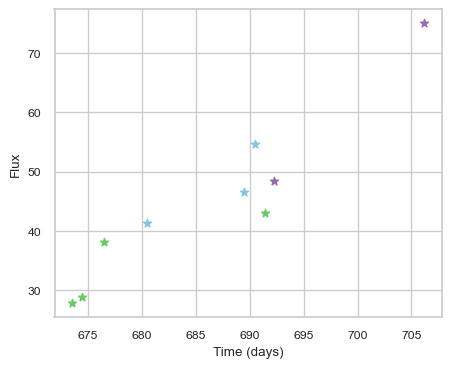

SNIax (4.1818657, False)
SNIax (4.0834627, False)
SNIax (3.5745451, False)
SNIax (3.3397198, False)
SNIax (3.1558042, False)
SNIax (3.4486434, False)
SNIax (4.0843544, False)
SNIax (4.0476127, False)
SNIax (3.444587, False)
SNIax (3.6267502, False)
SNIax (3.815382, False)
SNIax (3.257066, False)
SNIax (4.054848, False)
SNIax (3.6666417, False)
SNIax (4.114481, False)
SNIax (3.8286262, False)
SNIax (4.745765, False)
SNIax (4.2414174, False)


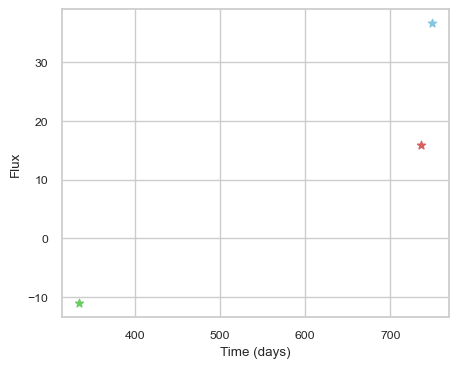

SNIax (4.0659447, False)
SNIax (4.4300466, False)
SNIax (4.0083256, False)
SNIax (4.086649, False)
SNIax (3.6712809, False)
SNIax (2.8500588, False)


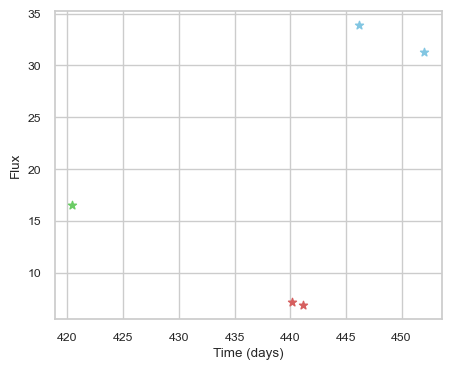

SNIax (4.0102124, False)
SNIax (3.6042912, False)
SNIax (3.4043412, False)
SNIax (3.4813855, False)
SNIax (3.1832972, False)
SNIax (3.2730398, False)
SNIax (3.1389794, False)
SNIax (3.0972068, False)
SNIax (3.4687388, False)
SNIax (3.2873416, False)


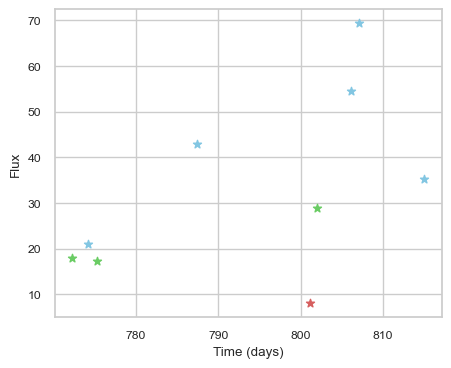

SNIax (4.068925, False)
SNIax (3.3733304, False)
SNIax (3.287063, False)
SNIax (2.9107451, False)
SNIax (2.8124142, False)
SNIax (2.386237, False)
SNIax (2.3996873, False)
SNIax (2.719647, False)
SNIax (3.3110623, False)
SNIax (3.003067, False)
SNIax (3.635621, False)
SNIax (3.0656772, False)
SNIax (3.2878313, False)
SNIax (3.4145424, False)
SNIax (4.0225058, False)
SNIax (3.4743931, False)
SNIax (3.7912204, False)
SNIax (3.3141282, False)


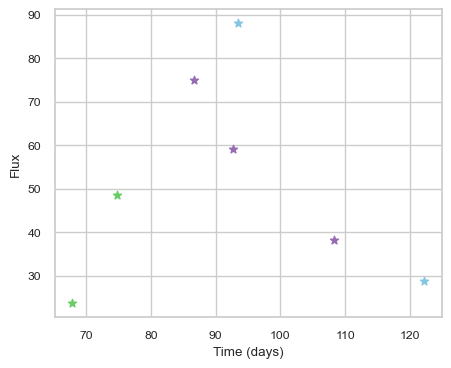

SNIax (3.9652727, False)
SNIax (3.8010578, False)
SNIax (3.4189405, False)
SNIax (2.825855, False)
SNIax (3.506441, False)
SNIax (3.1412628, False)
SNIax (3.4140258, False)
SNIax (2.7713118, False)
SNIax (3.5025136, False)
SNIax (3.6924546, False)
SNIax (4.316005, False)
SNIax (3.8803504, False)
SNIax (4.452057, False)
SNIax (4.0374465, False)


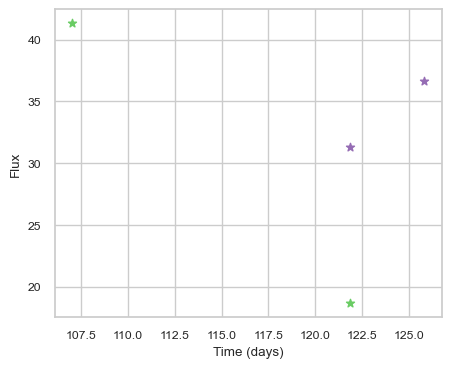

SNIax (4.319619, False)
SNIax (4.259041, False)
SNIax (4.1010046, False)
SNIax (4.1229076, False)
SNIax (3.8028793, False)
SNIax (4.808144, False)
SNIax (5.361817, False)
SNIax (5.190673, False)


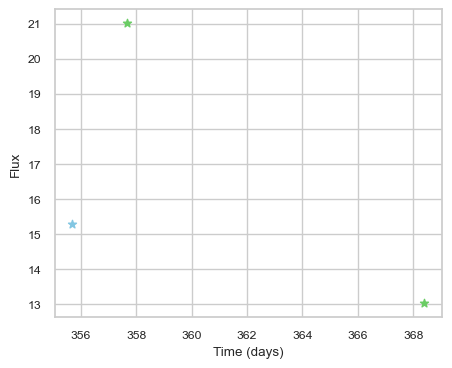

SNIax (4.063536, False)
SNIax (3.6623197, False)
SNIax (3.2275496, False)
SNIax (3.073051, False)
SNIax (3.0708044, False)
SNIax (3.7259507, False)


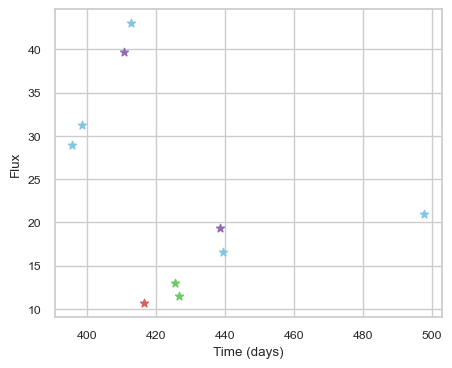

SNIax (3.9004366, False)
SNIax (3.401442, False)
SNIax (3.2612379, False)
SNIax (3.4707437, False)
SNIax (3.2385821, False)
SNIax (3.6235611, False)
SNIax (3.8432071, False)
SNIax (3.8644962, False)
SNIax (3.9015272, False)
SNIax (3.6486971, False)
SNIax (3.125231, False)
SNIax (3.2775939, False)
SNIax (3.4332612, False)
SNIax (3.2553778, False)
SNIax (3.1220312, False)
SNIax (3.2401567, False)
SNIax (3.262187, False)
SNIax (2.8878388, False)
SNIax (3.1479926, False)
SNIax (2.9877367, False)


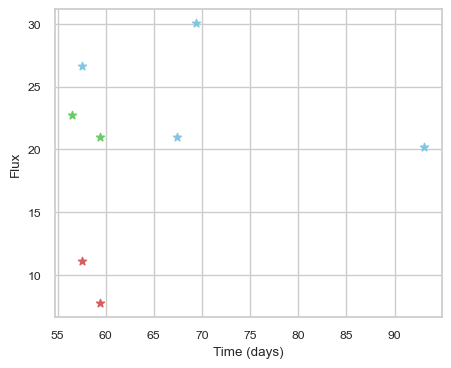

SNIax (4.003966, False)
SNIax (3.3885088, False)
SNIax (3.531686, False)
SNIax (3.3422706, False)
SNIax (3.0689995, False)
SNIax (3.0201542, False)
SNIax (3.6780787, False)
SNIax (3.0687377, False)
SNIax (3.07021, False)
SNIax (2.7577007, False)
SNIax (2.7183623, False)
SNIax (2.663359, False)
SNIax (2.8227131, False)
SNIax (3.1393883, False)
SNIax (2.997793, False)
SNIax (3.354664, False)


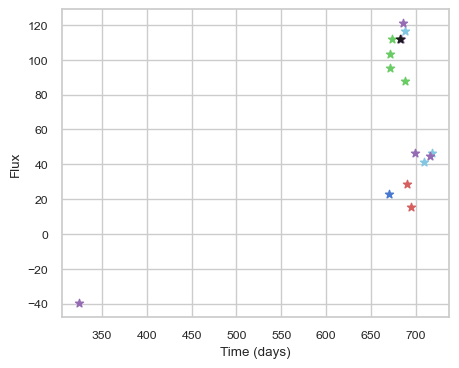

SNIax (4.0286617, False)
SNIax (4.2554936, False)
SNIax (4.421125, False)
SNIax (4.7008543, False)
SNIax (4.6931243, False)
SNIax (4.485717, False)
SNIax (4.7299323, False)
SNIax (5.054863, False)
SNIax (5.26302, False)
SNIax (5.0721197, False)
SNIax (4.956427, False)
SNIax (4.7464185, False)
SNIax (5.54702, False)
SNIax (5.0655007, False)
SNIax (5.161582, False)
SNIax (4.9428434, False)
SNIax (4.7728367, False)
SNIax (4.248837, False)
SNIax (4.242764, False)
SNIax (4.5923996, False)
SNIax (3.2973633, False)
SNIax (3.2201147, False)
SNIax (3.8803666, False)
SNIax (3.9469376, False)
SNIax (4.264951, False)
SNIax (4.5400734, False)
SNIax (4.5362105, False)
SNIax (3.7515087, False)
SNIax (4.5007834, False)
SNIax (3.6011715, False)
SNIax (4.0657454, False)
SNIax (3.8430607, False)


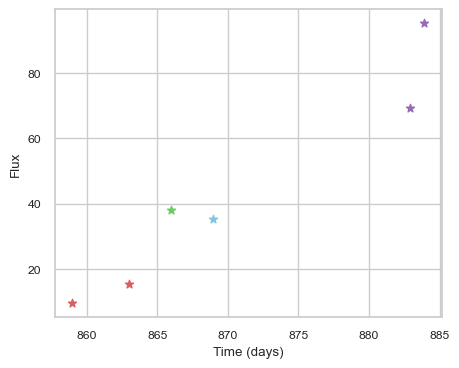

SNIax (3.7954319, False)
SNIax (3.9611251, False)
SNIax (3.2210193, False)
SNIax (3.3702385, False)
SNIax (2.7704918, False)
SNIax (2.919574, False)
SNIax (3.2735155, False)
SNIax (3.0511785, False)
SNIax (2.8355007, False)
SNIax (2.91305, False)
SNIax (4.2638874, False)
SNIax (3.8714354, False)


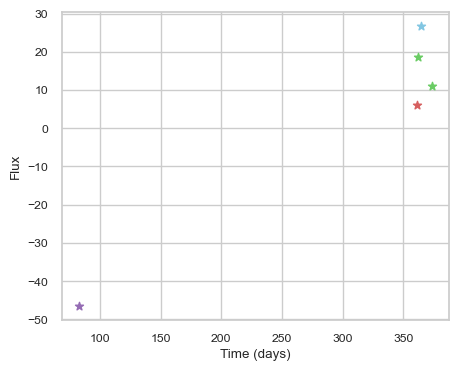

SNIax (3.91, False)
SNIax (3.7691917, False)
SNIax (3.6869287, False)
SNIax (3.6888015, False)
SNIax (3.925892, False)
SNIax (3.353489, False)
SNIax (3.1576974, False)
SNIax (2.8086398, False)
SNIax (3.2350044, False)
SNIax (3.2506893, False)


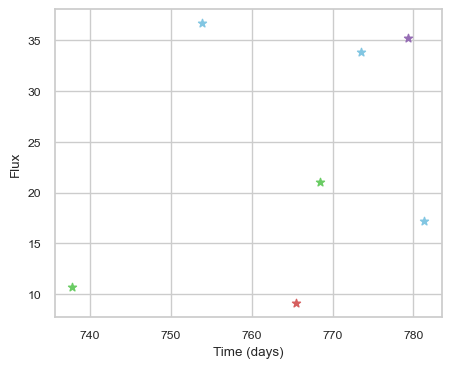

SNIax (4.0710936, False)
SNIax (3.1754246, False)
SNIax (3.2374785, False)
SNIax (3.0655806, False)
SNIax (2.7733543, False)
SNIax (2.594579, False)
SNIax (2.6652822, False)
SNIax (2.4139054, False)
SNIax (2.5916185, False)
SNIax (2.889796, False)
SNIax (2.8313084, False)
SNIax (2.84324, False)
SNIax (2.8559675, False)
SNIax (2.6707828, False)


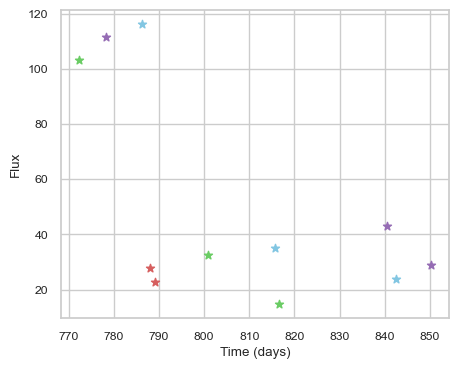

SNIax (3.879832, False)
SNIax (3.8776617, False)
SNIax (5.2380075, False)
SNIax (4.998749, False)
SNIax (5.6295557, False)
SNIax (5.7454076, False)
SNIax (5.719756, False)
SNIax (6.067909, False)
SNIax (6.2490325, False)
SNIax (6.560261, False)
SNIax (6.4419665, False)
SNIax (6.586315, False)
SNIax (6.0393333, False)
SNIax (6.5565205, False)
SNIax (6.2350883, False)
SNIax (6.351734, False)
SNIax (6.248993, False)
SNIax (6.5236044, False)
SNIax (6.7704544, False)
SNIax (6.2461286, False)
SNIax (6.211675, False)
SNIax (6.3996587, False)


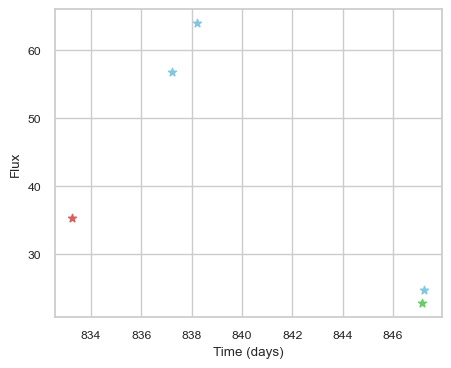

SNIax (4.1379704, False)
SNIax (4.951853, False)
SNIax (4.8025846, False)
SNIax (3.832493, False)
SNIax (3.7078097, False)
SNIax (3.6898417, False)
SNIax (3.6263144, False)
SNIax (2.9876587, False)
SNIax (3.6527214, False)
SNIax (2.8792312, False)


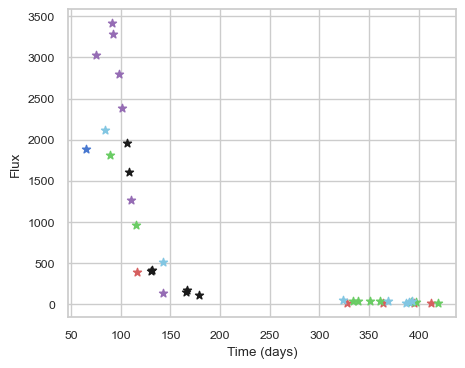

SNIax (3.7237356, False)
SNIax (4.3976135, False)
SNIax (2.828366, False)
SNIax (3.8444967, False)
SNIax (2.0161312, False)
SNIax (3.551971, False)
SNIax (1.9485333, False)
SNIax (2.5697324, False)
SNIax (2.4563832, False)
SNIax (3.0994983, False)
SNIax (2.0598404, False)
SNIax (3.1723778, False)
SNIax (1.6454833, False)
SNIax (2.7456243, False)
SNIax (1.7109705, False)
SNIax (3.0133865, False)
SNIax (1.8574862, False)
SNIax (2.6369913, False)
SNIax (1.9482583, False)
SNIax (2.1963387, False)
SNIax (2.1852758, False)
SNIax (2.4284816, False)
SNIax (2.026013, False)
SNIax (2.2406147, False)
SNIax (1.6866347, False)
SNIax (2.3901448, False)
SNIax (2.976791, False)
SNIax (2.964115, False)
SNIax (3.4032924, False)
SNIax (3.973356, False)
SNIax (3.349933, False)
SNIax (3.6141846, False)
SNIax (2.708635, False)
SNIax (4.0210934, False)
SNIax (4.0421963, False)
SNIax (4.6273813, False)
SNIax (3.9652288, False)
SNIax (5.0402675, False)
SNIax (4.1444907, False)
SNIax (4.810257, False)
SNIax (4.

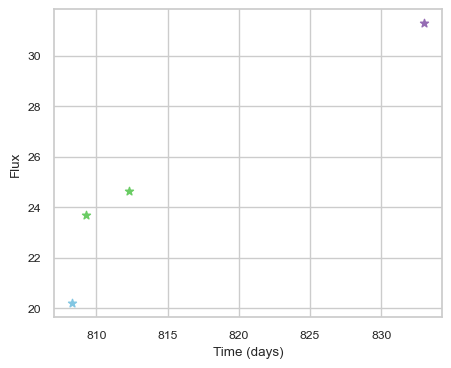

SNIax (3.9614148, False)
SNIax (3.4060726, False)
SNIax (3.236699, False)
SNIax (2.9119778, False)
SNIax (3.389682, False)
SNIax (2.5905352, False)
SNIax (2.7273872, False)
SNIax (3.5212271, False)


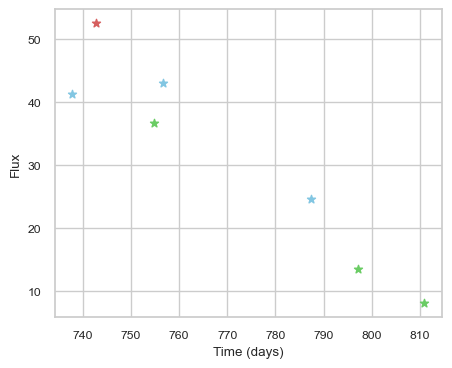

SNIax (3.707305, False)
SNIax (3.3350902, False)
SNIax (3.1562128, False)
SNIax (3.7978063, False)
SNIax (3.4262948, False)
SNIax (4.4392033, False)
SNIax (5.299505, False)
SNIax (5.7660623, False)
SNIax (6.629033, False)
SNIax (6.710224, False)
SNIax (5.574502, False)
SNIax (6.141771, False)
SNIax (5.275418, False)
SNIax (4.9777055, False)


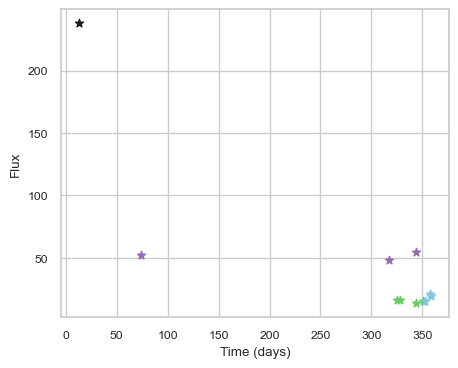

SNIax (3.9567757, False)
SNIax (3.308712, False)
SNIax (4.18702, False)
SNIax (4.2090077, False)
SNIax (4.2745132, False)
SNIax (3.5551164, False)
SNIax (4.029059, False)
SNIax (3.6587474, False)
SNIax (3.8527896, False)
SNIax (3.5207508, False)
SNIax (3.6303356, False)
SNIax (3.5933328, False)
SNIax (4.117681, False)
SNIax (3.3400881, False)
SNIax (3.522063, False)
SNIax (3.8056586, False)
SNIax (3.540456, False)
SNIax (3.4071805, False)
SNIax (3.5251915, False)
SNIax (3.4607337, False)
SNIax (3.1634874, False)
SNIax (3.4605615, False)


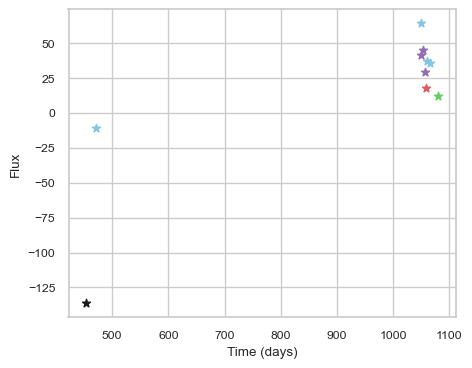

SNIax (3.9528174, False)
SNIax (3.6090236, False)
SNIax (4.0485306, False)
SNIax (4.059457, False)
SNIax (3.7022269, False)
SNIax (3.5851665, False)
SNIax (3.7733955, False)
SNIax (3.769179, False)
SNIax (4.4565506, False)
SNIax (3.0545764, False)
SNIax (3.4596994, False)
SNIax (2.7070034, False)
SNIax (3.1830714, False)
SNIax (2.8405473, False)
SNIax (3.205169, False)
SNIax (3.131948, False)
SNIax (2.99592, False)
SNIax (3.1850457, False)
SNIax (3.4105158, False)
SNIax (3.3250127, False)


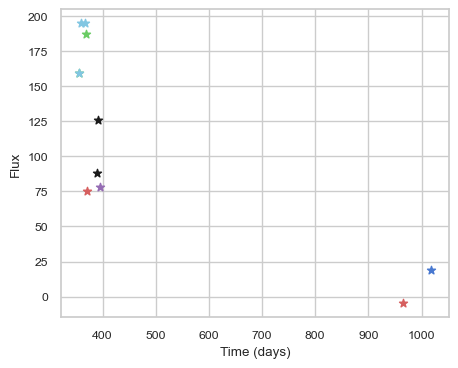

SNIax (3.753026, False)
SNIax (3.5724287, False)
SNIax (5.2322726, False)
SNIax (5.5989866, False)
SNIax (5.7784247, False)
SNIax (5.6462116, False)
SNIax (5.7024794, False)
SNIax (5.4350586, False)
SNIax (5.078355, False)
SNIax (5.3087993, False)
SNIax (5.4388113, False)
SNIax (5.38635, False)
SNIax (6.0218754, False)
SNIax (6.0442095, False)
SNIax (6.556255, False)
SNIax (6.064314, False)
SNIax (5.615697, False)
SNIax (5.75463, False)
SNIax (6.6607137, False)
SNIax (6.1002564, False)
SNIax (6.8726034, False)
SNIax (6.464596, False)


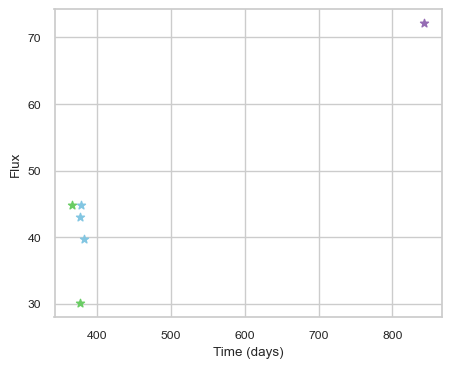

SNIax (3.8103192, False)
SNIax (3.0928717, False)
SNIax (3.119408, False)
SNIax (2.7276957, False)
SNIax (4.164814, False)
SNIax (4.418171, False)
SNIax (4.740004, False)
SNIax (3.7298732, False)
SNIax (5.2754, False)
SNIax (3.9851415, False)
SNIax (5.2467127, False)
SNIax (5.393195, False)


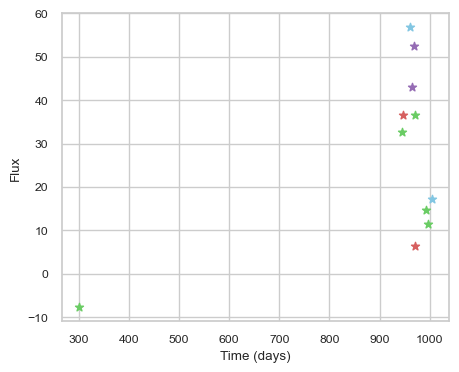

SNIax (4.022909, False)
SNIax (4.405188, False)
SNIax (3.9397447, False)
SNIax (3.581245, False)
SNIax (3.057446, False)
SNIax (3.4479074, False)
SNIax (3.2146885, False)
SNIax (2.5726354, False)
SNIax (2.7496367, False)
SNIax (2.5165048, False)
SNIax (3.1608083, False)
SNIax (3.7825348, False)
SNIax (3.8338044, False)
SNIax (4.050527, False)
SNIax (4.979076, False)
SNIax (4.909744, False)
SNIax (4.4959435, False)
SNIax (3.7770562, False)
SNIax (3.8872585, False)
SNIax (3.3859012, False)
SNIax (3.3843288, False)
SNIax (3.242486, False)


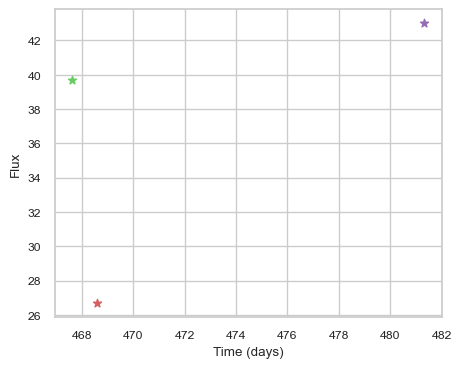

SNIax (4.093303, False)
SNIax (4.0560427, False)
SNIax (3.897843, False)
SNIax (3.7936792, False)
SNIax (3.4024467, False)
SNIax (3.5089087, False)


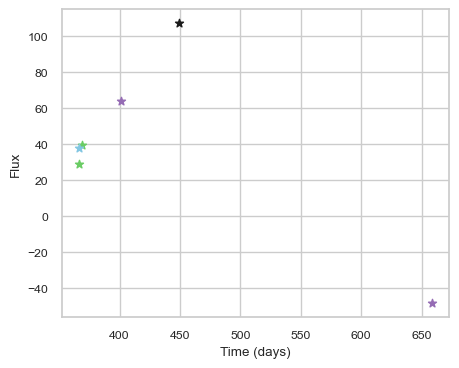

SNIax (4.178272, False)
SNIax (3.3412871, False)
SNIax (3.4717202, False)
SNIax (3.5401947, False)
SNIax (3.5769482, False)
SNIax (3.6194763, False)
SNIax (4.4030824, False)
SNIax (4.599131, False)
SNIax (4.905797, False)
SNIax (4.8760786, False)
SNIax (5.1180377, False)
SNIax (4.983389, False)


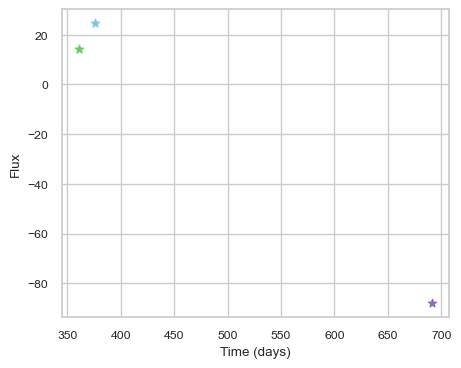

SNIax (4.3703637, False)
SNIax (3.6232088, False)
SNIax (3.4823003, False)
SNIax (3.017471, False)
SNIax (4.3479085, False)
SNIax (4.432283, False)


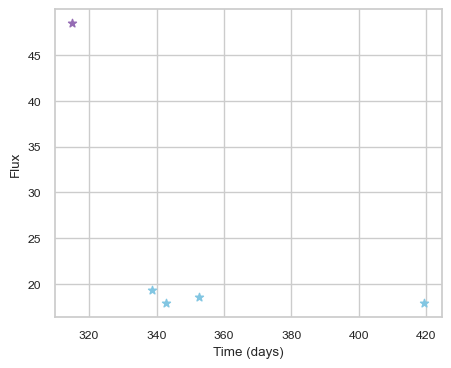

SNIax (3.8260925, False)
SNIax (3.8028595, False)
SNIax (3.999681, False)
SNIax (3.6528406, False)
SNIax (3.739542, False)
SNIax (3.7294838, False)
SNIax (3.6183867, False)
SNIax (3.8894653, False)
SNIax (4.722359, False)
SNIax (4.2137175, False)


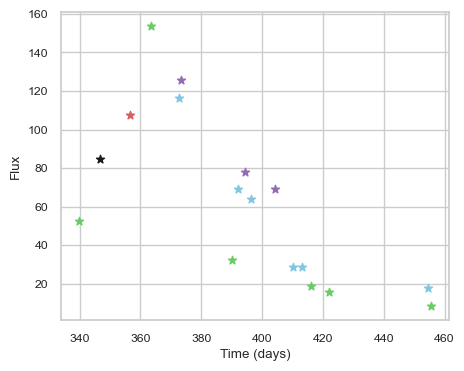

SNIax (3.9099152, False)
SNIax (3.9305863, False)
SNIax (3.806102, False)
SNIax (4.076926, False)
SNIax (3.5198698, False)
SNIax (4.107942, False)
SNIax (5.2459726, False)
SNIax (5.400537, False)
SNIax (5.5385513, False)
SNIax (5.476627, False)
SNIax (5.935586, False)
SNIax (5.591798, False)
SNIax (6.351031, False)
SNIax (6.0608473, False)
SNIax (6.05633, False)
SNIax (6.0930543, False)
SNIax (6.232147, False)
SNIax (6.1436095, False)
SNIax (6.3348074, False)
SNIax (6.2653055, False)
SNIax (6.115582, False)
SNIax (5.9048977, False)
SNIax (6.2767854, False)
SNIax (6.248758, False)
SNIax (5.841448, False)
SNIax (6.011826, False)
SNIax (5.8796406, False)
SNIax (5.7595396, False)
SNIax (5.789542, False)
SNIax (5.751545, False)
SNIax (5.893624, False)
SNIax (5.7129073, False)
SNIax (5.297929, False)
SNIax (5.443194, False)


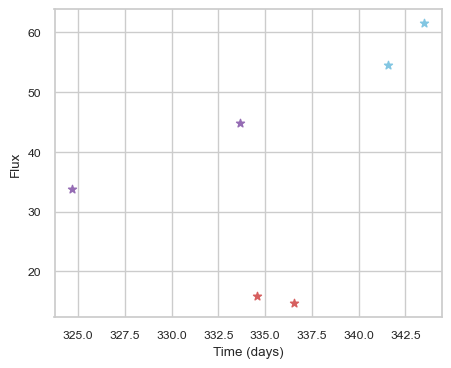

SNIax (4.009628, False)
SNIax (3.7612712, False)
SNIax (3.6954052, False)
SNIax (3.2305677, False)
SNIax (3.5826132, False)
SNIax (3.5386374, False)
SNIax (3.469353, False)
SNIax (3.1294153, False)
SNIax (3.5465665, False)
SNIax (3.781252, False)
SNIax (3.9995093, False)
SNIax (4.108859, False)


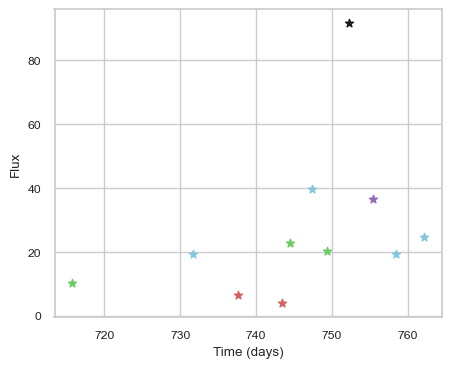

SNIax (4.232312, False)
SNIax (3.4850838, False)
SNIax (3.262725, False)
SNIax (3.1174219, False)
SNIax (3.1022644, False)
SNIax (3.0798478, False)
SNIax (3.016133, False)
SNIax (3.0151834, False)
SNIax (2.9002614, False)
SNIax (2.0606053, False)
SNIax (2.5825403, False)
SNIax (2.716338, False)
SNIax (3.0263476, False)
SNIax (2.4908144, False)
SNIax (3.1002698, False)
SNIax (2.6759684, False)
SNIax (3.74075, False)
SNIax (3.2869532, False)
SNIax (2.9745622, False)
SNIax (2.8130918, False)
SNIax (2.7238836, False)
SNIax (2.8331785, False)


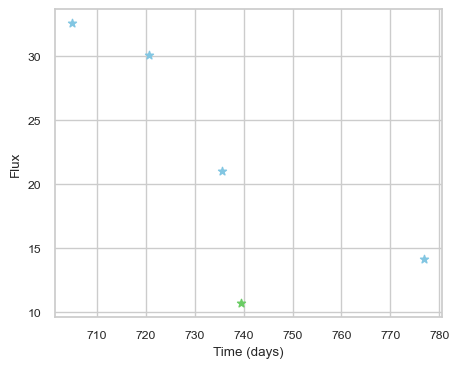

SNIax (3.815888, False)
SNIax (3.4608295, False)
SNIax (3.3926115, False)
SNIax (3.4861052, False)
SNIax (4.264563, False)
SNIax (4.3033557, False)
SNIax (4.523746, False)
SNIax (3.7865565, False)
SNIax (4.0997324, False)
SNIax (3.9617105, False)


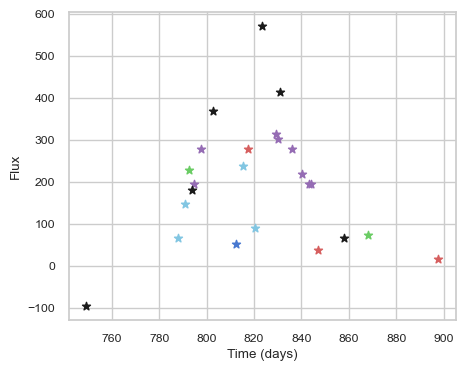

SNIax (3.5276635, False)
SNIax (3.7342367, False)
SNIax (3.440794, False)
SNIax (3.4754536, False)
SNIax (3.4273336, False)
SNIax (4.011548, False)
SNIax (3.1049345, False)
SNIax (3.2663932, False)
SNIax (3.1842167, False)
SNIax (3.8966534, False)
SNIax (3.653154, False)
SNIax (3.3300579, False)
SNIax (3.5940673, False)
SNIax (3.3325171, False)
SNIax (3.190082, False)
SNIax (3.8405685, False)
SNIax (3.0471065, False)
SNIax (3.880164, False)
SNIax (2.985247, False)
SNIax (3.395063, False)
SNIax (2.9708502, False)
SNIax (3.5304193, False)
SNIax (3.3642526, False)
SNIax (3.3820212, False)
SNIax (2.9720206, False)
SNIax (3.3395352, False)
SNIax (2.9477234, False)
SNIax (3.6253536, False)
SNIax (3.602454, False)
SNIax (3.8007586, False)
SNIax (3.5669603, False)
SNIax (4.0623355, False)
SNIax (3.3109524, False)
SNIax (3.5099466, False)
SNIax (3.5766592, False)
SNIax (3.670128, False)
SNIax (3.9388192, False)
SNIax (3.817619, False)
SNIax (4.0583186, False)
SNIax (3.8331985, False)
SNIax (3.7

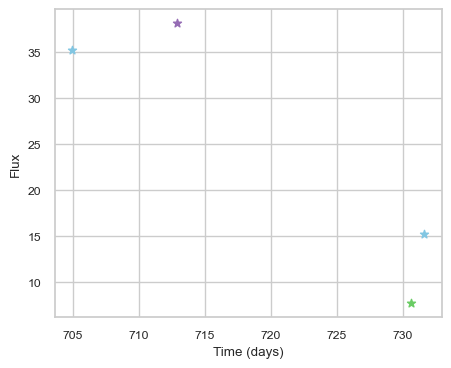

SNIax (3.8497627, False)
SNIax (3.5100374, False)
SNIax (3.3370335, False)
SNIax (3.180843, False)
SNIax (4.047562, False)
SNIax (4.04351, False)
SNIax (3.8301585, False)
SNIax (3.6393876, False)


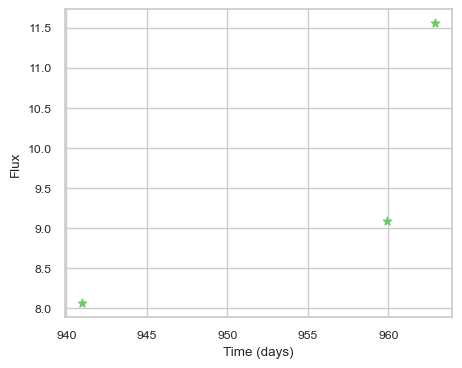

SNIax (3.6804206, False)
SNIax (3.4829683, False)
SNIax (3.3325036, False)
SNIax (3.0842135, False)
SNIax (3.0754128, False)
SNIax (2.9822445, False)


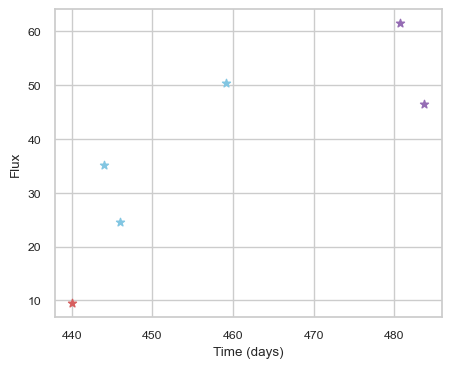

SNIax (3.860409, False)
SNIax (4.213991, False)
SNIax (3.4758794, False)
SNIax (3.353581, False)
SNIax (3.2098792, False)
SNIax (3.176057, False)
SNIax (2.7348702, False)
SNIax (3.6209278, False)
SNIax (3.6380458, False)
SNIax (3.531941, False)
SNIax (3.6894565, False)
SNIax (3.8484292, False)


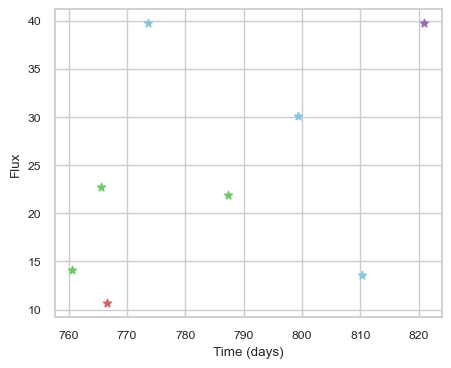

SNIax (4.7029285, False)
SNIax (3.631103, False)
SNIax (3.7249358, False)
SNIax (3.189347, False)
SNIax (3.3383434, False)
SNIax (3.4747849, False)
SNIax (3.2987592, False)
SNIax (3.9264278, False)
SNIax (4.732631, False)
SNIax (4.775772, False)
SNIax (4.829199, False)
SNIax (4.5528646, False)
SNIax (4.24177, False)
SNIax (3.9983857, False)
SNIax (3.8747034, False)
SNIax (3.7424064, False)


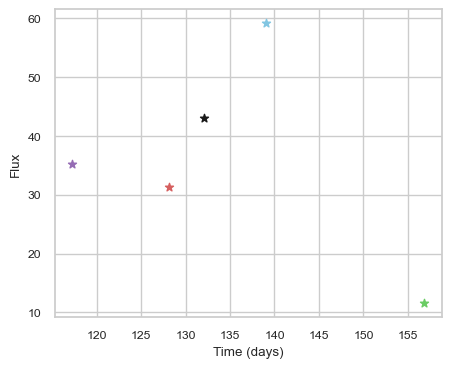

SNIax (3.8620386, False)
SNIax (3.9697473, False)
SNIax (3.6157663, False)
SNIax (4.0381103, False)
SNIax (4.1216288, False)
SNIax (3.7026696, False)
SNIax (3.611739, False)
SNIax (3.4860704, False)
SNIax (3.3045301, False)
SNIax (3.1044114, False)


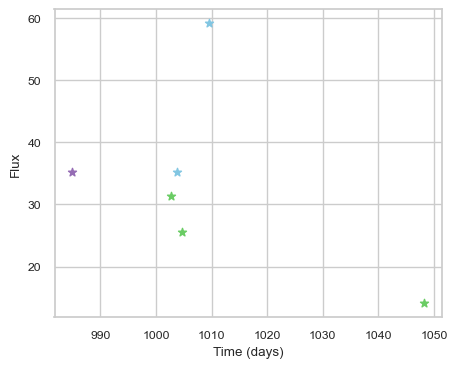

SNIax (3.9161968, False)
SNIax (3.5897925, False)
SNIax (3.6138768, False)
SNIax (3.188276, False)
SNIax (3.7791145, False)
SNIax (3.9036622, False)
SNIax (3.580905, False)
SNIax (3.9006474, False)
SNIax (4.3158484, False)
SNIax (4.6767387, False)
SNIax (3.9353714, False)
SNIax (3.8935835, False)


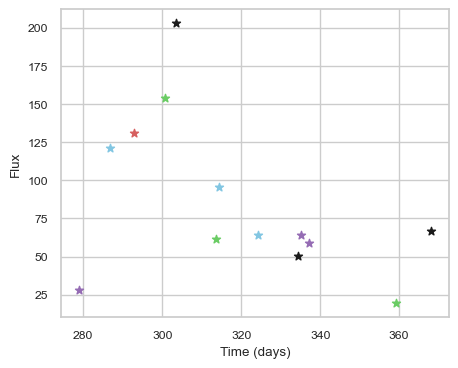

SNIax (3.8012254, False)
SNIax (4.147188, False)
SNIax (2.9771402, False)
SNIax (3.8836212, False)
SNIax (3.8225605, False)
SNIax (3.3456893, False)
SNIax (4.21094, False)
SNIax (4.6199803, False)
SNIax (4.179295, False)
SNIax (4.835217, False)
SNIax (3.0747204, False)
SNIax (2.875662, False)
SNIax (3.01413, False)
SNIax (3.0385883, False)
SNIax (3.740096, False)
SNIax (3.3536623, False)
SNIax (4.386743, False)
SNIax (3.1357381, False)
SNIax (3.9160304, False)
SNIax (3.4353952, False)
SNIax (3.6026769, False)
SNIax (3.5291562, False)
SNIax (3.3302708, False)
SNIax (3.4364648, False)
SNIax (3.6555128, False)
SNIax (3.1178594, False)


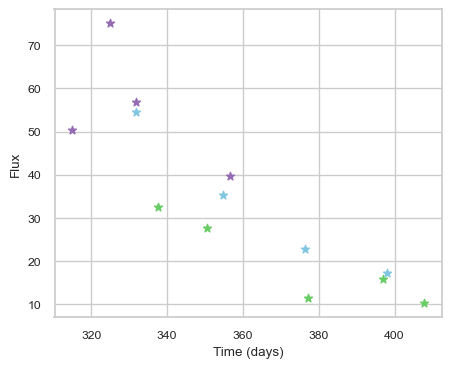

SNIax (3.7620516, False)
SNIax (3.8413882, False)
SNIax (4.010352, False)
SNIax (3.9939985, False)
SNIax (4.1863623, False)
SNIax (4.9771996, False)
SNIax (4.983168, False)
SNIax (5.1441836, False)
SNIax (5.4622173, False)
SNIax (5.1516356, False)
SNIax (5.128307, False)
SNIax (5.2889295, False)
SNIax (5.0661316, False)
SNIax (5.164399, False)
SNIax (4.7279205, False)
SNIax (5.684846, False)
SNIax (4.8003035, False)
SNIax (5.1706553, False)
SNIax (4.755955, False)
SNIax (4.6484094, False)
SNIax (3.8211775, False)
SNIax (4.6394844, False)
SNIax (4.4589014, False)
SNIax (4.2639346, False)
SNIax (3.6803682, False)
SNIax (4.068427, False)


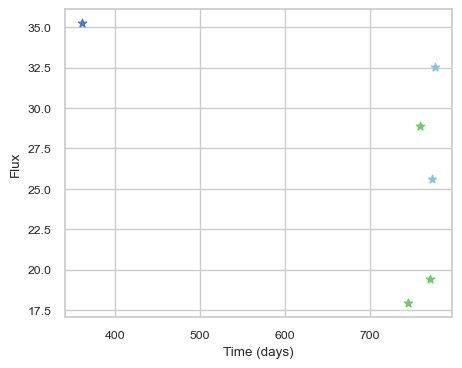

SNIax (3.933267, False)
SNIax (4.6545806, False)
SNIax (3.9591653, False)
SNIax (3.44632, False)
SNIax (3.2568238, False)
SNIax (2.7714245, False)
SNIax (3.1820552, False)
SNIax (3.5077689, False)
SNIax (3.772576, False)
SNIax (3.3442433, False)
SNIax (4.3268733, False)
SNIax (3.6193125, False)


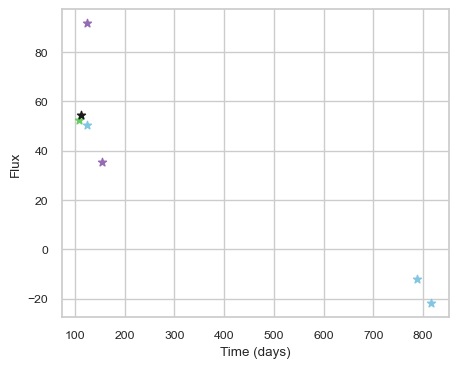

SNIax (4.0255265, False)
SNIax (4.4235697, False)
SNIax (4.69144, False)
SNIax (4.493097, False)
SNIax (5.2916064, False)
SNIax (5.229192, False)
SNIax (5.6919265, False)
SNIax (5.082178, False)
SNIax (4.724751, False)
SNIax (4.626318, False)
SNIax (4.805617, False)
SNIax (4.296974, False)
SNIax (5.0826807, False)
SNIax (4.396528, False)


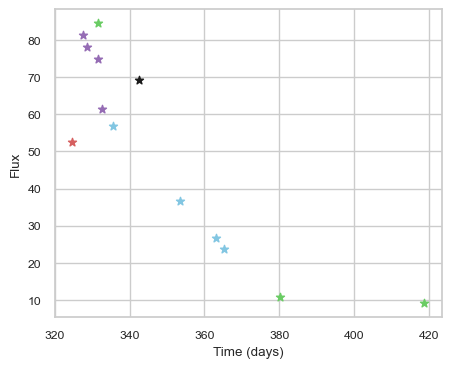

SNIax (3.8413174, False)
SNIax (4.336837, False)
SNIax (4.2174835, False)
SNIax (3.7835677, False)
SNIax (4.390435, False)
SNIax (3.4661603, False)
SNIax (4.1819253, False)
SNIax (3.2832582, False)
SNIax (3.4097872, False)
SNIax (3.6076605, False)
SNIax (3.4522197, False)
SNIax (3.2479572, False)
SNIax (3.287724, False)
SNIax (3.1550243, False)
SNIax (3.407495, False)
SNIax (3.9942145, False)
SNIax (3.2195172, False)
SNIax (2.9632115, False)
SNIax (2.7673645, False)
SNIax (3.0514677, False)
SNIax (2.3989997, False)
SNIax (2.6474187, False)
SNIax (2.3488753, False)
SNIax (3.2114782, False)
SNIax (2.5938268, False)


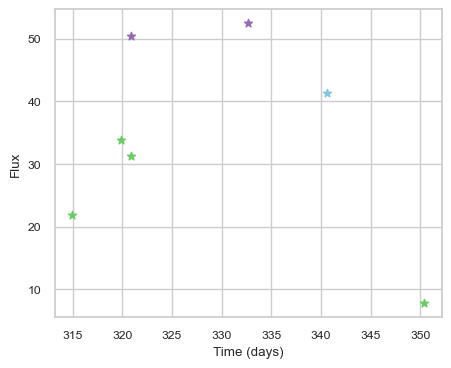

SNIax (4.1184406, False)
SNIax (4.140237, False)
SNIax (3.7293644, False)
SNIax (3.499346, False)
SNIax (3.0951376, False)
SNIax (3.1371412, False)
SNIax (3.4015796, False)
SNIax (2.9440475, False)
SNIax (4.2123675, False)
SNIax (3.4275465, False)
SNIax (3.1850228, False)
SNIax (3.451815, False)
SNIax (3.3943667, False)
SNIax (3.1499562, False)


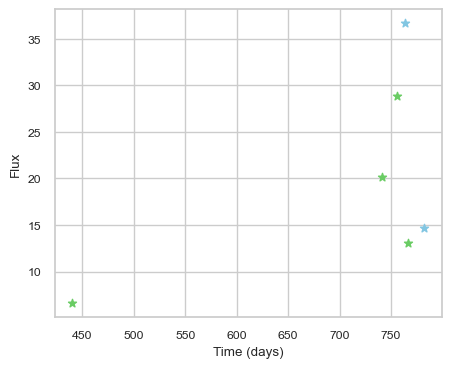

SNIax (3.9335327, False)
SNIax (3.663333, False)
SNIax (3.5661685, False)
SNIax (3.0571876, False)
SNIax (2.7879114, False)
SNIax (2.6822162, False)
SNIax (3.190031, False)
SNIax (2.839303, False)
SNIax (3.2844067, False)
SNIax (3.1800747, False)
SNIax (2.7829962, False)
SNIax (2.7987657, False)


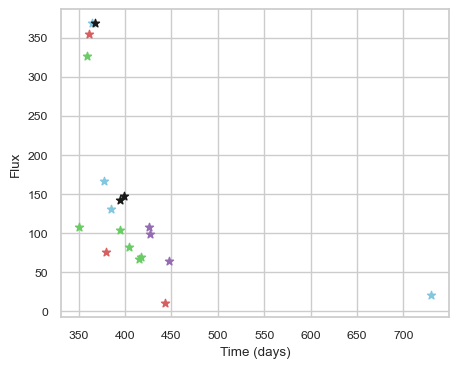

SNIax (4.0408926, False)
SNIax (4.347131, False)
SNIax (5.306995, False)
SNIax (5.1795278, False)
SNIax (4.8340774, False)
SNIax (4.7144303, False)
SNIax (5.509867, False)
SNIax (5.5371265, False)
SNIax (5.7721324, False)
SNIax (6.126436, False)
SNIax (3.960036, False)
SNIax (4.681971, False)
SNIax (4.0604134, False)
SNIax (4.314833, False)
SNIax (3.647876, False)
SNIax (4.108574, False)
SNIax (4.340536, False)
SNIax (3.7476408, False)
SNIax (3.641276, False)
SNIax (4.2110715, False)
SNIax (3.6103153, False)
SNIax (3.951, False)
SNIax (2.9208076, False)
SNIax (3.3474917, False)
SNIax (3.3494558, False)
SNIax (3.4045017, False)
SNIax (2.6953127, False)
SNIax (3.3994718, False)
SNIax (2.8744307, False)
SNIax (3.0439475, False)
SNIax (3.7052157, False)
SNIax (3.524159, False)
SNIax (3.5834825, False)
SNIax (3.5000882, False)
SNIax (3.9727514, False)
SNIax (3.643839, False)
SNIax (4.1439185, False)
SNIax (3.7492363, False)


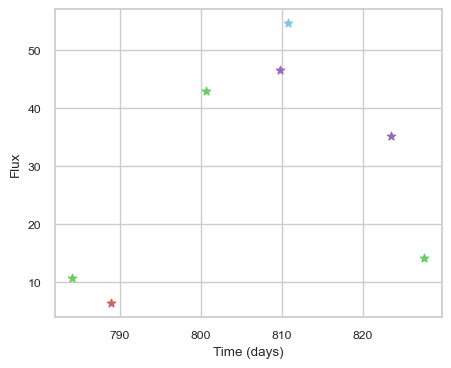

SNIax (4.01591, False)
SNIax (3.3857732, False)
SNIax (3.518578, False)
SNIax (3.6639135, False)
SNIax (3.1129057, False)
SNIax (2.8611495, False)
SNIax (3.0794609, False)
SNIax (2.7158937, False)
SNIax (2.912805, False)
SNIax (3.0416126, False)
SNIax (3.7706988, False)
SNIax (2.9003959, False)
SNIax (3.5244823, False)
SNIax (3.1071744, False)


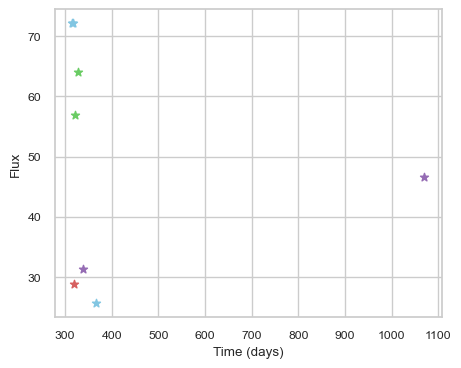

SNIax (3.8626947, False)
SNIax (4.493947, False)
SNIax (4.7706003, False)
SNIax (5.107209, False)
SNIax (3.9255805, False)
SNIax (3.5909429, False)
SNIax (3.212197, False)
SNIax (4.156905, False)
SNIax (3.7377827, False)
SNIax (3.329172, False)
SNIax (3.6850216, False)
SNIax (3.233791, False)
SNIax (3.6470013, False)
SNIax (3.0036871, False)
SNIax (3.804814, False)
SNIax (2.9869702, False)


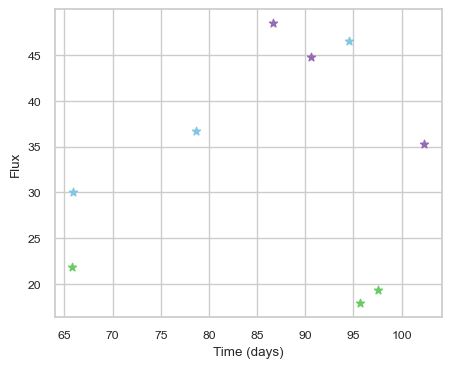

SNIax (3.848518, False)
SNIax (3.5724676, False)
SNIax (3.8318844, False)
SNIax (3.5507004, False)
SNIax (3.0206242, False)
SNIax (3.355002, False)
SNIax (2.9137194, False)
SNIax (3.2241795, False)
SNIax (3.44349, False)
SNIax (3.3675275, False)
SNIax (3.5316424, False)
SNIax (3.2580757, False)
SNIax (3.4003913, False)
SNIax (3.2488954, False)
SNIax (3.825129, False)
SNIax (3.4976194, False)
SNIax (3.6951625, False)
SNIax (3.3670108, False)


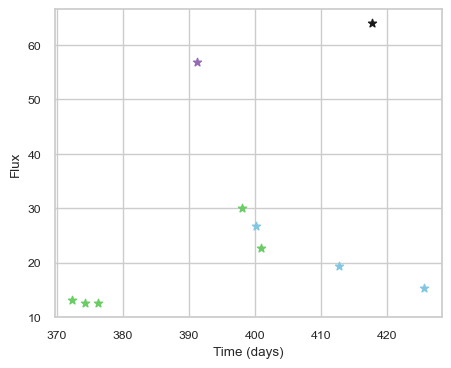

SNIax (4.359408, False)
SNIax (3.4687138, False)
SNIax (3.3832872, False)
SNIax (3.0200713, False)
SNIax (3.1523457, False)
SNIax (2.649788, False)
SNIax (2.673651, False)
SNIax (3.0192583, False)
SNIax (3.6285, False)
SNIax (3.3206148, False)
SNIax (3.3568048, False)
SNIax (2.8944864, False)
SNIax (3.2851765, False)
SNIax (2.736178, False)
SNIax (3.3772395, False)
SNIax (2.5754824, False)
SNIax (2.759495, False)
SNIax (3.0210454, False)
SNIax (2.7265878, False)
SNIax (2.694926, False)


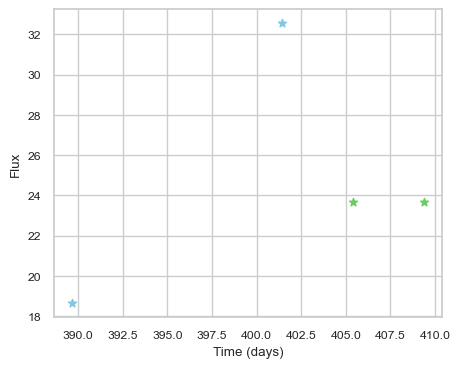

SNIax (4.041565, False)
SNIax (3.30642, False)
SNIax (3.2191753, False)
SNIax (3.1437829, False)
SNIax (3.1928723, False)
SNIax (2.7010956, False)
SNIax (3.1143637, False)
SNIax (2.8428702, False)


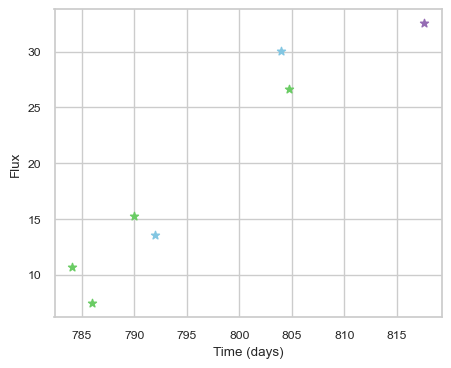

SNIax (4.2183657, False)
SNIax (3.4044468, False)
SNIax (3.345707, False)
SNIax (3.1844363, False)
SNIax (3.1965559, False)
SNIax (2.7826955, False)
SNIax (2.6499846, False)
SNIax (2.786237, False)
SNIax (2.9622695, False)
SNIax (2.2167993, False)
SNIax (2.355885, False)
SNIax (2.1248136, False)
SNIax (2.1689231, False)
SNIax (2.1948032, False)


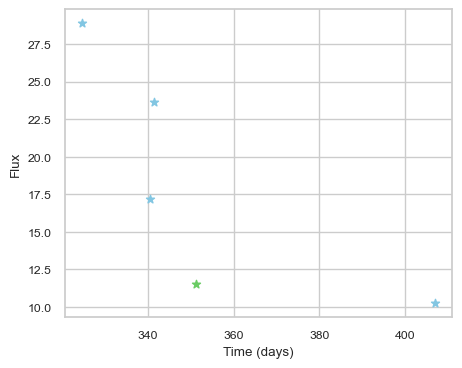

SNIax (3.9746764, False)
SNIax (3.8195179, False)
SNIax (3.6839776, False)
SNIax (3.696545, False)
SNIax (3.6774836, False)
SNIax (3.9761474, False)
SNIax (4.027432, False)
SNIax (4.2003036, False)
SNIax (4.7365837, False)
SNIax (4.5691557, False)


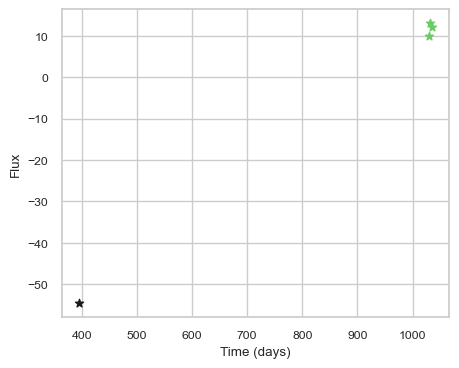

SNIax (4.118611, False)
SNIax (3.8523595, False)
SNIax (4.179864, False)
SNIax (3.515307, False)
SNIax (3.5576985, False)
SNIax (3.0939949, False)
SNIax (3.405279, False)
SNIax (3.0456135, False)


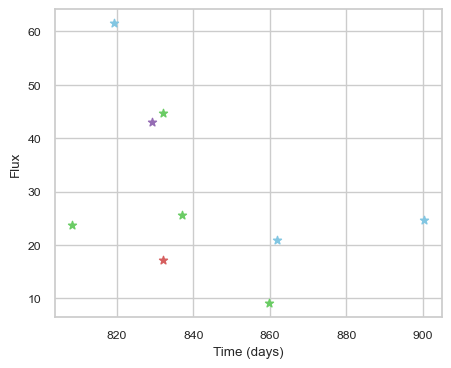

SNIax (3.8657548, False)
SNIax (3.6313999, False)
SNIax (3.2913222, False)
SNIax (3.3832657, False)
SNIax (2.8729033, False)
SNIax (2.796033, False)
SNIax (2.68918, False)
SNIax (2.8697205, False)
SNIax (3.0940108, False)
SNIax (2.1094887, False)
SNIax (2.7499871, False)
SNIax (2.290374, False)
SNIax (2.7198932, False)
SNIax (2.1989663, False)
SNIax (1.9433, False)
SNIax (2.1697323, False)
SNIax (3.0527217, False)
SNIax (2.737151, False)


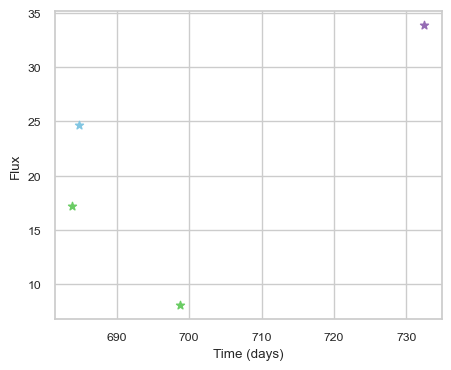

SNIax (4.6084166, False)
SNIax (4.2715106, False)
SNIax (3.4540732, False)
SNIax (3.9040089, False)
SNIax (4.1011424, False)
SNIax (3.4499924, False)
SNIax (3.969801, False)
SNIax (4.0483956, False)


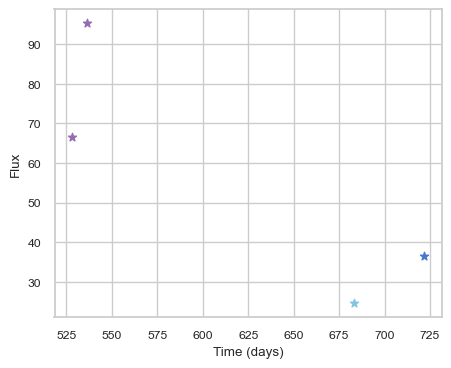

SNIax (3.8293538, False)
SNIax (3.8640714, False)
SNIax (3.4079256, False)
SNIax (3.6395142, False)
SNIax (3.7695563, False)
SNIax (3.6020257, False)
SNIax (3.355322, False)
SNIax (4.772676, False)


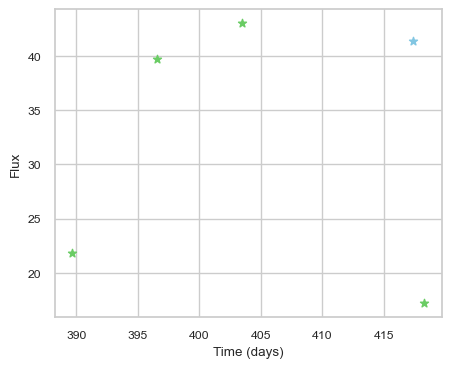

SNIax (3.8906167, False)
SNIax (3.4820778, False)
SNIax (3.5490155, False)
SNIax (2.807857, False)
SNIax (2.8177817, False)
SNIax (2.2966478, False)
SNIax (2.7139452, False)
SNIax (2.7834814, False)
SNIax (3.3802993, False)
SNIax (3.4577682, False)


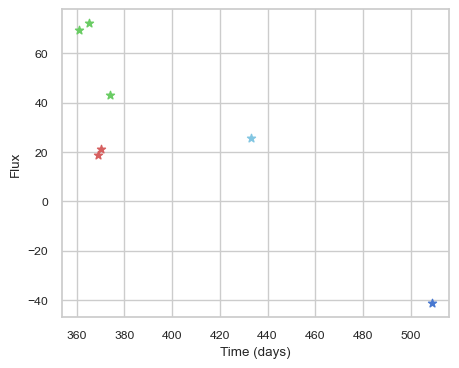

SNIax (4.029436, False)
SNIax (4.092961, False)
SNIax (5.05639, False)
SNIax (5.0159564, False)
SNIax (4.931632, False)
SNIax (4.4596195, False)
SNIax (5.0964713, False)
SNIax (5.0150614, False)
SNIax (5.4300675, False)
SNIax (5.027816, False)
SNIax (4.759283, False)
SNIax (4.2658105, False)
SNIax (4.439952, False)
SNIax (5.7114496, False)


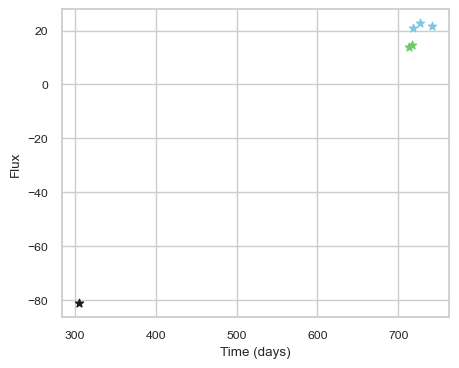

SNIax (5.3110766, False)
SNIax (4.6176987, False)
SNIax (4.893151, False)
SNIax (4.6602974, False)
SNIax (4.237857, False)
SNIax (3.6140943, False)
SNIax (3.3300886, False)
SNIax (3.6371126, False)
SNIax (3.1102264, False)
SNIax (3.2166648, False)
SNIax (2.952559, False)
SNIax (3.395899, False)


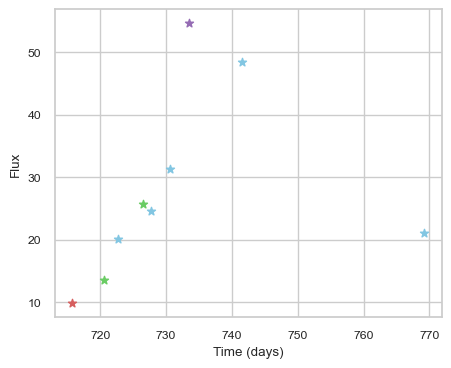

SNIax (3.871615, False)
SNIax (4.1229224, False)
SNIax (3.5170994, False)
SNIax (3.526672, False)
SNIax (3.8579028, False)
SNIax (3.4072978, False)
SNIax (3.31648, False)
SNIax (2.9911582, False)
SNIax (3.0196996, False)
SNIax (3.13934, False)
SNIax (3.3409178, False)
SNIax (3.2459068, False)
SNIax (3.2121694, False)
SNIax (3.4704223, False)
SNIax (3.3407629, False)
SNIax (3.7246907, False)
SNIax (4.1850724, False)
SNIax (4.241784, False)


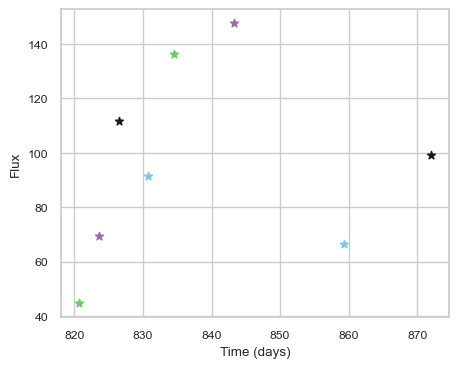

SNIax (3.8115385, False)
SNIax (3.2487628, False)
SNIax (3.3588617, False)
SNIax (3.9013586, False)
SNIax (4.4021487, False)
SNIax (4.633319, False)
SNIax (4.108501, False)
SNIax (3.9090683, False)
SNIax (3.9585514, False)
SNIax (3.757276, False)
SNIax (4.06803, False)
SNIax (4.146882, False)
SNIax (3.9044755, False)
SNIax (3.6199331, False)
SNIax (4.369576, False)
SNIax (3.9298165, False)


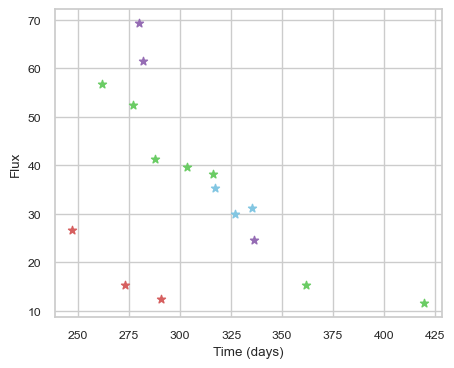

SNIax (3.6238666, False)
SNIax (4.1391616, False)
SNIax (3.418127, False)
SNIax (3.251943, False)
SNIax (3.838699, False)
SNIax (3.661598, False)
SNIax (3.6130524, False)
SNIax (3.0720725, False)
SNIax (3.3583314, False)
SNIax (3.5645583, False)
SNIax (3.7700527, False)
SNIax (4.078347, False)
SNIax (3.2540727, False)
SNIax (3.9156396, False)
SNIax (3.6935499, False)
SNIax (3.5995321, False)
SNIax (3.4841602, False)
SNIax (3.7091713, False)
SNIax (4.3075285, False)
SNIax (4.221873, False)
SNIax (4.1197267, False)
SNIax (4.4629774, False)
SNIax (3.829389, False)
SNIax (4.179915, False)
SNIax (3.4445498, False)
SNIax (4.139231, False)
SNIax (3.4084237, False)
SNIax (4.1975446, False)
SNIax (4.3269243, False)
SNIax (4.229208, False)
SNIax (4.1005154, False)
SNIax (3.8038871, False)


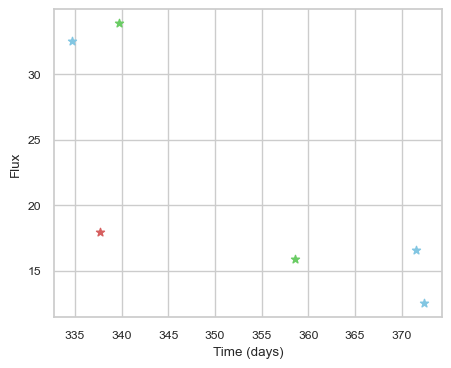

SNIax (3.9864328, False)
SNIax (3.8673337, False)
SNIax (3.3476295, False)
SNIax (3.2063138, False)
SNIax (3.1078534, False)
SNIax (2.6031775, False)
SNIax (2.7031615, False)
SNIax (2.360995, False)
SNIax (2.8432255, False)
SNIax (2.2344823, False)
SNIax (2.8822875, False)
SNIax (2.3781118, False)


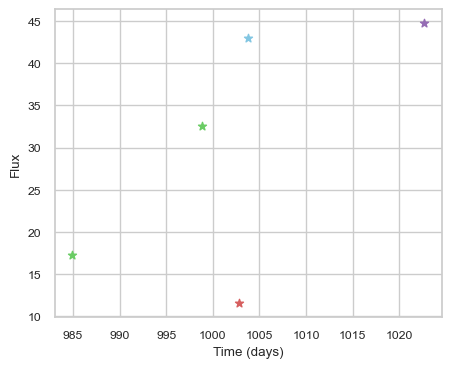

SNIax (4.003252, False)
SNIax (3.771621, False)
SNIax (3.3049042, False)
SNIax (3.0452275, False)
SNIax (3.2353067, False)
SNIax (3.734091, False)
SNIax (2.900704, False)
SNIax (2.0442317, False)
SNIax (2.706444, False)
SNIax (2.375306, False)


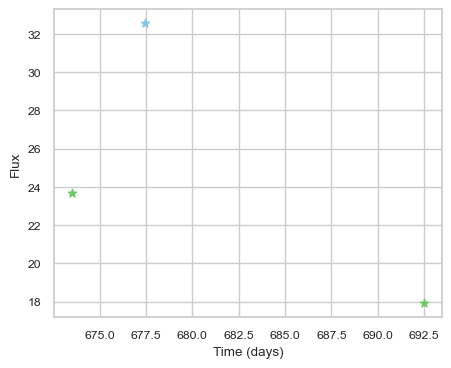

SNIax (4.756509, False)
SNIax (4.6778936, False)
SNIax (4.307723, False)
SNIax (4.8181844, False)
SNIax (4.2947273, False)
SNIax (4.206843, False)


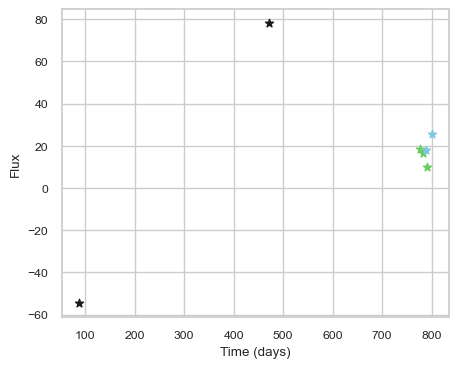

SNIax (4.4475603, False)
SNIax (4.6503625, False)
SNIax (4.6916747, False)
SNIax (4.9215846, False)
SNIax (4.6518836, False)
SNIax (3.9277577, False)
SNIax (3.8517268, False)
SNIax (3.3864322, False)
SNIax (3.2172654, False)
SNIax (2.9363482, False)
SNIax (3.420199, False)
SNIax (3.5297916, False)
SNIax (3.318067, False)
SNIax (2.8519287, False)


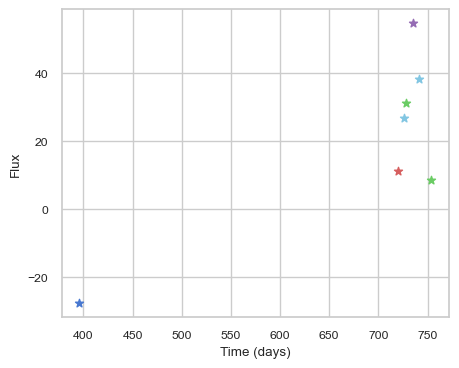

SNIax (3.8899705, False)
SNIax (4.836406, False)
SNIax (3.8161366, False)
SNIax (3.8711612, False)
SNIax (3.388942, False)
SNIax (2.7781837, False)
SNIax (3.5060694, False)
SNIax (3.3257773, False)
SNIax (3.585632, False)
SNIax (2.8953197, False)
SNIax (2.6219833, False)
SNIax (3.24129, False)
SNIax (2.9700363, False)
SNIax (3.1927426, False)


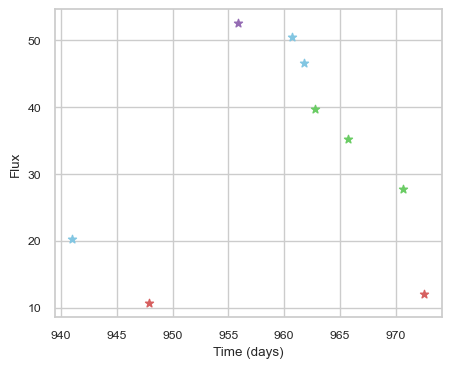

SNIax (4.309125, False)
SNIax (4.044379, False)
SNIax (3.5507684, False)
SNIax (3.499821, False)
SNIax (3.7294126, False)
SNIax (4.0070343, False)
SNIax (4.328575, False)
SNIax (4.4889107, False)
SNIax (4.9032645, False)
SNIax (4.8571177, False)
SNIax (5.045101, False)
SNIax (4.8537655, False)
SNIax (5.120647, False)
SNIax (4.7980967, False)
SNIax (5.0919437, False)
SNIax (4.7123537, False)
SNIax (4.8904333, False)
SNIax (5.003434, False)


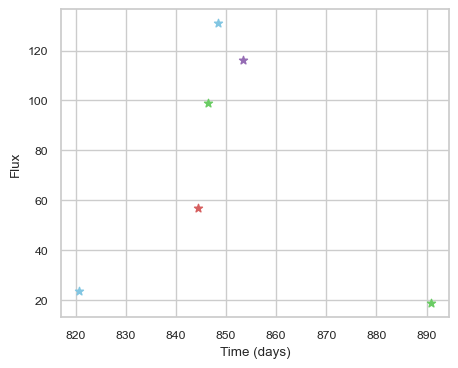

SNIax (3.7791207, False)
SNIax (3.477009, False)
SNIax (3.3502154, False)
SNIax (3.8528106, False)
SNIax (3.7212548, False)
SNIax (3.466301, False)
SNIax (3.3479722, False)
SNIax (3.3225458, False)
SNIax (3.836814, False)
SNIax (3.3329914, False)
SNIax (3.308826, False)
SNIax (3.8159997, False)


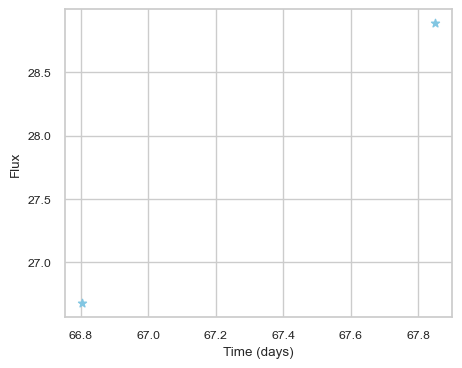

SNIax (3.650272, False)
SNIax (3.6562479, False)
SNIax (3.1809025, False)
SNIax (3.6284196, False)


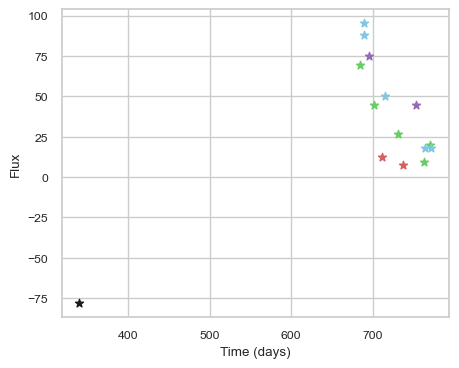

SNIax (3.9611232, False)
SNIax (4.1857376, False)
SNIax (4.201703, False)
SNIax (4.305279, False)
SNIax (4.830062, False)
SNIax (5.2915053, False)
SNIax (5.309669, False)
SNIax (5.068668, False)
SNIax (5.3913713, False)
SNIax (4.5439286, False)
SNIax (4.287943, False)
SNIax (4.805398, False)
SNIax (4.6294355, False)
SNIax (4.0915437, False)
SNIax (5.0064826, False)
SNIax (4.7113557, False)
SNIax (4.4299965, False)
SNIax (4.4375024, False)
SNIax (4.2742515, False)
SNIax (4.358396, False)
SNIax (5.05662, False)
SNIax (4.644617, False)
SNIax (4.937853, False)
SNIax (4.412853, False)
SNIax (3.465026, False)
SNIax (4.669007, False)
SNIax (4.105882, False)
SNIax (4.4123473, False)
SNIax (4.189265, False)
SNIax (4.3272467, False)


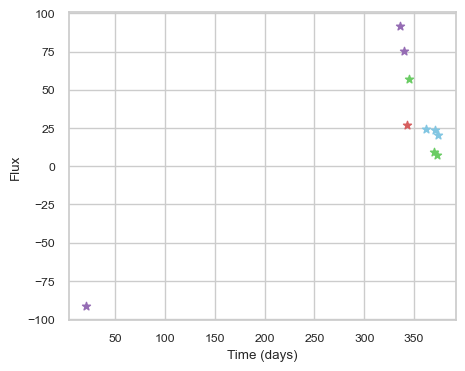

SNIax (4.129383, False)
SNIax (4.3200574, False)
SNIax (4.3130097, False)
SNIax (4.4814153, False)
SNIax (5.185111, False)
SNIax (4.8357363, False)
SNIax (5.0181727, False)
SNIax (5.024372, False)
SNIax (5.4454875, False)
SNIax (5.516109, False)
SNIax (5.0150266, False)
SNIax (4.7868366, False)
SNIax (4.3223195, False)
SNIax (4.110013, False)
SNIax (4.5095654, False)
SNIax (4.993468, False)
SNIax (4.4845543, False)
SNIax (4.3061824, False)
SNIax (4.532087, False)
SNIax (4.612151, False)


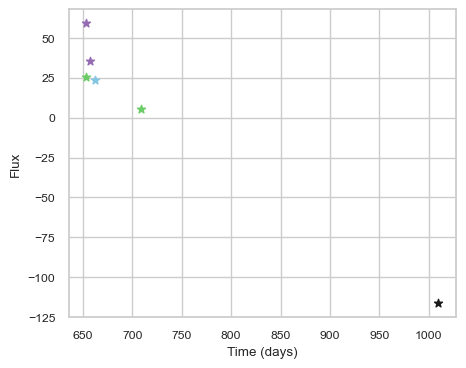

SNIax (4.0736732, False)
SNIax (4.1008587, False)
SNIax (4.162469, False)
SNIax (3.4062452, False)
SNIax (4.000892, False)
SNIax (3.1840453, False)
SNIax (3.0072794, False)
SNIax (3.1746051, False)
SNIax (3.3254843, False)
SNIax (3.18953, False)
SNIax (3.782668, False)
SNIax (4.030465, False)


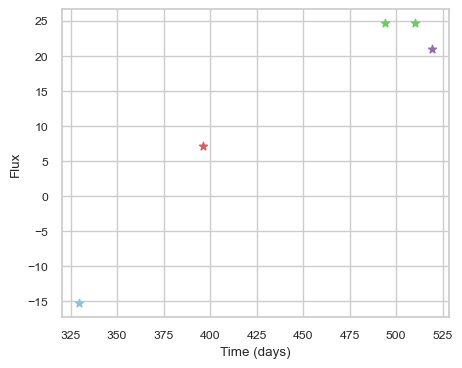

SNIax (4.008074, False)
SNIax (4.200152, False)
SNIax (3.976084, False)
SNIax (3.8413992, False)
SNIax (3.9318712, False)
SNIax (4.1980047, False)
SNIax (3.908243, False)
SNIax (4.246569, False)
SNIax (4.6434326, False)
SNIax (4.975135, False)


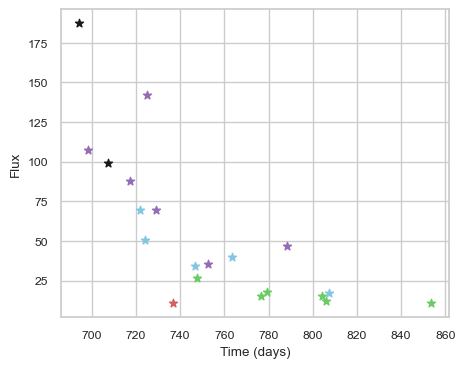

SNIax (3.6996105, False)
SNIax (3.7546802, False)
SNIax (3.823187, False)
SNIax (3.5813093, False)
SNIax (3.3558147, False)
SNIax (3.7505765, False)
SNIax (3.576947, False)
SNIax (3.6479995, False)
SNIax (3.6827688, False)
SNIax (3.4846046, False)
SNIax (3.8877275, False)
SNIax (3.3999763, False)
SNIax (3.6214838, False)
SNIax (4.3884115, False)
SNIax (4.8250365, False)
SNIax (5.2364755, False)
SNIax (3.8287344, False)
SNIax (5.317731, False)
SNIax (4.396548, False)
SNIax (4.5518622, False)
SNIax (3.3581014, False)
SNIax (5.0870047, False)
SNIax (4.518843, False)
SNIax (4.9023027, False)
SNIax (2.9874065, False)
SNIax (4.5598164, False)
SNIax (4.134541, False)
SNIax (5.1512213, False)
SNIax (3.7441988, False)
SNIax (4.9895372, False)
SNIax (3.8642437, False)
SNIax (5.2240906, False)
SNIax (4.543218, False)
SNIax (5.261768, False)
SNIax (3.9657176, False)
SNIax (4.8875227, False)
SNIax (2.966278, False)
SNIax (4.551703, False)
SNIax (3.4964783, False)
SNIax (4.726361, False)


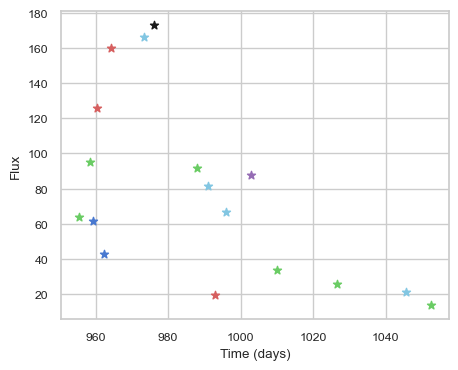

SNIax (3.5329416, False)
SNIax (3.7291858, False)
SNIax (3.161979, False)
SNIax (3.8855247, False)
SNIax (3.4396324, False)
SNIax (4.3014417, False)
SNIax (3.660805, False)
SNIax (4.618608, False)
SNIax (3.4556458, False)
SNIax (4.5700326, False)
SNIax (3.989364, False)
SNIax (4.7712293, False)
SNIax (3.0346272, False)
SNIax (3.2015495, False)
SNIax (4.042111, False)
SNIax (3.4425647, False)
SNIax (4.35982, False)
SNIax (3.5261314, False)
SNIax (3.2252762, False)
SNIax (3.452999, False)
SNIax (3.071761, False)
SNIax (3.0099754, False)
SNIax (2.9037156, False)
SNIax (3.2184658, False)
SNIax (3.2086146, False)
SNIax (2.7427568, False)
SNIax (2.5743387, False)
SNIax (2.7538834, False)
SNIax (3.567866, False)
SNIax (3.1253922, False)
SNIax (3.3959537, False)
SNIax (2.708177, False)
SNIax (2.9991372, False)
SNIax (2.4286096, False)


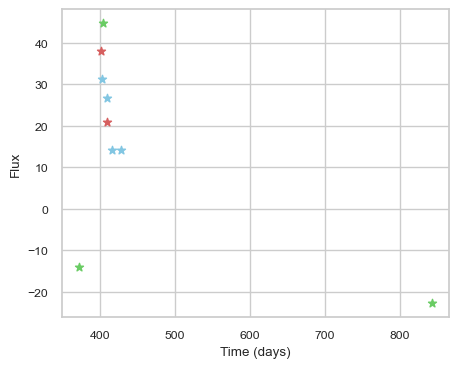

SNIax (3.5862193, False)
SNIax (5.054689, False)
SNIax (3.8500223, False)
SNIax (4.8655844, False)
SNIax (4.024859, False)
SNIax (5.745613, False)
SNIax (4.800797, False)
SNIax (5.01865, False)
SNIax (4.6665297, False)
SNIax (5.1183276, False)
SNIax (3.9685407, False)
SNIax (4.938249, False)
SNIax (5.3060794, False)
SNIax (5.1671977, False)
SNIax (3.6502633, False)
SNIax (4.185036, False)
SNIax (4.2128325, False)
SNIax (3.6577907, False)


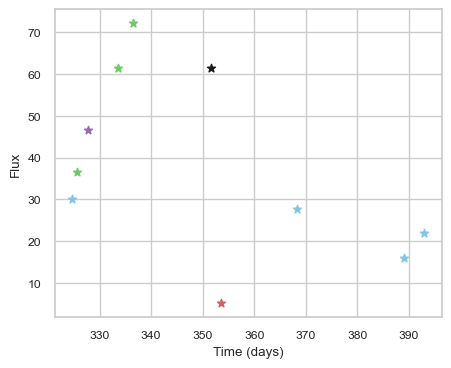

SNIax (3.934531, False)
SNIax (3.7786198, False)
SNIax (3.3726192, False)
SNIax (3.5104191, False)
SNIax (3.3954444, False)
SNIax (2.6066766, False)
SNIax (3.1600792, False)
SNIax (3.5719566, False)
SNIax (3.9840884, False)
SNIax (4.243243, False)
SNIax (4.227676, False)
SNIax (4.3859706, False)
SNIax (4.6963506, False)
SNIax (4.2279963, False)
SNIax (4.3874917, False)
SNIax (3.8053672, False)
SNIax (3.3805804, False)
SNIax (3.279015, False)
SNIax (3.2312863, False)
SNIax (3.2096407, False)


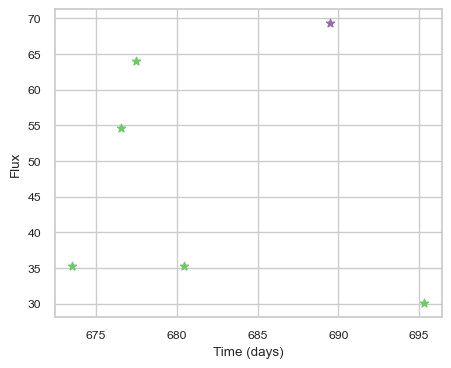

SNIax (4.1057525, False)
SNIax (4.316567, False)
SNIax (3.5595767, False)
SNIax (4.5735593, False)
SNIax (4.713306, False)
SNIax (5.1924057, False)
SNIax (5.482045, False)
SNIax (4.53314, False)
SNIax (3.3683782, False)
SNIax (3.8072364, False)
SNIax (3.620842, False)
SNIax (3.640958, False)


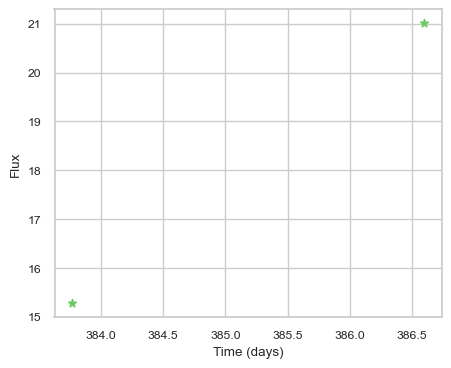

SNIax (5.5702915, False)
SNIax (5.256242, False)
SNIax (3.8831248, False)
SNIax (4.4478936, False)


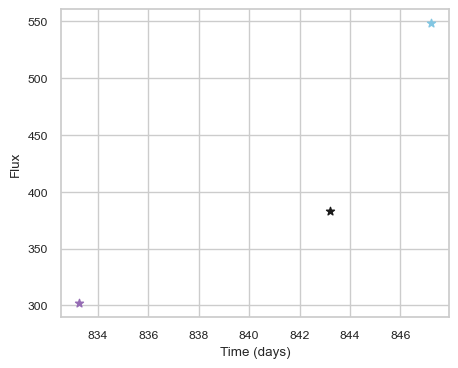

SNIax (3.580731, False)
SNIax (3.4941344, False)
SNIax (3.0547314, False)
SNIax (3.5410054, False)
SNIax (3.1505344, False)
SNIax (3.361144, False)


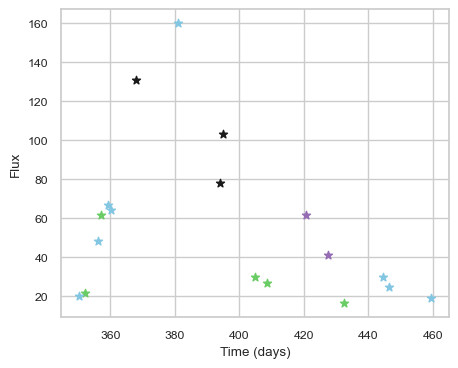

SNIax (3.8659334, False)
SNIax (3.5897262, False)
SNIax (3.226534, False)
SNIax (3.2051363, False)
SNIax (3.3382132, False)
SNIax (3.2516894, False)
SNIax (3.7181976, False)
SNIax (3.1824136, False)
SNIax (3.4099646, False)
SNIax (3.145484, False)
SNIax (3.9056242, False)
SNIax (3.0628276, False)
SNIax (2.7583845, False)
SNIax (3.2686827, False)
SNIax (2.5664885, False)
SNIax (2.2081332, False)
SNIax (3.5221388, False)
SNIax (4.0621834, False)
SNIax (5.4549685, False)
SNIax (4.3058248, False)
SNIax (4.5370965, False)
SNIax (4.4290857, False)
SNIax (4.451212, False)
SNIax (4.129496, False)
SNIax (4.1601276, False)
SNIax (4.3706985, False)
SNIax (4.020943, False)
SNIax (4.279738, False)
SNIax (4.276651, False)
SNIax (4.1701384, False)
SNIax (4.2144694, False)
SNIax (3.9753013, False)
SNIax (4.0937033, False)
SNIax (3.819352, False)
SNIax (3.8308501, False)
SNIax (3.7435718, False)


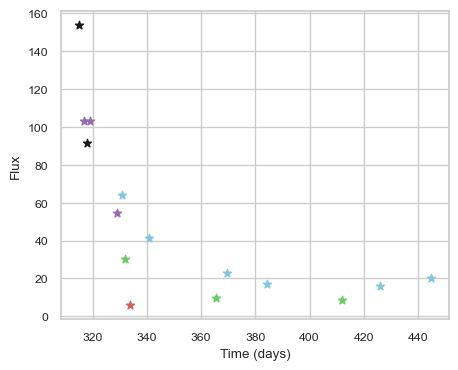

SNIax (3.887011, False)
SNIax (4.1498485, False)
SNIax (4.3035154, False)
SNIax (4.138682, False)
SNIax (4.0965924, False)
SNIax (4.930335, False)
SNIax (4.096694, False)
SNIax (4.19665, False)
SNIax (3.8873436, False)
SNIax (3.3929603, False)
SNIax (3.9687598, False)
SNIax (3.9611146, False)
SNIax (4.1438, False)
SNIax (3.9346297, False)
SNIax (4.3050914, False)
SNIax (4.122418, False)
SNIax (4.6497626, False)
SNIax (4.172521, False)
SNIax (3.8140123, False)
SNIax (3.837809, False)
SNIax (3.905712, False)
SNIax (3.7765837, False)
SNIax (3.852145, False)
SNIax (3.9338932, False)
SNIax (3.826268, False)
SNIax (3.8092856, False)
SNIax (3.7339091, False)
SNIax (3.7761347, False)
SNIax (3.8707445, False)
SNIax (3.701206, False)


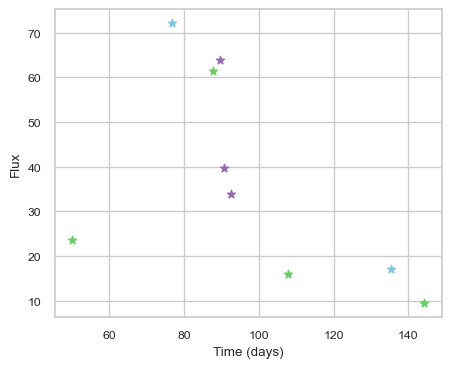

SNIax (3.9929802, False)
SNIax (3.4623675, False)
SNIax (3.3719246, False)
SNIax (3.8458657, False)
SNIax (4.782681, False)
SNIax (5.0586953, False)
SNIax (5.4877496, False)
SNIax (5.391997, False)
SNIax (6.380079, False)
SNIax (5.474198, False)
SNIax (6.112327, False)
SNIax (5.421506, False)
SNIax (5.5338144, False)
SNIax (5.6770544, False)
SNIax (5.4716797, False)
SNIax (5.396309, False)
SNIax (4.8709188, False)
SNIax (5.459611, False)


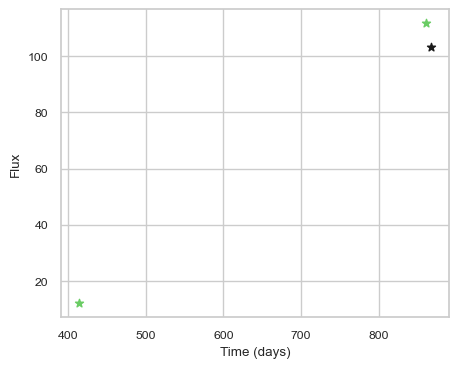

SNIax (3.8548803, False)
SNIax (3.6373184, False)
SNIax (3.5795941, False)
SNIax (3.975988, False)
SNIax (4.5014896, False)
SNIax (4.564028, False)


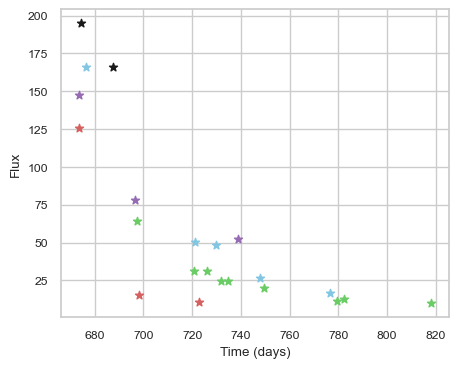

SNIax (3.7272916, False)
SNIax (4.0176945, False)
SNIax (4.881834, False)
SNIax (4.2430024, False)
SNIax (3.7613838, False)
SNIax (4.2208, False)
SNIax (3.55675, False)
SNIax (3.5808837, False)
SNIax (3.3372114, False)
SNIax (3.7951984, False)
SNIax (3.844097, False)
SNIax (3.479294, False)
SNIax (3.2365713, False)
SNIax (3.231126, False)
SNIax (3.1507664, False)
SNIax (3.3836358, False)
SNIax (2.9331965, False)
SNIax (3.3992052, False)
SNIax (3.812843, False)
SNIax (3.2151716, False)
SNIax (3.8723924, False)
SNIax (2.6435194, False)
SNIax (3.198619, False)
SNIax (3.0030413, False)
SNIax (3.5982625, False)
SNIax (3.0448337, False)
SNIax (3.5436723, False)
SNIax (3.0206928, False)
SNIax (3.773087, False)
SNIax (3.0481198, False)
SNIax (3.6219807, False)
SNIax (2.8735075, False)
SNIax (2.8243608, False)
SNIax (2.8907962, False)
SNIax (2.9617262, False)
SNIax (2.8057194, False)
SNIax (3.228979, False)
SNIax (2.6097457, False)
SNIax (2.607954, False)
SNIax (2.816993, False)
SNIax (2.918423

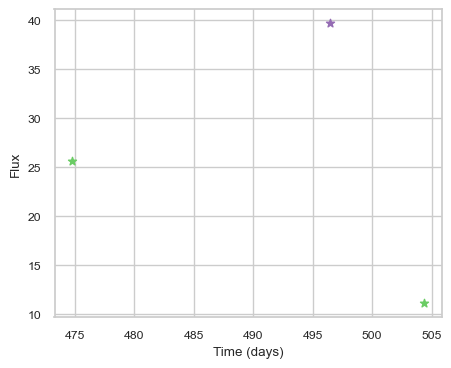

SNIax (4.428111, False)
SNIax (3.9065874, False)
SNIax (3.7744412, False)
SNIax (3.5222764, False)
SNIax (3.085806, False)
SNIax (3.2475529, False)


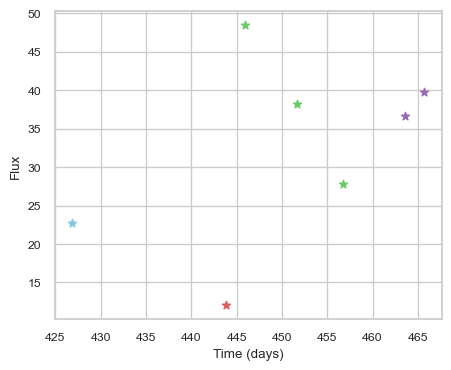

SNIax (3.97272, False)
SNIax (3.7496927, False)
SNIax (3.4026783, False)
SNIax (3.2829847, False)
SNIax (3.1785069, False)
SNIax (3.330474, False)
SNIax (3.8390987, False)
SNIax (3.321552, False)
SNIax (3.5224514, False)
SNIax (3.0003371, False)
SNIax (3.1257482, False)
SNIax (2.8611395, False)
SNIax (3.219863, False)
SNIax (2.8731663, False)


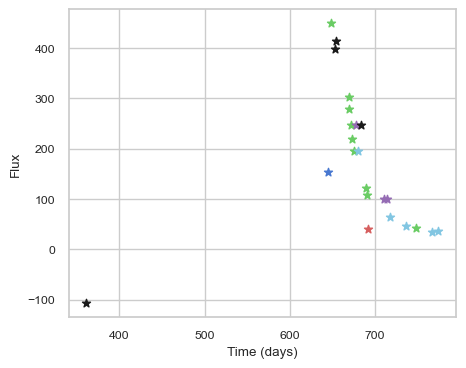

SNIax (3.7071798, False)
SNIax (3.8832505, False)
SNIax (3.8080728, False)
SNIax (5.349859, False)
SNIax (4.4278216, False)
SNIax (4.7580276, False)
SNIax (3.756225, False)
SNIax (3.8283398, False)
SNIax (3.45457, False)
SNIax (3.5839753, False)
SNIax (3.914975, False)
SNIax (3.8432999, False)
SNIax (4.168877, False)
SNIax (3.3262308, False)
SNIax (4.088779, False)
SNIax (3.2517898, False)
SNIax (3.3137147, False)
SNIax (3.3944633, False)
SNIax (3.5102818, False)
SNIax (3.4235587, False)
SNIax (3.4864838, False)
SNIax (2.9889538, False)
SNIax (3.2763894, False)
SNIax (3.1848452, False)
SNIax (3.079113, False)
SNIax (3.401365, False)
SNIax (2.8251479, False)
SNIax (2.781256, False)
SNIax (2.9260902, False)
SNIax (2.6946318, False)
SNIax (2.6524358, False)
SNIax (2.860113, False)
SNIax (2.6567, False)
SNIax (3.0542352, False)
SNIax (3.126316, False)
SNIax (3.373312, False)
SNIax (3.1057749, False)
SNIax (2.7766056, False)
SNIax (2.8152566, False)
SNIax (2.8086622, False)
SNIax (2.5158286

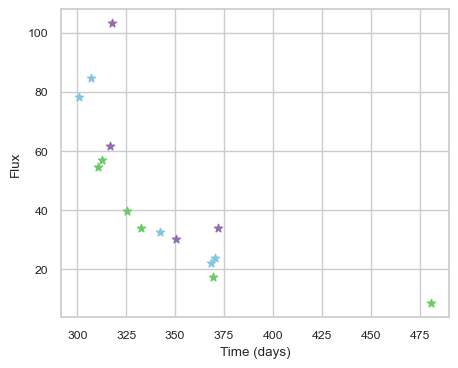

SNIax (4.609059, False)
SNIax (4.732729, False)
SNIax (3.4657235, False)
SNIax (4.0560937, False)
SNIax (4.6656027, False)
SNIax (5.2730384, False)
SNIax (4.9412603, False)
SNIax (5.241054, False)
SNIax (4.4406567, False)
SNIax (4.820482, False)
SNIax (4.344448, False)
SNIax (5.2861266, False)
SNIax (4.955697, False)
SNIax (5.169432, False)
SNIax (5.3004804, False)
SNIax (5.272754, False)
SNIax (4.879746, False)
SNIax (4.70592, False)
SNIax (3.685725, False)
SNIax (5.272093, False)
SNIax (4.2758913, False)
SNIax (4.174952, False)
SNIax (3.5775564, False)
SNIax (4.361713, False)
SNIax (3.8129838, False)
SNIax (3.9196844, False)
SNIax (3.9412916, False)
SNIax (4.5648127, False)
SNIax (4.6736574, False)
SNIax (4.8298182, False)


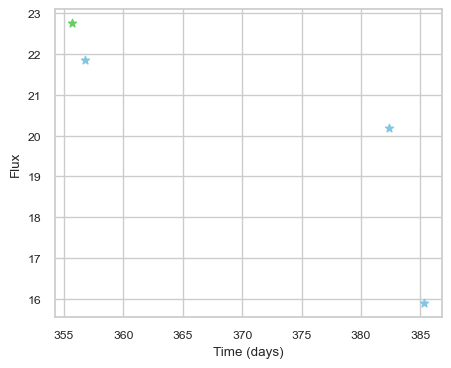

SNIax (4.3918066, False)
SNIax (3.7594283, False)
SNIax (3.3559456, False)
SNIax (3.5876539, False)
SNIax (3.8751838, False)
SNIax (3.1481497, False)
SNIax (3.3417928, False)
SNIax (3.0420854, False)


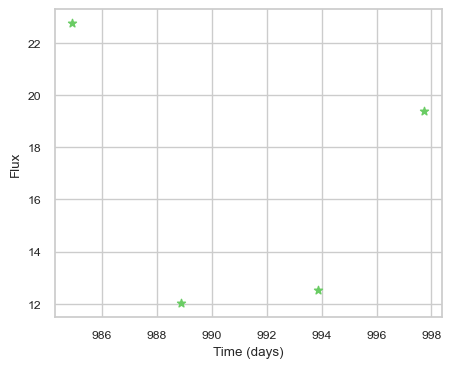

SNIax (4.5185223, False)
SNIax (4.2821875, False)
SNIax (3.838905, False)
SNIax (3.7231166, False)
SNIax (3.9707015, False)
SNIax (3.746371, False)
SNIax (4.27626, False)
SNIax (3.8845081, False)


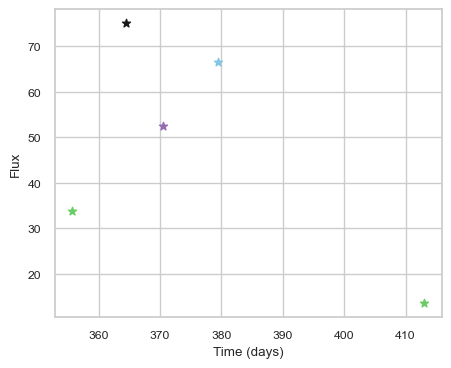

SNIax (3.8827028, False)
SNIax (3.310166, False)
SNIax (3.2358537, False)
SNIax (3.2937508, False)
SNIax (3.7040176, False)
SNIax (2.2074442, False)
SNIax (2.9447763, False)
SNIax (2.4519203, False)
SNIax (3.679388, False)
SNIax (2.448212, False)


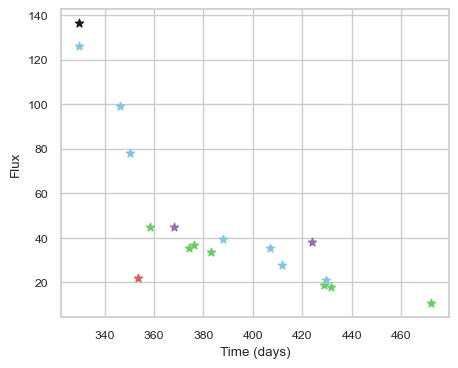

SNIax (3.7961483, False)
SNIax (3.9534752, False)
SNIax (4.074985, False)
SNIax (3.3452778, False)
SNIax (3.4414923, False)
SNIax (3.3225863, False)
SNIax (4.9094577, False)
SNIax (3.8087282, False)
SNIax (3.944937, False)
SNIax (3.9314175, False)
SNIax (3.8992515, False)
SNIax (3.8875895, False)
SNIax (3.3272266, False)
SNIax (3.011146, False)
SNIax (2.337538, False)
SNIax (2.723979, False)
SNIax (3.1366982, False)
SNIax (2.7425094, False)
SNIax (3.0090678, False)
SNIax (2.9598634, False)
SNIax (3.0371141, False)
SNIax (2.376153, False)
SNIax (2.7724063, False)
SNIax (2.6654851, False)
SNIax (2.7106915, False)
SNIax (2.4412723, False)
SNIax (2.6820369, False)
SNIax (3.1457846, False)
SNIax (3.0255132, False)
SNIax (3.2222028, False)
SNIax (3.0149283, False)
SNIax (2.6788466, False)
SNIax (2.4066205, False)
SNIax (3.0071342, False)
SNIax (3.172677, False)
SNIax (3.2965558, False)


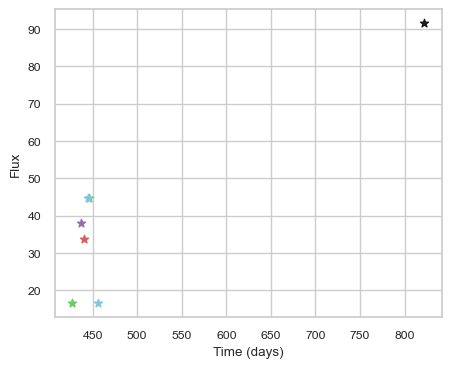

SNIax (3.8088703, False)
SNIax (3.8063095, False)
SNIax (3.4709494, False)
SNIax (3.286742, False)
SNIax (3.6641016, False)
SNIax (4.4732547, False)
SNIax (3.8276637, False)
SNIax (4.2805657, False)
SNIax (4.3931065, False)
SNIax (4.5641527, False)
SNIax (4.5752063, False)
SNIax (4.4694777, False)
SNIax (4.334702, False)
SNIax (5.0082827, False)


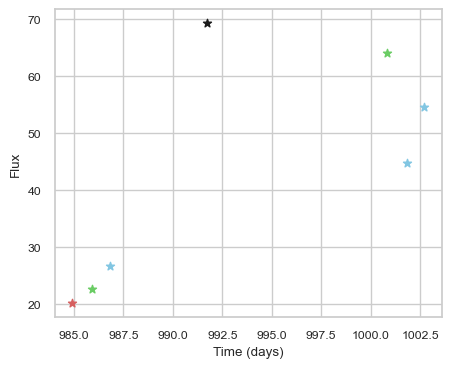

SNIax (3.7626996, False)
SNIax (4.5526304, False)
SNIax (3.9584248, False)
SNIax (4.5956745, False)
SNIax (4.7531867, False)
SNIax (4.5654807, False)
SNIax (4.035049, False)
SNIax (4.3502927, False)
SNIax (3.5086129, False)
SNIax (3.1442392, False)
SNIax (2.905151, False)
SNIax (2.7292573, False)
SNIax (2.5818238, False)
SNIax (2.125835, False)


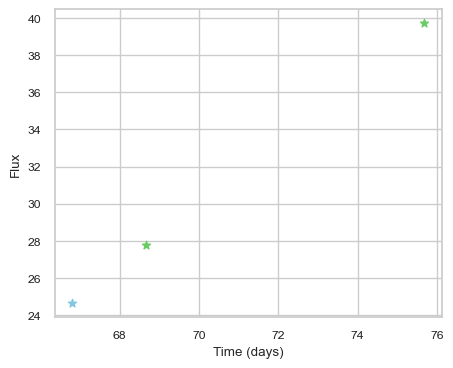

SNIax (3.878128, False)
SNIax (3.9572961, False)
SNIax (3.5323524, False)
SNIax (3.6573453, False)
SNIax (3.6286793, False)
SNIax (3.739943, False)


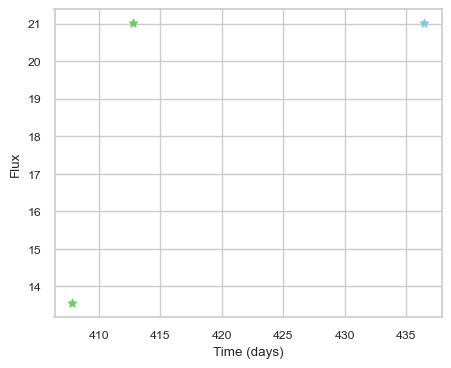

SNIax (4.431962, False)
SNIax (3.5851293, False)
SNIax (3.4280713, False)
SNIax (3.089954, False)
SNIax (3.0198245, False)
SNIax (2.7938774, False)


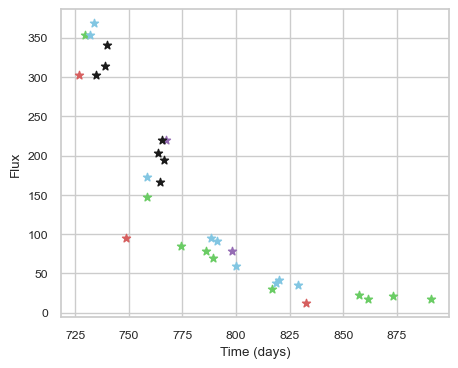

SNIax (3.7092447, False)
SNIax (3.8353024, False)
SNIax (3.1329932, False)
SNIax (2.8524764, False)
SNIax (3.1480014, False)
SNIax (2.5944963, False)
SNIax (2.880667, False)
SNIax (2.6688533, False)
SNIax (3.2490308, False)
SNIax (3.552917, False)
SNIax (3.3212042, False)
SNIax (2.7682283, False)
SNIax (2.86996, False)
SNIax (2.679983, False)
SNIax (2.5705554, False)
SNIax (2.2311704, False)
SNIax (2.8636878, False)
SNIax (2.548553, False)
SNIax (2.6023202, False)
SNIax (2.1921768, False)
SNIax (2.7454274, False)
SNIax (2.3997064, False)
SNIax (3.2205584, False)
SNIax (2.3501506, False)
SNIax (3.404355, False)
SNIax (2.5281022, False)
SNIax (3.0955985, False)
SNIax (2.3943892, False)
SNIax (3.4312553, False)
SNIax (2.1222525, False)
SNIax (2.3784215, False)
SNIax (2.797727, False)
SNIax (2.9285634, False)
SNIax (2.5864732, False)
SNIax (2.5834749, False)
SNIax (2.3521557, False)
SNIax (2.5168676, False)
SNIax (2.254327, False)
SNIax (2.4826224, False)
SNIax (2.0674212, False)
SNIax (2.

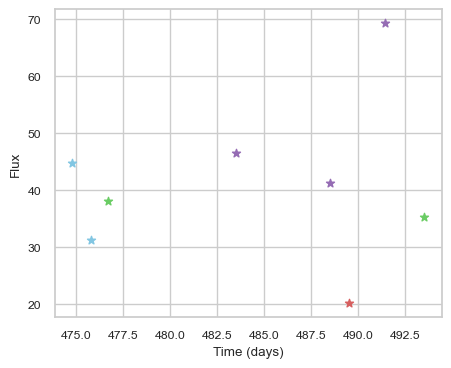

SNIax (3.9825284, False)
SNIax (3.9869566, False)
SNIax (3.4852412, False)
SNIax (3.5234497, False)
SNIax (3.4020858, False)
SNIax (3.470943, False)
SNIax (3.223958, False)
SNIax (3.1128209, False)
SNIax (3.3123538, False)
SNIax (3.6865048, False)
SNIax (3.6312873, False)
SNIax (4.549015, False)
SNIax (4.25176, False)
SNIax (2.9246917, False)
SNIax (4.796092, False)
SNIax (3.4673758, False)


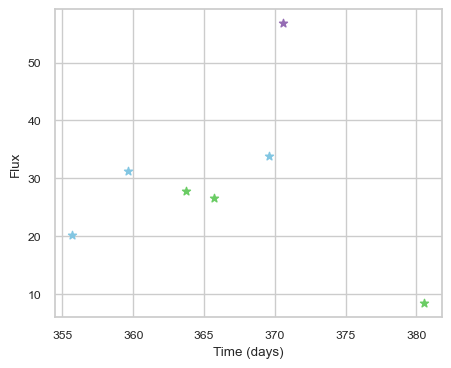

SNIax (4.2599297, False)
SNIax (3.9060788, False)
SNIax (3.4699621, False)
SNIax (3.651697, False)
SNIax (3.2841308, False)
SNIax (3.108596, False)
SNIax (2.9894233, False)
SNIax (2.6311677, False)
SNIax (2.8624425, False)
SNIax (2.2898982, False)
SNIax (2.5119743, False)
SNIax (2.429009, False)
SNIax (2.765066, False)
SNIax (2.5426843, False)


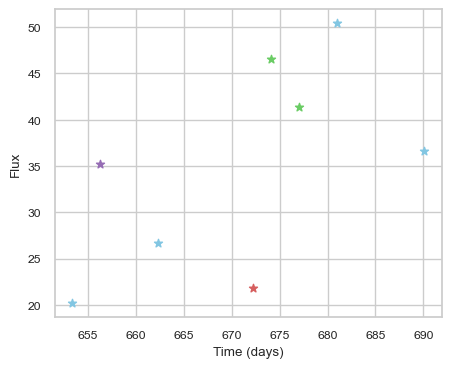

SNIax (4.0942545, False)
SNIax (3.9958415, False)
SNIax (3.4913287, False)
SNIax (3.658864, False)
SNIax (2.994843, False)
SNIax (3.5753949, False)
SNIax (3.0144002, False)
SNIax (4.30181, False)
SNIax (4.161609, False)
SNIax (3.85662, False)
SNIax (3.5204647, False)
SNIax (2.8953357, False)
SNIax (3.1632867, False)
SNIax (2.5889447, False)
SNIax (2.5036595, False)
SNIax (2.7569337, False)


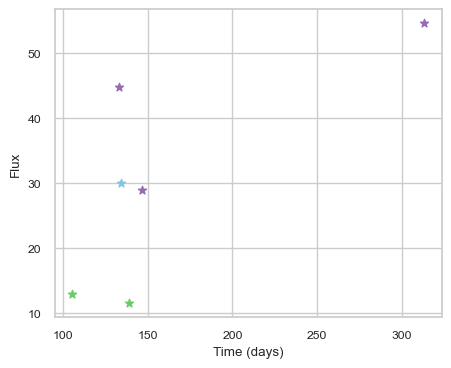

SNIax (4.0031905, False)
SNIax (3.557913, False)
SNIax (3.5277767, False)
SNIax (3.445697, False)
SNIax (3.4013047, False)
SNIax (3.4498472, False)
SNIax (3.069697, False)
SNIax (3.4027019, False)
SNIax (2.9920874, False)
SNIax (3.285382, False)
SNIax (3.45326, False)
SNIax (3.973491, False)


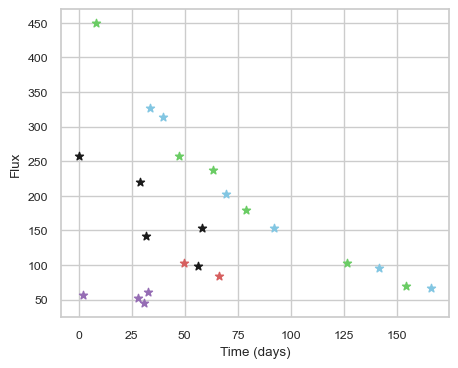

SNIax (4.2556567, False)
SNIax (6.0713196, False)
SNIax (5.69365, False)
SNIax (4.2872815, False)
SNIax (3.919336, False)
SNIax (3.0598557, False)
SNIax (3.8251011, False)
SNIax (3.309264, False)
SNIax (3.4766886, False)
SNIax (3.7007554, False)
SNIax (3.9811087, False)
SNIax (3.6753397, False)
SNIax (3.7778785, False)
SNIax (3.6326401, False)
SNIax (4.21353, False)
SNIax (3.699387, False)
SNIax (3.8644316, False)
SNIax (3.4093027, False)
SNIax (3.0700405, False)
SNIax (2.5270236, False)
SNIax (3.362949, False)
SNIax (3.1039875, False)
SNIax (3.0856311, False)
SNIax (3.4727395, False)
SNIax (4.0243025, False)
SNIax (3.0256252, False)
SNIax (3.9669468, False)
SNIax (3.0424778, False)
SNIax (2.9835713, False)
SNIax (3.3140514, False)
SNIax (2.9349763, False)
SNIax (3.2910678, False)
SNIax (2.882412, False)
SNIax (2.882156, False)
SNIax (2.9632285, False)
SNIax (3.8829153, False)
SNIax (2.997334, False)
SNIax (3.5259037, False)
SNIax (3.6106892, False)
SNIax (4.227197, False)
SNIax (3.491

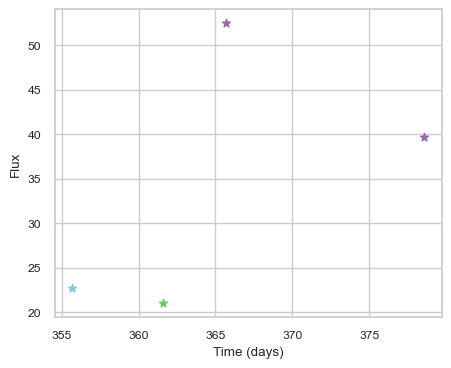

SNIax (4.418683, False)
SNIax (4.2095494, False)
SNIax (4.0015006, False)
SNIax (3.7072356, False)
SNIax (3.519101, False)
SNIax (4.108929, False)
SNIax (4.203063, False)
SNIax (4.175769, False)


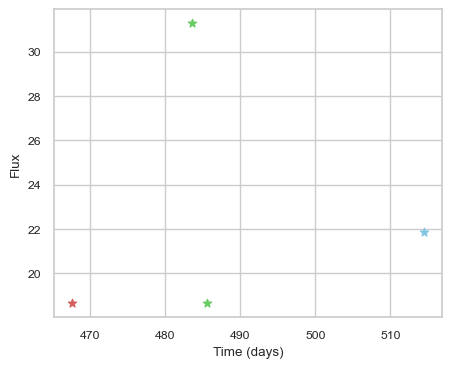

SNIax (3.891145, False)
SNIax (4.385802, False)
SNIax (3.8971012, False)
SNIax (4.490029, False)
SNIax (4.6814003, False)
SNIax (4.6575494, False)
SNIax (4.6047535, False)
SNIax (4.447059, False)


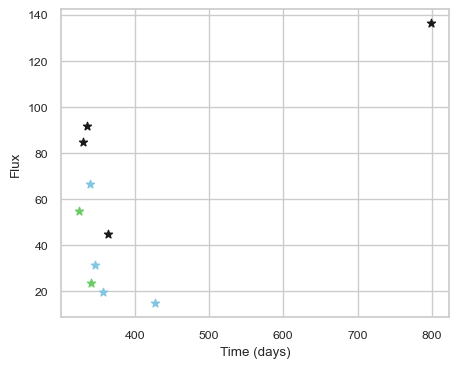

SNIax (3.915722, False)
SNIax (4.367518, False)
SNIax (4.3370194, False)
SNIax (4.6762476, False)
SNIax (4.4108586, False)
SNIax (4.1680307, False)
SNIax (4.824518, False)
SNIax (4.0287585, False)
SNIax (3.7255883, False)
SNIax (3.4107282, False)
SNIax (3.669232, False)
SNIax (3.3988507, False)
SNIax (3.3856022, False)
SNIax (3.5136235, False)
SNIax (3.567647, False)
SNIax (3.6054587, False)
SNIax (4.0222445, False)
SNIax (3.2036853, False)
SNIax (4.2514796, False)
SNIax (4.638976, False)


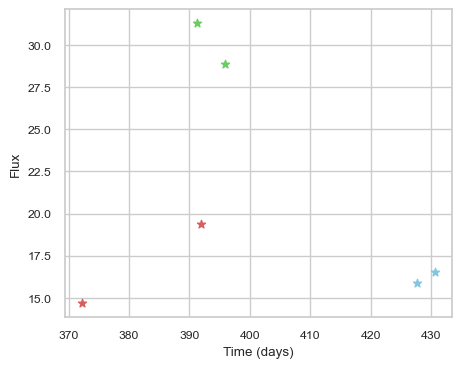

SNIax (3.8436074, False)
SNIax (4.328575, False)
SNIax (3.8156018, False)
SNIax (3.8150673, False)
SNIax (4.7367315, False)
SNIax (4.2569947, False)
SNIax (4.6716976, False)
SNIax (4.6202397, False)
SNIax (5.382196, False)
SNIax (5.8552833, False)
SNIax (5.126288, False)
SNIax (5.666999, False)


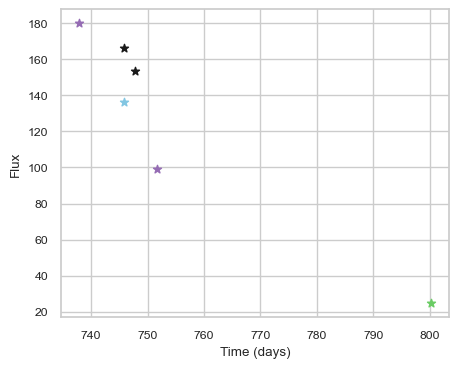

SNIax (3.6575663, False)
SNIax (3.2627647, False)
SNIax (3.8779378, False)
SNIax (4.6776514, False)
SNIax (4.73118, False)
SNIax (4.583095, False)
SNIax (3.63402, False)
SNIax (4.419403, False)
SNIax (3.6214888, False)
SNIax (3.0854392, False)
SNIax (3.6418955, False)
SNIax (3.0412645, False)


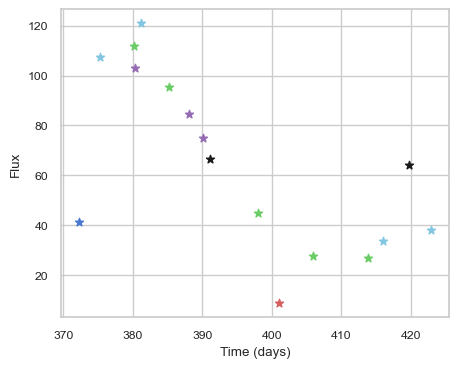

SNIax (3.838783, False)
SNIax (5.069788, False)
SNIax (4.477141, False)
SNIax (3.9575646, False)
SNIax (3.6870675, False)
SNIax (3.3498566, False)
SNIax (4.056896, False)
SNIax (4.565915, False)
SNIax (4.1545167, False)
SNIax (4.0665407, False)
SNIax (4.3249254, False)
SNIax (3.6036563, False)
SNIax (3.7472901, False)
SNIax (3.968686, False)
SNIax (3.3799846, False)
SNIax (3.241466, False)
SNIax (3.0956945, False)
SNIax (2.9802806, False)
SNIax (2.535608, False)
SNIax (2.1983395, False)
SNIax (2.6963115, False)
SNIax (2.2991278, False)
SNIax (2.6992784, False)
SNIax (2.3239071, False)
SNIax (2.5725806, False)
SNIax (2.3273408, False)
SNIax (2.55517, False)
SNIax (2.1999369, False)
SNIax (2.0867765, False)
SNIax (2.5207622, False)
SNIax (2.1951642, False)
SNIax (2.11186, False)


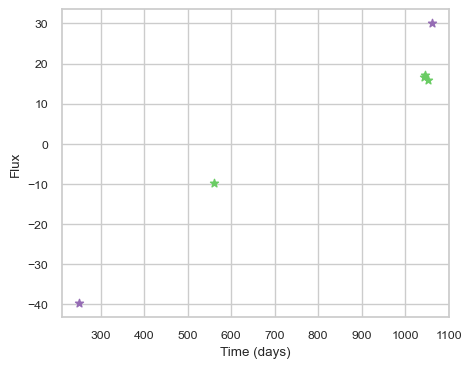

SNIax (5.379879, False)
SNIax (4.640584, False)
SNIax (4.8202667, False)
SNIax (4.407508, False)
SNIax (4.8701177, False)
SNIax (4.279397, False)
SNIax (3.892622, False)
SNIax (3.8148513, False)
SNIax (3.6675727, False)
SNIax (3.8880262, False)
SNIax (3.2840471, False)
SNIax (3.890339, False)


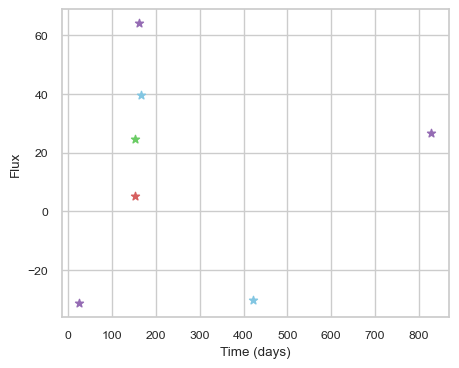

SNIax (5.3810205, False)
SNIax (4.669154, False)
SNIax (5.5542164, False)
SNIax (5.7191415, False)
SNIax (5.6062913, False)
SNIax (6.3502293, False)
SNIax (5.8741555, False)
SNIax (6.5999413, False)
SNIax (6.6583676, False)
SNIax (6.35909, False)
SNIax (5.745975, False)
SNIax (6.1488843, False)
SNIax (5.8400326, False)
SNIax (6.204359, False)


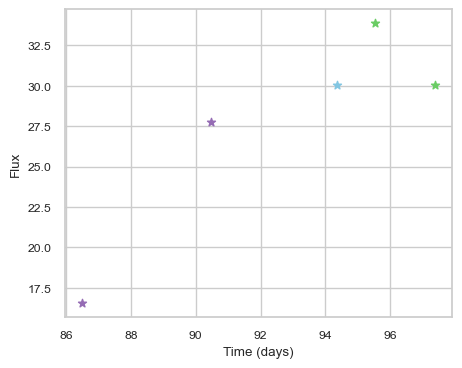

SNIax (3.979571, False)
SNIax (4.3319526, False)
SNIax (3.3264623, False)
SNIax (3.5044487, False)
SNIax (3.293013, False)
SNIax (3.5256782, False)
SNIax (3.2589417, False)
SNIax (3.318956, False)
SNIax (3.7980273, False)
SNIax (3.128172, False)


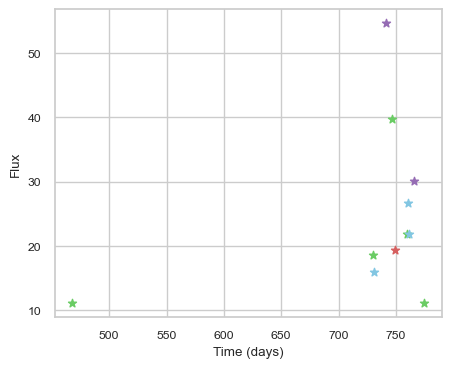

SNIax (3.9933372, False)
SNIax (3.4785094, False)
SNIax (3.5860238, False)
SNIax (3.0584068, False)
SNIax (3.0435853, False)
SNIax (3.4391575, False)
SNIax (3.4290812, False)
SNIax (2.4809282, False)
SNIax (2.5278416, False)
SNIax (2.255518, False)
SNIax (2.4226491, False)
SNIax (1.9348699, False)
SNIax (2.7241058, False)
SNIax (2.4459403, False)
SNIax (2.575611, False)
SNIax (2.4445875, False)
SNIax (2.4506218, False)
SNIax (1.9664471, False)
SNIax (2.6390424, False)
SNIax (2.3285606, False)
SNIax (2.3091822, False)
SNIax (2.5146427, False)


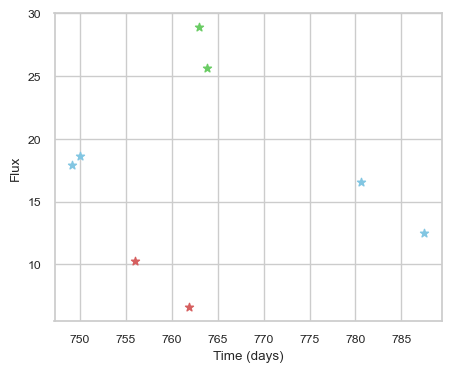

SNIax (4.0590296, False)
SNIax (3.4902601, False)
SNIax (3.3197768, False)
SNIax (3.524172, False)
SNIax (2.8678827, False)
SNIax (2.659234, False)
SNIax (2.8068297, False)
SNIax (2.9589844, False)
SNIax (2.897247, False)
SNIax (2.2928543, False)
SNIax (2.900865, False)
SNIax (2.4524572, False)
SNIax (2.777155, False)
SNIax (2.503221, False)
SNIax (2.310824, False)
SNIax (2.3270962, False)


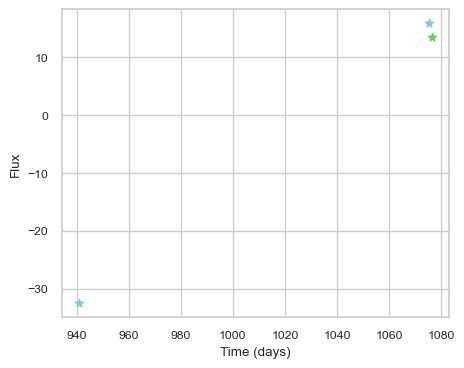

SNIax (3.6770098, False)
SNIax (3.6090548, False)
SNIax (3.7578137, False)
SNIax (3.3848846, False)
SNIax (3.2585533, False)
SNIax (3.3486903, False)


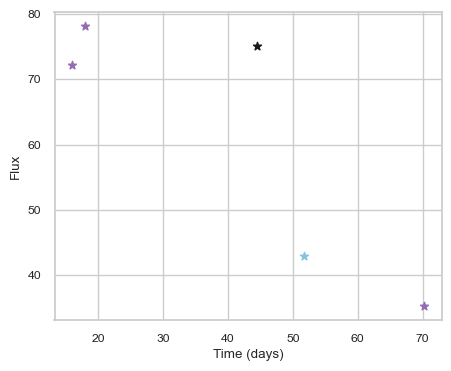

SNIax (4.1997786, False)
SNIax (4.092997, False)
SNIax (4.2732167, False)
SNIax (3.7198198, False)
SNIax (4.2780023, False)
SNIax (3.738738, False)
SNIax (4.3648696, False)
SNIax (3.9374366, False)
SNIax (4.167929, False)
SNIax (4.0717607, False)


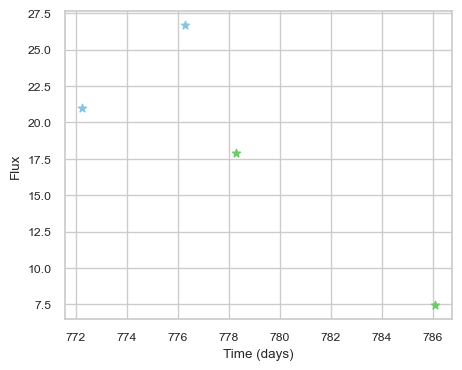

SNIax (4.1983795, False)
SNIax (3.5031912, False)
SNIax (3.328817, False)
SNIax (3.1711082, False)
SNIax (2.7612293, False)
SNIax (2.4194448, False)
SNIax (2.5781937, False)
SNIax (2.643259, False)


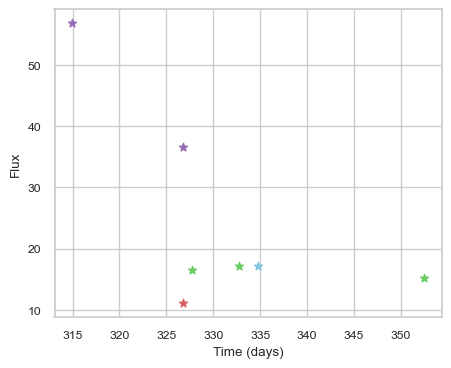

SNIax (3.5369654, False)
SNIax (3.9248903, False)
SNIax (3.7860365, False)
SNIax (4.5189195, False)
SNIax (4.272999, False)
SNIax (4.3374543, False)
SNIax (4.5165987, False)
SNIax (4.1314645, False)
SNIax (4.1860347, False)
SNIax (3.8223364, False)
SNIax (3.4204268, False)
SNIax (3.434685, False)
SNIax (3.797363, False)
SNIax (4.304268, False)


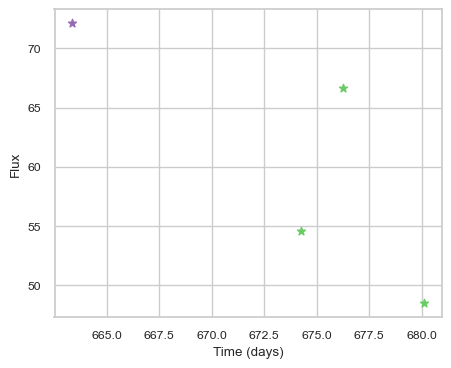

SNIax (3.9985952, False)
SNIax (4.2806044, False)
SNIax (4.7600946, False)
SNIax (4.6996894, False)
SNIax (3.5380285, False)
SNIax (3.499954, False)
SNIax (3.7168062, False)
SNIax (3.4040956, False)


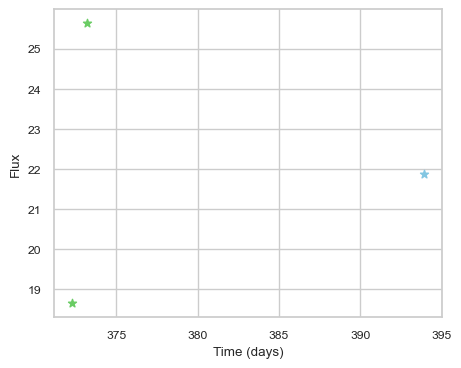

SNIax (4.1862955, False)
SNIax (3.260852, False)
SNIax (3.358027, False)
SNIax (2.7605526, False)
SNIax (2.9273734, False)
SNIax (2.8915675, False)


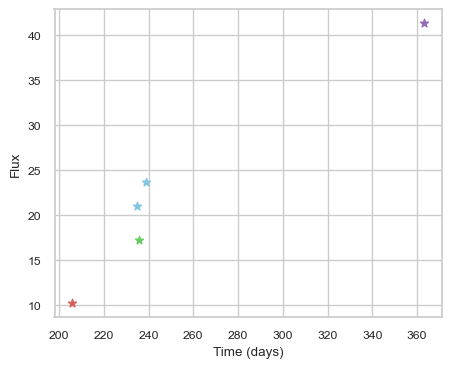

SNIax (3.976774, False)
SNIax (4.157046, False)
SNIax (3.9252875, False)
SNIax (3.4292226, False)
SNIax (2.8192072, False)
SNIax (3.6708813, False)
SNIax (3.831609, False)
SNIax (3.5532215, False)
SNIax (4.079328, False)
SNIax (5.039153, False)


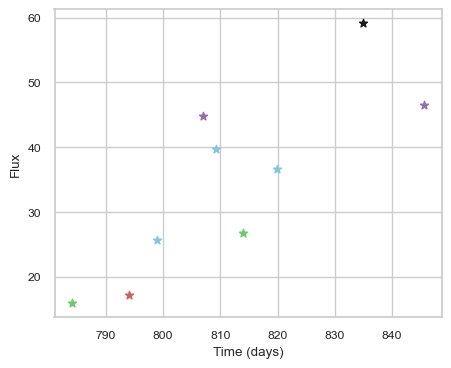

SNIax (4.0223227, False)
SNIax (3.39338, False)
SNIax (3.4321456, False)
SNIax (4.1016603, False)
SNIax (3.0851302, False)
SNIax (3.4314837, False)
SNIax (3.2434914, False)
SNIax (3.44937, False)
SNIax (3.5541568, False)
SNIax (3.6706512, False)
SNIax (3.3437252, False)
SNIax (3.16387, False)
SNIax (3.5771234, False)
SNIax (3.7866693, False)
SNIax (3.8769338, False)
SNIax (4.6727376, False)
SNIax (4.3640766, False)
SNIax (5.0047383, False)


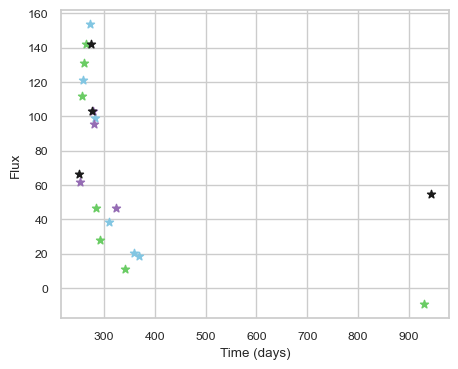

SNIax (3.8648605, False)
SNIax (3.9319065, False)
SNIax (3.918587, False)
SNIax (4.040575, False)
SNIax (3.2544172, False)
SNIax (3.1102326, False)
SNIax (3.9341407, False)
SNIax (4.153431, False)
SNIax (4.382697, False)
SNIax (3.8848288, False)
SNIax (4.7141848, False)
SNIax (4.272531, False)
SNIax (4.8327613, False)
SNIax (5.606884, False)
SNIax (4.9575377, False)
SNIax (4.9615927, False)
SNIax (5.5295305, False)
SNIax (5.023298, False)
SNIax (5.281097, False)
SNIax (5.10193, False)
SNIax (5.4017024, False)
SNIax (5.070238, False)
SNIax (5.488303, False)
SNIax (5.0943832, False)
SNIax (4.985083, False)
SNIax (4.905135, False)
SNIax (5.1686506, False)
SNIax (5.599102, False)
SNIax (5.896546, False)
SNIax (5.859165, False)
SNIax (5.237077, False)
SNIax (5.8163533, False)
SNIax (5.9695992, False)
SNIax (5.369984, False)
SNIax (5.32362, False)
SNIax (5.4368787, False)
SNIax (5.5618854, False)
SNIax (5.621001, False)
SNIax (6.274831, False)
SNIax (4.9309697, False)
SNIax (5.537304, False)

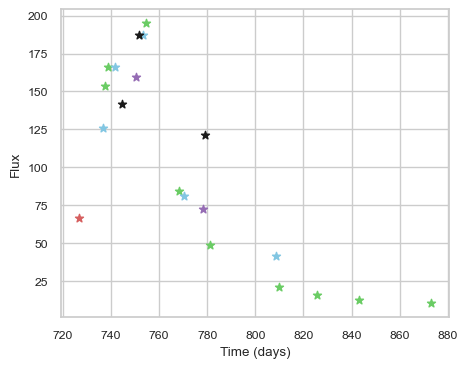

SNIax (3.7835078, False)
SNIax (4.06454, False)
SNIax (3.9559977, False)
SNIax (3.0893219, False)
SNIax (3.5270889, False)
SNIax (3.0726175, False)
SNIax (3.1657548, False)
SNIax (2.9277935, False)
SNIax (3.2195542, False)
SNIax (2.9596407, False)
SNIax (3.278504, False)
SNIax (2.8266506, False)
SNIax (2.7640035, False)
SNIax (2.4392078, False)
SNIax (3.599422, False)
SNIax (2.2496345, False)
SNIax (3.5078583, False)
SNIax (2.242273, False)
SNIax (2.7886624, False)
SNIax (2.1175086, False)
SNIax (2.901713, False)
SNIax (2.308797, False)
SNIax (2.2498639, False)
SNIax (2.2712834, False)
SNIax (2.2131758, False)
SNIax (2.0593157, False)
SNIax (2.638843, False)
SNIax (2.3995934, False)
SNIax (2.0830195, False)
SNIax (1.9343458, False)
SNIax (2.6442137, False)
SNIax (2.517991, False)
SNIax (2.4926145, False)
SNIax (2.1815033, False)
SNIax (2.5119038, False)
SNIax (2.2229989, False)
SNIax (2.58912, False)
SNIax (2.3246343, False)
SNIax (2.68367, False)
SNIax (2.3558793, False)


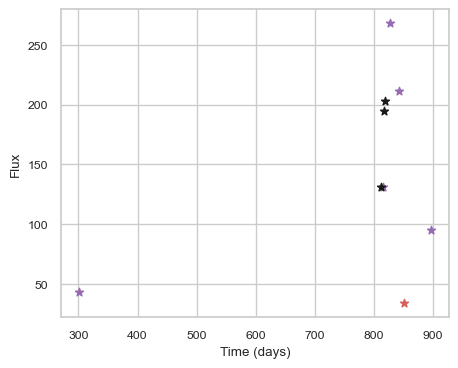

SNIax (3.8075686, False)
SNIax (3.9154043, False)
SNIax (3.7134013, False)
SNIax (3.8372936, False)
SNIax (3.5164747, False)
SNIax (3.8337114, False)
SNIax (3.90431, False)
SNIax (3.8252776, False)
SNIax (3.9047441, False)
SNIax (3.87373, False)
SNIax (3.34777, False)
SNIax (3.317667, False)
SNIax (2.95009, False)
SNIax (3.0090306, False)
SNIax (2.6194575, False)
SNIax (2.9217472, False)
SNIax (3.524142, False)
SNIax (3.0641258, False)


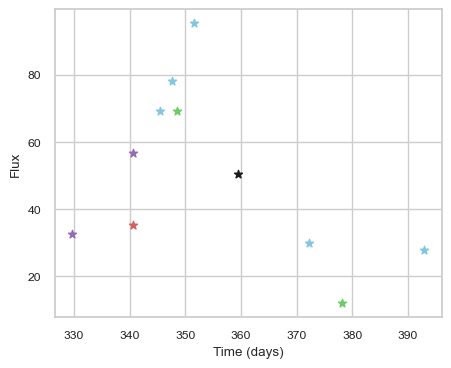

SNIax (4.0077467, False)
SNIax (3.7314875, False)
SNIax (3.5878086, False)
SNIax (3.9838119, False)
SNIax (4.1471696, False)
SNIax (3.392414, False)
SNIax (3.5528717, False)
SNIax (3.0499802, False)
SNIax (3.5073915, False)
SNIax (3.7591684, False)
SNIax (3.7783875, False)
SNIax (3.4381819, False)
SNIax (3.6239798, False)
SNIax (3.498773, False)
SNIax (3.7765515, False)
SNIax (3.913437, False)
SNIax (3.9415293, False)
SNIax (3.726159, False)
SNIax (3.433068, False)
SNIax (3.6303983, False)
SNIax (3.3205025, False)
SNIax (3.6092882, False)


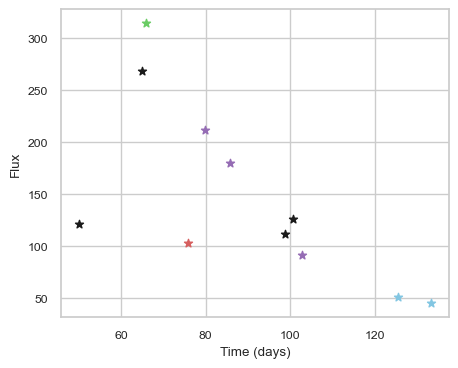

SNIax (3.6829555, False)
SNIax (3.5030437, False)
SNIax (3.6748307, False)
SNIax (3.9953084, False)
SNIax (3.5227022, False)
SNIax (3.5046213, False)
SNIax (3.1960955, False)
SNIax (3.2576005, False)
SNIax (3.0938916, False)
SNIax (4.082283, False)
SNIax (3.41868, False)
SNIax (3.5703254, False)
SNIax (3.7706883, False)
SNIax (3.8554773, False)
SNIax (4.279437, False)
SNIax (4.1949034, False)
SNIax (4.2611995, False)
SNIax (4.0447397, False)
SNIax (4.572255, False)
SNIax (3.6568365, False)
SNIax (3.491252, False)
SNIax (3.3734896, False)


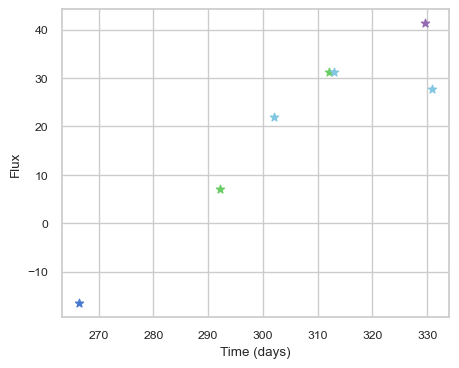

SNIax (3.916129, False)
SNIax (4.20669, False)
SNIax (3.7225044, False)
SNIax (3.8914115, False)
SNIax (3.931601, False)
SNIax (3.2100954, False)
SNIax (2.7026992, False)
SNIax (2.991568, False)
SNIax (3.3354406, False)
SNIax (2.9114916, False)
SNIax (2.9811623, False)
SNIax (2.963689, False)
SNIax (3.0280948, False)
SNIax (2.4783292, False)


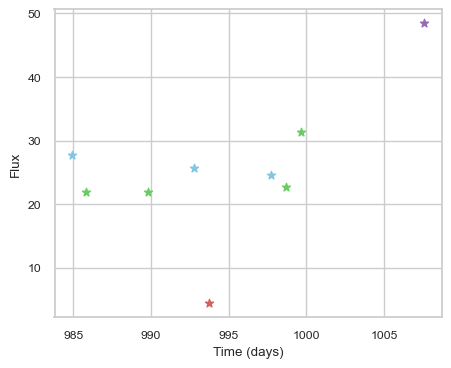

SNIax (4.1440344, False)
SNIax (3.9692805, False)
SNIax (3.253863, False)
SNIax (3.0778418, False)
SNIax (3.1194935, False)
SNIax (2.1329682, False)
SNIax (2.6201859, False)
SNIax (2.6749606, False)
SNIax (2.6994622, False)
SNIax (3.0698657, False)
SNIax (2.5134194, False)
SNIax (2.4183505, False)
SNIax (2.433643, False)
SNIax (2.529733, False)
SNIax (2.9010067, False)
SNIax (2.489893, False)
SNIax (2.580276, False)
SNIax (2.3740842, False)


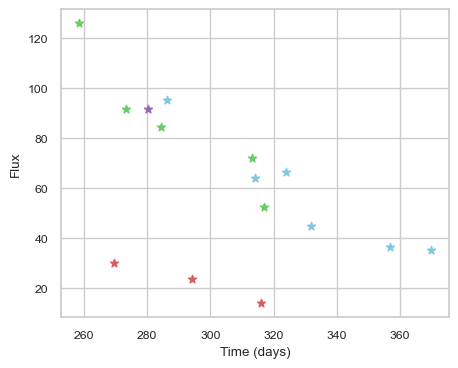

SNIax (3.444922, False)
SNIax (3.8902438, False)
SNIax (3.157452, False)
SNIax (3.4954746, False)
SNIax (5.0161457, False)
SNIax (4.696185, False)
SNIax (4.71385, False)
SNIax (5.492544, False)
SNIax (5.3900385, False)
SNIax (5.0637746, False)
SNIax (3.967273, False)
SNIax (4.9794903, False)
SNIax (4.987376, False)
SNIax (4.578355, False)
SNIax (5.0090632, False)
SNIax (4.0916796, False)
SNIax (3.8335404, False)
SNIax (4.54976, False)
SNIax (4.097892, False)
SNIax (3.611153, False)
SNIax (4.3656645, False)
SNIax (3.958449, False)
SNIax (3.9071338, False)
SNIax (4.0447416, False)
SNIax (3.987416, False)
SNIax (3.9841046, False)
SNIax (4.5262938, False)
SNIax (4.103582, False)
SNIax (4.330287, False)
SNIax (4.130617, False)


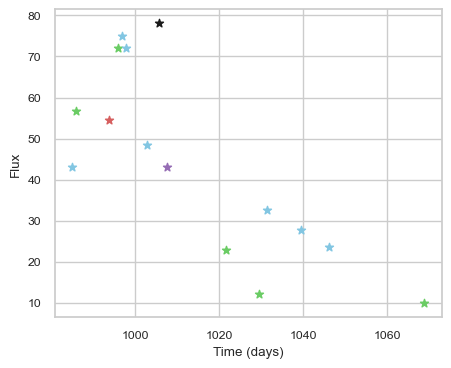

SNIax (3.7457783, False)
SNIax (3.7038438, False)
SNIax (3.2703376, False)
SNIax (3.5030324, False)
SNIax (3.258425, False)
SNIax (3.4269137, False)
SNIax (3.2363698, False)
SNIax (3.0248322, False)
SNIax (3.1595645, False)
SNIax (3.3768299, False)
SNIax (3.110189, False)
SNIax (3.214796, False)
SNIax (3.5237944, False)
SNIax (2.7250838, False)
SNIax (2.72833, False)
SNIax (3.340938, False)
SNIax (3.8076332, False)
SNIax (2.8130682, False)
SNIax (2.6179433, False)
SNIax (2.1440737, False)
SNIax (2.607155, False)
SNIax (1.9111205, False)
SNIax (2.2764308, False)
SNIax (1.6527267, False)
SNIax (1.756606, False)
SNIax (1.6772835, False)
SNIax (2.079479, False)
SNIax (1.8032125, False)
SNIax (2.1048305, False)
SNIax (2.0334234, False)


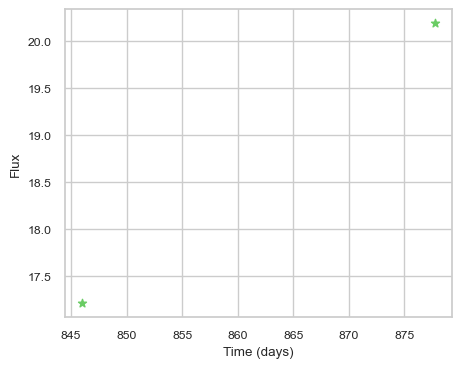

SNIax (3.7484336, False)
SNIax (3.417893, False)
SNIax (3.2609966, False)
SNIax (3.3831804, False)


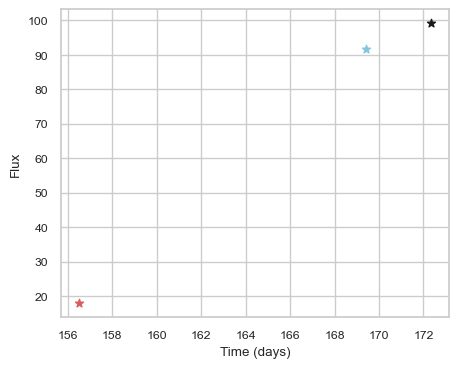

SNIax (3.9355447, False)
SNIax (4.0264378, False)
SNIax (3.7580688, False)
SNIax (3.553821, False)
SNIax (3.9147885, False)
SNIax (3.661805, False)


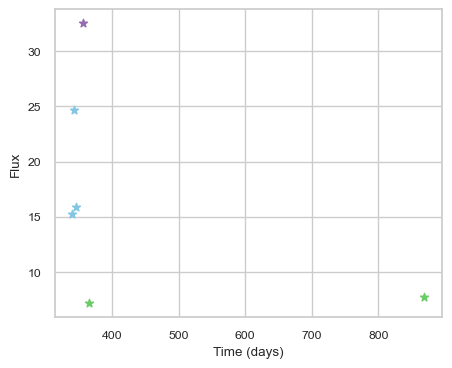

SNIax (4.7329955, False)
SNIax (4.222921, False)
SNIax (3.6196475, False)
SNIax (4.195868, False)
SNIax (3.298858, False)
SNIax (3.3139358, False)
SNIax (2.7125835, False)
SNIax (3.0881531, False)
SNIax (2.8006, False)
SNIax (2.8869367, False)
SNIax (3.9458084, False)
SNIax (3.4245324, False)


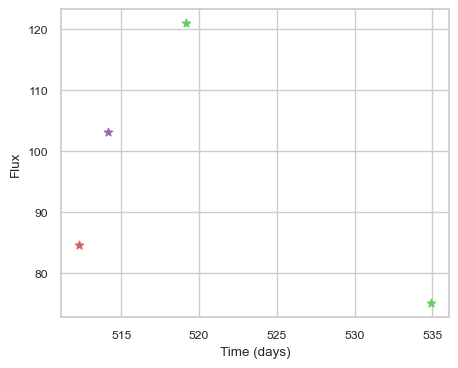

SNIax (3.7592835, False)
SNIax (4.4809933, False)
SNIax (4.8669205, False)
SNIax (4.5889287, False)
SNIax (3.9395297, False)
SNIax (3.784381, False)
SNIax (3.7058873, False)
SNIax (3.4249623, False)


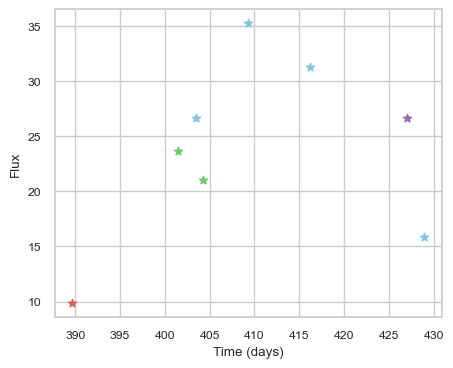

SNIax (4.178443, False)
SNIax (4.0298934, False)
SNIax (3.6723537, False)
SNIax (3.109364, False)
SNIax (4.0703816, False)
SNIax (3.274325, False)
SNIax (3.9201994, False)
SNIax (3.3903368, False)
SNIax (3.5768368, False)
SNIax (3.1633632, False)
SNIax (3.0423143, False)
SNIax (3.2112753, False)
SNIax (3.0334556, False)
SNIax (3.1449077, False)
SNIax (2.9895253, False)
SNIax (3.0339205, False)


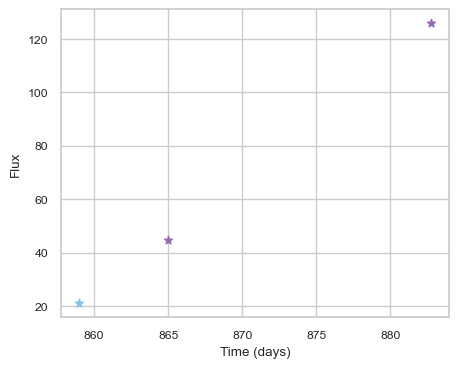

SNIax (3.6125183, False)
SNIax (3.2898142, False)
SNIax (3.3263268, False)
SNIax (3.6445973, False)
SNIax (3.1164615, False)
SNIax (3.7818754, False)


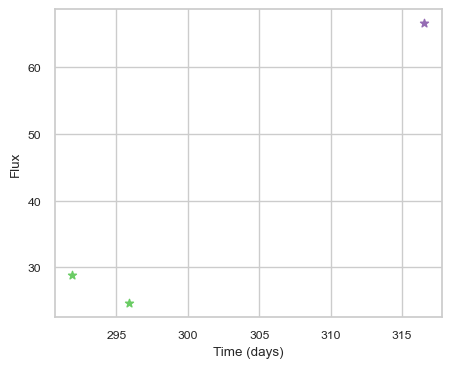

SNIax (3.9224534, False)
SNIax (4.0640507, False)
SNIax (3.8999848, False)
SNIax (4.642506, False)
SNIax (4.354793, False)
SNIax (3.8079393, False)


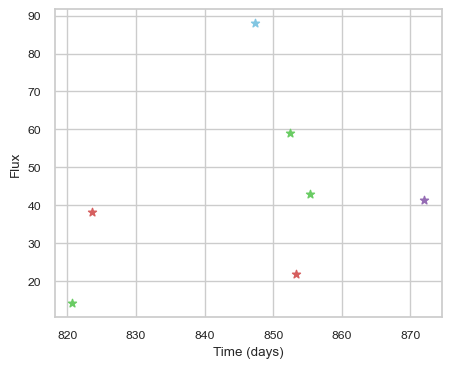

SNIax (3.800944, False)
SNIax (3.3606806, False)
SNIax (3.4578316, False)
SNIax (4.288165, False)
SNIax (3.4350898, False)
SNIax (3.343603, False)
SNIax (3.6076937, False)
SNIax (3.619906, False)
SNIax (3.320426, False)
SNIax (3.9260778, False)
SNIax (4.23808, False)
SNIax (4.574667, False)
SNIax (3.8601758, False)
SNIax (3.8162978, False)


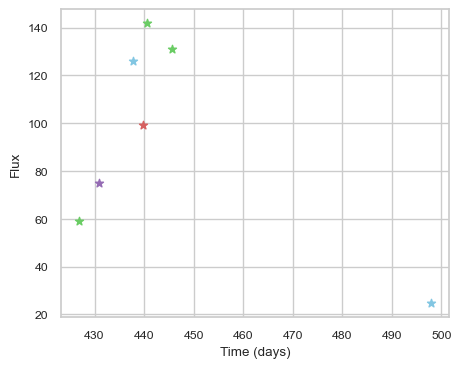

SNIax (3.8620512, False)
SNIax (3.6890833, False)
SNIax (3.937984, False)
SNIax (3.6121445, False)
SNIax (3.3102505, False)
SNIax (3.5365365, False)
SNIax (3.3265986, False)
SNIax (3.483087, False)
SNIax (3.3413146, False)
SNIax (3.226541, False)
SNIax (3.3130717, False)
SNIax (3.1056354, False)
SNIax (3.0645773, False)
SNIax (2.6299381, False)


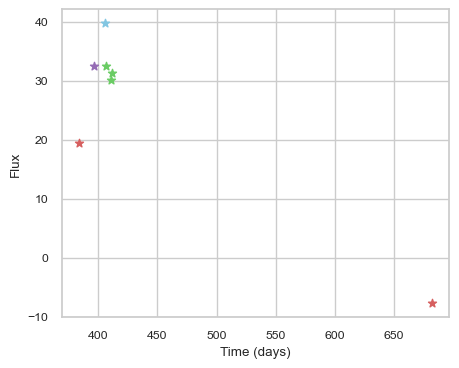

SNIax (3.9367266, False)
SNIax (4.0048246, False)
SNIax (4.096375, False)
SNIax (3.5780501, False)
SNIax (4.19422, False)
SNIax (3.7827482, False)
SNIax (3.7842853, False)
SNIax (4.3574038, False)
SNIax (5.130858, False)
SNIax (5.240333, False)
SNIax (5.48642, False)
SNIax (5.6507926, False)
SNIax (6.519722, False)
SNIax (6.3361483, False)


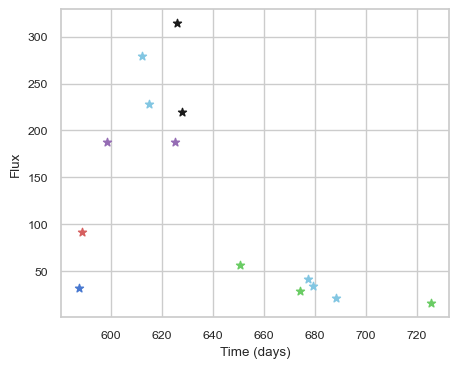

SNIax (3.5545986, False)
SNIax (3.4073834, False)
SNIax (3.9227579, False)
SNIax (3.7468421, False)
SNIax (3.8507466, False)
SNIax (2.9133077, False)
SNIax (3.6665974, False)
SNIax (3.6547136, False)
SNIax (2.929129, False)
SNIax (3.088253, False)
SNIax (2.8535714, False)
SNIax (2.17781, False)
SNIax (3.3408148, False)
SNIax (2.414363, False)
SNIax (4.0828285, False)
SNIax (2.643936, False)
SNIax (2.9826038, False)
SNIax (2.7415345, False)
SNIax (3.0138328, False)
SNIax (2.8353577, False)
SNIax (3.0510104, False)
SNIax (2.650786, False)
SNIax (2.9409642, False)
SNIax (2.4888935, False)
SNIax (2.4317794, False)
SNIax (2.558594, False)
SNIax (2.7507718, False)
SNIax (2.5420024, False)


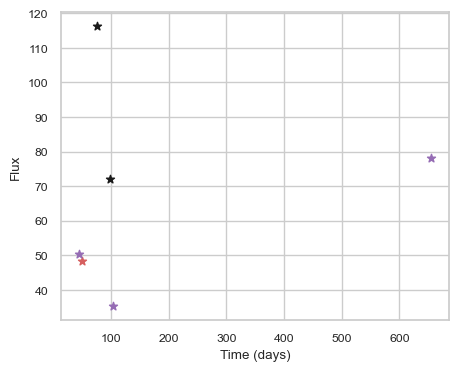

SNIax (4.1896396, False)
SNIax (3.9267285, False)
SNIax (4.041091, False)
SNIax (4.1172056, False)
SNIax (3.9662964, False)
SNIax (3.69378, False)
SNIax (4.404698, False)
SNIax (4.5600276, False)
SNIax (4.965056, False)
SNIax (4.2194185, False)
SNIax (4.461716, False)
SNIax (4.810397, False)


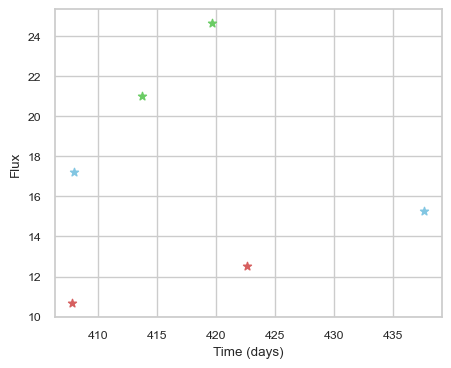

SNIax (3.8232703, False)
SNIax (3.8766952, False)
SNIax (3.7268622, False)
SNIax (3.4922857, False)
SNIax (3.3545258, False)
SNIax (3.2705047, False)
SNIax (3.3691635, False)
SNIax (3.4342089, False)
SNIax (3.6530662, False)
SNIax (3.8386812, False)
SNIax (3.2111497, False)
SNIax (3.7048886, False)


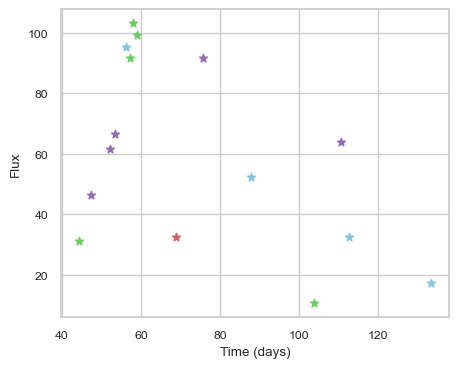

SNIax (4.091495, False)
SNIax (3.6388788, False)
SNIax (3.6265156, False)
SNIax (2.6838405, False)
SNIax (3.6680622, False)
SNIax (2.2997804, False)
SNIax (3.2731416, False)
SNIax (2.8170488, False)
SNIax (3.23828, False)
SNIax (3.0808628, False)
SNIax (3.6328337, False)
SNIax (3.1995442, False)
SNIax (3.3585277, False)
SNIax (3.1051755, False)
SNIax (3.6914215, False)
SNIax (3.3392313, False)
SNIax (3.7338734, False)
SNIax (3.7315996, False)
SNIax (4.231762, False)
SNIax (4.0898256, False)
SNIax (4.483335, False)
SNIax (4.448224, False)
SNIax (4.240504, False)
SNIax (3.995425, False)
SNIax (3.7887232, False)
SNIax (4.1482005, False)
SNIax (4.508474, False)
SNIax (4.0616536, False)
SNIax (3.8331637, False)
SNIax (4.294141, False)


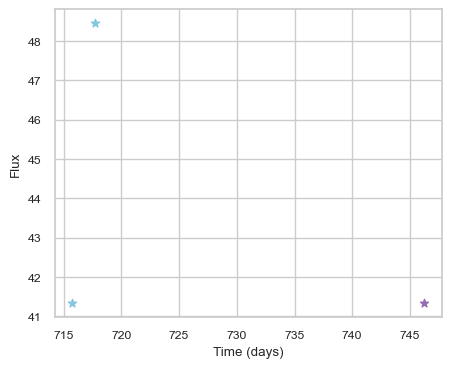

SNIax (4.1159606, False)
SNIax (4.0915046, False)
SNIax (3.8635561, False)
SNIax (4.463584, False)
SNIax (4.462279, False)
SNIax (4.030353, False)


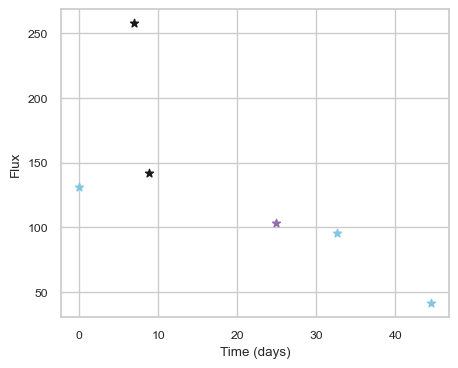

SNIax (4.2259016, False)
SNIax (3.6619673, False)
SNIax (4.0812936, False)
SNIax (4.3470316, False)
SNIax (4.6840596, False)
SNIax (4.503516, False)
SNIax (3.949436, False)
SNIax (4.057381, False)
SNIax (4.104155, False)
SNIax (3.950068, False)
SNIax (4.0921016, False)


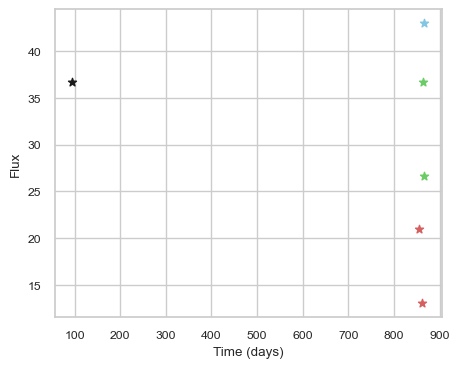

SNIax (3.8776517, False)
SNIax (4.1969447, False)
SNIax (3.7555585, False)
SNIax (3.6856215, False)
SNIax (3.8077252, False)
SNIax (3.6413794, False)
SNIax (3.831502, False)
SNIax (3.260309, False)
SNIax (3.6698852, False)
SNIax (2.8980129, False)
SNIax (2.9757526, False)
SNIax (3.4683588, False)


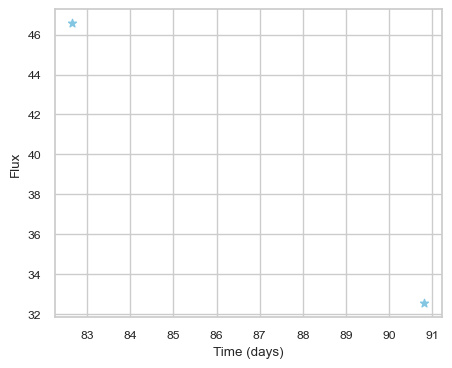

SNIax (3.872519, False)
SNIax (3.9850008, False)
SNIax (3.652754, False)
SNIax (3.6222413, False)


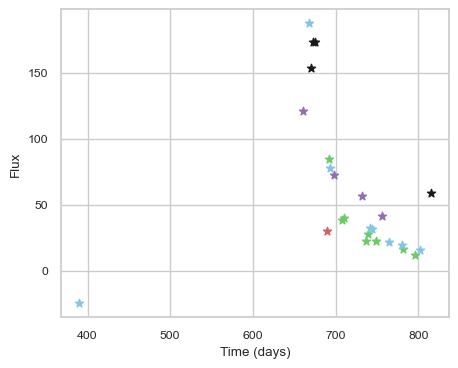

SNIax (3.6914215, False)
SNIax (3.5155144, False)
SNIax (3.7299721, False)
SNIax (3.941696, False)
SNIax (3.8441973, False)
SNIax (4.513103, False)
SNIax (4.3853617, False)
SNIax (4.004975, False)
SNIax (4.3459506, False)
SNIax (3.6183298, False)
SNIax (3.5853338, False)
SNIax (2.8567698, False)
SNIax (3.0435445, False)
SNIax (3.1300569, False)
SNIax (2.6184552, False)
SNIax (3.0343933, False)
SNIax (2.51648, False)
SNIax (2.7898574, False)
SNIax (3.3359632, False)
SNIax (2.3986297, False)
SNIax (2.8715775, False)
SNIax (2.679025, False)
SNIax (3.1488888, False)
SNIax (3.084838, False)
SNIax (3.2881103, False)
SNIax (3.045637, False)
SNIax (3.1047928, False)
SNIax (3.1011615, False)
SNIax (3.3718941, False)
SNIax (3.086456, False)
SNIax (3.2663984, False)
SNIax (2.9805639, False)
SNIax (2.94744, False)
SNIax (2.9553401, False)
SNIax (3.1430805, False)
SNIax (3.0708783, False)
SNIax (3.2420018, False)
SNIax (3.4825342, False)
SNIax (2.9765418, False)
SNIax (2.8909135, False)
SNIax (2.99

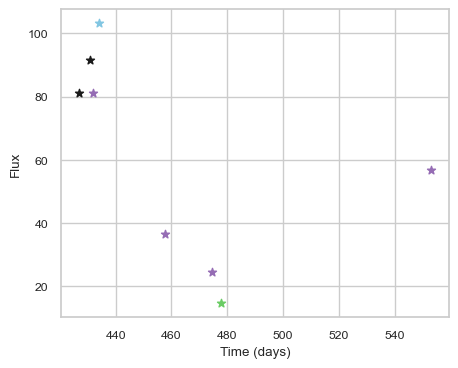

SNIax (4.3039804, False)
SNIax (4.0481215, False)
SNIax (4.6891685, False)
SNIax (4.0478997, False)
SNIax (4.4947, False)
SNIax (4.631389, False)
SNIax (4.842476, False)
SNIax (4.876608, False)
SNIax (5.032669, False)
SNIax (4.6774516, False)
SNIax (5.1234083, False)
SNIax (5.1127033, False)
SNIax (4.9931026, False)
SNIax (4.8668547, False)
SNIax (4.965904, False)
SNIax (4.559365, False)


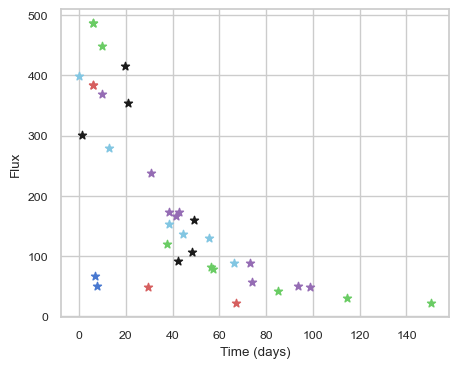

SNIax (3.9306867, False)
SNIax (3.0328774, False)
SNIax (2.9995735, False)
SNIax (3.3497772, False)
SNIax (3.5457275, False)
SNIax (4.0685267, False)
SNIax (5.2860227, False)
SNIax (5.60014, False)
SNIax (5.142368, False)
SNIax (5.521347, False)
SNIax (5.387595, False)
SNIax (5.6858807, False)
SNIax (5.78252, False)
SNIax (5.239049, False)
SNIax (5.4489803, False)
SNIax (4.9576707, False)
SNIax (5.6134796, False)
SNIax (4.484609, False)
SNIax (5.0674872, False)
SNIax (4.443703, False)
SNIax (5.344149, False)
SNIax (3.7967281, False)
SNIax (3.73403, False)
SNIax (3.5352044, False)
SNIax (3.5660486, False)
SNIax (3.3964813, False)
SNIax (3.2634614, False)
SNIax (2.5543492, False)
SNIax (2.9264507, False)
SNIax (2.8309188, False)
SNIax (3.3226416, False)
SNIax (3.3540888, False)
SNIax (3.2805214, False)
SNIax (2.945957, False)
SNIax (3.3897882, False)
SNIax (3.330053, False)
SNIax (4.0466547, False)
SNIax (3.4731572, False)
SNIax (3.605548, False)
SNIax (3.2582216, False)
SNIax (3.8771086

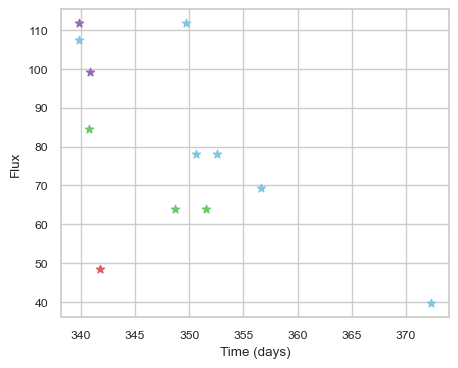

SNIax (3.9298065, False)
SNIax (4.9386344, False)
SNIax (5.4909415, False)
SNIax (5.8072944, False)
SNIax (5.3654146, False)
SNIax (5.227955, False)
SNIax (5.191008, False)
SNIax (5.7160716, False)
SNIax (5.0490623, False)
SNIax (5.375978, False)
SNIax (5.2177453, False)
SNIax (4.3900976, False)
SNIax (5.085922, False)
SNIax (4.038841, False)
SNIax (4.984736, False)
SNIax (4.678325, False)
SNIax (4.6607256, False)
SNIax (3.6493857, False)
SNIax (4.455136, False)
SNIax (4.974273, False)
SNIax (4.5323505, False)
SNIax (5.1183124, False)
SNIax (4.382908, False)


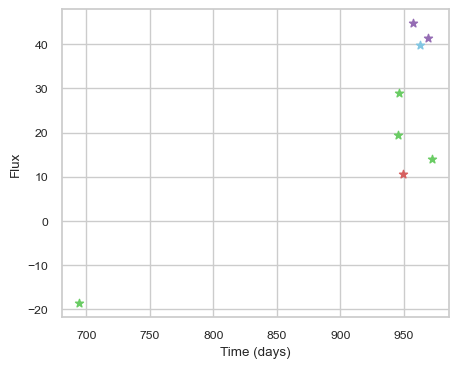

SNIax (4.0305624, False)
SNIax (4.225681, False)
SNIax (4.0591965, False)
SNIax (3.7289295, False)
SNIax (3.493087, False)
SNIax (3.139801, False)
SNIax (3.4348328, False)
SNIax (3.1771073, False)
SNIax (2.773253, False)
SNIax (2.7157483, False)
SNIax (2.4859788, False)
SNIax (3.181268, False)
SNIax (3.2306511, False)
SNIax (2.776911, False)
SNIax (2.8864694, False)
SNIax (2.7265344, False)


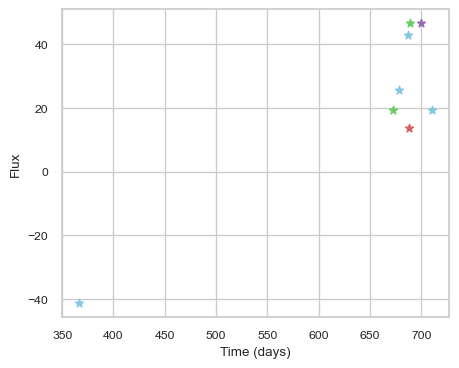

SNIax (3.7930377, False)
SNIax (3.2706585, False)
SNIax (4.0936527, False)
SNIax (3.5741498, False)
SNIax (3.3939488, False)
SNIax (3.2178745, False)
SNIax (3.146481, False)
SNIax (3.1471686, False)
SNIax (3.4617684, False)
SNIax (3.0978687, False)
SNIax (3.1831024, False)
SNIax (2.2542195, False)
SNIax (2.7629726, False)
SNIax (1.8834785, False)
SNIax (2.7683935, False)
SNIax (2.0828598, False)


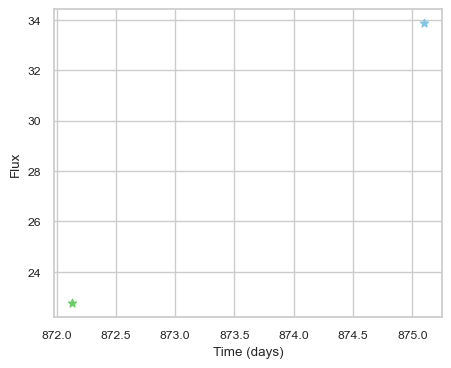

SNIax (5.5209165, False)
SNIax (5.285607, False)
SNIax (5.011922, False)
SNIax (4.9229198, False)


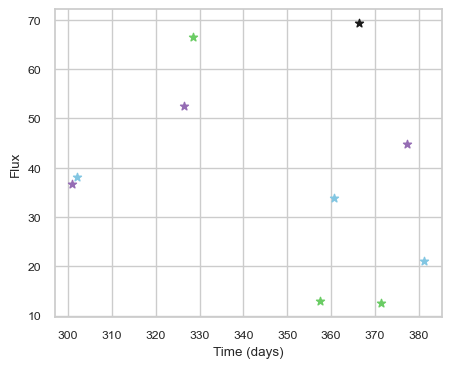

SNIax (3.839445, False)
SNIax (3.8821416, False)
SNIax (3.4893155, False)
SNIax (3.947477, False)
SNIax (3.3482742, False)
SNIax (3.4863558, False)
SNIax (3.8662376, False)
SNIax (2.6166782, False)
SNIax (3.968248, False)
SNIax (3.1514912, False)
SNIax (2.5382118, False)
SNIax (1.648379, False)
SNIax (2.7359889, False)
SNIax (3.6810637, False)
SNIax (2.7582343, False)
SNIax (2.1372867, False)
SNIax (2.7587767, False)
SNIax (2.145471, False)
SNIax (3.0962799, False)
SNIax (1.9401547, False)


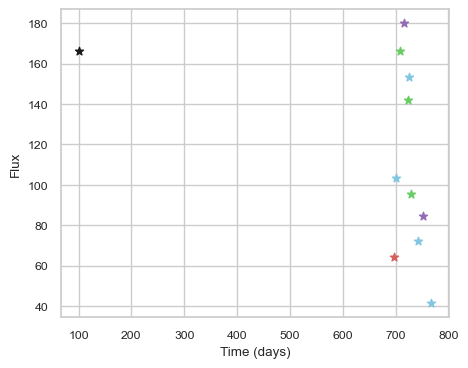

SNIax (3.900761, False)
SNIax (3.854669, False)
SNIax (3.9448404, False)
SNIax (4.1636815, False)
SNIax (3.7280564, False)
SNIax (3.2271183, False)
SNIax (3.76953, False)
SNIax (2.9011965, False)
SNIax (3.3180437, False)
SNIax (2.8375351, False)
SNIax (3.2297766, False)
SNIax (2.9614513, False)
SNIax (3.2830398, False)
SNIax (3.3956256, False)
SNIax (3.8250728, False)
SNIax (3.4617553, False)
SNIax (3.3025327, False)
SNIax (3.239262, False)
SNIax (2.4772274, False)
SNIax (3.154538, False)
SNIax (3.9374404, False)
SNIax (3.2508352, False)


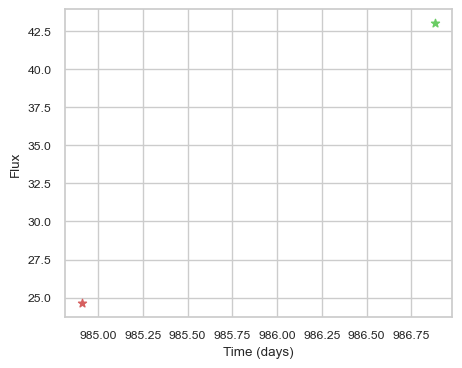

SNIax (3.7932513, False)
SNIax (4.568521, False)
SNIax (4.1418786, False)
SNIax (3.2158387, False)


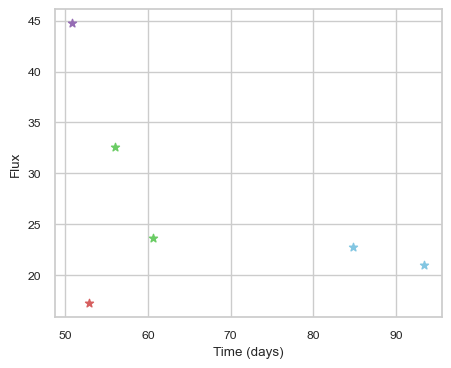

SNIax (4.081748, False)
SNIax (3.6057382, False)
SNIax (3.607792, False)
SNIax (2.9396667, False)
SNIax (2.5701394, False)
SNIax (2.7995052, False)
SNIax (3.3537135, False)
SNIax (3.0718765, False)
SNIax (2.864622, False)
SNIax (3.1515262, False)
SNIax (3.5388815, False)
SNIax (3.1614857, False)


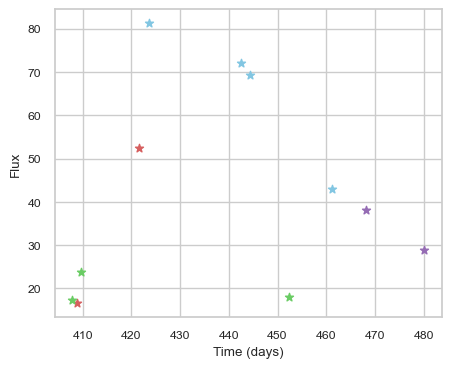

SNIax (3.9431012, False)
SNIax (3.639657, False)
SNIax (3.4873989, False)
SNIax (3.885899, False)
SNIax (4.5195665, False)
SNIax (3.5436094, False)
SNIax (3.510325, False)
SNIax (3.11055, False)
SNIax (3.195879, False)
SNIax (3.3484514, False)
SNIax (3.3234384, False)
SNIax (2.6176307, False)
SNIax (3.090194, False)
SNIax (2.6491292, False)
SNIax (3.647087, False)
SNIax (3.1763844, False)
SNIax (3.3685405, False)
SNIax (3.1532524, False)
SNIax (3.0355844, False)
SNIax (2.899868, False)
SNIax (2.768035, False)
SNIax (2.8089466, False)


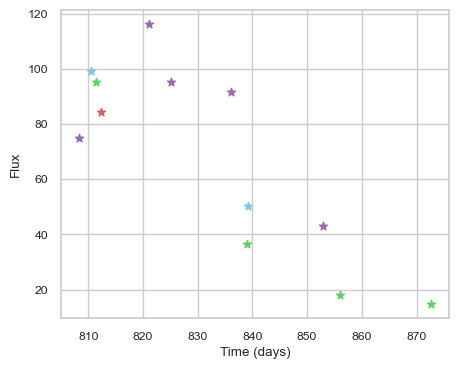

SNIax (3.8583796, False)
SNIax (3.5879853, False)
SNIax (3.8121147, False)
SNIax (4.0560493, False)
SNIax (4.015427, False)
SNIax (3.735251, False)
SNIax (3.6297052, False)
SNIax (3.6044443, False)
SNIax (3.7006955, False)
SNIax (3.5877786, False)
SNIax (4.135816, False)
SNIax (3.3575308, False)
SNIax (3.8021708, False)
SNIax (3.7043147, False)
SNIax (3.9248908, False)
SNIax (3.2887678, False)
SNIax (3.6115391, False)
SNIax (3.5157084, False)
SNIax (3.2983308, False)
SNIax (3.1256006, False)
SNIax (2.964814, False)
SNIax (3.1389794, False)
SNIax (2.9853175, False)
SNIax (3.0651517, False)


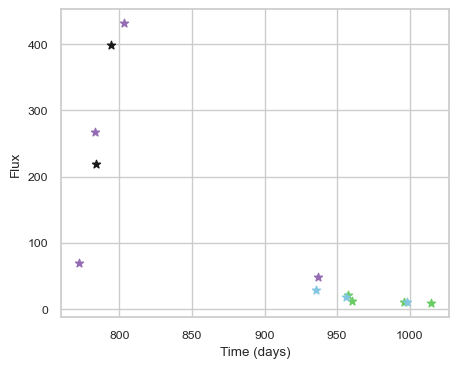

SNIax (3.770539, False)
SNIax (3.1711006, False)
SNIax (2.9857001, False)
SNIax (3.1475244, False)
SNIax (3.6113067, False)
SNIax (3.6695533, False)
SNIax (3.453049, False)
SNIax (3.6341207, False)
SNIax (3.0997365, False)
SNIax (3.1496143, False)
SNIax (3.150221, False)
SNIax (3.180181, False)
SNIax (3.0852258, False)
SNIax (3.1001134, False)
SNIax (3.2157204, False)
SNIax (3.0736475, False)
SNIax (2.9545772, False)
SNIax (3.0143213, False)
SNIax (3.385257, False)
SNIax (2.9861526, False)
SNIax (3.096168, False)
SNIax (2.9512947, False)
SNIax (3.1823266, False)
SNIax (2.9457402, False)
SNIax (2.977039, False)
SNIax (2.9702194, False)


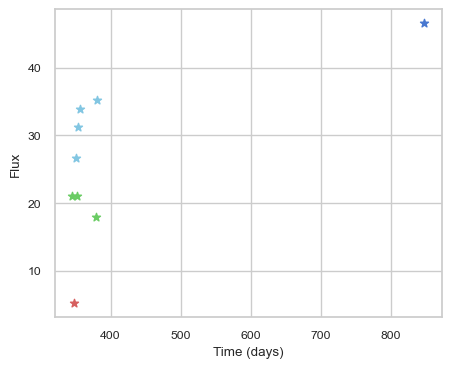

SNIax (4.44429, False)
SNIax (4.052757, False)
SNIax (3.6453433, False)
SNIax (3.4886868, False)
SNIax (3.684482, False)
SNIax (4.2433963, False)
SNIax (4.324254, False)
SNIax (4.4906, False)
SNIax (3.9743028, False)
SNIax (4.7919154, False)
SNIax (4.7182317, False)
SNIax (4.9712906, False)
SNIax (4.7531986, False)
SNIax (4.714945, False)
SNIax (4.2166624, False)
SNIax (4.553402, False)
SNIax (5.486812, False)
SNIax (5.6766014, False)


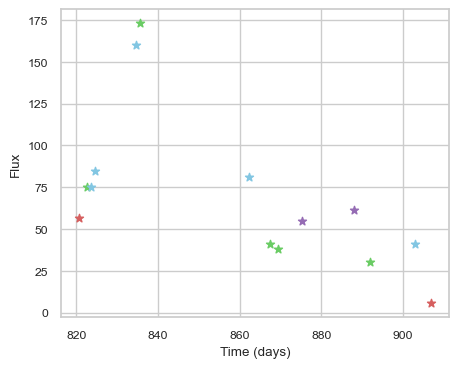

SNIax (3.7893858, False)
SNIax (4.4434295, False)
SNIax (4.383906, False)
SNIax (3.7022169, False)
SNIax (3.5727549, False)
SNIax (3.5705054, False)
SNIax (3.6212108, False)
SNIax (3.5796432, False)
SNIax (3.3715448, False)
SNIax (3.4583392, False)
SNIax (3.5114617, False)
SNIax (2.7255096, False)
SNIax (3.3845177, False)
SNIax (2.829843, False)
SNIax (3.9497359, False)
SNIax (3.0098996, False)
SNIax (3.7084432, False)
SNIax (2.9850087, False)
SNIax (3.9407616, False)
SNIax (3.10929, False)
SNIax (3.274835, False)
SNIax (2.7441382, False)
SNIax (3.5647879, False)
SNIax (2.6116261, False)
SNIax (3.3175561, False)
SNIax (2.504651, False)
SNIax (3.4906278, False)
SNIax (3.1950977, False)


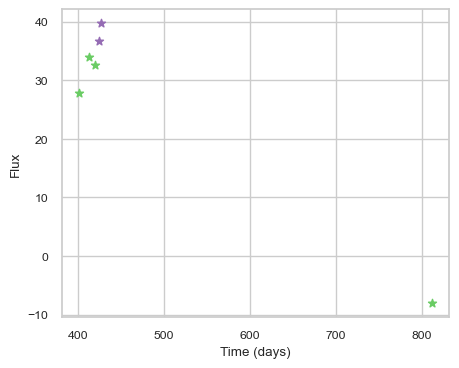

SNIax (4.0265164, False)
SNIax (3.4193976, False)
SNIax (3.5922647, False)
SNIax (3.3750336, False)
SNIax (4.264079, False)
SNIax (4.520979, False)
SNIax (4.761671, False)
SNIax (5.043234, False)
SNIax (5.1750174, False)
SNIax (5.3389277, False)
SNIax (4.9370127, False)
SNIax (4.962952, False)


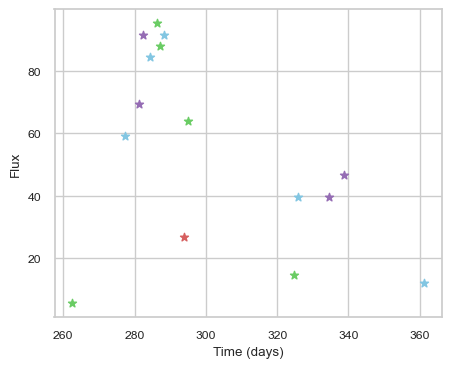

SNIax (3.8311994, False)
SNIax (3.9572358, False)
SNIax (3.2777348, False)
SNIax (4.0343165, False)
SNIax (3.2907295, False)
SNIax (3.05576, False)
SNIax (3.8165028, False)
SNIax (3.6656396, False)
SNIax (4.282945, False)
SNIax (4.2999597, False)
SNIax (3.962824, False)
SNIax (4.1376457, False)
SNIax (4.156464, False)
SNIax (4.474184, False)
SNIax (4.31495, False)
SNIax (4.838576, False)
SNIax (5.1865396, False)
SNIax (4.737543, False)
SNIax (4.960206, False)
SNIax (5.0162864, False)
SNIax (4.621872, False)
SNIax (4.927254, False)
SNIax (4.4021225, False)
SNIax (5.4278917, False)
SNIax (5.05279, False)
SNIax (5.1016097, False)
SNIax (5.398322, False)
SNIax (4.90138, False)
SNIax (5.423626, False)
SNIax (4.9315667, False)


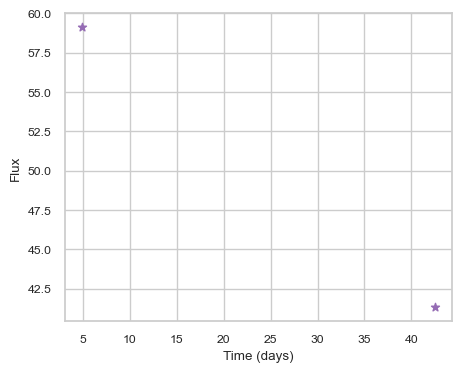

SNIax (4.031441, False)
SNIax (4.810459, False)
SNIax (4.0255437, False)
SNIax (3.3635788, False)


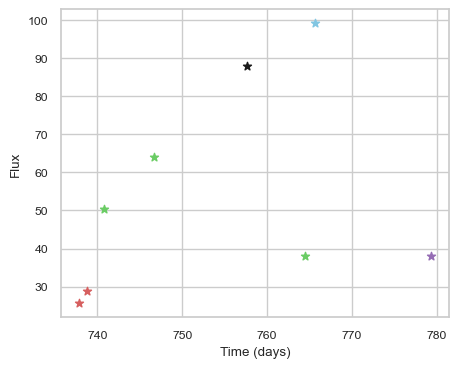

SNIax (3.8483553, False)
SNIax (3.976185, False)
SNIax (4.4360113, False)
SNIax (4.1061544, False)
SNIax (3.7885985, False)
SNIax (2.599026, False)
SNIax (3.1911185, False)
SNIax (2.9905405, False)
SNIax (3.2216675, False)
SNIax (3.3763454, False)
SNIax (3.0997844, False)
SNIax (3.1186717, False)
SNIax (3.3122296, False)
SNIax (3.7186177, False)
SNIax (4.1328335, False)
SNIax (3.8633287, False)


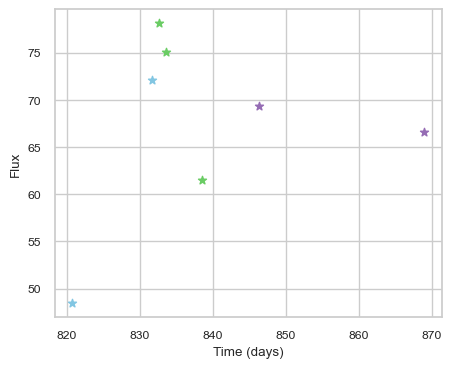

SNIax (3.8482988, False)
SNIax (3.520148, False)
SNIax (3.7303598, False)
SNIax (4.466378, False)
SNIax (4.1513214, False)
SNIax (4.387594, False)
SNIax (4.290628, False)
SNIax (4.5411997, False)
SNIax (4.404966, False)
SNIax (4.3193846, False)
SNIax (3.871746, False)
SNIax (3.9721515, False)
SNIax (4.027835, False)
SNIax (4.0202603, False)


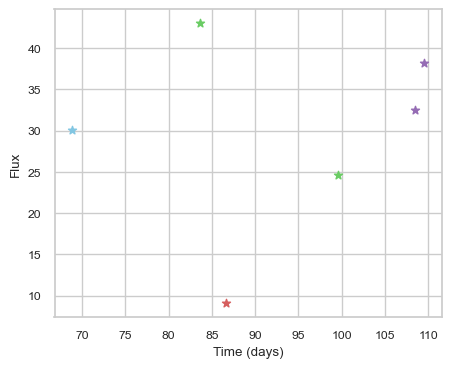

SNIax (3.9071364, False)
SNIax (4.1028376, False)
SNIax (3.2973375, False)
SNIax (2.9715755, False)
SNIax (3.6569304, False)
SNIax (2.881778, False)
SNIax (2.87126, False)
SNIax (2.19982, False)
SNIax (2.4323359, False)
SNIax (2.3836737, False)
SNIax (2.4290724, False)
SNIax (2.321644, False)


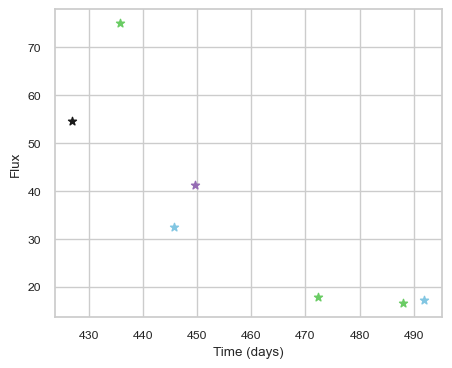

SNIax (3.84279, False)
SNIax (3.5850484, False)
SNIax (3.3737614, False)
SNIax (3.3682811, False)
SNIax (3.2168822, False)
SNIax (2.7826574, False)
SNIax (2.7894058, False)
SNIax (3.4263756, False)
SNIax (2.7215252, False)
SNIax (2.9237077, False)
SNIax (2.7965481, False)
SNIax (2.3946037, False)
SNIax (2.7095797, False)
SNIax (2.0792053, False)


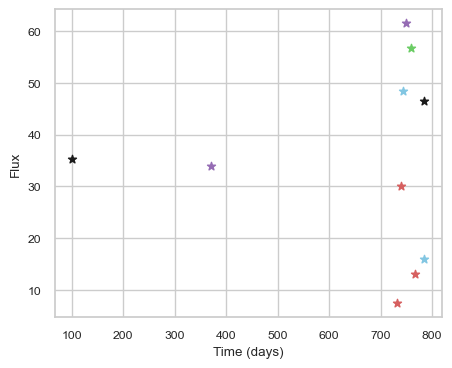

SNIax (4.6327333, False)
SNIax (4.7375054, False)
SNIax (4.085103, False)
SNIax (3.572268, False)
SNIax (3.72662, False)
SNIax (3.3733196, False)
SNIax (3.370012, False)
SNIax (3.2312453, False)
SNIax (3.4450643, False)
SNIax (3.1791856, False)
SNIax (3.3172767, False)
SNIax (2.9046333, False)
SNIax (3.4006102, False)
SNIax (3.5589025, False)
SNIax (4.1818085, False)
SNIax (3.7006464, False)
SNIax (4.10292, False)
SNIax (3.7932057, False)
SNIax (4.136637, False)
SNIax (3.24988, False)


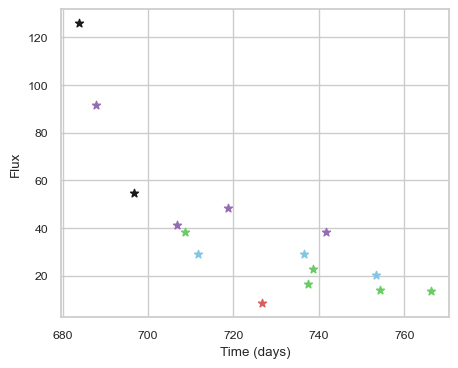

SNIax (3.6035132, False)
SNIax (3.9650817, False)
SNIax (3.699301, False)
SNIax (4.135807, False)
SNIax (3.8233576, False)
SNIax (4.787716, False)
SNIax (4.1285057, False)
SNIax (4.749723, False)
SNIax (3.2726934, False)
SNIax (3.8197942, False)
SNIax (4.128858, False)
SNIax (3.5422764, False)
SNIax (3.2355127, False)
SNIax (4.2226434, False)
SNIax (3.6028428, False)
SNIax (3.775251, False)
SNIax (3.8829656, False)
SNIax (3.44755, False)
SNIax (3.136392, False)
SNIax (3.3694806, False)
SNIax (2.851898, False)
SNIax (3.5498447, False)
SNIax (3.7043076, False)
SNIax (3.8079555, False)
SNIax (3.7135725, False)
SNIax (3.32684, False)
SNIax (2.8768375, False)
SNIax (3.4736402, False)
SNIax (3.282875, False)
SNIax (3.346722, False)


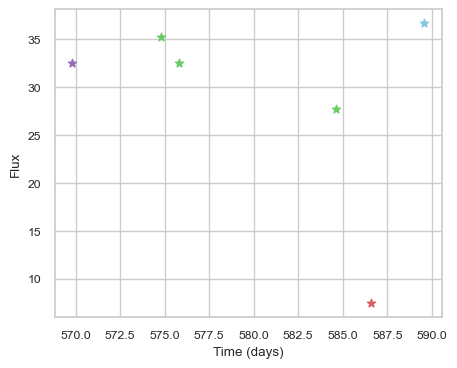

SNIax (4.093496, False)
SNIax (2.9881985, False)
SNIax (3.1830907, False)
SNIax (2.7029424, False)
SNIax (3.1011121, False)
SNIax (2.6712327, False)
SNIax (2.6653864, False)
SNIax (2.9281564, False)
SNIax (3.6641028, False)
SNIax (3.6193519, False)
SNIax (3.2648022, False)
SNIax (2.4600983, False)


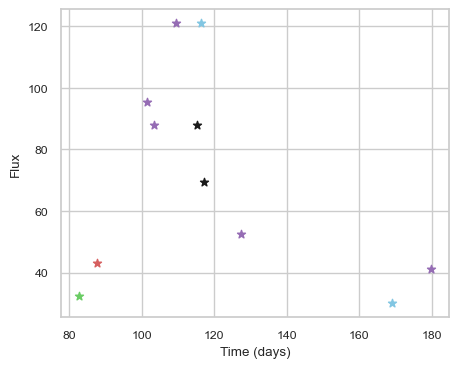

SNIax (4.1643567, False)
SNIax (3.8211727, False)
SNIax (3.7571166, False)
SNIax (4.5274396, False)
SNIax (3.7104921, False)
SNIax (4.2386656, False)
SNIax (5.15974, False)
SNIax (4.702979, False)
SNIax (5.233007, False)
SNIax (4.9075937, False)
SNIax (6.0468287, False)
SNIax (5.5107064, False)
SNIax (6.4330983, False)
SNIax (6.006143, False)
SNIax (5.833194, False)
SNIax (6.0652165, False)
SNIax (6.3451457, False)
SNIax (6.2008696, False)
SNIax (6.482395, False)
SNIax (5.977725, False)
SNIax (5.955792, False)
SNIax (5.949306, False)


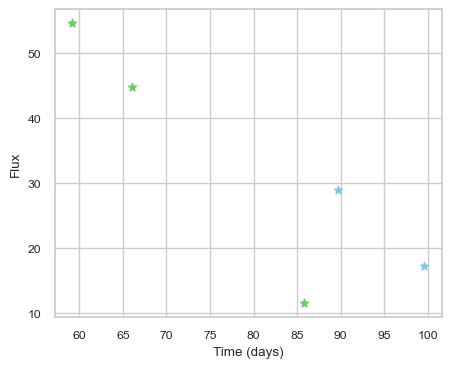

SNIax (4.0168457, False)
SNIax (4.0461683, False)
SNIax (4.46907, False)
SNIax (3.1417272, False)
SNIax (3.7771564, False)
SNIax (2.9618208, False)
SNIax (3.5881462, False)
SNIax (2.962399, False)
SNIax (3.9531531, False)
SNIax (3.2341723, False)


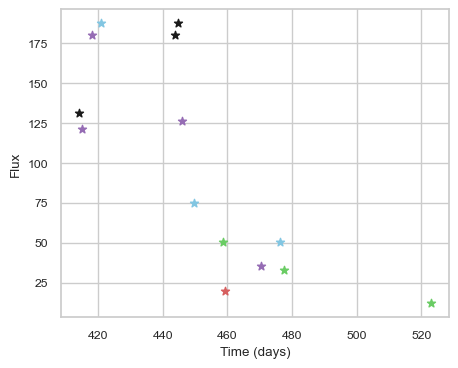

SNIax (3.7709587, False)
SNIax (3.7929344, False)
SNIax (3.6910655, False)
SNIax (3.4370198, False)
SNIax (3.9562871, False)
SNIax (3.3946304, False)
SNIax (3.5501218, False)
SNIax (3.83369, False)
SNIax (4.433762, False)
SNIax (4.385439, False)
SNIax (4.9702826, False)
SNIax (4.3820696, False)
SNIax (5.408728, False)
SNIax (4.064013, False)
SNIax (4.020382, False)
SNIax (3.6621652, False)
SNIax (3.1639173, False)
SNIax (3.5527854, False)
SNIax (3.8138494, False)
SNIax (3.8084877, False)
SNIax (3.7834244, False)
SNIax (3.7919104, False)
SNIax (3.1994147, False)
SNIax (3.628112, False)
SNIax (3.3878891, False)
SNIax (3.6830063, False)
SNIax (4.371504, False)
SNIax (3.998618, False)


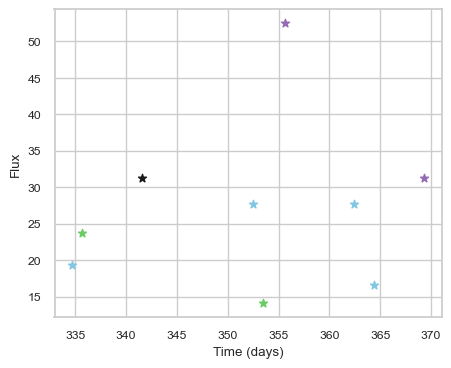

SNIax (4.939709, False)
SNIax (4.4650407, False)
SNIax (3.7999866, False)
SNIax (3.889418, False)
SNIax (3.9627852, False)
SNIax (4.329573, False)
SNIax (3.4676464, False)
SNIax (3.9329612, False)
SNIax (3.3818283, False)
SNIax (3.49212, False)
SNIax (3.2316976, False)
SNIax (3.0085096, False)
SNIax (2.8625402, False)
SNIax (2.9048722, False)
SNIax (2.6343591, False)
SNIax (2.7778194, False)
SNIax (2.9919968, False)
SNIax (2.8988113, False)


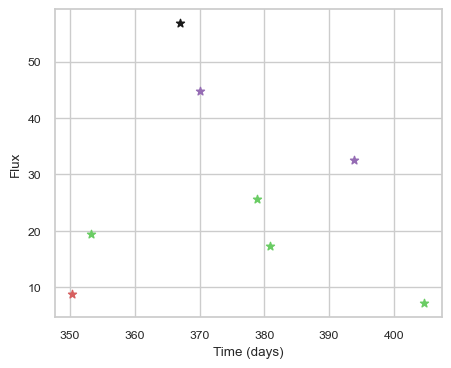

SNIax (4.117612, False)
SNIax (3.8352852, False)
SNIax (3.292742, False)
SNIax (2.6938994, False)
SNIax (3.2445302, False)
SNIax (2.9041512, False)
SNIax (3.1828017, False)
SNIax (2.6115897, False)
SNIax (2.5060391, False)
SNIax (2.3361015, False)
SNIax (3.0666137, False)
SNIax (2.4299502, False)
SNIax (2.9189353, False)
SNIax (2.6500475, False)
SNIax (2.8184104, False)
SNIax (2.8296716, False)


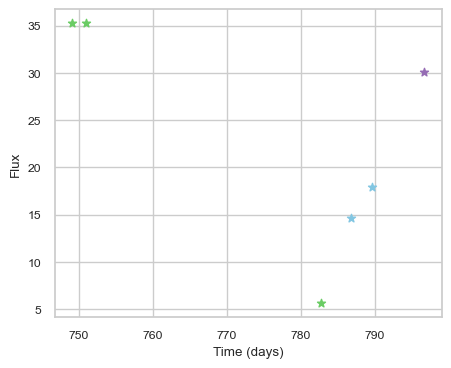

SNIax (4.084015, False)
SNIax (3.215993, False)
SNIax (3.40665, False)
SNIax (2.80469, False)
SNIax (3.5809984, False)
SNIax (3.115843, False)
SNIax (3.295021, False)
SNIax (3.1906586, False)
SNIax (3.740253, False)
SNIax (3.6748207, False)
SNIax (3.9928784, False)
SNIax (3.7941046, False)


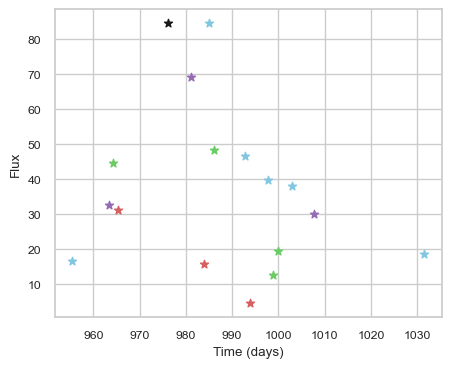

SNIax (3.8599732, False)
SNIax (3.7358093, False)
SNIax (3.091371, False)
SNIax (3.499189, False)
SNIax (3.2535114, False)
SNIax (2.668166, False)
SNIax (2.8154473, False)
SNIax (2.7988281, False)
SNIax (3.1662107, False)
SNIax (3.146101, False)
SNIax (3.105357, False)
SNIax (2.4049208, False)
SNIax (3.3558018, False)
SNIax (2.7170718, False)
SNIax (3.0766003, False)
SNIax (3.2840497, False)
SNIax (3.1477857, False)
SNIax (3.2685347, False)
SNIax (3.524949, False)
SNIax (3.15557, False)
SNIax (2.996315, False)
SNIax (3.0645776, False)
SNIax (3.3118153, False)
SNIax (2.9861574, False)
SNIax (2.946503, False)
SNIax (2.869459, False)
SNIax (3.0243952, False)
SNIax (2.8995457, False)
SNIax (3.2268603, False)
SNIax (2.896234, False)
SNIax (2.938357, False)
SNIax (2.9464076, False)
SNIax (3.2111938, False)
SNIax (2.997862, False)


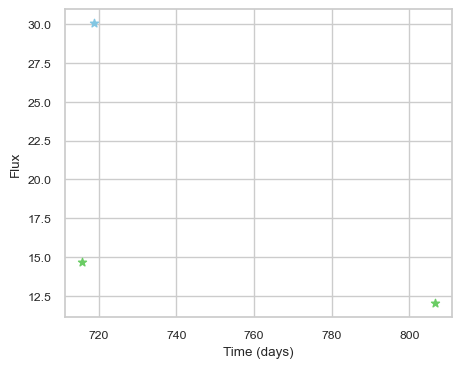

SNIax (3.9982722, False)
SNIax (3.4301105, False)
SNIax (3.3331556, False)
SNIax (3.0399742, False)
SNIax (3.345014, False)
SNIax (3.2873545, False)


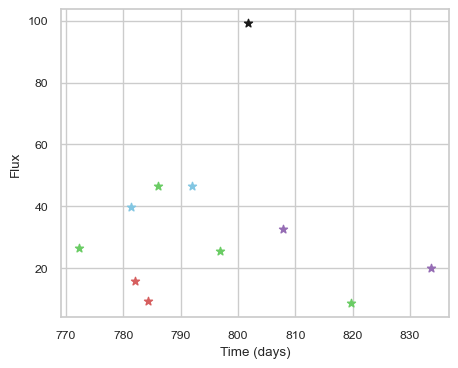

SNIax (4.039422, False)
SNIax (3.3239906, False)
SNIax (3.41364, False)
SNIax (3.0403028, False)
SNIax (2.8976731, False)
SNIax (3.0158398, False)
SNIax (2.7267, False)
SNIax (2.3696315, False)
SNIax (3.4192936, False)
SNIax (2.4176905, False)
SNIax (2.8874795, False)
SNIax (2.1247416, False)
SNIax (3.1630478, False)
SNIax (2.615615, False)
SNIax (3.0066211, False)
SNIax (3.1005678, False)
SNIax (2.6951058, False)
SNIax (2.6655338, False)
SNIax (2.3823185, False)
SNIax (2.3428473, False)
SNIax (2.425502, False)
SNIax (2.789234, False)


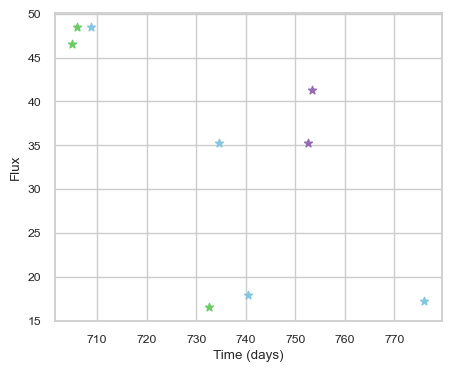

SNIax (3.9758248, False)
SNIax (4.0120583, False)
SNIax (4.330435, False)
SNIax (4.834781, False)
SNIax (5.1907587, False)
SNIax (5.289173, False)
SNIax (4.4061756, False)
SNIax (4.017286, False)
SNIax (3.470206, False)
SNIax (3.5911248, False)
SNIax (3.3799493, False)
SNIax (2.960839, False)
SNIax (3.5244312, False)
SNIax (3.3314426, False)
SNIax (4.155255, False)
SNIax (3.3418312, False)
SNIax (4.033059, False)
SNIax (3.8829377, False)


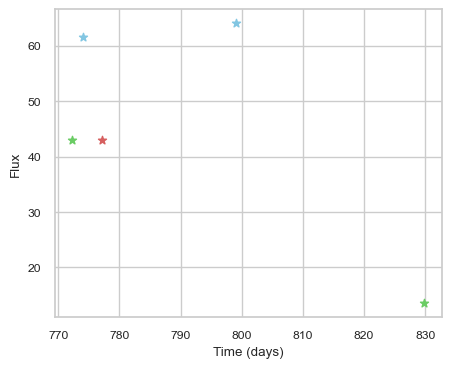

SNIax (3.8289154, False)
SNIax (3.0022848, False)
SNIax (3.1242592, False)
SNIax (3.2414937, False)
SNIax (3.727828, False)
SNIax (3.2567496, False)
SNIax (2.8587425, False)
SNIax (3.2299862, False)
SNIax (4.1450677, False)
SNIax (4.2223573, False)


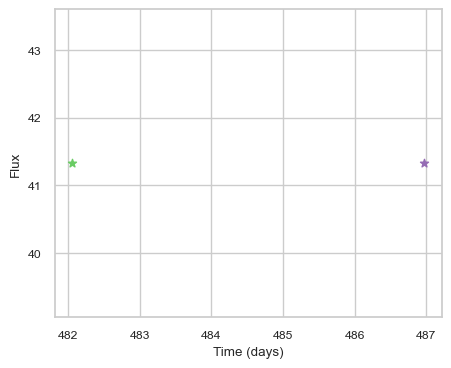

SNIax (3.8608546, False)
SNIax (3.952621, False)
SNIax (3.812958, False)
SNIax (4.3360815, False)


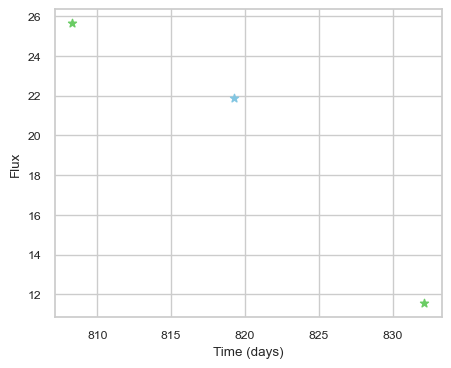

SNIax (4.0145693, False)
SNIax (3.4647293, False)
SNIax (3.2639875, False)
SNIax (3.8459196, False)
SNIax (4.385751, False)
SNIax (4.574645, False)


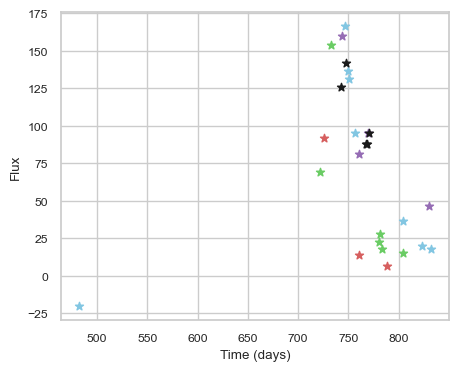

SNIax (3.9328232, False)
SNIax (3.8851888, False)
SNIax (3.822916, False)
SNIax (3.7721171, False)
SNIax (4.266127, False)
SNIax (4.4895167, False)
SNIax (4.6938553, False)
SNIax (3.8777697, False)
SNIax (5.4729757, False)
SNIax (4.508454, False)
SNIax (6.6072607, False)
SNIax (5.209943, False)
SNIax (5.047251, False)
SNIax (4.609454, False)
SNIax (5.212223, False)
SNIax (4.7786474, False)
SNIax (5.951241, False)
SNIax (4.652, False)
SNIax (4.7225614, False)
SNIax (4.124282, False)
SNIax (4.826858, False)
SNIax (4.471175, False)
SNIax (4.736359, False)
SNIax (4.3487916, False)
SNIax (5.287418, False)
SNIax (4.968559, False)
SNIax (5.9366436, False)
SNIax (5.426739, False)
SNIax (5.7434998, False)
SNIax (5.3513236, False)
SNIax (5.8035583, False)
SNIax (5.0905385, False)
SNIax (5.7429852, False)
SNIax (5.504718, False)
SNIax (4.9890056, False)
SNIax (4.5805197, False)
SNIax (5.073058, False)
SNIax (5.1203413, False)
SNIax (5.3730307, False)
SNIax (4.9339843, False)
SNIax (5.4085627, Fal

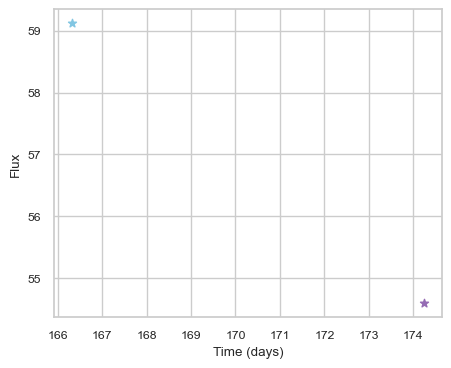

SNIax (4.031884, False)
SNIax (4.502194, False)
SNIax (4.264773, False)
SNIax (3.653782, False)


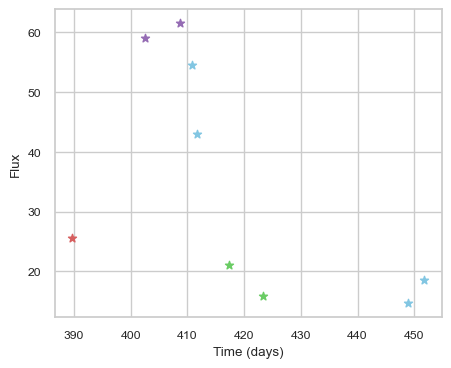

SNIax (3.9305322, False)
SNIax (4.6541877, False)
SNIax (4.7539697, False)
SNIax (2.6118784, False)
SNIax (3.0916727, False)
SNIax (2.9691796, False)
SNIax (3.2754815, False)
SNIax (3.4053197, False)
SNIax (3.109731, False)
SNIax (3.4612544, False)
SNIax (3.4141316, False)
SNIax (3.1238039, False)
SNIax (2.9250116, False)
SNIax (3.0973713, False)
SNIax (2.4202497, False)
SNIax (2.4268632, False)
SNIax (2.5675447, False)
SNIax (2.6454725, False)


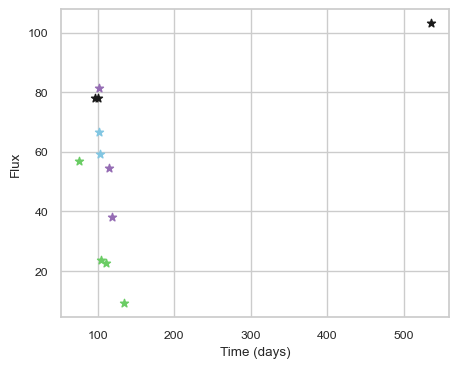

SNIax (3.8732588, False)
SNIax (4.49017, False)
SNIax (3.8576028, False)
SNIax (4.1330633, False)
SNIax (3.8148599, False)
SNIax (3.3214056, False)
SNIax (4.1266575, False)
SNIax (3.3467543, False)
SNIax (3.720621, False)
SNIax (3.4668765, False)
SNIax (3.6501331, False)
SNIax (3.2305822, False)
SNIax (3.6406617, False)
SNIax (3.1365986, False)
SNIax (3.4959192, False)
SNIax (3.2165663, False)
SNIax (3.574369, False)
SNIax (3.6665933, False)
SNIax (3.9098594, False)
SNIax (3.3605475, False)
SNIax (3.6353981, False)
SNIax (3.3821192, False)
SNIax (3.5319054, False)
SNIax (3.7841952, False)


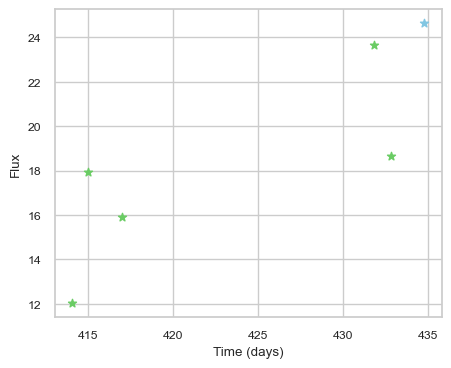

SNIax (4.0730586, False)
SNIax (3.512953, False)
SNIax (3.1196692, False)
SNIax (2.9651837, False)
SNIax (3.116925, False)
SNIax (2.6306214, False)
SNIax (2.6791415, False)
SNIax (2.1392589, False)
SNIax (2.4528322, False)
SNIax (2.2572749, False)
SNIax (2.6425757, False)
SNIax (2.3502514, False)


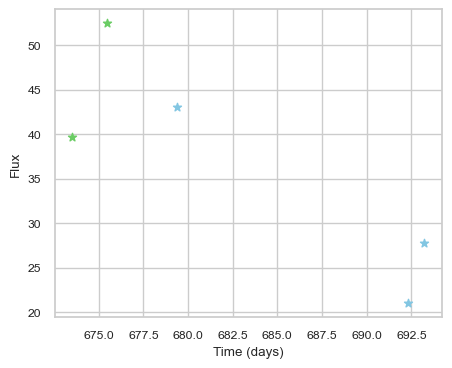

SNIax (3.9225714, False)
SNIax (4.0980296, False)
SNIax (3.4715648, False)
SNIax (3.9085543, False)
SNIax (4.3714623, False)
SNIax (2.8650215, False)
SNIax (2.6038992, False)
SNIax (2.6336665, False)
SNIax (2.7519128, False)
SNIax (2.560618, False)


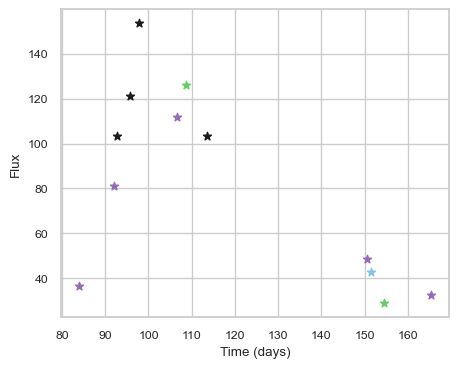

SNIax (3.9078107, False)
SNIax (3.7206326, False)
SNIax (3.384332, False)
SNIax (3.8041863, False)
SNIax (3.7244682, False)
SNIax (3.870369, False)
SNIax (3.5468538, False)
SNIax (3.6631434, False)
SNIax (3.6829715, False)
SNIax (3.570108, False)
SNIax (3.4534814, False)
SNIax (3.7078102, False)
SNIax (3.8575456, False)
SNIax (3.4287808, False)
SNIax (3.3798077, False)
SNIax (3.7538443, False)
SNIax (3.4552276, False)
SNIax (3.3517468, False)
SNIax (3.3635726, False)
SNIax (2.5780227, False)
SNIax (2.6970153, False)
SNIax (2.4667404, False)
SNIax (2.693437, False)
SNIax (2.565043, False)


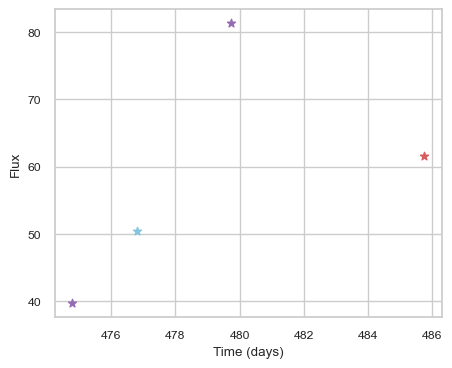

SNIax (3.7674253, False)
SNIax (3.7736924, False)
SNIax (3.4872305, False)
SNIax (3.8862693, False)
SNIax (3.485476, False)
SNIax (3.5913801, False)
SNIax (3.5676217, False)
SNIax (3.4692795, False)


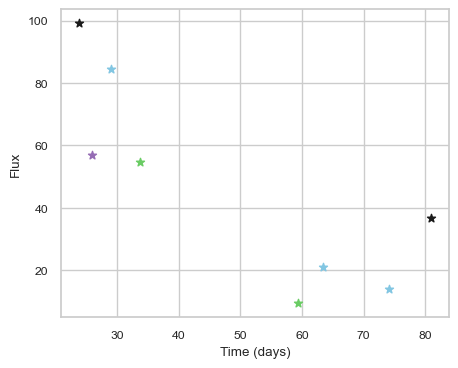

SNIax (3.7984624, False)
SNIax (4.092713, False)
SNIax (4.743524, False)
SNIax (3.4831078, False)
SNIax (3.5738034, False)
SNIax (3.7500243, False)
SNIax (3.9006443, False)
SNIax (2.6509144, False)
SNIax (3.1475332, False)
SNIax (3.0753887, False)
SNIax (3.2237134, False)
SNIax (2.9160817, False)
SNIax (2.9056902, False)
SNIax (2.968193, False)
SNIax (2.8281999, False)
SNIax (2.9806051, False)


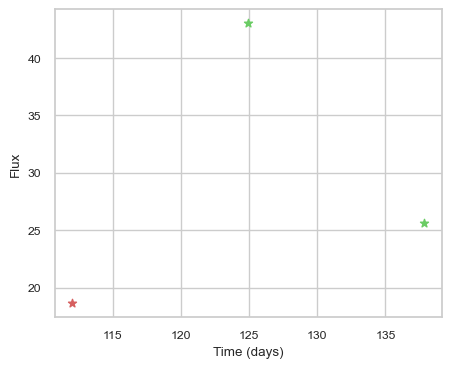

SNIax (3.8344042, False)
SNIax (4.0904937, False)
SNIax (3.5728488, False)
SNIax (3.0330749, False)
SNIax (3.2847114, False)
SNIax (3.1900928, False)


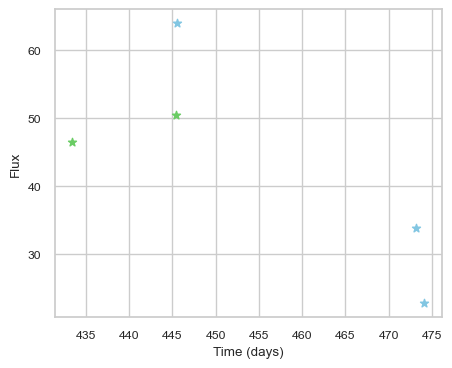

SNIax (4.088778, False)
SNIax (4.295216, False)
SNIax (4.2911305, False)
SNIax (3.552981, False)
SNIax (3.5621753, False)
SNIax (3.2998617, False)
SNIax (3.7727535, False)
SNIax (2.8353865, False)
SNIax (3.2766094, False)
SNIax (2.7848232, False)


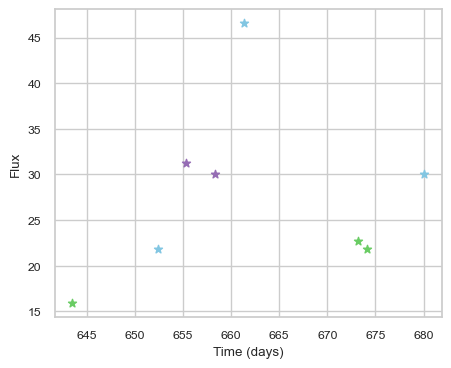

SNIax (4.0462046, False)
SNIax (3.828093, False)
SNIax (3.2683141, False)
SNIax (3.7106216, False)
SNIax (3.8656464, False)
SNIax (4.5610123, False)
SNIax (4.136205, False)
SNIax (4.918412, False)
SNIax (4.1871967, False)
SNIax (3.4102495, False)
SNIax (3.411955, False)
SNIax (3.2338254, False)
SNIax (3.3804388, False)
SNIax (3.1281247, False)
SNIax (3.9504251, False)
SNIax (3.263154, False)


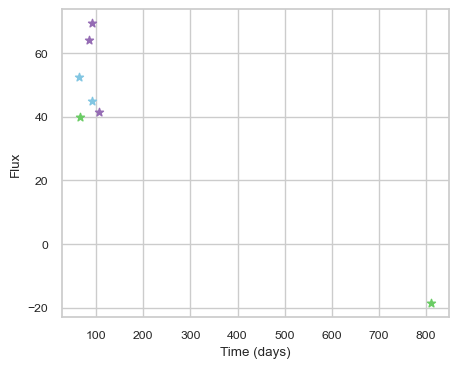

SNIax (4.626806, False)
SNIax (5.567551, False)
SNIax (5.6990004, False)
SNIax (6.1942577, False)
SNIax (5.9267945, False)
SNIax (6.300534, False)
SNIax (6.245809, False)
SNIax (5.907471, False)
SNIax (5.968102, False)
SNIax (5.6080303, False)
SNIax (5.1686115, False)
SNIax (5.0774136, False)
SNIax (5.4625406, False)
SNIax (5.705851, False)


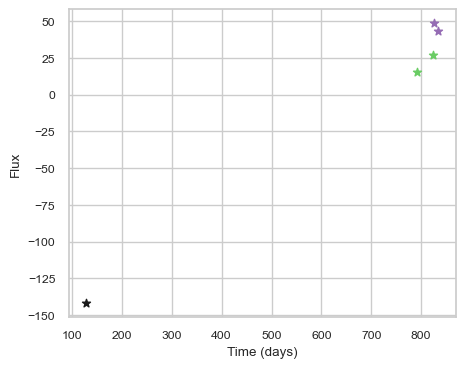

SNIax (4.478484, False)
SNIax (4.489189, False)
SNIax (4.540997, False)
SNIax (3.9175975, False)
SNIax (4.0644255, False)
SNIax (3.6687374, False)
SNIax (3.5176075, False)
SNIax (4.164395, False)
SNIax (4.3737445, False)
SNIax (4.8402047, False)


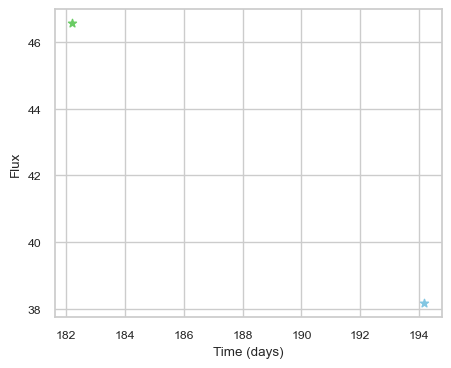

SNIax (4.009714, False)
SNIax (4.2232914, False)
SNIax (3.956977, False)
SNIax (2.7822323, False)


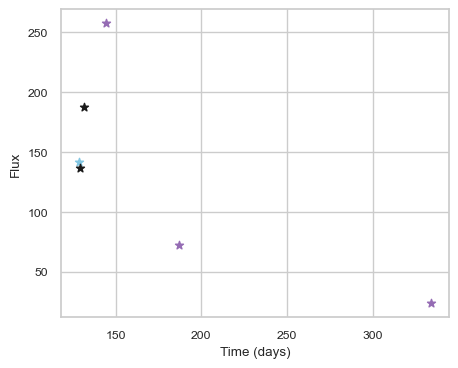

SNIax (3.6405122, False)
SNIax (4.369803, False)
SNIax (3.637092, False)
SNIax (4.3118663, False)
SNIax (3.6266994, False)
SNIax (4.0418844, False)
SNIax (3.5104358, False)
SNIax (4.3012753, False)
SNIax (3.7228217, False)
SNIax (4.1842856, False)
SNIax (3.5358315, False)
SNIax (3.9624066, False)


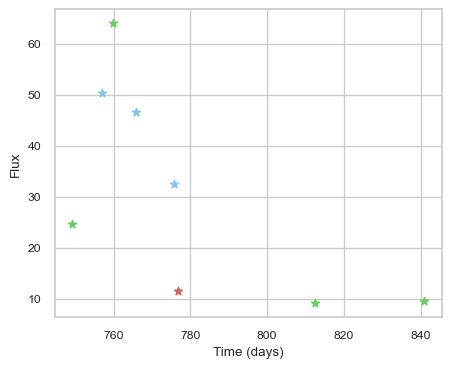

SNIax (3.593449, False)
SNIax (3.4514184, False)
SNIax (3.1744385, False)
SNIax (3.2937722, False)
SNIax (3.3441968, False)
SNIax (3.0787694, False)
SNIax (3.19212, False)
SNIax (2.1344495, False)
SNIax (1.9810036, False)
SNIax (1.9775147, False)
SNIax (2.229475, False)
SNIax (1.8249375, False)
SNIax (2.391756, False)
SNIax (2.0182679, False)
SNIax (2.3332324, False)
SNIax (2.2091484, False)


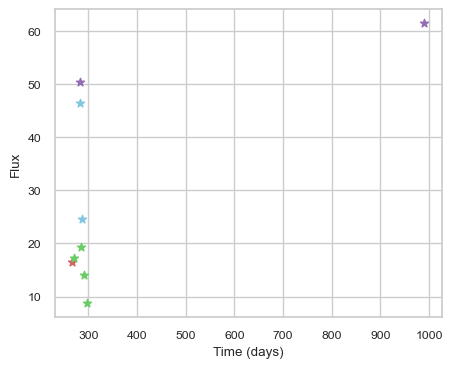

SNIax (3.7734904, False)
SNIax (4.471113, False)
SNIax (3.5174704, False)
SNIax (4.379881, False)
SNIax (4.557035, False)
SNIax (3.381663, False)
SNIax (3.5671878, False)
SNIax (3.1365817, False)
SNIax (3.5566764, False)
SNIax (3.1261787, False)
SNIax (3.5571237, False)
SNIax (2.813912, False)
SNIax (2.7356372, False)
SNIax (2.7413485, False)
SNIax (3.112396, False)
SNIax (2.8326256, False)
SNIax (2.6729531, False)
SNIax (2.9337966, False)


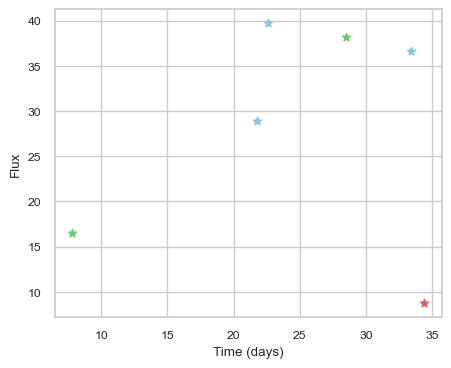

SNIax (4.6265397, False)
SNIax (4.0536056, False)
SNIax (3.5266848, False)
SNIax (3.2140343, False)
SNIax (3.4341846, False)
SNIax (3.7350469, False)
SNIax (3.0502443, False)
SNIax (3.0169284, False)
SNIax (3.262831, False)
SNIax (2.9587567, False)
SNIax (3.0579598, False)
SNIax (3.2782264, False)


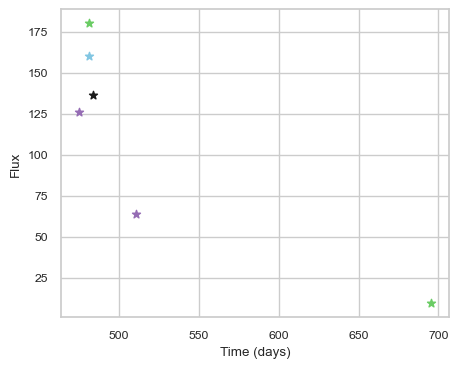

SNIax (3.7231803, False)
SNIax (4.0887456, False)
SNIax (3.593318, False)
SNIax (3.6722314, False)
SNIax (4.270362, False)
SNIax (3.3683958, False)
SNIax (3.8381996, False)
SNIax (3.8985116, False)
SNIax (3.6868722, False)
SNIax (3.165262, False)
SNIax (3.6785243, False)
SNIax (3.2985728, False)


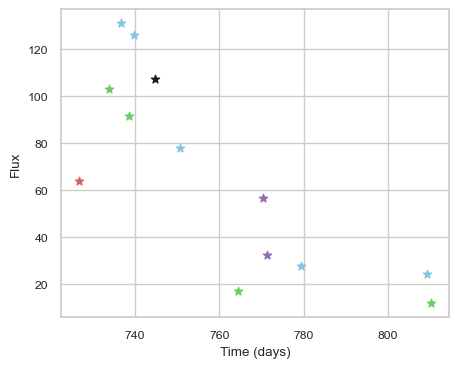

SNIax (3.8737762, False)
SNIax (4.0903425, False)
SNIax (4.532307, False)
SNIax (3.9473815, False)
SNIax (3.7110767, False)
SNIax (3.0642374, False)
SNIax (3.6904316, False)
SNIax (3.4005778, False)
SNIax (2.9850533, False)
SNIax (4.027807, False)
SNIax (4.2062716, False)
SNIax (4.6843977, False)
SNIax (4.228107, False)
SNIax (4.1503963, False)
SNIax (4.5608664, False)
SNIax (4.2006226, False)
SNIax (4.425486, False)
SNIax (4.161229, False)
SNIax (4.972199, False)
SNIax (4.114073, False)
SNIax (3.9718504, False)
SNIax (3.926429, False)
SNIax (3.860747, False)
SNIax (3.8227818, False)
SNIax (3.6206095, False)
SNIax (3.569076, False)


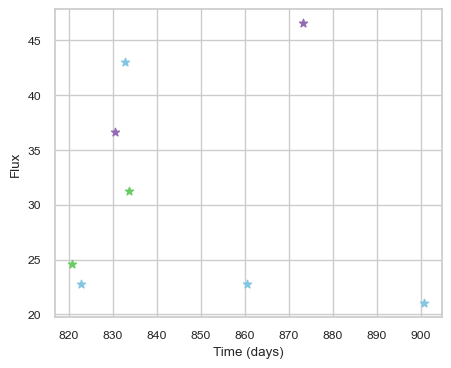

SNIax (3.7676072, False)
SNIax (3.3287895, False)
SNIax (3.5822442, False)
SNIax (4.069473, False)
SNIax (3.586241, False)
SNIax (4.6487255, False)
SNIax (4.4175673, False)
SNIax (3.5956156, False)
SNIax (3.8533113, False)
SNIax (3.5417016, False)
SNIax (3.7628531, False)
SNIax (3.9791448, False)
SNIax (3.872896, False)
SNIax (5.2674403, False)
SNIax (5.2336874, False)
SNIax (5.0589337, False)


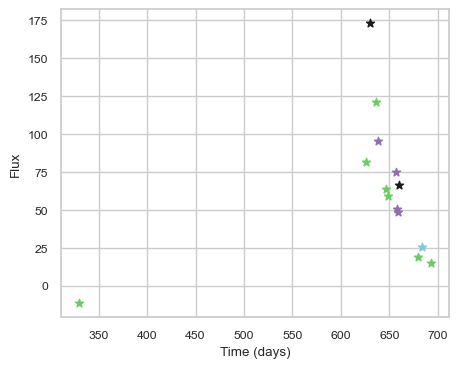

SNIax (3.7730308, False)
SNIax (4.0656066, False)
SNIax (3.5834427, False)
SNIax (3.652386, False)
SNIax (3.8677301, False)
SNIax (3.3658793, False)
SNIax (3.2477324, False)
SNIax (3.6446404, False)
SNIax (3.9395175, False)
SNIax (3.8645263, False)
SNIax (3.121049, False)
SNIax (2.9314814, False)
SNIax (2.895508, False)
SNIax (2.6985424, False)
SNIax (2.824692, False)
SNIax (2.7940476, False)
SNIax (2.616671, False)
SNIax (2.4948022, False)
SNIax (2.4902775, False)
SNIax (2.1881325, False)
SNIax (2.459087, False)
SNIax (2.1364722, False)
SNIax (2.09366, False)
SNIax (1.8472756, False)
SNIax (2.2391589, False)
SNIax (1.6427774, False)
SNIax (1.9242607, False)
SNIax (1.5445014, False)


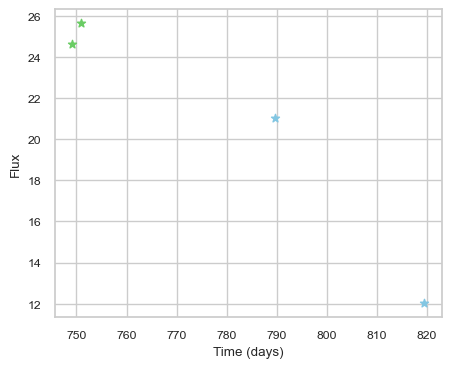

SNIax (3.9835787, False)
SNIax (3.1519556, False)
SNIax (3.4110413, False)
SNIax (2.6739838, False)
SNIax (3.3631356, False)
SNIax (3.656561, False)
SNIax (4.3084745, False)
SNIax (4.3314147, False)


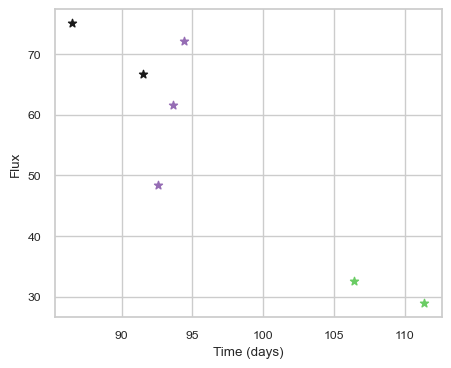

SNIax (3.9096768, False)
SNIax (4.0274267, False)
SNIax (3.9511821, False)
SNIax (3.8971214, False)
SNIax (3.8409796, False)
SNIax (4.597421, False)
SNIax (4.7463126, False)
SNIax (4.8982716, False)
SNIax (5.161165, False)
SNIax (5.4201407, False)
SNIax (5.09355, False)
SNIax (5.292682, False)
SNIax (5.7687054, False)
SNIax (5.5957823, False)


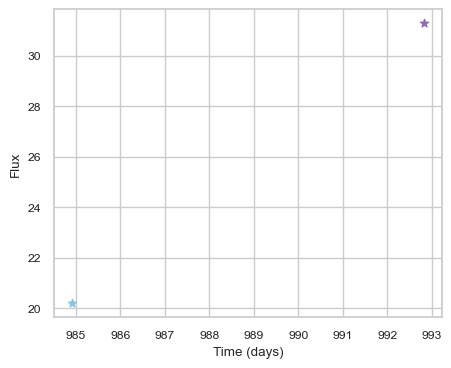

SNIax (4.2179203, False)
SNIax (3.9377482, False)
SNIax (3.5024233, False)
SNIax (3.4633677, False)


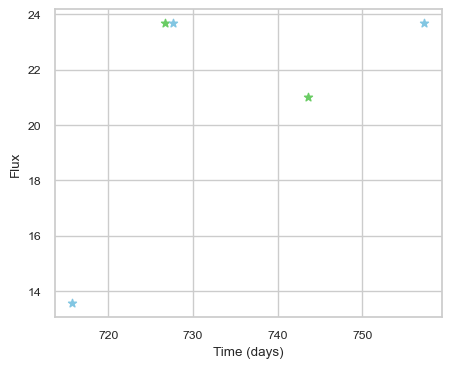

SNIax (4.177672, False)
SNIax (3.808188, False)
SNIax (3.1563993, False)
SNIax (2.9849448, False)
SNIax (3.5174947, False)
SNIax (2.4823625, False)
SNIax (2.920218, False)
SNIax (2.9042401, False)
SNIax (3.446274, False)
SNIax (3.0767648, False)


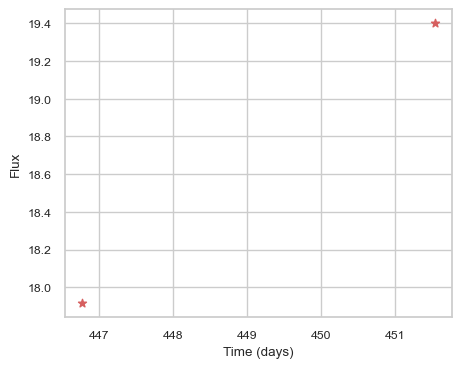

SNIax (4.099678, False)
SNIax (4.381838, False)
SNIax (4.016575, False)
SNIax (3.59321, False)


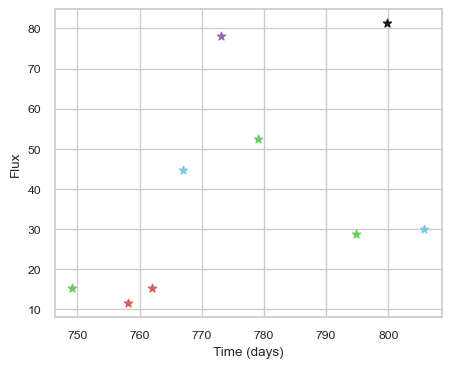

SNIax (4.107201, False)
SNIax (3.266619, False)
SNIax (3.244015, False)
SNIax (3.4885967, False)
SNIax (2.6091826, False)
SNIax (2.7697468, False)
SNIax (2.4327052, False)
SNIax (1.8384124, False)
SNIax (3.0539885, False)
SNIax (3.1056707, False)
SNIax (3.3616097, False)
SNIax (3.0979655, False)
SNIax (3.459797, False)
SNIax (3.4830523, False)
SNIax (3.5272655, False)
SNIax (3.256958, False)
SNIax (3.1322782, False)
SNIax (2.9736764, False)


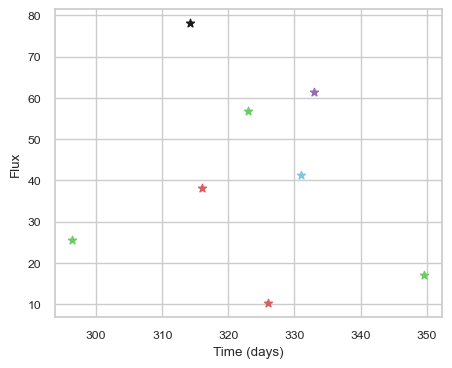

SNIax (3.863212, False)
SNIax (4.091138, False)
SNIax (3.5548804, False)
SNIax (4.608129, False)
SNIax (3.9497342, False)
SNIax (4.989313, False)
SNIax (4.550744, False)
SNIax (3.881284, False)
SNIax (4.5375476, False)
SNIax (3.9446099, False)
SNIax (3.8134785, False)
SNIax (2.3367403, False)
SNIax (3.4167693, False)
SNIax (3.737666, False)
SNIax (4.361631, False)
SNIax (3.5134387, False)


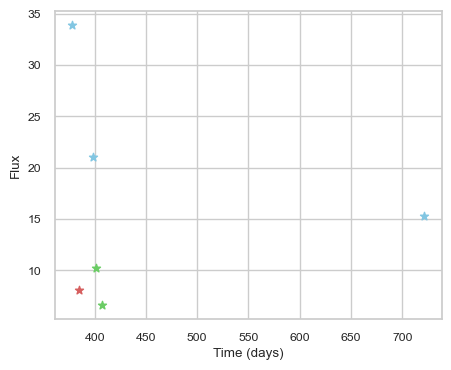

SNIax (3.9963071, False)
SNIax (3.4129179, False)
SNIax (3.641341, False)
SNIax (2.762583, False)
SNIax (3.068282, False)
SNIax (3.005472, False)
SNIax (3.2556207, False)
SNIax (3.023453, False)
SNIax (3.1647387, False)
SNIax (3.0754886, False)
SNIax (3.8531845, False)
SNIax (3.3835645, False)


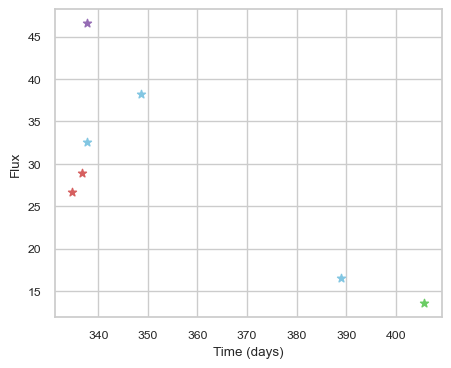

SNIax (3.9005759, False)
SNIax (4.568322, False)
SNIax (4.0836177, False)
SNIax (4.7830973, False)
SNIax (3.9989243, False)
SNIax (4.5720387, False)
SNIax (5.237309, False)
SNIax (4.649135, False)
SNIax (4.266396, False)
SNIax (4.8959365, False)
SNIax (6.072469, False)
SNIax (5.8786182, False)
SNIax (5.2078853, False)
SNIax (5.0933757, False)


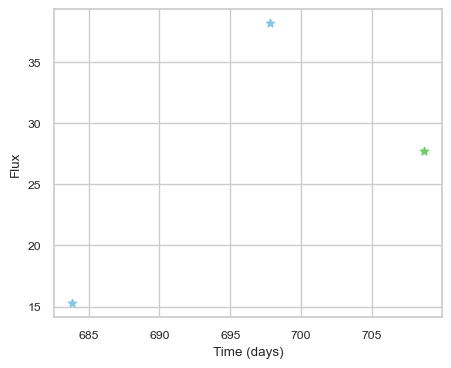

SNIax (4.054602, False)
SNIax (3.7017841, False)
SNIax (2.9382973, False)
SNIax (3.0779104, False)
SNIax (2.6741211, False)
SNIax (2.6839721, False)


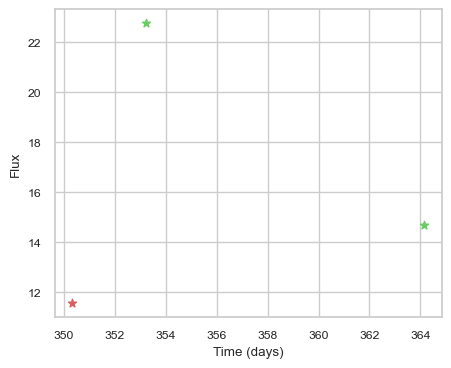

SNIax (3.8807082, False)
SNIax (3.754234, False)
SNIax (3.392475, False)
SNIax (2.7481196, False)
SNIax (2.9223337, False)
SNIax (3.0334237, False)


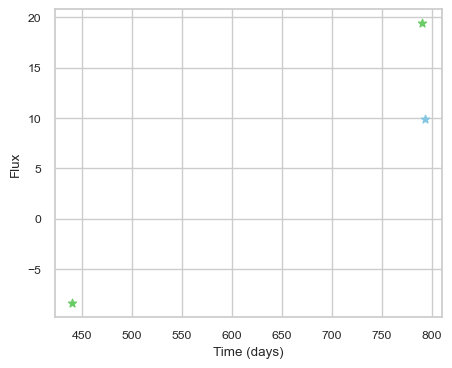

SNIax (3.8900054, False)
SNIax (4.1937337, False)
SNIax (3.5711417, False)
SNIax (3.3002536, False)
SNIax (3.2224953, False)
SNIax (3.6043568, False)


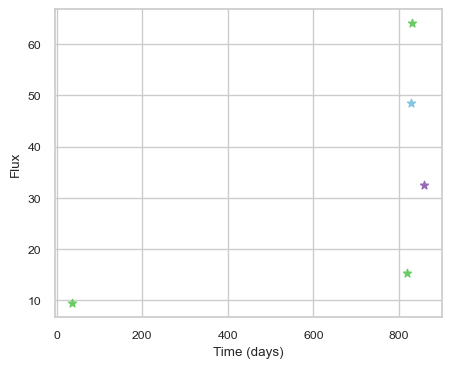

SNIax (3.922324, False)
SNIax (3.733925, False)
SNIax (3.5634987, False)
SNIax (3.1982317, False)
SNIax (3.0569594, False)
SNIax (3.2547264, False)
SNIax (3.4673564, False)
SNIax (3.042647, False)
SNIax (2.8884706, False)
SNIax (2.0426254, False)


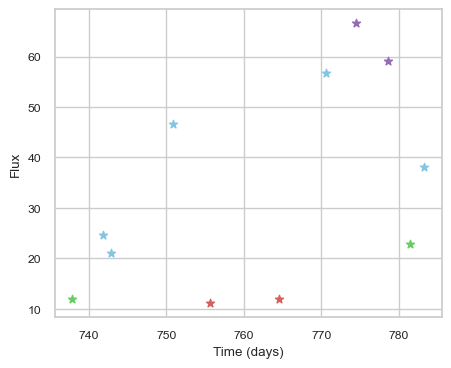

SNIax (4.276857, False)
SNIax (3.2167544, False)
SNIax (3.3963456, False)
SNIax (2.8697667, False)
SNIax (2.63259, False)
SNIax (2.345872, False)
SNIax (2.5112824, False)
SNIax (3.264657, False)
SNIax (3.992649, False)
SNIax (3.1669936, False)
SNIax (3.63936, False)
SNIax (3.5703397, False)
SNIax (3.4962597, False)
SNIax (3.7578273, False)
SNIax (4.5761027, False)
SNIax (4.2219377, False)
SNIax (4.669681, False)
SNIax (4.099327, False)
SNIax (4.4329066, False)
SNIax (4.175849, False)
SNIax (4.1168566, False)
SNIax (3.900995, False)


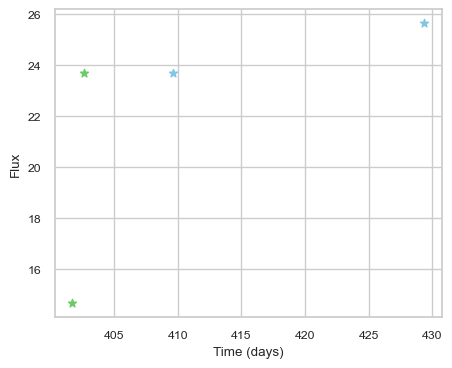

SNIax (4.3625684, False)
SNIax (3.586168, False)
SNIax (3.3753006, False)
SNIax (3.08858, False)
SNIax (3.221069, False)
SNIax (2.6105695, False)
SNIax (2.7679715, False)
SNIax (2.7974055, False)


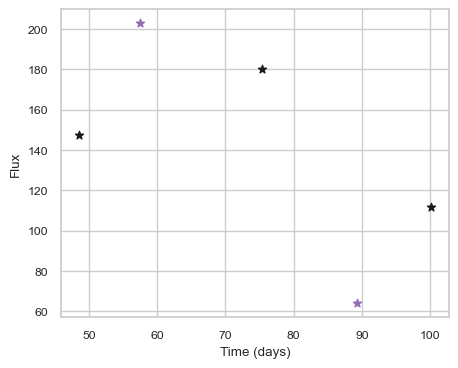

SNIax (3.7440784, False)
SNIax (3.2714982, False)
SNIax (3.3925056, False)
SNIax (3.8441627, False)
SNIax (3.7765124, False)
SNIax (4.123904, False)
SNIax (4.4350276, False)
SNIax (4.942677, False)
SNIax (3.2654684, False)
SNIax (4.4340873, False)


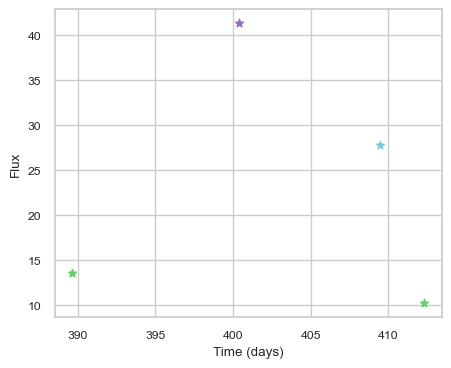

SNIax (5.3382497, False)
SNIax (4.4649825, False)
SNIax (4.886128, False)
SNIax (5.2593513, False)
SNIax (5.5118012, False)
SNIax (5.4546223, False)
SNIax (5.633771, False)
SNIax (5.327907, False)


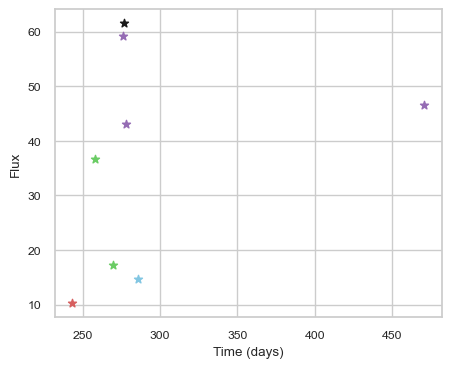

SNIax (3.7464797, False)
SNIax (3.489755, False)
SNIax (3.4293137, False)
SNIax (3.5716875, False)
SNIax (3.4880843, False)
SNIax (3.0940335, False)
SNIax (3.3561573, False)
SNIax (3.4439793, False)
SNIax (3.6473176, False)
SNIax (3.4875116, False)
SNIax (3.914654, False)
SNIax (3.6804085, False)
SNIax (3.233946, False)
SNIax (2.7723017, False)
SNIax (3.3632462, False)
SNIax (3.6798456, False)


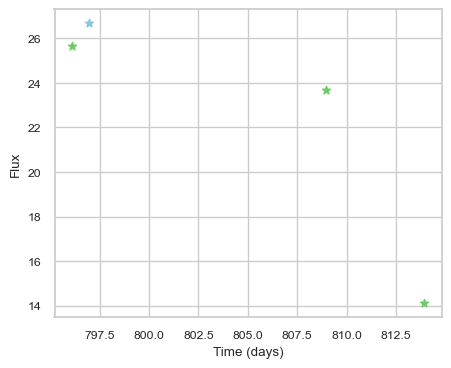

SNIax (3.9496155, False)
SNIax (3.402377, False)
SNIax (3.6135457, False)
SNIax (3.2276406, False)
SNIax (3.3491426, False)
SNIax (3.4308505, False)
SNIax (3.731123, False)
SNIax (4.1694713, False)


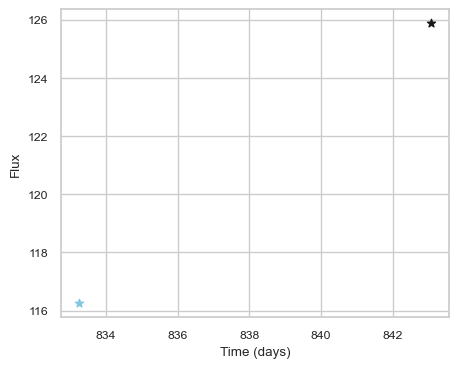

SNIax (3.6616864, False)
SNIax (3.3646069, False)
SNIax (3.2133908, False)
SNIax (3.9032252, False)


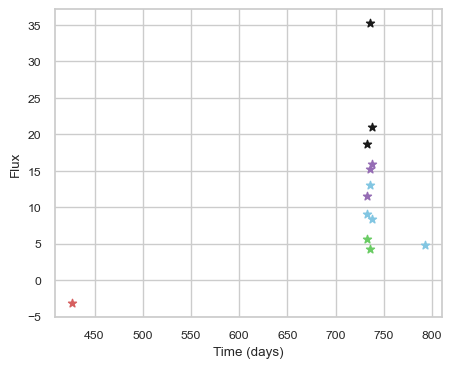

SNIax (5.2224083, False)
SNIax (5.2934437, False)
SNIax (4.989925, False)
SNIax (5.0534263, False)
SNIax (5.323793, False)
SNIax (5.2430067, False)
SNIax (5.7022505, False)
SNIax (6.129436, False)
SNIax (4.602598, False)
SNIax (4.5238047, False)
SNIax (4.4225893, False)
SNIax (4.6191325, False)
SNIax (5.043049, False)
SNIax (5.438202, False)
SNIax (4.0260243, False)
SNIax (4.0365787, False)
SNIax (4.60324, False)
SNIax (4.980634, False)
SNIax (4.644919, False)
SNIax (4.778206, False)


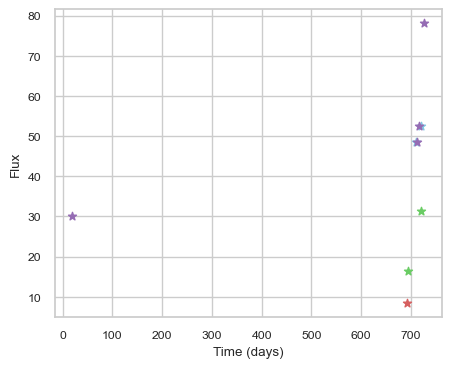

SNIax (4.593343, False)
SNIax (4.544782, False)
SNIax (4.732927, False)
SNIax (4.6950774, False)
SNIax (4.2773585, False)
SNIax (2.903967, False)
SNIax (3.3172522, False)
SNIax (4.25553, False)
SNIax (4.6416154, False)
SNIax (4.167115, False)
SNIax (4.3878818, False)
SNIax (4.4848075, False)
SNIax (4.95372, False)
SNIax (4.737414, False)
SNIax (5.2039604, False)
SNIax (4.851386, False)
SNIax (5.0913367, False)
SNIax (5.162199, False)


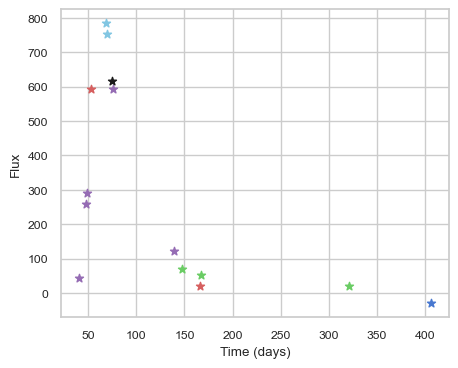

SNIax (3.8989758, False)
SNIax (3.9529648, False)
SNIax (3.3171396, False)
SNIax (3.1673381, False)
SNIax (3.3509617, False)
SNIax (3.0808291, False)
SNIax (4.462531, False)
SNIax (5.076258, False)
SNIax (6.4085784, False)
SNIax (5.712025, False)
SNIax (5.3908925, False)
SNIax (6.4040337, False)
SNIax (5.753734, False)
SNIax (6.498932, False)
SNIax (5.1750875, False)
SNIax (5.776637, False)
SNIax (5.68069, False)
SNIax (5.63852, False)
SNIax (5.7176147, False)
SNIax (5.8233566, False)
SNIax (5.673834, False)
SNIax (5.814171, False)
SNIax (5.7440047, False)
SNIax (6.257579, False)
SNIax (5.4172416, False)
SNIax (5.5642753, False)
SNIax (6.1966834, False)
SNIax (6.2930737, False)


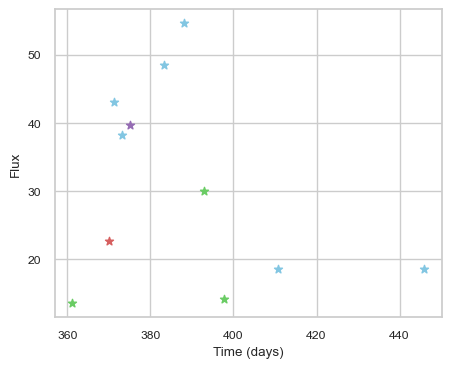

SNIax (3.845976, False)
SNIax (3.4859493, False)
SNIax (3.1648095, False)
SNIax (4.143263, False)
SNIax (4.0430326, False)
SNIax (2.053876, False)
SNIax (2.4842985, False)
SNIax (2.508965, False)
SNIax (2.6644707, False)
SNIax (1.7033325, False)
SNIax (2.086018, False)
SNIax (2.0061963, False)
SNIax (2.58039, False)
SNIax (2.2802997, False)
SNIax (2.5015721, False)
SNIax (2.11374, False)
SNIax (3.1349819, False)
SNIax (2.4084125, False)
SNIax (2.2382221, False)
SNIax (2.250757, False)
SNIax (1.920244, False)
SNIax (2.0056982, False)


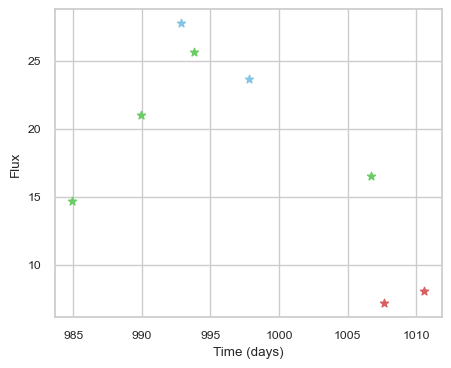

SNIax (3.822278, False)
SNIax (3.841764, False)
SNIax (3.3551898, False)
SNIax (3.298774, False)
SNIax (3.3899045, False)
SNIax (3.519074, False)
SNIax (3.1501658, False)
SNIax (3.3021963, False)
SNIax (3.8616645, False)
SNIax (3.32101, False)
SNIax (3.2606156, False)
SNIax (3.6634927, False)
SNIax (3.42077, False)
SNIax (3.218148, False)
SNIax (3.6378012, False)
SNIax (3.0689733, False)


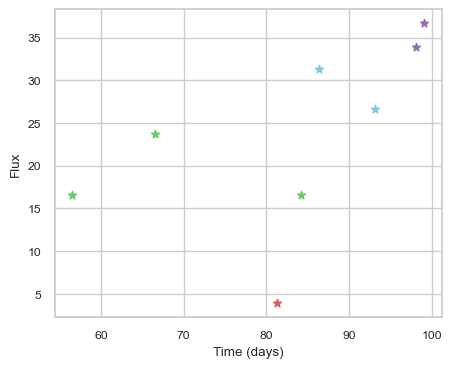

SNIax (5.6015625, False)
SNIax (4.6870637, False)
SNIax (4.9389243, False)
SNIax (4.697384, False)
SNIax (4.8178587, False)
SNIax (5.0630646, False)
SNIax (5.140966, False)
SNIax (5.096942, False)
SNIax (4.8704314, False)
SNIax (5.191851, False)
SNIax (5.4078503, False)
SNIax (5.198142, False)
SNIax (5.131613, False)
SNIax (5.0354667, False)
SNIax (5.663467, False)
SNIax (5.1425056, False)


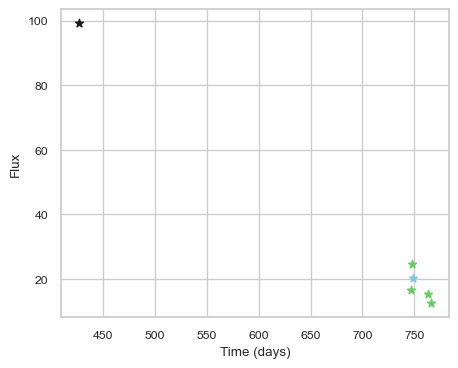

SNIax (4.4014153, False)
SNIax (4.3439164, False)
SNIax (4.6088166, False)
SNIax (3.6960871, False)
SNIax (3.5716805, False)
SNIax (3.0455728, False)
SNIax (3.485415, False)
SNIax (2.9792798, False)
SNIax (3.0251677, False)
SNIax (3.0506034, False)
SNIax (3.4597833, False)
SNIax (3.3897445, False)


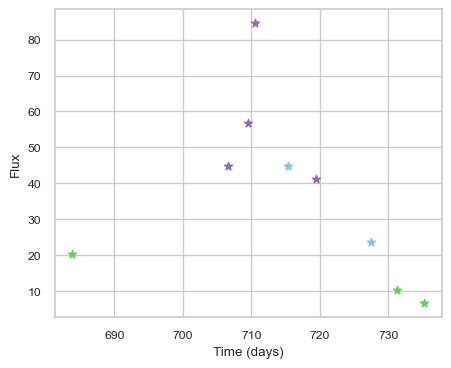

SNIax (3.9011793, False)
SNIax (3.7634792, False)
SNIax (3.7301521, False)
SNIax (2.8611956, False)
SNIax (3.2039382, False)
SNIax (3.2645905, False)
SNIax (3.982772, False)
SNIax (3.6636958, False)
SNIax (3.453832, False)
SNIax (3.2017548, False)
SNIax (3.349594, False)
SNIax (3.1616874, False)
SNIax (2.7344947, False)
SNIax (2.6321633, False)
SNIax (2.74576, False)
SNIax (3.2255337, False)
SNIax (2.8375645, False)
SNIax (3.2615602, False)


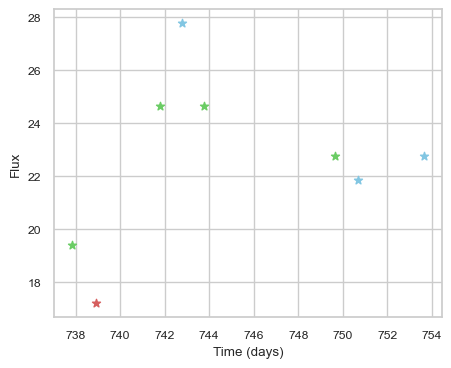

SNIax (3.957276, False)
SNIax (3.1042464, False)
SNIax (2.9747448, False)
SNIax (3.7411056, False)
SNIax (3.7366102, False)
SNIax (3.338438, False)
SNIax (4.1763587, False)
SNIax (3.4153345, False)
SNIax (3.4351676, False)
SNIax (3.3203113, False)
SNIax (3.7288446, False)
SNIax (3.8211515, False)
SNIax (3.4140456, False)
SNIax (3.560748, False)
SNIax (3.6586463, False)
SNIax (3.5552626, False)


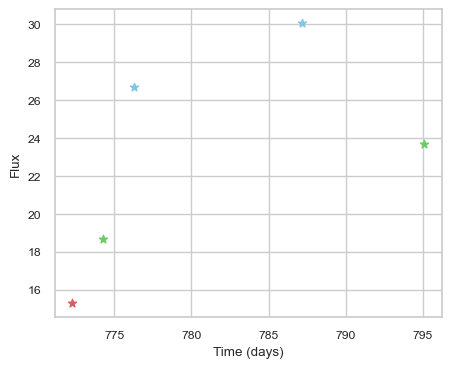

SNIax (3.908581, False)
SNIax (4.309842, False)
SNIax (3.665742, False)
SNIax (4.421164, False)
SNIax (4.813462, False)
SNIax (3.9871328, False)
SNIax (3.3177905, False)
SNIax (3.8567612, False)
SNIax (3.5541103, False)
SNIax (3.9189134, False)


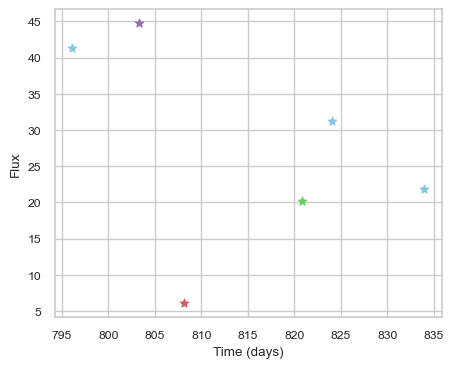

SNIax (4.060427, False)
SNIax (3.945702, False)
SNIax (4.8146315, False)
SNIax (4.3295546, False)
SNIax (4.082347, False)
SNIax (4.669415, False)
SNIax (4.2215643, False)
SNIax (4.437608, False)
SNIax (3.8800595, False)
SNIax (3.264083, False)
SNIax (3.2174425, False)
SNIax (3.0996304, False)


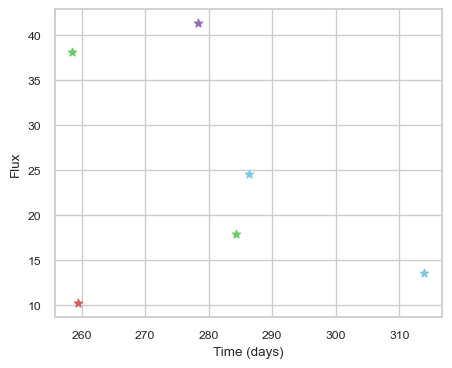

SNIax (3.7151, False)
SNIax (3.649089, False)
SNIax (3.1545146, False)
SNIax (3.6834247, False)
SNIax (3.3303761, False)
SNIax (3.1735127, False)
SNIax (2.9858506, False)
SNIax (3.5520325, False)
SNIax (3.3032901, False)
SNIax (3.793957, False)
SNIax (4.2581472, False)
SNIax (4.219561, False)


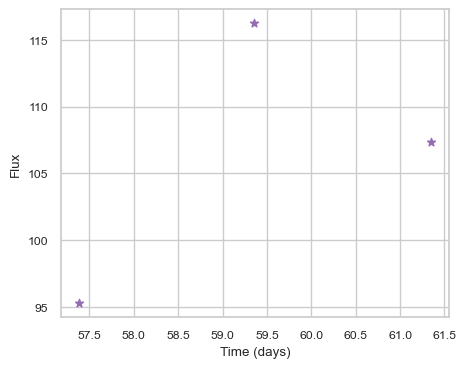

SNIax (3.9086761, False)
SNIax (4.310546, False)
SNIax (5.029051, False)
SNIax (5.0149403, False)
SNIax (5.163603, False)
SNIax (5.057769, False)


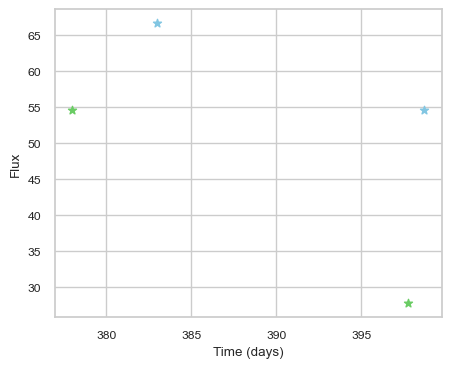

SNIax (3.9436767, False)
SNIax (3.521995, False)
SNIax (4.291774, False)
SNIax (4.384971, False)
SNIax (4.274689, False)
SNIax (3.8861709, False)
SNIax (3.6911857, False)
SNIax (3.1404026, False)


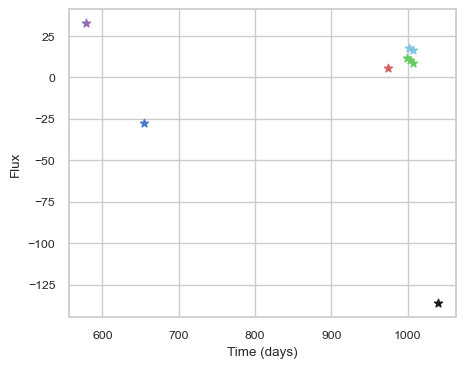

SNIax (4.3856792, False)
SNIax (3.5962229, False)
SNIax (4.6551375, False)
SNIax (4.930657, False)
SNIax (4.4064236, False)
SNIax (4.4450917, False)
SNIax (4.491922, False)
SNIax (3.8942692, False)
SNIax (4.1283827, False)
SNIax (3.9231484, False)
SNIax (3.376479, False)
SNIax (3.5739048, False)
SNIax (3.7322392, False)
SNIax (3.4367154, False)
SNIax (3.2871172, False)
SNIax (3.618094, False)
SNIax (3.9474285, False)
SNIax (4.198706, False)


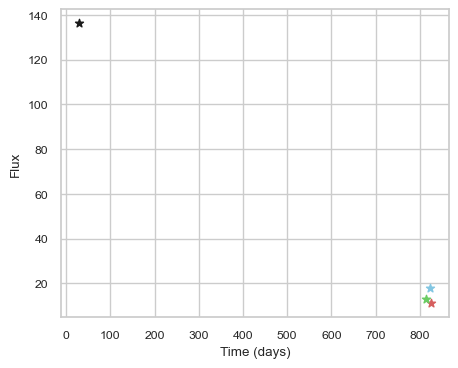

SNIax (3.6921442, False)
SNIax (3.2373893, False)
SNIax (3.657885, False)
SNIax (3.4322088, False)
SNIax (3.1559405, False)
SNIax (3.4137802, False)
SNIax (3.1848273, False)
SNIax (3.2576437, False)


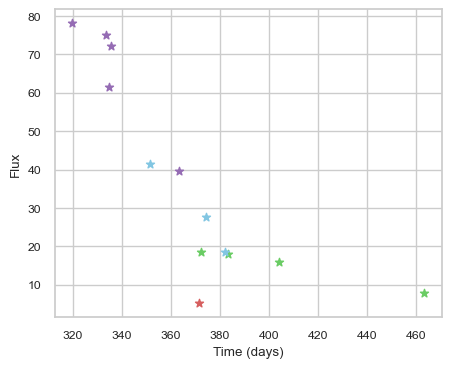

SNIax (3.7539015, False)
SNIax (4.05075, False)
SNIax (4.163134, False)
SNIax (4.120728, False)
SNIax (4.429888, False)
SNIax (4.740736, False)
SNIax (5.291898, False)
SNIax (5.3370457, False)
SNIax (6.1491084, False)
SNIax (5.5790753, False)
SNIax (6.022557, False)
SNIax (5.8909206, False)
SNIax (5.5254273, False)
SNIax (4.9815383, False)
SNIax (4.761621, False)
SNIax (4.963163, False)
SNIax (4.3177614, False)
SNIax (4.646672, False)
SNIax (4.052989, False)
SNIax (4.307899, False)
SNIax (3.7194982, False)
SNIax (4.5890346, False)
SNIax (4.368669, False)
SNIax (4.6015964, False)
SNIax (4.973745, False)
SNIax (4.498771, False)


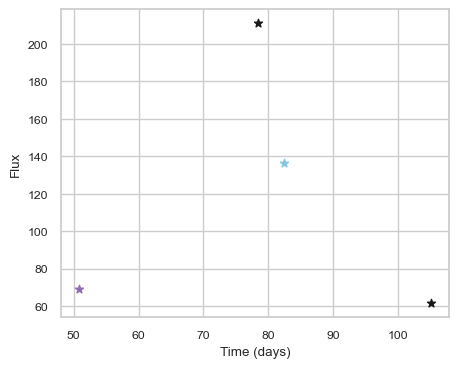

SNIax (3.9383717, False)
SNIax (3.956475, False)
SNIax (3.941522, False)
SNIax (3.6250749, False)
SNIax (3.6199398, False)
SNIax (3.6653452, False)
SNIax (4.1228266, False)
SNIax (3.794458, False)


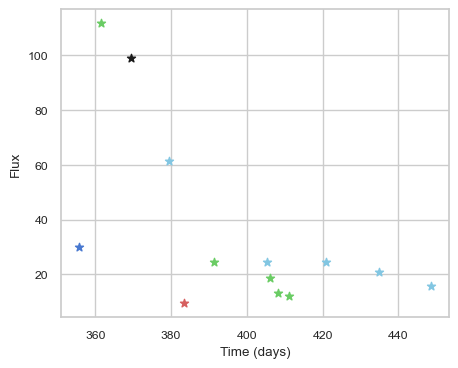

SNIax (3.787198, False)
SNIax (4.7124734, False)
SNIax (3.9026506, False)
SNIax (3.5797377, False)
SNIax (3.387386, False)
SNIax (3.2212768, False)
SNIax (2.7392359, False)
SNIax (2.421996, False)
SNIax (2.850035, False)
SNIax (2.241334, False)
SNIax (2.4837332, False)
SNIax (2.4200792, False)
SNIax (2.452781, False)
SNIax (2.2236443, False)
SNIax (2.2413845, False)
SNIax (2.3122938, False)
SNIax (2.5088162, False)
SNIax (2.3816488, False)
SNIax (2.6060367, False)
SNIax (2.5402212, False)
SNIax (2.4753084, False)
SNIax (2.095442, False)
SNIax (2.269964, False)
SNIax (2.2338712, False)
SNIax (2.4626162, False)
SNIax (2.2308795, False)


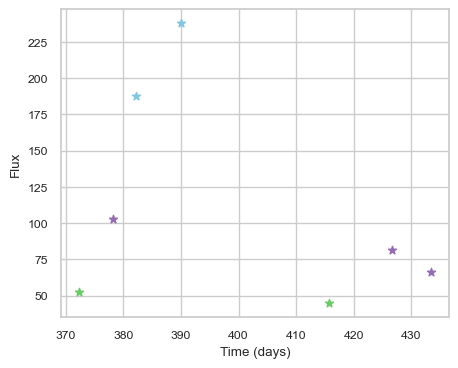

SNIax (3.806661, False)
SNIax (3.080624, False)
SNIax (3.3293676, False)
SNIax (3.7373724, False)
SNIax (3.52768, False)
SNIax (2.755901, False)
SNIax (2.7646925, False)
SNIax (2.2135363, False)
SNIax (2.8393571, False)
SNIax (2.9697502, False)
SNIax (3.4716094, False)
SNIax (2.7658024, False)
SNIax (3.2292097, False)
SNIax (2.7833343, False)


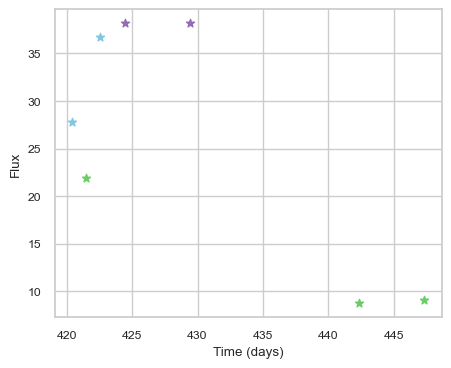

SNIax (4.803893, False)
SNIax (4.2698846, False)
SNIax (3.9810338, False)
SNIax (3.9678714, False)
SNIax (4.0596137, False)
SNIax (4.625606, False)
SNIax (4.706312, False)
SNIax (4.730495, False)
SNIax (4.7775235, False)
SNIax (5.0309067, False)
SNIax (5.382011, False)
SNIax (5.164906, False)
SNIax (4.694315, False)
SNIax (4.728326, False)


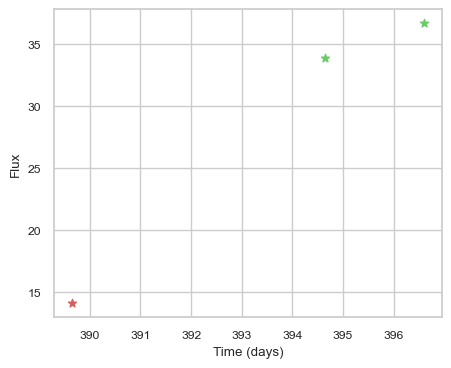

SNIax (4.072346, False)
SNIax (4.444787, False)
SNIax (4.2797847, False)
SNIax (2.6245818, False)
SNIax (3.4964476, False)
SNIax (2.9561968, False)


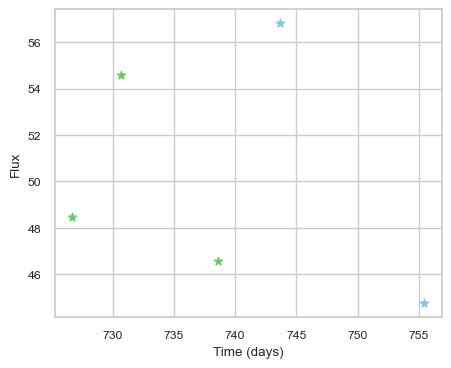

SNIax (3.8917322, False)
SNIax (3.3011234, False)
SNIax (3.6665974, False)
SNIax (3.2977812, False)
SNIax (2.6910014, False)
SNIax (2.6478205, False)
SNIax (2.8078978, False)
SNIax (2.3877923, False)
SNIax (3.4004414, False)
SNIax (3.5927315, False)


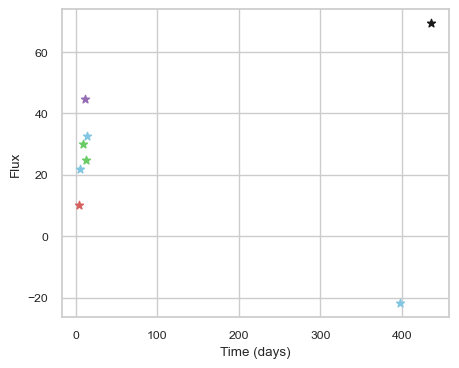

SNIax (3.9144876, False)
SNIax (3.6809428, False)
SNIax (3.062676, False)
SNIax (2.8202848, False)
SNIax (2.7801273, False)
SNIax (2.8286057, False)
SNIax (2.9329016, False)
SNIax (2.2302241, False)
SNIax (3.2961693, False)
SNIax (2.8475006, False)
SNIax (3.3307219, False)
SNIax (2.6752388, False)
SNIax (3.0627077, False)
SNIax (2.8144565, False)
SNIax (3.0765603, False)
SNIax (3.7390053, False)


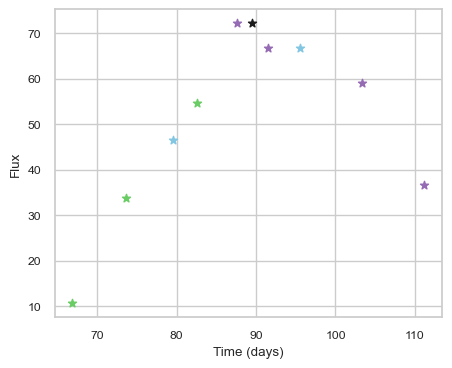

SNIax (3.654371, False)
SNIax (3.6717186, False)
SNIax (2.8506258, False)
SNIax (3.2520304, False)
SNIax (3.2923636, False)
SNIax (3.1792235, False)
SNIax (3.1675074, False)
SNIax (3.017064, False)
SNIax (2.890579, False)
SNIax (2.1632493, False)
SNIax (3.7299943, False)
SNIax (2.9422472, False)
SNIax (3.593823, False)
SNIax (2.4314432, False)
SNIax (3.2799933, False)
SNIax (2.0899017, False)
SNIax (2.9110403, False)
SNIax (2.3997846, False)
SNIax (2.8802085, False)
SNIax (2.5285382, False)


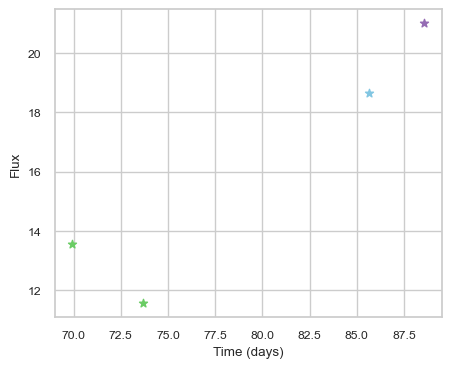

SNIax (4.494633, False)
SNIax (3.660361, False)
SNIax (3.3165865, False)
SNIax (3.3660135, False)
SNIax (3.1645658, False)
SNIax (3.4178336, False)
SNIax (3.2624555, False)
SNIax (4.072244, False)


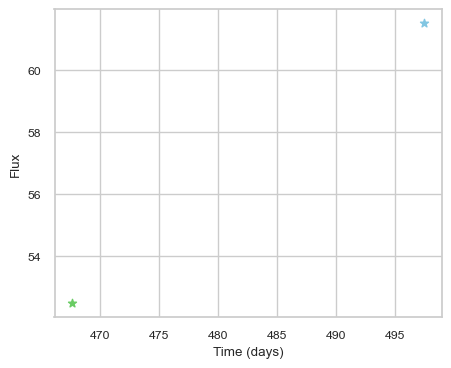

SNIax (3.9446068, False)
SNIax (4.139776, False)
SNIax (3.8009431, False)
SNIax (3.9164088, False)


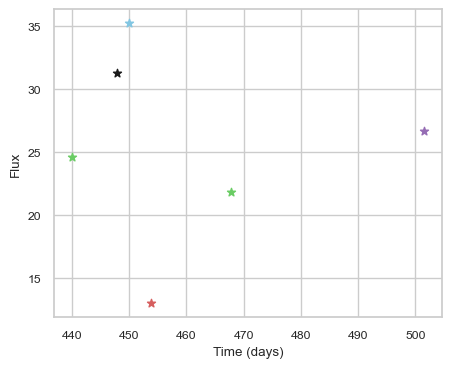

SNIax (4.293283, False)
SNIax (3.7640324, False)
SNIax (3.6182518, False)
SNIax (3.6653898, False)
SNIax (3.0473123, False)
SNIax (2.9759197, False)
SNIax (3.6372886, False)
SNIax (2.7155886, False)
SNIax (2.4554398, False)
SNIax (2.5824847, False)
SNIax (4.285271, False)
SNIax (4.030912, False)


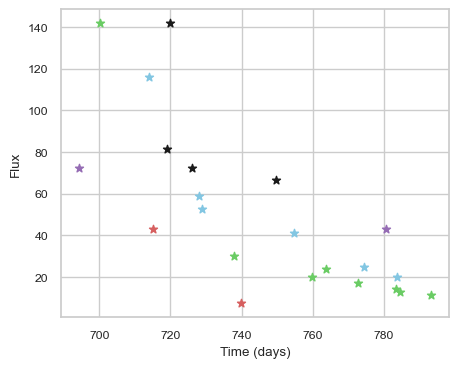

SNIax (4.1385403, False)
SNIax (4.034845, False)
SNIax (4.385965, False)
SNIax (4.431677, False)
SNIax (4.418522, False)
SNIax (4.411541, False)
SNIax (5.1885276, False)
SNIax (5.764911, False)
SNIax (5.675124, False)
SNIax (5.440219, False)
SNIax (6.048419, False)
SNIax (5.7904515, False)
SNIax (4.318561, False)
SNIax (4.6552672, False)
SNIax (5.316111, False)
SNIax (4.6147504, False)
SNIax (4.542257, False)
SNIax (4.576603, False)
SNIax (4.784135, False)
SNIax (4.8054132, False)
SNIax (4.7594786, False)
SNIax (5.204218, False)
SNIax (5.009245, False)
SNIax (4.5751705, False)
SNIax (4.4138017, False)
SNIax (3.9011312, False)
SNIax (4.673247, False)
SNIax (4.5757117, False)
SNIax (4.042493, False)
SNIax (4.9106026, False)
SNIax (4.328276, False)
SNIax (4.906257, False)
SNIax (4.477066, False)
SNIax (4.31536, False)
SNIax (4.1806836, False)
SNIax (4.773456, False)
SNIax (4.4102902, False)
SNIax (4.664085, False)
SNIax (4.465717, False)
SNIax (4.371534, False)
SNIax (3.9987617, False)
SN

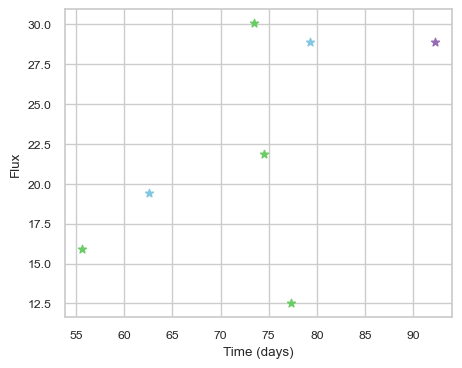

SNIax (4.0763407, False)
SNIax (3.244641, False)
SNIax (3.1074598, False)
SNIax (3.4766607, False)
SNIax (3.3311212, False)
SNIax (3.6135159, False)
SNIax (4.146461, False)
SNIax (4.253125, False)
SNIax (4.86851, False)
SNIax (4.190934, False)
SNIax (3.837732, False)
SNIax (3.4978793, False)
SNIax (3.2094686, False)
SNIax (3.8820724, False)


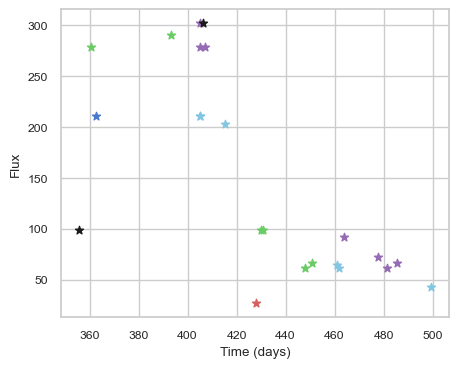

SNIax (3.6183302, False)
SNIax (3.5623662, False)
SNIax (3.7454753, False)
SNIax (3.2394974, False)
SNIax (2.7287683, False)
SNIax (2.9758916, False)
SNIax (3.685591, False)
SNIax (3.6650271, False)
SNIax (4.245717, False)
SNIax (3.4811416, False)
SNIax (3.6209311, False)
SNIax (3.3006637, False)
SNIax (3.7615352, False)
SNIax (3.2774918, False)
SNIax (3.525379, False)
SNIax (4.0556865, False)
SNIax (2.7272062, False)
SNIax (2.8784564, False)
SNIax (2.3502781, False)
SNIax (3.4082413, False)
SNIax (3.1147633, False)
SNIax (2.8171027, False)
SNIax (3.1580737, False)
SNIax (2.5340989, False)
SNIax (3.122092, False)
SNIax (3.0357106, False)
SNIax (2.607964, False)
SNIax (2.5730567, False)
SNIax (3.0031233, False)
SNIax (2.7379363, False)
SNIax (2.3319483, False)
SNIax (2.3354225, False)
SNIax (2.6437192, False)
SNIax (2.5188541, False)
SNIax (2.6520734, False)
SNIax (2.3002152, False)
SNIax (2.6346586, False)
SNIax (3.0049007, False)
SNIax (2.826805, False)
SNIax (2.9584155, False)
SNIax 

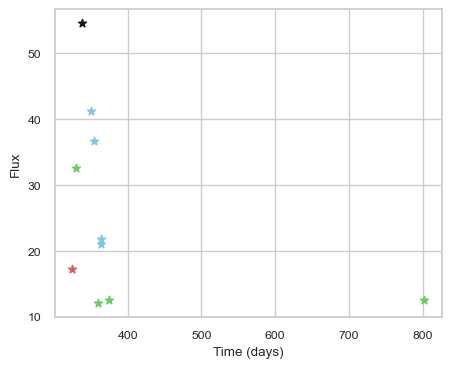

SNIax (3.8518107, False)
SNIax (4.229296, False)
SNIax (4.2216234, False)
SNIax (3.0794048, False)
SNIax (3.7502925, False)
SNIax (4.0956464, False)
SNIax (3.940685, False)
SNIax (4.2555327, False)
SNIax (4.647183, False)
SNIax (4.342564, False)
SNIax (4.436487, False)
SNIax (4.0074744, False)
SNIax (3.698242, False)
SNIax (3.5187323, False)
SNIax (3.4323335, False)
SNIax (3.2473612, False)
SNIax (3.4194784, False)
SNIax (3.597599, False)
SNIax (3.9866502, False)
SNIax (3.5574374, False)


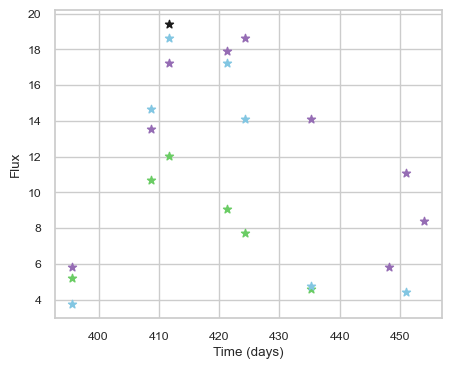

SNIax (5.022266, False)
SNIax (4.4421663, False)
SNIax (4.776697, False)
SNIax (4.7384763, False)
SNIax (4.8347106, False)
SNIax (4.261557, False)
SNIax (4.111628, False)
SNIax (4.4518847, False)
SNIax (4.826402, False)
SNIax (3.6066878, False)
SNIax (3.2513835, False)
SNIax (3.2408538, False)
SNIax (3.0414982, False)
SNIax (3.763237, False)
SNIax (3.9395688, False)
SNIax (3.0268955, False)
SNIax (2.7662156, False)
SNIax (3.24225, False)
SNIax (2.9780817, False)
SNIax (3.4110613, False)
SNIax (2.8716438, False)
SNIax (2.7849932, False)
SNIax (2.7264175, False)
SNIax (2.839572, False)
SNIax (2.930433, False)
SNIax (2.8197863, False)
SNIax (2.754637, False)
SNIax (2.836403, False)
SNIax (3.1518457, False)
SNIax (3.340374, False)
SNIax (3.005482, False)
SNIax (3.1724074, False)
SNIax (3.1178825, False)
SNIax (3.4280186, False)
SNIax (3.2894773, False)
SNIax (3.0309734, False)
SNIax (3.451537, False)


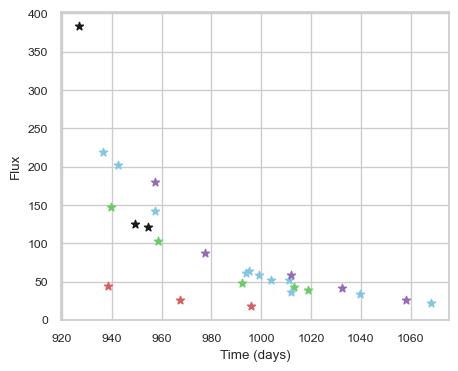

SNIax (3.5531328, False)
SNIax (3.55749, False)
SNIax (3.352072, False)
SNIax (3.3472366, False)
SNIax (2.8272226, False)
SNIax (3.4861696, False)
SNIax (2.91524, False)
SNIax (3.225059, False)
SNIax (2.9673085, False)
SNIax (3.218697, False)
SNIax (2.9043021, False)
SNIax (3.395052, False)
SNIax (2.6348763, False)
SNIax (3.1524649, False)
SNIax (2.7899973, False)
SNIax (2.4267955, False)
SNIax (3.0035598, False)
SNIax (2.043687, False)
SNIax (2.872098, False)
SNIax (2.7097914, False)
SNIax (2.690274, False)
SNIax (2.5463545, False)
SNIax (2.8710191, False)
SNIax (1.9500836, False)
SNIax (2.4810774, False)
SNIax (1.9976151, False)
SNIax (2.3826284, False)
SNIax (1.9534928, False)
SNIax (1.7860769, False)
SNIax (1.7960337, False)
SNIax (1.9478391, False)
SNIax (2.0795255, False)
SNIax (2.2743375, False)
SNIax (1.7761716, False)
SNIax (2.0689855, False)
SNIax (1.7999847, False)
SNIax (2.1534743, False)
SNIax (1.8638451, False)
SNIax (1.7373424, False)
SNIax (1.9810812, False)
SNIax (2.21

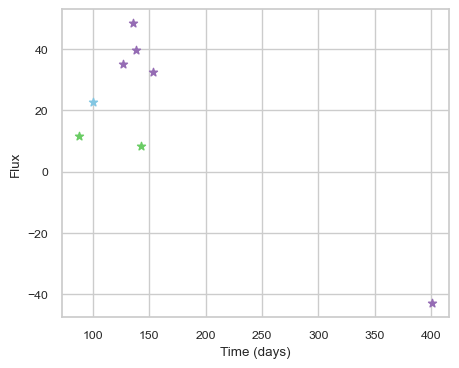

SNIax (4.782393, False)
SNIax (4.1855226, False)
SNIax (4.2664185, False)
SNIax (3.937848, False)
SNIax (3.841073, False)
SNIax (3.8880508, False)
SNIax (3.5212471, False)
SNIax (3.5540113, False)
SNIax (3.6612058, False)
SNIax (3.6465924, False)
SNIax (3.356672, False)
SNIax (3.2188914, False)
SNIax (3.2440577, False)
SNIax (3.0749702, False)
SNIax (3.947342, False)
SNIax (3.7030504, False)


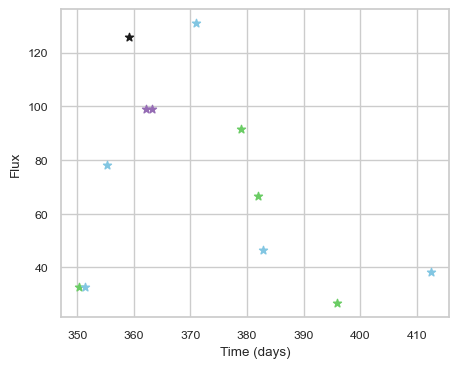

SNIax (3.8106425, False)
SNIax (3.607673, False)
SNIax (3.3284907, False)
SNIax (3.478958, False)
SNIax (4.6634083, False)
SNIax (3.2826753, False)
SNIax (3.7103477, False)
SNIax (3.9136286, False)
SNIax (3.6843524, False)
SNIax (2.9905953, False)
SNIax (4.022679, False)
SNIax (2.9620614, False)
SNIax (3.504876, False)
SNIax (3.553618, False)
SNIax (3.1846073, False)
SNIax (3.1911352, False)
SNIax (3.670543, False)
SNIax (3.3662357, False)
SNIax (2.9852073, False)
SNIax (3.0910203, False)
SNIax (2.441632, False)
SNIax (2.6984725, False)
SNIax (2.7002454, False)
SNIax (2.5827467, False)


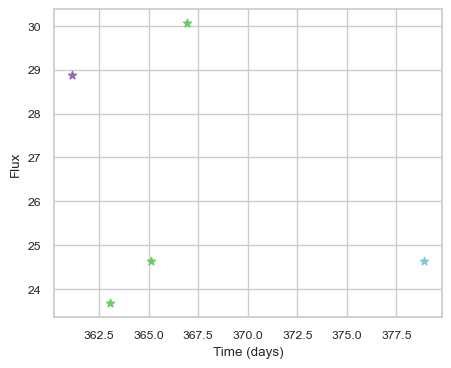

SNIax (4.1725316, False)
SNIax (3.7025735, False)
SNIax (3.3760862, False)
SNIax (2.8729403, False)
SNIax (2.9260135, False)
SNIax (2.5075178, False)
SNIax (3.0058897, False)
SNIax (2.734984, False)
SNIax (3.5863078, False)
SNIax (1.9957819, False)


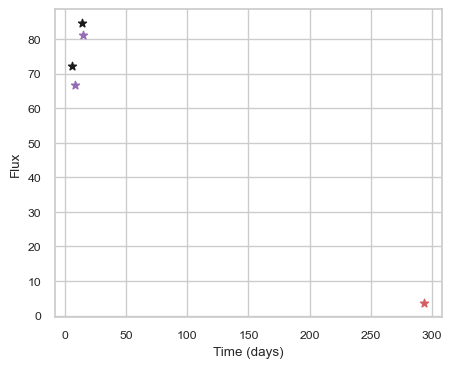

SNIax (4.2463126, False)
SNIax (4.0856647, False)
SNIax (4.794177, False)
SNIax (4.0676665, False)
SNIax (3.8245788, False)
SNIax (4.178366, False)
SNIax (4.5060973, False)
SNIax (4.1010303, False)
SNIax (4.183354, False)
SNIax (4.484688, False)


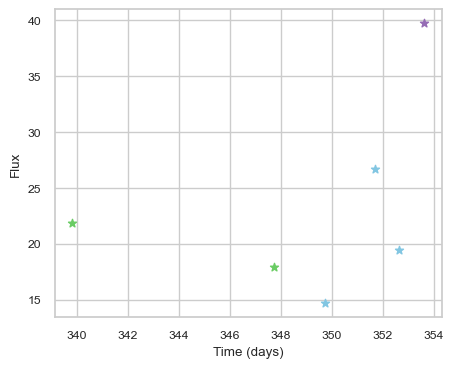

SNIax (3.9175293, False)
SNIax (4.1100526, False)
SNIax (3.5896482, False)
SNIax (4.0008802, False)
SNIax (3.4372213, False)
SNIax (4.0411234, False)
SNIax (4.136193, False)
SNIax (3.4209118, False)
SNIax (3.3451936, False)
SNIax (3.2176895, False)
SNIax (3.5970562, False)
SNIax (3.4304256, False)


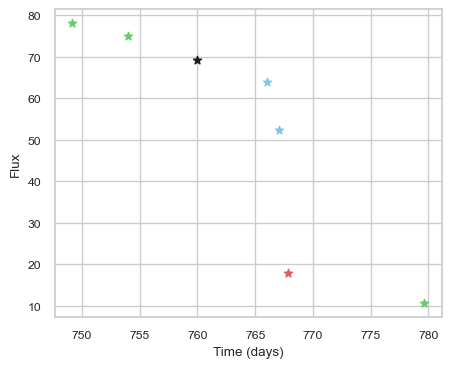

SNIax (3.829008, False)
SNIax (3.2053874, False)
SNIax (4.0422554, False)
SNIax (4.0843987, False)
SNIax (3.4224846, False)
SNIax (3.3705997, False)
SNIax (2.9499962, False)
SNIax (2.495976, False)
SNIax (3.0006943, False)
SNIax (2.4612262, False)
SNIax (3.1457608, False)
SNIax (3.8984919, False)
SNIax (4.2344813, False)
SNIax (3.5212574, False)


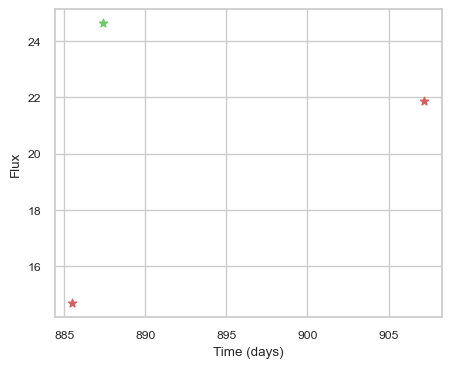

SNIax (3.9064755, False)
SNIax (4.1549053, False)
SNIax (3.3960357, False)
SNIax (3.3134115, False)
SNIax (3.5836215, False)
SNIax (2.9954848, False)


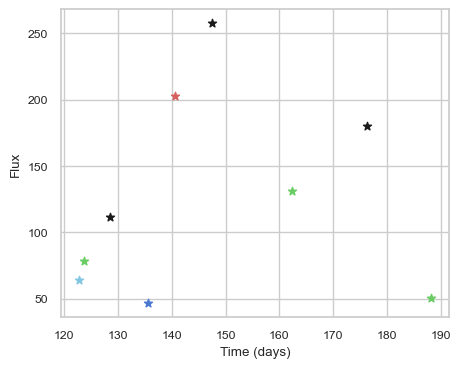

SNIax (3.6968439, False)
SNIax (4.2009497, False)
SNIax (3.949459, False)
SNIax (4.6031094, False)
SNIax (3.6574302, False)
SNIax (4.010512, False)
SNIax (3.5682573, False)
SNIax (3.641518, False)
SNIax (3.7764444, False)
SNIax (3.958675, False)
SNIax (3.9188373, False)
SNIax (3.6409812, False)
SNIax (3.4636238, False)
SNIax (3.661726, False)
SNIax (3.824642, False)
SNIax (3.561713, False)
SNIax (3.7382095, False)
SNIax (4.8243814, False)


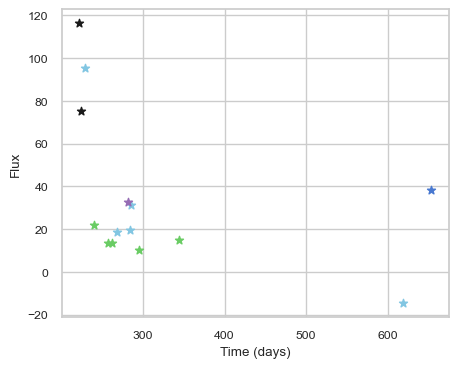

SNIax (4.141784, False)
SNIax (3.291064, False)
SNIax (4.7533903, False)
SNIax (4.00337, False)
SNIax (4.0660253, False)
SNIax (3.5578291, False)
SNIax (3.6621509, False)
SNIax (4.2546372, False)
SNIax (4.030123, False)
SNIax (3.9729187, False)
SNIax (4.3254857, False)
SNIax (3.9174056, False)
SNIax (4.003242, False)
SNIax (4.0750217, False)
SNIax (3.5715466, False)
SNIax (3.776953, False)
SNIax (4.1875243, False)
SNIax (4.242336, False)
SNIax (3.6546905, False)
SNIax (4.4374847, False)
SNIax (3.9935944, False)
SNIax (3.8460433, False)
SNIax (4.2567368, False)
SNIax (4.15423, False)
SNIax (4.393818, False)
SNIax (4.354101, False)
SNIax (4.6532955, False)
SNIax (4.8781986, False)


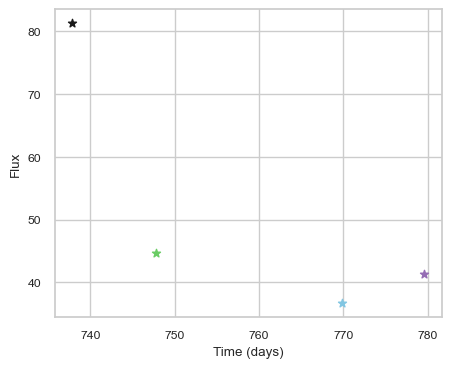

SNIax (4.1781454, False)
SNIax (3.7576935, False)
SNIax (4.2467856, False)
SNIax (3.4952307, False)
SNIax (4.1218476, False)
SNIax (3.4221647, False)
SNIax (3.3697836, False)
SNIax (3.73331, False)


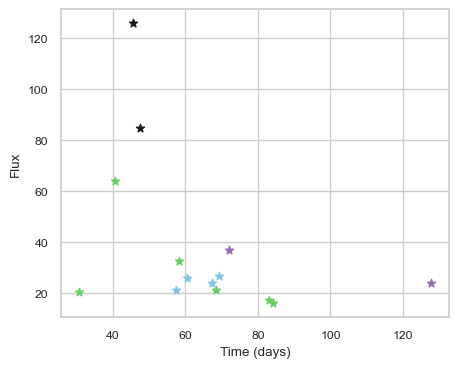

SNIax (3.7520869, False)
SNIax (3.3795874, False)
SNIax (3.1818228, False)
SNIax (2.9575408, False)
SNIax (3.4527984, False)
SNIax (3.2023392, False)
SNIax (4.1195693, False)
SNIax (3.6719735, False)
SNIax (3.4747753, False)
SNIax (3.2101936, False)
SNIax (2.7274525, False)
SNIax (2.831731, False)
SNIax (3.1239574, False)
SNIax (3.090132, False)
SNIax (2.945794, False)
SNIax (2.8146071, False)
SNIax (2.6149762, False)
SNIax (2.8183775, False)
SNIax (3.291587, False)
SNIax (2.5918884, False)
SNIax (3.005498, False)
SNIax (2.85775, False)
SNIax (2.6954694, False)
SNIax (2.5550857, False)
SNIax (2.6924121, False)
SNIax (2.6379945, False)
SNIax (2.8575132, False)
SNIax (2.6930249, False)


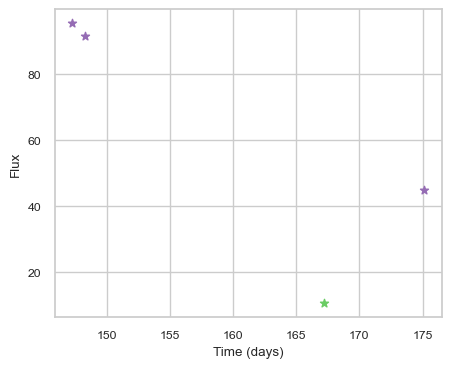

SNIax (3.7851615, False)
SNIax (4.128258, False)
SNIax (4.552408, False)
SNIax (4.4582314, False)
SNIax (4.9005103, False)
SNIax (4.695902, False)
SNIax (4.6788726, False)
SNIax (4.3887014, False)


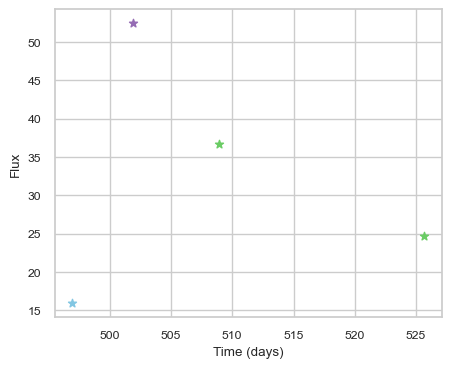

SNIax (4.795377, False)
SNIax (4.0944533, False)
SNIax (4.385017, False)
SNIax (5.3595624, False)
SNIax (4.210743, False)
SNIax (4.2973657, False)
SNIax (4.676786, False)
SNIax (4.426368, False)


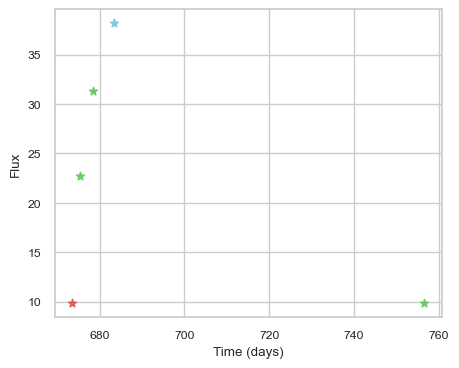

SNIax (3.834185, False)
SNIax (4.3705506, False)
SNIax (3.1624973, False)
SNIax (3.0304823, False)
SNIax (3.2407525, False)
SNIax (3.011486, False)
SNIax (3.1438613, False)
SNIax (3.03943, False)
SNIax (3.0176888, False)
SNIax (3.118974, False)


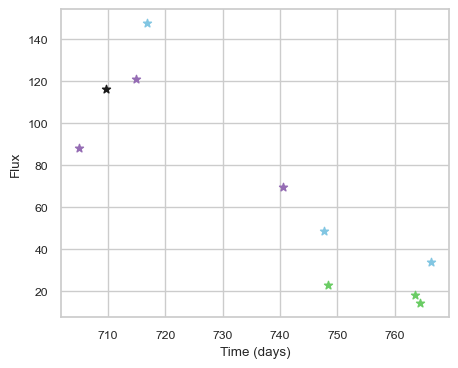

SNIax (3.7228258, False)
SNIax (3.5289369, False)
SNIax (3.6938467, False)
SNIax (4.4460664, False)
SNIax (4.1088667, False)
SNIax (3.4801068, False)
SNIax (4.3549294, False)
SNIax (4.501434, False)
SNIax (3.5371416, False)
SNIax (3.5464633, False)
SNIax (4.073485, False)
SNIax (3.9982076, False)
SNIax (4.1295085, False)
SNIax (4.28272, False)
SNIax (3.9149785, False)
SNIax (4.1015053, False)
SNIax (4.1764154, False)
SNIax (4.36672, False)
SNIax (4.303125, False)
SNIax (4.149599, False)


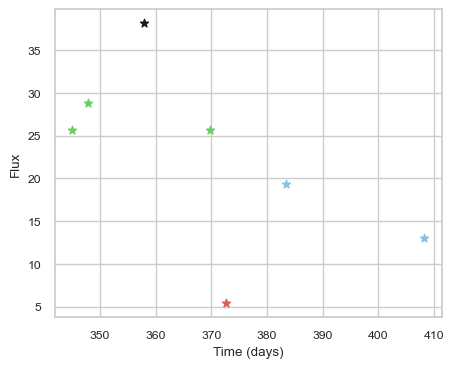

SNIax (3.7844887, False)
SNIax (3.7505245, False)
SNIax (3.566786, False)
SNIax (3.470136, False)
SNIax (3.575821, False)
SNIax (3.5328803, False)
SNIax (4.4467063, False)
SNIax (3.8315432, False)
SNIax (4.679416, False)
SNIax (3.7150464, False)
SNIax (3.4078364, False)
SNIax (3.842434, False)
SNIax (5.292008, False)
SNIax (4.601514, False)


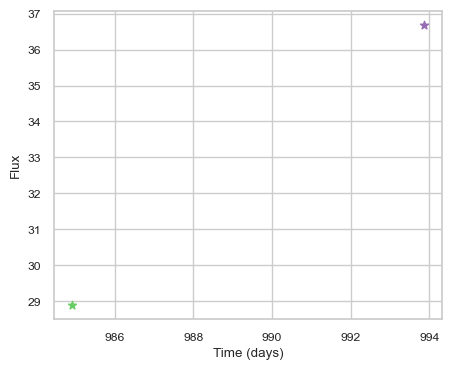

SNIax (4.047071, False)
SNIax (3.909721, False)
SNIax (3.4422495, False)
SNIax (3.1502118, False)


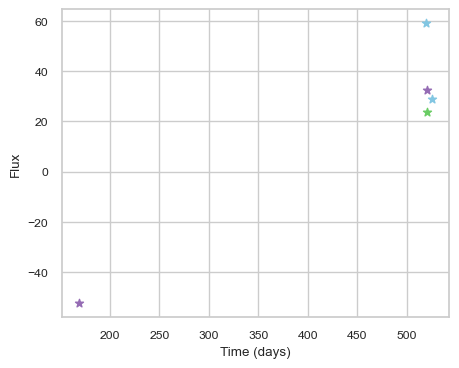

SNIax (3.857923, False)
SNIax (4.043842, False)
SNIax (4.1205664, False)
SNIax (3.970662, False)
SNIax (4.322465, False)
SNIax (3.6098187, False)
SNIax (3.1536224, False)
SNIax (2.6969094, False)
SNIax (3.417986, False)
SNIax (2.8466086, False)


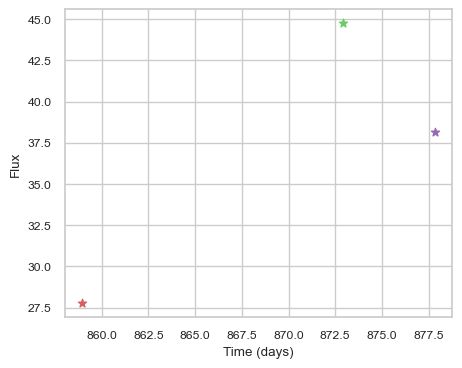

SNIax (3.8715415, False)
SNIax (4.6303897, False)
SNIax (4.1721034, False)
SNIax (3.03536, False)
SNIax (3.7524073, False)
SNIax (4.2671185, False)


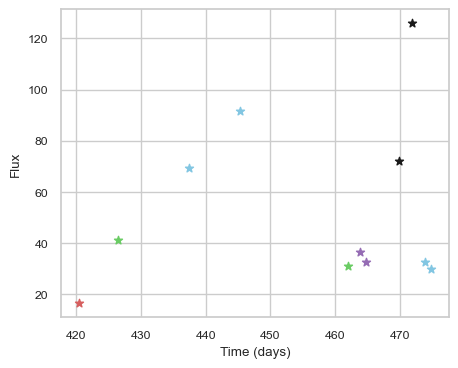

SNIax (4.0148687, False)
SNIax (4.544613, False)
SNIax (4.3487816, False)
SNIax (3.1561608, False)
SNIax (3.1208963, False)
SNIax (3.4808557, False)
SNIax (3.4784834, False)
SNIax (3.6571882, False)
SNIax (3.7356367, False)
SNIax (3.7926672, False)
SNIax (4.0702024, False)
SNIax (3.3902996, False)
SNIax (3.3869696, False)
SNIax (2.965891, False)
SNIax (2.9558792, False)
SNIax (2.917796, False)
SNIax (3.3816218, False)
SNIax (2.8347273, False)
SNIax (3.3797655, False)
SNIax (2.6891987, False)
SNIax (2.513066, False)
SNIax (2.8937256, False)


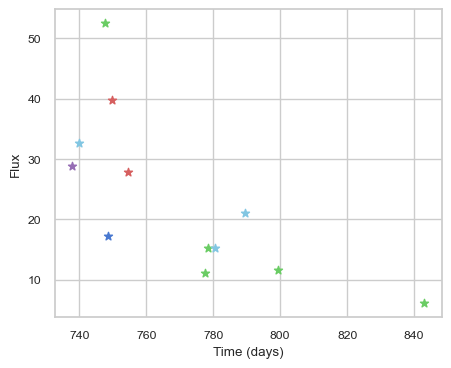

SNIax (3.8049672, False)
SNIax (3.318424, False)
SNIax (3.3633368, False)
SNIax (3.335284, False)
SNIax (3.002356, False)
SNIax (2.52237, False)
SNIax (2.8648891, False)
SNIax (3.7409983, False)
SNIax (2.5926156, False)
SNIax (1.9395188, False)
SNIax (3.4584165, False)
SNIax (2.9177988, False)
SNIax (3.5533156, False)
SNIax (4.154098, False)
SNIax (2.8451917, False)
SNIax (3.5810094, False)
SNIax (2.911987, False)
SNIax (2.9018178, False)
SNIax (3.303655, False)
SNIax (3.091777, False)
SNIax (3.1072764, False)
SNIax (3.3973286, False)
SNIax (3.7115328, False)
SNIax (3.3820212, False)


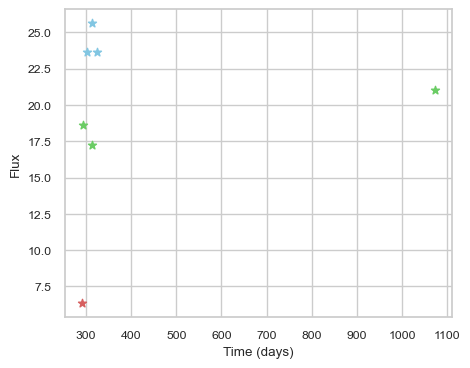

SNIax (4.156703, False)
SNIax (4.5581217, False)
SNIax (4.119723, False)
SNIax (3.4814718, False)
SNIax (3.478812, False)
SNIax (2.759362, False)
SNIax (2.7482402, False)
SNIax (3.1275222, False)
SNIax (2.8903913, False)
SNIax (2.6708012, False)
SNIax (2.7699702, False)
SNIax (2.660071, False)
SNIax (3.4551969, False)
SNIax (2.8573053, False)


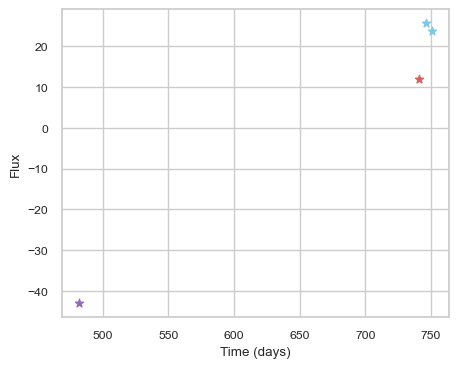

SNIax (4.182147, False)
SNIax (4.116543, False)
SNIax (4.1134176, False)
SNIax (3.480652, False)
SNIax (3.604011, False)
SNIax (3.3427515, False)
SNIax (4.128395, False)
SNIax (3.6699371, False)


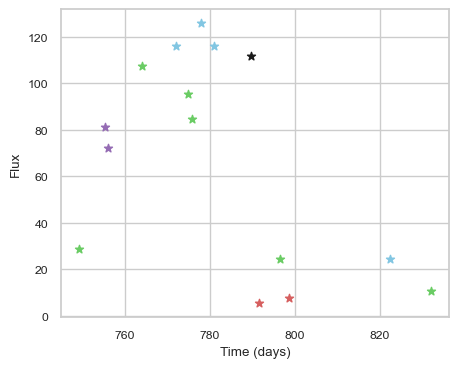

SNIax (3.807012, False)
SNIax (3.2277777, False)
SNIax (3.2199035, False)
SNIax (3.8229024, False)
SNIax (4.624591, False)
SNIax (3.8603256, False)
SNIax (3.5358207, False)
SNIax (3.9723122, False)
SNIax (5.102532, False)
SNIax (4.97317, False)
SNIax (4.992977, False)
SNIax (5.2663727, False)
SNIax (4.7362094, False)
SNIax (5.589667, False)
SNIax (4.8333273, False)
SNIax (5.6078825, False)
SNIax (3.9528277, False)
SNIax (4.476714, False)
SNIax (4.165953, False)
SNIax (4.041754, False)
SNIax (4.323677, False)
SNIax (4.1623797, False)
SNIax (4.839215, False)
SNIax (3.884452, False)
SNIax (4.339885, False)
SNIax (4.465334, False)
SNIax (4.770871, False)
SNIax (3.6841054, False)
SNIax (3.7202582, False)
SNIax (3.5199924, False)


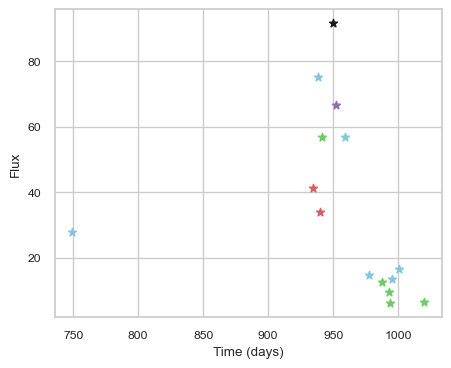

SNIax (3.6902027, False)
SNIax (3.3682892, False)
SNIax (3.5227394, False)
SNIax (4.0978317, False)
SNIax (3.6685266, False)
SNIax (3.0840073, False)
SNIax (3.2677572, False)
SNIax (2.7152495, False)
SNIax (3.176765, False)
SNIax (2.4221592, False)
SNIax (3.2491686, False)
SNIax (3.0374992, False)
SNIax (3.231422, False)
SNIax (3.1297014, False)
SNIax (3.1977563, False)
SNIax (3.024371, False)
SNIax (4.037014, False)
SNIax (2.7538629, False)
SNIax (1.9618958, False)
SNIax (1.7044837, False)
SNIax (2.3483152, False)
SNIax (1.5954669, False)
SNIax (2.0780606, False)
SNIax (1.7455314, False)
SNIax (2.1501365, False)
SNIax (1.6585754, False)
SNIax (1.8140337, False)
SNIax (1.481202, False)
SNIax (2.113101, False)
SNIax (1.6462375, False)


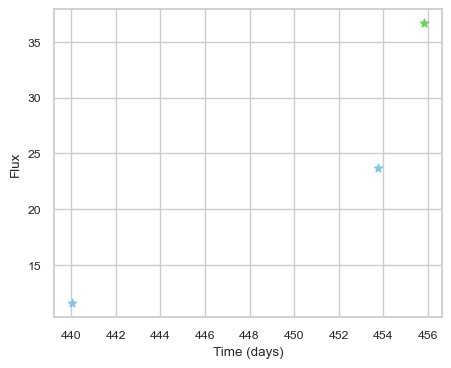

SNIax (3.858756, False)
SNIax (4.0490975, False)
SNIax (3.2793536, False)
SNIax (3.7500353, False)
SNIax (3.2189689, False)
SNIax (3.268929, False)


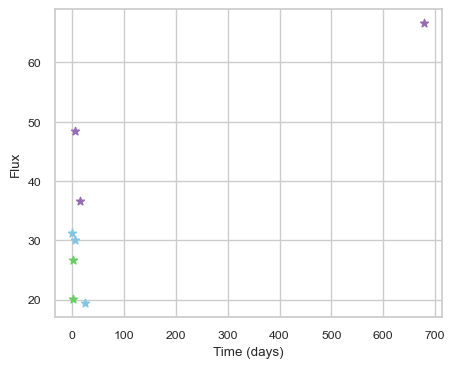

SNIax (4.477896, False)
SNIax (4.064774, False)
SNIax (4.464944, False)
SNIax (3.772389, False)
SNIax (3.648289, False)
SNIax (3.0128903, False)
SNIax (3.655906, False)
SNIax (2.6495423, False)
SNIax (2.960096, False)
SNIax (2.4669561, False)
SNIax (2.7804117, False)
SNIax (2.7258196, False)
SNIax (3.1093156, False)
SNIax (2.7358146, False)
SNIax (3.389811, False)
SNIax (2.890191, False)


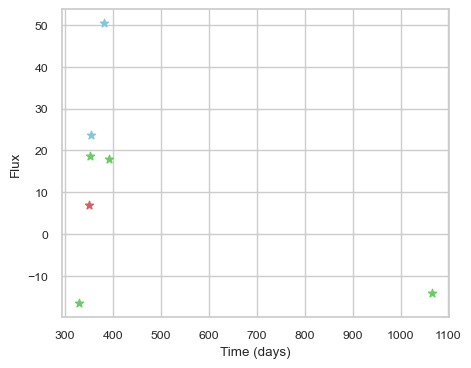

SNIax (4.60101, False)
SNIax (4.633087, False)
SNIax (3.95463, False)
SNIax (3.9843957, False)
SNIax (3.5205505, False)
SNIax (3.3503714, False)
SNIax (3.179842, False)
SNIax (3.0015256, False)
SNIax (3.1424177, False)
SNIax (5.1728697, False)
SNIax (5.303557, False)
SNIax (4.79276, False)
SNIax (4.5586486, False)
SNIax (4.771781, False)


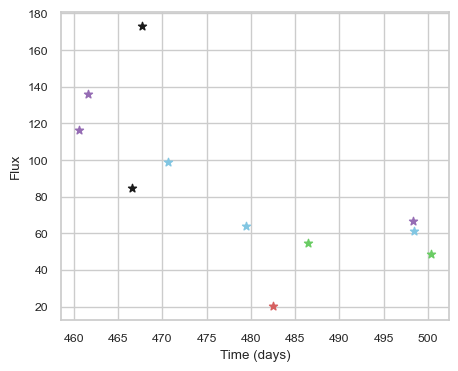

SNIax (3.854495, False)
SNIax (3.83941, False)
SNIax (3.7360327, False)
SNIax (3.7365007, False)
SNIax (3.580601, False)
SNIax (3.5033634, False)
SNIax (3.2769353, False)
SNIax (3.3930876, False)
SNIax (3.539226, False)
SNIax (3.40291, False)
SNIax (3.9307222, False)
SNIax (3.7903843, False)
SNIax (3.3814604, False)
SNIax (3.9060075, False)
SNIax (3.5045116, False)
SNIax (3.707369, False)
SNIax (3.857981, False)
SNIax (3.9042172, False)
SNIax (3.893946, False)
SNIax (3.9898732, False)
SNIax (4.354548, False)
SNIax (3.9644241, False)


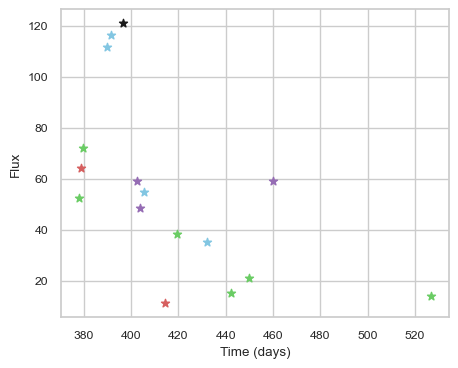

SNIax (3.7804585, False)
SNIax (2.9745858, False)
SNIax (3.0829875, False)
SNIax (3.7263043, False)
SNIax (3.8075483, False)
SNIax (3.2017758, False)
SNIax (3.58951, False)
SNIax (3.033977, False)
SNIax (3.121838, False)
SNIax (3.2861867, False)
SNIax (3.3562927, False)
SNIax (3.3099213, False)
SNIax (3.1079593, False)
SNIax (2.1933627, False)
SNIax (2.604247, False)
SNIax (1.8537871, False)
SNIax (2.0464237, False)
SNIax (1.6494342, False)
SNIax (1.9823563, False)
SNIax (2.1883736, False)
SNIax (2.2411456, False)
SNIax (2.0408494, False)
SNIax (2.2440605, False)
SNIax (2.117772, False)
SNIax (2.1098385, False)
SNIax (2.1819625, False)
SNIax (2.4067512, False)
SNIax (2.2404253, False)
SNIax (2.252269, False)
SNIax (2.332001, False)
SNIax (2.435303, False)
SNIax (2.4922943, False)


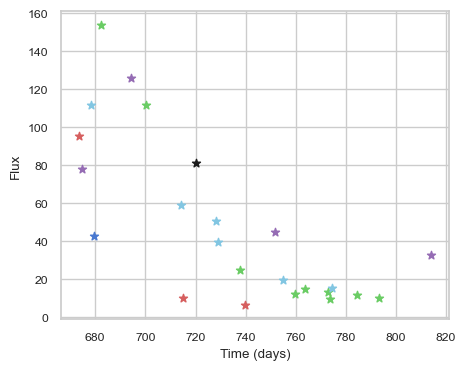

SNIax (3.7757497, False)
SNIax (4.188282, False)
SNIax (4.038377, False)
SNIax (3.8920803, False)
SNIax (4.8785243, False)
SNIax (4.261886, False)
SNIax (4.2943244, False)
SNIax (5.115359, False)
SNIax (4.796276, False)
SNIax (4.7120543, False)
SNIax (4.5485024, False)
SNIax (5.271733, False)
SNIax (4.5257163, False)
SNIax (4.4828467, False)
SNIax (4.0610695, False)
SNIax (3.2677367, False)
SNIax (3.222299, False)
SNIax (3.6372213, False)
SNIax (3.186785, False)
SNIax (4.473803, False)
SNIax (3.1079288, False)
SNIax (2.9838457, False)
SNIax (2.850088, False)
SNIax (2.9138572, False)
SNIax (2.3662333, False)
SNIax (3.102767, False)
SNIax (2.6254892, False)
SNIax (2.1110828, False)
SNIax (2.7495234, False)
SNIax (2.5216599, False)
SNIax (2.4817438, False)
SNIax (2.009861, False)
SNIax (2.0387647, False)
SNIax (1.7066092, False)
SNIax (2.1584425, False)
SNIax (1.7141674, False)
SNIax (1.9427701, False)
SNIax (1.6629933, False)
SNIax (2.3212993, False)
SNIax (1.9313807, False)
SNIax (1.988

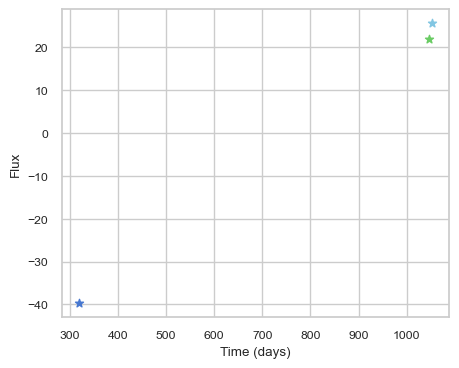

SNIax (3.8266315, False)
SNIax (4.497117, False)
SNIax (4.066156, False)
SNIax (3.76663, False)
SNIax (3.5096676, False)
SNIax (3.8741124, False)


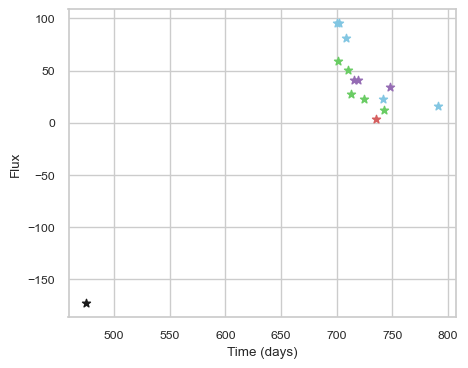

SNIax (3.9602098, False)
SNIax (3.7670257, False)
SNIax (4.081773, False)
SNIax (3.761711, False)
SNIax (4.6794953, False)
SNIax (4.6525903, False)
SNIax (4.2543483, False)
SNIax (4.321139, False)
SNIax (4.522389, False)
SNIax (4.6096773, False)
SNIax (4.4064827, False)
SNIax (4.069428, False)
SNIax (4.242227, False)
SNIax (4.3048925, False)
SNIax (4.59413, False)
SNIax (4.298228, False)
SNIax (4.4192963, False)
SNIax (4.180576, False)
SNIax (3.650796, False)
SNIax (3.5279503, False)
SNIax (3.7540698, False)
SNIax (4.041545, False)
SNIax (4.2737346, False)
SNIax (3.5408509, False)
SNIax (3.2121596, False)
SNIax (3.6887, False)
SNIax (3.6072323, False)
SNIax (3.597841, False)
SNIax (3.7804928, False)
SNIax (3.6277287, False)


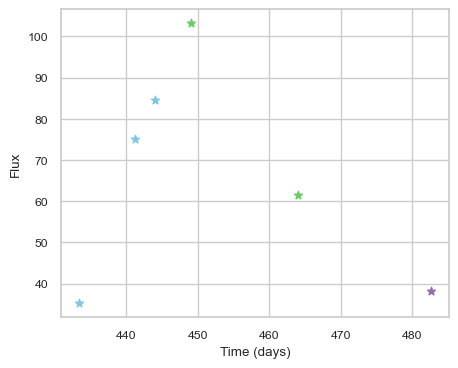

SNIax (3.8405735, False)
SNIax (3.8032293, False)
SNIax (3.2189186, False)
SNIax (3.872372, False)
SNIax (4.256161, False)
SNIax (4.2438617, False)
SNIax (4.273565, False)
SNIax (4.3738914, False)
SNIax (5.0600276, False)
SNIax (4.1867914, False)
SNIax (4.4802895, False)
SNIax (4.0780826, False)


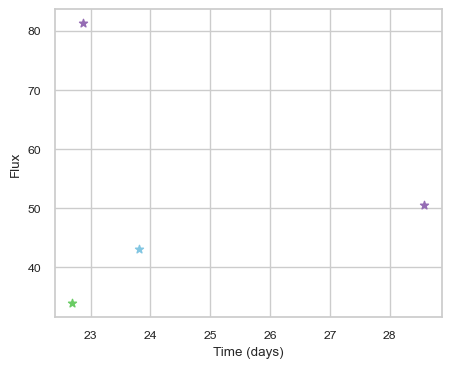

SNIax (4.459859, False)
SNIax (3.8690171, False)
SNIax (3.9308014, False)
SNIax (3.30672, False)
SNIax (4.5716667, False)
SNIax (3.7702804, False)
SNIax (3.913282, False)
SNIax (3.2475917, False)


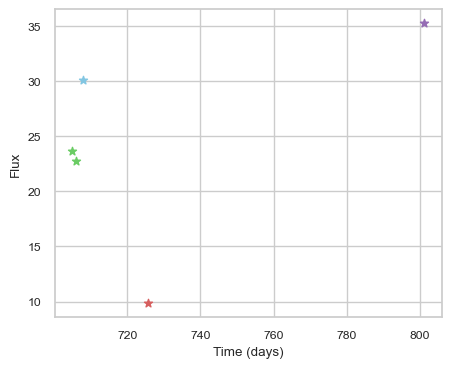

SNIax (3.92573, False)
SNIax (3.307083, False)
SNIax (3.0287015, False)
SNIax (2.6983876, False)
SNIax (2.6922865, False)
SNIax (2.2273767, False)
SNIax (2.7120786, False)
SNIax (2.4647236, False)
SNIax (4.52118, False)
SNIax (3.2046368, False)


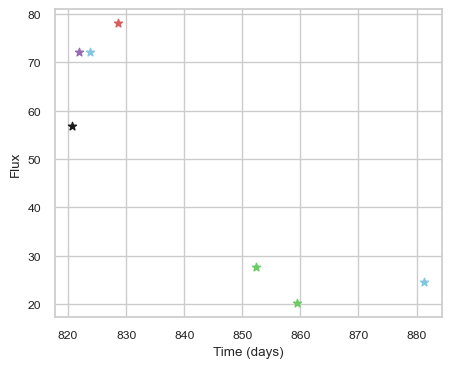

SNIax (3.783894, False)
SNIax (3.626464, False)
SNIax (3.9288242, False)
SNIax (3.6397417, False)
SNIax (3.6807027, False)
SNIax (3.6289778, False)
SNIax (3.636733, False)
SNIax (3.6229708, False)
SNIax (3.4077358, False)
SNIax (3.3127224, False)
SNIax (3.918625, False)
SNIax (4.037817, False)
SNIax (3.1154356, False)
SNIax (3.3202856, False)


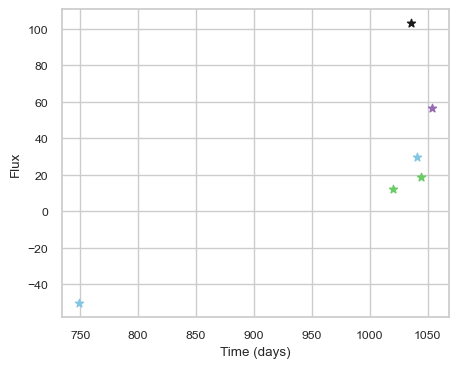

SNIax (4.1650915, False)
SNIax (3.8626325, False)
SNIax (4.1089516, False)
SNIax (3.8262117, False)
SNIax (3.5220299, False)
SNIax (3.9584854, False)
SNIax (3.7956362, False)
SNIax (3.6744483, False)
SNIax (2.9395225, False)
SNIax (3.040085, False)
SNIax (3.4624174, False)
SNIax (3.2136252, False)


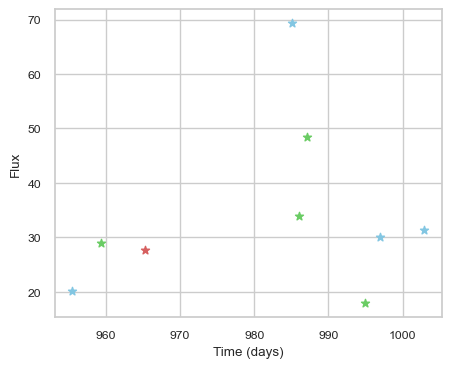

SNIax (3.8215792, False)
SNIax (3.7696352, False)
SNIax (3.3022406, False)
SNIax (3.2343993, False)
SNIax (3.2387314, False)
SNIax (3.4085436, False)
SNIax (3.3207371, False)
SNIax (3.5004313, False)
SNIax (3.8931913, False)
SNIax (3.6777723, False)
SNIax (4.348362, False)
SNIax (3.8773715, False)
SNIax (4.150823, False)
SNIax (3.0916111, False)
SNIax (3.3355184, False)
SNIax (3.4319496, False)
SNIax (2.726799, False)
SNIax (2.9746845, False)


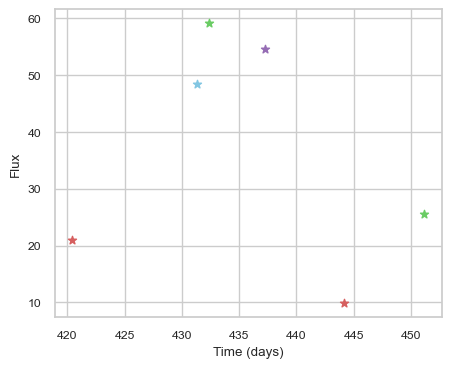

SNIax (4.1348085, False)
SNIax (4.7491684, False)
SNIax (4.0637403, False)
SNIax (3.0082545, False)
SNIax (3.6131186, False)
SNIax (3.3424644, False)
SNIax (3.296185, False)
SNIax (3.219661, False)
SNIax (2.8362248, False)
SNIax (3.080697, False)
SNIax (2.7126095, False)
SNIax (2.1644378, False)


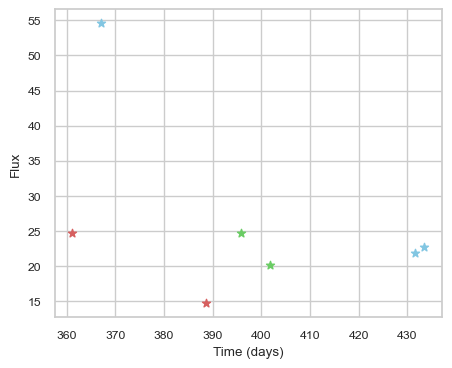

SNIax (3.7345002, False)
SNIax (4.117147, False)
SNIax (3.9397435, False)
SNIax (3.1827545, False)
SNIax (4.5471196, False)
SNIax (4.5718594, False)
SNIax (5.1563954, False)
SNIax (4.2908115, False)
SNIax (4.992355, False)
SNIax (4.279248, False)
SNIax (3.9165716, False)
SNIax (4.2903075, False)
SNIax (4.192949, False)
SNIax (4.2606072, False)


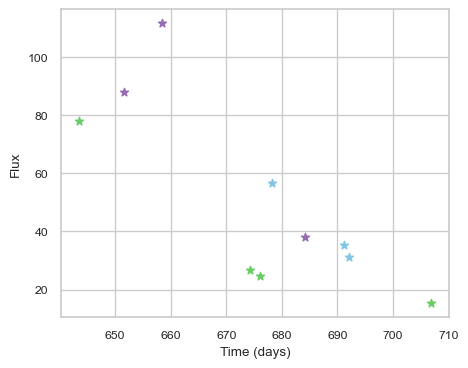

SNIax (3.9742491, False)
SNIax (4.566775, False)
SNIax (4.9711914, False)
SNIax (4.720167, False)
SNIax (4.1761403, False)
SNIax (4.1865454, False)
SNIax (5.7450795, False)
SNIax (5.521023, False)
SNIax (5.06228, False)
SNIax (5.351833, False)
SNIax (5.0926266, False)
SNIax (5.4269643, False)
SNIax (4.9253225, False)
SNIax (5.1136465, False)
SNIax (4.7145963, False)
SNIax (4.7342424, False)
SNIax (4.5125694, False)
SNIax (5.1062746, False)
SNIax (4.5814195, False)
SNIax (4.811923, False)


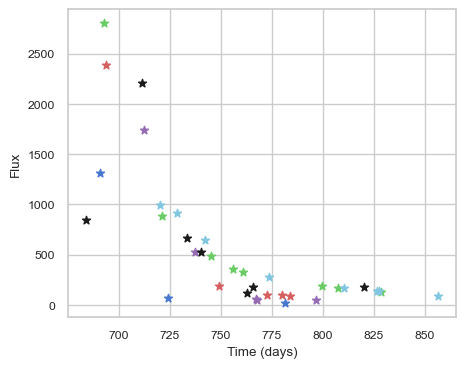

SNIax (5.0193877, False)
SNIax (4.1141567, False)
SNIax (2.4372823, False)
SNIax (3.508316, False)
SNIax (2.1005821, False)
SNIax (2.9029562, False)
SNIax (1.9424005, False)
SNIax (2.4978158, False)
SNIax (2.6032853, False)
SNIax (2.9008257, False)
SNIax (3.4437644, False)
SNIax (2.1502264, False)
SNIax (2.347111, False)
SNIax (2.679452, False)
SNIax (2.4563046, False)
SNIax (3.4069736, False)
SNIax (2.7811391, False)
SNIax (3.505222, False)
SNIax (3.4344208, False)
SNIax (3.7730074, False)
SNIax (3.179234, False)
SNIax (3.9569013, False)
SNIax (3.412613, False)
SNIax (3.1632152, False)
SNIax (3.3982813, False)
SNIax (4.410823, False)
SNIax (3.4699702, False)
SNIax (4.943213, False)
SNIax (3.248465, False)
SNIax (4.160225, False)
SNIax (4.12274, False)
SNIax (5.0956473, False)
SNIax (4.5165176, False)
SNIax (4.9828744, False)
SNIax (4.4634748, False)
SNIax (4.7958155, False)
SNIax (4.438954, False)
SNIax (5.1329794, False)
SNIax (5.2747188, False)
SNIax (4.868211, False)
SNIax (5.03249

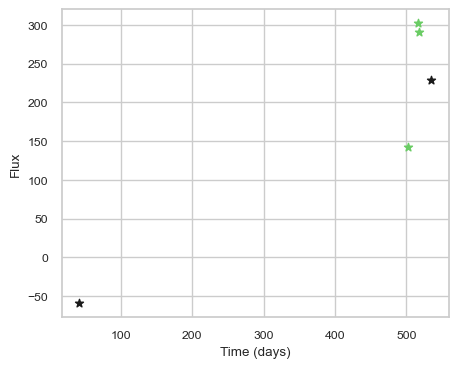

SNIax (3.8795583, False)
SNIax (3.6353009, False)
SNIax (3.7956142, False)
SNIax (4.491512, False)
SNIax (5.792668, False)
SNIax (6.0760717, False)
SNIax (6.3018785, False)
SNIax (6.564525, False)
SNIax (6.4360948, False)
SNIax (6.8082333, False)


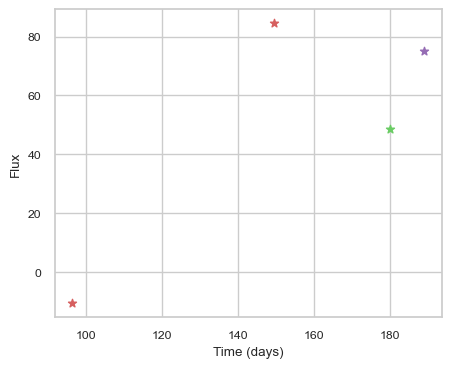

SNIax (3.728483, False)
SNIax (4.6473427, False)
SNIax (4.7368007, False)
SNIax (4.5677586, False)
SNIax (4.1639295, False)
SNIax (3.7463782, False)
SNIax (3.6653883, False)
SNIax (4.813357, False)


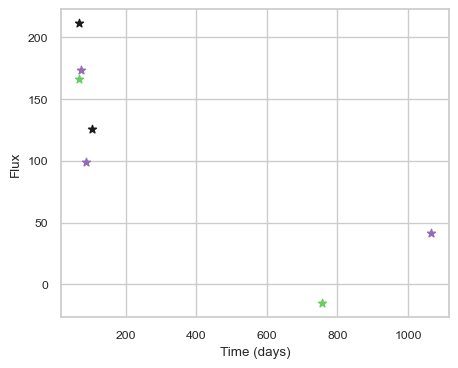

SNIax (4.1350503, False)
SNIax (3.8052177, False)
SNIax (3.7743828, False)
SNIax (3.8594625, False)
SNIax (3.8380122, False)
SNIax (3.3839753, False)
SNIax (3.7535188, False)
SNIax (3.7500925, False)
SNIax (3.6475785, False)
SNIax (3.8203883, False)
SNIax (3.3007174, False)
SNIax (3.9427624, False)
SNIax (3.6074753, False)
SNIax (3.892855, False)


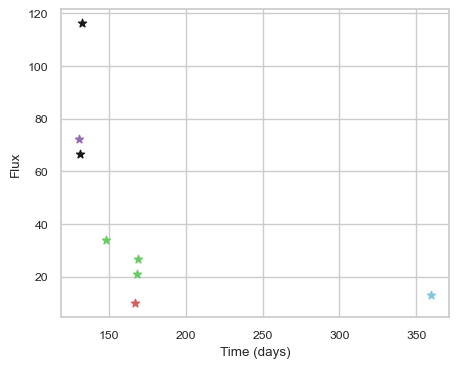

SNIax (3.4925718, False)
SNIax (4.060483, False)
SNIax (3.8937085, False)
SNIax (4.1723886, False)
SNIax (3.8334196, False)
SNIax (3.9031503, False)
SNIax (3.461323, False)
SNIax (4.5269747, False)
SNIax (4.537766, False)
SNIax (4.0837803, False)
SNIax (4.0554605, False)
SNIax (3.9917376, False)
SNIax (3.896168, False)
SNIax (4.6195664, False)
SNIax (3.9254396, False)
SNIax (3.5985568, False)


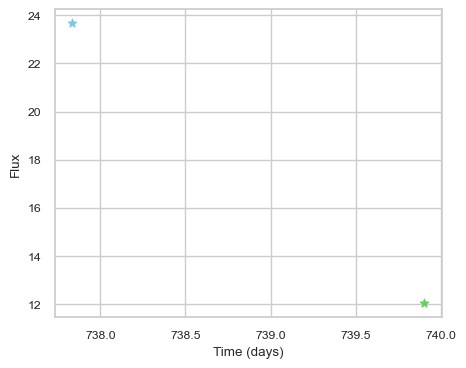

SNIax (4.3403816, False)
SNIax (3.774305, False)
SNIax (3.319184, False)
SNIax (2.8535633, False)


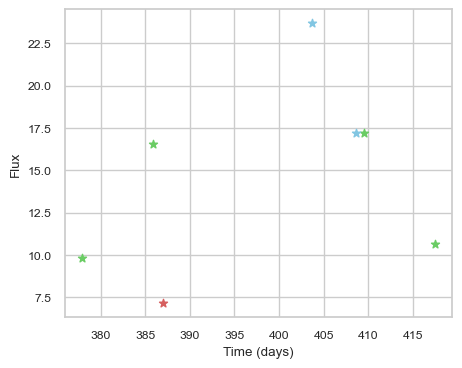

SNIax (4.4126844, False)
SNIax (3.4610896, False)
SNIax (3.470973, False)
SNIax (3.0037014, False)
SNIax (3.052976, False)
SNIax (3.73343, False)
SNIax (2.6222682, False)
SNIax (2.2467637, False)
SNIax (2.3561156, False)
SNIax (2.4207468, False)
SNIax (2.3230536, False)
SNIax (2.412499, False)
SNIax (2.6089315, False)
SNIax (2.8840322, False)


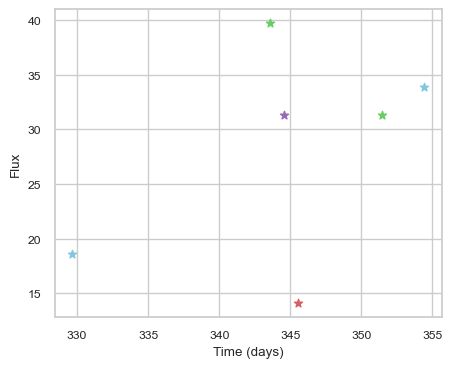

SNIax (3.7880888, False)
SNIax (3.6727102, False)
SNIax (2.9714677, False)
SNIax (2.8957229, False)
SNIax (3.2153802, False)
SNIax (3.1330035, False)
SNIax (3.6994648, False)
SNIax (3.6068301, False)
SNIax (3.0896416, False)
SNIax (2.131821, False)
SNIax (3.3280838, False)
SNIax (2.048504, False)


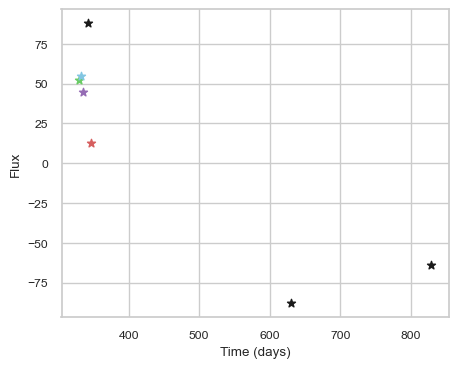

SNIax (4.0415106, False)
SNIax (4.571501, False)
SNIax (4.2644577, False)
SNIax (4.6989903, False)
SNIax (4.61847, False)
SNIax (3.455069, False)
SNIax (3.0893426, False)
SNIax (3.720381, False)
SNIax (3.8180048, False)
SNIax (3.0385234, False)
SNIax (4.5841203, False)
SNIax (4.5174494, False)
SNIax (4.331563, False)
SNIax (4.418755, False)


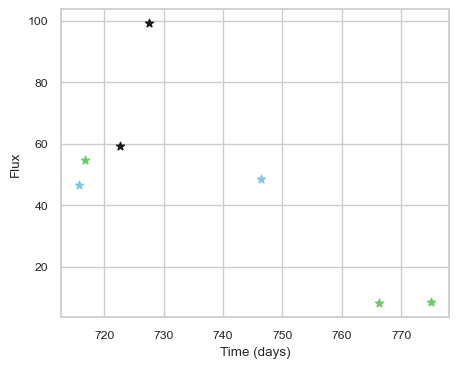

SNIax (3.8854678, False)
SNIax (3.545255, False)
SNIax (3.1711314, False)
SNIax (3.1848733, False)
SNIax (3.6039236, False)
SNIax (3.1360567, False)
SNIax (2.6370876, False)
SNIax (3.1931617, False)
SNIax (3.063923, False)
SNIax (2.6826346, False)
SNIax (4.2458467, False)
SNIax (3.2206385, False)
SNIax (3.1093807, False)
SNIax (2.7765899, False)


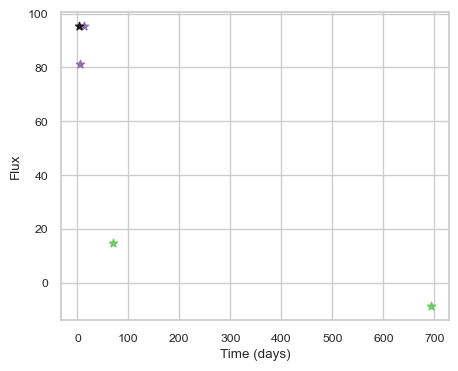

SNIax (4.1273293, False)
SNIax (4.357666, False)
SNIax (4.7375073, False)
SNIax (3.6526258, False)
SNIax (3.5907624, False)
SNIax (3.622322, False)
SNIax (4.170184, False)
SNIax (3.5563958, False)
SNIax (3.6730392, False)
SNIax (3.2266402, False)


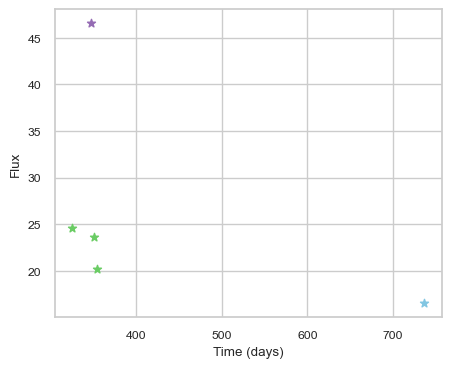

SNIax (4.0350184, False)
SNIax (4.012241, False)
SNIax (3.9281173, False)
SNIax (2.9848652, False)
SNIax (3.4886382, False)
SNIax (3.618244, False)
SNIax (4.2547565, False)
SNIax (3.892408, False)
SNIax (4.6261797, False)
SNIax (4.168577, False)


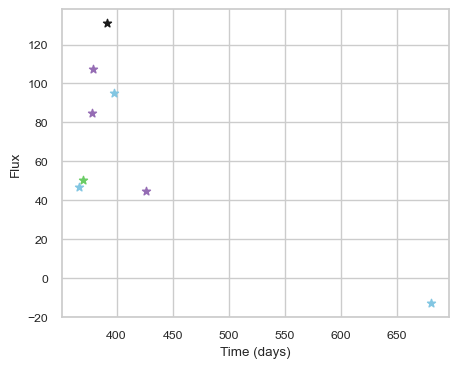

SNIax (3.9375358, False)
SNIax (3.7540343, False)
SNIax (3.4947846, False)
SNIax (3.2901812, False)
SNIax (3.105897, False)
SNIax (3.8191297, False)
SNIax (4.5061646, False)
SNIax (4.343467, False)
SNIax (4.3326025, False)
SNIax (4.147613, False)
SNIax (3.8336234, False)
SNIax (3.2774177, False)
SNIax (3.5228565, False)
SNIax (2.9819832, False)
SNIax (3.7361255, False)
SNIax (3.8113396, False)


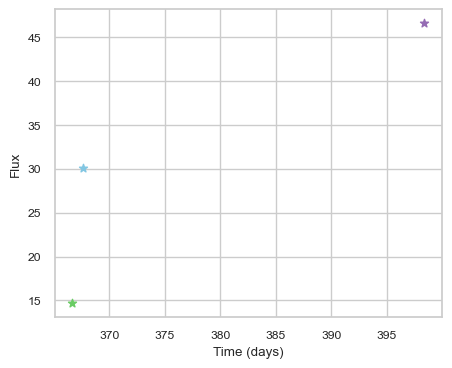

SNIax (4.446183, False)
SNIax (3.4761922, False)
SNIax (3.3179808, False)
SNIax (3.5731814, False)
SNIax (4.4413548, False)
SNIax (4.289993, False)


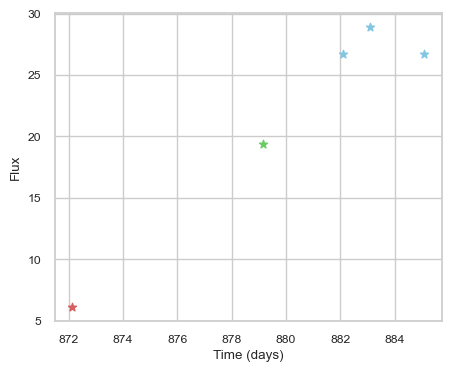

SNIax (5.3758197, False)
SNIax (5.071035, False)
SNIax (5.106388, False)
SNIax (4.745091, False)
SNIax (4.5852513, False)
SNIax (4.6962485, False)
SNIax (5.0024214, False)
SNIax (4.8565316, False)
SNIax (4.767461, False)
SNIax (4.6799526, False)


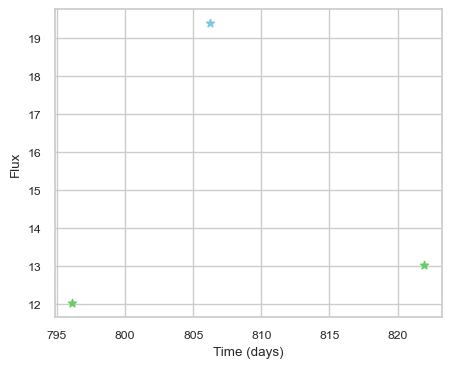

SNIax (4.93091, False)
SNIax (4.176047, False)
SNIax (4.897532, False)
SNIax (4.0155835, False)
SNIax (4.6297255, False)
SNIax (4.785602, False)


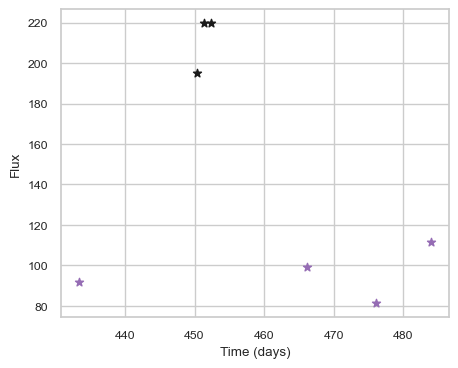

SNIax (4.2959948, False)
SNIax (4.534798, False)
SNIax (4.7192554, False)
SNIax (4.6268883, False)
SNIax (3.9504492, False)
SNIax (4.030157, False)
SNIax (4.265985, False)
SNIax (3.6985915, False)
SNIax (3.7545245, False)
SNIax (3.5717206, False)
SNIax (3.7546778, False)
SNIax (3.908525, False)
SNIax (3.5908918, False)
SNIax (4.0581646, False)


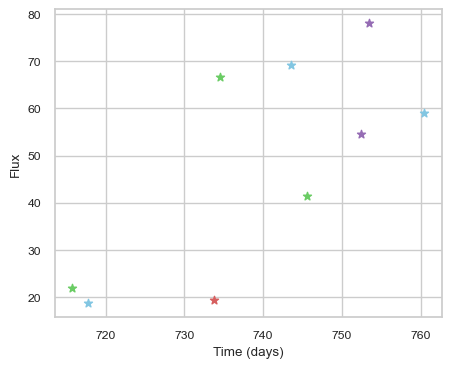

SNIax (3.933463, False)
SNIax (3.4377651, False)
SNIax (3.4115975, False)
SNIax (3.3439085, False)
SNIax (3.5616012, False)
SNIax (3.7228322, False)
SNIax (4.132862, False)
SNIax (2.3172162, False)
SNIax (3.7476635, False)
SNIax (3.435035, False)
SNIax (4.31313, False)
SNIax (3.472083, False)
SNIax (4.2482214, False)
SNIax (3.1892755, False)
SNIax (5.091744, False)
SNIax (3.7960253, False)
SNIax (4.022151, False)
SNIax (4.085176, False)


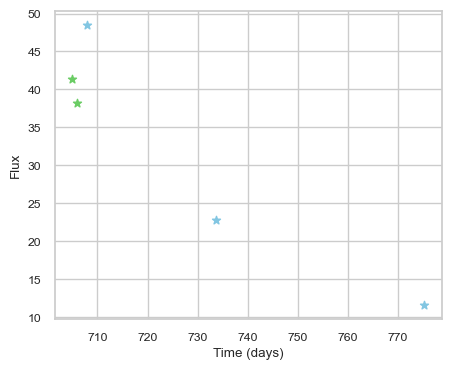

SNIax (3.882292, False)
SNIax (3.383273, False)
SNIax (2.9472241, False)
SNIax (3.046895, False)
SNIax (2.9772477, False)
SNIax (3.2853968, False)
SNIax (3.4561915, False)
SNIax (2.3731856, False)
SNIax (3.5998936, False)
SNIax (3.7145536, False)


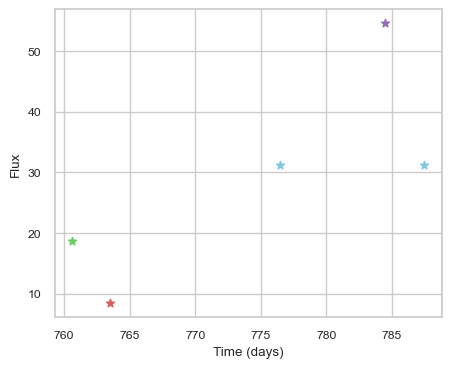

SNIax (4.3267655, False)
SNIax (3.3164265, False)
SNIax (3.224977, False)
SNIax (3.0995045, False)
SNIax (3.282504, False)
SNIax (3.267309, False)
SNIax (2.8634584, False)
SNIax (3.28036, False)
SNIax (3.0999057, False)
SNIax (2.8149137, False)


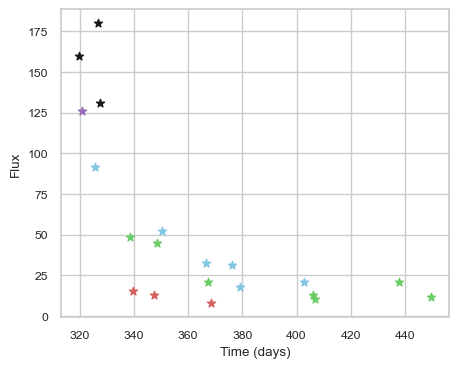

SNIax (3.670686, False)
SNIax (3.9844828, False)
SNIax (4.01411, False)
SNIax (3.8782618, False)
SNIax (3.8271685, False)
SNIax (3.6705983, False)
SNIax (3.8379798, False)
SNIax (4.0807657, False)
SNIax (4.534935, False)
SNIax (4.565477, False)
SNIax (3.8582103, False)
SNIax (4.4422493, False)
SNIax (4.1518126, False)
SNIax (4.402906, False)
SNIax (4.370861, False)
SNIax (4.135484, False)
SNIax (4.1281776, False)
SNIax (4.435065, False)
SNIax (4.17236, False)
SNIax (3.9294934, False)
SNIax (3.4879482, False)
SNIax (3.4955091, False)
SNIax (3.301008, False)
SNIax (3.467487, False)
SNIax (3.9458115, False)
SNIax (3.19281, False)
SNIax (3.5887249, False)
SNIax (3.182582, False)
SNIax (3.3247054, False)
SNIax (3.0219893, False)
SNIax (2.9555697, False)
SNIax (2.9811065, False)
SNIax (2.878689, False)
SNIax (2.9133863, False)
SNIax (3.024809, False)
SNIax (3.1040878, False)
SNIax (3.3763387, False)
SNIax (3.037246, False)
SNIax (3.1248212, False)
SNIax (3.2396426, False)


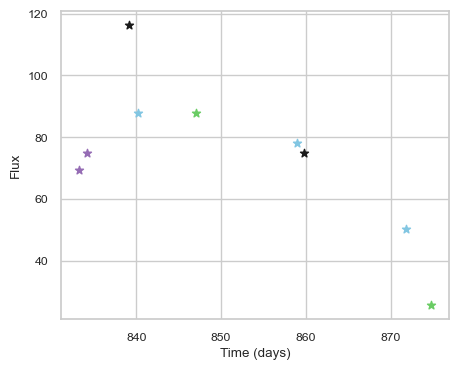

SNIax (3.654811, False)
SNIax (3.4648247, False)
SNIax (3.729428, False)
SNIax (4.0536375, False)
SNIax (3.562127, False)
SNIax (3.8864348, False)
SNIax (3.9287298, False)
SNIax (3.3498552, False)
SNIax (3.7938917, False)
SNIax (3.2278018, False)
SNIax (3.4350934, False)
SNIax (3.2861989, False)
SNIax (3.6061249, False)
SNIax (3.677529, False)
SNIax (3.7652771, False)
SNIax (3.437855, False)
SNIax (3.3220294, False)
SNIax (3.4199245, False)


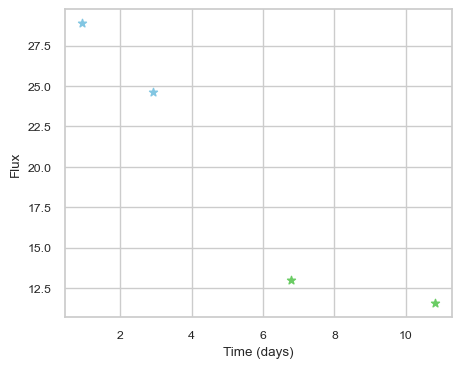

SNIax (4.869273, False)
SNIax (4.8324623, False)
SNIax (4.947937, False)
SNIax (5.2257624, False)
SNIax (4.957896, False)
SNIax (5.3304257, False)
SNIax (5.160855, False)
SNIax (5.1140704, False)


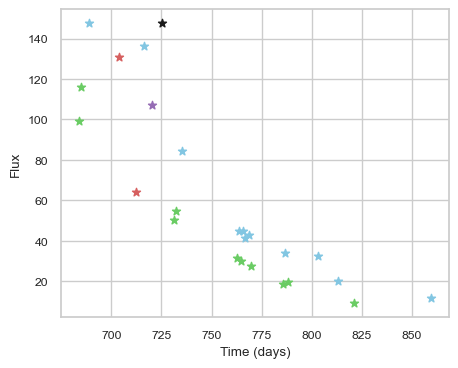

SNIax (3.739122, False)
SNIax (4.2943587, False)
SNIax (3.696127, False)
SNIax (4.6299133, False)
SNIax (4.220517, False)
SNIax (4.2487607, False)
SNIax (3.551169, False)
SNIax (3.5303514, False)
SNIax (3.6375492, False)
SNIax (3.8126717, False)
SNIax (4.3522806, False)
SNIax (4.325921, False)
SNIax (4.5876007, False)
SNIax (4.809913, False)
SNIax (5.1600823, False)
SNIax (4.4673076, False)
SNIax (3.9027548, False)
SNIax (5.1095667, False)
SNIax (4.708668, False)
SNIax (5.003844, False)
SNIax (4.716133, False)
SNIax (5.2056394, False)
SNIax (5.269873, False)
SNIax (4.7503266, False)
SNIax (4.589726, False)
SNIax (4.9898906, False)
SNIax (4.8214827, False)
SNIax (5.003221, False)
SNIax (4.7720513, False)
SNIax (5.18811, False)
SNIax (4.9255023, False)
SNIax (5.067668, False)
SNIax (4.859652, False)
SNIax (4.696444, False)
SNIax (4.3669486, False)
SNIax (4.5333877, False)
SNIax (4.8641825, False)
SNIax (5.3041954, False)
SNIax (4.87976, False)
SNIax (4.8341346, False)
SNIax (4.877951, Fa

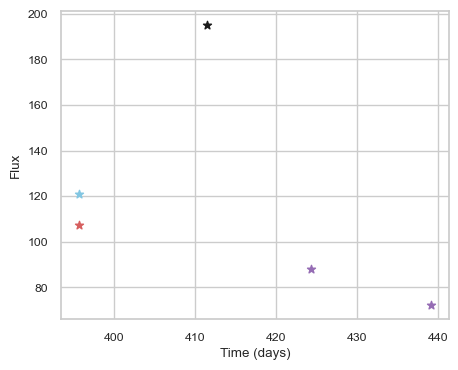

SNIax (3.972856, False)
SNIax (4.519088, False)
SNIax (5.2757425, False)
SNIax (4.4278326, False)
SNIax (4.787979, False)
SNIax (3.9440205, False)
SNIax (3.7568285, False)
SNIax (3.3642964, False)
SNIax (3.8646193, False)
SNIax (3.9482336, False)


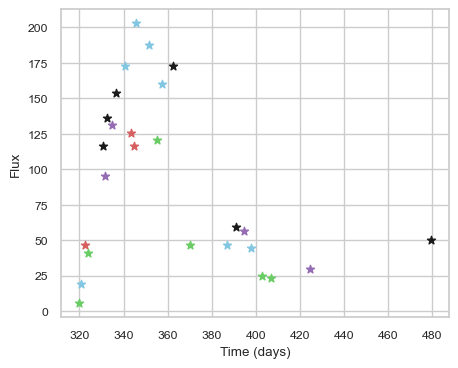

SNIax (3.7815666, False)
SNIax (3.858815, False)
SNIax (3.3546436, False)
SNIax (3.1755712, False)
SNIax (3.3619277, False)
SNIax (3.6261127, False)
SNIax (4.408057, False)
SNIax (4.162492, False)
SNIax (4.310995, False)
SNIax (3.9521365, False)
SNIax (4.0478086, False)
SNIax (3.2529771, False)
SNIax (3.9844544, False)
SNIax (3.340687, False)
SNIax (3.9293115, False)
SNIax (3.2869995, False)
SNIax (3.8946915, False)
SNIax (3.0745006, False)
SNIax (3.5623791, False)
SNIax (2.992042, False)
SNIax (2.6304445, False)
SNIax (2.257406, False)
SNIax (2.7632892, False)
SNIax (2.441131, False)
SNIax (2.6383247, False)
SNIax (2.214473, False)
SNIax (2.3773565, False)
SNIax (1.9918232, False)
SNIax (2.3802679, False)
SNIax (2.0873783, False)
SNIax (2.1578999, False)
SNIax (2.2204974, False)
SNIax (2.4829998, False)
SNIax (2.360516, False)
SNIax (2.731691, False)
SNIax (2.553846, False)
SNIax (3.6508038, False)
SNIax (3.035964, False)
SNIax (3.6483414, False)
SNIax (3.3121343, False)
SNIax (3.2765

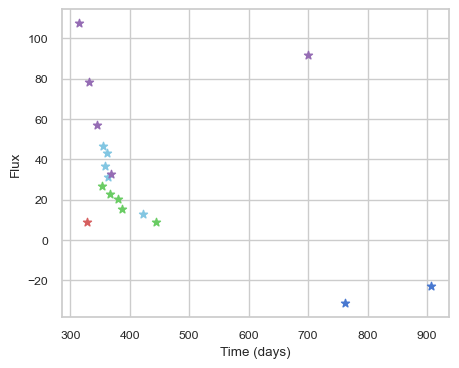

SNIax (3.9995723, False)
SNIax (4.2750783, False)
SNIax (5.018336, False)
SNIax (5.2247405, False)
SNIax (5.714114, False)
SNIax (5.1775155, False)
SNIax (5.648096, False)
SNIax (5.277144, False)
SNIax (5.110507, False)
SNIax (4.408594, False)
SNIax (4.9895325, False)
SNIax (5.03636, False)
SNIax (5.0982065, False)
SNIax (4.900335, False)
SNIax (4.678191, False)
SNIax (4.760092, False)
SNIax (4.392321, False)
SNIax (4.66937, False)
SNIax (4.571614, False)
SNIax (4.6209135, False)
SNIax (4.582968, False)
SNIax (5.1027155, False)
SNIax (4.0922513, False)
SNIax (4.545772, False)
SNIax (4.7306695, False)
SNIax (4.6691923, False)
SNIax (4.5539713, False)
SNIax (4.4974327, False)
SNIax (4.719595, False)
SNIax (4.5202947, False)
SNIax (5.2215767, False)
SNIax (4.245806, False)
SNIax (5.595849, False)
SNIax (5.9409523, False)
SNIax (6.8613977, False)
SNIax (6.7315235, False)


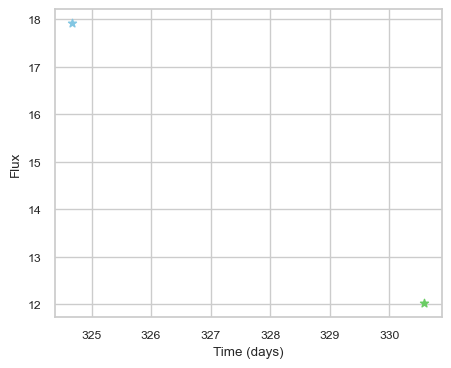

SNIax (3.7883887, False)
SNIax (3.7070942, False)
SNIax (3.4846582, False)
SNIax (4.0027013, False)


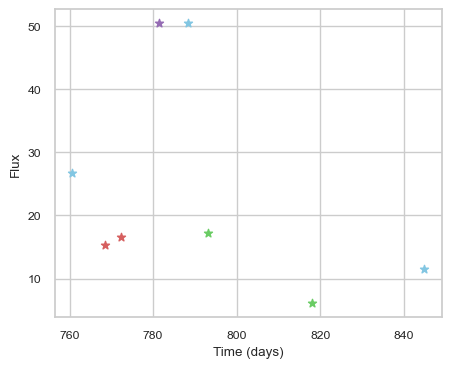

SNIax (3.9909284, False)
SNIax (3.3375995, False)
SNIax (3.2284796, False)
SNIax (2.9830136, False)
SNIax (2.6523337, False)
SNIax (2.2199016, False)
SNIax (2.7427833, False)
SNIax (2.165841, False)
SNIax (2.442357, False)
SNIax (2.829655, False)
SNIax (3.049235, False)
SNIax (2.4346275, False)
SNIax (2.5053275, False)
SNIax (2.5677538, False)
SNIax (2.512878, False)
SNIax (2.6295338, False)


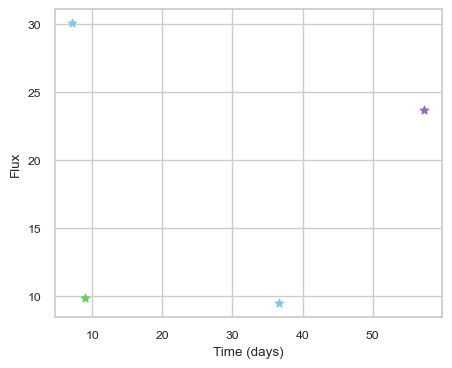

SNIax (3.8248518, False)
SNIax (2.76452, False)
SNIax (3.475574, False)
SNIax (3.78861, False)
SNIax (3.668669, False)
SNIax (3.8217044, False)
SNIax (3.8088942, False)
SNIax (3.7527347, False)


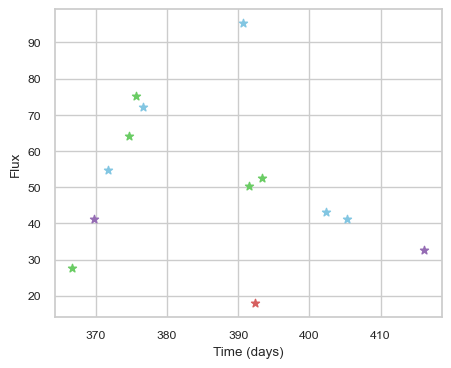

SNIax (3.879408, False)
SNIax (3.1985834, False)
SNIax (2.8810349, False)
SNIax (2.697945, False)
SNIax (3.074701, False)
SNIax (2.8642993, False)
SNIax (3.750877, False)
SNIax (3.2231958, False)
SNIax (3.5789082, False)
SNIax (3.3896806, False)
SNIax (4.122175, False)
SNIax (3.9242074, False)
SNIax (4.096141, False)
SNIax (4.053076, False)
SNIax (4.344729, False)
SNIax (4.2645426, False)
SNIax (4.1463423, False)
SNIax (4.81334, False)
SNIax (5.039417, False)
SNIax (4.618229, False)
SNIax (4.603453, False)
SNIax (4.556491, False)
SNIax (4.781215, False)
SNIax (4.5110908, False)
SNIax (4.493511, False)
SNIax (4.4299417, False)


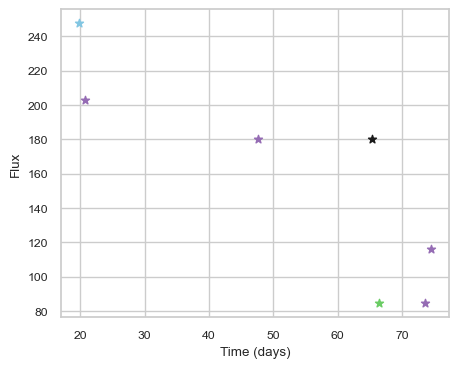

SNIax (3.800507, False)
SNIax (3.52447, False)
SNIax (4.115442, False)
SNIax (4.3550005, False)
SNIax (3.4841208, False)
SNIax (3.4324813, False)
SNIax (3.4250689, False)
SNIax (3.327446, False)
SNIax (3.5194542, False)
SNIax (3.628367, False)
SNIax (3.784091, False)
SNIax (3.7033, False)
SNIax (3.7593133, False)
SNIax (3.530478, False)


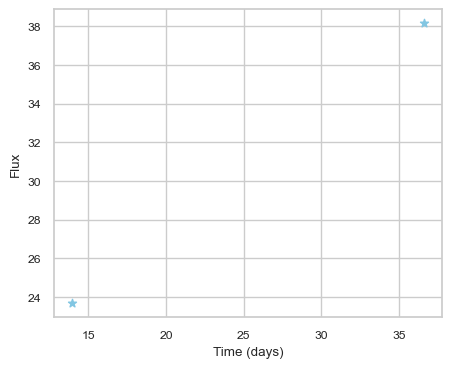

SNIax (4.0185237, False)
SNIax (3.6912367, False)
SNIax (3.4239328, False)
SNIax (3.3250494, False)


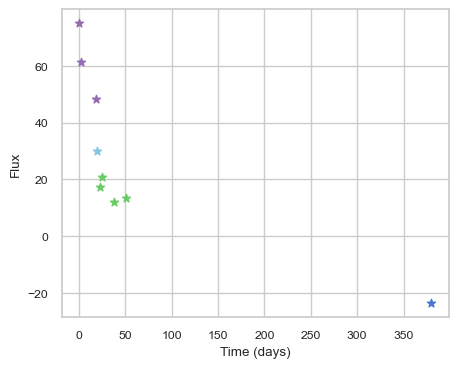

SNIax (4.199339, False)
SNIax (4.3782606, False)
SNIax (4.8301754, False)
SNIax (4.3611298, False)
SNIax (5.0991497, False)
SNIax (4.304642, False)
SNIax (4.86104, False)
SNIax (3.9060986, False)
SNIax (4.607027, False)
SNIax (4.472928, False)
SNIax (4.594855, False)
SNIax (4.128815, False)
SNIax (4.423877, False)
SNIax (4.07645, False)
SNIax (4.255359, False)
SNIax (4.110027, False)
SNIax (5.4691796, False)


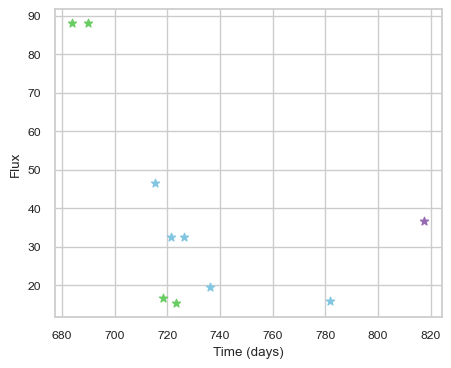

SNIax (3.8431501, False)
SNIax (4.4102683, False)
SNIax (5.0121393, False)
SNIax (5.1458592, False)
SNIax (4.950552, False)
SNIax (4.9674287, False)
SNIax (5.182488, False)
SNIax (4.583613, False)
SNIax (4.5694866, False)
SNIax (4.681268, False)
SNIax (4.6263866, False)
SNIax (4.17724, False)
SNIax (4.491143, False)
SNIax (4.366603, False)
SNIax (4.0081387, False)
SNIax (4.254549, False)
SNIax (4.8211446, False)
SNIax (4.574617, False)
SNIax (4.932471, False)
SNIax (4.5963554, False)


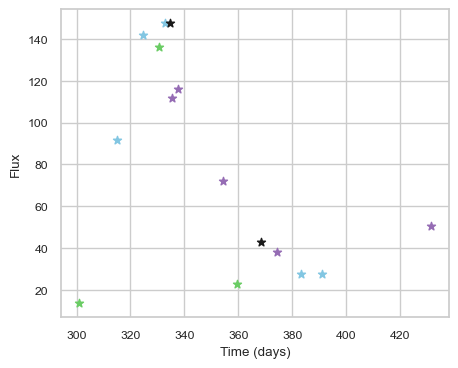

SNIax (3.8299434, False)
SNIax (3.8897245, False)
SNIax (3.1158097, False)
SNIax (4.3211083, False)
SNIax (3.1162443, False)
SNIax (3.2798555, False)
SNIax (3.1042771, False)
SNIax (2.7272437, False)
SNIax (3.155676, False)
SNIax (3.5055265, False)
SNIax (3.27885, False)
SNIax (3.4793172, False)
SNIax (3.835477, False)
SNIax (2.877326, False)
SNIax (3.4112036, False)
SNIax (3.3395674, False)
SNIax (3.5003693, False)
SNIax (3.689035, False)
SNIax (4.093618, False)
SNIax (3.8077388, False)
SNIax (3.6861992, False)
SNIax (4.3916736, False)
SNIax (3.6477466, False)
SNIax (3.5690894, False)
SNIax (3.0212383, False)
SNIax (3.4865272, False)
SNIax (3.2203586, False)
SNIax (3.397706, False)
SNIax (3.459247, False)
SNIax (3.0974324, False)


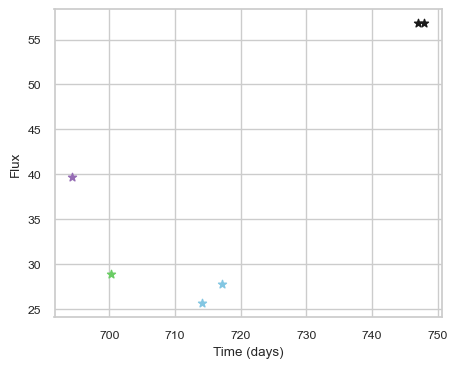

SNIax (4.3631616, False)
SNIax (4.1306987, False)
SNIax (4.3656645, False)
SNIax (4.3418446, False)
SNIax (4.401137, False)
SNIax (3.5892227, False)
SNIax (3.8362758, False)
SNIax (3.2853177, False)
SNIax (4.948901, False)
SNIax (4.886732, False)
SNIax (4.841361, False)
SNIax (5.541609, False)


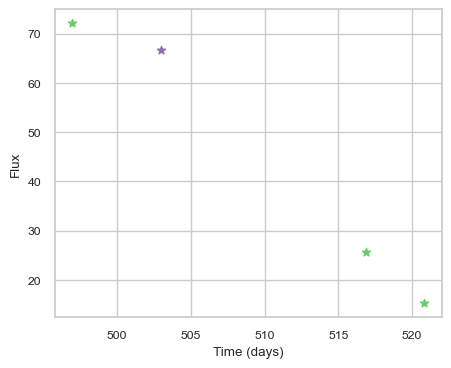

SNIax (3.8505638, False)
SNIax (4.509249, False)
SNIax (4.6524415, False)
SNIax (4.277885, False)
SNIax (3.7352915, False)
SNIax (3.4436932, False)
SNIax (3.6503134, False)
SNIax (3.0212967, False)


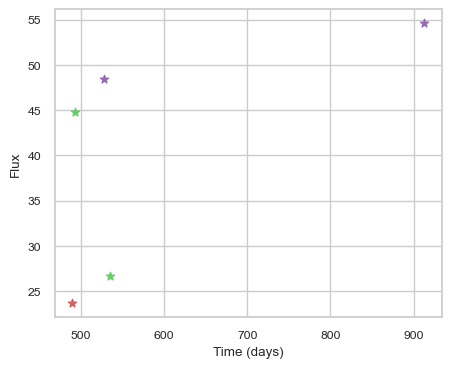

SNIax (3.696686, False)
SNIax (4.725096, False)
SNIax (3.8292844, False)
SNIax (3.416103, False)
SNIax (3.5553982, False)
SNIax (4.4470654, False)
SNIax (3.2516842, False)
SNIax (3.5118856, False)
SNIax (3.934648, False)
SNIax (4.372579, False)


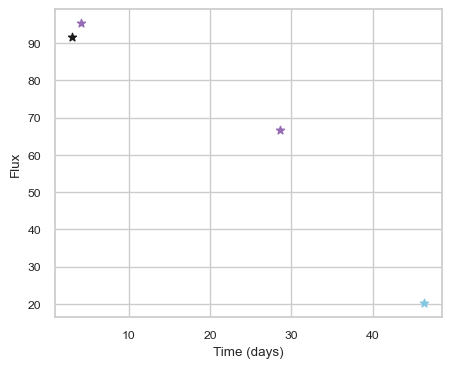

SNIax (4.401447, False)
SNIax (4.4559884, False)
SNIax (4.949846, False)
SNIax (5.13176, False)
SNIax (4.914463, False)
SNIax (3.8647594, False)
SNIax (5.369203, False)
SNIax (4.081877, False)


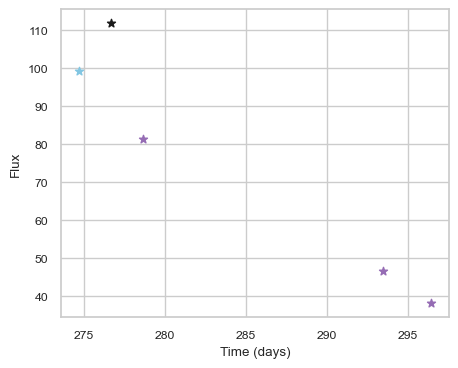

SNIax (4.0303326, False)
SNIax (4.646653, False)
SNIax (5.0060644, False)
SNIax (4.917444, False)
SNIax (5.546133, False)
SNIax (4.4151335, False)
SNIax (4.498678, False)
SNIax (3.9949455, False)
SNIax (4.815247, False)
SNIax (4.469951, False)


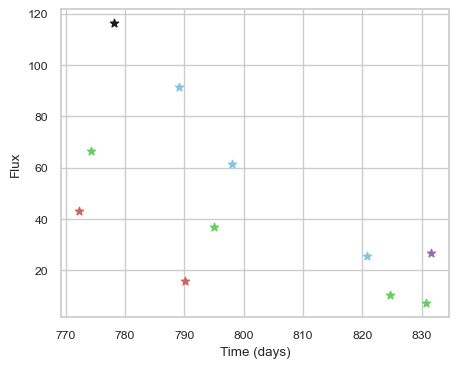

SNIax (3.8786852, False)
SNIax (4.5120144, False)
SNIax (4.46565, False)
SNIax (3.8744087, False)
SNIax (3.642643, False)
SNIax (3.5987332, False)
SNIax (3.4011402, False)
SNIax (3.2117975, False)
SNIax (3.2122324, False)
SNIax (2.8619153, False)
SNIax (3.5746233, False)
SNIax (3.6279957, False)
SNIax (3.7905066, False)
SNIax (3.3243294, False)
SNIax (3.2622354, False)
SNIax (3.0287576, False)
SNIax (2.8009858, False)
SNIax (3.1079895, False)
SNIax (3.04908, False)
SNIax (3.2359376, False)
SNIax (3.0417569, False)
SNIax (3.138391, False)


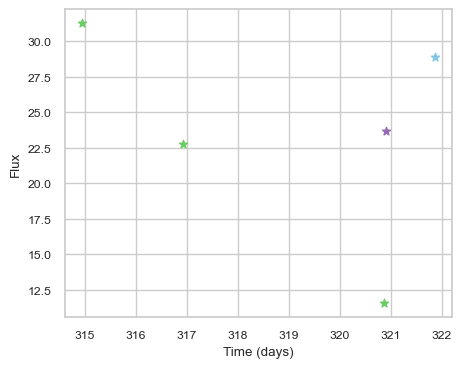

SNIax (3.6067157, False)
SNIax (3.832856, False)
SNIax (3.4971595, False)
SNIax (4.0994983, False)
SNIax (3.9753795, False)
SNIax (4.2568526, False)
SNIax (3.4512916, False)
SNIax (3.978613, False)
SNIax (4.2547946, False)
SNIax (3.6787705, False)


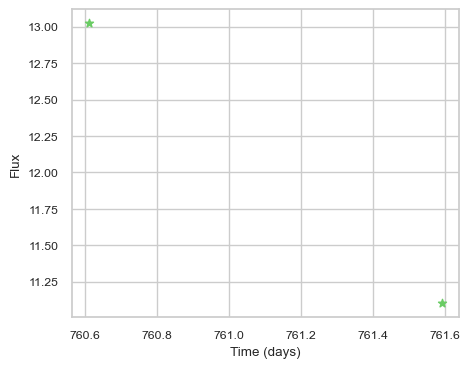

SNIax (5.018332, False)
SNIax (4.095173, False)
SNIax (4.0553746, False)
SNIax (4.023589, False)


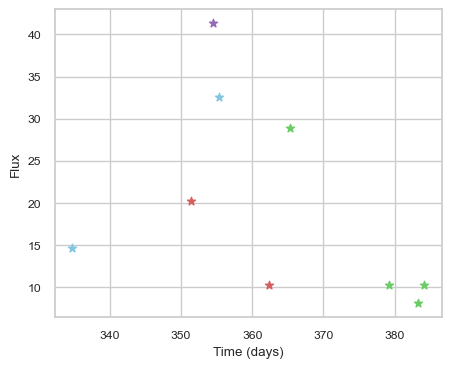

SNIax (3.9600646, False)
SNIax (3.7027478, False)
SNIax (3.4108675, False)
SNIax (3.7730434, False)
SNIax (3.2304356, False)
SNIax (3.7326572, False)
SNIax (3.9430907, False)
SNIax (3.6281714, False)
SNIax (3.894262, False)
SNIax (3.365405, False)
SNIax (3.6581438, False)
SNIax (3.0975795, False)
SNIax (4.0760283, False)
SNIax (3.471166, False)
SNIax (3.7442942, False)
SNIax (2.9808962, False)
SNIax (3.1708992, False)
SNIax (3.0051262, False)


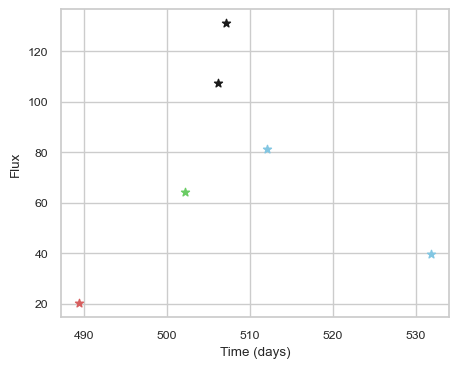

SNIax (4.0640125, False)
SNIax (4.687767, False)
SNIax (4.0040207, False)
SNIax (3.7305949, False)
SNIax (3.8639164, False)
SNIax (3.9417443, False)
SNIax (4.161286, False)
SNIax (4.0756474, False)
SNIax (4.3110504, False)
SNIax (3.933231, False)
SNIax (4.6920333, False)
SNIax (4.1204515, False)


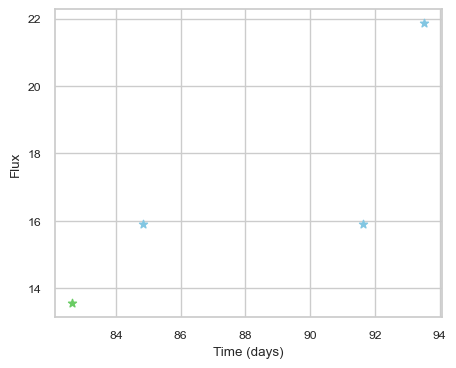

SNIax (5.0794535, False)
SNIax (4.261326, False)
SNIax (3.7862527, False)
SNIax (3.8401022, False)
SNIax (3.2229106, False)
SNIax (3.6318092, False)
SNIax (3.1740205, False)
SNIax (3.173667, False)


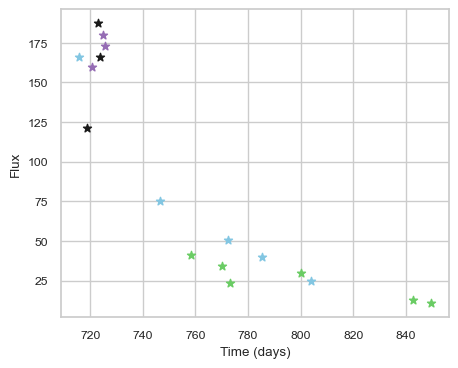

SNIax (3.8479185, False)
SNIax (3.750527, False)
SNIax (4.8632736, False)
SNIax (4.34296, False)
SNIax (5.5608344, False)
SNIax (4.3720202, False)
SNIax (5.77359, False)
SNIax (5.0929475, False)
SNIax (4.8736825, False)
SNIax (3.9207025, False)
SNIax (5.0976195, False)
SNIax (3.1032927, False)
SNIax (5.240469, False)
SNIax (3.229455, False)
SNIax (4.233878, False)
SNIax (4.1953244, False)
SNIax (4.7319217, False)
SNIax (4.1062846, False)
SNIax (4.3161397, False)
SNIax (4.0524535, False)
SNIax (4.2719626, False)
SNIax (4.549507, False)
SNIax (4.331325, False)
SNIax (4.290486, False)
SNIax (4.5539227, False)
SNIax (4.1965594, False)
SNIax (4.675825, False)
SNIax (4.498048, False)
SNIax (4.4441433, False)
SNIax (4.1020007, False)
SNIax (4.653052, False)
SNIax (4.299741, False)
SNIax (4.577947, False)
SNIax (4.2841554, False)


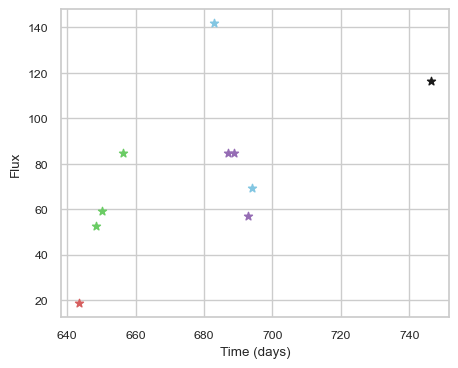

SNIax (4.0525494, False)
SNIax (4.7597575, False)
SNIax (4.6648173, False)
SNIax (3.6017008, False)
SNIax (4.0039525, False)
SNIax (3.6046047, False)
SNIax (4.58219, False)
SNIax (4.599428, False)
SNIax (4.7254076, False)
SNIax (5.6806192, False)
SNIax (5.239772, False)
SNIax (5.2878437, False)
SNIax (5.744925, False)
SNIax (5.522039, False)
SNIax (5.958403, False)
SNIax (5.4775934, False)
SNIax (5.9779243, False)
SNIax (5.6697598, False)
SNIax (5.774475, False)
SNIax (5.836983, False)


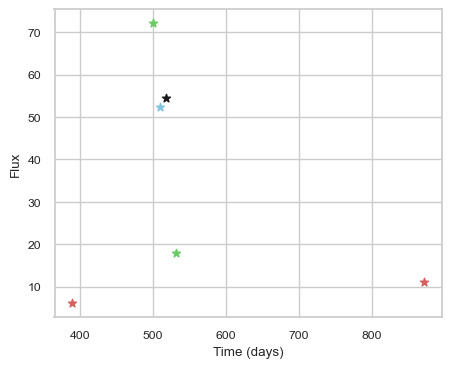

SNIax (3.8328848, False)
SNIax (3.8727531, False)
SNIax (3.4192524, False)
SNIax (3.6489346, False)
SNIax (3.0904565, False)
SNIax (2.2597551, False)
SNIax (2.283528, False)
SNIax (2.6769273, False)
SNIax (2.9777331, False)
SNIax (2.5875363, False)
SNIax (3.0915387, False)
SNIax (2.820757, False)


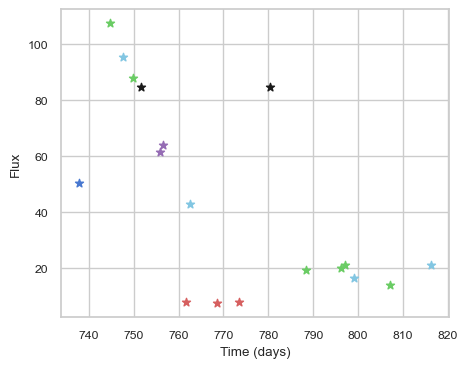

SNIax (3.6602979, False)
SNIax (4.5074964, False)
SNIax (3.7149055, False)
SNIax (3.3716714, False)
SNIax (3.8887112, False)
SNIax (3.178806, False)
SNIax (3.3799617, False)
SNIax (3.9710364, False)
SNIax (4.0092516, False)
SNIax (4.602326, False)
SNIax (4.11389, False)
SNIax (3.62173, False)
SNIax (2.793051, False)
SNIax (2.474361, False)
SNIax (2.4951448, False)
SNIax (2.1190665, False)
SNIax (2.1898682, False)
SNIax (1.4081002, False)
SNIax (1.553118, False)
SNIax (1.7819767, False)
SNIax (2.0288382, False)
SNIax (2.03394, False)
SNIax (2.2813342, False)
SNIax (1.9442717, False)
SNIax (2.9500108, False)
SNIax (1.9464275, False)
SNIax (1.9445255, False)
SNIax (1.8564017, False)
SNIax (2.1679742, False)
SNIax (2.207009, False)
SNIax (2.2820075, False)
SNIax (1.8643321, False)
SNIax (1.6233681, False)
SNIax (2.135932, False)
SNIax (1.920898, False)
SNIax (1.795041, False)


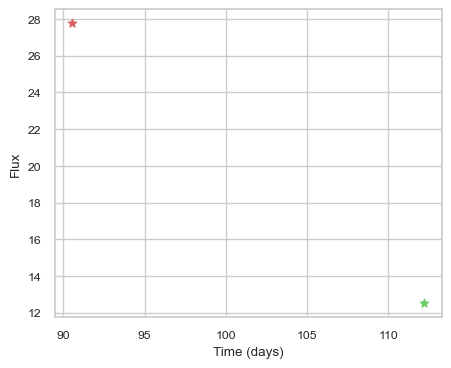

SNIax (3.975368, False)
SNIax (4.179231, False)
SNIax (3.5690165, False)
SNIax (4.2471776, False)


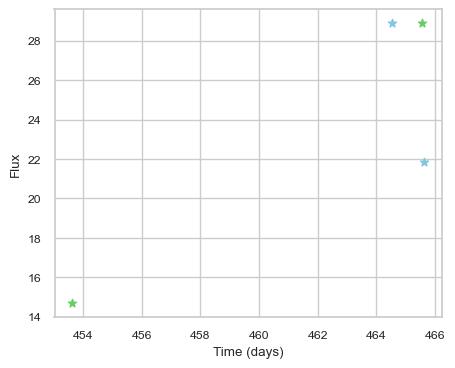

SNIax (5.0983615, False)
SNIax (3.96879, False)
SNIax (4.0214953, False)
SNIax (3.6659892, False)
SNIax (3.072677, False)
SNIax (3.1268451, False)
SNIax (3.2876294, False)
SNIax (2.7196064, False)


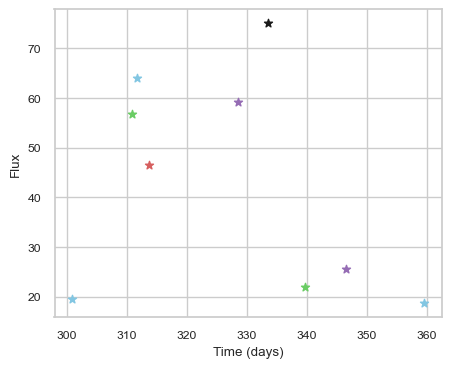

SNIax (3.8629444, False)
SNIax (3.803026, False)
SNIax (2.8844376, False)
SNIax (2.6855514, False)
SNIax (3.0052698, False)
SNIax (2.790145, False)
SNIax (3.4338744, False)
SNIax (3.0294585, False)
SNIax (3.3227057, False)
SNIax (2.1325033, False)
SNIax (2.9449825, False)
SNIax (2.833319, False)
SNIax (4.2940564, False)
SNIax (3.9693127, False)
SNIax (3.9745686, False)
SNIax (3.995096, False)
SNIax (4.140976, False)
SNIax (3.0546527, False)


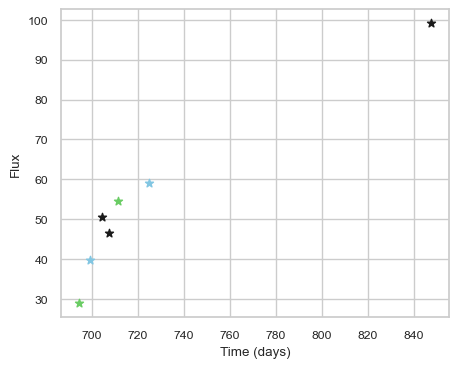

SNIax (4.019175, False)
SNIax (3.7914448, False)
SNIax (3.2485394, False)
SNIax (3.240531, False)
SNIax (3.3771152, False)
SNIax (3.791088, False)
SNIax (3.792843, False)
SNIax (3.4214559, False)
SNIax (3.250218, False)
SNIax (3.5762131, False)
SNIax (4.349544, False)
SNIax (4.213167, False)
SNIax (4.712925, False)
SNIax (4.3269677, False)


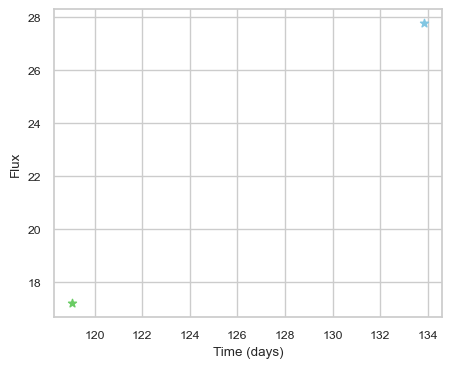

SNIax (3.8177505, False)
SNIax (3.6795614, False)
SNIax (3.2563071, False)
SNIax (3.5492709, False)


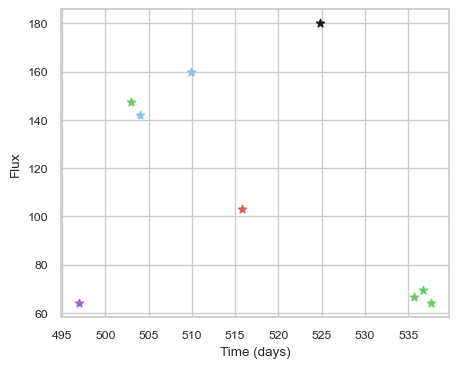

SNIax (3.7446876, False)
SNIax (3.9274924, False)
SNIax (3.5486362, False)
SNIax (3.8260722, False)
SNIax (3.4348292, False)
SNIax (3.330923, False)
SNIax (3.7528036, False)
SNIax (3.23697, False)
SNIax (3.541683, False)
SNIax (3.353241, False)
SNIax (3.3857145, False)
SNIax (3.678328, False)
SNIax (4.2902994, False)
SNIax (3.51583, False)
SNIax (3.3417509, False)
SNIax (4.147954, False)
SNIax (3.4134078, False)
SNIax (4.4143414, False)


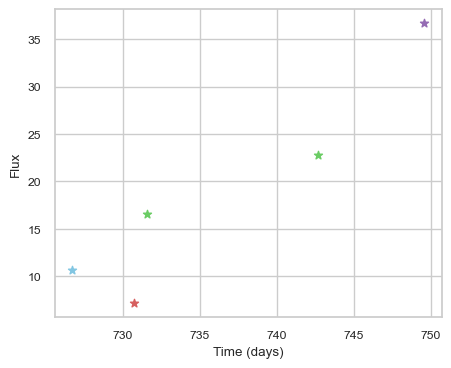

SNIax (4.1379943, False)
SNIax (3.9520187, False)
SNIax (3.2408895, False)
SNIax (2.7649822, False)
SNIax (2.9298124, False)
SNIax (2.405335, False)
SNIax (2.6086037, False)
SNIax (2.0670218, False)
SNIax (2.3721263, False)
SNIax (2.1491766, False)


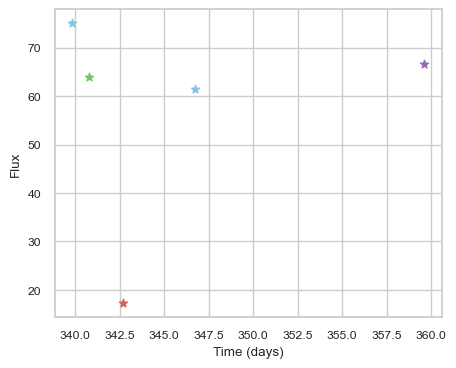

SNIax (4.0348616, False)
SNIax (4.890218, False)
SNIax (4.9870915, False)
SNIax (5.144997, False)
SNIax (4.631849, False)
SNIax (4.8719907, False)
SNIax (5.667757, False)
SNIax (5.436758, False)
SNIax (5.0500226, False)
SNIax (4.7961974, False)


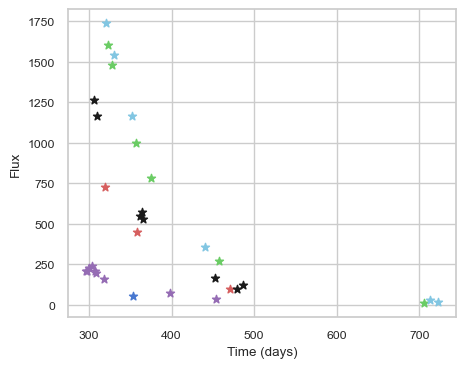

SNIax (7.8351097, False)
SNIax (7.5763593, False)
SNIax (4.25092, False)
SNIax (4.129443, False)
SNIax (4.568884, False)
SNIax (4.432384, False)
SNIax (4.3055453, False)
SNIax (4.4617248, False)
SNIax (4.21425, False)
SNIax (4.8005643, False)
SNIax (2.7411215, False)
SNIax (3.700508, False)
SNIax (3.42189, False)
SNIax (3.7023017, False)
SNIax (3.5949013, False)
SNIax (3.7027073, False)
SNIax (2.6490512, False)
SNIax (3.7296784, False)
SNIax (3.692685, False)
SNIax (4.035231, False)
SNIax (2.7829368, False)
SNIax (3.5992794, False)
SNIax (1.7758385, True)
SNIax (3.3427808, False)
SNIax (2.4038193, False)
SNIax (3.5105724, False)
SNIax (1.8866104, False)
SNIax (3.3423276, False)
SNIax (2.695171, False)
SNIax (2.6770575, False)
SNIax (2.1164224, False)
SNIax (3.3821478, False)
SNIax (3.0389361, False)
SNIax (3.2040255, False)
SNIax (2.248908, False)
SNIax (3.4760647, False)
SNIax (3.5351543, False)
SNIax (3.559031, False)
SNIax (3.2425938, False)
SNIax (2.6773171, False)
SNIax (3.221545,

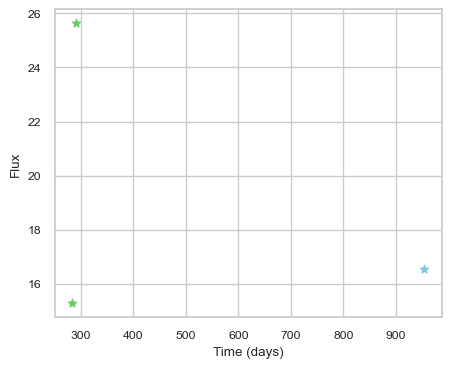

SNIax (4.08678, False)
SNIax (3.7351105, False)
SNIax (3.6619327, False)
SNIax (3.8202417, False)
SNIax (4.0710635, False)
SNIax (3.8477654, False)


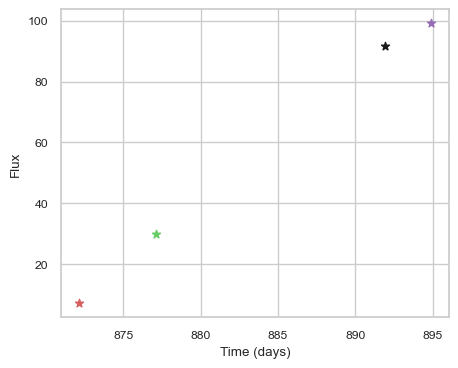

SNIax (3.8150923, False)
SNIax (3.9879107, False)
SNIax (3.469622, False)
SNIax (3.2237341, False)
SNIax (2.86885, False)
SNIax (3.683246, False)
SNIax (3.54413, False)
SNIax (3.6505272, False)


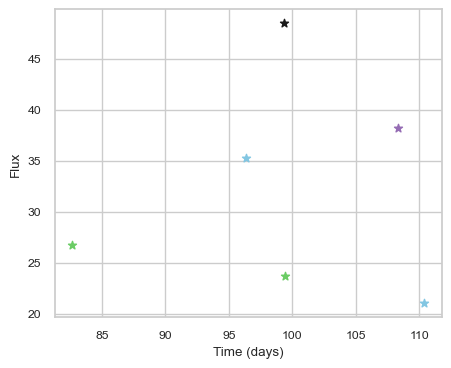

SNIax (4.5811157, False)
SNIax (4.1891093, False)
SNIax (4.301504, False)
SNIax (3.8565269, False)
SNIax (3.4448812, False)
SNIax (3.7246003, False)
SNIax (3.5750325, False)
SNIax (4.1474433, False)
SNIax (3.7038958, False)
SNIax (4.343569, False)
SNIax (3.9098701, False)
SNIax (3.4989479, False)


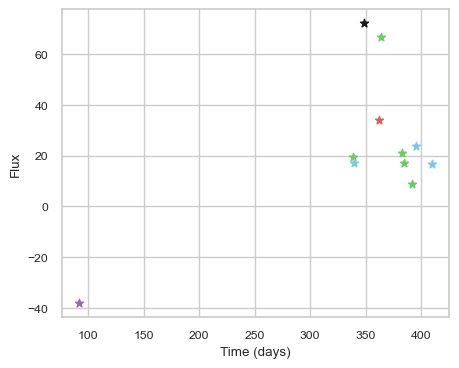

SNIax (3.8915308, False)
SNIax (4.2527957, False)
SNIax (3.8351636, False)
SNIax (3.3689637, False)
SNIax (3.5194511, False)
SNIax (3.5448844, False)
SNIax (3.66675, False)
SNIax (3.43476, False)
SNIax (3.178916, False)
SNIax (3.7659845, False)
SNIax (3.500171, False)
SNIax (2.8870203, False)
SNIax (3.8619962, False)
SNIax (3.2942858, False)
SNIax (3.4513528, False)
SNIax (2.569575, False)
SNIax (2.7251093, False)
SNIax (2.637384, False)
SNIax (2.7638264, False)
SNIax (2.2523816, False)
SNIax (2.2092707, False)
SNIax (2.4624295, False)


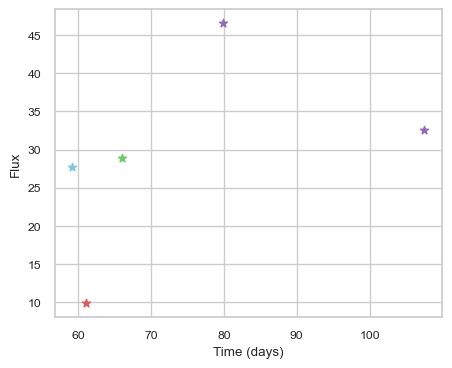

SNIax (4.2438335, False)
SNIax (4.182689, False)
SNIax (3.3202794, False)
SNIax (3.0750308, False)
SNIax (3.449712, False)
SNIax (3.8469992, False)
SNIax (3.4845912, False)
SNIax (3.554376, False)
SNIax (3.7178512, False)
SNIax (3.056204, False)


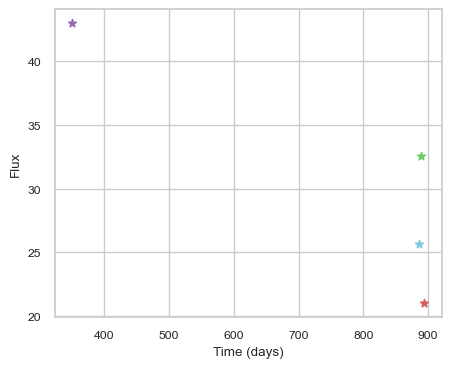

SNIax (4.004505, False)
SNIax (3.8226624, False)
SNIax (4.1949844, False)
SNIax (3.467123, False)
SNIax (3.0937824, False)
SNIax (2.9415379, False)
SNIax (3.132204, False)
SNIax (2.6768203, False)


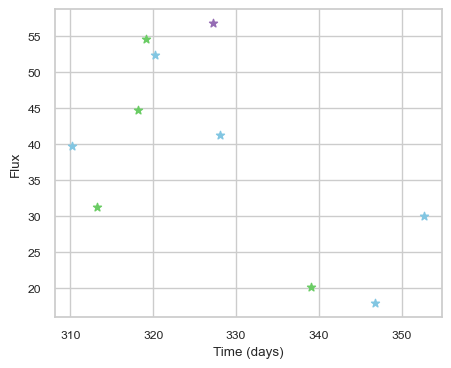

SNIax (3.750897, False)
SNIax (4.3257785, False)
SNIax (3.553533, False)
SNIax (4.1530023, False)
SNIax (4.4229217, False)
SNIax (4.1406145, False)
SNIax (3.8008761, False)
SNIax (4.4304624, False)
SNIax (4.0566053, False)
SNIax (4.638087, False)
SNIax (4.648447, False)
SNIax (4.434678, False)
SNIax (4.3179846, False)
SNIax (3.7380993, False)
SNIax (3.1291049, False)
SNIax (3.4938712, False)
SNIax (2.9861286, False)
SNIax (2.6460972, False)
SNIax (2.467871, False)
SNIax (2.385297, False)


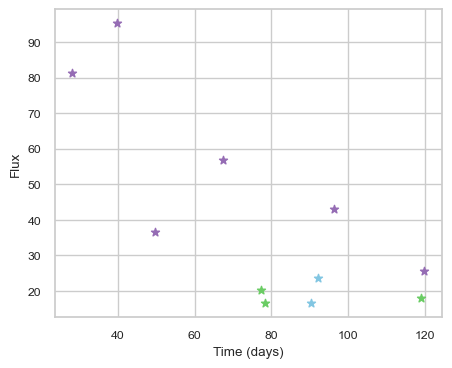

SNIax (3.881863, False)
SNIax (4.0912986, False)
SNIax (4.4305735, False)
SNIax (4.204269, False)
SNIax (5.361383, False)
SNIax (4.6352673, False)
SNIax (5.109877, False)
SNIax (4.958991, False)
SNIax (5.0392823, False)
SNIax (4.469343, False)
SNIax (4.463453, False)
SNIax (4.832116, False)
SNIax (4.985589, False)
SNIax (4.387672, False)
SNIax (4.3970656, False)
SNIax (4.4472475, False)
SNIax (4.7594028, False)
SNIax (4.410919, False)
SNIax (4.9495654, False)
SNIax (4.568482, False)
SNIax (5.126663, False)
SNIax (4.881725, False)


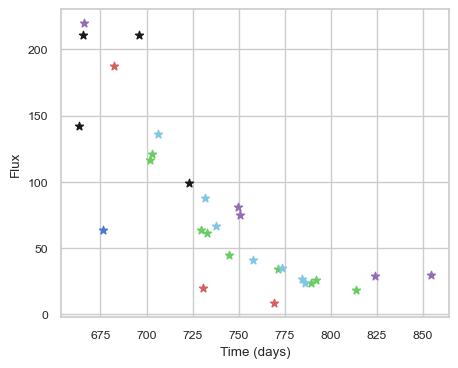

SNIax (3.7552316, False)
SNIax (4.062969, False)
SNIax (4.0282288, False)
SNIax (4.2760468, False)
SNIax (3.9918032, False)
SNIax (3.589301, False)
SNIax (3.0870209, False)
SNIax (4.0405827, False)
SNIax (3.6687043, False)
SNIax (3.7903574, False)
SNIax (3.020024, False)
SNIax (3.9623106, False)
SNIax (3.191373, False)
SNIax (2.9133332, False)
SNIax (3.2836978, False)
SNIax (3.4880855, False)
SNIax (3.5101447, False)
SNIax (3.078003, False)
SNIax (3.663202, False)
SNIax (2.9953134, False)
SNIax (3.347241, False)
SNIax (3.145646, False)
SNIax (2.4071958, False)
SNIax (3.091064, False)
SNIax (3.24928, False)
SNIax (2.6787946, False)
SNIax (2.978519, False)
SNIax (2.8114479, False)
SNIax (2.685516, False)
SNIax (2.3928428, False)
SNIax (2.8376582, False)
SNIax (2.6058857, False)
SNIax (2.7170198, False)
SNIax (2.920866, False)
SNIax (3.0228653, False)
SNIax (2.7529385, False)
SNIax (2.4551253, False)
SNIax (2.3498454, False)
SNIax (2.7748587, False)
SNIax (2.9909914, False)
SNIax (2.93072

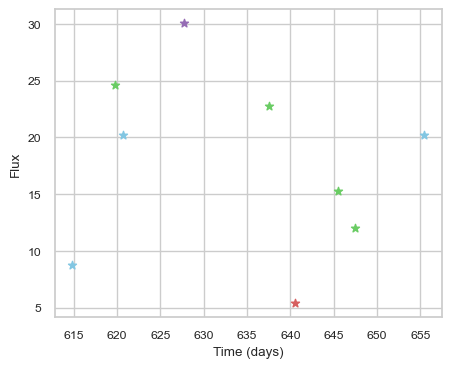

SNIax (3.9637468, False)
SNIax (4.129368, False)
SNIax (3.462542, False)
SNIax (2.8592002, False)
SNIax (3.4323854, False)
SNIax (3.2508068, False)
SNIax (3.6908004, False)
SNIax (3.5190897, False)
SNIax (3.604565, False)
SNIax (3.5614653, False)
SNIax (3.962643, False)
SNIax (3.6877038, False)
SNIax (3.623146, False)
SNIax (3.238325, False)
SNIax (3.6548831, False)
SNIax (3.3406823, False)
SNIax (3.747658, False)
SNIax (3.1718698, False)


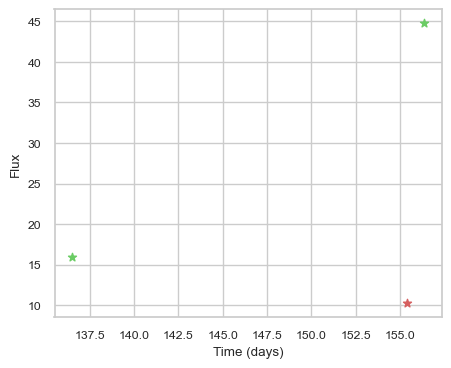

SNIax (4.2063966, False)
SNIax (3.8014848, False)
SNIax (3.3588908, False)
SNIax (3.8669188, False)
SNIax (3.0782533, False)
SNIax (3.3401868, False)


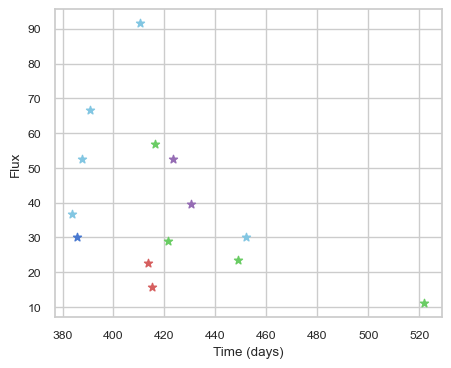

SNIax (3.7933295, False)
SNIax (3.4532106, False)
SNIax (3.3548422, False)
SNIax (5.1309757, False)
SNIax (4.1379476, False)
SNIax (3.703028, False)
SNIax (4.1090164, False)
SNIax (4.260007, False)
SNIax (3.779221, False)
SNIax (4.1307926, False)
SNIax (4.022663, False)
SNIax (4.079061, False)
SNIax (3.768518, False)
SNIax (3.8223407, False)
SNIax (3.5268557, False)
SNIax (3.8692226, False)
SNIax (4.1966457, False)
SNIax (4.2571454, False)
SNIax (4.051934, False)
SNIax (4.2874436, False)
SNIax (3.327615, False)
SNIax (3.4727483, False)
SNIax (3.0416298, False)
SNIax (3.0341134, False)
SNIax (3.3021042, False)
SNIax (3.180476, False)
SNIax (2.7991445, False)
SNIax (2.7428117, False)


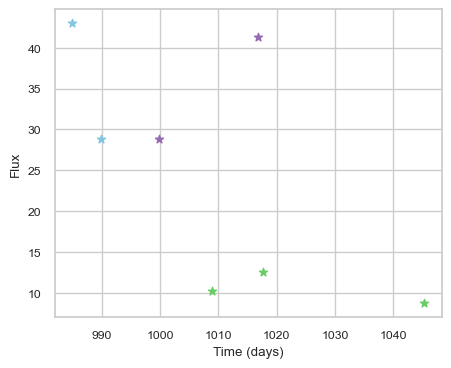

SNIax (3.8616397, False)
SNIax (3.716581, False)
SNIax (3.467245, False)
SNIax (3.7801611, False)
SNIax (3.5332868, False)
SNIax (4.59102, False)
SNIax (4.3539977, False)
SNIax (4.296966, False)
SNIax (3.5741951, False)
SNIax (4.082619, False)
SNIax (4.1875796, False)
SNIax (3.7258477, False)
SNIax (3.8337307, False)
SNIax (3.6009505, False)


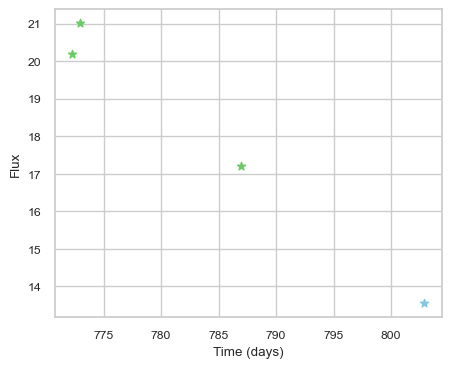

SNIax (4.3315983, False)
SNIax (3.4904616, False)
SNIax (3.411252, False)
SNIax (2.9981253, False)
SNIax (3.4089005, False)
SNIax (2.834752, False)
SNIax (3.4871168, False)
SNIax (3.0919151, False)


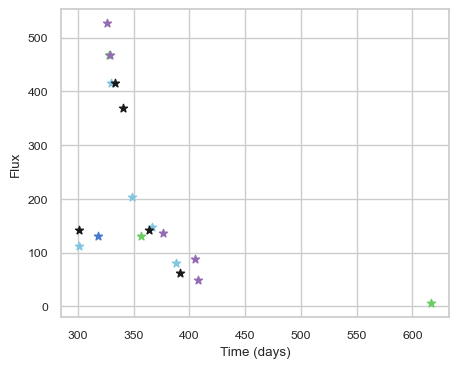

SNIax (3.6826658, False)
SNIax (3.753272, False)
SNIax (3.445324, False)
SNIax (4.478725, False)
SNIax (4.1307244, False)
SNIax (5.005506, False)
SNIax (4.3712883, False)
SNIax (5.0636983, False)
SNIax (2.854729, False)
SNIax (3.3907454, False)
SNIax (2.9508152, False)
SNIax (2.836696, False)
SNIax (3.4053342, False)
SNIax (2.838854, False)
SNIax (3.1697593, False)
SNIax (3.1418824, False)
SNIax (3.0768976, False)
SNIax (3.3384767, False)
SNIax (3.1918833, False)
SNIax (2.698525, False)
SNIax (2.9499156, False)
SNIax (3.0165443, False)
SNIax (3.1625152, False)
SNIax (3.210217, False)
SNIax (3.2082224, False)
SNIax (2.9137185, False)
SNIax (2.9091885, False)
SNIax (2.9751945, False)
SNIax (3.2372663, False)
SNIax (2.9760988, False)
SNIax (2.9761105, False)
SNIax (3.4227507, False)
SNIax (2.6988838, False)
SNIax (2.96076, False)
SNIax (2.9422908, False)
SNIax (2.8534086, False)
SNIax (2.8119848, False)
SNIax (2.7927592, False)


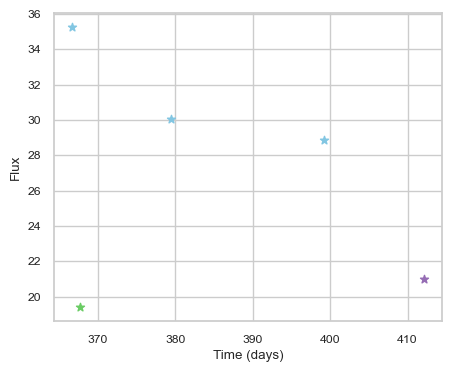

SNIax (4.712662, False)
SNIax (4.855355, False)
SNIax (4.780356, False)
SNIax (4.840982, False)
SNIax (5.1913342, False)
SNIax (5.143476, False)
SNIax (4.5607104, False)
SNIax (4.371053, False)
SNIax (4.653407, False)
SNIax (4.376001, False)


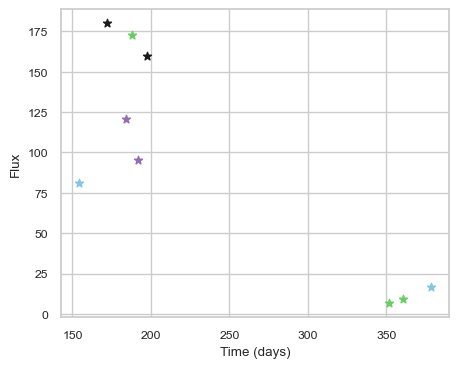

SNIax (3.7476742, False)
SNIax (4.4554343, False)
SNIax (4.0434504, False)
SNIax (4.416197, False)
SNIax (3.9004636, False)
SNIax (3.6304615, False)
SNIax (3.739006, False)
SNIax (3.3762677, False)
SNIax (4.2525845, False)
SNIax (3.9242697, False)
SNIax (4.5072207, False)
SNIax (4.487983, False)
SNIax (4.2060547, False)
SNIax (4.2741456, False)
SNIax (3.8792317, False)
SNIax (4.0563707, False)
SNIax (4.055608, False)
SNIax (4.271265, False)


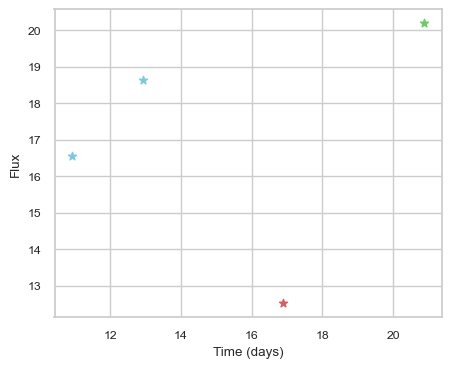

SNIax (4.287692, False)
SNIax (3.4332378, False)
SNIax (3.1049867, False)
SNIax (3.3218138, False)
SNIax (3.1213677, False)
SNIax (3.4782257, False)
SNIax (2.593092, False)
SNIax (3.1224387, False)


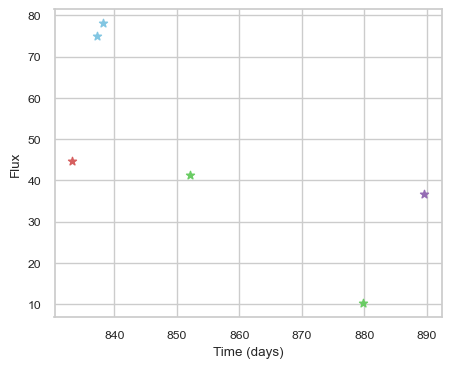

SNIax (3.8214178, False)
SNIax (4.828529, False)
SNIax (4.622434, False)
SNIax (3.5071528, False)
SNIax (3.8382783, False)
SNIax (3.4954603, False)
SNIax (3.4544144, False)
SNIax (3.115793, False)
SNIax (3.3735368, False)
SNIax (3.4644377, False)
SNIax (2.6250143, False)
SNIax (3.0951362, False)


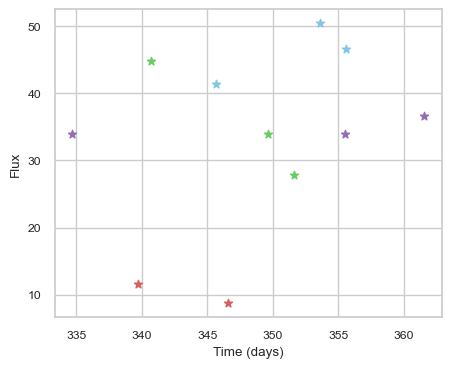

SNIax (4.4230924, False)
SNIax (4.500497, False)
SNIax (4.364204, False)
SNIax (4.8313756, False)
SNIax (4.421532, False)
SNIax (5.062598, False)
SNIax (5.5771337, False)
SNIax (5.6998515, False)
SNIax (4.491122, False)
SNIax (5.0023346, False)
SNIax (4.770325, False)
SNIax (4.8495264, False)
SNIax (4.180051, False)
SNIax (4.592984, False)
SNIax (4.3842163, False)
SNIax (4.7068777, False)
SNIax (4.777478, False)
SNIax (4.852703, False)
SNIax (4.423644, False)
SNIax (4.806524, False)
SNIax (4.5875554, False)
SNIax (4.454903, False)


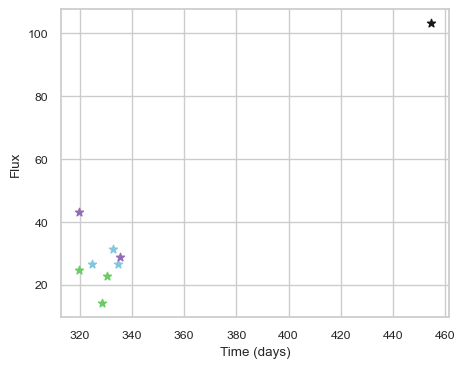

SNIax (3.6951084, False)
SNIax (4.316992, False)
SNIax (4.422794, False)
SNIax (3.5698621, False)
SNIax (4.1728735, False)
SNIax (4.196013, False)
SNIax (4.4298472, False)
SNIax (4.1116233, False)
SNIax (4.255865, False)
SNIax (4.0314054, False)
SNIax (4.069923, False)
SNIax (4.255353, False)
SNIax (4.033465, False)
SNIax (3.5908346, False)
SNIax (4.504511, False)
SNIax (3.8986554, False)
SNIax (5.2334943, False)


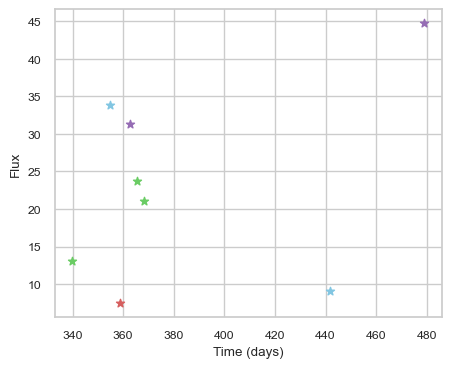

SNIax (4.3121767, False)
SNIax (3.8035839, False)
SNIax (3.4209456, False)
SNIax (3.3715174, False)
SNIax (3.0006762, False)
SNIax (2.4676807, False)
SNIax (2.8019788, False)
SNIax (2.4241436, False)
SNIax (2.6180668, False)
SNIax (2.5972235, False)
SNIax (3.07543, False)
SNIax (2.174439, False)
SNIax (3.3651462, False)
SNIax (3.3325074, False)
SNIax (3.577791, False)
SNIax (3.0208235, False)


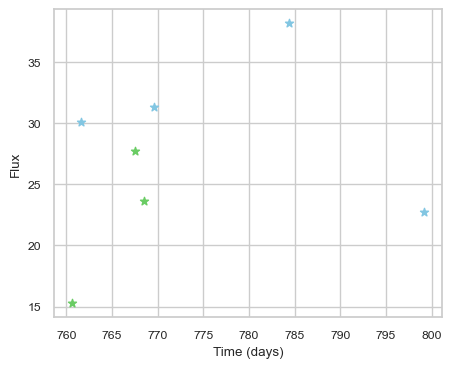

SNIax (4.140374, False)
SNIax (3.257642, False)
SNIax (3.0445712, False)
SNIax (3.2240736, False)
SNIax (3.409046, False)
SNIax (2.7696948, False)
SNIax (2.7955859, False)
SNIax (2.5398197, False)
SNIax (2.6668358, False)
SNIax (2.644448, False)
SNIax (2.531934, False)
SNIax (2.8730395, False)
SNIax (2.934789, False)
SNIax (2.7785494, False)


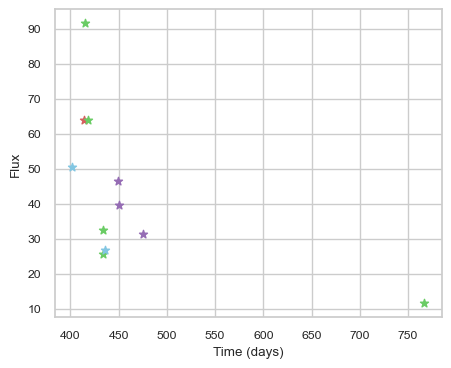

SNIax (3.8180022, False)
SNIax (3.4771974, False)
SNIax (3.3757248, False)
SNIax (3.877703, False)
SNIax (3.4791288, False)
SNIax (3.587044, False)
SNIax (3.4492297, False)
SNIax (3.4566822, False)
SNIax (3.1161466, False)
SNIax (3.2078853, False)
SNIax (2.8081775, False)
SNIax (2.68404, False)
SNIax (2.8383274, False)
SNIax (2.3098977, False)
SNIax (2.3057277, False)
SNIax (2.536311, False)
SNIax (3.1757953, False)
SNIax (2.5845149, False)
SNIax (3.279246, False)
SNIax (2.761399, False)
SNIax (3.2718592, False)
SNIax (2.6969988, False)


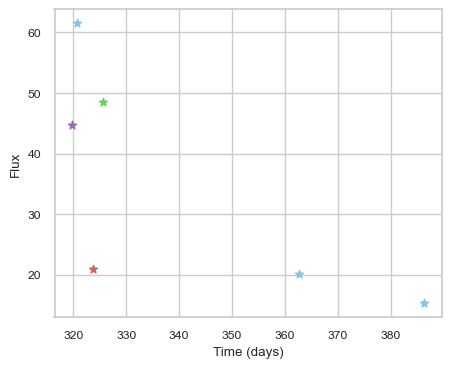

SNIax (3.6571186, False)
SNIax (3.945619, False)
SNIax (3.6666555, False)
SNIax (4.363408, False)
SNIax (4.23, False)
SNIax (3.941357, False)
SNIax (3.0262325, False)
SNIax (3.7200325, False)
SNIax (4.3116913, False)
SNIax (3.453587, False)
SNIax (3.3951297, False)
SNIax (3.3046143, False)


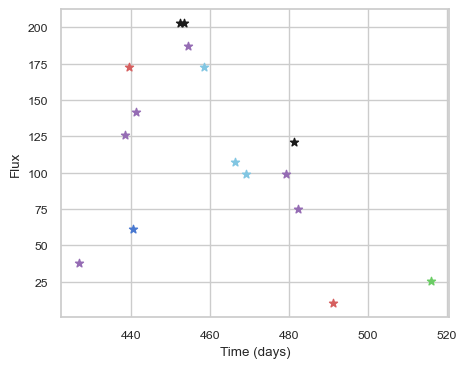

SNIax (4.042634, False)
SNIax (3.890599, False)
SNIax (4.1698074, False)
SNIax (4.2605276, False)
SNIax (4.8564687, False)
SNIax (4.795143, False)
SNIax (4.627913, False)
SNIax (5.181309, False)
SNIax (4.9276004, False)
SNIax (4.750232, False)
SNIax (3.9864254, False)
SNIax (4.321155, False)
SNIax (4.1388283, False)
SNIax (4.415236, False)
SNIax (4.537763, False)
SNIax (4.029877, False)
SNIax (4.21045, False)
SNIax (3.7970421, False)
SNIax (4.1168613, False)
SNIax (4.51199, False)
SNIax (3.7334425, False)
SNIax (3.9103012, False)
SNIax (4.3180175, False)
SNIax (4.2312593, False)
SNIax (4.6361375, False)
SNIax (4.19859, False)
SNIax (4.648706, False)
SNIax (4.189386, False)
SNIax (3.873507, False)
SNIax (4.013837, False)
SNIax (4.218058, False)
SNIax (5.1147146, False)


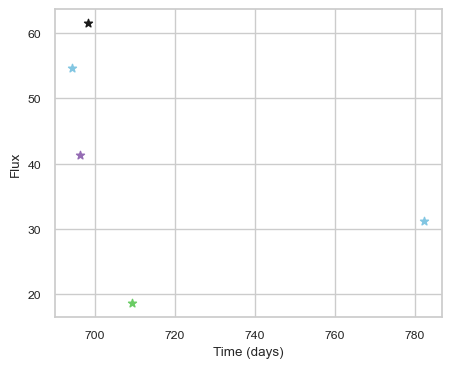

SNIax (3.8353148, False)
SNIax (3.711619, False)
SNIax (3.728692, False)
SNIax (3.4109764, False)
SNIax (3.4007757, False)
SNIax (4.272152, False)
SNIax (3.25748, False)
SNIax (3.1391864, False)
SNIax (3.681766, False)
SNIax (3.4051888, False)


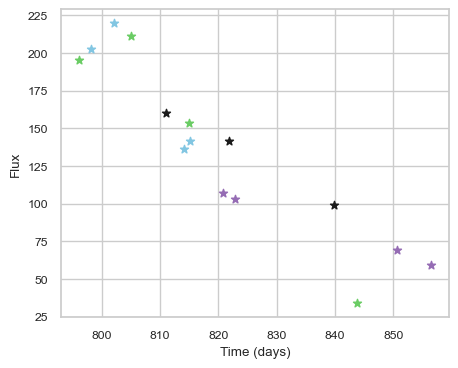

SNIax (3.8275938, False)
SNIax (3.654592, False)
SNIax (4.269977, False)
SNIax (4.4834743, False)
SNIax (3.5277689, False)
SNIax (3.5726032, False)
SNIax (3.412957, False)
SNIax (3.095062, False)
SNIax (3.2272608, False)
SNIax (3.5880623, False)
SNIax (3.6689994, False)
SNIax (3.255293, False)
SNIax (3.135247, False)
SNIax (3.0155115, False)
SNIax (3.880843, False)
SNIax (3.8785417, False)
SNIax (3.472505, False)
SNIax (3.724673, False)
SNIax (4.0613093, False)
SNIax (4.659768, False)
SNIax (4.7536583, False)
SNIax (4.1995254, False)
SNIax (4.5206575, False)
SNIax (4.6558633, False)
SNIax (4.4689927, False)
SNIax (3.6872745, False)
SNIax (4.284325, False)
SNIax (4.0207186, False)
SNIax (4.535619, False)
SNIax (3.8737125, False)


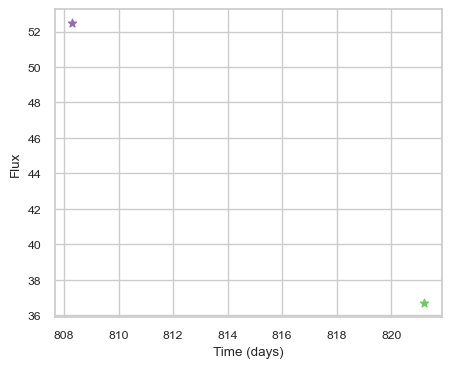

SNIax (3.884569, False)
SNIax (3.3326318, False)
SNIax (3.7232168, False)
SNIax (3.1945605, False)


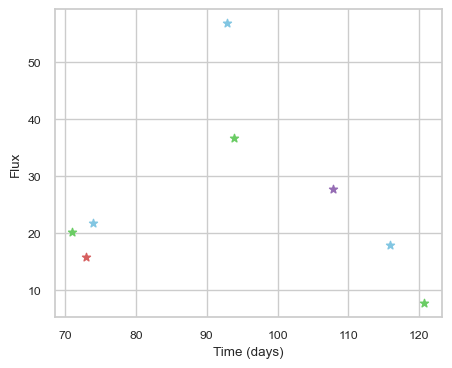

SNIax (3.8100114, False)
SNIax (3.7041585, False)
SNIax (3.5188847, False)
SNIax (3.1394713, False)
SNIax (3.4385428, False)
SNIax (4.1536803, False)
SNIax (3.9831464, False)
SNIax (3.8717406, False)
SNIax (3.5130155, False)
SNIax (3.8215418, False)
SNIax (3.8404825, False)
SNIax (3.5711908, False)
SNIax (2.7569592, False)
SNIax (3.0645814, False)
SNIax (2.5973754, False)
SNIax (2.9314437, False)


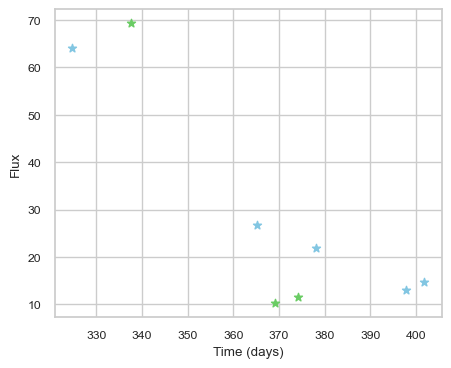

SNIax (3.6875052, False)
SNIax (4.070589, False)
SNIax (3.9676974, False)
SNIax (3.8878572, False)
SNIax (3.8926337, False)
SNIax (3.8278587, False)
SNIax (4.1182942, False)
SNIax (3.3953683, False)
SNIax (3.3869188, False)
SNIax (2.9305785, False)
SNIax (3.2684665, False)
SNIax (2.5882504, False)
SNIax (3.4243324, False)
SNIax (3.3945696, False)
SNIax (3.3976135, False)
SNIax (3.3415952, False)


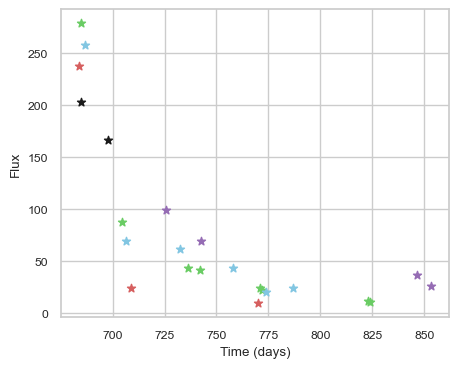

SNIax (3.7003567, False)
SNIax (4.4312277, False)
SNIax (3.1717079, False)
SNIax (3.7872303, False)
SNIax (3.5022428, False)
SNIax (3.3486671, False)
SNIax (3.3694284, False)
SNIax (3.1580882, False)
SNIax (3.366869, False)
SNIax (3.4285872, False)
SNIax (3.610821, False)
SNIax (2.6951296, False)
SNIax (3.1702237, False)
SNIax (2.6809778, False)
SNIax (2.572173, False)
SNIax (2.0917373, False)
SNIax (2.7456977, False)
SNIax (2.2989538, False)
SNIax (2.2127123, False)
SNIax (2.413589, False)
SNIax (2.4443526, False)
SNIax (2.2242296, False)
SNIax (2.8015807, False)
SNIax (2.3462636, False)
SNIax (2.668138, False)
SNIax (2.629452, False)
SNIax (2.3344598, False)
SNIax (2.2923932, False)
SNIax (3.0790954, False)
SNIax (2.8756514, False)
SNIax (2.8024497, False)
SNIax (2.7703698, False)
SNIax (2.8514445, False)
SNIax (2.5679862, False)
SNIax (2.805084, False)
SNIax (2.2574174, False)
SNIax (2.17538, False)
SNIax (2.1946561, False)
SNIax (2.4610348, False)
SNIax (2.2386613, False)
SNIax (2.

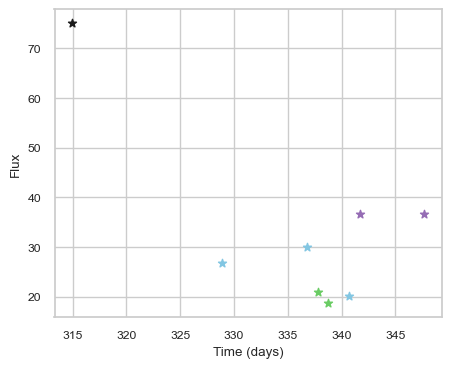

SNIax (4.5001698, False)
SNIax (4.618297, False)
SNIax (5.370225, False)
SNIax (4.8249393, False)
SNIax (4.503101, False)
SNIax (4.716138, False)
SNIax (3.8414452, False)
SNIax (3.65293, False)
SNIax (3.703069, False)
SNIax (3.3661933, False)
SNIax (3.8314276, False)
SNIax (3.0407338, False)
SNIax (3.2799542, False)
SNIax (3.1200342, False)
SNIax (3.0045388, False)
SNIax (2.8797193, False)


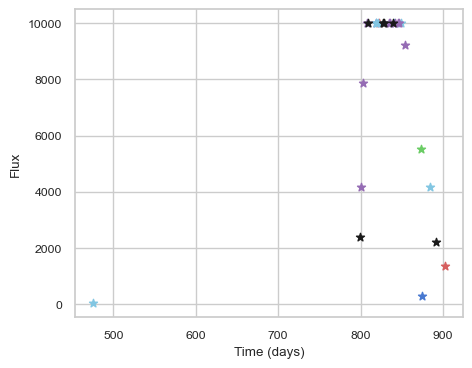

SNIax (5.656372, False)
SNIax (6.003317, False)
SNIax (5.8245015, False)
SNIax (4.1788864, False)
SNIax (2.6508586, False)
SNIax (3.455243, False)
SNIax (1.9956214, False)
SNIax (3.1545625, False)
SNIax (2.1990178, False)
SNIax (2.644057, False)
SNIax (1.8185327, False)
SNIax (3.108094, False)
SNIax (1.8433692, True)
SNIax (2.8381522, False)
SNIax (2.0770319, False)
SNIax (2.596398, False)
SNIax (2.748218, False)
SNIax (2.6766486, False)
SNIax (2.4979825, False)
SNIax (2.9566, False)
SNIax (2.1959543, False)
SNIax (2.768304, False)
SNIax (2.2513714, False)
SNIax (2.9610696, False)
SNIax (1.9518375, False)
SNIax (1.9980488, False)
SNIax (2.1961126, False)
SNIax (2.4535975, False)
SNIax (2.355215, False)
SNIax (3.1955717, False)
SNIax (1.8924923, False)
SNIax (1.9534978, False)
SNIax (2.3207119, False)
SNIax (2.7192254, False)
SNIax (2.0694346, False)
SNIax (2.3965876, False)
SNIax (2.0379474, False)
SNIax (2.8465247, False)
SNIax (1.9177725, False)
SNIax (1.9669762, False)
SNIax (1.6876

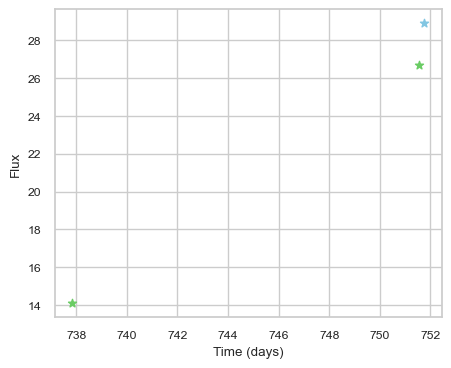

SNIax (3.664435, False)
SNIax (3.3122108, False)
SNIax (3.2108552, False)
SNIax (2.9047825, False)
SNIax (3.0401998, False)
SNIax (2.6638906, False)


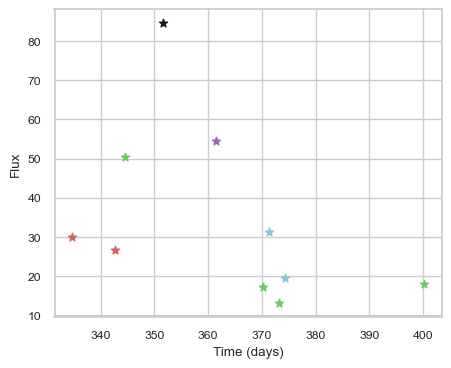

SNIax (3.8915088, False)
SNIax (4.529931, False)
SNIax (4.1142826, False)
SNIax (4.0902324, False)
SNIax (3.793216, False)
SNIax (2.6139777, False)
SNIax (3.1240728, False)
SNIax (3.2585492, False)
SNIax (3.019792, False)
SNIax (2.4678438, False)
SNIax (2.8642538, False)
SNIax (2.2996905, False)
SNIax (2.5645769, False)
SNIax (1.9202937, False)
SNIax (2.3868985, False)
SNIax (2.3952417, False)
SNIax (2.2726722, False)
SNIax (1.7678921, False)
SNIax (2.4399288, False)
SNIax (2.039443, False)


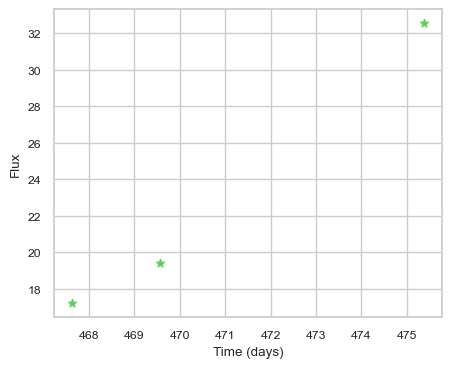

SNIax (4.2709107, False)
SNIax (3.4162796, False)
SNIax (3.6827545, False)
SNIax (2.9388583, False)
SNIax (3.0020094, False)
SNIax (2.9547298, False)


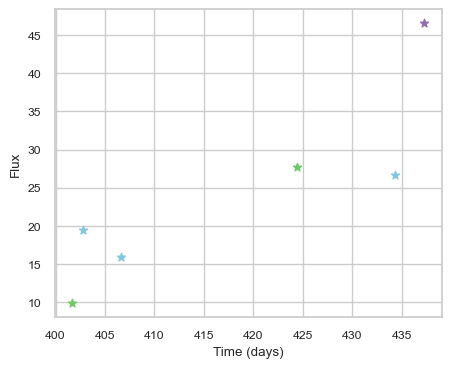

SNIax (4.3215957, False)
SNIax (3.5856743, False)
SNIax (3.1452303, False)
SNIax (3.0775414, False)
SNIax (3.0707922, False)
SNIax (2.9136138, False)
SNIax (2.9707475, False)
SNIax (2.619205, False)
SNIax (2.9191713, False)
SNIax (2.536107, False)
SNIax (2.6832812, False)
SNIax (2.5997703, False)


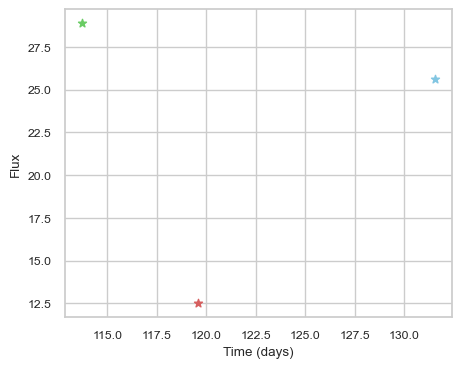

SNIax (4.049207, False)
SNIax (4.6714907, False)
SNIax (4.1489463, False)
SNIax (5.1555333, False)
SNIax (4.895048, False)
SNIax (5.9862165, False)


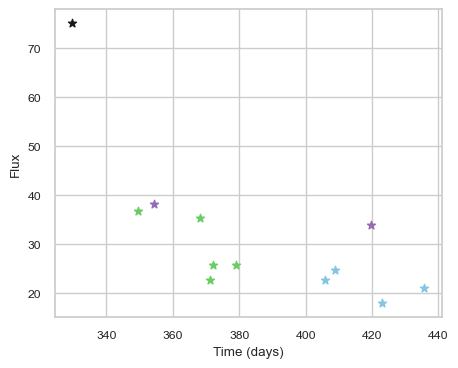

SNIax (3.8909945, False)
SNIax (3.945904, False)
SNIax (4.0750217, False)
SNIax (3.456793, False)
SNIax (4.27026, False)
SNIax (3.722957, False)
SNIax (4.5311384, False)
SNIax (4.259318, False)
SNIax (5.3995357, False)
SNIax (5.0104213, False)
SNIax (4.581702, False)
SNIax (4.499348, False)
SNIax (4.9167857, False)
SNIax (4.772882, False)
SNIax (6.007835, False)
SNIax (5.1170373, False)
SNIax (5.3776913, False)
SNIax (4.9876294, False)
SNIax (5.207414, False)
SNIax (5.1726646, False)
SNIax (5.544804, False)
SNIax (5.101298, False)
SNIax (4.8188167, False)
SNIax (4.9532113, False)


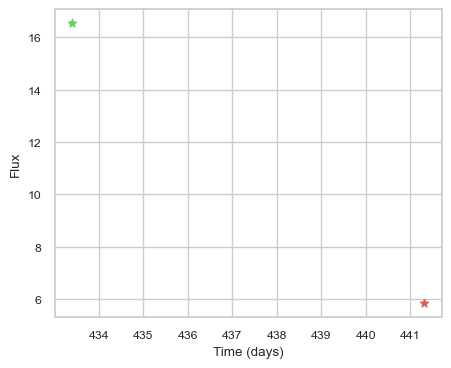

SNIax (4.014732, False)
SNIax (3.6705658, False)
SNIax (3.4503555, False)
SNIax (3.686496, False)


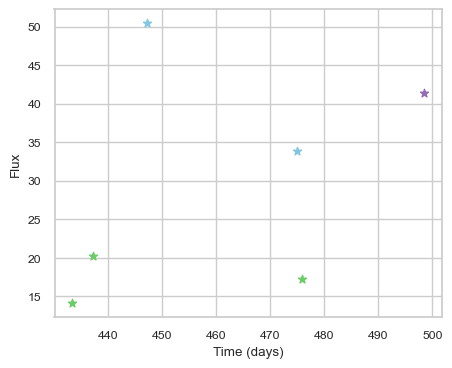

SNIax (4.295475, False)
SNIax (3.636442, False)
SNIax (3.517875, False)
SNIax (3.0113673, False)
SNIax (2.8631468, False)
SNIax (3.505373, False)
SNIax (4.1180835, False)
SNIax (3.3635511, False)
SNIax (3.3431077, False)
SNIax (3.0600374, False)
SNIax (3.4949863, False)
SNIax (3.1140056, False)


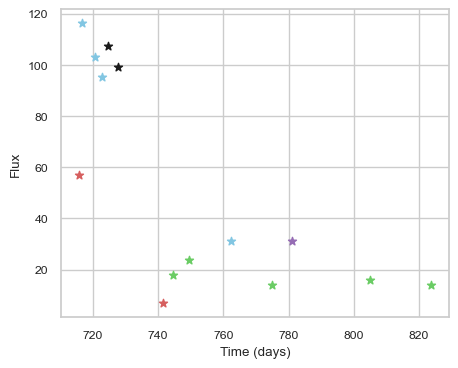

SNIax (3.8724663, False)
SNIax (4.331109, False)
SNIax (4.6363215, False)
SNIax (4.523146, False)
SNIax (5.348704, False)
SNIax (4.7625823, False)
SNIax (4.212612, False)
SNIax (4.553011, False)
SNIax (4.5147333, False)
SNIax (4.3964157, False)
SNIax (4.888699, False)
SNIax (5.2760563, False)
SNIax (3.719667, False)
SNIax (3.847574, False)
SNIax (4.1164637, False)
SNIax (4.412312, False)
SNIax (4.249264, False)
SNIax (4.3529234, False)
SNIax (4.3976965, False)
SNIax (4.4118466, False)
SNIax (3.8454478, False)
SNIax (4.452792, False)
SNIax (3.7892303, False)
SNIax (4.3797407, False)
SNIax (4.395716, False)
SNIax (4.2991886, False)
SNIax (4.3550706, False)
SNIax (4.647556, False)


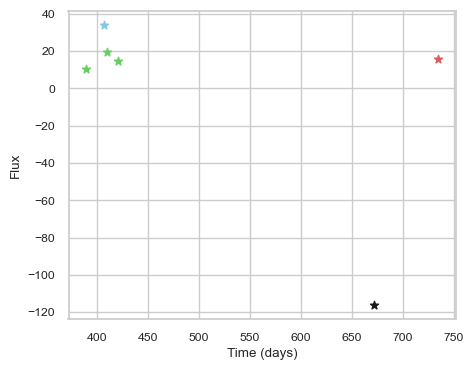

SNIax (4.4778695, False)
SNIax (3.5259564, False)
SNIax (3.380913, False)
SNIax (3.593625, False)
SNIax (3.3281698, False)
SNIax (3.3026428, False)
SNIax (3.4618294, False)
SNIax (3.1993392, False)
SNIax (3.8000488, False)
SNIax (4.1943, False)
SNIax (4.184755, False)
SNIax (5.5550456, False)


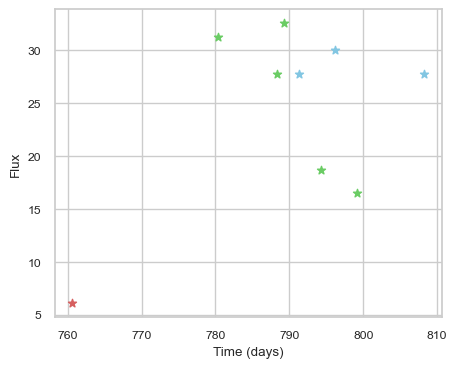

SNIax (4.199174, False)
SNIax (3.699121, False)
SNIax (3.5233095, False)
SNIax (2.7368553, False)
SNIax (2.750217, False)
SNIax (2.2519875, False)
SNIax (3.036861, False)
SNIax (3.2367008, False)
SNIax (3.8260157, False)
SNIax (3.2048495, False)
SNIax (3.7803886, False)
SNIax (3.8342664, False)
SNIax (3.5931332, False)
SNIax (3.304036, False)
SNIax (3.6610413, False)
SNIax (3.1947863, False)
SNIax (2.7933881, False)
SNIax (3.2900279, False)


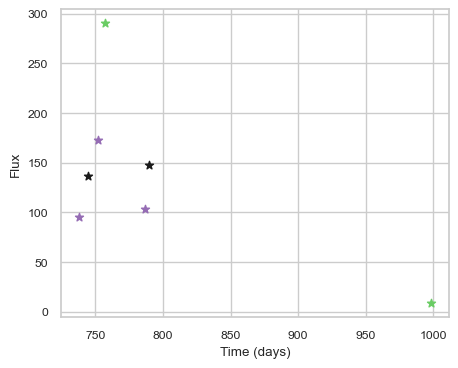

SNIax (3.7759395, False)
SNIax (3.3755527, False)
SNIax (3.422281, False)
SNIax (3.596773, False)
SNIax (3.8221438, False)
SNIax (3.2809308, False)
SNIax (3.6012628, False)
SNIax (3.240201, False)
SNIax (2.4126449, False)
SNIax (2.7150142, False)
SNIax (3.0844705, False)
SNIax (3.0419667, False)
SNIax (3.0906925, False)
SNIax (2.6440709, False)


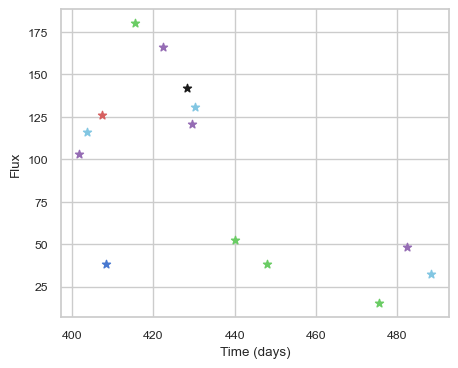

SNIax (3.828595, False)
SNIax (3.3499422, False)
SNIax (4.0343304, False)
SNIax (4.2071657, False)
SNIax (3.7315435, False)
SNIax (3.4810274, False)
SNIax (3.4164224, False)
SNIax (3.3059618, False)
SNIax (3.774985, False)
SNIax (2.8150964, False)
SNIax (3.1229777, False)
SNIax (2.4692466, False)
SNIax (2.6880555, False)
SNIax (2.665195, False)
SNIax (2.9870462, False)
SNIax (2.2688253, False)
SNIax (2.9242387, False)
SNIax (2.846508, False)
SNIax (2.8697708, False)
SNIax (2.7217784, False)
SNIax (3.4816277, False)
SNIax (2.7621462, False)
SNIax (3.3201327, False)
SNIax (2.8453236, False)
SNIax (3.442087, False)
SNIax (2.9749305, False)
SNIax (3.129089, False)
SNIax (2.6182947, False)


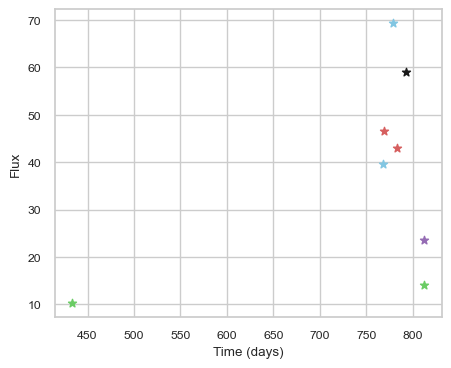

SNIax (3.8817935, False)
SNIax (3.73903, False)
SNIax (3.543838, False)
SNIax (3.3672996, False)
SNIax (3.2739818, False)
SNIax (3.5956953, False)
SNIax (3.434837, False)
SNIax (2.5787327, False)
SNIax (4.532638, False)
SNIax (3.780817, False)
SNIax (5.0401826, False)
SNIax (4.875806, False)
SNIax (5.430678, False)
SNIax (4.805915, False)
SNIax (4.1702685, False)
SNIax (4.408222, False)


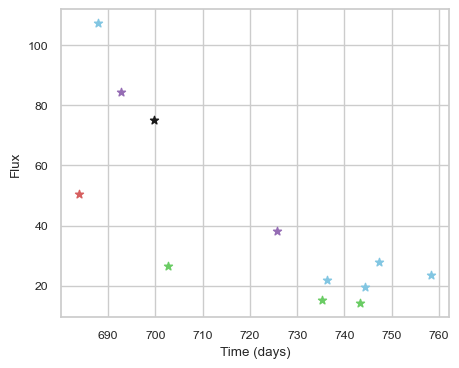

SNIax (3.9041524, False)
SNIax (4.6346107, False)
SNIax (4.5210066, False)
SNIax (5.052476, False)
SNIax (6.06387, False)
SNIax (4.678272, False)
SNIax (4.759009, False)
SNIax (4.883717, False)
SNIax (5.3561525, False)
SNIax (5.6664734, False)
SNIax (5.5239787, False)
SNIax (5.2223687, False)
SNIax (5.547312, False)
SNIax (5.2130284, False)
SNIax (4.8972516, False)
SNIax (5.0747805, False)
SNIax (4.9731927, False)
SNIax (5.156414, False)
SNIax (4.69538, False)
SNIax (5.190206, False)
SNIax (4.7915983, False)
SNIax (5.1415772, False)
SNIax (4.9924808, False)
SNIax (5.0982623, False)


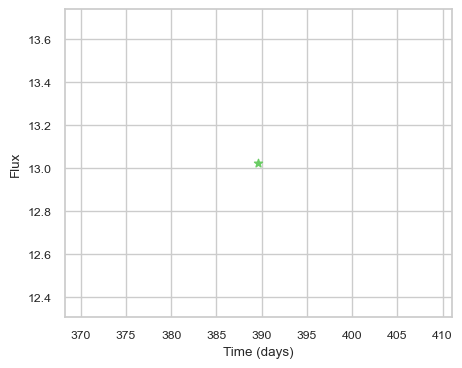

SNIax (4.437232, False)
SNIax (3.4876075, False)


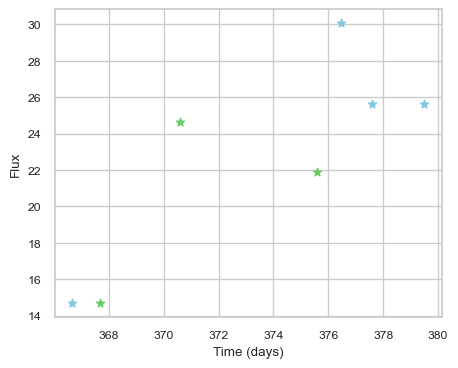

SNIax (3.9995065, False)
SNIax (3.4590025, False)
SNIax (3.3416758, False)
SNIax (2.9151838, False)
SNIax (3.6065025, False)
SNIax (2.3179502, False)
SNIax (2.5878432, False)
SNIax (2.159751, False)
SNIax (2.8384786, False)
SNIax (2.2095969, False)
SNIax (2.4322066, False)
SNIax (2.038597, False)
SNIax (2.6940799, False)
SNIax (2.2645447, False)


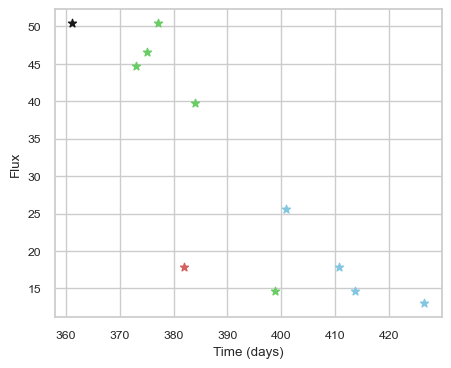

SNIax (3.9499104, False)
SNIax (3.544308, False)
SNIax (3.7813194, False)
SNIax (2.8560674, False)
SNIax (3.2500014, False)
SNIax (2.7014463, False)
SNIax (3.1586416, False)
SNIax (2.637585, False)
SNIax (3.5005276, False)
SNIax (3.212841, False)
SNIax (3.380068, False)
SNIax (3.3387737, False)
SNIax (2.7624714, False)
SNIax (2.5028336, False)
SNIax (2.7831874, False)
SNIax (2.5486841, False)
SNIax (2.430635, False)
SNIax (2.497241, False)
SNIax (2.779666, False)
SNIax (2.459169, False)
SNIax (2.4823916, False)
SNIax (2.442953, False)


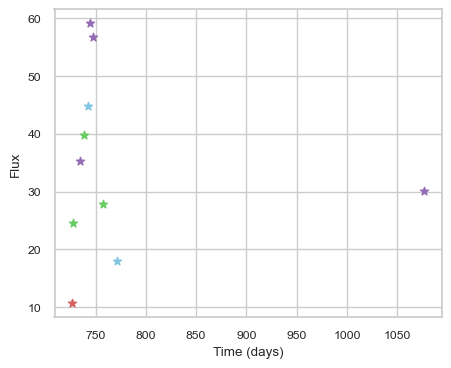

SNIax (3.9474313, False)
SNIax (3.7069006, False)
SNIax (3.3833427, False)
SNIax (2.5123773, False)
SNIax (3.0529373, False)
SNIax (2.2739143, False)
SNIax (2.476721, False)
SNIax (2.4118402, False)
SNIax (2.8578846, False)
SNIax (1.8742312, False)
SNIax (2.334111, False)
SNIax (1.745276, False)
SNIax (2.8021832, False)
SNIax (2.0343046, False)
SNIax (2.4151518, False)
SNIax (2.3752692, False)
SNIax (2.675571, False)
SNIax (2.2197115, False)
SNIax (2.725706, False)
SNIax (2.7050135, False)


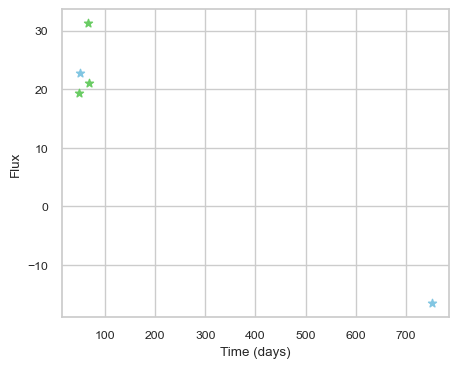

SNIax (3.8809688, False)
SNIax (3.6661394, False)
SNIax (3.4011283, False)
SNIax (3.5210617, False)
SNIax (3.0805154, False)
SNIax (2.818721, False)
SNIax (3.3885467, False)
SNIax (3.045124, False)
SNIax (3.2387037, False)
SNIax (3.5705252, False)


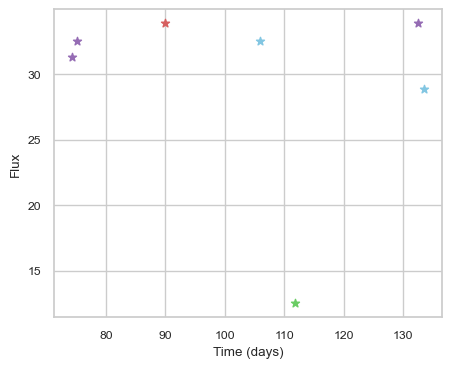

SNIax (4.0833426, False)
SNIax (3.962575, False)
SNIax (3.3808174, False)
SNIax (3.6357086, False)
SNIax (3.4918308, False)
SNIax (3.2711997, False)
SNIax (3.7485538, False)
SNIax (3.568525, False)
SNIax (4.651033, False)
SNIax (4.0724382, False)
SNIax (3.911185, False)
SNIax (4.5332384, False)
SNIax (4.5060205, False)
SNIax (3.910075, False)


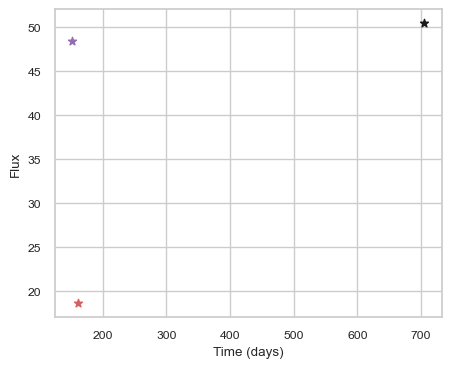

SNIax (3.7470329, False)
SNIax (3.9656448, False)
SNIax (3.6573782, False)
SNIax (3.5319762, False)
SNIax (4.3034987, False)
SNIax (4.3765335, False)


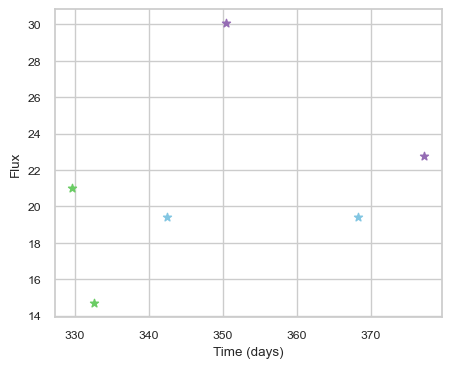

SNIax (4.7328377, False)
SNIax (4.653288, False)
SNIax (3.9055123, False)
SNIax (3.626571, False)
SNIax (3.3798282, False)
SNIax (3.081229, False)
SNIax (3.3637652, False)
SNIax (3.541106, False)
SNIax (3.231562, False)
SNIax (3.5630605, False)
SNIax (3.8966453, False)
SNIax (4.023524, False)


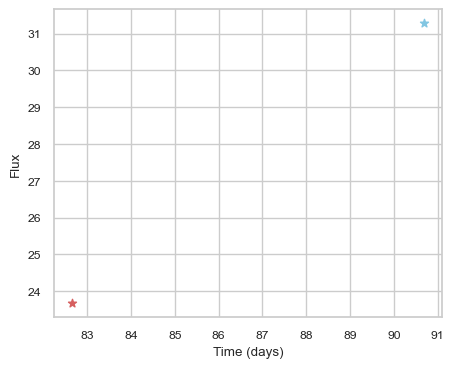

SNIax (3.8364596, False)
SNIax (4.8605556, False)
SNIax (3.7199354, False)
SNIax (4.971649, False)


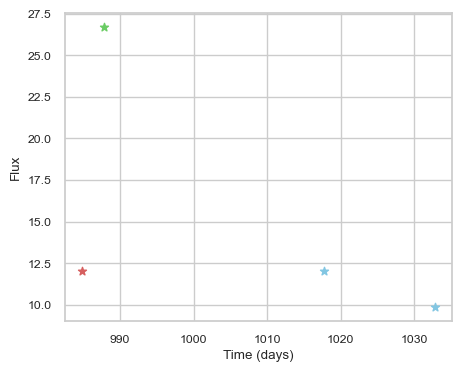

SNIax (3.848465, False)
SNIax (4.4900703, False)
SNIax (3.332721, False)
SNIax (3.06402, False)
SNIax (3.5168219, False)
SNIax (4.25581, False)
SNIax (4.224316, False)
SNIax (3.8753152, False)


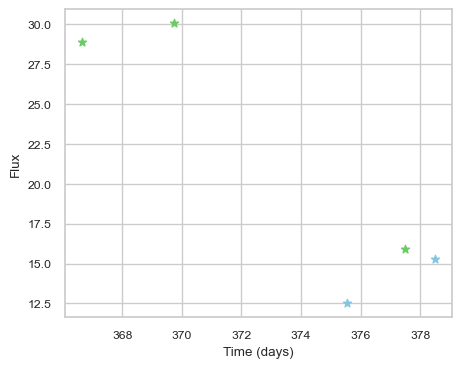

SNIax (3.8059745, False)
SNIax (3.3056667, False)
SNIax (3.152453, False)
SNIax (3.167146, False)
SNIax (3.812678, False)
SNIax (3.9587045, False)
SNIax (4.1312046, False)
SNIax (4.25317, False)
SNIax (3.8842769, False)
SNIax (4.138756, False)


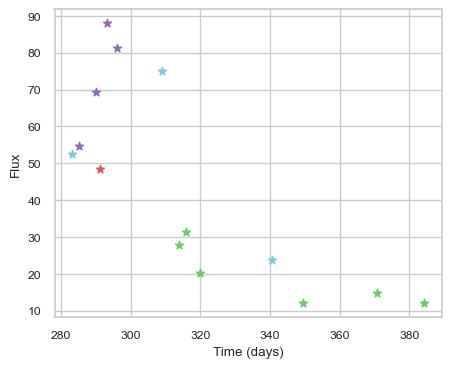

SNIax (3.8988087, False)
SNIax (4.21236, False)
SNIax (3.5831628, False)
SNIax (3.4913702, False)
SNIax (3.2724288, False)
SNIax (3.2774782, False)
SNIax (3.7620022, False)
SNIax (3.6923718, False)
SNIax (3.8807738, False)
SNIax (3.4845855, False)
SNIax (3.9223263, False)
SNIax (3.2948964, False)
SNIax (3.42695, False)
SNIax (3.280717, False)
SNIax (3.3773801, False)
SNIax (3.2004163, False)
SNIax (3.3172488, False)
SNIax (2.4446754, False)
SNIax (3.650394, False)
SNIax (2.4185636, False)
SNIax (2.81953, False)
SNIax (2.6113641, False)
SNIax (2.586799, False)
SNIax (2.470658, False)
SNIax (2.8336766, False)
SNIax (2.8468583, False)
SNIax (2.9689052, False)
SNIax (2.739902, False)


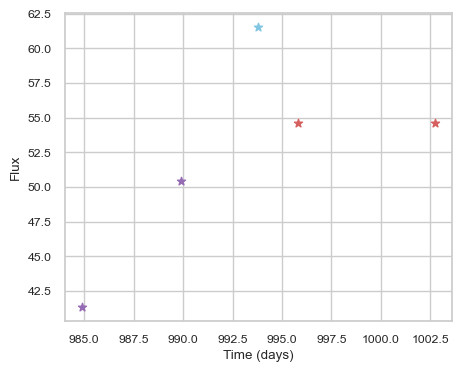

SNIax (3.7429936, False)
SNIax (3.5769076, False)
SNIax (3.3406184, False)
SNIax (3.3606436, False)
SNIax (3.4811637, False)
SNIax (3.3022199, False)
SNIax (3.4448245, False)
SNIax (3.2239594, False)
SNIax (3.4382672, False)
SNIax (3.3067498, False)


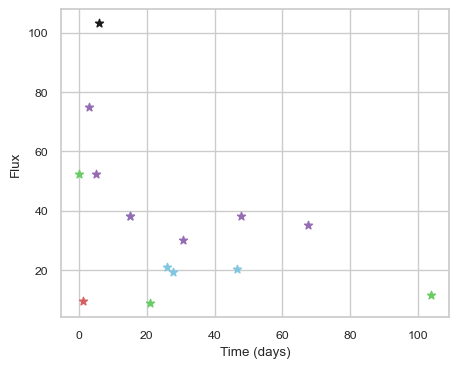

SNIax (4.395113, False)
SNIax (4.473882, False)
SNIax (4.510643, False)
SNIax (5.1932607, False)
SNIax (5.710712, False)
SNIax (6.402528, False)
SNIax (5.5519466, False)
SNIax (5.8500857, False)
SNIax (5.2285476, False)
SNIax (5.669688, False)
SNIax (4.943872, False)
SNIax (5.1050053, False)
SNIax (4.8058286, False)
SNIax (4.9820037, False)
SNIax (4.5935583, False)
SNIax (4.478359, False)
SNIax (4.517168, False)
SNIax (4.1028867, False)
SNIax (4.1861153, False)
SNIax (4.109596, False)
SNIax (4.0430555, False)
SNIax (4.0195193, False)
SNIax (3.540026, False)
SNIax (3.7896652, False)
SNIax (3.8467343, False)
SNIax (4.089127, False)
SNIax (3.837202, False)
SNIax (4.681713, False)
SNIax (4.062983, False)


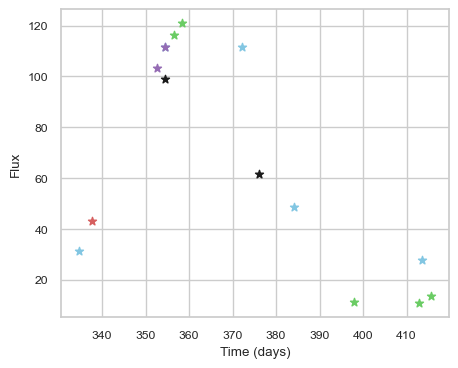

SNIax (3.9170794, False)
SNIax (3.830984, False)
SNIax (3.1282163, False)
SNIax (4.2774096, False)
SNIax (4.6435843, False)
SNIax (3.9895415, False)
SNIax (4.709781, False)
SNIax (4.13403, False)
SNIax (4.76464, False)
SNIax (4.658196, False)
SNIax (5.441597, False)
SNIax (4.1652336, False)
SNIax (5.3600345, False)
SNIax (4.958471, False)
SNIax (4.505155, False)
SNIax (4.5091705, False)
SNIax (4.8417993, False)
SNIax (4.7775865, False)
SNIax (5.1446686, False)
SNIax (5.3700976, False)
SNIax (5.3553076, False)
SNIax (5.484198, False)
SNIax (5.4864974, False)
SNIax (5.147556, False)
SNIax (5.2178216, False)
SNIax (5.081497, False)
SNIax (5.750492, False)
SNIax (4.9037952, False)
SNIax (5.2446117, False)
SNIax (5.162065, False)


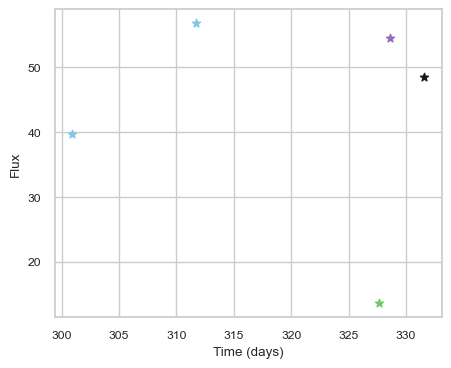

SNIax (4.1663437, False)
SNIax (5.066423, False)
SNIax (4.671581, False)
SNIax (5.5138073, False)
SNIax (5.3919463, False)
SNIax (4.753449, False)
SNIax (4.524208, False)
SNIax (4.672347, False)
SNIax (4.617507, False)
SNIax (4.4728494, False)


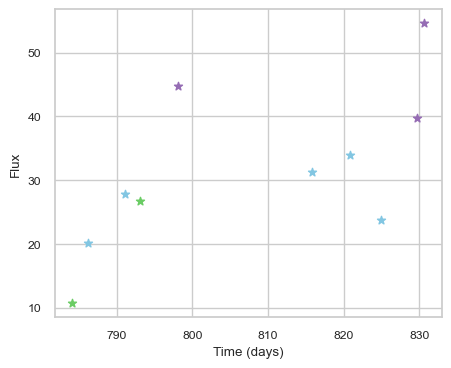

SNIax (4.9675965, False)
SNIax (4.085774, False)
SNIax (4.139125, False)
SNIax (4.2359695, False)
SNIax (4.5502367, False)
SNIax (4.9648457, False)
SNIax (4.7020545, False)
SNIax (5.1703362, False)
SNIax (5.26827, False)
SNIax (5.401578, False)
SNIax (5.654646, False)
SNIax (5.821941, False)
SNIax (5.710729, False)
SNIax (5.8693576, False)
SNIax (5.885346, False)
SNIax (5.774292, False)
SNIax (5.5398045, False)
SNIax (5.8514442, False)
SNIax (6.140257, False)
SNIax (5.9481435, False)


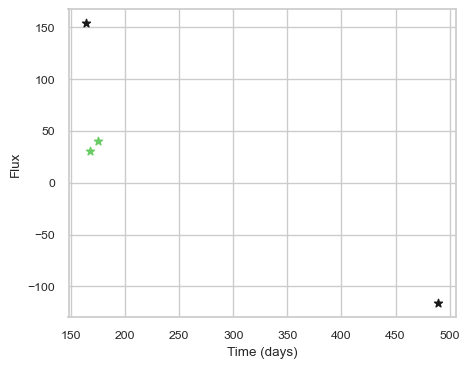

SNIax (4.2517643, False)
SNIax (4.420619, False)
SNIax (4.6782885, False)
SNIax (4.004683, False)
SNIax (3.8579202, False)
SNIax (3.8048863, False)
SNIax (3.7782247, False)
SNIax (3.882361, False)


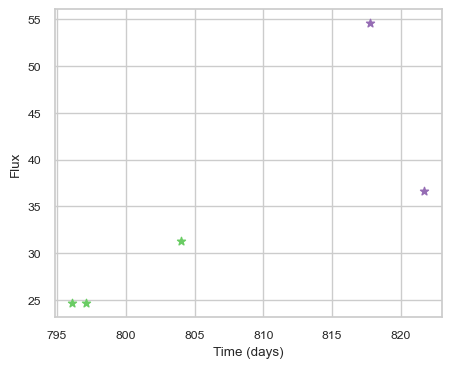

SNIax (4.070124, False)
SNIax (3.3967712, False)
SNIax (3.1990633, False)
SNIax (2.943608, False)
SNIax (3.209347, False)
SNIax (2.8662443, False)
SNIax (2.821814, False)
SNIax (3.173985, False)
SNIax (3.8015451, False)
SNIax (3.1740532, False)


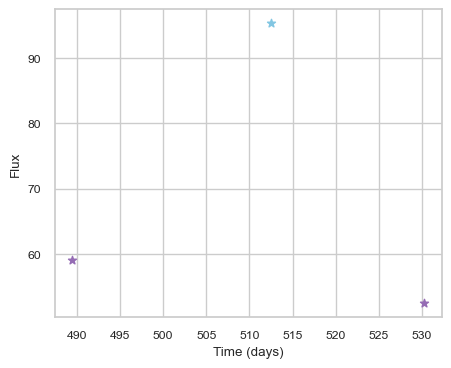

SNIax (3.8618083, False)
SNIax (3.9560406, False)
SNIax (3.2979662, False)
SNIax (3.6446972, False)
SNIax (3.7019422, False)
SNIax (3.3478837, False)


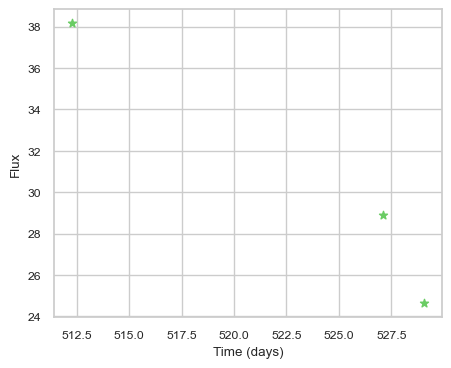

SNIax (4.5132957, False)
SNIax (4.552901, False)
SNIax (4.4051585, False)
SNIax (3.9067633, False)
SNIax (3.882662, False)
SNIax (3.5939534, False)


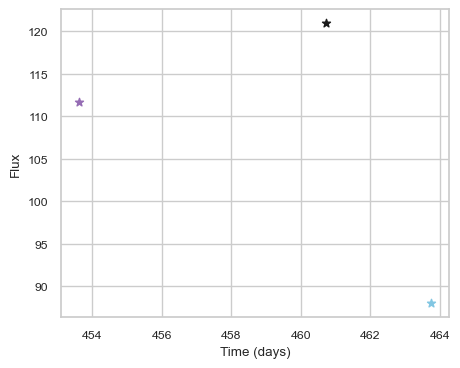

SNIax (4.2382927, False)
SNIax (4.311221, False)
SNIax (4.309174, False)
SNIax (5.088673, False)
SNIax (4.6161203, False)
SNIax (4.213069, False)


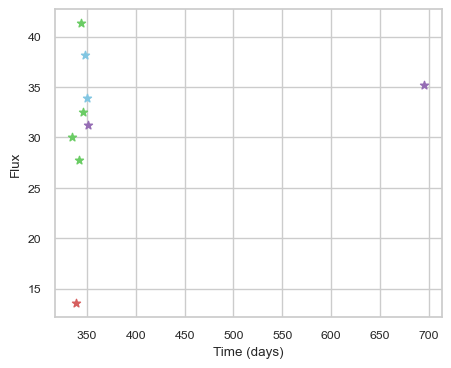

SNIax (4.2138968, False)
SNIax (4.1695957, False)
SNIax (3.808609, False)
SNIax (3.2528727, False)
SNIax (3.0613315, False)
SNIax (2.3339334, False)
SNIax (3.1107032, False)
SNIax (2.620278, False)
SNIax (3.0710447, False)
SNIax (2.1023738, False)
SNIax (2.5226169, False)
SNIax (2.0654044, False)
SNIax (2.3054736, False)
SNIax (1.7717618, False)
SNIax (1.82607, False)
SNIax (1.906491, False)
SNIax (2.471237, False)
SNIax (1.9862711, False)


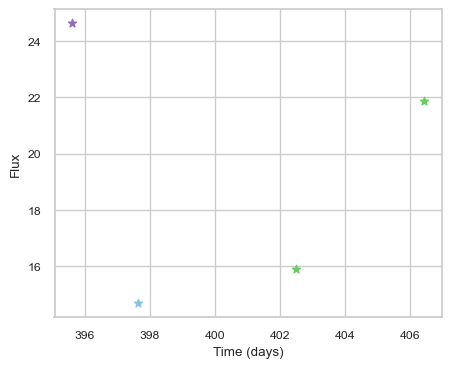

SNIax (4.03883, False)
SNIax (3.1699178, False)
SNIax (3.301484, False)
SNIax (3.3015318, False)
SNIax (3.3362105, False)
SNIax (3.0432146, False)
SNIax (3.0696747, False)
SNIax (2.8288484, False)


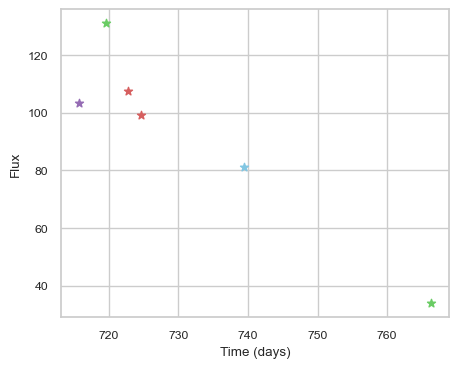

SNIax (3.8710623, False)
SNIax (3.685565, False)
SNIax (4.519568, False)
SNIax (4.478605, False)
SNIax (4.912565, False)
SNIax (4.568643, False)
SNIax (4.580773, False)
SNIax (4.465072, False)
SNIax (4.6991076, False)
SNIax (3.9873936, False)
SNIax (4.2410426, False)
SNIax (3.8181367, False)


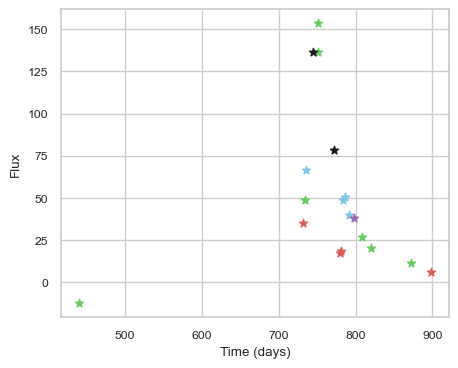

SNIax (4.090578, False)
SNIax (4.3281446, False)
SNIax (3.7727723, False)
SNIax (4.440357, False)
SNIax (5.0075483, False)
SNIax (2.89464, False)
SNIax (3.4678938, False)
SNIax (3.186585, False)
SNIax (3.4987438, False)
SNIax (3.4560838, False)
SNIax (3.2894123, False)
SNIax (3.3594606, False)
SNIax (4.021213, False)
SNIax (3.7799072, False)
SNIax (4.3612266, False)
SNIax (4.0536456, False)
SNIax (3.975516, False)
SNIax (5.2143216, False)
SNIax (5.5567393, False)
SNIax (5.2014246, False)
SNIax (5.743387, False)
SNIax (4.9382243, False)
SNIax (4.800264, False)
SNIax (4.5624638, False)
SNIax (4.8861904, False)
SNIax (4.614779, False)
SNIax (4.357123, False)
SNIax (4.294438, False)
SNIax (4.6493654, False)
SNIax (4.319434, False)
SNIax (3.9395537, False)
SNIax (4.301125, False)
SNIax (3.879019, False)
SNIax (3.982412, False)
SNIax (3.888315, False)
SNIax (4.4312053, False)


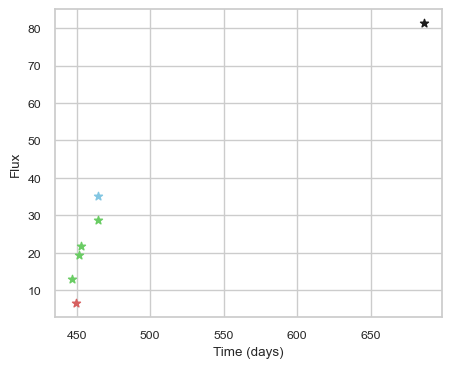

SNIax (4.0612726, False)
SNIax (3.4264035, False)
SNIax (3.5626776, False)
SNIax (3.1293597, False)
SNIax (2.6895602, False)
SNIax (2.5601296, False)
SNIax (2.9247437, False)
SNIax (2.5530205, False)
SNIax (2.8189118, False)
SNIax (2.638333, False)
SNIax (2.9726481, False)
SNIax (3.2274022, False)
SNIax (2.8463585, False)
SNIax (3.6618273, False)


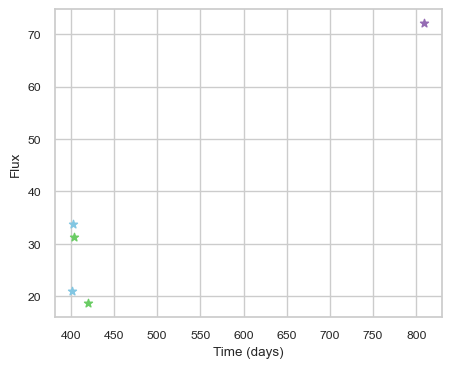

SNIax (3.9925241, False)
SNIax (3.3352637, False)
SNIax (3.342348, False)
SNIax (3.2420976, False)
SNIax (3.093718, False)
SNIax (2.744748, False)
SNIax (3.038372, False)
SNIax (2.7862473, False)
SNIax (3.3226683, False)
SNIax (3.0283697, False)


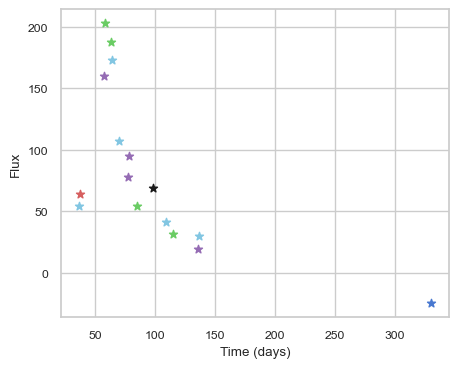

SNIax (3.879016, False)
SNIax (3.7699165, False)
SNIax (3.748071, False)
SNIax (3.7331903, False)
SNIax (3.5691142, False)
SNIax (3.3065584, False)
SNIax (4.107249, False)
SNIax (3.5145414, False)
SNIax (5.2306995, False)
SNIax (4.949005, False)
SNIax (4.9434314, False)
SNIax (5.1466227, False)
SNIax (4.9256577, False)
SNIax (5.4909306, False)
SNIax (5.5564475, False)
SNIax (5.2716236, False)
SNIax (5.919048, False)
SNIax (5.286484, False)
SNIax (5.3466473, False)
SNIax (5.443186, False)
SNIax (5.2925224, False)
SNIax (5.8897624, False)
SNIax (5.6493087, False)
SNIax (5.648374, False)
SNIax (5.471027, False)
SNIax (5.321518, False)
SNIax (5.7870264, False)
SNIax (5.5392265, False)
SNIax (5.631042, False)
SNIax (5.420712, False)
SNIax (5.924825, False)
SNIax (5.2555757, False)


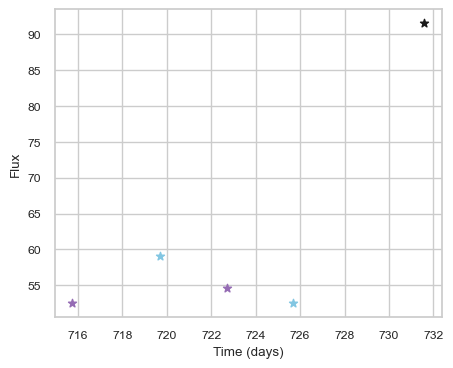

SNIax (3.9413579, False)
SNIax (3.4149666, False)
SNIax (3.9077113, False)
SNIax (4.052083, False)
SNIax (4.063755, False)
SNIax (2.7146747, False)
SNIax (3.2534535, False)
SNIax (2.539376, False)
SNIax (2.653439, False)
SNIax (3.2297513, False)


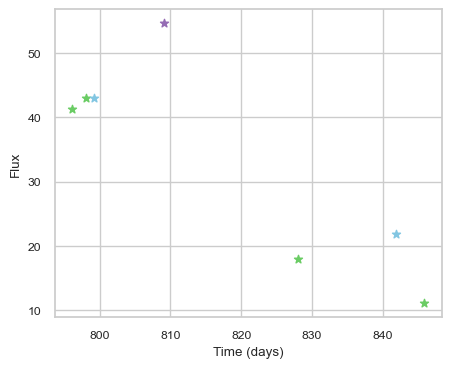

SNIax (3.8046048, False)
SNIax (3.413116, False)
SNIax (3.2420754, False)
SNIax (3.236998, False)
SNIax (2.7519572, False)
SNIax (2.8462377, False)
SNIax (2.7473452, False)
SNIax (3.1491618, False)
SNIax (3.0633187, False)
SNIax (2.7193205, False)
SNIax (2.8507195, False)
SNIax (2.4675326, False)
SNIax (3.7339578, False)
SNIax (3.033126, False)


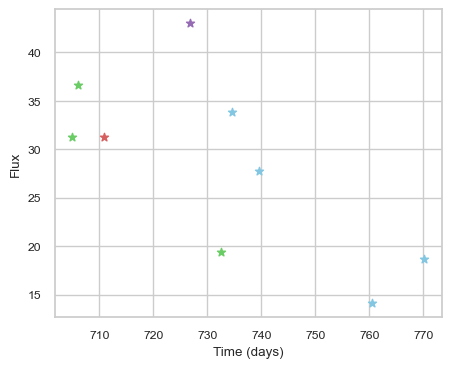

SNIax (3.9076607, False)
SNIax (3.341056, False)
SNIax (2.7516482, False)
SNIax (2.9708116, False)
SNIax (3.5964913, False)
SNIax (3.6111522, False)
SNIax (3.2705488, False)
SNIax (2.921545, False)
SNIax (3.939428, False)
SNIax (4.2707353, False)
SNIax (3.945041, False)
SNIax (4.373725, False)
SNIax (4.433356, False)
SNIax (4.6808696, False)
SNIax (5.348402, False)
SNIax (5.3918734, False)
SNIax (4.677838, False)
SNIax (5.306116, False)


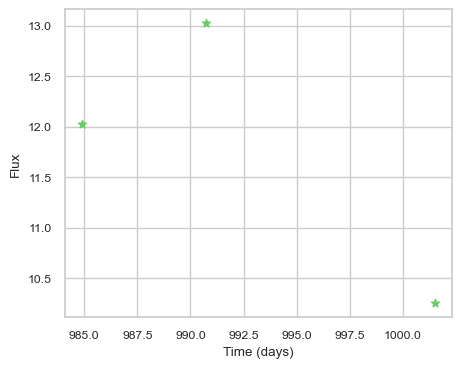

SNIax (4.869447, False)
SNIax (4.417838, False)
SNIax (4.7185516, False)
SNIax (3.9642956, False)
SNIax (4.0121155, False)
SNIax (3.5165825, False)


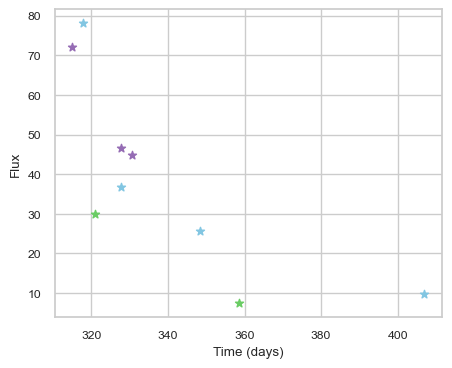

SNIax (3.801123, False)
SNIax (3.991483, False)
SNIax (3.954281, False)
SNIax (4.644154, False)
SNIax (4.631864, False)
SNIax (4.5995607, False)
SNIax (4.4952507, False)
SNIax (4.679422, False)
SNIax (4.5872054, False)
SNIax (4.27968, False)
SNIax (4.978783, False)
SNIax (4.350038, False)
SNIax (4.3887806, False)
SNIax (4.1400266, False)
SNIax (4.3320355, False)
SNIax (4.2415576, False)
SNIax (4.8980355, False)
SNIax (4.7108345, False)


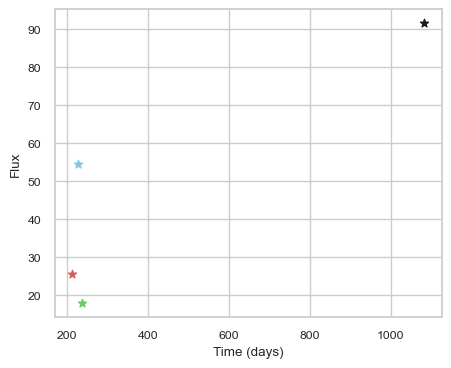

SNIax (3.7405493, False)
SNIax (3.317641, False)
SNIax (4.1619687, False)
SNIax (3.890434, False)
SNIax (3.8424397, False)
SNIax (3.821346, False)
SNIax (4.454103, False)
SNIax (3.1934307, False)


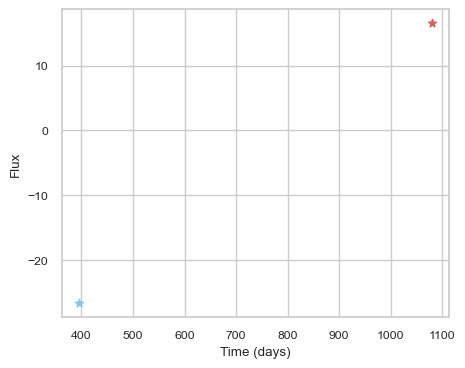

SNIax (3.9944158, False)
SNIax (3.642846, False)
SNIax (3.914648, False)
SNIax (4.292682, False)


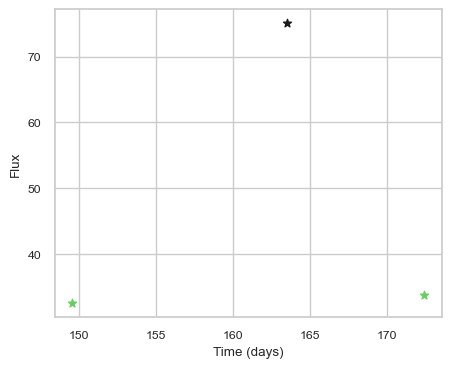

SNIax (4.0107327, False)
SNIax (4.3701262, False)
SNIax (4.00385, False)
SNIax (4.288047, False)
SNIax (4.362583, False)
SNIax (3.5924344, False)


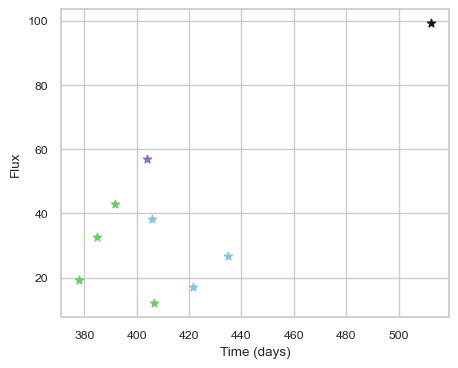

SNIax (3.7653604, False)
SNIax (3.5338988, False)
SNIax (3.4029193, False)
SNIax (3.1806293, False)
SNIax (3.443024, False)
SNIax (2.7705567, False)
SNIax (2.513511, False)
SNIax (2.1920738, False)
SNIax (2.7247503, False)
SNIax (2.466859, False)
SNIax (2.900752, False)
SNIax (2.4155905, False)
SNIax (2.3386207, False)
SNIax (2.2907746, False)
SNIax (2.3657656, False)
SNIax (2.1447606, False)
SNIax (3.4764526, False)
SNIax (5.041171, False)


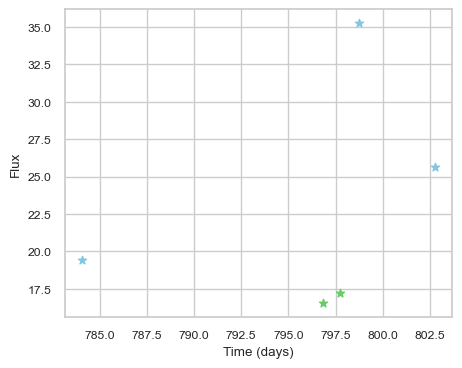

SNIax (4.77878, False)
SNIax (4.3230166, False)
SNIax (4.9681163, False)
SNIax (4.854291, False)
SNIax (5.141712, False)
SNIax (4.8797, False)
SNIax (5.093649, False)
SNIax (5.2506375, False)
SNIax (5.551943, False)
SNIax (5.1285796, False)


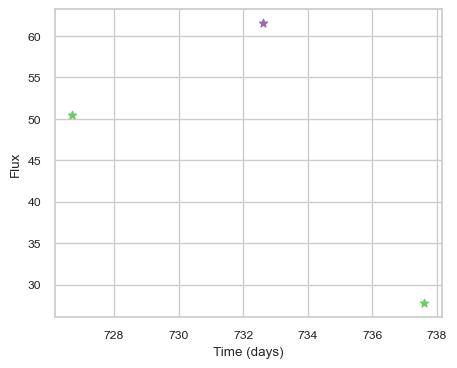

SNIax (4.0422344, False)
SNIax (3.832965, False)
SNIax (4.7170553, False)
SNIax (4.756766, False)
SNIax (4.929956, False)
SNIax (4.031958, False)


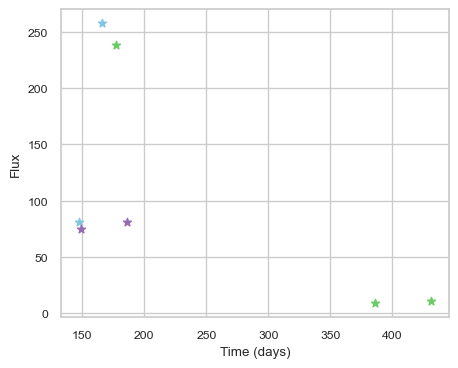

SNIax (3.8399305, False)
SNIax (4.352825, False)
SNIax (4.898229, False)
SNIax (4.5182476, False)
SNIax (4.946027, False)
SNIax (4.347715, False)
SNIax (5.38987, False)
SNIax (5.790192, False)
SNIax (5.8851132, False)
SNIax (5.730263, False)
SNIax (6.052137, False)
SNIax (5.9647155, False)
SNIax (5.728482, False)
SNIax (5.644495, False)


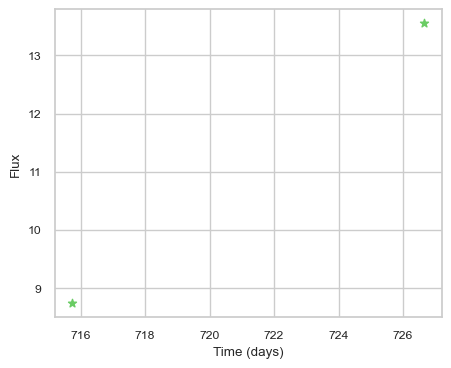

SNIax (4.1036863, False)
SNIax (3.4672832, False)
SNIax (3.2173638, False)
SNIax (3.121649, False)


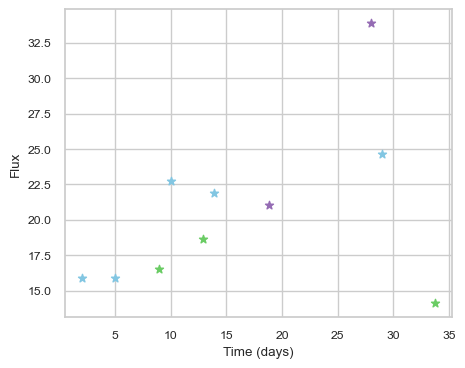

SNIax (4.6490703, False)
SNIax (3.5797863, False)
SNIax (2.9221632, False)
SNIax (3.299342, False)
SNIax (2.9963884, False)
SNIax (3.0634708, False)
SNIax (2.8674202, False)
SNIax (2.9468312, False)
SNIax (3.3630855, False)
SNIax (3.1114852, False)
SNIax (3.5263667, False)
SNIax (2.8146482, False)
SNIax (2.751139, False)
SNIax (2.859204, False)
SNIax (2.8376317, False)
SNIax (2.9984267, False)
SNIax (3.313742, False)
SNIax (3.2954185, False)
SNIax (3.1502693, False)
SNIax (3.252721, False)


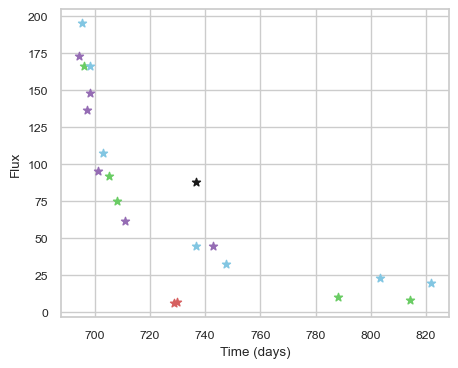

SNIax (3.7804992, False)
SNIax (3.6311805, False)
SNIax (5.4086213, False)
SNIax (4.8430552, False)
SNIax (5.8879733, False)
SNIax (5.46667, False)
SNIax (4.9340315, False)
SNIax (5.206005, False)
SNIax (6.1906686, False)
SNIax (5.6638427, False)
SNIax (5.4245844, False)
SNIax (5.9409165, False)
SNIax (5.936959, False)
SNIax (6.0276566, False)
SNIax (6.1826572, False)
SNIax (6.161065, False)
SNIax (5.6912894, False)
SNIax (5.862203, False)
SNIax (5.318789, False)
SNIax (6.109788, False)
SNIax (5.4479995, False)
SNIax (6.258456, False)
SNIax (6.214602, False)
SNIax (6.406912, False)
SNIax (6.438521, False)
SNIax (6.236258, False)
SNIax (6.3687606, False)
SNIax (6.4751415, False)
SNIax (6.606865, False)
SNIax (6.7831597, False)
SNIax (6.342577, False)
SNIax (6.325626, False)
SNIax (6.305472, False)
SNIax (6.1462526, False)
SNIax (6.088413, False)
SNIax (6.0529437, False)
SNIax (5.656523, False)
SNIax (5.828176, False)
SNIax (5.6763816, False)
SNIax (5.9867744, False)
SNIax (5.974732, Fal

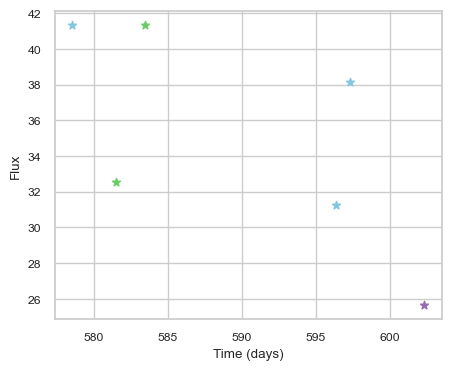

SNIax (3.6985335, False)
SNIax (3.435814, False)
SNIax (3.0820484, False)
SNIax (2.918973, False)
SNIax (3.7462142, False)
SNIax (3.0181236, False)
SNIax (2.9677737, False)
SNIax (3.2533216, False)
SNIax (3.4165072, False)
SNIax (3.5218065, False)
SNIax (4.0757375, False)
SNIax (3.6183512, False)


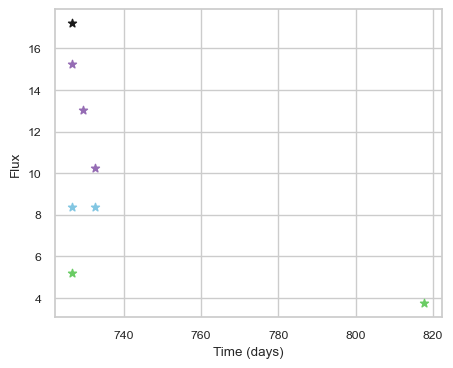

SNIax (3.8373494, False)
SNIax (3.496819, False)
SNIax (3.7633996, False)
SNIax (3.8502207, False)
SNIax (4.0410705, False)
SNIax (4.7050767, False)
SNIax (3.0324242, False)
SNIax (4.2175736, False)
SNIax (3.1093733, False)
SNIax (3.6870437, False)
SNIax (3.7176623, False)
SNIax (2.8684428, False)
SNIax (3.4262345, False)


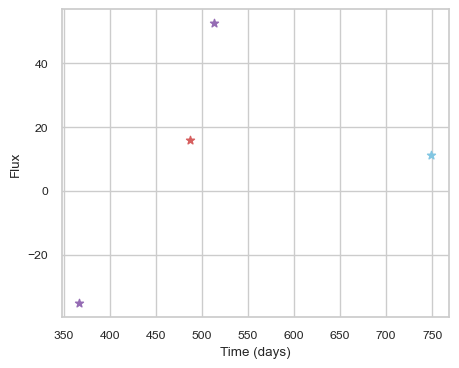

SNIax (3.8684206, False)
SNIax (3.7702494, False)
SNIax (4.014889, False)
SNIax (3.7588103, False)
SNIax (3.4704099, False)
SNIax (2.925107, False)
SNIax (3.924225, False)
SNIax (4.4972935, False)


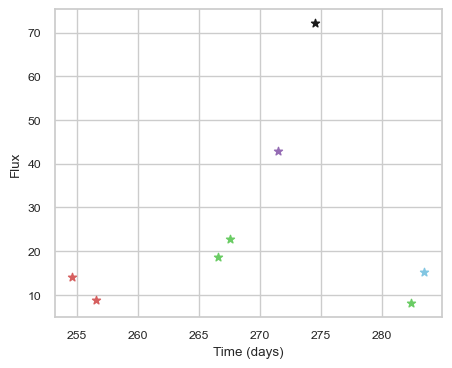

SNIax (4.2433457, False)
SNIax (3.7368941, False)
SNIax (3.5586126, False)
SNIax (4.6372623, False)
SNIax (3.8403156, False)
SNIax (3.9498107, False)
SNIax (3.9175687, False)
SNIax (3.6267464, False)
SNIax (4.356167, False)
SNIax (4.1491237, False)
SNIax (3.6816008, False)
SNIax (4.0851946, False)
SNIax (3.5589337, False)
SNIax (3.9029858, False)
SNIax (3.023127, False)
SNIax (3.5723777, False)


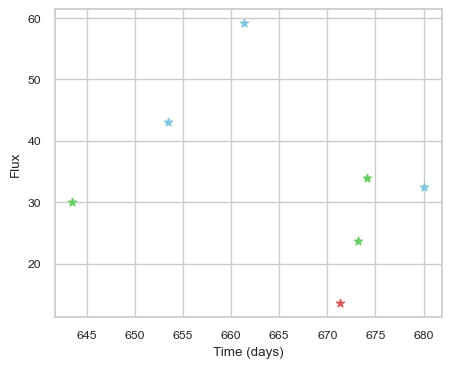

SNIax (4.012459, False)
SNIax (3.8479004, False)
SNIax (3.4102023, False)
SNIax (3.0895534, False)
SNIax (2.8575313, False)
SNIax (2.9552562, False)
SNIax (2.9865236, False)
SNIax (2.6928594, False)
SNIax (2.8191712, False)
SNIax (2.3842824, False)
SNIax (3.1228125, False)
SNIax (2.9509766, False)
SNIax (3.5811954, False)
SNIax (3.0652702, False)


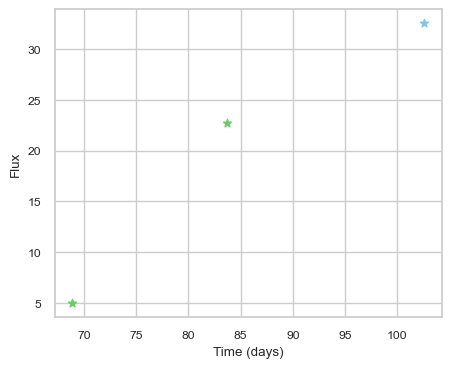

SNIax (4.4796205, False)
SNIax (4.07438, False)
SNIax (3.8361175, False)
SNIax (3.0396476, False)
SNIax (3.1729832, False)
SNIax (3.0524132, False)


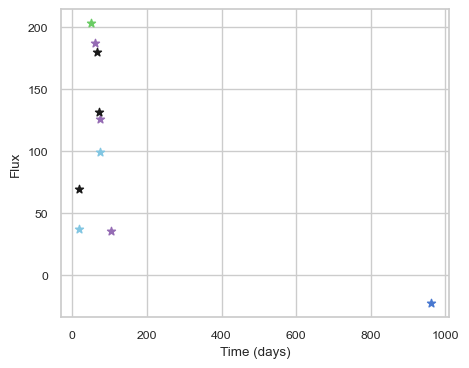

SNIax (4.1557856, False)
SNIax (3.5458343, False)
SNIax (3.7062159, False)
SNIax (3.8103683, False)
SNIax (4.275854, False)
SNIax (3.2373362, False)
SNIax (3.0541146, False)
SNIax (2.9028738, False)
SNIax (4.0392017, False)
SNIax (3.854972, False)
SNIax (3.656118, False)
SNIax (3.9119434, False)
SNIax (3.3020349, False)
SNIax (3.5663059, False)
SNIax (3.5433984, False)
SNIax (3.4772286, False)
SNIax (3.4666262, False)
SNIax (3.4798515, False)
SNIax (3.1702337, False)
SNIax (4.117827, False)


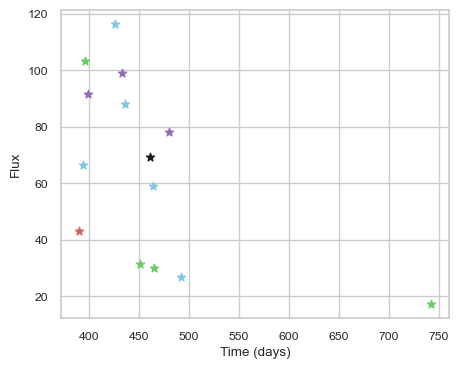

SNIax (3.830481, False)
SNIax (4.3776574, False)
SNIax (4.5544906, False)
SNIax (3.1040754, False)
SNIax (3.6100113, False)
SNIax (3.1422594, False)
SNIax (3.5004146, False)
SNIax (3.2680259, False)
SNIax (2.5430238, False)
SNIax (2.999644, False)
SNIax (3.1610355, False)
SNIax (1.9667411, False)
SNIax (2.846236, False)
SNIax (1.9187834, False)
SNIax (3.3778508, False)
SNIax (2.6061397, False)
SNIax (2.7845008, False)
SNIax (3.3865824, False)
SNIax (3.177835, False)
SNIax (2.3279612, False)
SNIax (2.6132164, False)
SNIax (3.2613552, False)
SNIax (3.0377767, False)
SNIax (3.5539184, False)
SNIax (4.1828423, False)
SNIax (3.2360313, False)
SNIax (3.3857594, False)
SNIax (3.6695778, False)


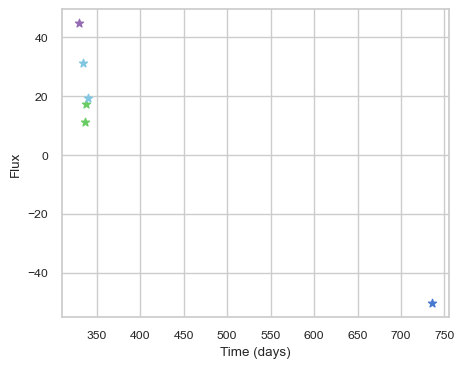

SNIax (4.045719, False)
SNIax (3.9736772, False)
SNIax (4.2859945, False)
SNIax (3.3567812, False)
SNIax (3.6794271, False)
SNIax (3.372274, False)
SNIax (3.1825454, False)
SNIax (3.0496404, False)
SNIax (3.2829893, False)
SNIax (2.7835274, False)
SNIax (3.336555, False)
SNIax (4.220453, False)


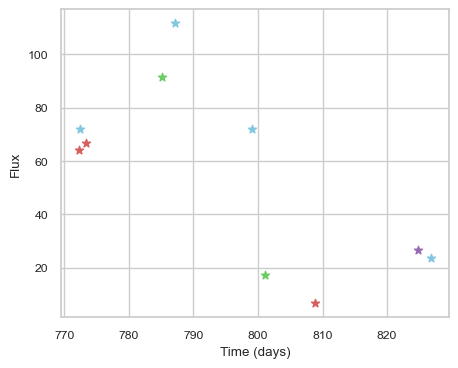

SNIax (3.8078907, False)
SNIax (4.2126255, False)
SNIax (4.729636, False)
SNIax (3.440999, False)
SNIax (3.7712996, False)
SNIax (3.6610448, False)
SNIax (3.4409478, False)
SNIax (3.067091, False)
SNIax (3.2445552, False)
SNIax (3.4604454, False)
SNIax (3.4019086, False)
SNIax (3.056856, False)
SNIax (3.347608, False)
SNIax (3.0095026, False)
SNIax (3.1624734, False)
SNIax (3.145482, False)
SNIax (3.919081, False)
SNIax (2.7823684, False)
SNIax (3.4429998, False)
SNIax (3.1575458, False)


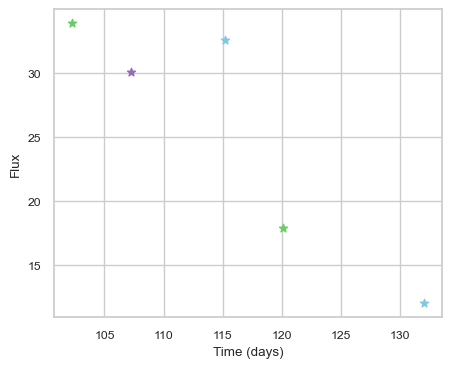

SNIax (3.8991594, False)
SNIax (3.6786726, False)
SNIax (3.7162645, False)
SNIax (4.791973, False)
SNIax (3.8603098, False)
SNIax (5.0658417, False)
SNIax (4.6006675, False)
SNIax (5.1590767, False)
SNIax (4.4414754, False)
SNIax (4.5858636, False)


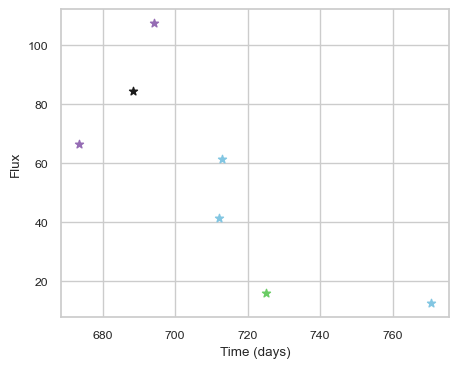

SNIax (3.9368744, False)
SNIax (4.049495, False)
SNIax (4.7020087, False)
SNIax (4.63374, False)
SNIax (4.7792735, False)
SNIax (4.605515, False)
SNIax (6.193005, False)
SNIax (5.8977256, False)
SNIax (5.8062963, False)
SNIax (5.9477634, False)
SNIax (4.885683, False)
SNIax (5.077777, False)
SNIax (5.1031647, False)
SNIax (4.7679124, False)


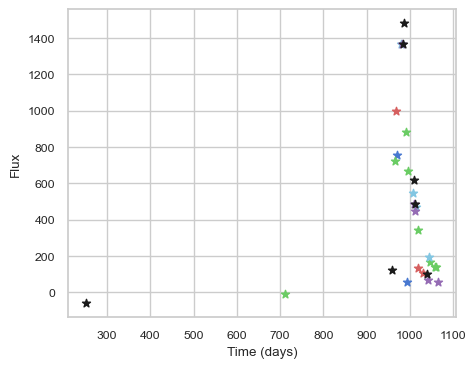

SNIax (3.5177817, False)
SNIax (3.7804666, False)
SNIax (3.4767148, False)
SNIax (4.165009, False)
SNIax (3.3100753, False)
SNIax (3.4246693, False)
SNIax (3.2377107, False)
SNIax (3.2213204, False)
SNIax (2.8019726, False)
SNIax (2.9158893, False)
SNIax (2.50958, False)
SNIax (3.3176203, False)
SNIax (3.046111, False)
SNIax (2.613583, False)
SNIax (2.0192537, False)
SNIax (2.4428725, False)
SNIax (2.1778681, False)
SNIax (2.7239115, False)
SNIax (2.2301965, False)
SNIax (2.8587713, False)
SNIax (1.969965, False)
SNIax (2.0871649, False)
SNIax (2.3513503, False)
SNIax (2.6958458, False)
SNIax (3.0482879, False)
SNIax (2.7224362, False)
SNIax (2.5722492, False)
SNIax (2.3675094, False)
SNIax (2.9688714, False)
SNIax (3.182809, False)
SNIax (3.2859719, False)
SNIax (2.2248294, False)
SNIax (2.90627, False)
SNIax (2.9014115, False)
SNIax (3.4082654, False)
SNIax (2.2655344, False)
SNIax (2.922671, False)
SNIax (2.5617552, False)
SNIax (2.9575837, False)
SNIax (3.223459, False)
SNIax (2.86

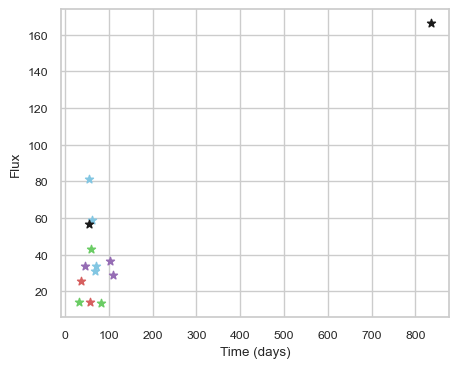

SNIax (3.9226534, False)
SNIax (3.1704314, False)
SNIax (3.3655155, False)
SNIax (3.702296, False)
SNIax (3.2871757, False)
SNIax (3.6218638, False)
SNIax (3.8364153, False)
SNIax (3.4399703, False)
SNIax (3.6676824, False)
SNIax (3.0376363, False)
SNIax (3.2812567, False)
SNIax (2.8407345, False)
SNIax (3.2587993, False)
SNIax (3.2843566, False)
SNIax (3.592829, False)
SNIax (2.9047306, False)
SNIax (2.9171612, False)
SNIax (2.7840574, False)
SNIax (2.854813, False)
SNIax (2.516946, False)
SNIax (2.824047, False)
SNIax (3.0894063, False)
SNIax (2.8919616, False)
SNIax (2.5860386, False)
SNIax (2.4844928, False)
SNIax (2.8033323, False)
SNIax (2.784628, False)
SNIax (2.9677413, False)


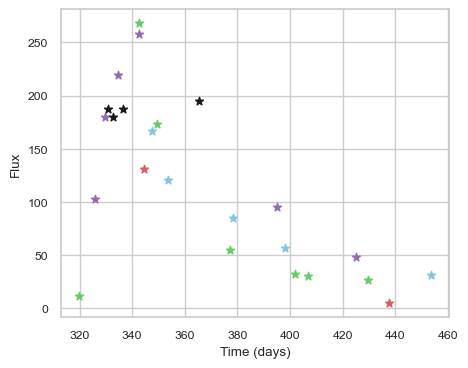

SNIax (3.65939, False)
SNIax (3.854853, False)
SNIax (3.2949204, False)
SNIax (3.7546678, False)
SNIax (3.7039587, False)
SNIax (3.3141727, False)
SNIax (3.671536, False)
SNIax (3.205573, False)
SNIax (3.7785869, False)
SNIax (3.1148298, False)
SNIax (3.8114345, False)
SNIax (2.8386195, False)
SNIax (3.4493463, False)
SNIax (3.5898368, False)
SNIax (3.1751976, False)
SNIax (3.1846626, False)
SNIax (3.0988283, False)
SNIax (2.1933506, False)
SNIax (3.2204936, False)
SNIax (2.6352475, False)
SNIax (2.2341287, False)
SNIax (2.5674558, False)
SNIax (2.8425062, False)
SNIax (2.5352724, False)
SNIax (2.6847334, False)
SNIax (2.9315028, False)
SNIax (2.8090503, False)
SNIax (2.5740898, False)
SNIax (3.5257976, False)
SNIax (3.0167441, False)
SNIax (2.960294, False)
SNIax (3.2877698, False)
SNIax (2.886679, False)
SNIax (2.6583726, False)
SNIax (3.0558658, False)
SNIax (2.685289, False)
SNIax (2.850818, False)
SNIax (2.7158704, False)
SNIax (2.9769313, False)
SNIax (2.352177, False)
SNIax (2.8

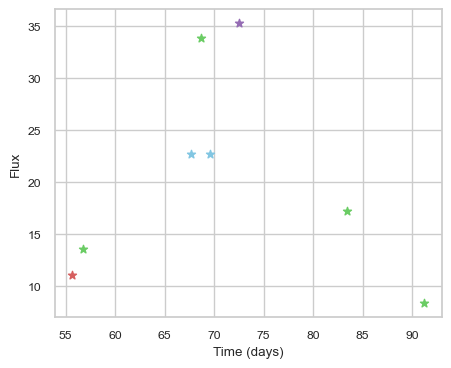

SNIax (4.043849, False)
SNIax (3.4802372, False)
SNIax (3.1692626, False)
SNIax (4.2797294, False)
SNIax (3.9617689, False)
SNIax (3.897908, False)
SNIax (3.6708121, False)
SNIax (3.5258696, False)
SNIax (4.685616, False)
SNIax (3.8501453, False)
SNIax (3.9674575, False)
SNIax (4.087981, False)
SNIax (3.3078465, False)
SNIax (3.8277245, False)
SNIax (3.6437316, False)
SNIax (3.883753, False)


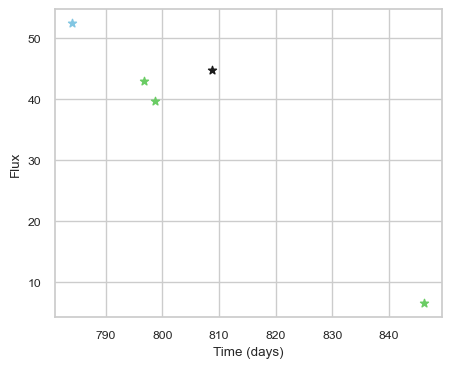

SNIax (3.8887, False)
SNIax (3.586478, False)
SNIax (3.4021802, False)
SNIax (3.0528197, False)
SNIax (3.9751487, False)
SNIax (3.982365, False)
SNIax (4.3498197, False)
SNIax (5.17738, False)
SNIax (4.4987845, False)
SNIax (4.399433, False)


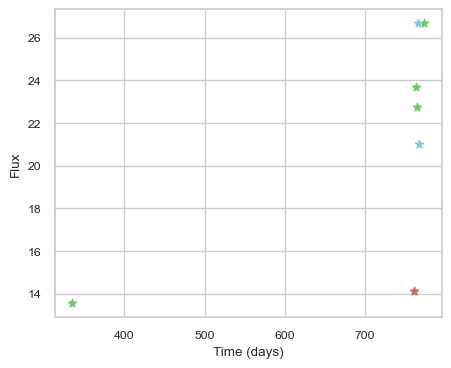

SNIax (4.1369176, False)
SNIax (3.7881184, False)
SNIax (3.9740436, False)
SNIax (4.1165357, False)
SNIax (3.3847926, False)
SNIax (2.6223612, False)
SNIax (3.4933014, False)
SNIax (2.5028443, False)
SNIax (3.254105, False)
SNIax (2.6997862, False)
SNIax (2.8568995, False)
SNIax (2.5283966, False)
SNIax (2.803585, False)
SNIax (2.9991114, False)


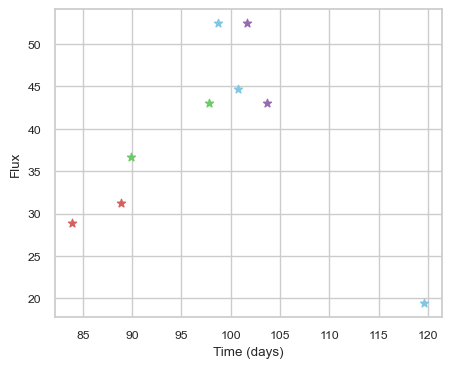

SNIax (3.7577856, False)
SNIax (4.16982, False)
SNIax (4.1228657, False)
SNIax (4.8533573, False)
SNIax (3.396764, False)
SNIax (4.0964823, False)
SNIax (5.20535, False)
SNIax (4.6981583, False)
SNIax (4.030474, False)
SNIax (4.224515, False)
SNIax (4.183084, False)
SNIax (4.2350116, False)
SNIax (4.1587567, False)
SNIax (4.383773, False)
SNIax (4.718533, False)
SNIax (4.48123, False)
SNIax (4.510632, False)
SNIax (4.8195453, False)


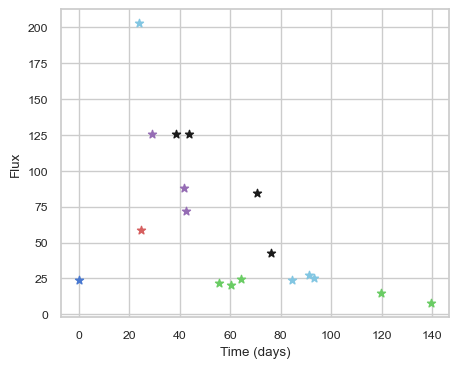

SNIax (4.1624107, False)
SNIax (4.444028, False)
SNIax (6.1247964, False)
SNIax (6.3851175, False)
SNIax (6.328187, False)
SNIax (6.316198, False)
SNIax (6.524253, False)
SNIax (6.997137, False)
SNIax (6.905496, False)
SNIax (7.05903, False)
SNIax (6.670102, False)
SNIax (6.850442, False)
SNIax (6.9324684, False)
SNIax (6.957809, False)
SNIax (6.974463, False)
SNIax (6.931956, False)
SNIax (7.2384367, False)
SNIax (7.372207, False)
SNIax (7.20904, False)
SNIax (7.1093774, False)
SNIax (6.9694653, False)
SNIax (6.725875, False)
SNIax (7.108573, False)
SNIax (6.8758316, False)
SNIax (7.046494, False)
SNIax (6.737337, False)
SNIax (6.692264, False)
SNIax (6.3343987, False)
SNIax (6.9017158, False)
SNIax (6.709048, False)
SNIax (6.6385994, False)
SNIax (6.6872478, False)
SNIax (6.789544, False)
SNIax (6.8494916, False)
SNIax (6.955953, False)


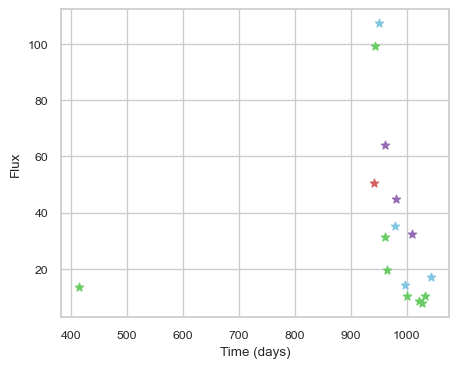

SNIax (3.9147232, False)
SNIax (3.6398518, False)
SNIax (3.493036, False)
SNIax (3.9726636, False)
SNIax (4.03886, False)
SNIax (4.442729, False)
SNIax (5.4474387, False)
SNIax (5.1660304, False)
SNIax (5.011196, False)
SNIax (4.761532, False)
SNIax (5.6795382, False)
SNIax (5.0565577, False)
SNIax (4.8218775, False)
SNIax (5.0589375, False)
SNIax (4.74073, False)
SNIax (4.5503545, False)
SNIax (5.0818157, False)
SNIax (4.954809, False)
SNIax (5.3409996, False)
SNIax (4.7979183, False)
SNIax (4.46093, False)
SNIax (4.6351924, False)
SNIax (4.508081, False)
SNIax (4.195661, False)
SNIax (4.940104, False)
SNIax (4.3844943, False)
SNIax (4.6218734, False)
SNIax (4.0150094, False)
SNIax (4.6066937, False)
SNIax (4.436256, False)
SNIax (4.5498123, False)
SNIax (4.296486, False)


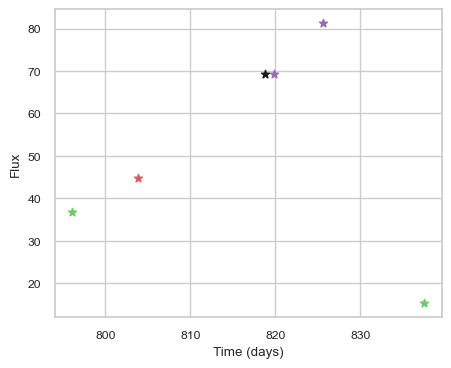

SNIax (3.8894646, False)
SNIax (3.3653095, False)
SNIax (3.0915287, False)
SNIax (4.1492147, False)
SNIax (3.3863456, False)
SNIax (3.3507893, False)
SNIax (4.3150578, False)
SNIax (3.101198, False)
SNIax (3.0587327, False)
SNIax (3.4104881, False)
SNIax (3.884092, False)
SNIax (3.8516493, False)


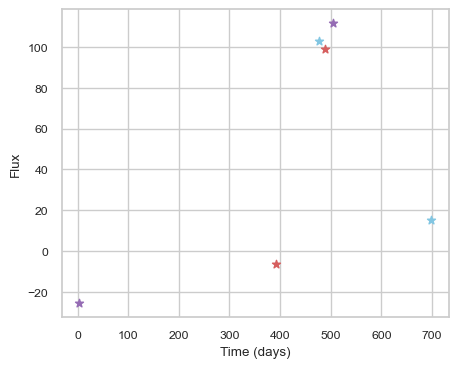

SNIax (4.0625687, False)
SNIax (3.3675754, False)
SNIax (3.9034414, False)
SNIax (4.1764054, False)
SNIax (3.5669386, False)
SNIax (4.2671323, False)
SNIax (4.8877864, False)
SNIax (4.802943, False)
SNIax (5.936905, False)
SNIax (5.7345886, False)
SNIax (6.3884296, False)
SNIax (5.441014, False)


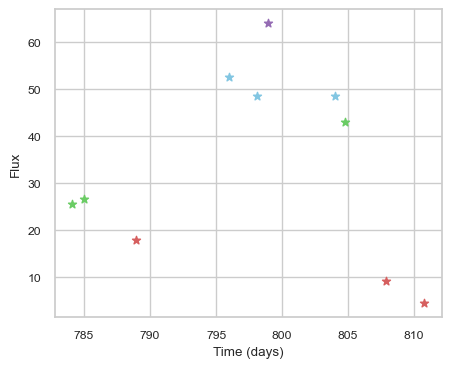

SNIax (3.855453, False)
SNIax (3.4498878, False)
SNIax (3.3147225, False)
SNIax (3.562986, False)
SNIax (3.640321, False)
SNIax (3.1947985, False)
SNIax (2.9287417, False)
SNIax (2.4171221, False)
SNIax (3.1096823, False)
SNIax (3.19915, False)
SNIax (3.274677, False)
SNIax (3.1426404, False)
SNIax (3.1092927, False)
SNIax (3.0066805, False)
SNIax (3.2263393, False)
SNIax (2.7543957, False)
SNIax (3.1904008, False)
SNIax (2.8607132, False)
SNIax (2.744475, False)
SNIax (2.5650146, False)


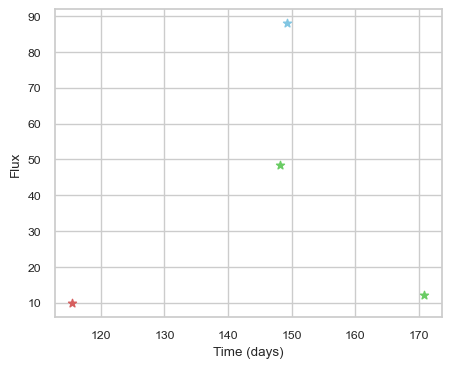

SNIax (4.305309, False)
SNIax (4.1179805, False)
SNIax (3.628578, False)
SNIax (3.876269, False)
SNIax (3.1182716, False)
SNIax (4.1024113, False)
SNIax (3.871049, False)
SNIax (3.6467817, False)


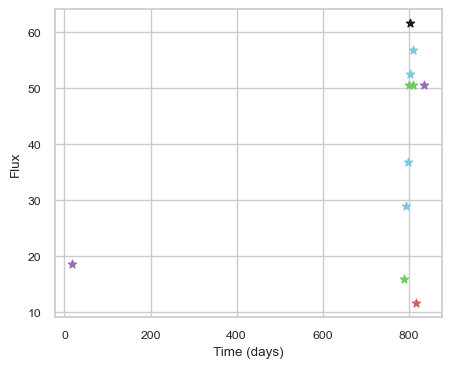

SNIax (4.0279336, False)
SNIax (3.9479148, False)
SNIax (3.7784114, False)
SNIax (2.913036, False)
SNIax (3.3306668, False)
SNIax (3.212688, False)
SNIax (3.06305, False)
SNIax (3.425986, False)
SNIax (3.2082064, False)
SNIax (3.051978, False)
SNIax (3.4140742, False)
SNIax (3.8361952, False)
SNIax (2.938455, False)
SNIax (3.016624, False)
SNIax (2.8672523, False)
SNIax (2.6328492, False)
SNIax (2.9986532, False)
SNIax (2.6978016, False)
SNIax (2.781348, False)
SNIax (2.5265667, False)
SNIax (2.7497022, False)
SNIax (2.2664075, False)


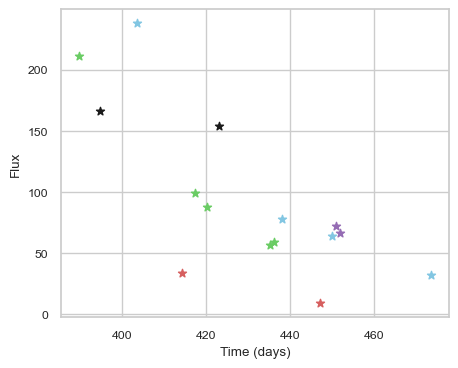

SNIax (3.7916393, False)
SNIax (3.2021544, False)
SNIax (3.9900436, False)
SNIax (3.540071, False)
SNIax (4.3129086, False)
SNIax (4.3189054, False)
SNIax (3.4033294, False)
SNIax (3.5005255, False)
SNIax (3.8583786, False)
SNIax (3.6486702, False)
SNIax (3.3754234, False)
SNIax (3.5918355, False)
SNIax (3.533642, False)
SNIax (3.5179398, False)
SNIax (3.3858583, False)
SNIax (3.9201937, False)
SNIax (2.9850056, False)
SNIax (3.5979826, False)
SNIax (3.131877, False)
SNIax (3.5973523, False)
SNIax (3.385792, False)
SNIax (3.8140638, False)
SNIax (3.8697007, False)
SNIax (3.5760632, False)
SNIax (3.419512, False)
SNIax (3.4307125, False)
SNIax (3.7469828, False)
SNIax (3.5599947, False)
SNIax (3.8516345, False)
SNIax (3.6439147, False)


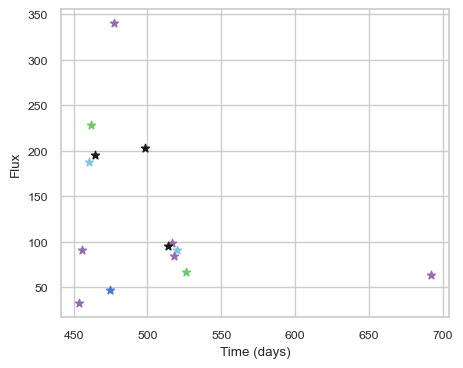

SNIax (3.776408, False)
SNIax (3.684939, False)
SNIax (3.2518032, False)
SNIax (3.8233266, False)
SNIax (3.366775, False)
SNIax (3.828651, False)
SNIax (3.112551, False)
SNIax (3.039774, False)
SNIax (3.430787, False)
SNIax (3.6350365, False)
SNIax (2.9836884, False)
SNIax (3.472465, False)
SNIax (3.1221502, False)
SNIax (2.9957376, False)
SNIax (2.6096077, False)
SNIax (3.335815, False)
SNIax (3.079872, False)
SNIax (3.4408493, False)
SNIax (2.9956086, False)
SNIax (3.0620394, False)
SNIax (3.346237, False)
SNIax (3.3111773, False)
SNIax (3.141344, False)
SNIax (3.1685262, False)
SNIax (2.9139788, False)
SNIax (2.7267601, False)
SNIax (3.077679, False)
SNIax (3.0759118, False)


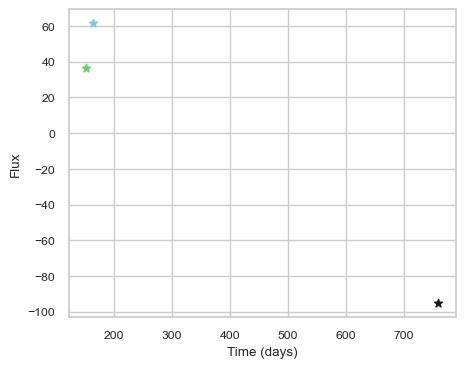

SNIax (3.9161956, False)
SNIax (4.1238875, False)
SNIax (4.045367, False)
SNIax (4.333094, False)
SNIax (4.4401836, False)
SNIax (4.177517, False)


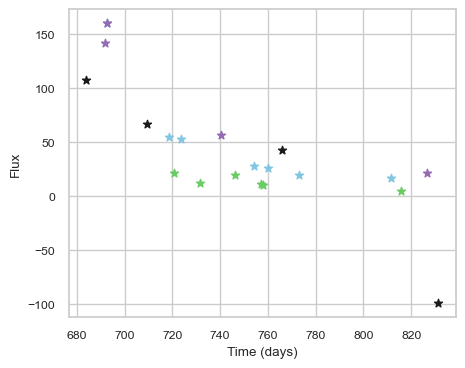

SNIax (3.831723, False)
SNIax (3.884772, False)
SNIax (3.953445, False)
SNIax (4.2146964, False)
SNIax (5.524242, False)
SNIax (5.4801164, False)
SNIax (6.3385615, False)
SNIax (6.0000257, False)
SNIax (6.7312393, False)
SNIax (6.509261, False)
SNIax (6.9027953, False)
SNIax (6.561374, False)
SNIax (6.7040963, False)
SNIax (6.413964, False)
SNIax (6.303894, False)
SNIax (6.5230284, False)
SNIax (6.157969, False)
SNIax (6.608636, False)
SNIax (6.487918, False)
SNIax (6.319031, False)
SNIax (6.6826463, False)
SNIax (6.3253946, False)
SNIax (6.1829424, False)
SNIax (6.319441, False)
SNIax (6.316662, False)
SNIax (6.1766324, False)
SNIax (6.366634, False)
SNIax (6.202701, False)
SNIax (6.2989683, False)
SNIax (6.1428947, False)
SNIax (6.1658115, False)
SNIax (6.556485, False)
SNIax (6.1628633, False)
SNIax (5.846949, False)
SNIax (6.592309, False)
SNIax (6.1004186, False)
SNIax (6.0627656, False)
SNIax (5.9825664, False)
SNIax (6.313593, False)
SNIax (6.048448, False)
SNIax (6.701567, Fals

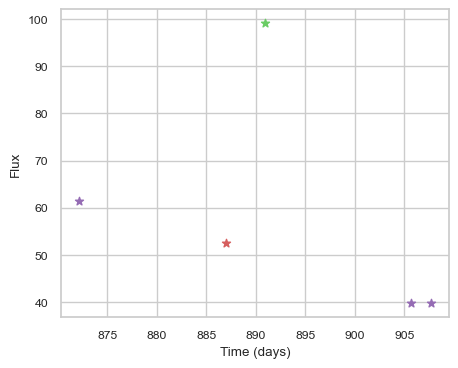

SNIax (3.8474555, False)
SNIax (4.2401614, False)
SNIax (4.957723, False)
SNIax (5.4735656, False)
SNIax (5.5609455, False)
SNIax (5.5373, False)
SNIax (5.603375, False)
SNIax (5.325013, False)
SNIax (6.0813603, False)
SNIax (5.5967197, False)


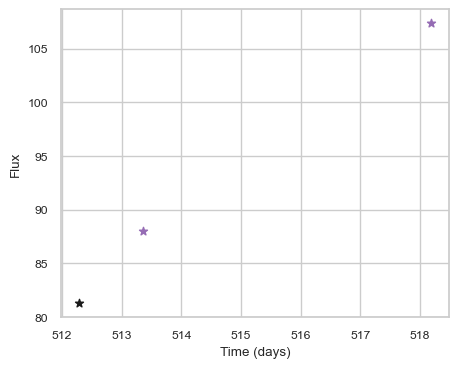

SNIax (3.8405502, False)
SNIax (4.4760566, False)
SNIax (4.5484977, False)
SNIax (4.425316, False)
SNIax (5.0108995, False)
SNIax (4.88038, False)


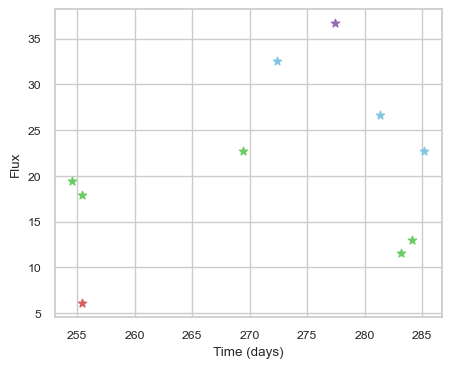

SNIax (4.1470156, False)
SNIax (3.4651637, False)
SNIax (3.6443567, False)
SNIax (3.9104319, False)
SNIax (3.6012313, False)
SNIax (2.708855, False)
SNIax (2.9941518, False)
SNIax (2.2743802, False)
SNIax (2.55981, False)
SNIax (2.7860398, False)
SNIax (2.8215053, False)
SNIax (2.8222432, False)
SNIax (3.0717752, False)
SNIax (2.8979025, False)
SNIax (3.1114724, False)
SNIax (2.6973813, False)
SNIax (3.065635, False)
SNIax (2.882479, False)
SNIax (2.6889927, False)
SNIax (2.6324847, False)


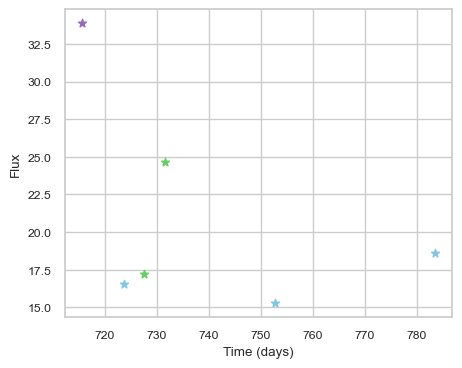

SNIax (4.426388, False)
SNIax (4.141402, False)
SNIax (4.2935934, False)
SNIax (3.936334, False)
SNIax (3.321514, False)
SNIax (2.792499, False)
SNIax (3.3010628, False)
SNIax (2.5855882, False)
SNIax (2.643214, False)
SNIax (3.1426167, False)
SNIax (4.2954316, False)
SNIax (3.5470066, False)


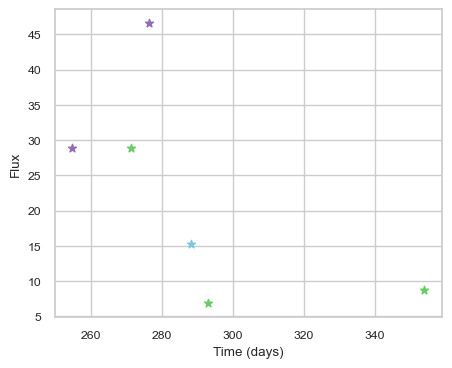

SNIax (4.456544, False)
SNIax (4.0456576, False)
SNIax (4.3975115, False)
SNIax (3.6134732, False)
SNIax (3.8596783, False)
SNIax (3.8409033, False)
SNIax (3.7724063, False)
SNIax (3.1629078, False)
SNIax (3.122281, False)
SNIax (3.4474506, False)
SNIax (3.9840534, False)
SNIax (3.9775622, False)


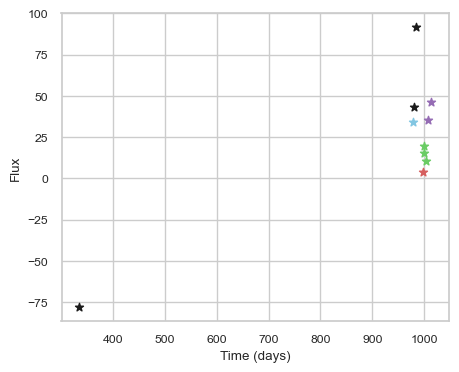

SNIax (4.5826974, False)
SNIax (4.767818, False)
SNIax (4.7638044, False)
SNIax (4.6476617, False)
SNIax (4.3944416, False)
SNIax (4.9345746, False)
SNIax (4.962861, False)
SNIax (5.0014615, False)
SNIax (4.368496, False)
SNIax (4.5326624, False)
SNIax (4.538451, False)
SNIax (4.018297, False)
SNIax (3.7469268, False)
SNIax (3.6288586, False)
SNIax (3.613587, False)
SNIax (3.4981856, False)
SNIax (3.5212266, False)
SNIax (3.1532896, False)
SNIax (3.1904879, False)
SNIax (2.9200697, False)


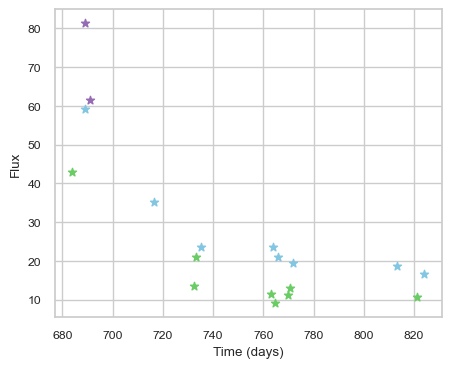

SNIax (3.7845697, False)
SNIax (3.8589022, False)
SNIax (3.3425927, False)
SNIax (2.9808617, False)
SNIax (3.5533555, False)
SNIax (3.0004134, False)
SNIax (3.605205, False)
SNIax (2.606304, False)
SNIax (3.8347063, False)
SNIax (3.7374604, False)
SNIax (3.7293003, False)
SNIax (3.1370227, False)
SNIax (2.623533, False)
SNIax (2.8750277, False)
SNIax (2.934623, False)
SNIax (2.3975482, False)
SNIax (2.7937555, False)
SNIax (2.5478327, False)
SNIax (2.2367756, False)
SNIax (2.2519922, False)
SNIax (2.620704, False)
SNIax (2.295626, False)
SNIax (2.3293777, False)
SNIax (2.137462, False)
SNIax (2.5209932, False)
SNIax (2.0650694, False)
SNIax (2.3720806, False)
SNIax (2.3060033, False)
SNIax (2.199466, False)
SNIax (2.1173382, False)
SNIax (2.541006, False)
SNIax (2.4071815, False)
SNIax (2.5213854, False)
SNIax (2.7786539, False)
SNIax (2.9756582, False)
SNIax (2.2912652, False)


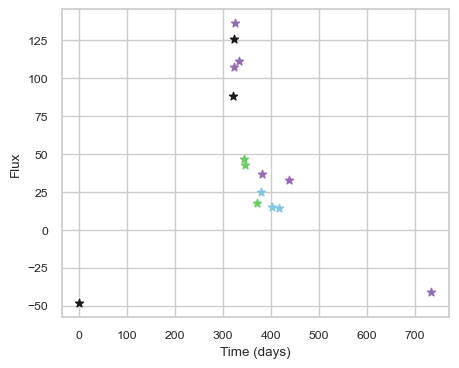

SNIax (4.4825687, False)
SNIax (4.226121, False)
SNIax (4.3724127, False)
SNIax (4.6886816, False)
SNIax (4.589872, False)
SNIax (4.9065886, False)
SNIax (5.6728525, False)
SNIax (4.433832, False)
SNIax (4.5060163, False)
SNIax (3.8876805, False)
SNIax (3.615133, False)
SNIax (3.9863245, False)
SNIax (4.7642264, False)
SNIax (4.644308, False)
SNIax (4.6438656, False)
SNIax (4.8772025, False)
SNIax (4.8643703, False)
SNIax (4.5238714, False)
SNIax (4.721853, False)
SNIax (3.9552732, False)
SNIax (4.538334, False)
SNIax (4.484091, False)
SNIax (4.624948, False)
SNIax (3.9186459, False)
SNIax (4.5124764, False)
SNIax (4.196959, False)
SNIax (4.4866757, False)
SNIax (4.7688327, False)
SNIax (4.4264708, False)


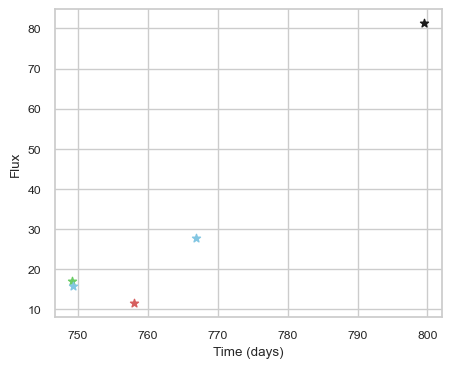

SNIax (3.9151216, False)
SNIax (3.2891781, False)
SNIax (3.4855921, False)
SNIax (3.5484679, False)
SNIax (3.142377, False)
SNIax (3.3124974, False)
SNIax (3.2412252, False)
SNIax (3.3950117, False)
SNIax (3.7395637, False)
SNIax (4.001576, False)


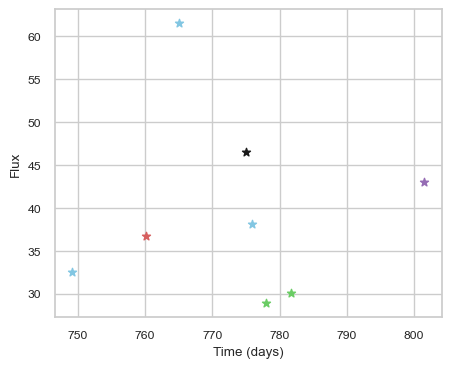

SNIax (3.821697, False)
SNIax (3.4204462, False)
SNIax (3.2194426, False)
SNIax (4.077524, False)
SNIax (3.814721, False)
SNIax (2.9066653, False)
SNIax (3.8515184, False)
SNIax (3.6224434, False)
SNIax (3.4211123, False)
SNIax (2.512397, False)
SNIax (3.2524605, False)
SNIax (2.7036731, False)
SNIax (3.6442823, False)
SNIax (3.084691, False)
SNIax (3.2745764, False)
SNIax (3.4511032, False)


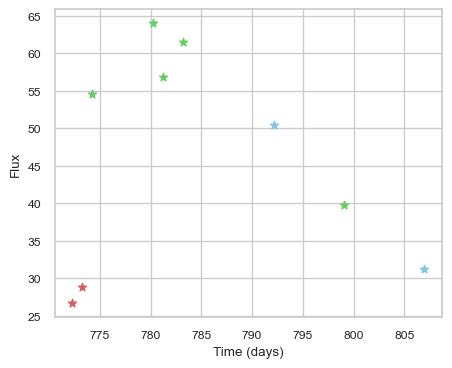

SNIax (3.7444525, False)
SNIax (3.8068922, False)
SNIax (4.7253203, False)
SNIax (4.491873, False)
SNIax (4.6370034, False)
SNIax (3.5306494, False)
SNIax (4.1706047, False)
SNIax (4.1380515, False)
SNIax (3.467531, False)
SNIax (3.421128, False)
SNIax (3.287064, False)
SNIax (3.2409155, False)
SNIax (3.326728, False)
SNIax (3.6110492, False)
SNIax (3.2585025, False)
SNIax (3.523291, False)
SNIax (3.6975112, False)
SNIax (3.686512, False)


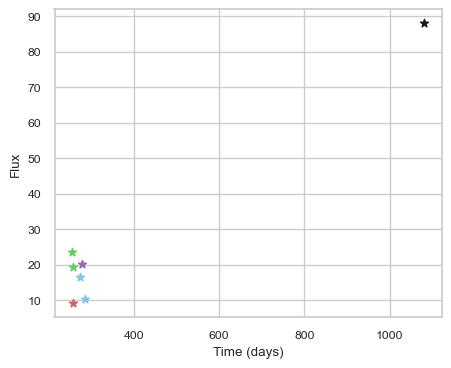

SNIax (3.627027, False)
SNIax (3.505708, False)
SNIax (3.210544, False)
SNIax (3.3783364, False)
SNIax (3.3985305, False)
SNIax (3.5767899, False)
SNIax (3.3435733, False)
SNIax (3.415813, False)
SNIax (3.6079369, False)
SNIax (3.375595, False)
SNIax (3.1830842, False)
SNIax (4.22769, False)
SNIax (3.8981156, False)
SNIax (3.7112715, False)


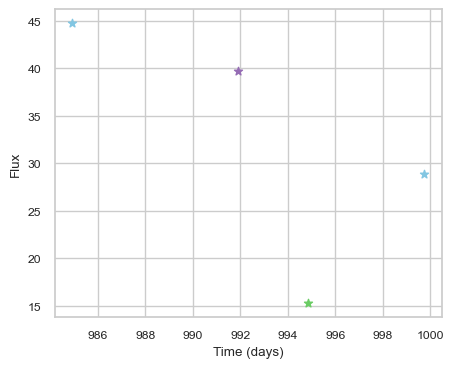

SNIax (3.838213, False)
SNIax (3.6843913, False)
SNIax (3.7516468, False)
SNIax (3.8205554, False)
SNIax (3.5697472, False)
SNIax (3.8822572, False)
SNIax (3.634739, False)
SNIax (3.336774, False)


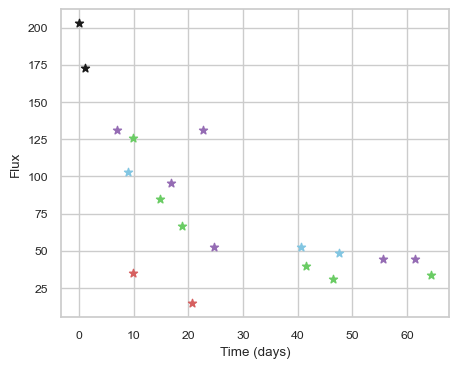

SNIax (4.079714, False)
SNIax (4.0755267, False)
SNIax (4.725049, False)
SNIax (4.1199365, False)
SNIax (5.1010857, False)
SNIax (3.8055966, False)
SNIax (3.7785997, False)
SNIax (4.35755, False)
SNIax (5.07603, False)
SNIax (4.6177945, False)
SNIax (5.8030667, False)
SNIax (4.7884097, False)
SNIax (5.1174154, False)
SNIax (4.063162, False)
SNIax (5.2702756, False)
SNIax (4.5056787, False)
SNIax (4.4963207, False)
SNIax (3.6458354, False)
SNIax (4.4600635, False)
SNIax (3.7903287, False)
SNIax (3.8941152, False)
SNIax (4.5150223, False)
SNIax (3.6464725, False)
SNIax (3.4857004, False)
SNIax (3.0599728, False)
SNIax (3.0280552, False)
SNIax (3.2664585, False)
SNIax (3.3128023, False)
SNIax (3.4219515, False)
SNIax (2.807479, False)
SNIax (3.0772967, False)
SNIax (2.7423787, False)
SNIax (3.387962, False)
SNIax (2.6680079, False)
SNIax (3.4103634, False)
SNIax (3.0065212, False)
SNIax (3.1732855, False)


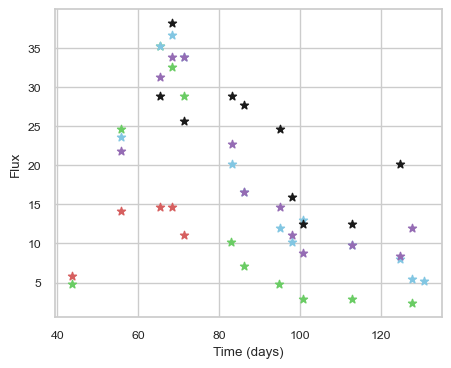

SNIax (4.270432, False)
SNIax (3.9339056, False)
SNIax (4.2428365, False)
SNIax (2.9345307, False)
SNIax (2.5793414, False)
SNIax (2.6260293, False)
SNIax (2.8113422, False)
SNIax (2.9500282, False)
SNIax (3.0664213, False)
SNIax (2.212777, False)
SNIax (3.0280073, False)
SNIax (2.445432, False)
SNIax (2.8393455, False)
SNIax (3.3653202, False)
SNIax (2.849152, False)
SNIax (2.9943626, False)
SNIax (3.3837368, False)
SNIax (2.8789768, False)
SNIax (2.9892466, False)
SNIax (3.1370525, False)
SNIax (2.915478, False)
SNIax (3.0405197, False)
SNIax (3.399483, False)
SNIax (3.0041962, False)
SNIax (2.9852653, False)
SNIax (3.1566393, False)
SNIax (3.2282593, False)
SNIax (3.172875, False)
SNIax (3.1866786, False)
SNIax (2.804618, False)
SNIax (2.9778955, False)
SNIax (3.003233, False)
SNIax (3.2786834, False)
SNIax (3.151675, False)
SNIax (2.8523922, False)
SNIax (2.9745138, False)
SNIax (3.0769868, False)
SNIax (3.3310325, False)
SNIax (2.628522, False)
SNIax (3.200146, False)
SNIax (2.995

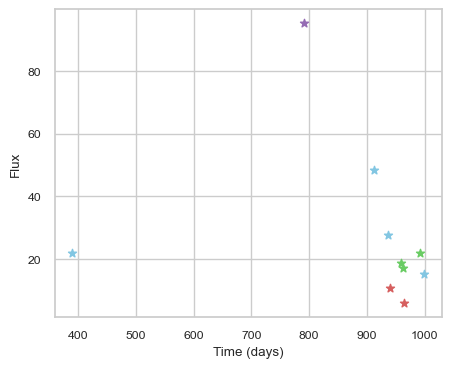

SNIax (3.581311, False)
SNIax (3.6414022, False)
SNIax (3.4123743, False)
SNIax (3.3533087, False)
SNIax (3.1274207, False)
SNIax (3.1034606, False)
SNIax (3.043987, False)
SNIax (3.1234872, False)
SNIax (3.2180967, False)
SNIax (2.9991202, False)
SNIax (3.3673453, False)
SNIax (2.7035925, False)
SNIax (3.085235, False)
SNIax (2.749767, False)
SNIax (2.7076457, False)
SNIax (2.679933, False)
SNIax (2.9786828, False)
SNIax (2.7514877, False)
SNIax (3.1730568, False)
SNIax (2.8246152, False)


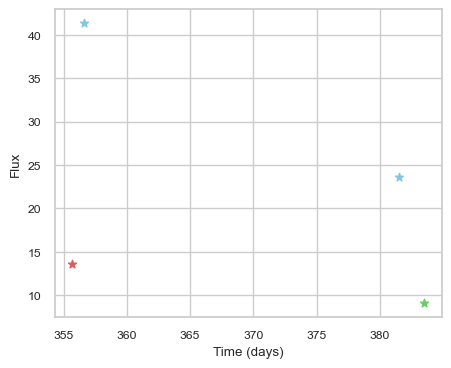

SNIax (4.0155435, False)
SNIax (3.9315693, False)
SNIax (3.8033457, False)
SNIax (3.6070793, False)
SNIax (4.3940644, False)
SNIax (2.9732168, False)
SNIax (2.8951554, False)
SNIax (2.878096, False)


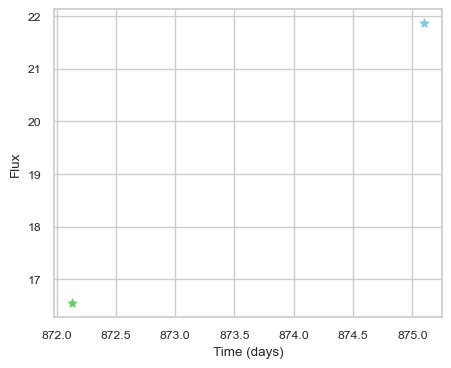

SNIax (5.091331, False)
SNIax (4.574069, False)
SNIax (3.8337374, False)
SNIax (3.842954, False)


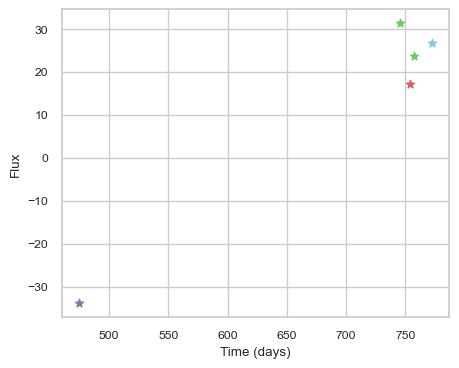

SNIax (3.8748004, False)
SNIax (4.1113014, False)
SNIax (3.810226, False)
SNIax (2.9412453, False)
SNIax (3.154026, False)
SNIax (3.7737033, False)
SNIax (3.0671039, False)
SNIax (3.717665, False)
SNIax (4.1312943, False)
SNIax (4.0462556, False)


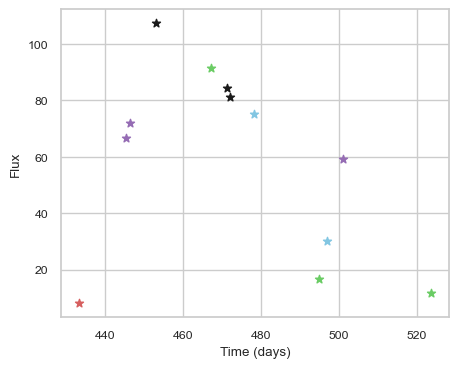

SNIax (3.836987, False)
SNIax (4.333554, False)
SNIax (3.5538635, False)
SNIax (3.35723, False)
SNIax (3.708932, False)
SNIax (3.6555452, False)
SNIax (3.6032789, False)
SNIax (3.5542283, False)
SNIax (3.4133446, False)
SNIax (3.5053217, False)
SNIax (3.9776902, False)
SNIax (4.921026, False)
SNIax (4.969108, False)
SNIax (5.0706043, False)
SNIax (3.950377, False)
SNIax (4.15859, False)
SNIax (4.344951, False)
SNIax (4.7327104, False)
SNIax (4.9892974, False)
SNIax (4.3230095, False)
SNIax (4.959589, False)
SNIax (4.284753, False)
SNIax (4.555474, False)
SNIax (4.551591, False)


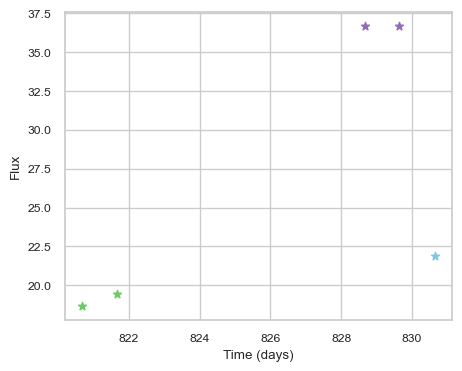

SNIax (4.175613, False)
SNIax (3.2234576, False)
SNIax (3.2860909, False)
SNIax (2.8532631, False)
SNIax (3.1050587, False)
SNIax (3.3572283, False)
SNIax (3.7402475, False)
SNIax (3.4447384, False)
SNIax (4.170585, False)
SNIax (3.447411, False)


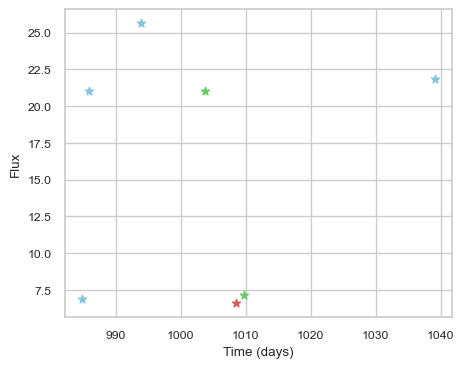

SNIax (3.8592615, False)
SNIax (4.235275, False)
SNIax (3.328425, False)
SNIax (3.2948158, False)
SNIax (2.9786584, False)
SNIax (3.4441895, False)
SNIax (3.223635, False)
SNIax (3.4752812, False)
SNIax (3.9756782, False)
SNIax (3.7119896, False)
SNIax (3.2333577, False)
SNIax (3.5282516, False)
SNIax (4.3506107, False)
SNIax (3.501905, False)


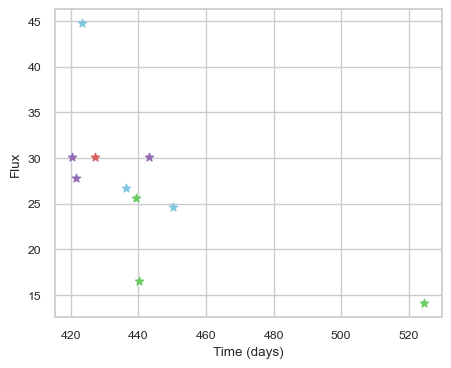

SNIax (3.8921304, False)
SNIax (3.478919, False)
SNIax (3.5123062, False)
SNIax (3.4448316, False)
SNIax (3.083204, False)
SNIax (3.341975, False)
SNIax (3.1684391, False)
SNIax (2.8338985, False)
SNIax (2.7453659, False)
SNIax (3.4030464, False)
SNIax (4.0529623, False)
SNIax (3.7842624, False)
SNIax (4.405017, False)
SNIax (3.7362974, False)
SNIax (3.5689306, False)
SNIax (3.8519638, False)
SNIax (3.589703, False)
SNIax (3.3066084, False)
SNIax (4.265229, False)
SNIax (3.90327, False)


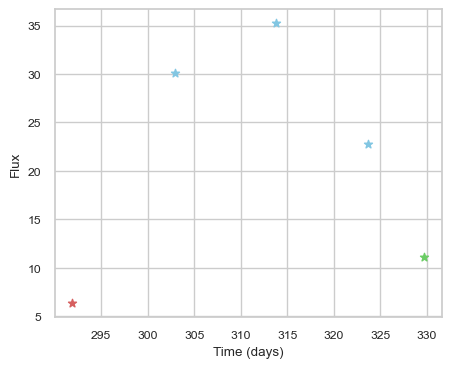

SNIax (4.1029224, False)
SNIax (4.517908, False)
SNIax (3.7471004, False)
SNIax (3.8208287, False)
SNIax (3.254412, False)
SNIax (3.469261, False)
SNIax (3.284154, False)
SNIax (3.5731885, False)
SNIax (3.5690932, False)
SNIax (3.668549, False)


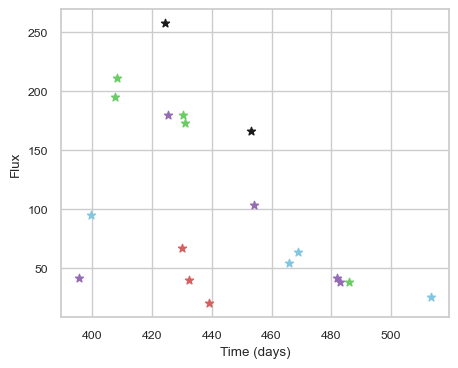

SNIax (4.044882, False)
SNIax (3.100654, False)
SNIax (3.555555, False)
SNIax (4.122576, False)
SNIax (4.641694, False)
SNIax (4.9838305, False)
SNIax (5.9828424, False)
SNIax (5.4419656, False)
SNIax (6.220916, False)
SNIax (5.470743, False)
SNIax (4.0286293, False)
SNIax (3.4854026, False)
SNIax (3.5016663, False)
SNIax (2.6119235, False)
SNIax (3.8762617, False)
SNIax (3.322984, False)
SNIax (4.6004806, False)
SNIax (3.6530945, False)
SNIax (3.7307715, False)
SNIax (3.5967498, False)
SNIax (4.1846747, False)
SNIax (3.9971275, False)
SNIax (4.451755, False)
SNIax (4.4918494, False)
SNIax (4.010714, False)
SNIax (4.3275647, False)
SNIax (3.8874009, False)
SNIax (4.0310445, False)
SNIax (4.34258, False)
SNIax (3.8654902, False)
SNIax (3.799072, False)
SNIax (3.7923858, False)
SNIax (4.1331487, False)
SNIax (3.9365983, False)
SNIax (4.40495, False)
SNIax (3.4729915, False)
SNIax (3.9910703, False)
SNIax (2.761884, False)


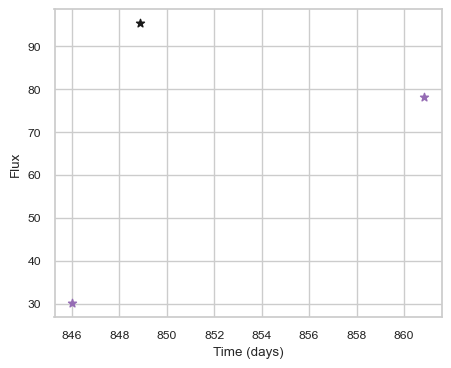

SNIax (3.741165, False)
SNIax (3.5276084, False)
SNIax (3.5320675, False)
SNIax (3.7738826, False)
SNIax (3.4731667, False)
SNIax (3.8259623, False)


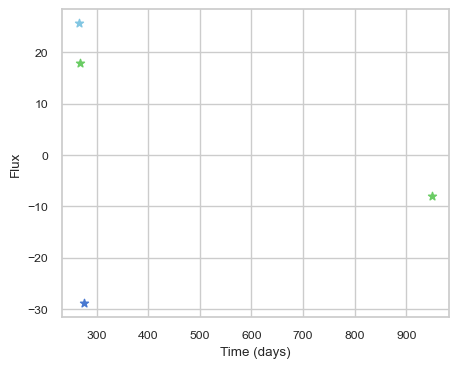

SNIax (3.9284194, False)
SNIax (4.036372, False)
SNIax (3.0473945, False)
SNIax (2.9383655, False)
SNIax (2.8525877, False)
SNIax (4.149899, False)
SNIax (3.6660666, False)
SNIax (4.036078, False)


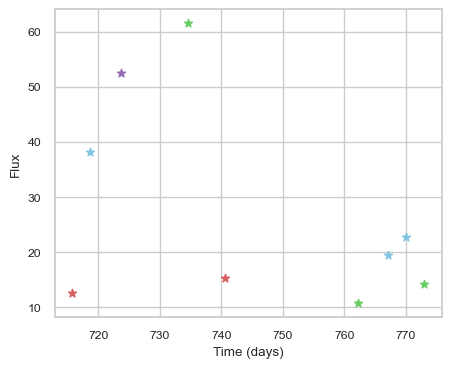

SNIax (4.095485, False)
SNIax (4.2179585, False)
SNIax (3.4254146, False)
SNIax (3.5928774, False)
SNIax (4.142404, False)
SNIax (3.9848537, False)
SNIax (3.9563413, False)
SNIax (4.363106, False)
SNIax (4.334402, False)
SNIax (4.4667687, False)
SNIax (4.463955, False)
SNIax (4.179506, False)
SNIax (4.172425, False)
SNIax (4.0934224, False)
SNIax (3.6168962, False)
SNIax (3.8250792, False)
SNIax (3.7693284, False)
SNIax (3.6304057, False)


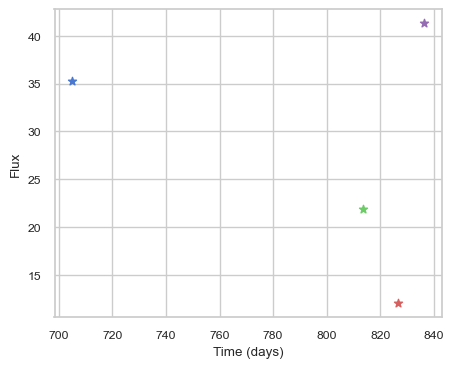

SNIax (3.9369276, False)
SNIax (4.3549447, False)
SNIax (4.189706, False)
SNIax (3.3314755, False)
SNIax (3.5945115, False)
SNIax (4.23813, False)
SNIax (3.8813033, False)
SNIax (2.650895, False)


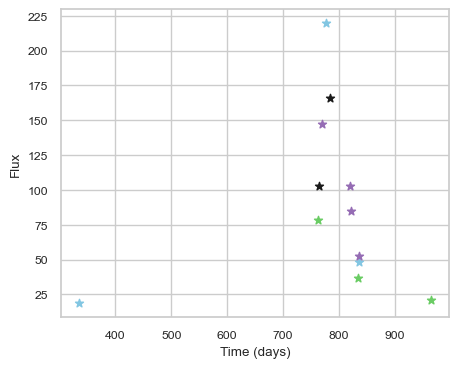

SNIax (3.9407885, False)
SNIax (4.0823092, False)
SNIax (3.8854785, False)
SNIax (3.7092335, False)
SNIax (4.206554, False)
SNIax (4.655833, False)
SNIax (4.077365, False)
SNIax (4.8671875, False)
SNIax (5.3920813, False)
SNIax (4.9193916, False)
SNIax (6.1585207, False)
SNIax (6.281716, False)
SNIax (6.203587, False)
SNIax (6.138051, False)
SNIax (6.5039597, False)
SNIax (6.4511347, False)
SNIax (6.4766893, False)
SNIax (6.1299443, False)
SNIax (5.881085, False)
SNIax (6.6144915, False)
SNIax (6.059032, False)
SNIax (5.788007, False)
SNIax (5.9083853, False)
SNIax (5.3163037, False)


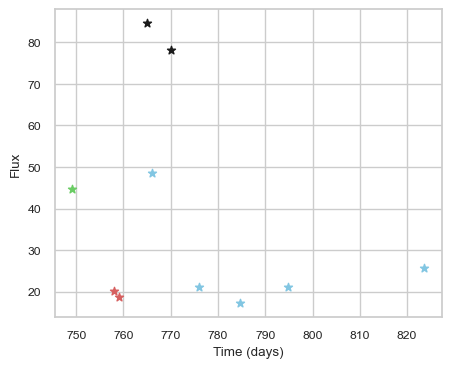

SNIax (3.970049, False)
SNIax (3.210857, False)
SNIax (3.5153003, False)
SNIax (3.2225497, False)
SNIax (3.1489067, False)
SNIax (3.2709782, False)
SNIax (3.883343, False)
SNIax (2.7098324, False)
SNIax (3.2433133, False)
SNIax (2.936693, False)
SNIax (3.736875, False)
SNIax (3.018355, False)
SNIax (3.5038881, False)
SNIax (2.6881113, False)
SNIax (2.5795715, False)
SNIax (2.5595744, False)
SNIax (2.7834592, False)
SNIax (2.5843344, False)
SNIax (3.510431, False)
SNIax (2.957743, False)


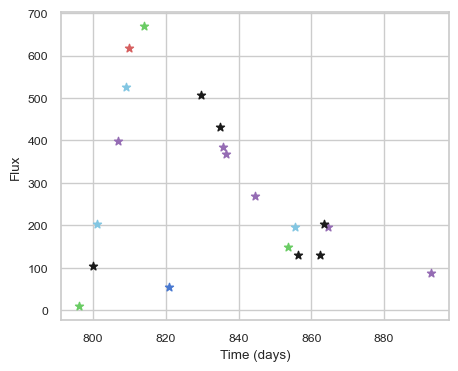

SNIax (3.790979, False)
SNIax (3.5095408, False)
SNIax (3.4468682, False)
SNIax (3.4479063, False)
SNIax (3.6964254, False)
SNIax (3.5675004, False)
SNIax (3.285259, False)
SNIax (3.0790658, False)
SNIax (2.8416862, False)
SNIax (3.1031282, False)
SNIax (2.9606128, False)
SNIax (3.1192443, False)
SNIax (3.4259307, False)
SNIax (3.0571516, False)
SNIax (4.1024847, False)
SNIax (4.8693013, False)
SNIax (4.446159, False)
SNIax (5.109124, False)
SNIax (2.9575586, False)
SNIax (3.2153933, False)
SNIax (3.1517317, False)
SNIax (2.8835704, False)
SNIax (3.1576588, False)
SNIax (3.1303933, False)
SNIax (2.444541, False)
SNIax (3.140508, False)
SNIax (2.6455035, False)
SNIax (2.892781, False)
SNIax (2.9365375, False)
SNIax (2.852398, False)
SNIax (2.7715445, False)
SNIax (3.621757, False)
SNIax (3.1709106, False)
SNIax (3.1955316, False)
SNIax (3.707709, False)
SNIax (3.3584774, False)
SNIax (3.2026556, False)
SNIax (2.5973763, False)
SNIax (3.2942533, False)
SNIax (2.8494213, False)


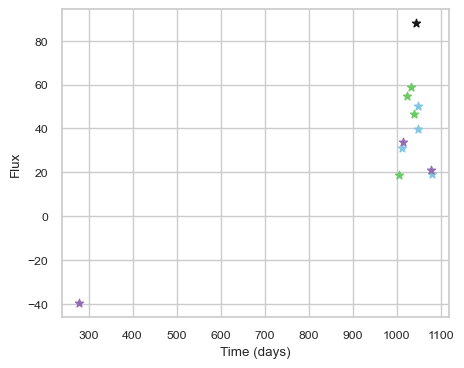

SNIax (4.0566025, False)
SNIax (4.11366, False)
SNIax (4.090315, False)
SNIax (3.6315372, False)
SNIax (3.5661752, False)
SNIax (3.7080936, False)
SNIax (3.2169693, False)
SNIax (3.8153713, False)
SNIax (3.2449627, False)
SNIax (2.9330199, False)
SNIax (3.0983183, False)
SNIax (3.5054462, False)
SNIax (3.1609383, False)
SNIax (3.1318288, False)
SNIax (3.1930954, False)
SNIax (3.2776065, False)
SNIax (2.5163155, False)
SNIax (2.646978, False)
SNIax (3.2221198, False)
SNIax (2.3706093, False)
SNIax (3.0395057, False)
SNIax (2.7867823, False)
SNIax (2.492968, False)
SNIax (2.1193366, False)


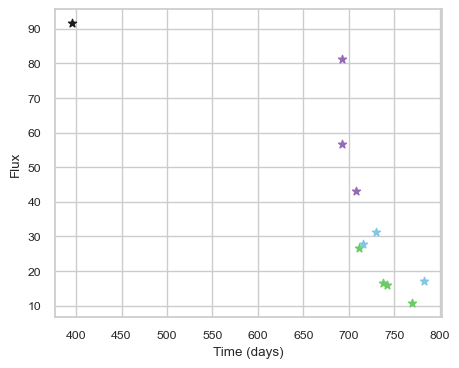

SNIax (3.875011, False)
SNIax (3.4445195, False)
SNIax (3.9332259, False)
SNIax (3.5648732, False)
SNIax (3.9014437, False)
SNIax (3.5828938, False)
SNIax (4.3332124, False)
SNIax (4.10832, False)
SNIax (3.9149742, False)
SNIax (4.0443153, False)
SNIax (3.845917, False)
SNIax (3.1213045, False)
SNIax (2.8282907, False)
SNIax (3.244451, False)
SNIax (3.3133073, False)
SNIax (3.7374291, False)
SNIax (3.3002422, False)
SNIax (3.265516, False)
SNIax (3.171132, False)
SNIax (3.1032562, False)
SNIax (2.9405692, False)
SNIax (2.8857012, False)


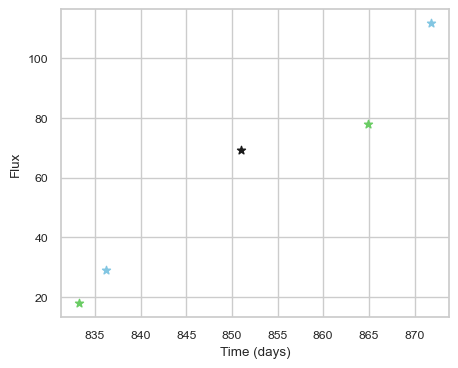

SNIax (3.9751048, False)
SNIax (3.2056158, False)
SNIax (3.4343877, False)
SNIax (3.2164102, False)
SNIax (2.9630334, False)
SNIax (3.6243906, False)
SNIax (4.122931, False)
SNIax (4.814981, False)
SNIax (5.368029, False)
SNIax (5.3061805, False)


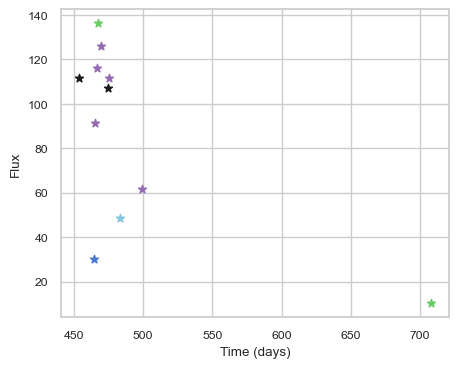

SNIax (3.8287835, False)
SNIax (3.7024753, False)
SNIax (3.8892448, False)
SNIax (4.510036, False)
SNIax (4.2043304, False)
SNIax (4.437027, False)
SNIax (4.2633758, False)
SNIax (4.5020247, False)
SNIax (3.780947, False)
SNIax (3.5258024, False)
SNIax (3.7737803, False)
SNIax (3.7659292, False)
SNIax (3.4625478, False)
SNIax (3.667351, False)
SNIax (3.6666431, False)
SNIax (3.3963926, False)
SNIax (2.5793436, False)
SNIax (2.9324164, False)
SNIax (2.7472396, False)
SNIax (2.8576357, False)
SNIax (3.4131734, False)
SNIax (3.5139391, False)


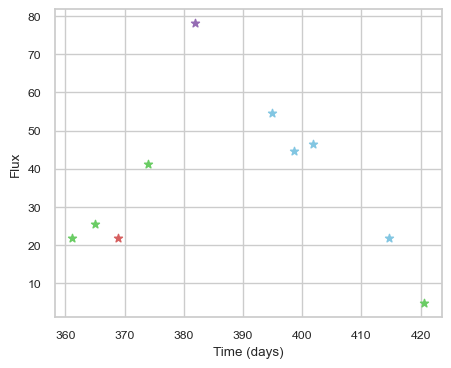

SNIax (4.0011344, False)
SNIax (3.3237553, False)
SNIax (3.671871, False)
SNIax (3.0433404, False)
SNIax (3.9484336, False)
SNIax (3.6323729, False)
SNIax (4.005379, False)
SNIax (1.9243058, False)
SNIax (2.645733, False)
SNIax (2.9310796, False)
SNIax (3.4528904, False)
SNIax (3.0291152, False)
SNIax (3.3056214, False)
SNIax (2.747251, False)
SNIax (3.2219982, False)
SNIax (2.595291, False)
SNIax (2.935325, False)
SNIax (2.5573323, False)
SNIax (2.4691439, False)
SNIax (2.448208, False)


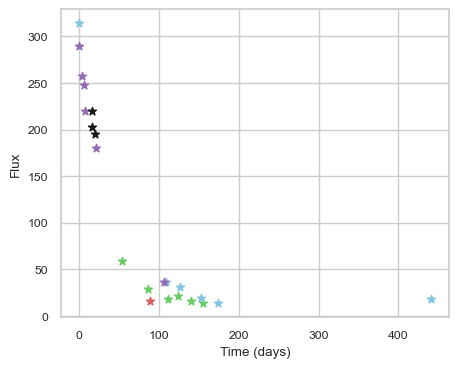

SNIax (3.9615073, False)
SNIax (3.146067, False)
SNIax (2.97695, False)
SNIax (3.4648592, False)
SNIax (2.9855852, False)
SNIax (3.677959, False)
SNIax (3.2928724, False)
SNIax (3.830804, False)
SNIax (3.2342277, False)
SNIax (3.112115, False)
SNIax (3.2710485, False)
SNIax (3.4901454, False)
SNIax (3.3512423, False)
SNIax (4.184118, False)
SNIax (3.391459, False)
SNIax (3.878426, False)
SNIax (3.5966218, False)
SNIax (3.695327, False)
SNIax (3.2549427, False)
SNIax (3.3127666, False)
SNIax (3.3071945, False)
SNIax (3.60172, False)
SNIax (3.170668, False)
SNIax (3.5128765, False)
SNIax (3.2425199, False)
SNIax (3.219302, False)
SNIax (2.917177, False)
SNIax (3.1394613, False)
SNIax (2.7602255, False)
SNIax (3.403352, False)
SNIax (2.8912356, False)
SNIax (3.491311, False)
SNIax (2.7115443, False)
SNIax (2.9260912, False)
SNIax (2.9858673, False)
SNIax (3.3238947, False)
SNIax (2.9731443, False)
SNIax (3.0362177, False)
SNIax (3.0212796, False)
SNIax (3.5257843, False)
SNIax (3.045261, 

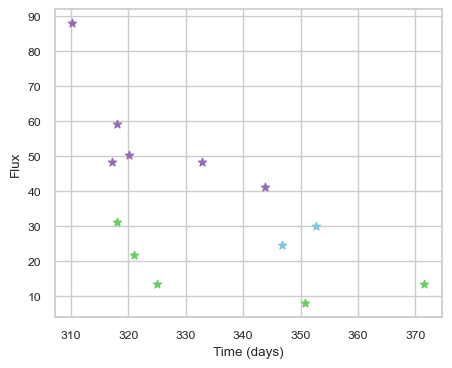

SNIax (3.8021097, False)
SNIax (4.5345693, False)
SNIax (4.164848, False)
SNIax (3.8350945, False)
SNIax (3.9517348, False)
SNIax (3.3890848, False)
SNIax (4.482365, False)
SNIax (4.257309, False)
SNIax (4.492113, False)
SNIax (4.164569, False)
SNIax (4.513353, False)
SNIax (3.6332111, False)
SNIax (4.1616874, False)
SNIax (3.8168354, False)
SNIax (3.6467025, False)
SNIax (4.1526093, False)
SNIax (3.946738, False)
SNIax (4.2755594, False)
SNIax (4.215116, False)
SNIax (4.231492, False)
SNIax (3.7438354, False)
SNIax (4.200778, False)
SNIax (3.5565135, False)
SNIax (4.03715, False)
SNIax (4.178597, False)
SNIax (4.3892198, False)


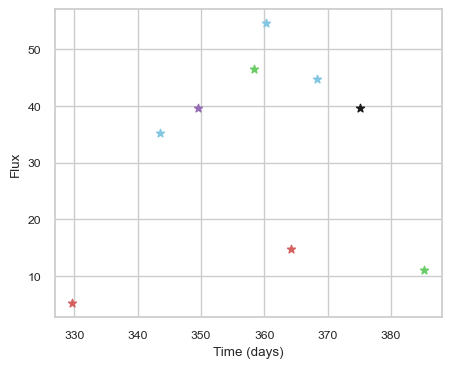

SNIax (3.8071811, False)
SNIax (4.4470873, False)
SNIax (3.6701143, False)
SNIax (3.5526876, False)
SNIax (3.097028, False)
SNIax (2.9640057, False)
SNIax (3.3313687, False)
SNIax (2.5794437, False)
SNIax (3.0588224, False)
SNIax (2.199344, False)
SNIax (3.1040385, False)
SNIax (2.6432006, False)
SNIax (2.7695613, False)
SNIax (2.0286896, False)
SNIax (2.8463738, False)
SNIax (2.6601827, False)
SNIax (2.3793623, False)
SNIax (2.5284452, False)


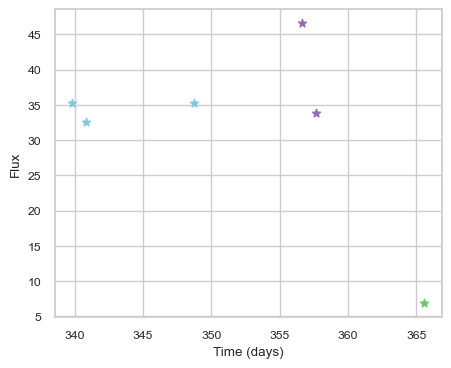

SNIax (4.3370085, False)
SNIax (4.5536966, False)
SNIax (3.8198435, False)
SNIax (4.4532647, False)
SNIax (4.218388, False)
SNIax (4.5116496, False)
SNIax (3.4448614, False)
SNIax (3.541331, False)
SNIax (3.7721841, False)
SNIax (3.3078592, False)
SNIax (2.917285, False)
SNIax (2.943095, False)


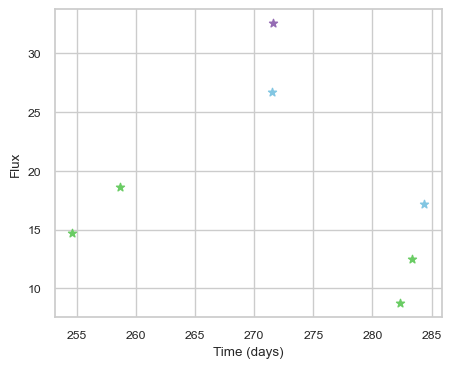

SNIax (4.6833405, False)
SNIax (3.916445, False)
SNIax (3.4733667, False)
SNIax (3.1853006, False)
SNIax (3.3460832, False)
SNIax (2.651159, False)
SNIax (2.9918668, False)
SNIax (3.4451501, False)
SNIax (2.5821679, False)
SNIax (2.6883054, False)
SNIax (2.9753034, False)
SNIax (3.1612763, False)
SNIax (2.7796006, False)
SNIax (2.925981, False)


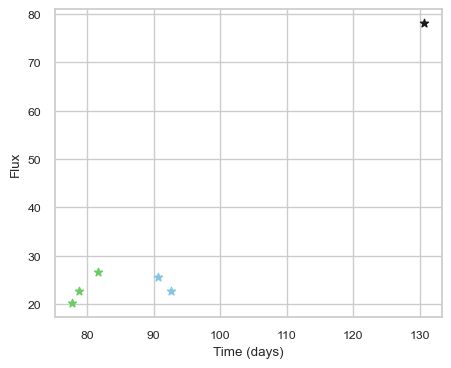

SNIax (4.382048, False)
SNIax (3.7297723, False)
SNIax (3.093937, False)
SNIax (3.1141465, False)
SNIax (3.4781451, False)
SNIax (2.8990514, False)
SNIax (2.8039124, False)
SNIax (2.810258, False)
SNIax (3.2512643, False)
SNIax (3.12157, False)
SNIax (3.896572, False)
SNIax (4.4787564, False)


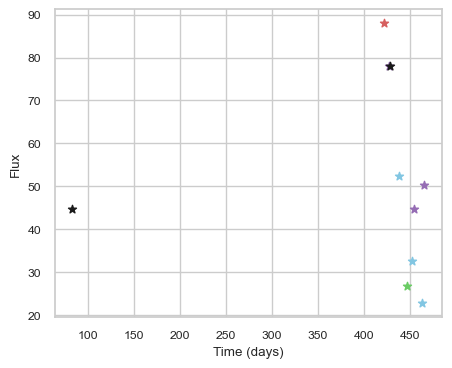

SNIax (3.9775789, False)
SNIax (4.146458, False)
SNIax (3.8860543, False)
SNIax (4.490924, False)
SNIax (4.3428884, False)
SNIax (4.0270133, False)
SNIax (4.688383, False)
SNIax (4.5990567, False)
SNIax (4.5331855, False)
SNIax (5.0990534, False)
SNIax (5.6883388, False)
SNIax (5.9729257, False)
SNIax (6.2831283, False)
SNIax (6.188616, False)
SNIax (6.064949, False)
SNIax (6.7631335, False)
SNIax (6.708971, False)
SNIax (6.5665917, False)
SNIax (6.254074, False)
SNIax (6.597972, False)


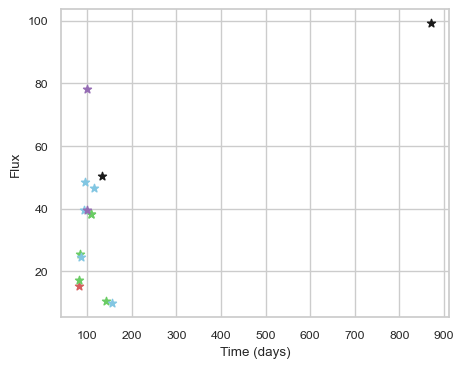

SNIax (3.9771726, False)
SNIax (3.87114, False)
SNIax (3.6060145, False)
SNIax (4.872271, False)
SNIax (4.399745, False)
SNIax (3.6604567, False)
SNIax (3.5261111, False)
SNIax (4.067974, False)
SNIax (3.6798344, False)
SNIax (4.151538, False)
SNIax (4.3180027, False)
SNIax (4.5323234, False)
SNIax (4.3409495, False)
SNIax (4.793429, False)
SNIax (5.267879, False)
SNIax (5.0755353, False)
SNIax (4.613232, False)
SNIax (4.621302, False)
SNIax (4.963777, False)
SNIax (5.035604, False)
SNIax (4.7529373, False)
SNIax (5.1034517, False)
SNIax (4.940885, False)
SNIax (5.0846705, False)
SNIax (4.9075603, False)
SNIax (5.3871207, False)
SNIax (3.8506815, False)
SNIax (4.660779, False)
SNIax (2.9654357, False)
SNIax (5.2258606, False)


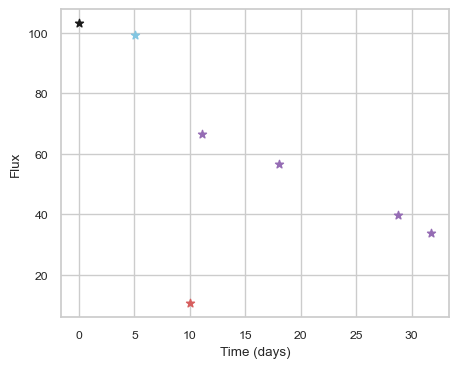

SNIax (4.214399, False)
SNIax (4.751855, False)
SNIax (3.8255923, False)
SNIax (3.9593313, False)
SNIax (5.196825, False)
SNIax (5.1658664, False)
SNIax (5.728183, False)
SNIax (5.041144, False)
SNIax (5.401948, False)
SNIax (5.2289667, False)
SNIax (4.9954047, False)
SNIax (5.3707294, False)
SNIax (5.1581273, False)


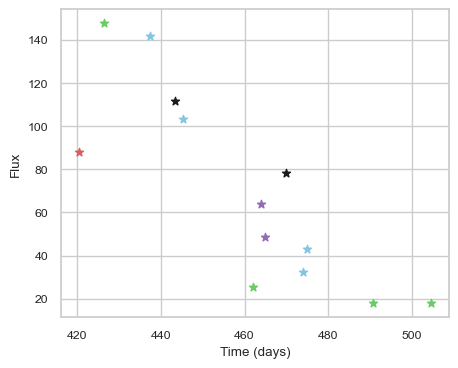

SNIax (3.9028635, False)
SNIax (4.558151, False)
SNIax (4.11589, False)
SNIax (3.2927804, False)
SNIax (3.4460735, False)
SNIax (2.6754894, False)
SNIax (3.2783318, False)
SNIax (4.059893, False)
SNIax (4.3317447, False)
SNIax (3.9990048, False)
SNIax (3.8763752, False)
SNIax (3.9108527, False)
SNIax (4.308208, False)
SNIax (3.5509381, False)
SNIax (4.7998195, False)
SNIax (3.7521474, False)
SNIax (4.2989807, False)
SNIax (3.878345, False)
SNIax (3.969599, False)
SNIax (3.4595418, False)
SNIax (3.4971058, False)
SNIax (3.5555375, False)
SNIax (3.9842055, False)
SNIax (4.0383286, False)
SNIax (3.5887952, False)
SNIax (3.7526155, False)


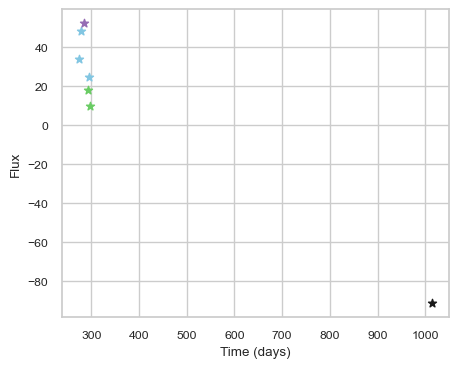

SNIax (4.60646, False)
SNIax (4.495098, False)
SNIax (3.9449732, False)
SNIax (4.979697, False)
SNIax (5.053109, False)
SNIax (4.703541, False)
SNIax (4.630559, False)
SNIax (4.631295, False)
SNIax (4.52773, False)
SNIax (4.2959776, False)
SNIax (3.4920673, False)
SNIax (3.1240892, False)
SNIax (4.7294016, False)
SNIax (3.9641733, False)


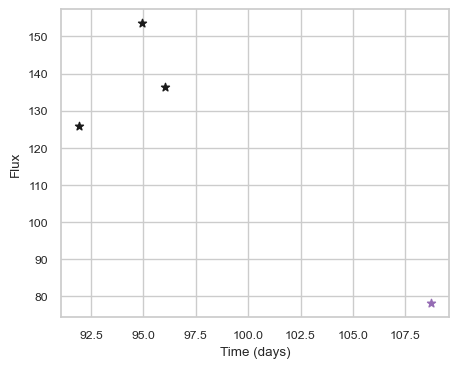

SNIax (3.8573503, False)
SNIax (3.8553326, False)
SNIax (4.584383, False)
SNIax (3.494038, False)
SNIax (4.336742, False)
SNIax (3.7622817, False)
SNIax (4.0626574, False)
SNIax (3.769767, False)


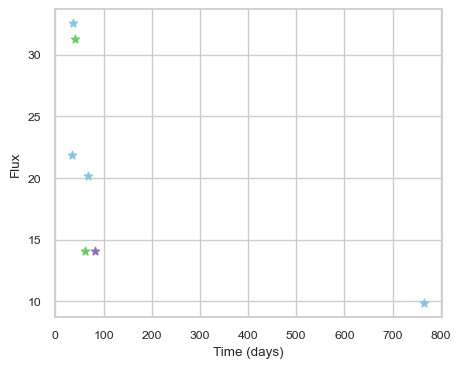

SNIax (4.219224, False)
SNIax (3.8038936, False)
SNIax (3.3698246, False)
SNIax (3.5954344, False)
SNIax (3.4004595, False)
SNIax (2.7570913, False)
SNIax (3.1692529, False)
SNIax (2.3875117, False)
SNIax (2.987566, False)
SNIax (2.4232562, False)
SNIax (3.090899, False)
SNIax (2.8897886, False)
SNIax (3.6798954, False)
SNIax (3.4201114, False)


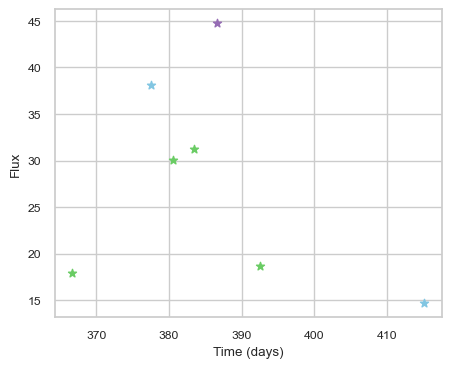

SNIax (4.084351, False)
SNIax (3.2300348, False)
SNIax (3.2580385, False)
SNIax (2.8610518, False)
SNIax (2.8265939, False)
SNIax (2.7704508, False)
SNIax (3.7048268, False)
SNIax (2.669069, False)
SNIax (3.3066654, False)
SNIax (2.4554324, False)
SNIax (3.0177548, False)
SNIax (2.770742, False)
SNIax (2.950561, False)
SNIax (2.6152015, False)


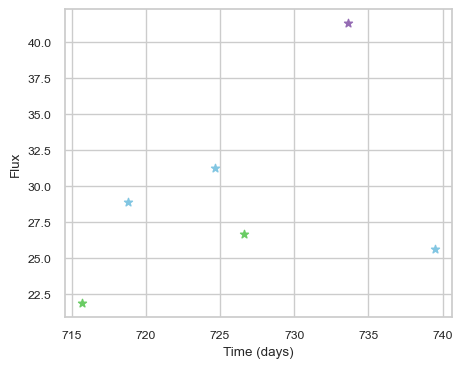

SNIax (3.9627697, False)
SNIax (3.4370966, False)
SNIax (2.9603765, False)
SNIax (2.7516124, False)
SNIax (2.8312316, False)
SNIax (2.7434855, False)
SNIax (3.0457551, False)
SNIax (3.1322272, False)
SNIax (3.4660747, False)
SNIax (2.8558488, False)
SNIax (3.3911762, False)
SNIax (3.6241074, False)


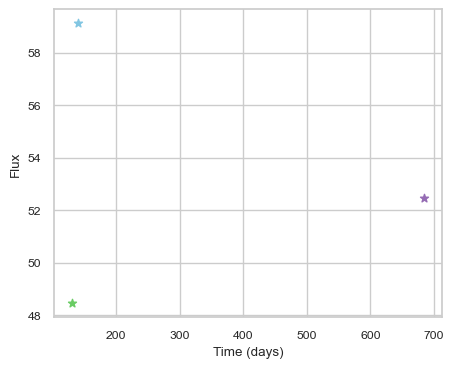

SNIax (4.2094803, False)
SNIax (4.8552346, False)
SNIax (5.25895, False)
SNIax (5.662923, False)
SNIax (5.529224, False)
SNIax (4.8695755, False)


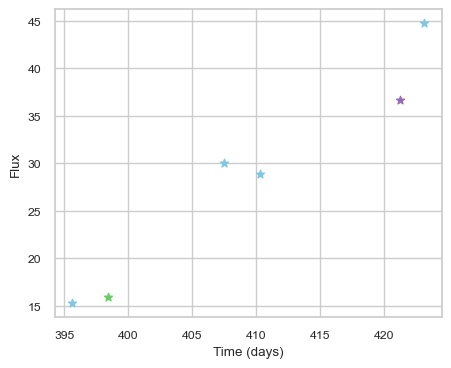

SNIax (4.1872005, False)
SNIax (3.4554403, False)
SNIax (3.451081, False)
SNIax (2.9988759, False)
SNIax (2.9718199, False)
SNIax (3.0457962, False)
SNIax (3.0213306, False)
SNIax (3.4201, False)
SNIax (2.7881258, False)
SNIax (3.0546694, False)
SNIax (3.0825553, False)
SNIax (3.0905802, False)


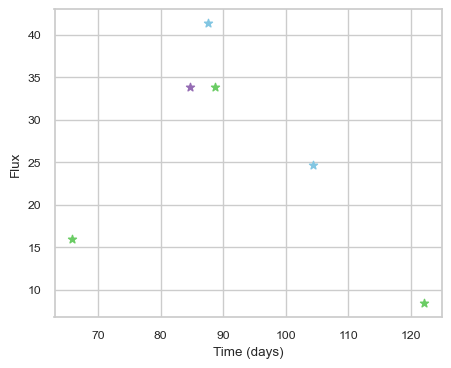

SNIax (4.181103, False)
SNIax (3.5412004, False)
SNIax (3.3195658, False)
SNIax (3.01616, False)
SNIax (3.4846077, False)
SNIax (3.4471323, False)
SNIax (3.2606494, False)
SNIax (2.9953218, False)
SNIax (3.046226, False)
SNIax (2.7903605, False)
SNIax (2.7530272, False)
SNIax (3.0328403, False)


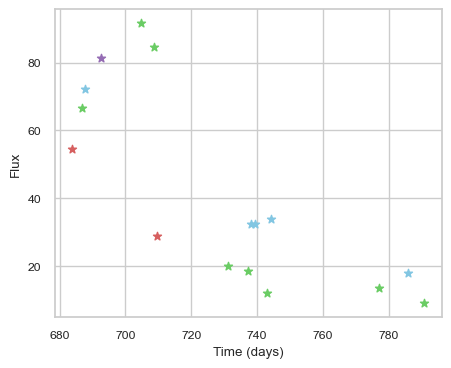

SNIax (3.8546278, False)
SNIax (4.5082264, False)
SNIax (3.8331363, False)
SNIax (4.063931, False)
SNIax (3.4850855, False)
SNIax (3.1748693, False)
SNIax (3.3705947, False)
SNIax (3.0177536, False)
SNIax (2.848925, False)
SNIax (2.935288, False)
SNIax (3.2792385, False)
SNIax (3.3392873, False)
SNIax (3.2053492, False)
SNIax (3.8036935, False)
SNIax (3.3097582, False)
SNIax (2.6402502, False)
SNIax (2.4511116, False)
SNIax (1.9661058, False)
SNIax (2.4086502, False)
SNIax (2.1768138, False)
SNIax (2.5449014, False)
SNIax (2.2992382, False)
SNIax (2.4725156, False)
SNIax (1.7894177, False)
SNIax (2.2298832, False)
SNIax (2.157166, False)
SNIax (2.368032, False)
SNIax (1.8141809, False)
SNIax (2.11026, False)
SNIax (1.8480895, False)
SNIax (1.9276633, False)
SNIax (1.6297497, False)


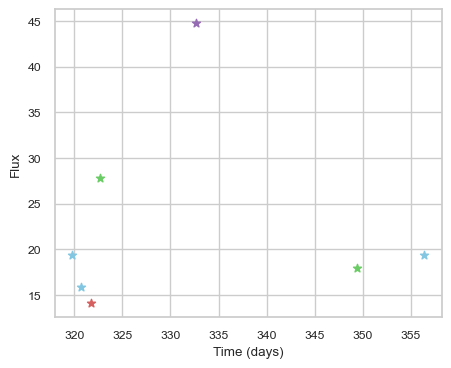

SNIax (3.8529778, False)
SNIax (3.577461, False)
SNIax (3.2846897, False)
SNIax (3.6971269, False)
SNIax (3.435212, False)
SNIax (3.6796727, False)
SNIax (3.578385, False)
SNIax (2.7853448, False)
SNIax (3.1008391, False)
SNIax (2.578829, False)
SNIax (2.8474007, False)
SNIax (2.5446916, False)
SNIax (2.8544867, False)
SNIax (2.6532626, False)


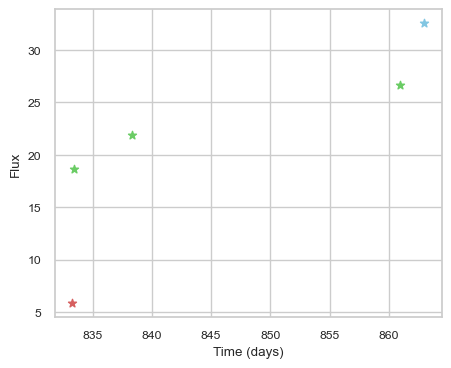

SNIax (4.2505026, False)
SNIax (4.1550345, False)
SNIax (3.8898323, False)
SNIax (3.1460276, False)
SNIax (3.508329, False)
SNIax (2.945152, False)
SNIax (3.1065638, False)
SNIax (2.9214306, False)
SNIax (3.1457648, False)
SNIax (3.1976776, False)


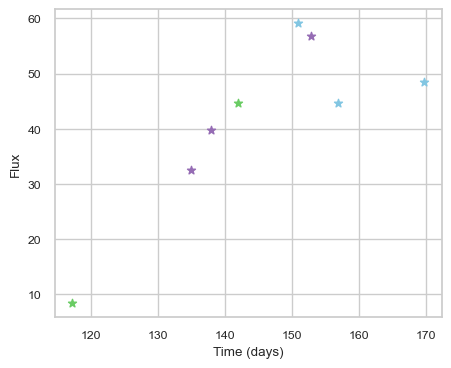

SNIax (4.610909, False)
SNIax (3.94505, False)
SNIax (4.3764477, False)
SNIax (4.3261847, False)
SNIax (3.8710148, False)
SNIax (4.2600036, False)
SNIax (4.521243, False)
SNIax (4.4596834, False)
SNIax (5.001509, False)
SNIax (5.1944776, False)
SNIax (5.6052027, False)
SNIax (5.5064273, False)
SNIax (6.111413, False)
SNIax (5.650828, False)
SNIax (4.899075, False)
SNIax (5.468379, False)


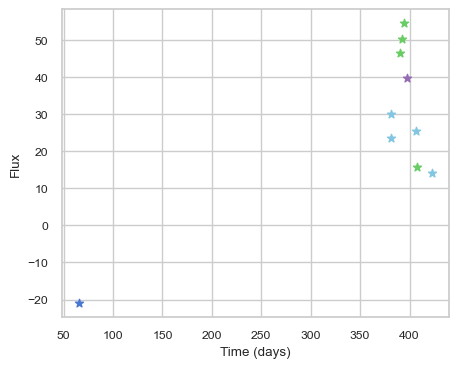

SNIax (3.7529924, False)
SNIax (4.609101, False)
SNIax (3.5089846, False)
SNIax (3.6471975, False)
SNIax (3.1742578, False)
SNIax (3.3461902, False)
SNIax (2.94157, False)
SNIax (2.8060799, False)
SNIax (3.2507372, False)
SNIax (2.7865906, False)
SNIax (3.0675302, False)
SNIax (2.320651, False)
SNIax (3.1790926, False)
SNIax (2.7903783, False)
SNIax (2.0903952, False)
SNIax (2.073021, False)
SNIax (2.0735836, False)
SNIax (1.7644571, False)
SNIax (1.8301219, False)
SNIax (1.4419706, False)


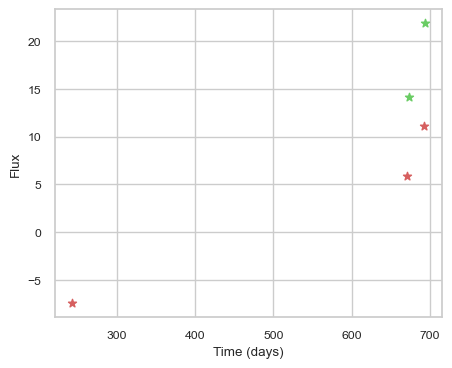

SNIax (3.5817845, False)
SNIax (3.83604, False)
SNIax (3.7407126, False)
SNIax (3.5327232, False)
SNIax (3.1452215, False)
SNIax (2.9931915, False)
SNIax (3.1503036, False)
SNIax (2.890566, False)
SNIax (2.8100607, False)
SNIax (2.6265085, False)


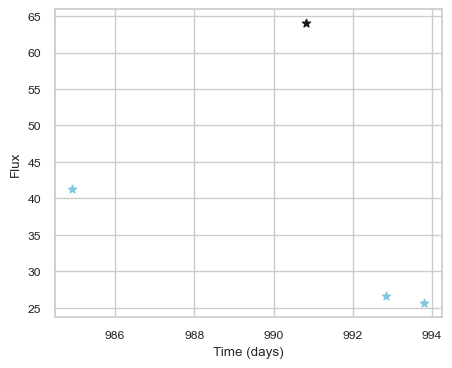

SNIax (3.8045194, False)
SNIax (3.6916938, False)
SNIax (3.4800222, False)
SNIax (4.2121463, False)
SNIax (3.543621, False)
SNIax (3.6926427, False)
SNIax (3.5824978, False)
SNIax (3.8975477, False)


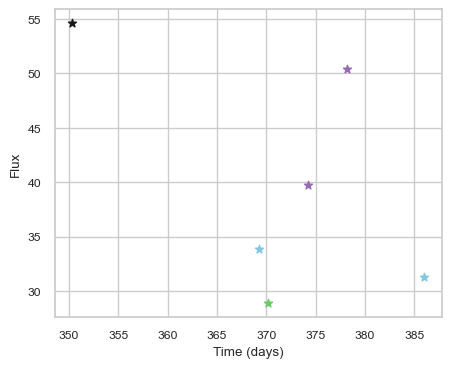

SNIax (3.891426, False)
SNIax (3.7641296, False)
SNIax (3.6742578, False)
SNIax (3.1130545, False)
SNIax (3.6539, False)
SNIax (3.2617092, False)
SNIax (3.8585985, False)
SNIax (3.2281237, False)
SNIax (4.0353003, False)
SNIax (3.5688598, False)
SNIax (3.4613883, False)
SNIax (3.7494307, False)


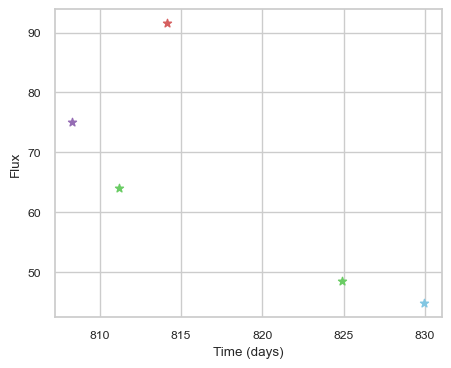

SNIax (3.7840219, False)
SNIax (3.42043, False)
SNIax (3.335234, False)
SNIax (3.2645452, False)
SNIax (3.8345177, False)
SNIax (4.441094, False)
SNIax (3.8037937, False)
SNIax (5.3334093, False)
SNIax (5.7696977, False)
SNIax (5.8423977, False)


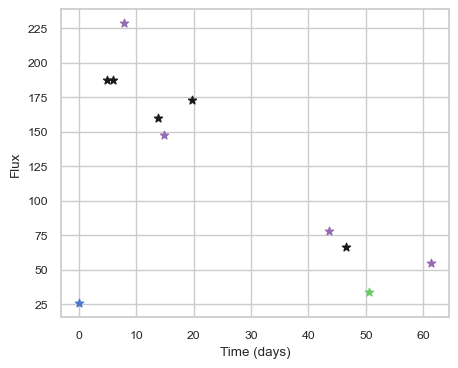

SNIax (4.1283145, False)
SNIax (4.447804, False)
SNIax (3.802246, False)
SNIax (4.2366996, False)
SNIax (3.28112, False)
SNIax (4.5218906, False)
SNIax (3.1907446, False)
SNIax (3.8817687, False)
SNIax (3.8175802, False)
SNIax (3.9067414, False)
SNIax (3.4750311, False)
SNIax (3.6866908, False)
SNIax (3.4170675, False)
SNIax (3.9449158, False)
SNIax (3.8073194, False)
SNIax (4.001067, False)
SNIax (4.018618, False)
SNIax (3.6902895, False)
SNIax (3.8623588, False)
SNIax (4.6617055, False)
SNIax (4.1998034, False)


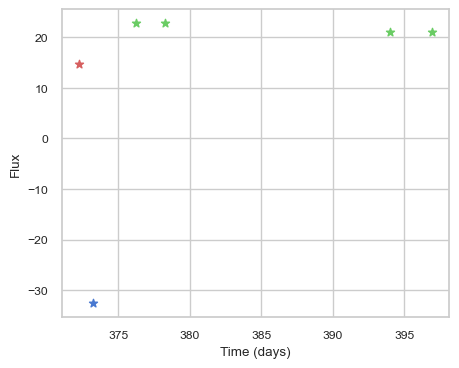

SNIax (3.867439, False)
SNIax (4.384726, False)
SNIax (3.917287, False)
SNIax (5.4248953, False)
SNIax (3.7535791, False)
SNIax (3.9321866, False)
SNIax (4.3005714, False)
SNIax (3.7074869, False)
SNIax (3.9302142, False)
SNIax (3.926071, False)
SNIax (4.2464643, False)
SNIax (4.1463995, False)


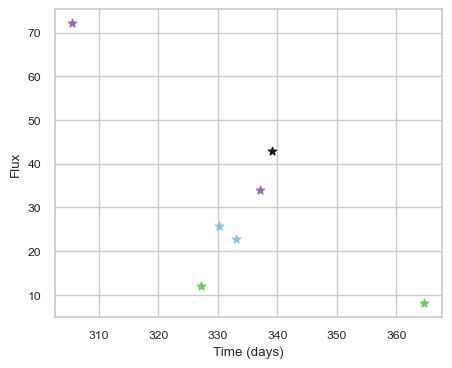

SNIax (3.9346042, False)
SNIax (4.1593227, False)
SNIax (4.072884, False)
SNIax (3.3875754, False)
SNIax (3.740475, False)
SNIax (3.01802, False)
SNIax (3.4847882, False)
SNIax (3.0388818, False)
SNIax (3.539439, False)
SNIax (3.1501794, False)
SNIax (3.4621706, False)
SNIax (3.9609056, False)
SNIax (4.148556, False)
SNIax (3.7930925, False)


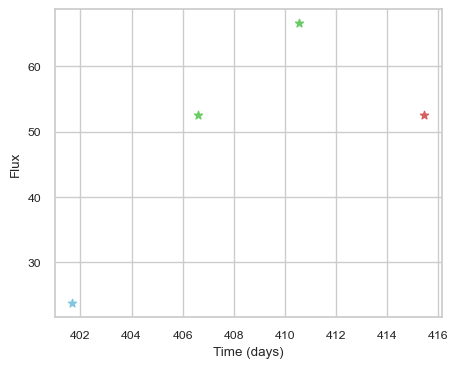

SNIax (3.8864315, False)
SNIax (3.348838, False)
SNIax (3.2034464, False)
SNIax (3.2319894, False)
SNIax (3.4911332, False)
SNIax (3.1483135, False)
SNIax (3.257984, False)
SNIax (2.791966, False)


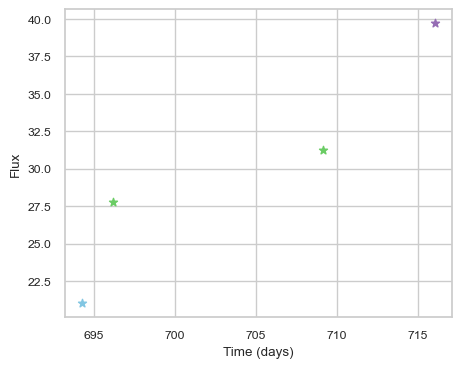

SNIax (4.188957, False)
SNIax (3.7250662, False)
SNIax (2.9929118, False)
SNIax (2.907372, False)
SNIax (3.0323129, False)
SNIax (2.425237, False)
SNIax (2.9921093, False)
SNIax (3.1837683, False)


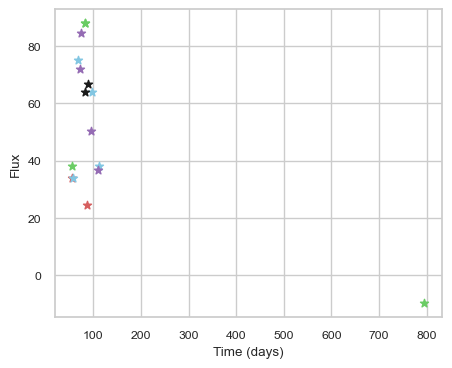

SNIax (3.9887612, False)
SNIax (4.4203234, False)
SNIax (5.150457, False)
SNIax (4.541116, False)
SNIax (4.9613523, False)
SNIax (5.4257965, False)
SNIax (5.4223466, False)
SNIax (3.3641768, False)
SNIax (3.3749459, False)
SNIax (3.7858472, False)
SNIax (4.3816314, False)
SNIax (3.6584077, False)
SNIax (3.5963867, False)
SNIax (4.100235, False)
SNIax (3.3927045, False)
SNIax (3.8663154, False)
SNIax (3.4893365, False)
SNIax (3.7570148, False)
SNIax (3.9555974, False)
SNIax (3.867784, False)
SNIax (3.564009, False)
SNIax (3.5618446, False)
SNIax (3.0778081, False)
SNIax (3.22176, False)
SNIax (2.7086837, False)
SNIax (2.8818412, False)
SNIax (3.0897954, False)
SNIax (2.9299438, False)
SNIax (2.5973601, False)
SNIax (2.8200026, False)
SNIax (2.5891552, False)
SNIax (3.0488245, False)


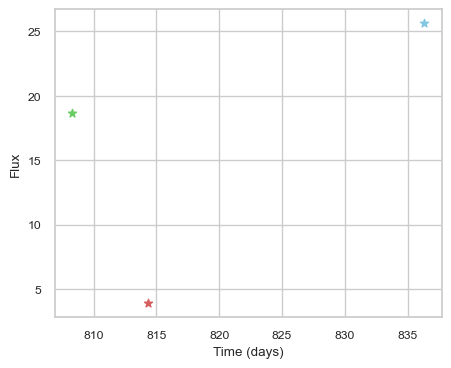

SNIax (4.395539, False)
SNIax (3.5851712, False)
SNIax (3.4020915, False)
SNIax (3.99552, False)
SNIax (3.210939, False)
SNIax (2.8198137, False)


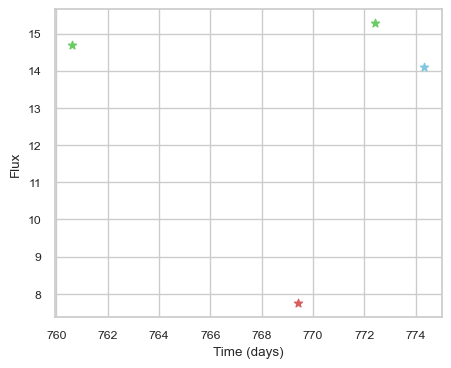

SNIax (3.8646219, False)
SNIax (3.3346531, False)
SNIax (3.1863267, False)
SNIax (3.42269, False)
SNIax (2.862205, False)
SNIax (3.289798, False)
SNIax (3.386323, False)
SNIax (3.169705, False)


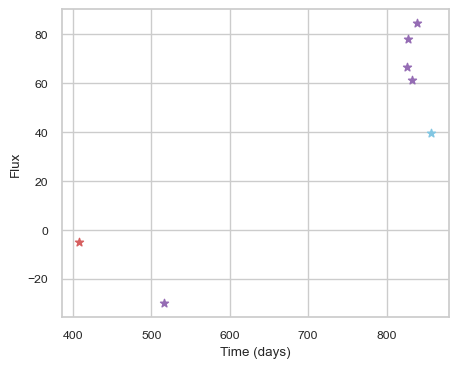

SNIax (3.8696048, False)
SNIax (4.25654, False)
SNIax (3.6504953, False)
SNIax (3.7721744, False)
SNIax (3.473609, False)
SNIax (3.5973706, False)
SNIax (3.867985, False)
SNIax (4.06738, False)
SNIax (3.9707682, False)
SNIax (3.2582326, False)
SNIax (2.9860322, False)
SNIax (2.9773755, False)
SNIax (3.5337424, False)
SNIax (3.1311858, False)


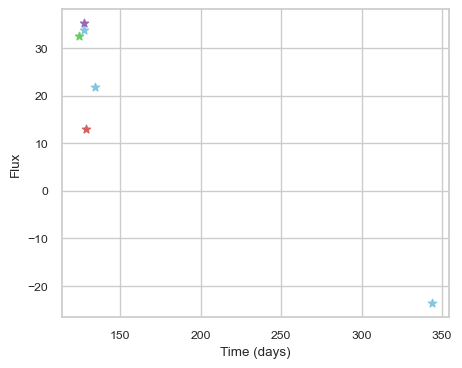

SNIax (3.9828892, False)
SNIax (3.855961, False)
SNIax (3.546733, False)
SNIax (3.5024471, False)
SNIax (3.8562217, False)
SNIax (3.7363355, False)
SNIax (3.9136107, False)
SNIax (4.0013337, False)
SNIax (2.8574579, False)
SNIax (3.2799942, False)
SNIax (4.4771643, False)
SNIax (3.952493, False)


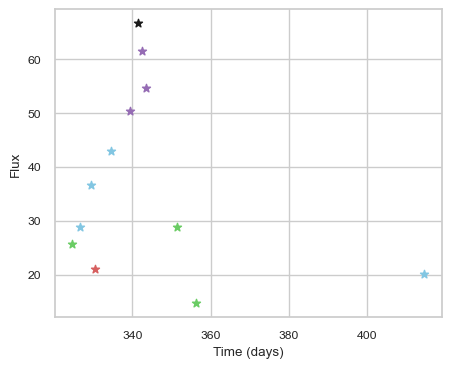

SNIax (3.9609835, False)
SNIax (4.009728, False)
SNIax (3.7840533, False)
SNIax (3.4186668, False)
SNIax (3.2662647, False)
SNIax (3.2556114, False)
SNIax (3.45052, False)
SNIax (3.3027527, False)
SNIax (2.8424828, False)
SNIax (2.3438368, False)
SNIax (2.9942195, False)
SNIax (2.344492, False)
SNIax (3.3758664, False)
SNIax (2.9796216, False)
SNIax (3.2681627, False)
SNIax (2.3996499, False)
SNIax (3.7649767, False)
SNIax (2.628386, False)
SNIax (2.9787924, False)
SNIax (3.0987616, False)
SNIax (3.5012789, False)
SNIax (3.4410229, False)
SNIax (2.520561, False)
SNIax (2.783722, False)


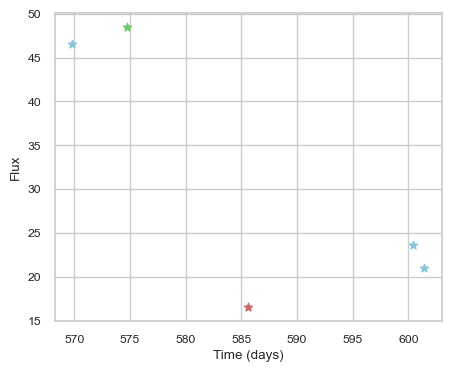

SNIax (4.2054152, False)
SNIax (3.9447865, False)
SNIax (4.127557, False)
SNIax (4.2383184, False)
SNIax (3.7642045, False)
SNIax (3.192922, False)
SNIax (4.285162, False)
SNIax (2.7217515, False)
SNIax (3.264401, False)
SNIax (2.9250824, False)


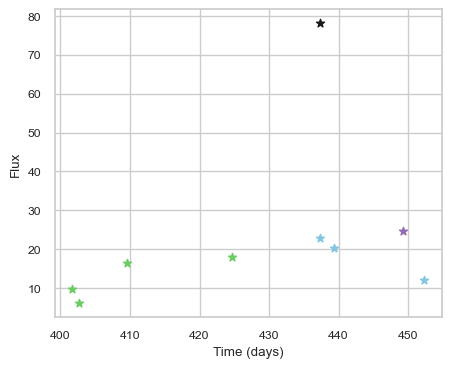

SNIax (4.9764705, False)
SNIax (4.10782, False)
SNIax (3.8807726, False)
SNIax (4.156944, False)
SNIax (3.6804023, False)
SNIax (3.672021, False)
SNIax (3.3018138, False)
SNIax (3.3216078, False)
SNIax (3.659028, False)
SNIax (3.7686007, False)
SNIax (4.2378993, False)
SNIax (3.5058444, False)
SNIax (3.7250233, False)
SNIax (3.124942, False)
SNIax (3.5176504, False)
SNIax (3.562138, False)
SNIax (3.3640776, False)
SNIax (3.378111, False)


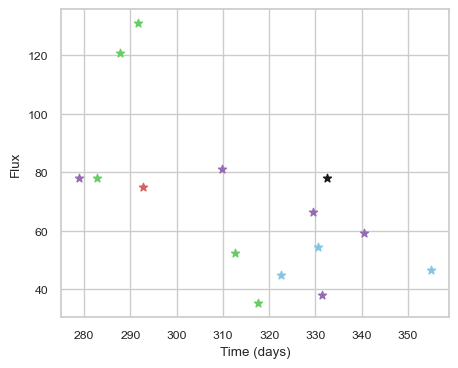

SNIax (4.181736, False)
SNIax (4.2167325, False)
SNIax (5.4477468, False)
SNIax (5.1239905, False)
SNIax (5.5878053, False)
SNIax (5.6337485, False)
SNIax (5.5200377, False)
SNIax (5.5642514, False)
SNIax (5.4311132, False)
SNIax (5.424005, False)
SNIax (5.107374, False)
SNIax (5.055196, False)
SNIax (5.4530225, False)
SNIax (5.0936832, False)
SNIax (5.8072705, False)
SNIax (5.2657433, False)
SNIax (5.5860014, False)
SNIax (5.398081, False)
SNIax (5.461986, False)
SNIax (5.241688, False)
SNIax (5.765509, False)
SNIax (5.289671, False)
SNIax (5.3018684, False)
SNIax (5.026192, False)
SNIax (5.5471754, False)
SNIax (5.646616, False)
SNIax (5.0581493, False)
SNIax (5.1194015, False)
SNIax (5.2003207, False)
SNIax (4.9541316, False)


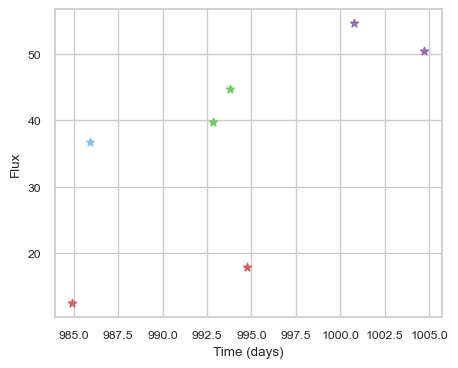

SNIax (4.2069173, False)
SNIax (4.683073, False)
SNIax (4.035696, False)
SNIax (4.032845, False)
SNIax (4.381313, False)
SNIax (4.6469374, False)
SNIax (4.186814, False)
SNIax (4.237378, False)
SNIax (4.309339, False)
SNIax (4.1758194, False)
SNIax (4.002413, False)
SNIax (3.9228404, False)
SNIax (4.3903427, False)
SNIax (3.924543, False)


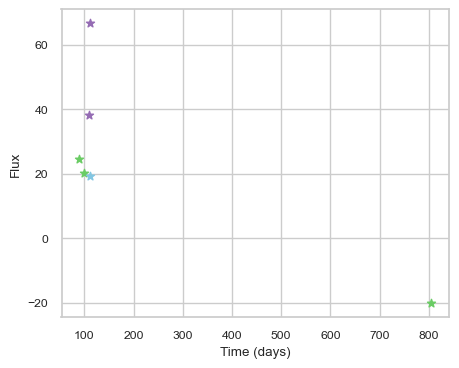

SNIax (4.0314455, False)
SNIax (3.9261048, False)
SNIax (3.5238354, False)
SNIax (3.3529496, False)
SNIax (3.8683498, False)
SNIax (2.9917624, False)
SNIax (3.5014412, False)
SNIax (3.0673933, False)
SNIax (3.678802, False)
SNIax (3.5575714, False)
SNIax (2.984691, False)
SNIax (3.7309234, False)


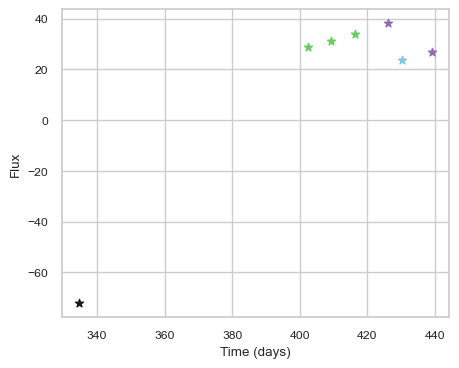

SNIax (3.8114264, False)
SNIax (4.0993776, False)
SNIax (3.9789221, False)
SNIax (3.3675761, False)
SNIax (3.5316691, False)
SNIax (3.8054519, False)
SNIax (4.3789325, False)
SNIax (4.444563, False)
SNIax (5.3091593, False)
SNIax (5.607465, False)
SNIax (5.574872, False)
SNIax (4.7329865, False)
SNIax (5.2543335, False)
SNIax (5.977288, False)


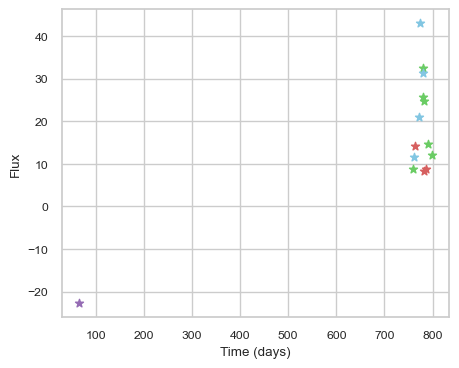

SNIax (3.9444127, False)
SNIax (4.1513805, False)
SNIax (3.961561, False)
SNIax (3.1767316, False)
SNIax (3.2969098, False)
SNIax (3.1594584, False)
SNIax (2.9163148, False)
SNIax (3.2156968, False)
SNIax (2.8978915, False)
SNIax (2.8627188, False)
SNIax (3.1098833, False)
SNIax (3.2404761, False)
SNIax (3.0808284, False)
SNIax (3.1000745, False)
SNIax (3.1078708, False)
SNIax (3.307614, False)
SNIax (2.945201, False)
SNIax (2.8511426, False)
SNIax (3.4111853, False)
SNIax (2.6473987, False)
SNIax (3.1401205, False)
SNIax (3.1147916, False)
SNIax (2.5778632, False)
SNIax (2.285896, False)
SNIax (2.450935, False)
SNIax (2.8161488, False)
SNIax (2.44385, False)


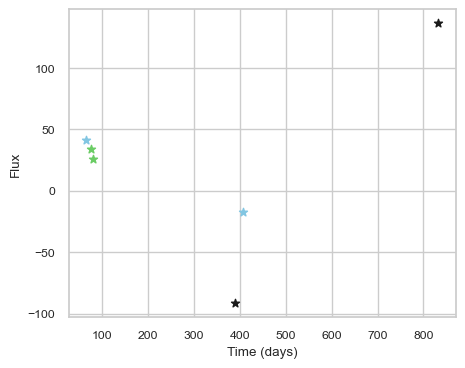

SNIax (4.1490436, False)
SNIax (4.053639, False)
SNIax (3.8779566, False)
SNIax (3.3600628, False)
SNIax (3.9238358, False)
SNIax (3.6717842, False)
SNIax (4.6735516, False)
SNIax (5.098574, False)
SNIax (5.937067, False)
SNIax (7.9684153, False)
SNIax (5.4154572, False)
SNIax (5.397419, False)


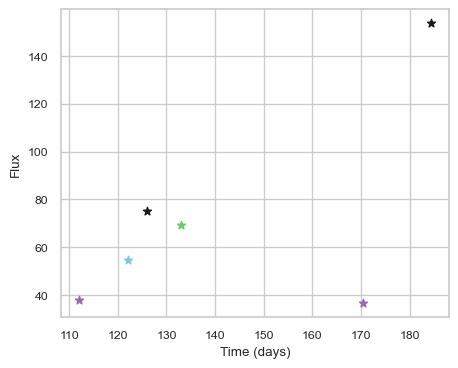

SNIax (3.9943311, False)
SNIax (4.0528793, False)
SNIax (3.9070063, False)
SNIax (4.290077, False)
SNIax (4.0285788, False)
SNIax (4.244984, False)
SNIax (3.885845, False)
SNIax (3.7074866, False)
SNIax (3.8842568, False)
SNIax (3.4945555, False)
SNIax (4.2116575, False)
SNIax (4.1123314, False)


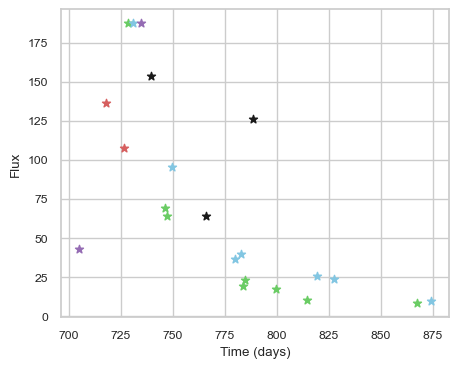

SNIax (3.472079, False)
SNIax (3.5600076, False)
SNIax (3.2663908, False)
SNIax (3.768225, False)
SNIax (3.1942747, False)
SNIax (3.7255235, False)
SNIax (3.4480183, False)
SNIax (3.253636, False)
SNIax (2.454259, False)
SNIax (2.8033378, False)
SNIax (3.1989384, False)
SNIax (2.5322266, False)
SNIax (3.4027014, False)
SNIax (2.878203, False)
SNIax (2.8299637, False)
SNIax (2.4968922, False)
SNIax (2.3330007, False)
SNIax (3.0746014, False)
SNIax (2.6289084, False)
SNIax (2.755135, False)
SNIax (2.9319375, False)
SNIax (2.9343836, False)
SNIax (2.7551606, False)
SNIax (2.9034772, False)
SNIax (2.731605, False)
SNIax (2.7139058, False)
SNIax (2.5207288, False)
SNIax (2.474841, False)
SNIax (3.031117, False)
SNIax (2.5551448, False)
SNIax (3.0767808, False)
SNIax (3.1037188, False)
SNIax (2.5194855, False)
SNIax (2.5954926, False)
SNIax (2.6694517, False)
SNIax (2.4995902, False)
SNIax (2.8158398, False)
SNIax (2.409488, False)
SNIax (2.4197812, False)
SNIax (2.2877886, False)
SNIax (2.6

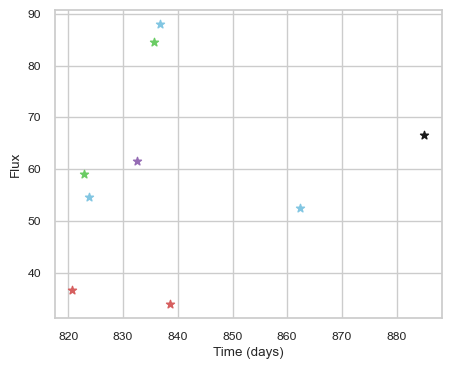

SNIax (3.7425263, False)
SNIax (4.1700783, False)
SNIax (4.894181, False)
SNIax (3.2724934, False)
SNIax (3.4177706, False)
SNIax (3.4129093, False)
SNIax (3.119857, False)
SNIax (3.5187106, False)
SNIax (3.7182593, False)
SNIax (3.3740132, False)
SNIax (3.230387, False)
SNIax (3.223395, False)
SNIax (3.36224, False)
SNIax (3.220478, False)
SNIax (3.4369094, False)
SNIax (2.3430195, False)
SNIax (3.5048509, False)
SNIax (4.131627, False)


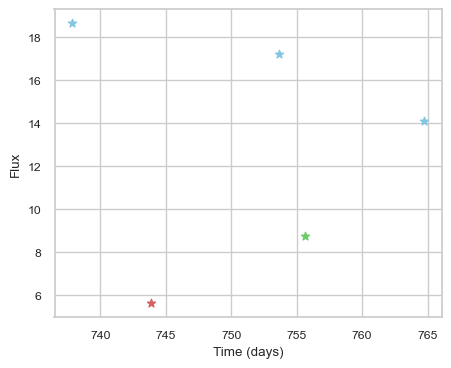

SNIax (4.8301764, False)
SNIax (4.2199125, False)
SNIax (4.3006654, False)
SNIax (4.5186453, False)
SNIax (4.951609, False)
SNIax (4.1340156, False)
SNIax (3.299154, False)
SNIax (3.0112183, False)
SNIax (3.157472, False)
SNIax (2.8899996, False)


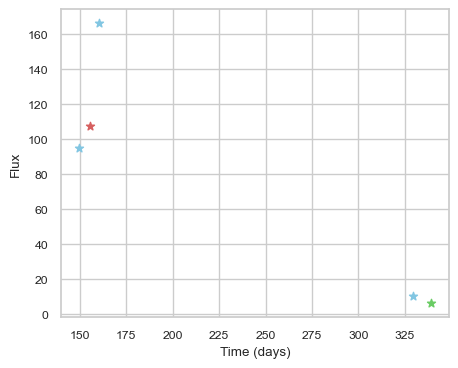

SNIax (3.870589, False)
SNIax (4.6649423, False)
SNIax (5.149367, False)
SNIax (4.9524574, False)
SNIax (5.846935, False)
SNIax (5.313477, False)
SNIax (4.971855, False)
SNIax (4.8883986, False)
SNIax (4.6922727, False)
SNIax (4.8327966, False)


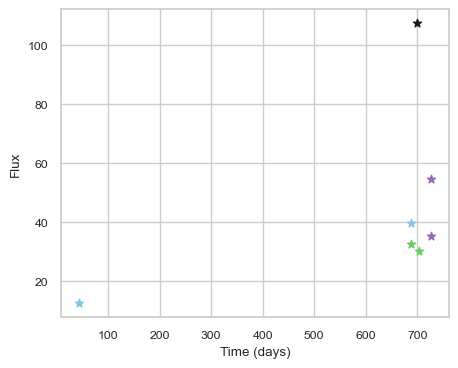

SNIax (4.552246, False)
SNIax (3.7484472, False)
SNIax (3.7715108, False)
SNIax (2.987785, False)
SNIax (3.2528732, False)
SNIax (3.7848277, False)
SNIax (4.208651, False)
SNIax (4.6898856, False)
SNIax (4.66222, False)
SNIax (3.4683042, False)
SNIax (3.339727, False)
SNIax (3.7182631, False)
SNIax (3.9272945, False)
SNIax (3.4592712, False)


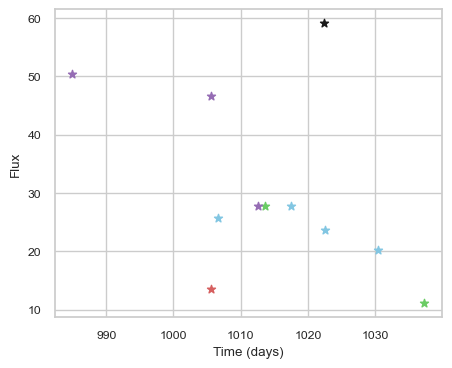

SNIax (4.072392, False)
SNIax (3.7858815, False)
SNIax (4.237554, False)
SNIax (4.0009446, False)
SNIax (4.4950776, False)
SNIax (3.845119, False)
SNIax (4.917802, False)
SNIax (3.9401834, False)
SNIax (3.681442, False)
SNIax (3.1846552, False)
SNIax (3.263584, False)
SNIax (3.1355438, False)
SNIax (3.6598997, False)
SNIax (3.0970235, False)
SNIax (3.1586008, False)
SNIax (3.8272803, False)
SNIax (2.9025388, False)
SNIax (3.105169, False)
SNIax (2.898613, False)
SNIax (3.2901976, False)
SNIax (3.661016, False)
SNIax (3.779336, False)


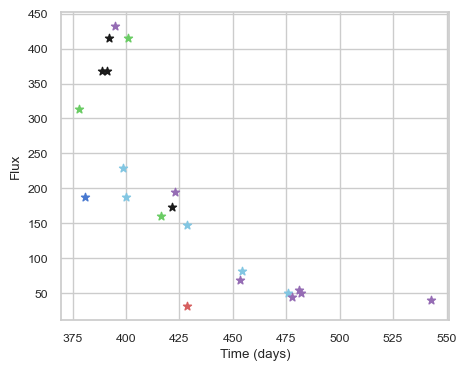

SNIax (3.8726397, False)
SNIax (3.454502, False)
SNIax (3.392371, False)
SNIax (3.9841855, False)
SNIax (5.146565, False)
SNIax (6.8010125, False)
SNIax (4.807373, False)
SNIax (5.216265, False)
SNIax (4.6419654, False)
SNIax (4.8483977, False)
SNIax (4.6228137, False)
SNIax (2.6709545, False)
SNIax (3.8331459, False)
SNIax (4.550593, False)
SNIax (3.7806106, False)
SNIax (2.9431448, False)
SNIax (3.4131258, False)
SNIax (2.8613987, False)
SNIax (3.529458, False)
SNIax (3.7670817, False)
SNIax (4.093044, False)
SNIax (2.8863642, False)
SNIax (4.024861, False)
SNIax (2.1626084, False)
SNIax (3.4672177, False)
SNIax (4.6047215, False)
SNIax (3.5030868, False)
SNIax (3.677051, False)
SNIax (3.9401593, False)
SNIax (3.1524532, False)
SNIax (3.9176612, False)
SNIax (3.6455019, False)
SNIax (3.6775405, False)
SNIax (3.1672833, False)
SNIax (3.611603, False)
SNIax (3.093203, False)
SNIax (3.0508413, False)
SNIax (3.3282313, False)
SNIax (3.4871607, False)
SNIax (3.1080678, False)
SNIax (4.413

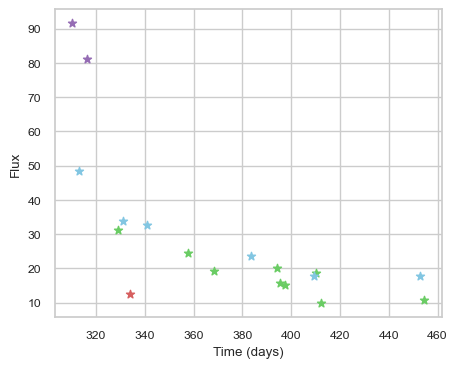

SNIax (3.5961168, False)
SNIax (4.5785666, False)
SNIax (3.6807516, False)
SNIax (4.342411, False)
SNIax (3.5570133, False)
SNIax (4.218032, False)
SNIax (3.7215607, False)
SNIax (4.1789107, False)
SNIax (3.8802881, False)
SNIax (3.861529, False)
SNIax (3.5372272, False)
SNIax (4.193515, False)
SNIax (3.8278255, False)
SNIax (3.3407602, False)
SNIax (4.1121097, False)
SNIax (3.9690943, False)
SNIax (4.480477, False)
SNIax (4.274413, False)
SNIax (4.0095983, False)
SNIax (4.0425916, False)
SNIax (4.006457, False)
SNIax (4.5793896, False)
SNIax (3.8029249, False)
SNIax (4.648257, False)
SNIax (3.733869, False)
SNIax (4.5052342, False)
SNIax (3.8086257, False)
SNIax (4.4603276, False)
SNIax (3.9874372, False)
SNIax (4.486629, False)
SNIax (3.8946989, False)
SNIax (4.436256, False)
SNIax (4.6221437, False)
SNIax (4.593046, False)
SNIax (3.8928356, False)
SNIax (4.538449, False)


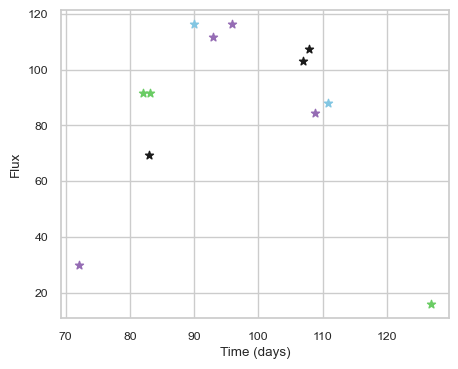

SNIax (4.0737233, False)
SNIax (3.8778281, False)
SNIax (3.2960007, False)
SNIax (4.0669546, False)
SNIax (4.909155, False)
SNIax (4.9811015, False)
SNIax (5.8402953, False)
SNIax (5.2434564, False)
SNIax (5.9772267, False)
SNIax (5.5974765, False)
SNIax (5.6437507, False)
SNIax (5.6928816, False)
SNIax (5.975152, False)
SNIax (5.7392235, False)
SNIax (5.901995, False)
SNIax (5.258634, False)
SNIax (6.1016874, False)
SNIax (5.5781794, False)
SNIax (5.7869506, False)
SNIax (5.1459627, False)
SNIax (5.5097795, False)
SNIax (5.541799, False)
SNIax (5.4118776, False)
SNIax (5.6641355, False)


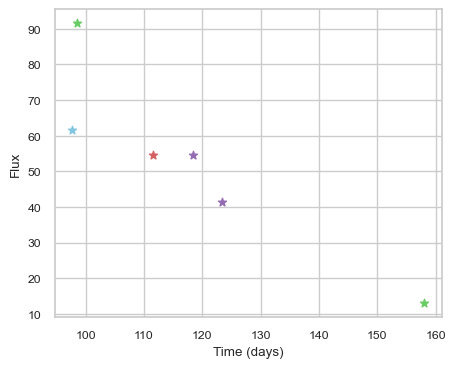

SNIax (4.005489, False)
SNIax (4.0623913, False)
SNIax (4.353805, False)
SNIax (4.951488, False)
SNIax (5.097388, False)
SNIax (5.31838, False)
SNIax (5.1246333, False)
SNIax (5.095616, False)
SNIax (5.1726184, False)
SNIax (4.378908, False)
SNIax (4.843367, False)
SNIax (4.5863633, False)


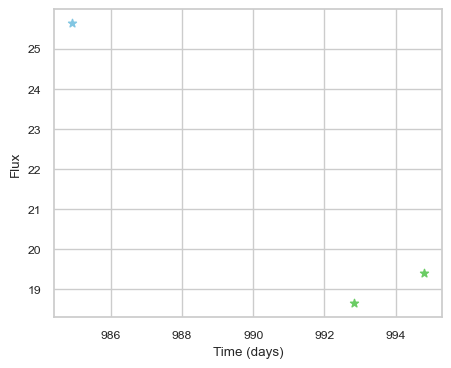

SNIax (3.8753324, False)
SNIax (3.67423, False)
SNIax (3.3744242, False)
SNIax (3.8663669, False)
SNIax (3.931188, False)
SNIax (3.3611019, False)


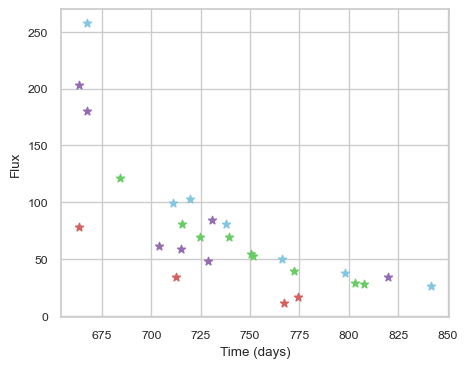

SNIax (3.7123327, False)
SNIax (4.6295815, False)
SNIax (4.5962763, False)
SNIax (3.3719077, False)
SNIax (3.5754292, False)
SNIax (3.4302118, False)
SNIax (3.4637215, False)
SNIax (2.7724123, False)
SNIax (2.8279064, False)
SNIax (3.0267234, False)
SNIax (2.5959077, False)
SNIax (2.2907557, False)
SNIax (2.4666727, False)
SNIax (2.7075024, False)
SNIax (2.393504, False)
SNIax (2.9773068, False)
SNIax (2.5428305, False)
SNIax (2.5833163, False)
SNIax (2.2584736, False)
SNIax (2.6083496, False)
SNIax (2.2953236, False)
SNIax (2.6824117, False)
SNIax (2.56858, False)
SNIax (2.2315662, False)
SNIax (2.6121228, False)
SNIax (2.3920538, False)
SNIax (2.477278, False)
SNIax (2.155215, False)
SNIax (2.2597597, False)
SNIax (2.4561334, False)
SNIax (2.6999443, False)
SNIax (2.809028, False)
SNIax (2.9956062, False)
SNIax (2.6622214, False)
SNIax (3.2417123, False)
SNIax (2.9579139, False)
SNIax (2.890801, False)
SNIax (2.4378517, False)
SNIax (3.061594, False)
SNIax (3.3005192, False)
SNIax (3

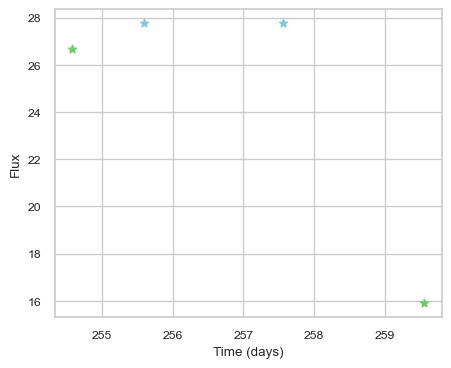

SNIax (4.3266478, False)
SNIax (3.9008603, False)
SNIax (3.3692625, False)
SNIax (3.6564255, False)
SNIax (2.8247285, False)
SNIax (3.164683, False)
SNIax (2.6783657, False)
SNIax (2.519041, False)


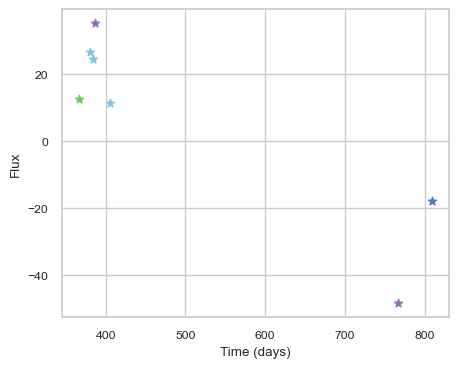

SNIax (4.285186, False)
SNIax (3.431288, False)
SNIax (3.497405, False)
SNIax (2.95154, False)
SNIax (2.8041463, False)
SNIax (2.3124123, False)
SNIax (2.5605285, False)
SNIax (2.3546011, False)
SNIax (2.4471607, False)
SNIax (2.4124403, False)
SNIax (3.3929095, False)
SNIax (3.0423734, False)
SNIax (3.8724084, False)
SNIax (4.9278283, False)


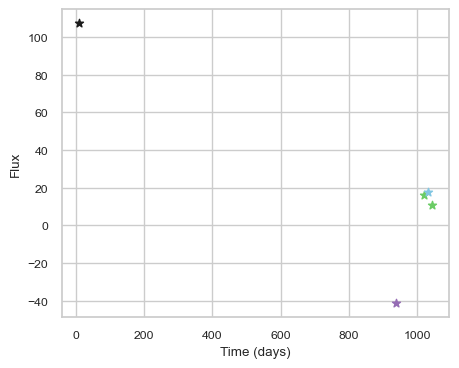

SNIax (4.79132, False)
SNIax (4.2168036, False)
SNIax (4.733001, False)
SNIax (4.8620305, False)
SNIax (4.5716524, False)
SNIax (4.081395, False)
SNIax (3.9082832, False)
SNIax (3.6004434, False)
SNIax (3.4187546, False)
SNIax (4.1405377, False)


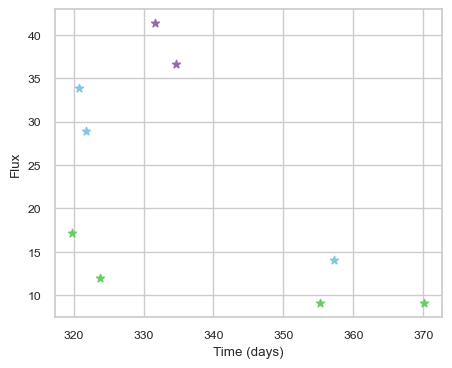

SNIax (3.9233434, False)
SNIax (3.9021237, False)
SNIax (3.3799534, False)
SNIax (3.7729583, False)
SNIax (3.7173722, False)
SNIax (3.5598314, False)
SNIax (3.368562, False)
SNIax (3.050179, False)
SNIax (3.3566618, False)
SNIax (3.23716, False)
SNIax (3.4412081, False)
SNIax (3.0927765, False)
SNIax (3.2830827, False)
SNIax (3.0297544, False)
SNIax (3.05628, False)
SNIax (2.844851, False)
SNIax (2.6125648, False)
SNIax (2.8146613, False)


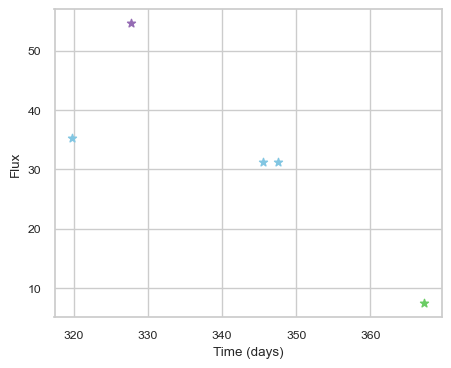

SNIax (3.7576096, False)
SNIax (3.765644, False)
SNIax (3.6306098, False)
SNIax (3.174654, False)
SNIax (3.3081777, False)
SNIax (3.3148887, False)
SNIax (3.9390576, False)
SNIax (4.1277723, False)
SNIax (4.823259, False)
SNIax (4.580608, False)


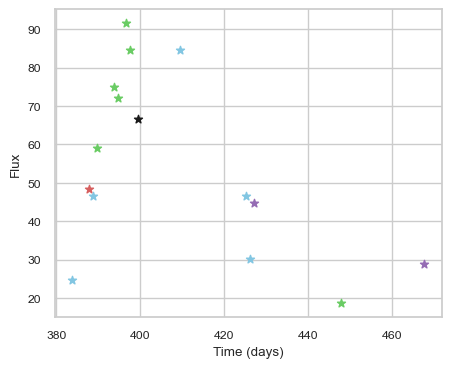

SNIax (3.8013937, False)
SNIax (3.4672232, False)
SNIax (3.4486454, False)
SNIax (4.1247964, False)
SNIax (4.3806424, False)
SNIax (4.1840534, False)
SNIax (4.2883077, False)
SNIax (3.9902334, False)
SNIax (4.179183, False)
SNIax (3.893552, False)
SNIax (3.7334158, False)
SNIax (4.2755833, False)
SNIax (3.8939173, False)
SNIax (3.7981777, False)
SNIax (3.5800889, False)
SNIax (3.9765186, False)
SNIax (3.7901628, False)
SNIax (3.6244905, False)
SNIax (2.818544, False)
SNIax (3.2801178, False)
SNIax (3.587079, False)
SNIax (3.0584342, False)
SNIax (2.9945726, False)
SNIax (2.8353457, False)
SNIax (2.69013, False)
SNIax (2.5995686, False)
SNIax (2.1987174, False)
SNIax (2.675462, False)
SNIax (2.591091, False)
SNIax (2.3431304, False)


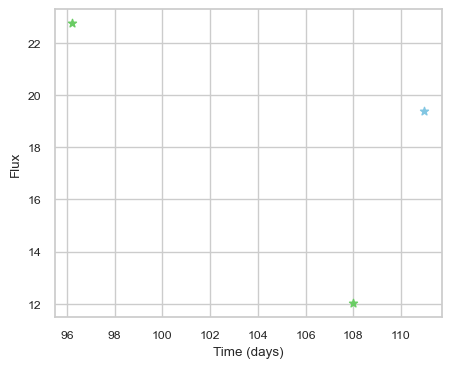

SNIax (4.111596, False)
SNIax (3.5832994, False)
SNIax (3.6656127, False)
SNIax (3.8366828, False)
SNIax (3.935369, False)
SNIax (3.6894023, False)


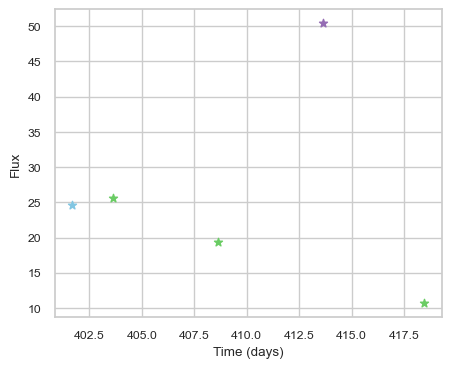

SNIax (3.842344, False)
SNIax (3.3534834, False)
SNIax (3.290416, False)
SNIax (3.0899239, False)
SNIax (3.3072371, False)
SNIax (3.47084, False)
SNIax (3.429975, False)
SNIax (3.7400906, False)
SNIax (4.0123744, False)
SNIax (3.7433972, False)


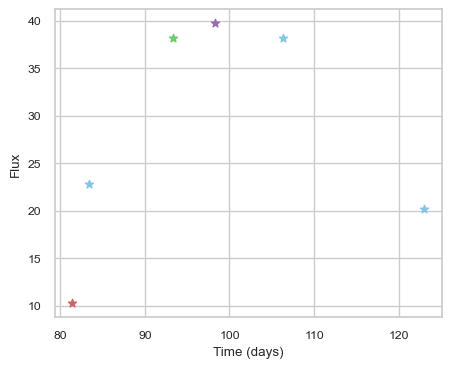

SNIax (4.3460937, False)
SNIax (3.9589245, False)
SNIax (3.2956088, False)
SNIax (3.3110397, False)
SNIax (3.2668843, False)
SNIax (3.1827652, False)
SNIax (3.4556618, False)
SNIax (2.613279, False)
SNIax (2.2073975, False)
SNIax (2.322007, False)
SNIax (2.455944, False)
SNIax (2.343571, False)


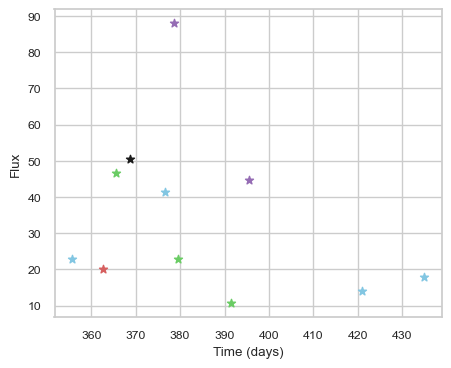

SNIax (3.942689, False)
SNIax (3.6260183, False)
SNIax (3.9140944, False)
SNIax (3.4430163, False)
SNIax (2.7660959, False)
SNIax (2.9080265, False)
SNIax (3.176242, False)
SNIax (3.0051591, False)
SNIax (2.9569194, False)
SNIax (2.118962, False)
SNIax (2.3486474, False)
SNIax (1.9469, False)
SNIax (2.8187482, False)
SNIax (1.9358711, False)
SNIax (2.1836374, False)
SNIax (2.0808482, False)
SNIax (2.3627725, False)
SNIax (1.8580368, False)
SNIax (2.633587, False)
SNIax (2.2858942, False)
SNIax (1.9743978, False)
SNIax (1.7625916, False)


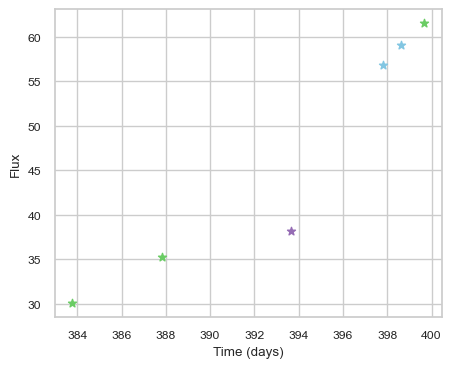

SNIax (3.97495, False)
SNIax (2.966933, False)
SNIax (3.2932622, False)
SNIax (2.4812539, False)
SNIax (2.7389083, False)
SNIax (2.3657393, False)
SNIax (3.2736635, False)
SNIax (2.1137443, False)
SNIax (3.2011695, False)
SNIax (2.6825466, False)
SNIax (3.3138819, False)
SNIax (3.0115552, False)


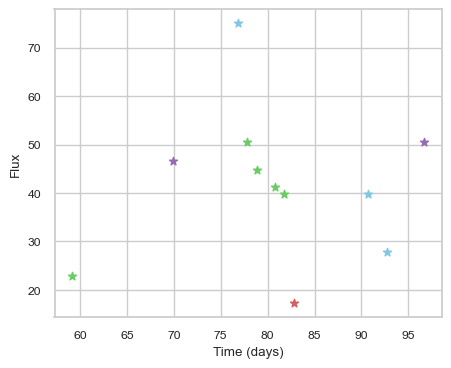

SNIax (4.0229845, False)
SNIax (3.5503275, False)
SNIax (3.48128, False)
SNIax (2.586896, False)
SNIax (2.6918526, False)
SNIax (3.3066823, False)
SNIax (3.8268387, False)
SNIax (3.0439918, False)
SNIax (2.8363826, False)
SNIax (3.4326622, False)
SNIax (3.5805407, False)
SNIax (3.3489423, False)
SNIax (3.5777705, False)
SNIax (3.6743813, False)
SNIax (3.4969068, False)
SNIax (3.350872, False)
SNIax (3.6074944, False)
SNIax (3.3591328, False)
SNIax (3.3555489, False)
SNIax (3.0290024, False)
SNIax (3.046141, False)
SNIax (2.5285325, False)


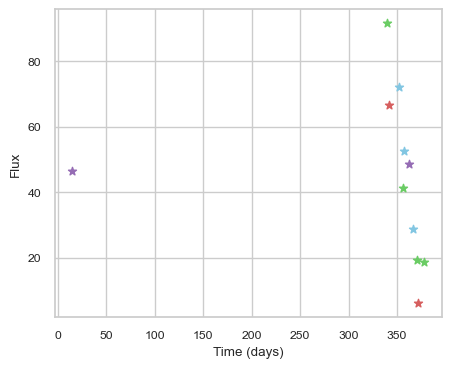

SNIax (4.1978226, False)
SNIax (4.0346723, False)
SNIax (3.8344195, False)
SNIax (4.220285, False)
SNIax (4.8024983, False)
SNIax (4.7018695, False)
SNIax (5.5994363, False)
SNIax (3.2846012, False)
SNIax (3.763929, False)
SNIax (3.757876, False)
SNIax (3.9506905, False)
SNIax (3.6343775, False)
SNIax (4.0927596, False)
SNIax (4.128711, False)
SNIax (4.449442, False)
SNIax (3.7229664, False)
SNIax (3.6675587, False)
SNIax (3.4763792, False)
SNIax (3.6247885, False)
SNIax (3.0525038, False)
SNIax (3.9896786, False)
SNIax (3.2923677, False)


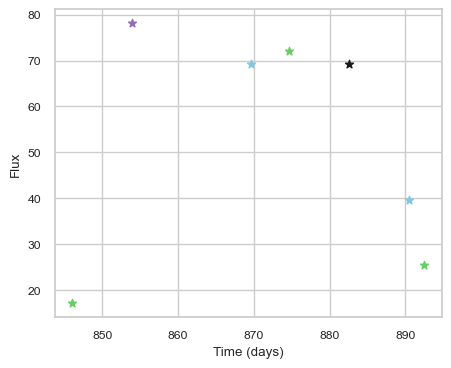

SNIax (3.7307496, False)
SNIax (3.4734876, False)
SNIax (3.201757, False)
SNIax (3.9182248, False)
SNIax (3.1046646, False)
SNIax (3.105651, False)
SNIax (3.367211, False)
SNIax (3.1818743, False)
SNIax (3.6174402, False)
SNIax (3.8449056, False)
SNIax (3.1282582, False)
SNIax (2.2604344, False)
SNIax (2.089508, False)
SNIax (2.1891515, False)


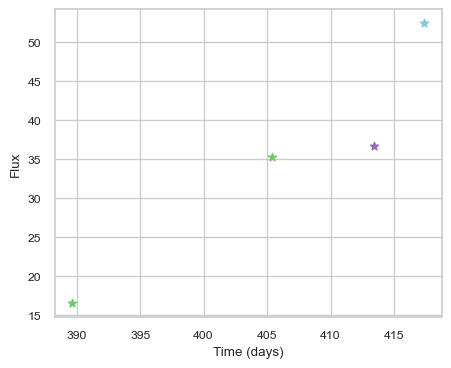

SNIax (3.8838544, False)
SNIax (3.4960337, False)
SNIax (3.4941907, False)
SNIax (2.788107, False)
SNIax (3.403688, False)
SNIax (3.5593038, False)
SNIax (4.135048, False)
SNIax (3.1174448, False)


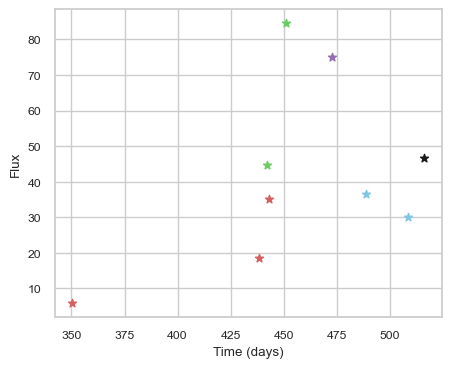

SNIax (3.9322698, False)
SNIax (3.681294, False)
SNIax (3.748984, False)
SNIax (3.7896235, False)
SNIax (3.5778666, False)
SNIax (3.444629, False)
SNIax (3.610497, False)
SNIax (3.203894, False)
SNIax (3.548401, False)
SNIax (3.4857237, False)
SNIax (3.4939303, False)
SNIax (3.1217604, False)
SNIax (4.5828624, False)
SNIax (3.8319523, False)
SNIax (3.0563707, False)
SNIax (3.2361643, False)
SNIax (3.0007987, False)
SNIax (3.9654956, False)


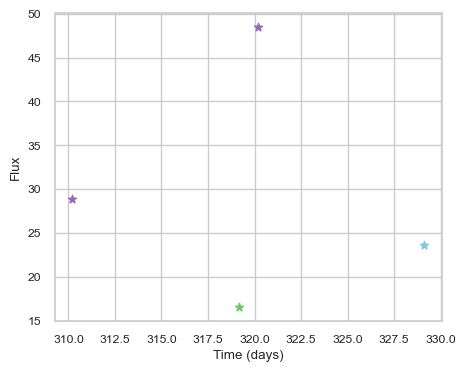

SNIax (3.7106302, False)
SNIax (4.0075946, False)
SNIax (3.367647, False)
SNIax (3.8105326, False)
SNIax (3.5167432, False)
SNIax (3.7498517, False)
SNIax (3.7466362, False)
SNIax (3.5333607, False)


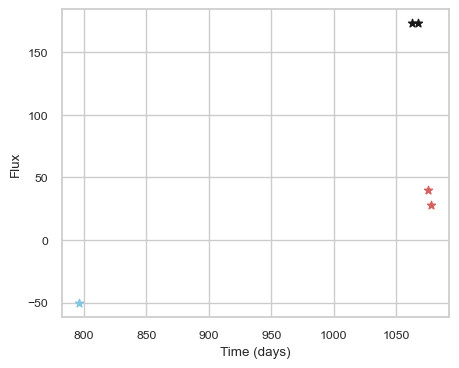

SNIax (3.8826709, False)
SNIax (3.8159866, False)
SNIax (3.7304688, False)
SNIax (4.0229445, False)
SNIax (3.6981103, False)
SNIax (3.66131, False)
SNIax (3.8763127, False)
SNIax (3.9645617, False)
SNIax (3.6788957, False)
SNIax (3.349641, False)


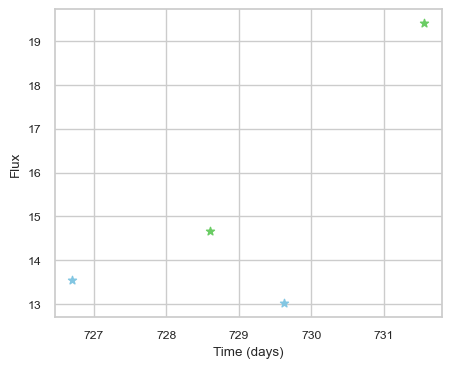

SNIax (3.8093266, False)
SNIax (3.7359622, False)
SNIax (3.2097757, False)
SNIax (2.9706585, False)
SNIax (3.1154282, False)
SNIax (3.0733583, False)
SNIax (3.001256, False)
SNIax (2.612442, False)


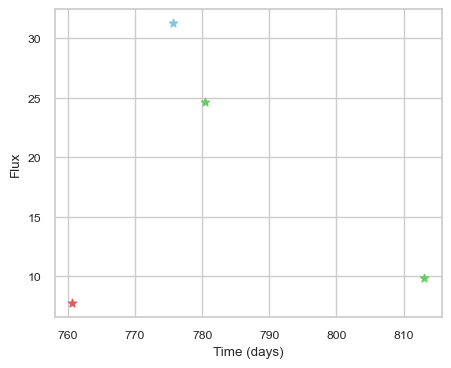

SNIax (4.566669, False)
SNIax (3.9357831, False)
SNIax (3.9094071, False)
SNIax (3.3967602, False)
SNIax (3.3524656, False)
SNIax (3.3592398, False)
SNIax (3.6871598, False)
SNIax (3.7995298, False)


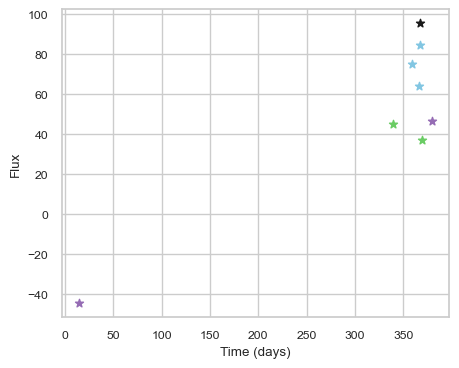

SNIax (4.935064, False)
SNIax (4.5894847, False)
SNIax (4.548325, False)
SNIax (4.71825, False)
SNIax (5.117842, False)
SNIax (5.8985295, False)
SNIax (6.411136, False)
SNIax (6.370706, False)
SNIax (6.27024, False)
SNIax (6.587144, False)
SNIax (6.4230976, False)
SNIax (5.503244, False)
SNIax (5.353069, False)
SNIax (5.7192407, False)
SNIax (5.5651484, False)
SNIax (5.6697392, False)


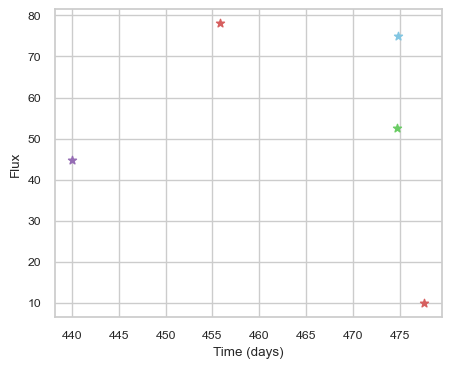

SNIax (3.9037893, False)
SNIax (3.6728146, False)
SNIax (3.7088978, False)
SNIax (4.0884366, False)
SNIax (4.356038, False)
SNIax (3.2974632, False)
SNIax (4.1681767, False)
SNIax (3.4444082, False)
SNIax (3.9554248, False)
SNIax (3.4234345, False)


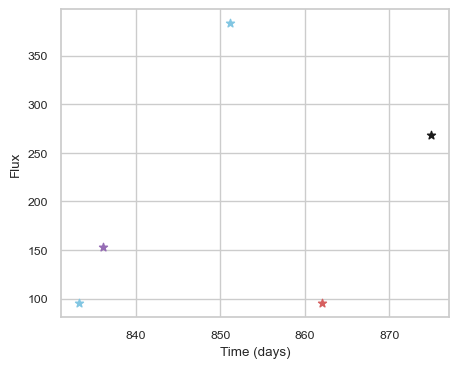

SNIax (3.7604704, False)
SNIax (3.367196, False)
SNIax (3.7135704, False)
SNIax (4.1145797, False)
SNIax (3.541635, False)
SNIax (3.351464, False)
SNIax (4.380132, False)
SNIax (5.0108213, False)
SNIax (4.53585, False)
SNIax (5.813641, False)


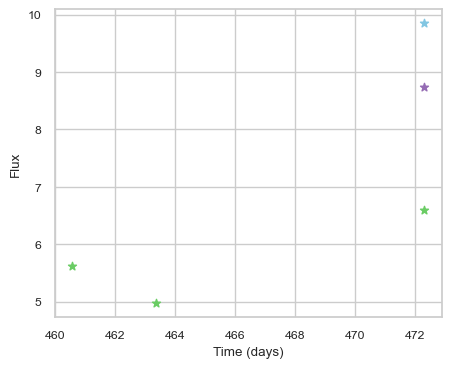

SNIax (4.8912807, False)
SNIax (4.169741, False)
SNIax (4.1702104, False)
SNIax (3.8672996, False)
SNIax (3.3979886, False)
SNIax (3.5595498, False)
SNIax (3.4566448, False)
SNIax (3.8161533, False)
SNIax (3.6858037, False)


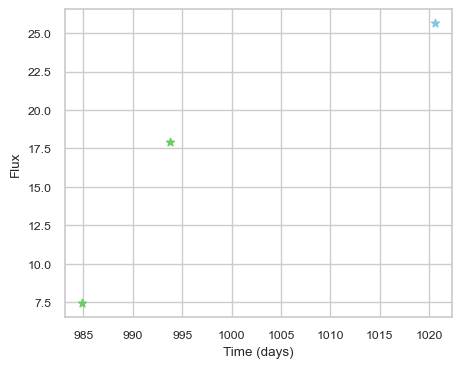

SNIax (4.2042227, False)
SNIax (3.8849075, False)
SNIax (3.2674868, False)
SNIax (3.0551672, False)
SNIax (3.3289943, False)
SNIax (3.1864161, False)


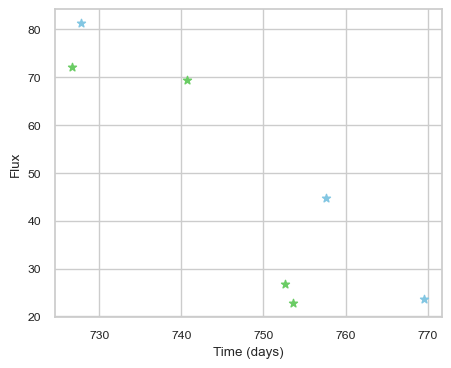

SNIax (3.8419898, False)
SNIax (3.4926517, False)
SNIax (3.5992734, False)
SNIax (4.0889688, False)
SNIax (3.823724, False)
SNIax (3.2365093, False)
SNIax (2.871939, False)
SNIax (2.6720748, False)
SNIax (2.9931996, False)
SNIax (2.8136625, False)
SNIax (2.878643, False)
SNIax (2.5614016, False)
SNIax (2.592767, False)
SNIax (2.4933395, False)


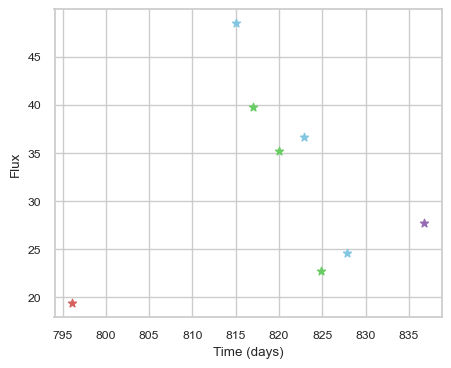

SNIax (3.842289, False)
SNIax (4.1669774, False)
SNIax (3.6360707, False)
SNIax (3.4189022, False)
SNIax (3.240546, False)
SNIax (3.583475, False)
SNIax (4.2899737, False)
SNIax (4.5025396, False)
SNIax (4.490466, False)
SNIax (4.8458667, False)
SNIax (4.660364, False)
SNIax (4.7885385, False)
SNIax (4.3302975, False)
SNIax (4.189547, False)
SNIax (3.5792975, False)
SNIax (4.28633, False)


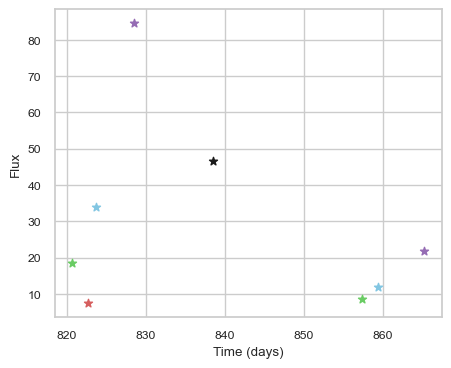

SNIax (4.0995092, False)
SNIax (3.1714878, False)
SNIax (3.33305, False)
SNIax (3.1344402, False)
SNIax (3.262785, False)
SNIax (3.3816442, False)
SNIax (4.2554436, False)
SNIax (4.8443604, False)
SNIax (4.9539413, False)
SNIax (5.0206223, False)
SNIax (5.0142717, False)
SNIax (4.459367, False)
SNIax (4.368144, False)
SNIax (4.4511933, False)
SNIax (3.85831, False)
SNIax (4.2518897, False)


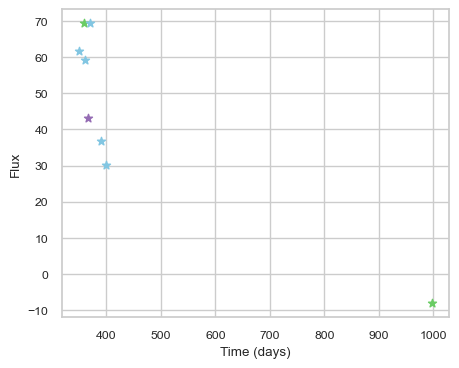

SNIax (3.8355637, False)
SNIax (3.6878457, False)
SNIax (3.5912883, False)
SNIax (3.09005, False)
SNIax (4.324664, False)
SNIax (3.2725842, False)
SNIax (4.509557, False)
SNIax (4.327662, False)
SNIax (3.8510528, False)
SNIax (3.694148, False)
SNIax (5.369488, False)
SNIax (4.3548856, False)
SNIax (4.390664, False)
SNIax (3.7881205, False)
SNIax (4.3624306, False)
SNIax (3.8215423, False)


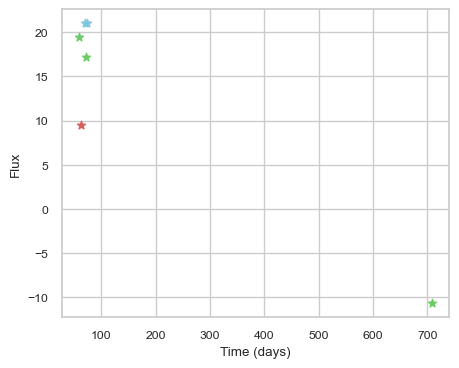

SNIax (4.0023255, False)
SNIax (3.551561, False)
SNIax (3.8777075, False)
SNIax (3.435332, False)
SNIax (2.8141587, False)
SNIax (3.4418967, False)
SNIax (3.3324792, False)
SNIax (3.2094793, False)
SNIax (3.6014388, False)
SNIax (3.1414018, False)
SNIax (3.4323862, False)
SNIax (3.7084234, False)


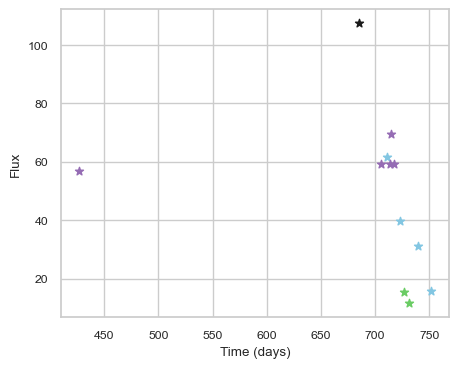

SNIax (4.0849285, False)
SNIax (3.8727286, False)
SNIax (4.257835, False)
SNIax (4.232995, False)
SNIax (4.5966916, False)
SNIax (4.5203333, False)
SNIax (4.7862554, False)
SNIax (5.0465255, False)
SNIax (5.3537126, False)
SNIax (5.411494, False)
SNIax (5.7478733, False)
SNIax (5.448899, False)
SNIax (5.246123, False)
SNIax (5.076822, False)
SNIax (4.8625484, False)
SNIax (5.014305, False)
SNIax (4.503379, False)
SNIax (4.3426113, False)
SNIax (4.2695107, False)
SNIax (4.0080132, False)
SNIax (3.6421359, False)
SNIax (4.0353794, False)
SNIax (3.8973448, False)
SNIax (3.9244146, False)


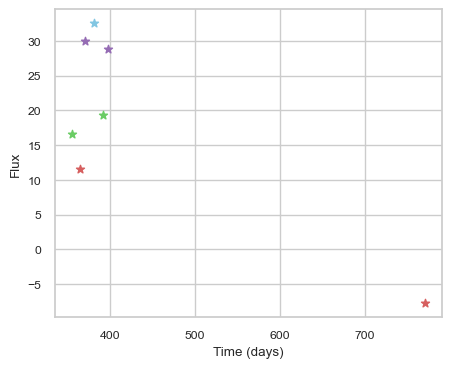

SNIax (4.439269, False)
SNIax (3.7955651, False)
SNIax (3.6299782, False)
SNIax (3.7041557, False)
SNIax (3.0895712, False)
SNIax (3.1820755, False)
SNIax (2.5363047, False)
SNIax (3.0189724, False)
SNIax (3.2689927, False)
SNIax (3.1160457, False)
SNIax (3.2115216, False)
SNIax (3.2042716, False)
SNIax (3.9282393, False)
SNIax (3.9675434, False)


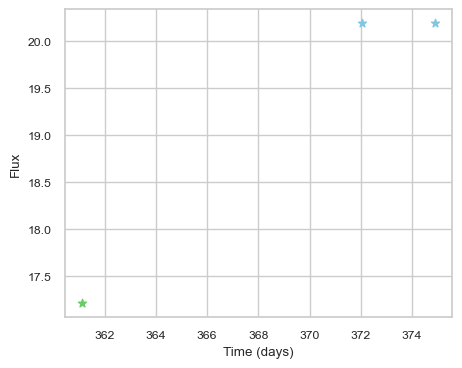

SNIax (4.358538, False)
SNIax (3.5512033, False)
SNIax (3.4408553, False)
SNIax (3.3743618, False)
SNIax (4.465589, False)
SNIax (4.1271596, False)


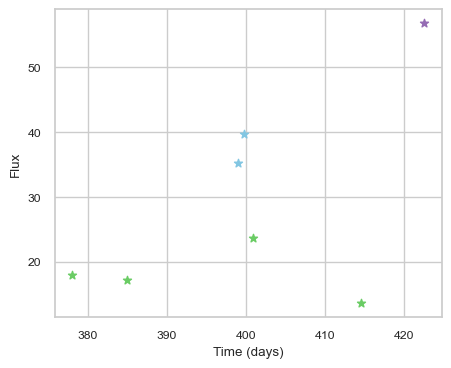

SNIax (4.623243, False)
SNIax (3.546289, False)
SNIax (3.633837, False)
SNIax (3.3188872, False)
SNIax (3.2439094, False)
SNIax (3.5360677, False)
SNIax (3.6932037, False)
SNIax (3.8023403, False)
SNIax (4.1724477, False)
SNIax (4.226016, False)
SNIax (4.646007, False)
SNIax (4.128163, False)
SNIax (4.2599835, False)
SNIax (4.301534, False)


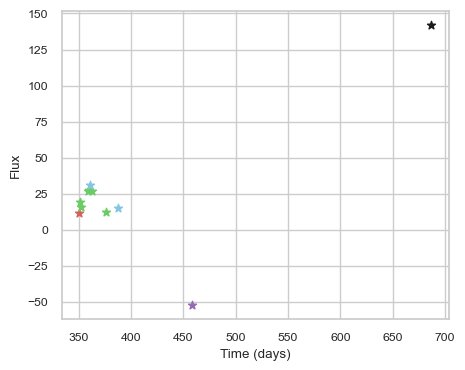

SNIax (4.0183396, False)
SNIax (3.7410352, False)
SNIax (3.6478224, False)
SNIax (2.7509947, False)
SNIax (3.0711265, False)
SNIax (3.0455859, False)
SNIax (3.2103767, False)
SNIax (2.5723143, False)
SNIax (3.4899797, False)
SNIax (2.9971774, False)
SNIax (3.0919476, False)
SNIax (2.8151062, False)
SNIax (2.6351311, False)
SNIax (2.7693632, False)
SNIax (2.374857, False)
SNIax (2.7213757, False)
SNIax (2.9457905, False)
SNIax (2.54875, False)
SNIax (3.4096713, False)
SNIax (2.9692433, False)
SNIax (4.4243236, False)
SNIax (4.5803227, False)


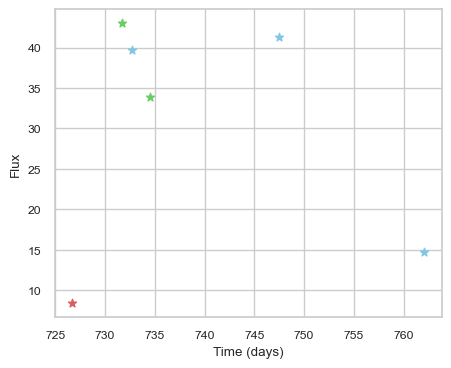

SNIax (4.0452003, False)
SNIax (3.649278, False)
SNIax (3.7603512, False)
SNIax (3.4914489, False)
SNIax (3.1487975, False)
SNIax (3.5531664, False)
SNIax (3.5976496, False)
SNIax (3.2769227, False)
SNIax (3.086259, False)
SNIax (3.0587018, False)
SNIax (2.7813733, False)
SNIax (2.5323575, False)


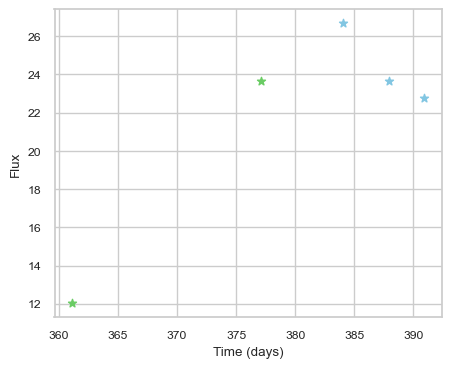

SNIax (3.9450302, False)
SNIax (3.4541116, False)
SNIax (3.3743455, False)
SNIax (3.253383, False)
SNIax (3.602641, False)
SNIax (3.1305046, False)
SNIax (4.1037283, False)
SNIax (3.3303618, False)
SNIax (3.7870874, False)
SNIax (3.63035, False)


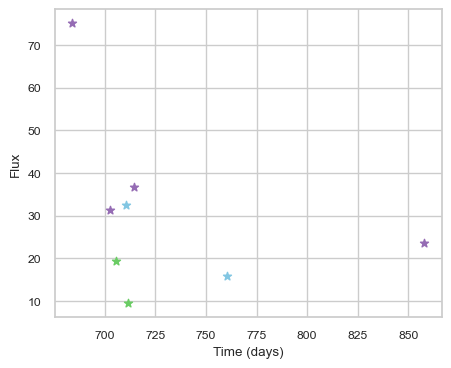

SNIax (3.9568558, False)
SNIax (4.3472576, False)
SNIax (5.104846, False)
SNIax (4.2581697, False)
SNIax (4.473332, False)
SNIax (4.0854335, False)
SNIax (4.4246573, False)
SNIax (3.7087965, False)
SNIax (3.6036754, False)
SNIax (3.5894241, False)
SNIax (3.7449732, False)
SNIax (3.4427674, False)
SNIax (4.6416626, False)
SNIax (4.118653, False)
SNIax (5.396589, False)
SNIax (4.3790994, False)


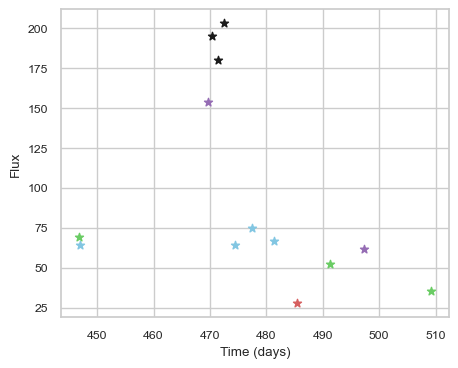

SNIax (4.291404, False)
SNIax (4.469163, False)
SNIax (4.899969, False)
SNIax (4.1786685, False)
SNIax (4.8342266, False)
SNIax (5.3710165, False)
SNIax (4.462546, False)
SNIax (4.5980463, False)
SNIax (4.295972, False)
SNIax (3.9879508, False)
SNIax (4.3803415, False)
SNIax (3.518588, False)
SNIax (4.1489434, False)
SNIax (3.3846056, False)
SNIax (4.4253445, False)
SNIax (3.678982, False)
SNIax (4.3361034, False)
SNIax (3.7618496, False)
SNIax (4.4657745, False)
SNIax (3.7441716, False)
SNIax (4.62212, False)
SNIax (4.3611054, False)
SNIax (4.630493, False)
SNIax (4.8139215, False)
SNIax (4.652597, False)
SNIax (4.866831, False)


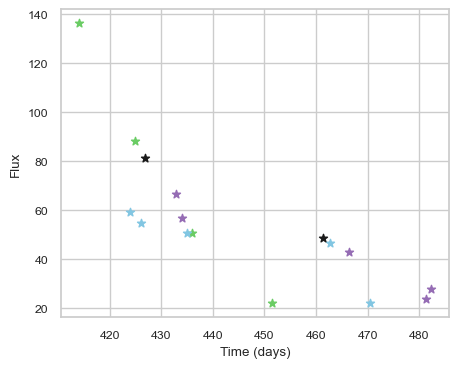

SNIax (3.7894502, False)
SNIax (3.5860877, False)
SNIax (3.3025975, False)
SNIax (3.1977742, False)
SNIax (2.9646072, False)
SNIax (3.1924295, False)
SNIax (4.2369013, False)
SNIax (3.6733675, False)
SNIax (3.6846154, False)
SNIax (4.0348434, False)
SNIax (3.7346816, False)
SNIax (4.4595795, False)
SNIax (3.7199817, False)
SNIax (4.189788, False)
SNIax (4.1759934, False)
SNIax (3.4366012, False)
SNIax (3.7395463, False)
SNIax (4.393004, False)
SNIax (4.7283735, False)
SNIax (4.7187896, False)
SNIax (3.5055027, False)
SNIax (4.6292286, False)
SNIax (4.2117696, False)
SNIax (3.497245, False)
SNIax (4.2843914, False)
SNIax (4.336748, False)
SNIax (3.9398074, False)
SNIax (3.489926, False)
SNIax (3.0707114, False)
SNIax (3.8025105, False)
SNIax (3.3438148, False)
SNIax (3.5583544, False)


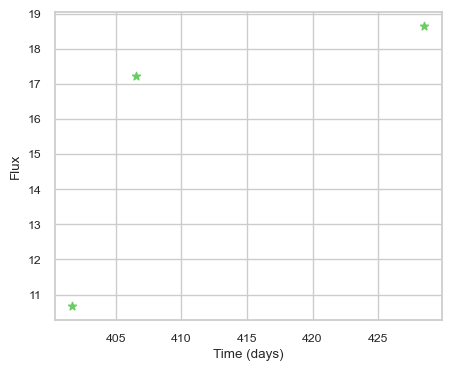

SNIax (4.3626432, False)
SNIax (3.6127849, False)
SNIax (3.2661345, False)
SNIax (3.0264528, False)
SNIax (2.7077823, False)
SNIax (2.944248, False)


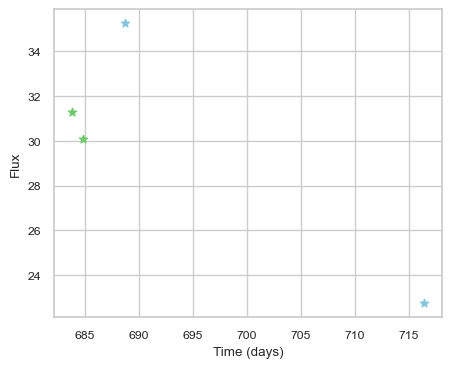

SNIax (4.4788003, False)
SNIax (4.6869073, False)
SNIax (4.2403774, False)
SNIax (4.3360186, False)
SNIax (4.9947205, False)
SNIax (5.1138926, False)
SNIax (4.933663, False)
SNIax (4.687164, False)


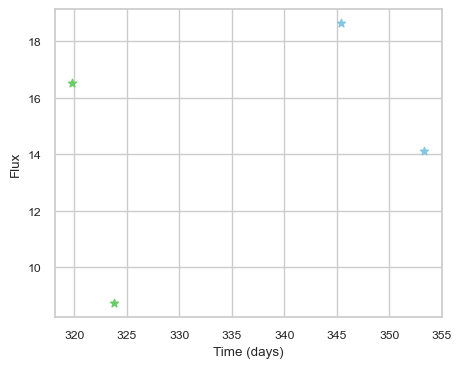

SNIax (4.7587695, False)
SNIax (4.7757754, False)
SNIax (4.2404027, False)
SNIax (4.0582356, False)
SNIax (3.7535324, False)
SNIax (3.7201436, False)
SNIax (3.2461753, False)
SNIax (3.5519996, False)


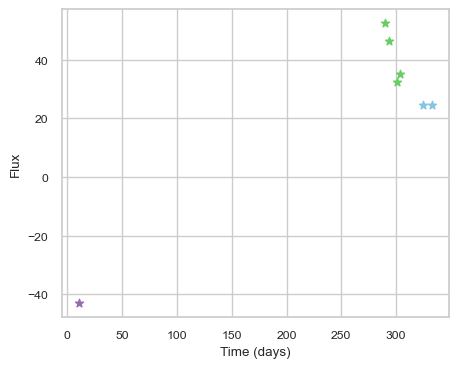

SNIax (4.039284, False)
SNIax (3.69105, False)
SNIax (3.8403237, False)
SNIax (3.5893066, False)
SNIax (3.9047353, False)
SNIax (3.3755896, False)
SNIax (3.8010304, False)
SNIax (4.0649614, False)
SNIax (3.9897397, False)
SNIax (3.8993258, False)
SNIax (4.4843974, False)
SNIax (4.017078, False)
SNIax (3.599023, False)
SNIax (3.5833251, False)


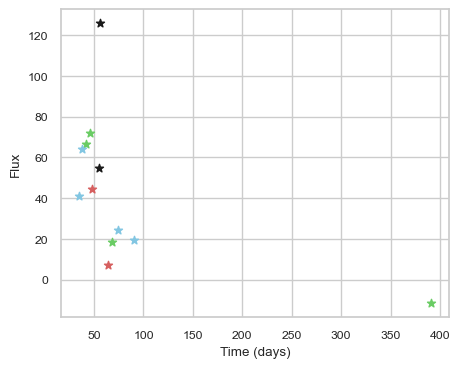

SNIax (3.8762689, False)
SNIax (3.656863, False)
SNIax (3.7374458, False)
SNIax (4.128714, False)
SNIax (4.197651, False)
SNIax (3.4091175, False)
SNIax (3.498502, False)
SNIax (3.0850086, False)
SNIax (3.3766837, False)
SNIax (3.1255503, False)
SNIax (3.4563446, False)
SNIax (2.9193406, False)
SNIax (3.295351, False)
SNIax (3.125087, False)
SNIax (3.7853415, False)
SNIax (3.076969, False)
SNIax (3.7326791, False)
SNIax (3.3614583, False)
SNIax (3.2558503, False)
SNIax (2.5261717, False)
SNIax (2.620997, False)
SNIax (2.7444336, False)
SNIax (2.8019285, False)
SNIax (2.4009905, False)


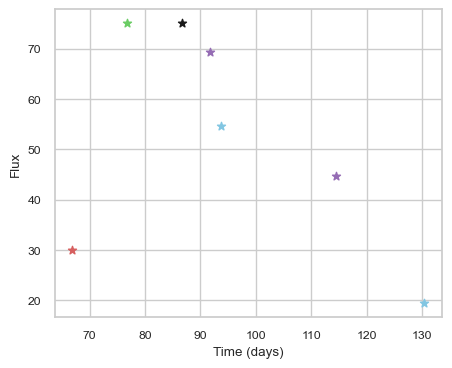

SNIax (3.9280615, False)
SNIax (4.506213, False)
SNIax (4.1065693, False)
SNIax (4.1948223, False)
SNIax (3.9408884, False)
SNIax (3.88931, False)
SNIax (3.761669, False)
SNIax (3.255973, False)
SNIax (4.354895, False)
SNIax (3.6960986, False)
SNIax (3.9900534, False)
SNIax (3.5666187, False)
SNIax (4.393403, False)
SNIax (3.3065412, False)


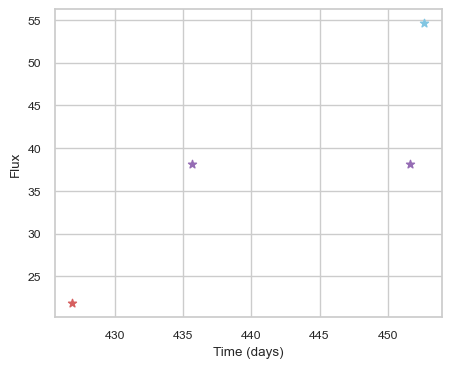

SNIax (3.9788992, False)
SNIax (5.0997443, False)
SNIax (4.123295, False)
SNIax (3.6581035, False)
SNIax (4.0068192, False)
SNIax (4.144477, False)
SNIax (4.3774657, False)
SNIax (3.8539264, False)


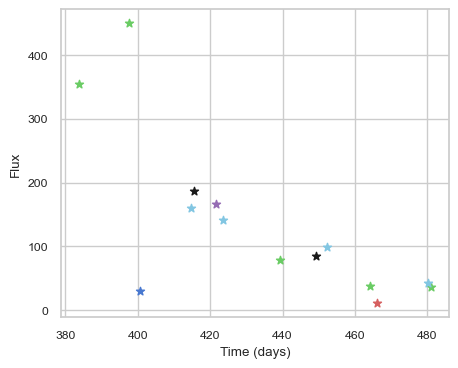

SNIax (3.7264676, False)
SNIax (2.98308, False)
SNIax (3.6930015, False)
SNIax (3.3928819, False)
SNIax (4.7190237, False)
SNIax (5.2578406, False)
SNIax (5.243894, False)
SNIax (5.0537214, False)
SNIax (5.1170893, False)
SNIax (5.470807, False)
SNIax (4.912988, False)
SNIax (5.0969133, False)
SNIax (5.133637, False)
SNIax (4.9582853, False)
SNIax (5.4174376, False)
SNIax (5.4182577, False)
SNIax (4.983572, False)
SNIax (5.821455, False)
SNIax (5.2583284, False)
SNIax (4.9006877, False)
SNIax (5.071948, False)
SNIax (5.204548, False)
SNIax (4.822262, False)
SNIax (5.3491535, False)
SNIax (5.2763953, False)
SNIax (5.0444317, False)
SNIax (5.180675, False)
SNIax (5.0406113, False)


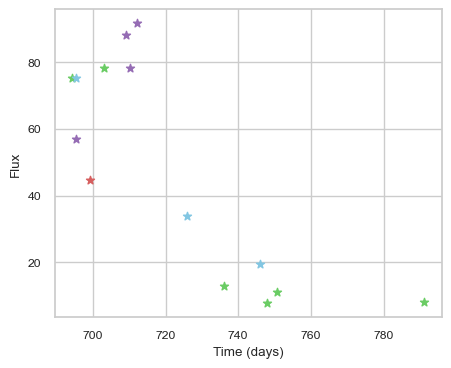

SNIax (3.8260238, False)
SNIax (4.067655, False)
SNIax (4.3701363, False)
SNIax (5.281172, False)
SNIax (5.4037423, False)
SNIax (4.525209, False)
SNIax (5.908785, False)
SNIax (5.7789207, False)
SNIax (5.6281085, False)
SNIax (4.870161, False)
SNIax (5.081232, False)
SNIax (4.447915, False)
SNIax (5.2984385, False)
SNIax (4.226391, False)
SNIax (4.912737, False)
SNIax (4.5717893, False)
SNIax (4.6763425, False)
SNIax (4.542712, False)
SNIax (4.7076263, False)
SNIax (4.608899, False)
SNIax (4.4104476, False)
SNIax (4.6973305, False)
SNIax (4.103299, False)
SNIax (4.1885276, False)
SNIax (4.248316, False)
SNIax (4.0318847, False)
SNIax (4.682934, False)
SNIax (4.3473277, False)


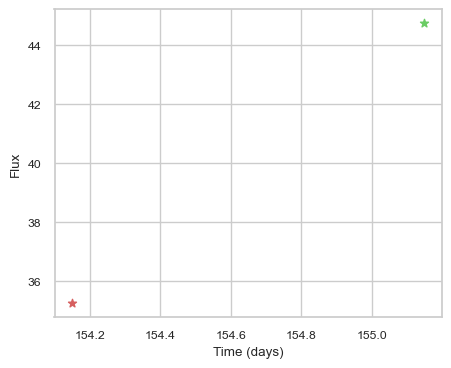

SNIax (3.918394, False)
SNIax (4.5481143, False)
SNIax (5.1010523, False)
SNIax (3.7352138, False)


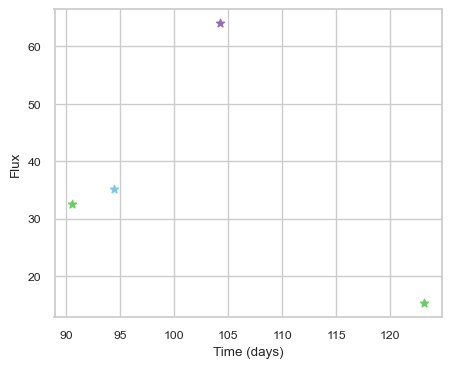

SNIax (4.0860934, False)
SNIax (3.896635, False)
SNIax (3.710125, False)
SNIax (3.20991, False)
SNIax (3.2031333, False)
SNIax (3.2837474, False)
SNIax (3.5572703, False)
SNIax (2.9648464, False)


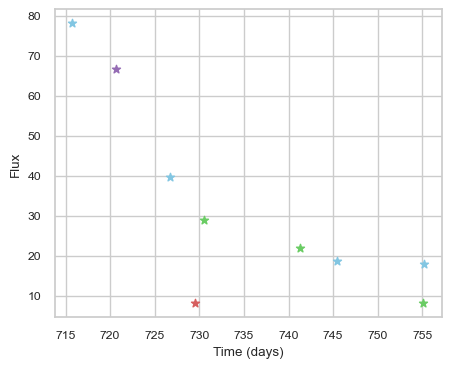

SNIax (3.792215, False)
SNIax (3.5065362, False)
SNIax (3.7364483, False)
SNIax (2.957203, False)
SNIax (2.676192, False)
SNIax (2.7870324, False)
SNIax (3.4094539, False)
SNIax (3.104061, False)
SNIax (2.9105783, False)
SNIax (2.7661178, False)
SNIax (3.2492216, False)
SNIax (2.8706234, False)
SNIax (2.7734787, False)
SNIax (2.6389203, False)
SNIax (2.6776392, False)
SNIax (2.7809918, False)
SNIax (2.9686375, False)
SNIax (2.7067275, False)


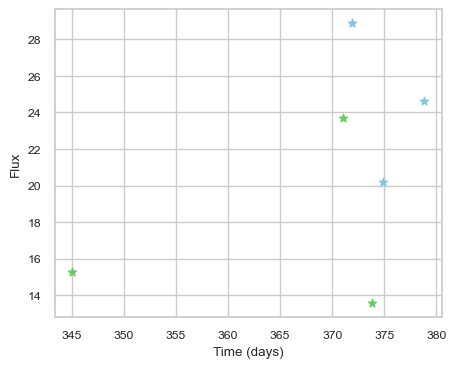

SNIax (4.0078926, False)
SNIax (3.528506, False)
SNIax (3.1446452, False)
SNIax (3.3628914, False)
SNIax (3.8542342, False)
SNIax (2.7953386, False)
SNIax (3.5986845, False)
SNIax (2.947904, False)
SNIax (2.8762348, False)
SNIax (2.8290832, False)
SNIax (3.2423346, False)
SNIax (2.6517916, False)


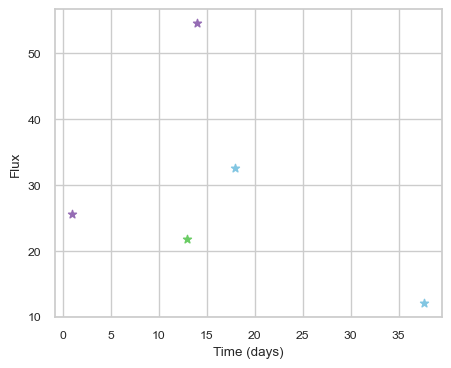

SNIax (4.3331904, False)
SNIax (3.9813697, False)
SNIax (3.426941, False)
SNIax (2.89359, False)
SNIax (3.279655, False)
SNIax (3.437205, False)
SNIax (4.09652, False)
SNIax (3.8992267, False)
SNIax (3.8023424, False)
SNIax (3.3236616, False)


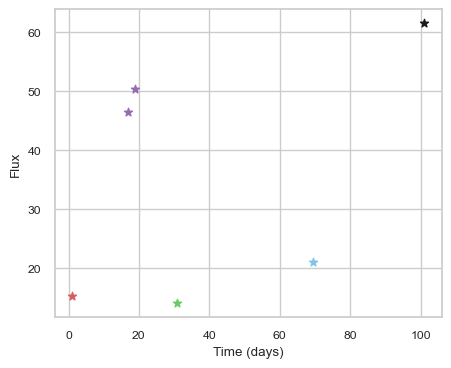

SNIax (4.7910748, False)
SNIax (4.382732, False)
SNIax (4.1026287, False)
SNIax (3.4035063, False)
SNIax (3.4784946, False)
SNIax (3.2963276, False)
SNIax (3.226302, False)
SNIax (3.02251, False)
SNIax (4.022132, False)
SNIax (3.5162926, False)
SNIax (4.0564957, False)
SNIax (4.6137586, False)


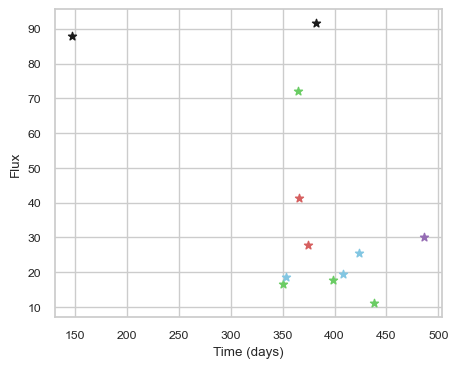

SNIax (3.7608833, False)
SNIax (4.280065, False)
SNIax (3.8940704, False)
SNIax (3.5485973, False)
SNIax (3.5039403, False)
SNIax (3.1226718, False)
SNIax (3.1900046, False)
SNIax (3.1538281, False)
SNIax (3.137821, False)
SNIax (3.129949, False)
SNIax (3.472003, False)
SNIax (3.7421834, False)
SNIax (3.383237, False)
SNIax (2.8143742, False)
SNIax (3.11866, False)
SNIax (2.2144494, False)
SNIax (2.715225, False)
SNIax (1.898851, False)
SNIax (2.5302196, False)
SNIax (2.2111084, False)
SNIax (2.4990015, False)
SNIax (2.2658486, False)
SNIax (3.0459929, False)
SNIax (2.9253917, False)


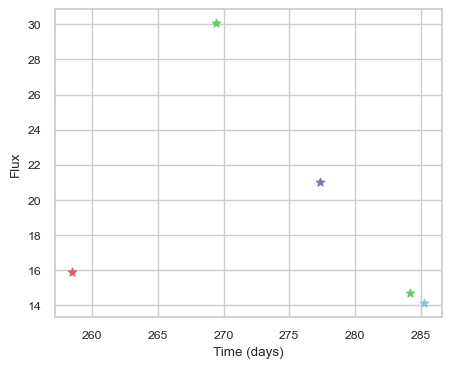

SNIax (3.793171, False)
SNIax (3.8247669, False)
SNIax (3.722161, False)
SNIax (3.4331534, False)
SNIax (4.6702824, False)
SNIax (5.0007024, False)
SNIax (3.9927452, False)
SNIax (4.344934, False)
SNIax (4.1721478, False)
SNIax (4.0119123, False)


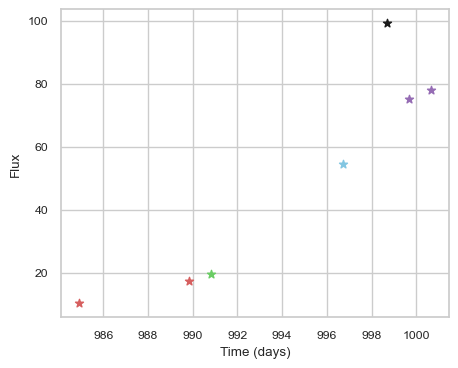

SNIax (3.8715358, False)
SNIax (4.4422245, False)
SNIax (3.743066, False)
SNIax (3.7906241, False)
SNIax (3.146106, False)
SNIax (3.5526137, False)
SNIax (3.893924, False)
SNIax (3.6538284, False)
SNIax (4.383077, False)
SNIax (3.7778583, False)
SNIax (5.1134872, False)
SNIax (4.6807637, False)
SNIax (5.48102, False)
SNIax (4.7872257, False)


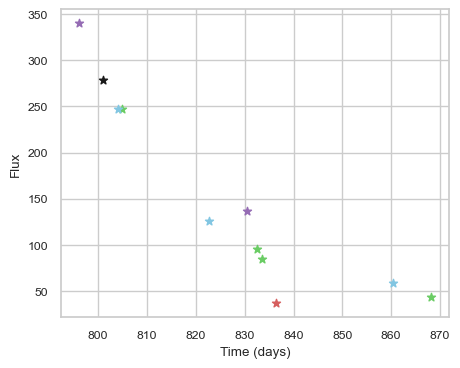

SNIax (3.6514316, False)
SNIax (3.3850415, False)
SNIax (2.903104, False)
SNIax (3.474487, False)
SNIax (3.0761137, False)
SNIax (3.1651525, False)
SNIax (3.10761, False)
SNIax (3.601709, False)
SNIax (4.0176535, False)
SNIax (3.1658022, False)
SNIax (2.6928828, False)
SNIax (3.1844726, False)
SNIax (2.6524894, False)
SNIax (2.8332036, False)
SNIax (2.545856, False)
SNIax (3.001309, False)
SNIax (2.9181583, False)
SNIax (3.121995, False)
SNIax (3.022228, False)
SNIax (2.689586, False)
SNIax (2.5724325, False)
SNIax (2.8086174, False)


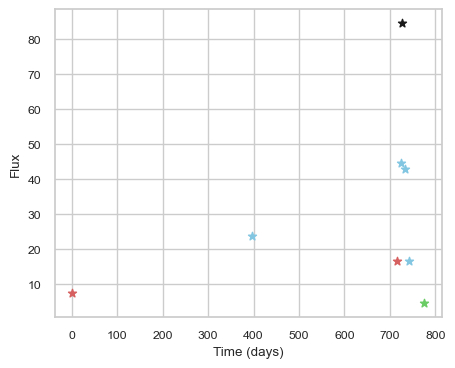

SNIax (4.1426954, False)
SNIax (3.9810476, False)
SNIax (4.0035605, False)
SNIax (3.3661585, False)
SNIax (3.525177, False)
SNIax (3.5756664, False)
SNIax (3.5027423, False)
SNIax (2.9855626, False)
SNIax (3.4397223, False)
SNIax (3.8197703, False)
SNIax (3.3330646, False)
SNIax (4.7869034, False)
SNIax (4.4475875, False)
SNIax (3.579747, False)
SNIax (3.4098318, False)
SNIax (2.9520094, False)


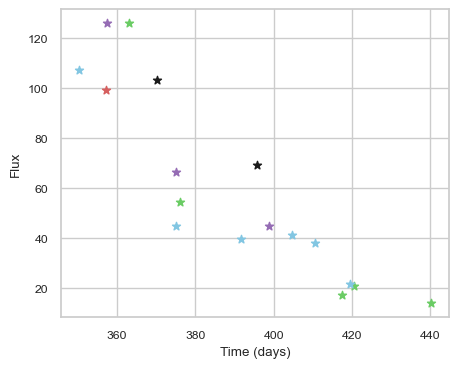

SNIax (3.806594, False)
SNIax (3.8061163, False)
SNIax (3.7655642, False)
SNIax (3.4945097, False)
SNIax (4.0942516, False)
SNIax (3.465867, False)
SNIax (4.426312, False)
SNIax (3.2841759, False)
SNIax (4.6850486, False)
SNIax (4.671733, False)
SNIax (3.7358768, False)
SNIax (3.1611476, False)
SNIax (2.4231763, False)
SNIax (2.8467305, False)
SNIax (2.0042398, False)
SNIax (2.090276, False)
SNIax (1.8916687, False)
SNIax (2.2078853, False)
SNIax (3.0330307, False)
SNIax (2.522259, False)
SNIax (2.2499201, False)
SNIax (1.8825259, False)
SNIax (1.8703446, False)
SNIax (1.9250695, False)
SNIax (1.7317913, False)
SNIax (2.3013275, False)
SNIax (2.3270078, False)
SNIax (2.1709352, False)
SNIax (1.9250207, False)
SNIax (1.7033311, False)
SNIax (1.8337538, False)
SNIax (1.7763143, False)
SNIax (1.8132507, False)


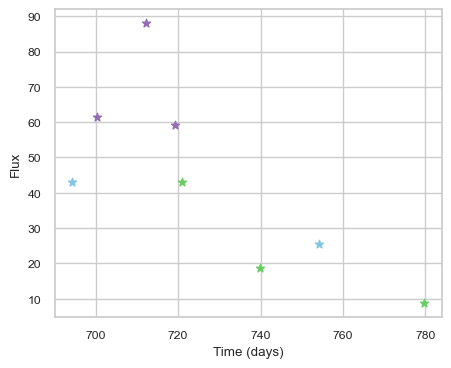

SNIax (3.5607476, False)
SNIax (3.6139786, False)
SNIax (3.3857362, False)
SNIax (3.7540994, False)
SNIax (4.5088105, False)
SNIax (4.521057, False)
SNIax (4.8498964, False)
SNIax (5.2731104, False)
SNIax (4.0992007, False)
SNIax (4.8299255, False)
SNIax (5.22556, False)
SNIax (4.6001196, False)
SNIax (3.85298, False)
SNIax (4.571891, False)
SNIax (4.608333, False)
SNIax (3.8355443, False)


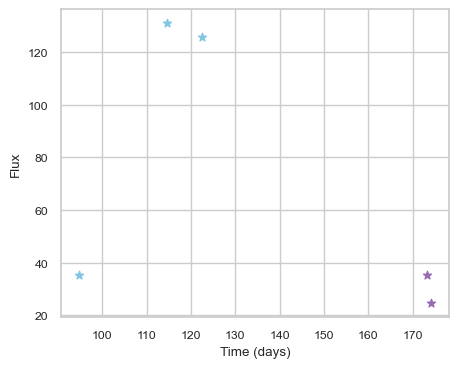

SNIax (3.8669837, False)
SNIax (3.7169385, False)
SNIax (3.5269942, False)
SNIax (4.7741203, False)
SNIax (5.133668, False)
SNIax (5.595151, False)
SNIax (4.991519, False)
SNIax (5.2283397, False)
SNIax (5.4134455, False)
SNIax (5.034265, False)


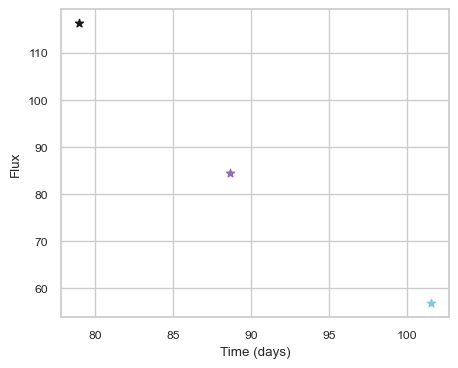

SNIax (3.816261, False)
SNIax (3.8911428, False)
SNIax (4.410108, False)
SNIax (4.3485804, False)
SNIax (4.5381308, False)
SNIax (3.9772773, False)


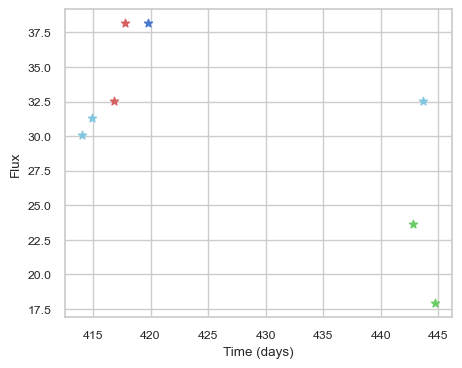

SNIax (3.8155627, False)
SNIax (3.6741393, False)
SNIax (3.3136096, False)
SNIax (3.6157591, False)
SNIax (3.39279, False)
SNIax (3.6009154, False)
SNIax (4.3478756, False)
SNIax (3.9858088, False)
SNIax (3.7758582, False)
SNIax (3.9000692, False)
SNIax (3.2833376, False)
SNIax (3.8422115, False)
SNIax (4.879076, False)
SNIax (3.9554415, False)
SNIax (4.370389, False)
SNIax (4.3696423, False)


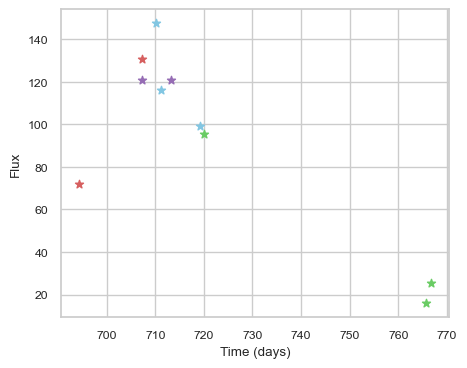

SNIax (3.657618, False)
SNIax (4.5007157, False)
SNIax (3.5535722, False)
SNIax (4.1596, False)
SNIax (4.1131186, False)
SNIax (3.469076, False)
SNIax (5.01361, False)
SNIax (4.254985, False)
SNIax (3.4495397, False)
SNIax (4.4515214, False)
SNIax (4.5119185, False)
SNIax (4.832269, False)
SNIax (4.8201823, False)
SNIax (4.665327, False)
SNIax (3.8497279, False)
SNIax (4.4715567, False)
SNIax (5.083167, False)
SNIax (4.4461265, False)
SNIax (2.7020175, False)
SNIax (3.4737327, False)


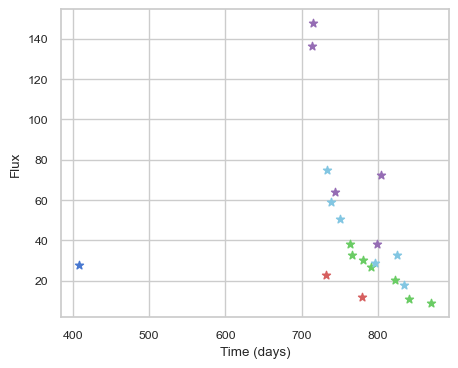

SNIax (3.7685583, False)
SNIax (4.9524984, False)
SNIax (3.8011065, False)
SNIax (3.6046035, False)
SNIax (3.8378143, False)
SNIax (3.268438, False)
SNIax (3.8680532, False)
SNIax (3.6347225, False)
SNIax (3.2515464, False)
SNIax (2.7445993, False)
SNIax (3.1572685, False)
SNIax (2.7028558, False)
SNIax (2.9215655, False)
SNIax (2.8472152, False)
SNIax (2.544945, False)
SNIax (2.1210184, False)
SNIax (2.7445757, False)
SNIax (2.7850263, False)
SNIax (3.1231797, False)
SNIax (2.8202083, False)
SNIax (3.1949556, False)
SNIax (3.027333, False)
SNIax (3.5824447, False)
SNIax (3.0108025, False)
SNIax (3.8667846, False)
SNIax (3.2458024, False)
SNIax (3.3280745, False)
SNIax (2.7984474, False)
SNIax (2.8519802, False)
SNIax (3.4524772, False)
SNIax (2.9750447, False)
SNIax (3.4226668, False)
SNIax (3.7458377, False)
SNIax (3.2345831, False)
SNIax (3.297617, False)
SNIax (2.9974127, False)
SNIax (2.851898, False)
SNIax (2.9909954, False)
SNIax (2.617429, False)
SNIax (3.026892, False)
SNIax (

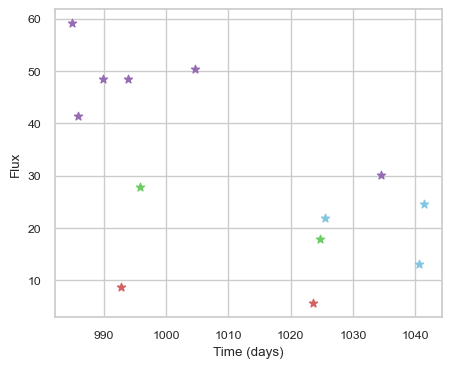

SNIax (3.6122208, False)
SNIax (3.6049416, False)
SNIax (3.7892418, False)
SNIax (3.674539, False)
SNIax (3.6814902, False)
SNIax (3.6201081, False)
SNIax (3.3757665, False)
SNIax (3.8937044, False)
SNIax (3.483973, False)
SNIax (3.2568445, False)
SNIax (3.126599, False)
SNIax (3.0132484, False)
SNIax (3.2497573, False)
SNIax (3.1399875, False)
SNIax (3.6067955, False)
SNIax (3.755299, False)
SNIax (3.2162328, False)
SNIax (2.891853, False)
SNIax (3.1722946, False)
SNIax (2.7497928, False)
SNIax (2.968404, False)
SNIax (3.5379725, False)
SNIax (3.1446686, False)
SNIax (3.0563715, False)
SNIax (2.812462, False)
SNIax (2.6989696, False)


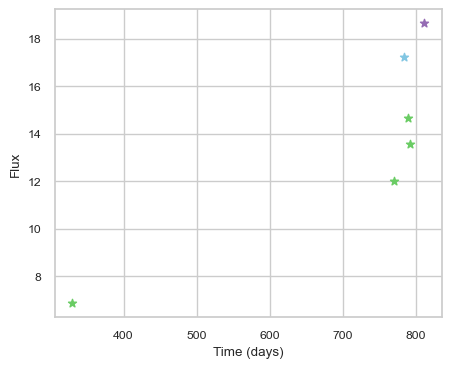

SNIax (5.1880155, False)
SNIax (4.9003344, False)
SNIax (5.020739, False)
SNIax (4.394232, False)
SNIax (4.64976, False)
SNIax (4.30387, False)
SNIax (3.7275813, False)
SNIax (3.668328, False)
SNIax (3.5959604, False)
SNIax (3.5056033, False)
SNIax (3.3200326, False)
SNIax (3.8864493, False)


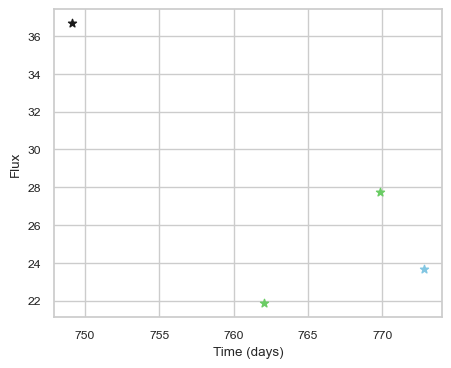

SNIax (3.7659764, False)
SNIax (3.619597, False)
SNIax (3.3249776, False)
SNIax (3.2515311, False)
SNIax (3.4270666, False)
SNIax (3.3455298, False)
SNIax (3.9680033, False)
SNIax (3.8188558, False)


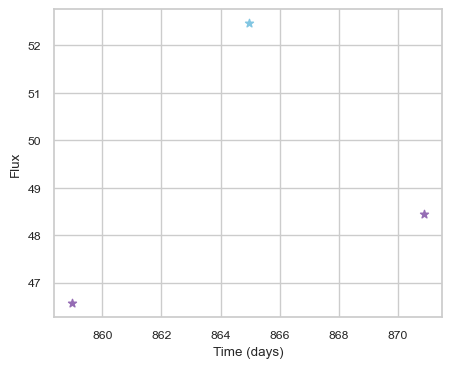

SNIax (3.831073, False)
SNIax (3.8844244, False)
SNIax (3.4195042, False)
SNIax (3.9261491, False)
SNIax (3.5084383, False)
SNIax (3.0798087, False)


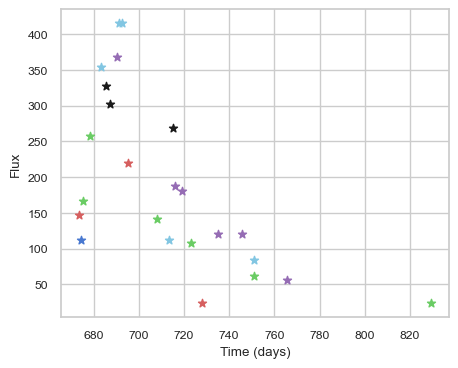

SNIax (3.7401607, False)
SNIax (4.125869, False)
SNIax (3.473322, False)
SNIax (4.2172384, False)
SNIax (3.8126209, False)
SNIax (3.8530004, False)
SNIax (3.9204526, False)
SNIax (3.7840154, False)
SNIax (3.2848573, False)
SNIax (3.1412573, False)
SNIax (3.1278636, False)
SNIax (3.4446504, False)
SNIax (3.8855932, False)
SNIax (3.2961915, False)
SNIax (3.7622736, False)
SNIax (1.9780189, False)
SNIax (3.166164, False)
SNIax (2.561522, False)
SNIax (2.6213717, False)
SNIax (2.3597164, False)
SNIax (2.9075575, False)
SNIax (2.3643084, False)
SNIax (2.229511, False)
SNIax (2.3202107, False)
SNIax (2.625704, False)
SNIax (2.3669083, False)
SNIax (2.894494, False)
SNIax (2.7605133, False)
SNIax (3.135681, False)
SNIax (2.3638668, False)
SNIax (2.9824014, False)
SNIax (2.4632487, False)
SNIax (2.481158, False)
SNIax (2.5391521, False)
SNIax (2.538982, False)
SNIax (2.537181, False)
SNIax (2.8864815, False)
SNIax (2.5866714, False)
SNIax (2.5592134, False)
SNIax (2.2906737, False)
SNIax (2.78

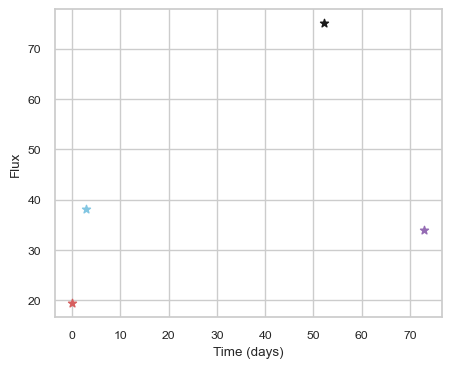

SNIax (4.5007863, False)
SNIax (3.5896382, False)
SNIax (4.8677516, False)
SNIax (4.6626334, False)
SNIax (4.733292, False)
SNIax (5.182356, False)
SNIax (6.4528604, False)


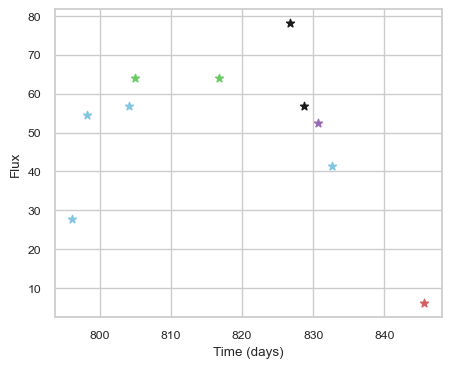

SNIax (3.7333212, False)
SNIax (3.5817544, False)
SNIax (3.1181529, False)
SNIax (3.8627, False)
SNIax (3.4112859, False)
SNIax (3.7278285, False)
SNIax (3.6684315, False)
SNIax (3.785624, False)
SNIax (3.5233142, False)
SNIax (4.0170107, False)
SNIax (4.004439, False)
SNIax (4.662603, False)
SNIax (4.2116895, False)
SNIax (4.6421494, False)
SNIax (4.3562226, False)
SNIax (4.7405787, False)
SNIax (4.326917, False)
SNIax (4.039337, False)
SNIax (4.4620924, False)
SNIax (4.890774, False)


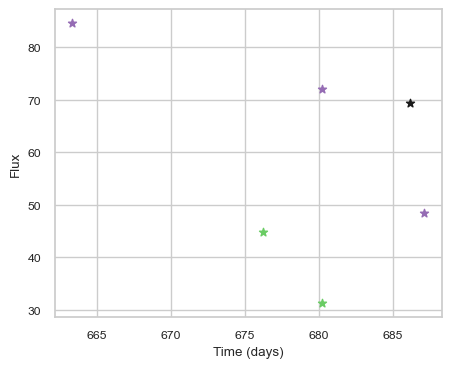

SNIax (4.282255, False)
SNIax (4.4305487, False)
SNIax (4.880882, False)
SNIax (5.15621, False)
SNIax (5.3807898, False)
SNIax (5.0531297, False)
SNIax (5.2760377, False)
SNIax (4.3872285, False)
SNIax (4.2090793, False)
SNIax (4.536255, False)
SNIax (4.0379877, False)
SNIax (4.1472535, False)


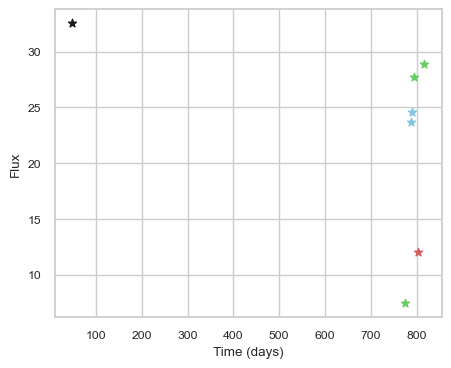

SNIax (4.834478, False)
SNIax (4.4377995, False)
SNIax (4.018338, False)
SNIax (3.259191, False)
SNIax (3.2888677, False)
SNIax (2.5551112, False)
SNIax (2.6024141, False)
SNIax (2.2250416, False)
SNIax (2.266015, False)
SNIax (2.1148124, False)
SNIax (2.2124405, False)
SNIax (2.0284548, False)
SNIax (2.307399, False)
SNIax (2.255784, False)


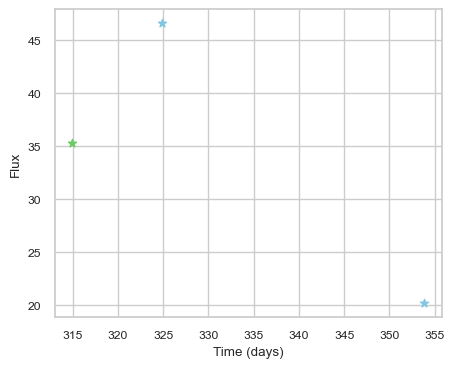

SNIax (3.777831, False)
SNIax (4.109248, False)
SNIax (3.451853, False)
SNIax (3.572638, False)
SNIax (4.550315, False)
SNIax (4.531714, False)


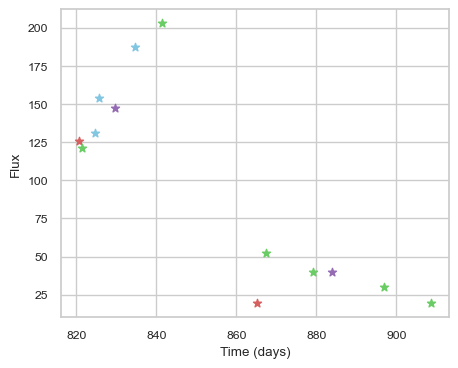

SNIax (3.7474902, False)
SNIax (4.197182, False)
SNIax (3.9525092, False)
SNIax (3.6221888, False)
SNIax (4.0745535, False)
SNIax (3.6878805, False)
SNIax (4.1174135, False)
SNIax (4.508072, False)
SNIax (4.886485, False)
SNIax (4.727647, False)
SNIax (4.9232697, False)
SNIax (4.65347, False)
SNIax (4.746726, False)
SNIax (4.4743595, False)
SNIax (4.26341, False)
SNIax (4.153182, False)
SNIax (3.7435153, False)
SNIax (4.3767047, False)
SNIax (3.3236213, False)
SNIax (3.6370823, False)
SNIax (3.5576255, False)
SNIax (3.728817, False)
SNIax (2.22197, False)
SNIax (3.3186376, False)
SNIax (3.2473109, False)
SNIax (3.746907, False)


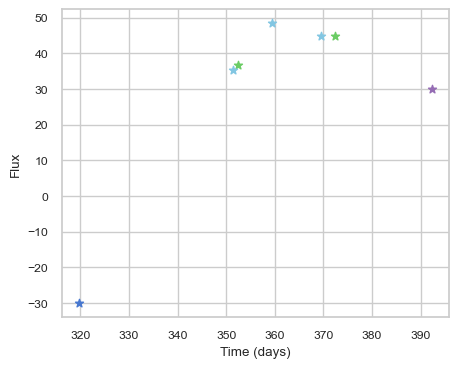

SNIax (3.827132, False)
SNIax (4.4909816, False)
SNIax (3.9423418, False)
SNIax (3.8374624, False)
SNIax (3.5857239, False)
SNIax (3.5922625, False)
SNIax (3.652938, False)
SNIax (2.9014778, False)
SNIax (3.1034596, False)
SNIax (3.4914525, False)
SNIax (3.953956, False)
SNIax (4.3668747, False)
SNIax (5.44382, False)
SNIax (5.7245426, False)


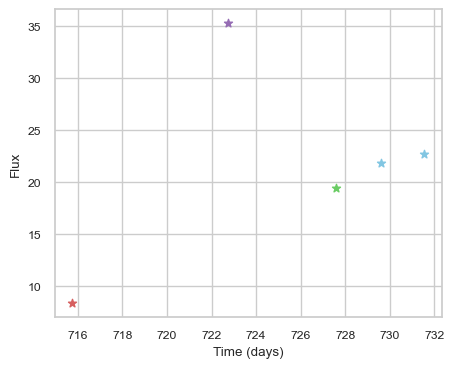

SNIax (3.9337704, False)
SNIax (4.006646, False)
SNIax (3.4761763, False)
SNIax (2.7536187, False)
SNIax (3.2949214, False)
SNIax (2.9478996, False)
SNIax (3.083921, False)
SNIax (2.840184, False)
SNIax (3.492501, False)
SNIax (2.9700353, False)


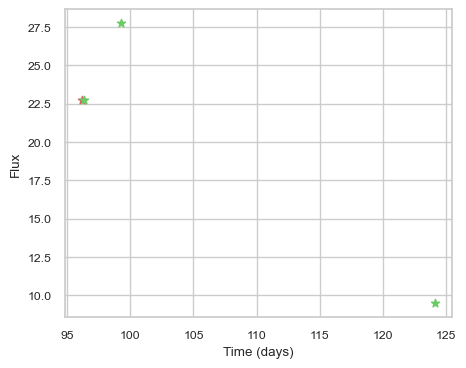

SNIax (3.8721054, False)
SNIax (4.2994514, False)
SNIax (3.9928255, False)
SNIax (4.2389503, False)
SNIax (4.35704, False)
SNIax (3.8052797, False)
SNIax (4.232996, False)
SNIax (4.4555693, False)


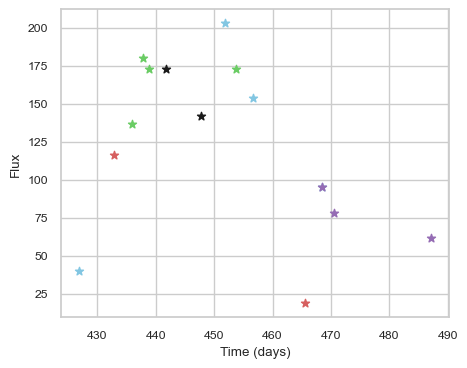

SNIax (4.2929387, False)
SNIax (4.072833, False)
SNIax (4.275602, False)
SNIax (5.087484, False)
SNIax (4.6526647, False)
SNIax (4.2407637, False)
SNIax (4.3976593, False)
SNIax (4.3068166, False)
SNIax (3.7349694, False)
SNIax (3.7420356, False)
SNIax (4.0479746, False)
SNIax (3.8321095, False)
SNIax (3.487708, False)
SNIax (3.5451753, False)
SNIax (3.2735279, False)
SNIax (2.8704896, False)
SNIax (3.0563107, False)
SNIax (2.5860286, False)
SNIax (2.8356285, False)
SNIax (2.2826335, False)
SNIax (2.5372612, False)
SNIax (2.9363506, False)
SNIax (3.471686, False)
SNIax (2.6590183, False)
SNIax (2.836779, False)
SNIax (2.9914336, False)
SNIax (2.9729977, False)
SNIax (2.8403149, False)
SNIax (3.3553066, False)
SNIax (2.848418, False)


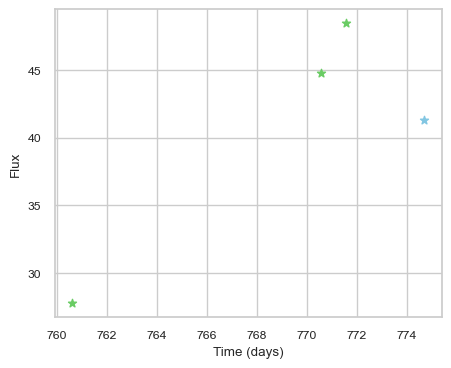

SNIax (3.8542714, False)
SNIax (3.1383157, False)
SNIax (3.5790994, False)
SNIax (2.5593548, False)
SNIax (2.646225, False)
SNIax (3.0031855, False)
SNIax (3.0503614, False)
SNIax (2.230466, False)


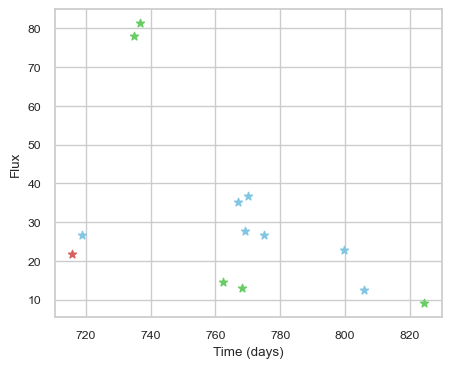

SNIax (3.8656282, False)
SNIax (4.358211, False)
SNIax (3.3971832, False)
SNIax (3.7113924, False)
SNIax (4.8123584, False)
SNIax (2.9933825, False)
SNIax (3.2459397, False)
SNIax (2.904358, False)
SNIax (2.5841947, False)
SNIax (2.6198769, False)
SNIax (2.2711508, False)
SNIax (1.5825416, False)
SNIax (2.0871596, False)
SNIax (1.8757789, False)
SNIax (2.0669339, False)
SNIax (1.3545469, False)
SNIax (1.9525113, False)
SNIax (1.4561213, False)
SNIax (2.0145447, False)
SNIax (1.4451094, False)
SNIax (1.9927087, False)
SNIax (1.6646394, False)
SNIax (1.8202718, False)
SNIax (1.6649783, False)
SNIax (1.9897312, False)
SNIax (1.9109659, False)


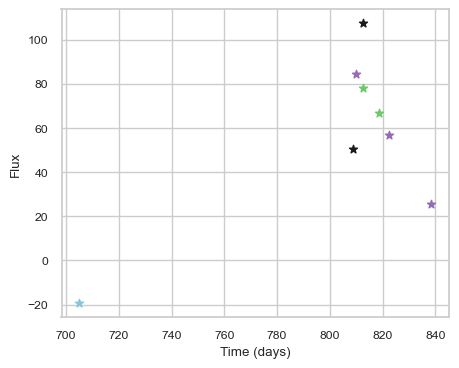

SNIax (3.844078, False)
SNIax (3.8474936, False)
SNIax (3.9487612, False)
SNIax (3.3974462, False)
SNIax (3.706564, False)
SNIax (4.1413274, False)
SNIax (4.895621, False)
SNIax (4.9519563, False)
SNIax (5.0931206, False)
SNIax (4.6134953, False)
SNIax (4.8812737, False)
SNIax (4.2519126, False)
SNIax (3.8135672, False)
SNIax (3.6827443, False)
SNIax (4.1100006, False)
SNIax (3.9453576, False)


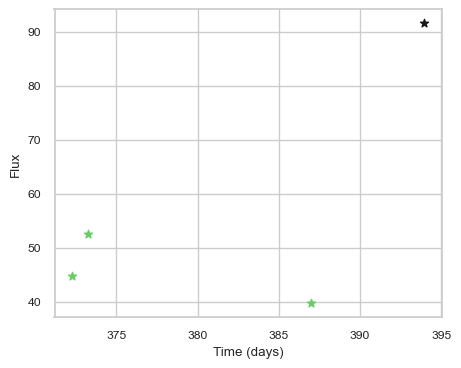

SNIax (4.060839, False)
SNIax (3.598717, False)
SNIax (3.975341, False)
SNIax (4.6065226, False)
SNIax (5.031713, False)
SNIax (4.2726245, False)
SNIax (4.320817, False)
SNIax (4.4302373, False)


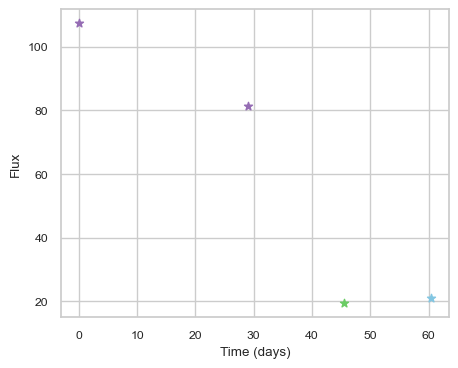

SNIax (4.2080636, False)
SNIax (4.213229, False)
SNIax (4.667584, False)
SNIax (4.4376283, False)
SNIax (4.3036623, False)
SNIax (4.0822124, False)
SNIax (3.6971061, False)


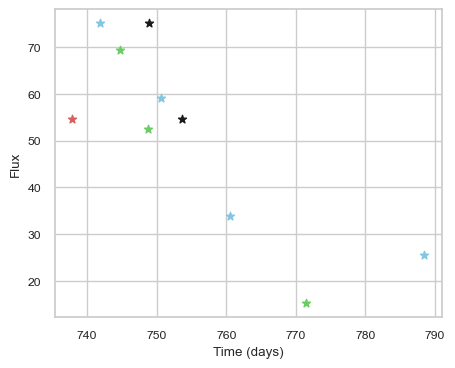

SNIax (3.691538, False)
SNIax (3.4192886, False)
SNIax (4.5137844, False)
SNIax (3.5356445, False)
SNIax (3.9291553, False)
SNIax (3.8297946, False)
SNIax (4.548447, False)
SNIax (4.8345447, False)
SNIax (4.611893, False)
SNIax (5.027989, False)
SNIax (4.663224, False)
SNIax (4.762748, False)
SNIax (4.505114, False)
SNIax (4.684508, False)
SNIax (3.8053374, False)
SNIax (4.680234, False)
SNIax (3.3209498, False)
SNIax (4.574578, False)
SNIax (2.8869233, False)
SNIax (3.7525334, False)


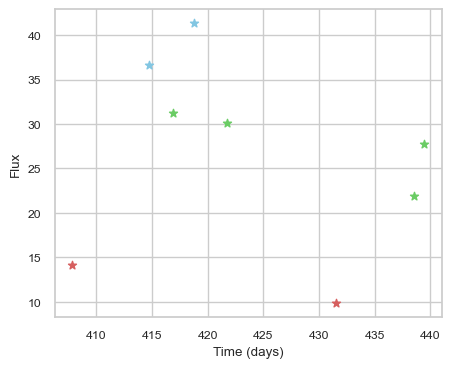

SNIax (3.9319375, False)
SNIax (4.0202093, False)
SNIax (4.0901814, False)
SNIax (3.3913445, False)
SNIax (4.345679, False)
SNIax (4.039439, False)
SNIax (4.262042, False)
SNIax (4.392187, False)
SNIax (3.9488115, False)
SNIax (4.1891036, False)
SNIax (3.5760465, False)
SNIax (4.243247, False)
SNIax (4.063062, False)
SNIax (3.5871882, False)
SNIax (3.8077872, False)
SNIax (3.8709736, False)


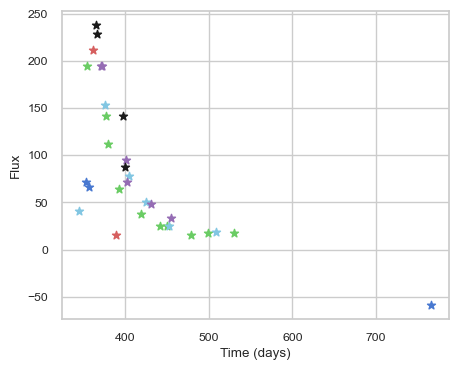

SNIax (3.8408484, False)
SNIax (3.7815666, False)
SNIax (3.7122455, False)
SNIax (5.1407504, False)
SNIax (4.9489746, False)
SNIax (3.512118, False)
SNIax (3.644262, False)
SNIax (3.4591188, False)
SNIax (4.169864, False)
SNIax (4.2141695, False)
SNIax (5.7388067, False)
SNIax (4.530968, False)
SNIax (3.82416, False)
SNIax (2.8829682, False)
SNIax (3.7494907, False)
SNIax (2.0216866, False)
SNIax (3.584961, False)
SNIax (2.187558, False)
SNIax (3.113393, False)
SNIax (2.3264968, False)
SNIax (2.6296895, False)
SNIax (2.5710557, False)
SNIax (2.723361, False)
SNIax (2.6017432, False)
SNIax (2.7855153, False)
SNIax (2.6687293, False)
SNIax (2.8419445, False)
SNIax (2.4320824, False)
SNIax (2.7727013, False)
SNIax (2.8747032, False)
SNIax (3.3117394, False)
SNIax (3.0808742, False)
SNIax (2.9762692, False)
SNIax (2.6237803, False)
SNIax (3.147715, False)
SNIax (2.9186065, False)
SNIax (2.7711558, False)
SNIax (2.3101912, False)
SNIax (2.536797, False)
SNIax (2.7625792, False)
SNIax (2.817

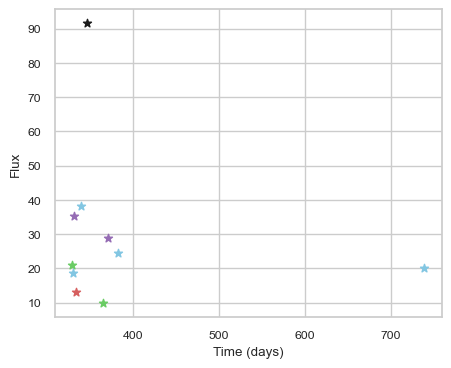

SNIax (4.248366, False)
SNIax (3.98484, False)
SNIax (3.2409878, False)
SNIax (3.5694227, False)
SNIax (3.150599, False)
SNIax (2.531447, False)
SNIax (2.9902093, False)
SNIax (2.933094, False)
SNIax (2.6285222, False)
SNIax (2.3040562, False)
SNIax (2.5422213, False)
SNIax (2.5982242, False)
SNIax (2.8940256, False)
SNIax (2.5468557, False)
SNIax (2.9013915, False)
SNIax (2.7884388, False)
SNIax (2.4236739, False)
SNIax (2.90285, False)
SNIax (3.3192925, False)
SNIax (3.0440784, False)


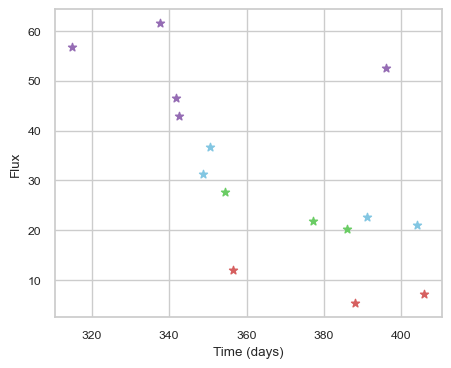

SNIax (3.910028, False)
SNIax (4.2969627, False)
SNIax (4.2511067, False)
SNIax (5.0507298, False)
SNIax (4.6254573, False)
SNIax (4.7791166, False)
SNIax (4.883046, False)
SNIax (4.8735785, False)
SNIax (4.1906414, False)
SNIax (4.559735, False)
SNIax (4.1387267, False)
SNIax (5.0713997, False)
SNIax (4.4920945, False)
SNIax (4.5967517, False)
SNIax (4.4649496, False)
SNIax (5.6319833, False)
SNIax (5.965619, False)
SNIax (5.8079257, False)
SNIax (6.001057, False)
SNIax (5.9437904, False)
SNIax (5.3821316, False)
SNIax (6.069602, False)
SNIax (4.76084, False)
SNIax (5.160356, False)
SNIax (4.296097, False)
SNIax (5.277219, False)
SNIax (6.0747895, False)
SNIax (6.3863163, False)
SNIax (4.648775, False)
SNIax (6.738059, False)


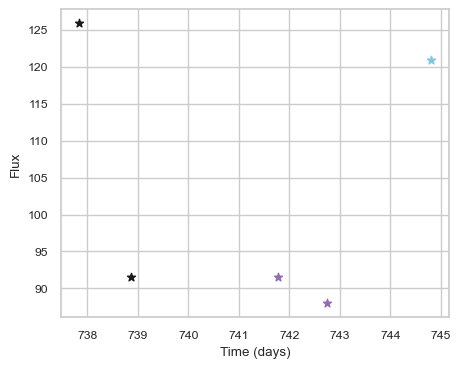

SNIax (3.848772, False)
SNIax (3.5856712, False)
SNIax (3.9906433, False)
SNIax (3.5303352, False)
SNIax (4.328061, False)
SNIax (3.5315292, False)
SNIax (4.005695, False)
SNIax (3.4896448, False)
SNIax (3.7292852, False)
SNIax (3.8630784, False)


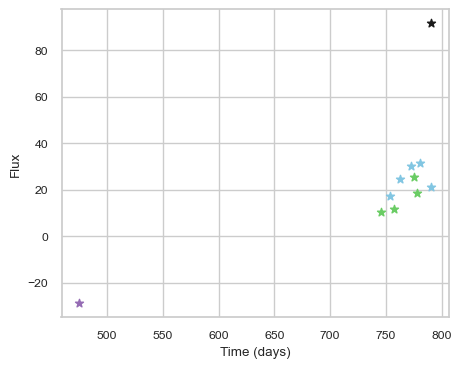

SNIax (4.432371, False)
SNIax (4.3024397, False)
SNIax (4.1642175, False)
SNIax (3.3554478, False)
SNIax (3.3187165, False)
SNIax (3.3153212, False)
SNIax (3.416019, False)
SNIax (3.4181247, False)
SNIax (3.0328302, False)
SNIax (3.082623, False)
SNIax (2.805313, False)
SNIax (3.5709965, False)
SNIax (3.5087674, False)
SNIax (3.3087344, False)
SNIax (3.7872915, False)
SNIax (2.944627, False)
SNIax (3.2180316, False)
SNIax (3.3345857, False)
SNIax (3.2067225, False)
SNIax (3.5847833, False)
SNIax (4.0190244, False)
SNIax (4.0956564, False)


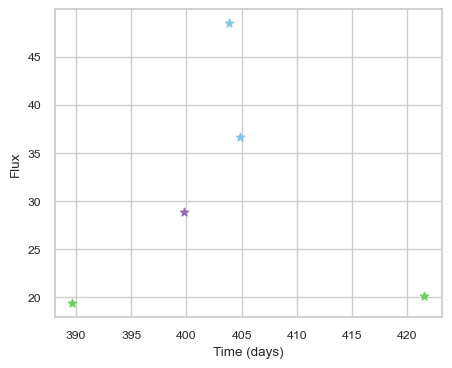

SNIax (4.8920355, False)
SNIax (3.8752558, False)
SNIax (4.3462496, False)
SNIax (3.8415947, False)
SNIax (4.2342463, False)
SNIax (4.935233, False)
SNIax (5.2455444, False)
SNIax (5.44397, False)
SNIax (5.6744194, False)
SNIax (5.73774, False)


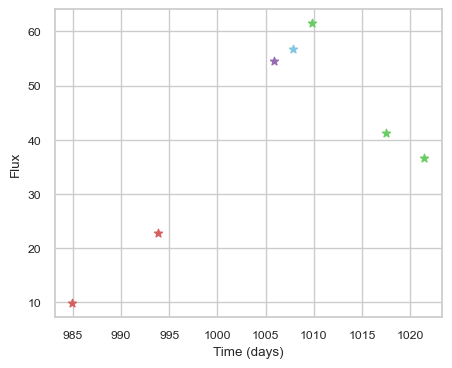

SNIax (3.9470286, False)
SNIax (4.4155407, False)
SNIax (3.434222, False)
SNIax (3.3408954, False)
SNIax (2.9656868, False)
SNIax (2.4276772, False)
SNIax (2.8623724, False)
SNIax (2.8423676, False)
SNIax (3.072831, False)
SNIax (2.1848714, False)
SNIax (2.8426647, False)
SNIax (2.4020267, False)
SNIax (3.2316198, False)
SNIax (2.302208, False)


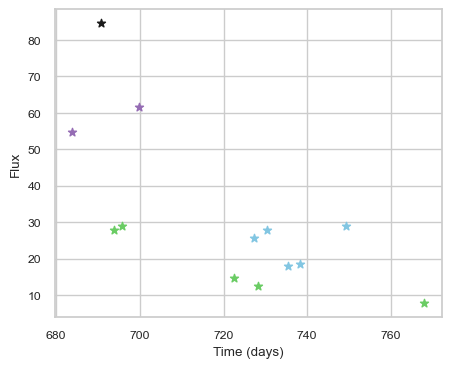

SNIax (3.8860264, False)
SNIax (3.750988, False)
SNIax (4.1001363, False)
SNIax (4.8944626, False)
SNIax (4.534285, False)
SNIax (3.1381667, False)
SNIax (4.0299497, False)
SNIax (3.7914085, False)
SNIax (4.1080337, False)
SNIax (4.4476576, False)
SNIax (4.3681846, False)
SNIax (3.8468146, False)
SNIax (3.567927, False)
SNIax (3.1438265, False)
SNIax (3.1847427, False)
SNIax (3.2570071, False)
SNIax (3.3264916, False)
SNIax (2.8462965, False)
SNIax (3.36878, False)
SNIax (2.6573699, False)
SNIax (3.2718706, False)
SNIax (2.9135845, False)
SNIax (3.2787697, False)
SNIax (3.3579128, False)
SNIax (4.84765, False)
SNIax (4.3009233, False)


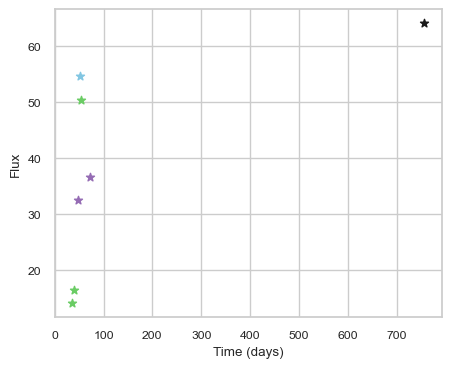

SNIax (4.069362, False)
SNIax (3.4372728, False)
SNIax (3.535965, False)
SNIax (3.1715941, False)
SNIax (3.2458591, False)
SNIax (3.0819798, False)
SNIax (3.1541157, False)
SNIax (3.0530603, False)
SNIax (3.4611266, False)
SNIax (2.787943, False)
SNIax (3.3762834, False)
SNIax (2.3680074, False)
SNIax (2.5411592, False)
SNIax (3.1233351, False)


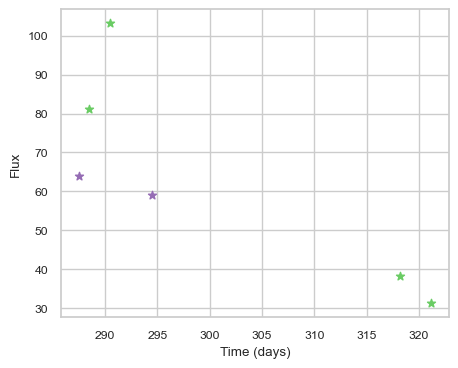

SNIax (3.9242768, False)
SNIax (4.1924367, False)
SNIax (4.3164434, False)
SNIax (4.863066, False)
SNIax (5.240773, False)
SNIax (5.4435797, False)
SNIax (6.0822115, False)
SNIax (5.0884533, False)
SNIax (4.4341364, False)
SNIax (4.6092, False)
SNIax (4.08424, False)
SNIax (3.919131, False)


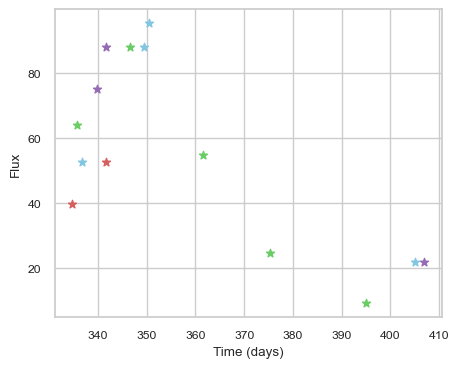

SNIax (4.2593017, False)
SNIax (4.8117714, False)
SNIax (4.838123, False)
SNIax (4.674977, False)
SNIax (4.288936, False)
SNIax (4.4907966, False)
SNIax (4.119553, False)
SNIax (4.0010543, False)
SNIax (4.123304, False)
SNIax (4.1558466, False)
SNIax (4.734721, False)
SNIax (4.2102485, False)
SNIax (4.2215986, False)
SNIax (3.7817082, False)
SNIax (3.8321135, False)
SNIax (3.9349272, False)
SNIax (4.264097, False)
SNIax (4.32308, False)
SNIax (3.7182512, False)
SNIax (3.7570188, False)
SNIax (3.518683, False)
SNIax (3.671385, False)
SNIax (3.2478073, False)
SNIax (3.8335083, False)
SNIax (3.1808696, False)
SNIax (3.5705597, False)
SNIax (3.1427805, False)
SNIax (3.6723099, False)


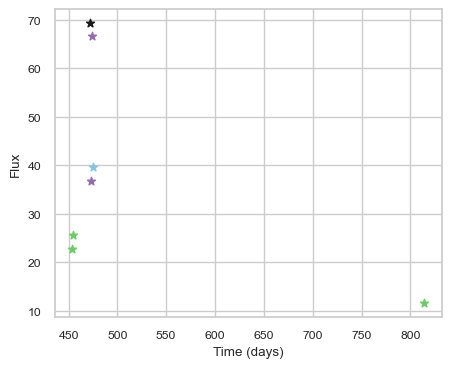

SNIax (4.6652145, False)
SNIax (3.748175, False)
SNIax (3.6355214, False)
SNIax (3.2497795, False)
SNIax (3.4591713, False)
SNIax (4.2154202, False)
SNIax (4.9546204, False)
SNIax (4.3010035, False)
SNIax (4.21494, False)
SNIax (4.7859654, False)
SNIax (4.7824035, False)
SNIax (4.5670867, False)
SNIax (4.706144, False)
SNIax (4.1571937, False)


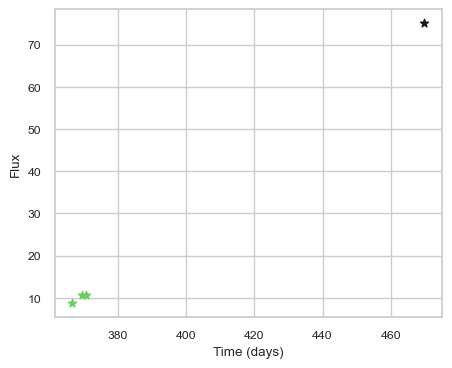

SNIax (4.6528296, False)
SNIax (3.743256, False)
SNIax (3.2927053, False)
SNIax (3.064487, False)
SNIax (2.7703109, False)
SNIax (2.7649472, False)
SNIax (3.2668118, False)
SNIax (3.5801792, False)


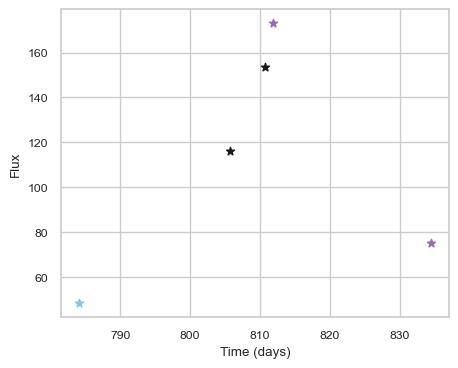

SNIax (3.830413, False)
SNIax (3.675591, False)
SNIax (3.5584826, False)
SNIax (3.8773875, False)
SNIax (3.7700965, False)
SNIax (4.013419, False)
SNIax (4.035254, False)
SNIax (4.00595, False)
SNIax (3.7441146, False)
SNIax (4.0376835, False)


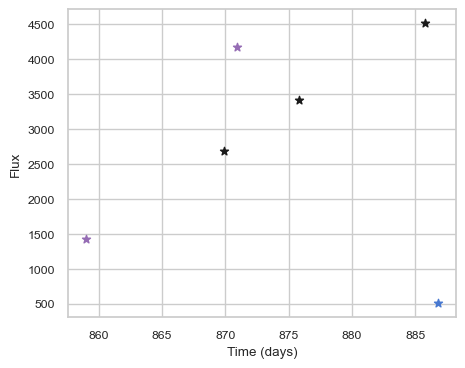

SNIax (5.7849746, False)
SNIax (4.311147, False)
SNIax (4.0846853, False)
SNIax (4.828395, False)
SNIax (2.187904, False)
SNIax (2.9020796, False)
SNIax (2.214811, False)
SNIax (2.9765623, False)
SNIax (2.2084792, False)
SNIax (3.1204464, False)
SNIax (1.8320191, False)
SNIax (4.0282545, False)


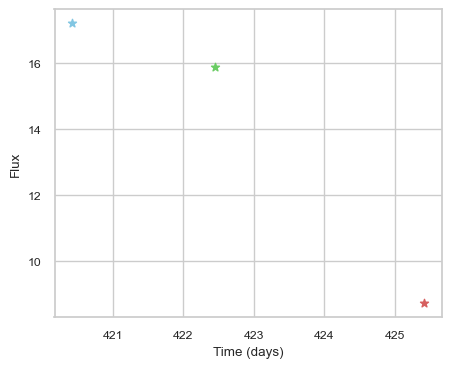

SNIax (3.8858843, False)
SNIax (3.6404772, False)
SNIax (3.3753374, False)
SNIax (3.2211108, False)
SNIax (3.3791442, False)
SNIax (2.8263881, False)


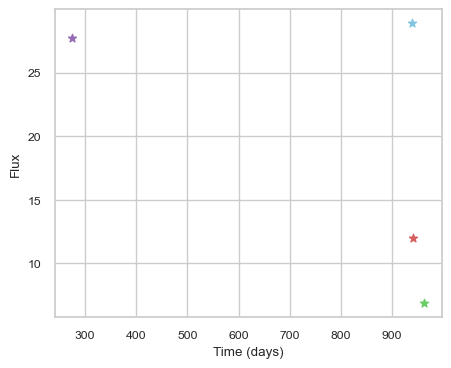

SNIax (3.7648816, False)
SNIax (4.0958323, False)
SNIax (3.5292065, False)
SNIax (3.6850169, False)
SNIax (2.9284353, False)
SNIax (2.6709683, False)
SNIax (3.267349, False)
SNIax (2.9974744, False)


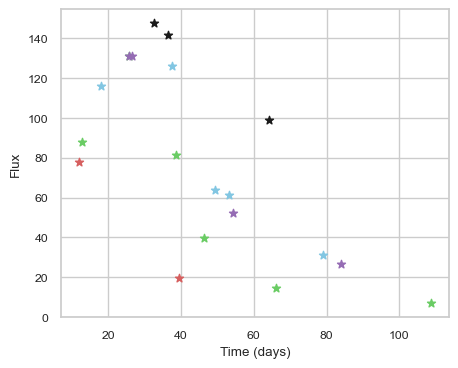

SNIax (4.076506, False)
SNIax (3.5727968, False)
SNIax (4.2367525, False)
SNIax (3.825588, False)
SNIax (3.7121863, False)
SNIax (3.6375794, False)
SNIax (3.5195408, False)
SNIax (2.9380245, False)
SNIax (3.4154284, False)
SNIax (3.246236, False)
SNIax (3.7012086, False)
SNIax (2.7088554, False)
SNIax (3.5947456, False)
SNIax (2.9067068, False)
SNIax (3.8727493, False)
SNIax (3.0046644, False)
SNIax (3.7304258, False)
SNIax (2.8186944, False)
SNIax (3.158837, False)
SNIax (2.269944, False)
SNIax (2.834205, False)
SNIax (2.4869108, False)
SNIax (3.3243263, False)
SNIax (2.6561518, False)
SNIax (3.4436748, False)
SNIax (2.6860378, False)
SNIax (3.476618, False)
SNIax (2.6886833, False)
SNIax (2.9361691, False)
SNIax (2.665895, False)
SNIax (2.9495344, False)
SNIax (2.5723505, False)
SNIax (3.3034992, False)
SNIax (2.4982548, False)
SNIax (2.9693937, False)
SNIax (2.4066477, False)
SNIax (2.5467887, False)
SNIax (2.7461145, False)
SNIax (3.0128882, False)
SNIax (2.5849538, False)


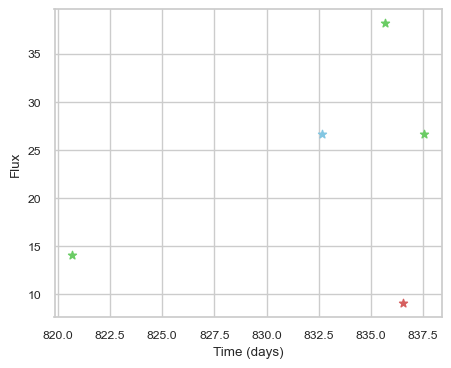

SNIax (3.9221773, False)
SNIax (3.2403948, False)
SNIax (3.1375346, False)
SNIax (3.1968827, False)
SNIax (3.2970428, False)
SNIax (3.5093145, False)
SNIax (4.3057117, False)
SNIax (3.7246227, False)
SNIax (2.9502165, False)
SNIax (2.4118636, False)


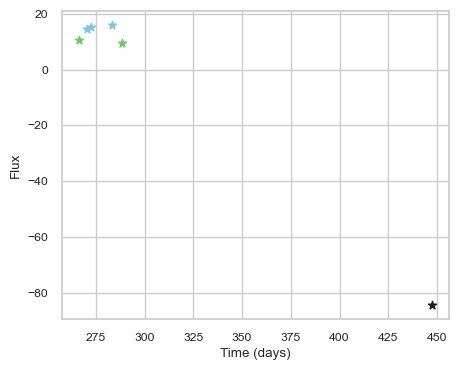

SNIax (5.0573945, False)
SNIax (5.0244584, False)
SNIax (4.9716096, False)
SNIax (5.018809, False)
SNIax (4.2455263, False)
SNIax (4.5667357, False)
SNIax (4.3782144, False)
SNIax (4.613556, False)
SNIax (4.4743013, False)
SNIax (4.6555476, False)
SNIax (5.119984, False)
SNIax (5.306951, False)


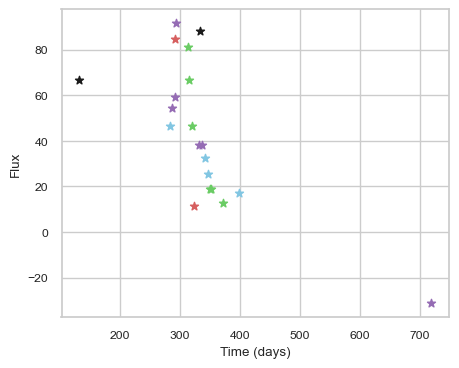

SNIax (3.7078655, False)
SNIax (3.9095685, False)
SNIax (3.5404708, False)
SNIax (3.9759815, False)
SNIax (3.3517802, False)
SNIax (3.659558, False)
SNIax (3.3048022, False)
SNIax (3.6432073, False)
SNIax (3.6453722, False)
SNIax (3.8619387, False)
SNIax (4.0158696, False)
SNIax (3.9034, False)
SNIax (3.5995097, False)
SNIax (3.1720855, False)
SNIax (3.6673496, False)
SNIax (3.4836993, False)
SNIax (4.051182, False)
SNIax (4.6677, False)
SNIax (3.2374527, False)
SNIax (4.4547615, False)
SNIax (3.1282227, False)
SNIax (2.501702, False)
SNIax (3.2166305, False)
SNIax (3.4222744, False)
SNIax (3.5242333, False)
SNIax (3.0406883, False)
SNIax (2.2981555, False)
SNIax (2.5170596, False)
SNIax (2.081201, False)
SNIax (2.5290384, False)
SNIax (2.209878, False)
SNIax (2.229731, False)
SNIax (2.0428066, False)
SNIax (2.0284164, False)
SNIax (3.0487962, False)
SNIax (2.6496143, False)
SNIax (3.681508, False)
SNIax (3.312814, False)
SNIax (3.9174383, False)
SNIax (3.8927438, False)


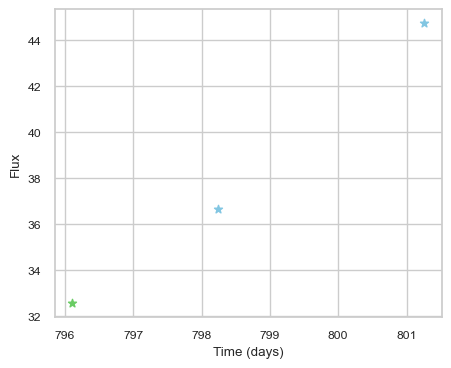

SNIax (3.8608751, False)
SNIax (3.3721004, False)
SNIax (3.2353704, False)
SNIax (3.3109746, False)
SNIax (3.5004263, False)
SNIax (3.8266428, False)


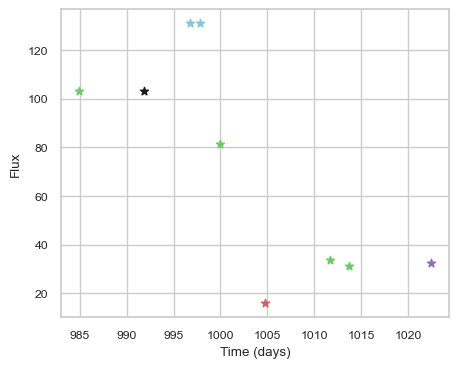

SNIax (4.018991, False)
SNIax (4.0526004, False)
SNIax (4.3033137, False)
SNIax (4.284784, False)
SNIax (4.3437066, False)
SNIax (4.493581, False)
SNIax (5.1600842, False)
SNIax (4.964866, False)
SNIax (4.900116, False)
SNIax (5.061044, False)
SNIax (4.650602, False)
SNIax (5.011106, False)
SNIax (5.57281, False)
SNIax (5.560354, False)
SNIax (5.3195195, False)
SNIax (5.052609, False)
SNIax (5.7960567, False)
SNIax (5.263836, False)


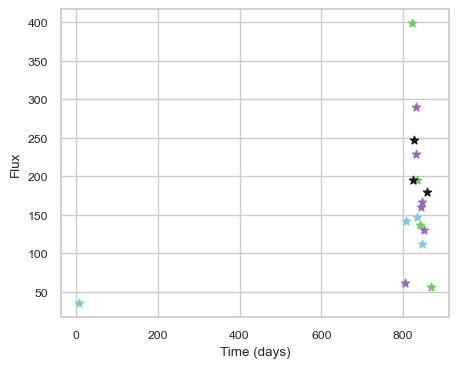

SNIax (3.8219512, False)
SNIax (3.7589695, False)
SNIax (3.6514735, False)
SNIax (3.4882803, False)
SNIax (3.8056164, False)
SNIax (4.1311717, False)
SNIax (3.1042364, False)
SNIax (3.2464256, False)
SNIax (5.7322454, False)
SNIax (7.012537, False)
SNIax (6.560487, False)
SNIax (7.7253723, False)
SNIax (6.4147263, False)
SNIax (5.6798215, False)
SNIax (5.885768, False)
SNIax (6.111603, False)
SNIax (6.083497, False)
SNIax (6.0676656, False)
SNIax (5.732625, False)
SNIax (6.130189, False)
SNIax (5.571516, False)
SNIax (5.625337, False)
SNIax (5.0512404, False)
SNIax (5.7808003, False)
SNIax (5.773808, False)
SNIax (5.995688, False)
SNIax (5.436448, False)
SNIax (5.990218, False)
SNIax (5.7557607, False)
SNIax (5.8930025, False)
SNIax (5.433023, False)
SNIax (6.0539565, False)
SNIax (4.5437865, False)
SNIax (4.505603, False)


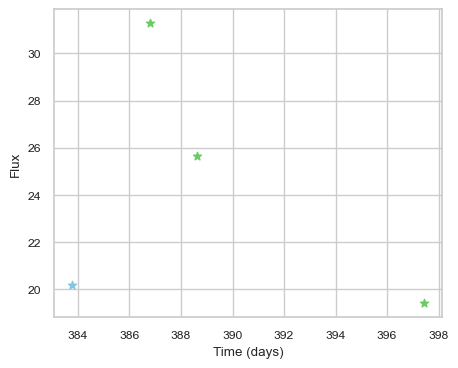

SNIax (3.6448612, False)
SNIax (3.6267557, False)
SNIax (3.3649387, False)
SNIax (3.1548212, False)
SNIax (3.499915, False)
SNIax (2.9976711, False)
SNIax (3.0669682, False)
SNIax (3.1462212, False)


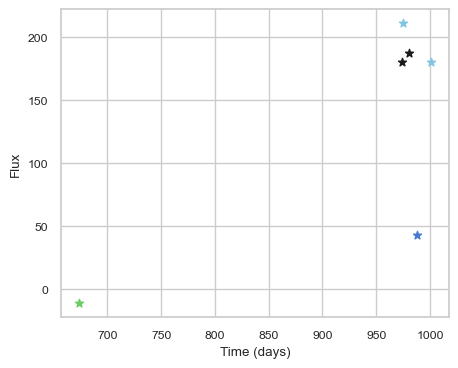

SNIax (3.828507, False)
SNIax (4.3969, False)
SNIax (3.640877, False)
SNIax (3.8084908, False)
SNIax (3.5367537, False)
SNIax (3.6278663, False)
SNIax (3.958114, False)
SNIax (3.673912, False)
SNIax (4.143749, False)
SNIax (4.794516, False)
SNIax (5.021212, False)
SNIax (4.5869265, False)


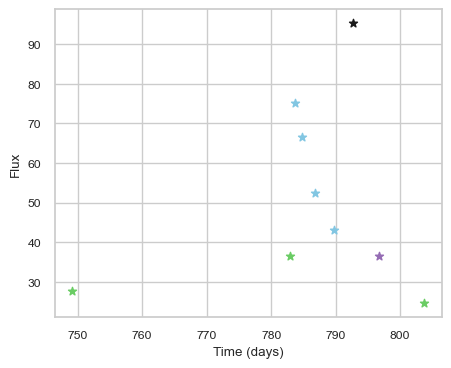

SNIax (3.9654038, False)
SNIax (3.1179807, False)
SNIax (3.4756818, False)
SNIax (2.7051835, False)
SNIax (3.1316447, False)
SNIax (3.5560522, False)
SNIax (4.1187572, False)
SNIax (3.7473047, False)
SNIax (4.1073146, False)
SNIax (3.7654123, False)
SNIax (3.7671962, False)
SNIax (3.6749713, False)
SNIax (3.2257032, False)
SNIax (3.7407176, False)
SNIax (3.4600844, False)
SNIax (3.2360911, False)
SNIax (3.130721, False)
SNIax (3.257384, False)


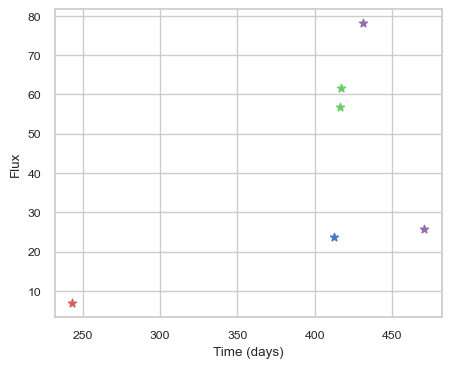

SNIax (3.615725, False)
SNIax (3.464048, False)
SNIax (3.795126, False)
SNIax (4.0000844, False)
SNIax (4.045264, False)
SNIax (3.7369616, False)
SNIax (3.0251656, False)
SNIax (3.8716655, False)
SNIax (3.2254431, False)
SNIax (3.1805615, False)
SNIax (4.4352946, False)
SNIax (4.2809587, False)


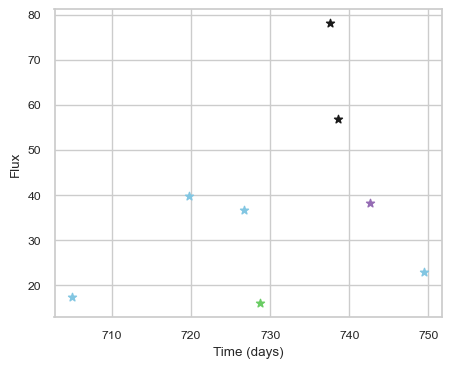

SNIax (4.7763734, False)
SNIax (4.5712805, False)
SNIax (4.6860933, False)
SNIax (5.334746, False)
SNIax (5.564659, False)
SNIax (6.012501, False)
SNIax (5.4438615, False)
SNIax (5.626372, False)
SNIax (5.370669, False)
SNIax (6.015224, False)
SNIax (5.6293135, False)
SNIax (5.8061633, False)
SNIax (5.5003233, False)
SNIax (4.9087534, False)
SNIax (4.5712247, False)
SNIax (4.912367, False)


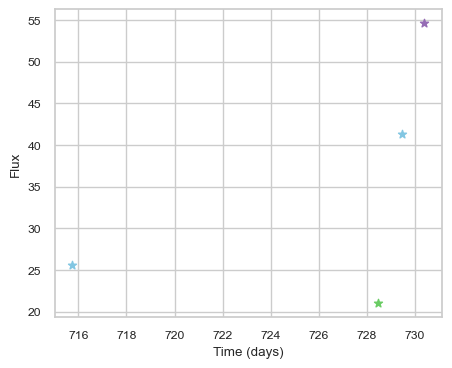

SNIax (4.072353, False)
SNIax (3.6194658, False)
SNIax (3.315145, False)
SNIax (2.9640574, False)
SNIax (3.3008986, False)
SNIax (3.1979454, False)
SNIax (3.7288966, False)
SNIax (3.3284616, False)


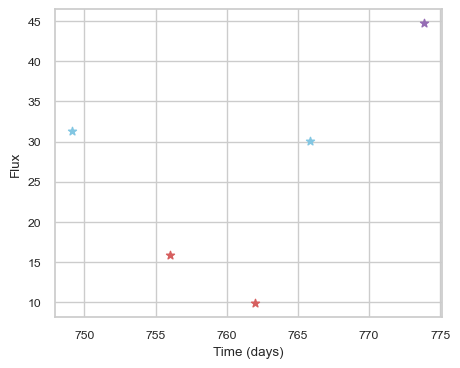

SNIax (3.6875362, False)
SNIax (3.376086, False)
SNIax (3.4244637, False)
SNIax (3.1992366, False)
SNIax (2.7479033, False)
SNIax (2.7449372, False)
SNIax (2.810476, False)
SNIax (2.6493814, False)
SNIax (3.403655, False)
SNIax (3.4124665, False)


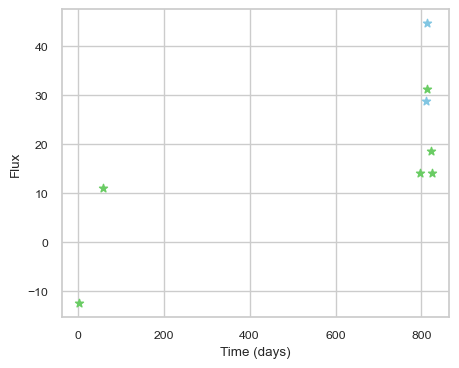

SNIax (4.4682403, False)
SNIax (4.472558, False)
SNIax (4.1806884, False)
SNIax (3.972065, False)
SNIax (4.203229, False)
SNIax (3.4010515, False)
SNIax (3.5165315, False)
SNIax (3.246499, False)
SNIax (2.7252889, False)
SNIax (3.5098357, False)
SNIax (3.4085867, False)
SNIax (2.676263, False)
SNIax (2.5990176, False)
SNIax (2.6009393, False)
SNIax (2.4928849, False)
SNIax (2.5318398, False)


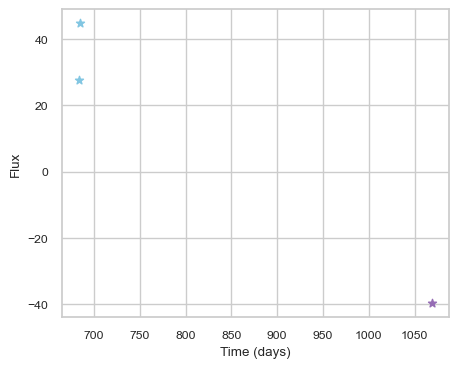

SNIax (3.6598175, False)
SNIax (3.7886517, False)
SNIax (3.1028683, False)
SNIax (3.7800634, False)
SNIax (3.8113976, False)
SNIax (3.7920067, False)


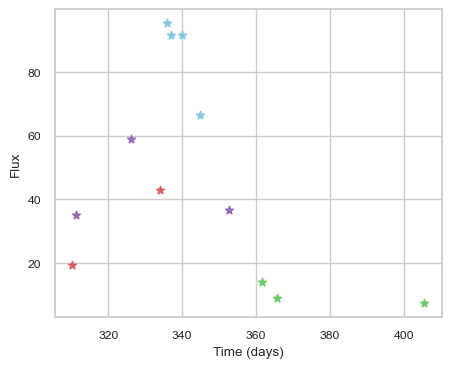

SNIax (4.076534, False)
SNIax (4.738373, False)
SNIax (4.4447217, False)
SNIax (4.1246643, False)
SNIax (3.7721343, False)
SNIax (3.4389095, False)
SNIax (3.7101662, False)
SNIax (3.8417027, False)
SNIax (3.9121432, False)
SNIax (4.158129, False)
SNIax (4.9546924, False)
SNIax (4.825514, False)
SNIax (5.3616395, False)
SNIax (5.1775713, False)
SNIax (5.114557, False)
SNIax (5.0522056, False)
SNIax (4.527078, False)
SNIax (4.8209414, False)
SNIax (4.307355, False)
SNIax (4.6557407, False)
SNIax (4.806631, False)
SNIax (4.1707773, False)
SNIax (4.7269006, False)
SNIax (4.591637, False)


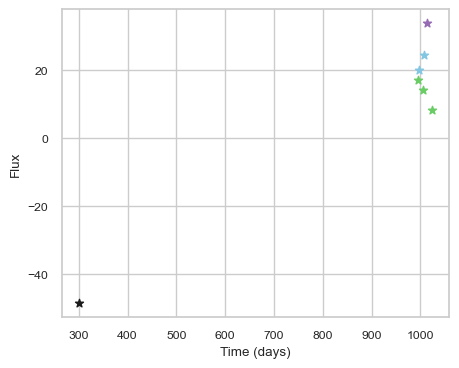

SNIax (5.5275927, False)
SNIax (5.0661306, False)
SNIax (5.451971, False)
SNIax (5.156805, False)
SNIax (5.150499, False)
SNIax (5.7642474, False)
SNIax (5.2051234, False)
SNIax (5.1109247, False)
SNIax (5.243453, False)
SNIax (5.7016306, False)
SNIax (5.3767796, False)
SNIax (5.540631, False)
SNIax (5.6041894, False)
SNIax (5.557682, False)


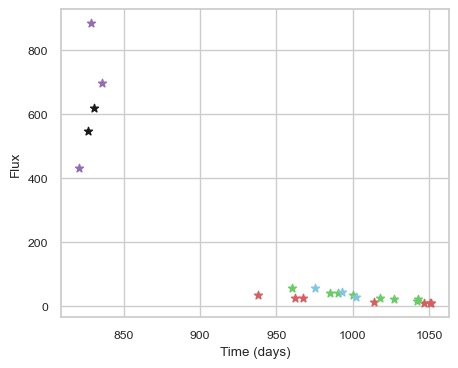

SNIax (3.6375856, False)
SNIax (3.3001723, False)
SNIax (2.4855714, False)
SNIax (3.2549076, False)
SNIax (2.9595523, False)
SNIax (3.2413044, False)
SNIax (2.5617962, False)
SNIax (3.595784, False)
SNIax (3.0218568, False)
SNIax (3.1798172, False)
SNIax (3.2927122, False)
SNIax (3.7486174, False)
SNIax (2.9570253, False)
SNIax (3.1579418, False)
SNIax (2.8001769, False)
SNIax (2.8697898, False)
SNIax (3.0673285, False)
SNIax (3.4052694, False)
SNIax (2.8705454, False)
SNIax (2.9986732, False)
SNIax (3.3165743, False)
SNIax (2.9948504, False)
SNIax (2.864366, False)
SNIax (2.9965453, False)
SNIax (2.7156699, False)
SNIax (2.8007488, False)
SNIax (2.9612176, False)
SNIax (3.02179, False)
SNIax (3.0605178, False)
SNIax (2.9952416, False)
SNIax (2.8610868, False)
SNIax (3.0553632, False)
SNIax (3.2954547, False)
SNIax (3.1882493, False)
SNIax (3.2381742, False)
SNIax (3.417939, False)
SNIax (3.4720902, False)
SNIax (3.6528964, False)
SNIax (3.2840824, False)
SNIax (3.4800596, False)
SNIax

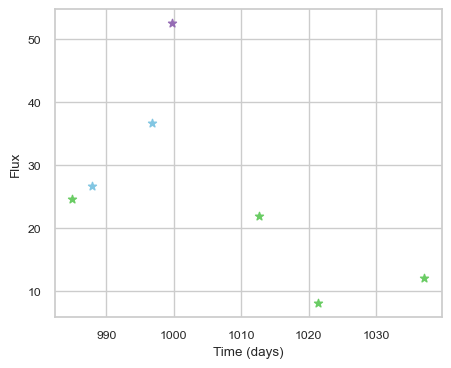

SNIax (4.0387144, False)
SNIax (3.7964153, False)
SNIax (3.159513, False)
SNIax (3.3314753, False)
SNIax (3.2737389, False)
SNIax (3.1175153, False)
SNIax (3.8348188, False)
SNIax (3.0548356, False)
SNIax (2.805632, False)
SNIax (3.2570999, False)
SNIax (3.5364494, False)
SNIax (3.549017, False)
SNIax (3.521865, False)
SNIax (3.4981046, False)


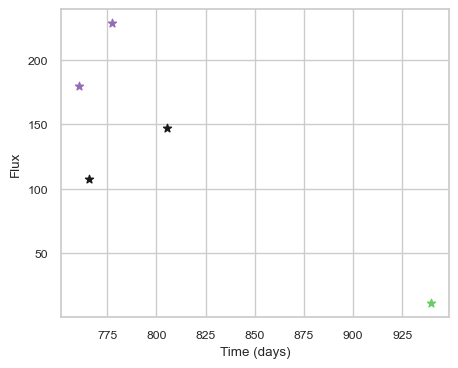

SNIax (3.875866, False)
SNIax (4.1673727, False)
SNIax (4.5154366, False)
SNIax (4.590815, False)
SNIax (5.095089, False)
SNIax (5.517322, False)
SNIax (6.168639, False)
SNIax (6.390231, False)
SNIax (6.2680926, False)
SNIax (5.7473545, False)


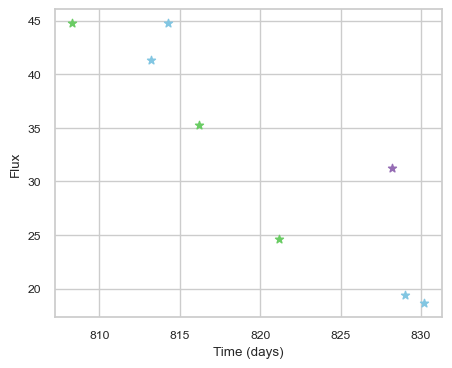

SNIax (3.9234543, False)
SNIax (3.6348424, False)
SNIax (3.8533363, False)
SNIax (3.1585948, False)
SNIax (3.7459545, False)
SNIax (4.0198355, False)
SNIax (4.555246, False)
SNIax (4.67212, False)
SNIax (4.9285274, False)
SNIax (5.3054276, False)
SNIax (5.0840163, False)
SNIax (5.850721, False)
SNIax (5.3053293, False)
SNIax (4.8700566, False)
SNIax (4.4826055, False)
SNIax (4.416412, False)


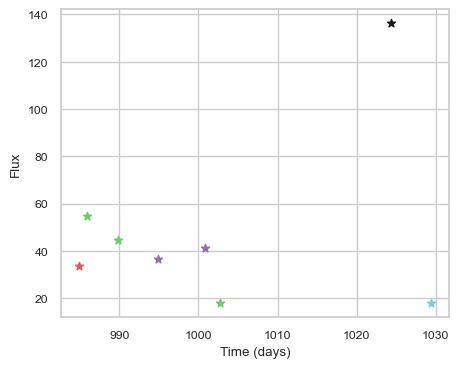

SNIax (3.782967, False)
SNIax (4.6173177, False)
SNIax (5.128522, False)
SNIax (3.9044929, False)
SNIax (3.7138987, False)
SNIax (2.8589725, False)
SNIax (2.8950207, False)
SNIax (3.3828156, False)
SNIax (3.2919207, False)
SNIax (4.0347376, False)
SNIax (3.8335958, False)
SNIax (3.736332, False)
SNIax (3.3910272, False)
SNIax (4.9793515, False)
SNIax (6.0516605, False)
SNIax (4.9203944, False)


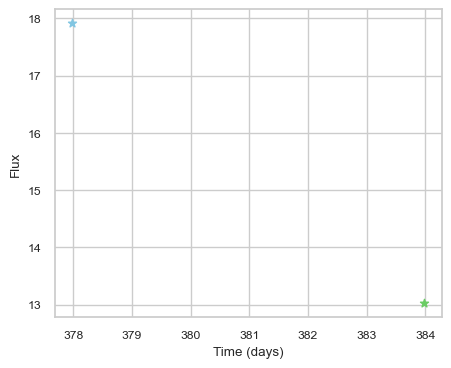

SNIax (4.0142927, False)
SNIax (3.5326889, False)
SNIax (3.4167237, False)
SNIax (3.270546, False)


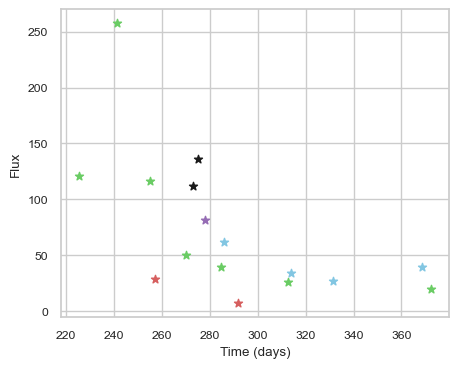

SNIax (3.5014384, False)
SNIax (3.3891573, False)
SNIax (4.3157234, False)
SNIax (4.773079, False)
SNIax (6.3254685, False)
SNIax (6.203348, False)
SNIax (5.7657866, False)
SNIax (5.7035813, False)
SNIax (6.494748, False)
SNIax (6.334701, False)
SNIax (6.329525, False)
SNIax (6.6833353, False)
SNIax (6.9775934, False)
SNIax (6.6376114, False)
SNIax (6.894888, False)
SNIax (5.9633126, False)
SNIax (6.059061, False)
SNIax (6.128943, False)
SNIax (5.7569814, False)
SNIax (6.5679483, False)
SNIax (6.253389, False)
SNIax (6.358426, False)
SNIax (6.460117, False)
SNIax (6.0731096, False)
SNIax (6.2606, False)
SNIax (6.4472466, False)
SNIax (6.655496, False)
SNIax (6.4552703, False)
SNIax (6.6062145, False)
SNIax (6.6282563, False)
SNIax (6.2463465, False)
SNIax (6.0391974, False)


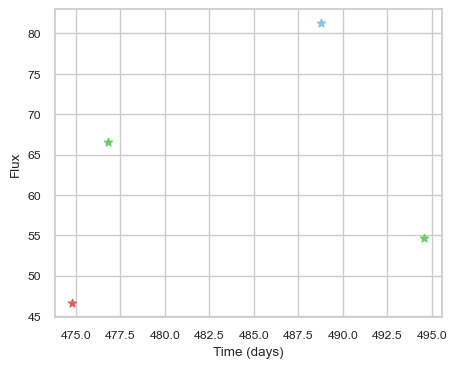

SNIax (3.8598778, False)
SNIax (4.9074025, False)
SNIax (4.857843, False)
SNIax (3.531794, False)
SNIax (3.3914094, False)
SNIax (3.1648865, False)
SNIax (3.2761376, False)
SNIax (3.0657442, False)


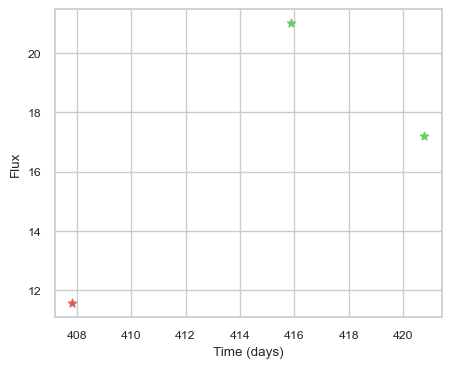

SNIax (3.9980266, False)
SNIax (4.0503397, False)
SNIax (3.8424246, False)
SNIax (4.2176647, False)
SNIax (4.624997, False)
SNIax (4.6708546, False)


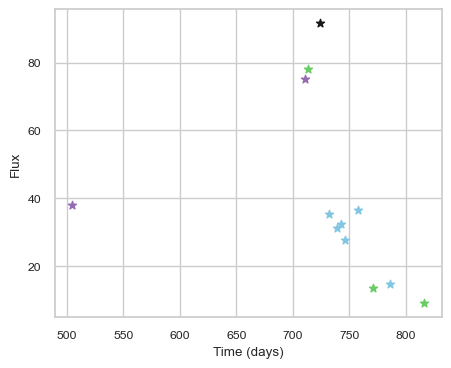

SNIax (3.8202176, False)
SNIax (3.787098, False)
SNIax (3.6995375, False)
SNIax (3.6471603, False)
SNIax (3.6959505, False)
SNIax (3.6904645, False)
SNIax (3.1736243, False)
SNIax (3.2382705, False)
SNIax (2.678278, False)
SNIax (2.2324057, False)
SNIax (2.332073, False)
SNIax (2.1224332, False)
SNIax (2.3824608, False)
SNIax (2.177583, False)
SNIax (2.2346275, False)
SNIax (2.1814525, False)
SNIax (2.2259598, False)
SNIax (2.13784, False)
SNIax (2.3365057, False)
SNIax (2.2760031, False)
SNIax (2.6202843, False)
SNIax (2.1829114, False)
SNIax (2.6420143, False)
SNIax (2.5161073, False)


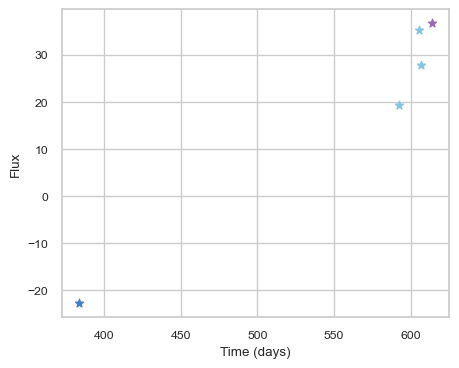

SNIax (5.338505, False)
SNIax (5.6442666, False)
SNIax (5.6035266, False)
SNIax (5.601173, False)
SNIax (5.744938, False)
SNIax (6.218301, False)
SNIax (6.399898, False)
SNIax (6.631642, False)
SNIax (6.0951076, False)
SNIax (6.2257857, False)


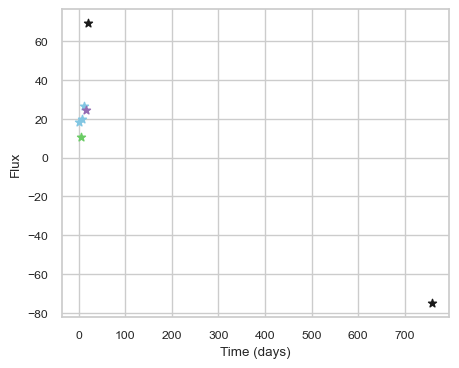

SNIax (4.6825385, False)
SNIax (4.314412, False)
SNIax (3.971348, False)
SNIax (4.055758, False)
SNIax (4.1213, False)
SNIax (4.613471, False)
SNIax (4.517701, False)
SNIax (4.927286, False)
SNIax (4.8061805, False)
SNIax (4.960643, False)
SNIax (5.26332, False)
SNIax (5.0875535, False)
SNIax (5.3023252, False)
SNIax (5.7536955, False)


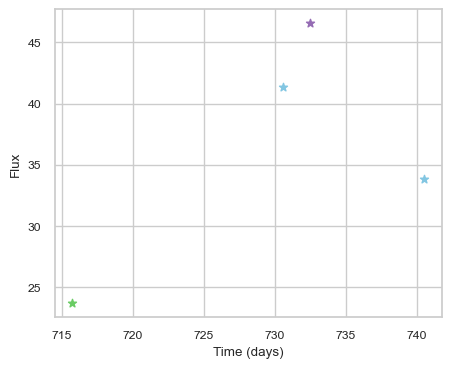

SNIax (3.9284048, False)
SNIax (3.418152, False)
SNIax (3.1627562, False)
SNIax (2.5956075, False)
SNIax (2.9631975, False)
SNIax (2.5928774, False)
SNIax (2.8145561, False)
SNIax (3.0205436, False)


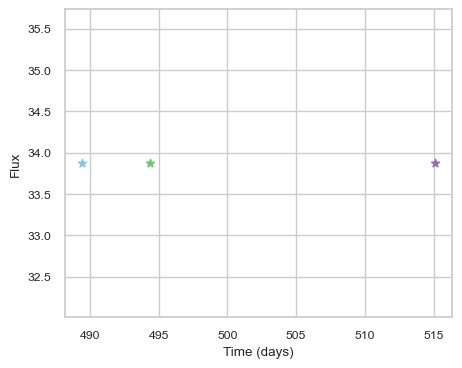

SNIax (4.7200046, False)
SNIax (4.429212, False)
SNIax (4.493276, False)
SNIax (4.7766447, False)
SNIax (4.410359, False)
SNIax (4.8168907, False)


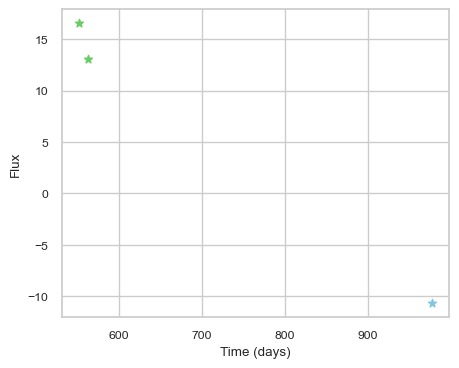

SNIax (3.7385807, False)
SNIax (3.2918448, False)
SNIax (3.0245976, False)
SNIax (2.9629934, False)
SNIax (3.9075413, False)
SNIax (3.7905688, False)


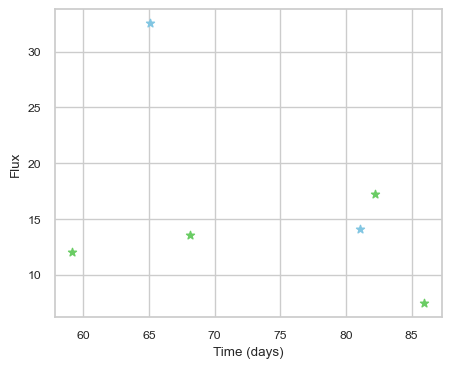

SNIax (5.2459927, False)
SNIax (4.4907746, False)
SNIax (4.4261255, False)
SNIax (5.590346, False)
SNIax (5.0447054, False)
SNIax (5.212694, False)
SNIax (5.0052137, False)
SNIax (4.7203674, False)
SNIax (4.1623044, False)
SNIax (3.831932, False)
SNIax (4.2749705, False)
SNIax (3.9185967, False)


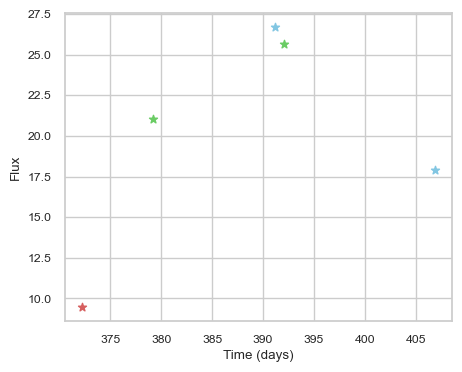

SNIax (3.7575452, False)
SNIax (4.0339932, False)
SNIax (3.7241, False)
SNIax (2.921612, False)
SNIax (3.033194, False)
SNIax (3.4068043, False)
SNIax (3.4222186, False)
SNIax (3.6183548, False)
SNIax (3.8524709, False)
SNIax (4.496036, False)


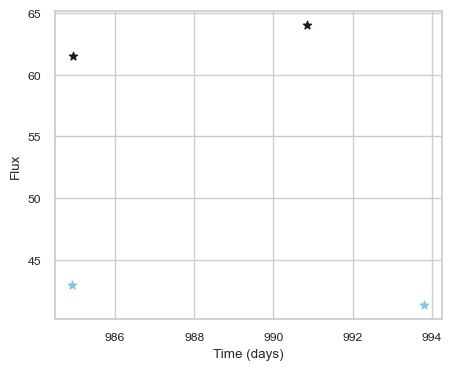

SNIax (4.0826793, False)
SNIax (4.143601, False)
SNIax (4.2931848, False)
SNIax (4.6374807, False)
SNIax (4.778748, False)
SNIax (4.8419685, False)
SNIax (5.0328074, False)
SNIax (4.1792994, False)


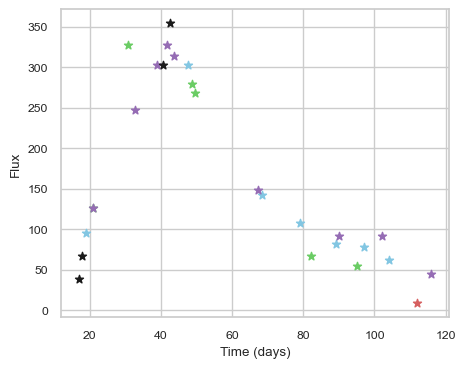

SNIax (3.8896399, False)
SNIax (3.8604386, False)
SNIax (3.8220112, False)
SNIax (4.2043967, False)
SNIax (3.9650445, False)
SNIax (3.4569871, False)
SNIax (3.6267169, False)
SNIax (3.1953273, False)
SNIax (3.7590544, False)
SNIax (3.2100127, False)
SNIax (3.2126257, False)
SNIax (2.4530988, False)
SNIax (2.8696334, False)
SNIax (2.2968063, False)
SNIax (2.909592, False)
SNIax (2.1326885, False)
SNIax (3.0318651, False)
SNIax (3.2281256, False)
SNIax (3.5388298, False)
SNIax (1.9587263, False)
SNIax (3.1299727, False)
SNIax (2.8081326, False)
SNIax (3.4397736, False)
SNIax (2.3596601, False)
SNIax (2.762834, False)
SNIax (2.2918892, False)
SNIax (2.1946723, False)
SNIax (2.1242387, False)
SNIax (2.647399, False)
SNIax (2.2193396, False)
SNIax (2.9851935, False)
SNIax (2.3500197, False)
SNIax (3.0280526, False)
SNIax (2.467111, False)
SNIax (2.9695792, False)
SNIax (2.4046135, False)
SNIax (2.4896789, False)
SNIax (2.3662467, False)
SNIax (2.6344998, False)
SNIax (2.555575, False)
SNIax

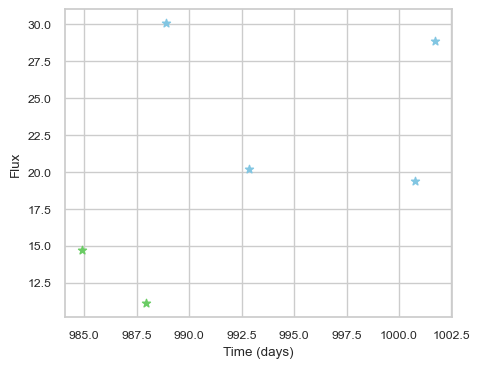

SNIax (4.6313663, False)
SNIax (4.22584, False)
SNIax (3.6140594, False)
SNIax (3.6417603, False)
SNIax (3.3784685, False)
SNIax (4.165178, False)
SNIax (3.9482079, False)
SNIax (3.4937747, False)
SNIax (3.2421498, False)
SNIax (3.507847, False)
SNIax (2.7979624, False)
SNIax (3.1573913, False)


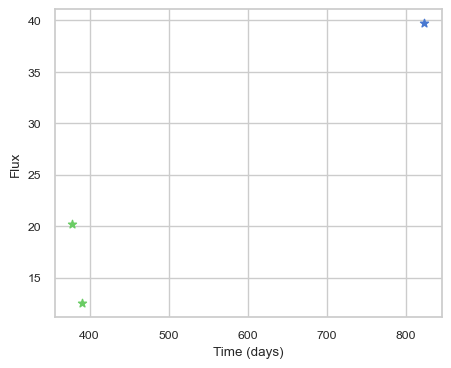

SNIax (3.7924545, False)
SNIax (3.4470727, False)
SNIax (3.3063145, False)
SNIax (4.294522, False)
SNIax (4.395596, False)
SNIax (5.389073, False)


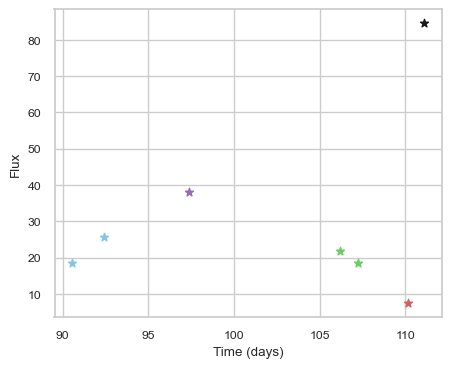

SNIax (3.8915854, False)
SNIax (3.6774025, False)
SNIax (3.489173, False)
SNIax (3.8163977, False)
SNIax (3.1712668, False)
SNIax (3.6188915, False)
SNIax (3.3305588, False)
SNIax (3.8430738, False)
SNIax (3.545011, False)
SNIax (3.9152896, False)
SNIax (4.029838, False)
SNIax (3.624473, False)
SNIax (3.8262386, False)
SNIax (3.457994, False)


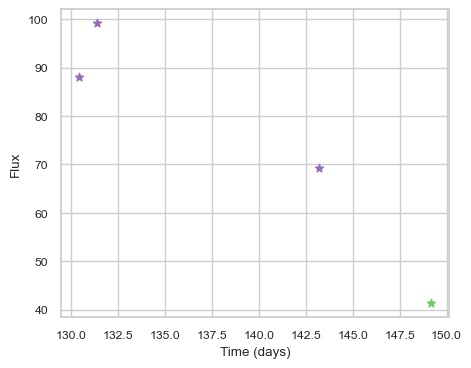

SNIax (3.7243245, False)
SNIax (4.2052836, False)
SNIax (4.43752, False)
SNIax (4.747206, False)
SNIax (4.095894, False)
SNIax (3.9536414, False)
SNIax (3.6095226, False)
SNIax (3.7656562, False)
0.5185866 0.8322


In [11]:
nll = []
correct = []
for d in data[:100000]: 
    loss, cor = metrics(d['class'], d['logits'][0][-1])
    nll.append(loss)
    correct.append(cor)
    if config['class_names'][d['class']] == 'SNIax':
        plot_lc(tokenizer.decode(d['x']))
        for logits in d['logits'][0]:
            print(config['class_names'][d['class']], metrics(d['class'], logits))
print(np.mean(nll), np.mean(correct))